# Emotion Recognition Using Wav2Vec 2.0

In [ ]:
%%capture
# Install necessary packages for audio processing and emotion recognition
!pip install jiwer torchaudio librosa sounddevice

# Install Hugging Face datasets and transformers for model usage
!pip install git+https://github.com/huggingface/datasets.git
!pip install git+https://github.com/huggingface/transformers.git

# Monitor the training process
# !pip install wandb

In [ ]:
# Setting environment variables for the notebook
# LC_ALL and LANG are set to C.UTF-8 to ensure consistent character encoding
%env LC_ALL=C.UTF-8
%env LANG=C.UTF-8

# Setting cache directories for transformers and datasets
%env TRANSFORMERS_CACHE=.
%env HF_DATASETS_CACHE=.

# Setting CUDA_LAUNCH_BLOCKING to 1 to enable synchronous CUDA kernel launches
%env CUDA_LAUNCH_BLOCKING=1

env: LC_ALL=C.UTF-8
env: LANG=C.UTF-8
env: TRANSFORMERS_CACHE=.
env: HF_DATASETS_CACHE=.
env: CUDA_LAUNCH_BLOCKING=1


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/RAVDESS.zip -d /content/

Archive:  /content/drive/MyDrive/RAVDESS.zip
  inflating: /content/Actor_01/03-01-01-01-01-01-01.wav  
  inflating: /content/Actor_01/03-01-01-01-01-02-01.wav  
  inflating: /content/Actor_01/03-01-01-01-02-01-01.wav  
  inflating: /content/Actor_01/03-01-01-01-02-02-01.wav  
  inflating: /content/Actor_01/03-01-02-01-01-01-01.wav  
  inflating: /content/Actor_01/03-01-02-01-01-02-01.wav  
  inflating: /content/Actor_01/03-01-02-01-02-01-01.wav  
  inflating: /content/Actor_01/03-01-02-01-02-02-01.wav  
  inflating: /content/Actor_01/03-01-02-02-01-01-01.wav  
  inflating: /content/Actor_01/03-01-02-02-01-02-01.wav  
  inflating: /content/Actor_01/03-01-02-02-02-01-01.wav  
  inflating: /content/Actor_01/03-01-02-02-02-02-01.wav  
  inflating: /content/Actor_01/03-01-03-01-01-01-01.wav  
  inflating: /content/Actor_01/03-01-03-01-01-02-01.wav  
  inflating: /content/Actor_01/03-01-03-01-02-01-01.wav  
  inflating: /content/Actor_01/03-01-03-01-02-02-01.wav  
  inflating: /content/Actor

## Prepare Data

CREMA-D (Crowd Sourced Emotional Multimodal Actors Dataset)
License: Open Database License, https://opendatacommons.org/licenses/odbl/1-0/

- Number of Dataset: 7442
- 48 male and 43 female actors between the ages of 20 and 74.
- A variety of races and ethnicities (African America, Asian, Caucasian, Hispanic, and Unspecified).
- Emotion 6 Classes: Anger, Disgust, Fear, Happy, Neutral, Sad
- In addition, it contains Gender, Age and Emotion Level features.

In [ ]:
# Importing necessary libraries for data manipulation and analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Importing Path for file path manipulation and tqdm for progress bars
from pathlib import Path
from tqdm import tqdm

# Importing torchaudio for audio processing and sklearn for model selection
import torchaudio
from sklearn.model_selection import train_test_split
import librosa
import IPython.display as ipd
from IPython.display import Image
from IPython.display import Audio
from datasets import load_dataset

# Importing os and sys for system operations and system-specific parameters
import os
import sys
from rich import print

# Defining the path and specifying the python dictionary mapping the emotoin to the integer value
root_data_path = "/content/audio_speech_actors_01-24"
SAMPLE_RATE = 32000

### Preparing the dataset

In [ ]:
%%time
# Creating a dataframe structure
data = pd.DataFrame(columns=['Emotion', 'Emotion intensity', 'Gender','Path'])
emotion_label = {0:'surprise', 1:'neutral', 2:'calm', 3:'happy', 4:'sad', 5:'angry', 6:'fear', 7:'disgust'}

for dirpath, sub_dirnames, filenames in os.walk(root_data_path):

    # Going over all the files from the given directory
    for filename in filenames:

        # Creating the path for accessing the file
        file_path = os.path.join(dirpath,filename)

        # Getting list of file identifies
        file_identifies = filename.split('.')[0].split('-')

        # Retriveing the information about the gender of the speaker (0:Female and 1:Male)
        gender_info = int(file_identifies[6])%2
        if gender_info == 0:
            gender = 'female'
        else:
            gender='male'

        # Retrieving the emotional intensity information
        emotion_intensity = (int(file_identifies[3]))
        if emotion_intensity == 1:
            emotion_intensity = 'normal'
        else:
            emotion_intensity = 'strong'

        # Retriving the type of emotion
        emotion = (int(file_identifies[2]))
        if emotion == 8: # change surprise from 8 to 0
            emotion = 0

        # Appending the current file information
        data = pd.concat([data, pd.DataFrame([{"Emotion": emotion,
                            "Emotion intensity": emotion_intensity,
                            "Gender": gender,
                            "Path": file_path}])], ignore_index=True)

CPU times: user 751 ms, sys: 14.5 ms, total: 766 ms
Wall time: 758 ms


In [ ]:
# Checking random 10 rows of the dataframe
data.sample(10)

,Emotion,Emotion intensity,Gender,Path
143,7,normal,female,/content/audio_speech_actors_01-24/Actor_12/03...
1281,5,strong,male,/content/audio_speech_actors_01-24/Actor_07/03...
841,5,normal,female,/content/audio_speech_actors_01-24/Actor_14/03...
127,4,normal,female,/content/audio_speech_actors_01-24/Actor_12/03...
807,7,strong,male,/content/audio_speech_actors_01-24/Actor_13/03...
124,4,strong,female,/content/audio_speech_actors_01-24/Actor_12/03...
339,7,normal,male,/content/audio_speech_actors_01-24/Actor_01/03...
562,3,strong,female,/content/audio_speech_actors_01-24/Actor_04/03...
368,6,normal,female,/content/audio_speech_actors_01-24/Actor_18/03...
281,4,strong,male,/content/audio_speech_actors_01-24/Actor_11/03...


In [ ]:
count = 0
for file_path in data['Path'].values:

    # Check if the file is broken or non-existent
    try:
        # Load the file with torchaudio
        s = torchaudio.load(file_path)
        count = count + 1
    except Exception as e:
        # Print the error if the file is broken or non-existent
        print(f"Error loading file {file_path}: {e}")
        pass

print("Correct file count : ",count)
print("Total file cound : ",len(data))


Correct file count :  1440

Total file cound :  1440

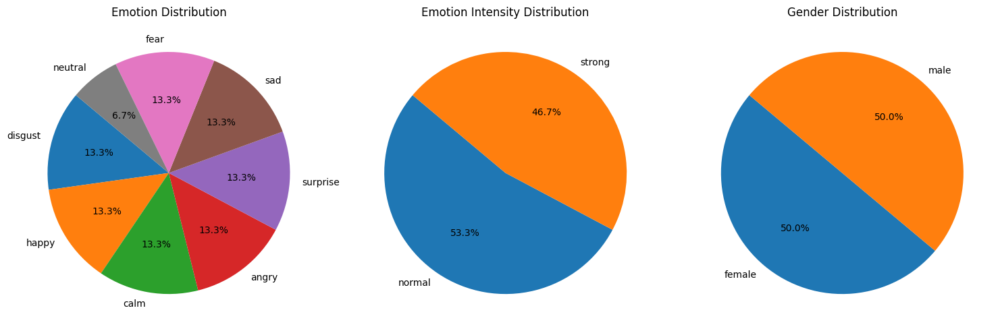

In [ ]:
# Create pie charts for Emotion, Emotion intensity, and Gender
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Pie chart for Emotion
emotion_counts = data['Emotion'].value_counts()
labels = [emotion_label[i] for i in emotion_counts.index]
axs[0].pie(emotion_counts, labels=labels, autopct='%1.1f%%', startangle=140)
axs[0].set_title('Emotion Distribution')

# Pie chart for Emotion intensity
emotion_intensity_counts = data['Emotion intensity'].value_counts()
axs[1].pie(emotion_intensity_counts, labels=emotion_intensity_counts.index, autopct='%1.1f%%', startangle=140)
axs[1].set_title('Emotion Intensity Distribution')

# Pie chart for Gender
gender_counts = data['Gender'].value_counts()
axs[2].pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', startangle=140)
axs[2].set_title('Gender Distribution')

plt.tight_layout()
plt.show()

Right now we have actually prepared the dataset from the files along with other meta data associated with it, but one more thing which we need to do is to check whether all the files are correct or not.

In [ ]:
print(f"File count Before: {len(data)}")

# Add a 'status' column to check if the file path exists
data["status"] = data["Path"].apply(lambda path: True if os.path.exists(path) else None)

# Drop rows where 'status' is None, indicating non-existent paths
data = data.dropna(subset=["Path"])

# Remove the 'status' column as it's no longer needed
data = data.drop("status", axis=1)

# Print the file count after filtering out non-existent paths
print(f"File counter after: {len(data)}")

File count Before: 1440

File counter after: 1440

Sampling Rate (SAMPLE_RATE): The sampling rate is the number of samples of audio carried per second. For example, if the sampling rate is 22050 Hz, it means that 22,050 samples are taken every second.
Duration of Interest: In this case, the code is interested in processing audio data for a fixed duration of 3 seconds. This is a common practice in audio processing, especially in machine learning applications, where having a consistent input size is crucial.

3. Calculating the Array Length: By multiplying the sampling rate by 3, you get the total number of samples that correspond to 3 seconds of audio. For example:

- If SAMPLE_RATE is 22050 Hz, then SAMPLE_RATE * 3 equals 66,150. This means that the array signal will have 66,150 elements, which can hold the audio data for 3 seconds.
- Zero-Initialization: The array is initialized with zeros to ensure that if the loaded audio data is shorter than 3 seconds, the remaining part of the array will be filled with zeros (representing silence). This is important for maintaining a consistent shape for all audio signals, which is necessary for further processing, such as feature extraction or feeding into a machine learning model.

Summary
In summary, multiplying the sampling rate by 3 allows the code to create a fixed-size array that can accommodate 3 seconds of audio data, ensuring consistency in the input shape for subsequent processing steps. This approach is particularly useful in machine learning tasks where uniform input sizes are required.

In [ ]:
%%time
mel_spectrograms = []  # Initialize an empty list to store mel spectrograms
signals = []           # Initialize an empty list to store audio signals

# Loop through each file path in the 'data.Path' list
for i, file_path in enumerate(data.Path):
    # Load the audio file using librosa
    # - 'duration=3' means we only load the first 3 seconds of the audio
    # - 'offset=0.5' means we start loading the audio from 0.5 seconds into the file
    # - 'sr=SAMPLE_RATE' sets the sample rate to a predefined constant SAMPLE_RATE
    audio, sample_rate = librosa.load(file_path, duration=3, offset=0.5, sr=SAMPLE_RATE)

    # Create a zero-initialized numpy array of length SAMPLE_RATE * 3 (3 seconds)
    signal = np.zeros((int(SAMPLE_RATE * 3),))

    # Fill the beginning of the signal array with the loaded audio data
    signal[:len(audio)] = audio

    # Append the processed signal to the signals list
    signals.append(signal)

# Stack the list of signals into a 2D numpy array
signals = np.stack(signals, axis=0)

CPU times: user 16.2 s, sys: 1.95 s, total: 18.2 s
Wall time: 19.2 s


Let's display some random sample of the dataset and run it a couple of times to get a feeling for the audio and the emotional label.

In [ ]:
# Selecting the random audio file
sample = data.iloc[760]
path = sample["Path"]
label = emotion_label[sample["Emotion"]]

print(f"ID Location: {sample}")
print(f"Label: {label}")

# Load the audio file using torchaudio
speech, sr = torchaudio.load(path)

# Convert the loaded audio to numpy format and squeeze the dimensions
speech = speech[0].numpy().squeeze()

# Resample the audio to a standard rate of 16,000 Hz using librosa
speech = librosa.resample(speech, orig_sr=sr, target_sr=16000)

# Display the audio using IPython.display.Audio with autoplay enabled and the correct rate
ipd.Audio(data=np.asarray(speech), autoplay=True, rate=16000)

ID Location: Emotion                                                              6
Emotion intensity                                               strong
Gender                                                          female
Path                 /content/audio_speech_actors_01-24/Actor_16/03...
Name: 760, dtype: object

Label: fear

For training purposes, we need to split data into train test sets; in this specific example, we break with a `20%` rate for the test set.

In [ ]:
data.head(5)

,Emotion,Emotion intensity,Gender,Path
0,1,normal,male,Dataset/RAVDESS/audio_speech_actors_01-24\Acto...
1,1,normal,male,Dataset/RAVDESS/audio_speech_actors_01-24\Acto...
2,1,normal,male,Dataset/RAVDESS/audio_speech_actors_01-24\Acto...
3,1,normal,male,Dataset/RAVDESS/audio_speech_actors_01-24\Acto...
4,2,normal,male,Dataset/RAVDESS/audio_speech_actors_01-24\Acto...


In [ ]:
def split_data(signals, data, EMOTIONS):
    """
    Splits the data into training, validation, and testing sets based on emotions.

    Parameters:
    - signals (numpy array): The array of signals to be split.
    - data (pandas DataFrame): The DataFrame containing the data.
    - EMOTIONS (list): A list of emotions to split the data by.

    Returns:
    - X_train, X_val, X_test (numpy arrays): The split signal data for training, validation, and testing.
    - Y_train, Y_val, Y_test (numpy arrays): The corresponding labels for training, validation, and testing.
    - train_ind, val_ind, test_ind (numpy arrays): The indices of the split data.
    """
    train_ind,test_ind,val_ind = [],[],[]
    X_train,X_val,X_test = [],[],[]
    Y_train,Y_val,Y_test = [],[],[]

    # Iterate through each emotion to split the data
    for emotion in range(len(emotion_label)):
        emotion_ind = list(data.loc[data.Emotion==emotion,'Emotion'].index)
        emotion_ind = np.random.permutation(emotion_ind)  # Shuffle the indices for each emotion
        m = len(emotion_ind)

        # Splitting indices for training, validation, and testing
        ind_train = emotion_ind[:int(0.8*m)]
        ind_val = emotion_ind[int(0.8*m):int(0.9*m)]
        ind_test = emotion_ind[int(0.9*m):]

        # Appending the split data and labels
        X_train.append(signals[ind_train,:])
        Y_train.append(np.array([emotion]*len(ind_train),dtype=np.int32))
        X_val.append(signals[ind_val,:])
        Y_val.append(np.array([emotion]*len(ind_val),dtype=np.int32))
        X_test.append(signals[ind_test,:])
        Y_test.append(np.array([emotion]*len(ind_test),dtype=np.int32))

        # Appending the indices
        train_ind.append(ind_train)
        test_ind.append(ind_test)
        val_ind.append(ind_val)

    # Concatenating the split data and labels
    X_train = np.concatenate(X_train,0)
    X_val = np.concatenate(X_val,0)
    X_test = np.concatenate(X_test,0)
    Y_train = np.concatenate(Y_train,0)
    Y_val = np.concatenate(Y_val,0)
    Y_test = np.concatenate(Y_test,0)
    train_ind = np.concatenate(train_ind,0)
    val_ind = np.concatenate(val_ind,0)
    test_ind = np.concatenate(test_ind,0)

    # Printing the shapes of the split data and labels
    print(f'X_train:{X_train.shape}, Y_train:{Y_train.shape}')
    print(f'X_val:{X_val.shape}, Y_val:{Y_val.shape}')
    print(f'X_test:{X_test.shape}, Y_test:{Y_test.shape}')

    # Checking if all indices are unique
    unique, count = np.unique(np.concatenate([train_ind,test_ind,val_ind],0), return_counts=True)
    print("Number of unique indexes is {}, out of {}".format(sum(count==1), signals.shape[0]))

    return X_train, X_val, X_test, Y_train, Y_val, Y_test, train_ind, val_ind, test_ind

# Example usage
X_train, X_val, X_test, Y_train, Y_val, Y_test, train_ind, val_ind, test_ind = split_data(signals, data, emotion_label)

X_train:(1147, 96000), Y_train:(1147,)

X_val:(143, 96000), Y_val:(143,)

X_test:(150, 96000), Y_test:(150,)

Number of unique indexes is 1440, out of 1440

### Augment signals by adding AWGN

In [ ]:
# Parameters
duration = 3  # seconds
sampling_rate = 44100  # samples per second (CD quality audio)
frequency = 440  # frequency of the sine wave (A4 note)

# Generate a sine wave
t = np.linspace(0, duration, int(sampling_rate * duration), endpoint=False)
sine_wave = 0.5 * np.sin(2 * np.pi * frequency * t)  # amplitude 0.5

# Function to add AWGN
def add_awgn(signal, snr_db):
    """Add AWGN to a signal with a given SNR in dB."""
    signal_power = np.mean(signal**2)
    snr_linear = 10 ** (snr_db / 10)
    noise_power = signal_power / snr_linear
    noise = np.sqrt(noise_power) * np.random.normal(size=signal.shape)
    return signal + noise

# Add AWGN with an SNR of 10 dB
noisy_signal = add_awgn(sine_wave, snr_db=1)

# Play the noisy signal
sd.play(noisy_signal, samplerate=sampling_rate)
sd.wait()  # Wait for the sound to finish playing

In [ ]:
def addAWGN(signal, num_bits=16, augmented_num=2, snr_low=15, snr_high=30):
    """
    This function adds Additive White Gaussian Noise (AWGN) to a given signal.

    Parameters:
    - signal: The input signal to which AWGN will be added.
    - num_bits: The number of bits used to represent the signal. Default is 16.
    - augmented_num: The number of augmented signals to generate. Default is 2.
    - snr_low: The lower bound of the Signal-to-Noise Ratio (SNR) in dB. Default is 15.
    - snr_high: The upper bound of the SNR in dB. Default is 30.

    Returns:
    - Noisy signal(s) with AWGN added.
    """
    # Get the length of the signal
    signal_len = len(signal)

    # Generate White Gaussian noise
    noise = np.random.normal(size=(augmented_num, signal_len))

    # Normalize signal and noise
    norm_constant = 2.0**(num_bits-1)
    signal_norm = signal / norm_constant
    noise_norm = noise / norm_constant

    # Compute signal and noise power
    s_power = np.sum(signal_norm ** 2) / signal_len
    n_power = np.sum(noise_norm ** 2, axis=1) / signal_len

    # Random SNR: Uniform [15, 30] in dB
    target_snr = np.random.randint(snr_low, snr_high)

    # Compute K (covariance matrix) for each noise
    K = np.sqrt((s_power / n_power) * 10 ** (- target_snr / 10))
    K = np.ones((signal_len, augmented_num)) * K

    # Generate noisy signal
    return signal + K.T * noise

In [ ]:
%%time
# Initialize empty lists to store augmented signals and labels
aug_signals = []
aug_labels = []

# Loop over each signal in the training set
for i in range(X_train.shape[0]):
    # Get the current signal
    signal = X_train[i,:]

    # Add AWGN to the signal
    augmented_signals = addAWGN(signal)

    # Loop over each augmented signal
    for j in range(augmented_signals.shape[0]):
        # Add the label of the original signal to the list
        aug_labels.append(data.loc[i,"Emotion"])

        # Add the augmented signal to the list
        aug_signals.append(augmented_signals[j,:])

        # Add a new row to the data with the same information as the original row
        # Corrected the DataFrame append method
        data = pd.concat([data, data.iloc[[i]]], ignore_index=True)

# Stack the augmented signals into a single array
aug_signals = np.stack(aug_signals,axis=0)

# Concatenate the augmented signals with the original training set
X_train = np.concatenate([X_train,aug_signals],axis=0)

# Stack the augmented labels into a single array
aug_labels = np.stack(aug_labels,axis=0)

# Concatenate the augmented labels with the original training labels
Y_train = np.concatenate([Y_train,aug_labels])

# Print the final shape of the training set and labels
print('')
print(f'X_train:{X_train.shape}, Y_train:{Y_train.shape}')

X_train:(3441, 96000), Y_train:(3441,)

CPU times: user 9.89 s, sys: 5.12 s, total: 15 s
Wall time: 15.5 s


### Calculating mel spectrograms

MEL spectrogram shape: 
(128, 376)

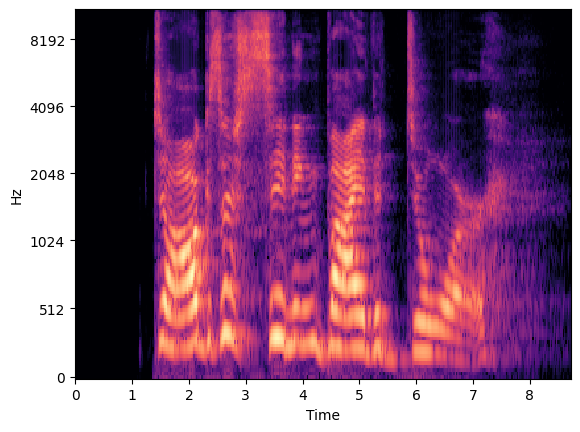

In [ ]:
def getMELspectrogram(audio, sample_rate):
    """
    This function calculates the Mel spectrogram of an audio signal.

    Parameters:
    - audio (numpy array): The audio signal.
    - sample_rate (int): The sample rate of the audio signal.

    Returns:
    - mel_spec_db (numpy array): The Mel spectrogram of the audio signal in decibels.
    """
    # Calculate the Mel spectrogram of the audio signal
    mel_spec = librosa.feature.melspectrogram(y=audio,
                                              sr=sample_rate,
                                              n_fft=1024,  # Window size for the FFT
                                              win_length=512,  # Window size for the analysis window
                                              window='hamming',  # Window function
                                              hop_length=256,  # Number of samples between successive frames
                                              n_mels=128,  # Number of Mel bands to generate
                                              fmax=sample_rate/2  # Maximum frequency
                                             )
    # Convert the Mel spectrogram to decibels
    mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
    return mel_spec_db

# Test the function
audio, sample_rate = librosa.load(data.loc[0,'Path'], duration=3, offset=0.5, sr=SAMPLE_RATE)

# Pad the audio signal to the desired length
signal = np.zeros((int(SAMPLE_RATE*3),))
signal[:len(audio)] = audio

# Calculate the Mel spectrogram
mel_spectrogram = getMELspectrogram(signal, SAMPLE_RATE)

# Display the Mel spectrogram
librosa.display.specshow(mel_spectrogram, y_axis='mel', x_axis='time')
print('MEL spectrogram shape: ', mel_spectrogram.shape)

In [ ]:
mel_train = []
for i in range(X_train.shape[0]):
    mel_spectrogram = getMELspectrogram(X_train[i,:], sample_rate=SAMPLE_RATE)
    mel_train.append(mel_spectrogram)
del X_train

mel_val = []
for i in range(X_val.shape[0]):
    mel_spectrogram = getMELspectrogram(X_val[i,:], sample_rate=SAMPLE_RATE)
    mel_val.append(mel_spectrogram)
del X_val

mel_test = []
for i in range(X_test.shape[0]):
    mel_spectrogram = getMELspectrogram(X_test[i,:], sample_rate=SAMPLE_RATE)
    mel_test.append(mel_spectrogram)
del X_test

In [ ]:
def split_into_chunks(mel_spec, win_size, stride):
    """
    Splits a Mel spectrogram into chunks of a specified window size with a given stride.
    """
    t = mel_spec.shape[1]
    num_of_chunks = int(t / stride)
    chunks = []

    for i in range(num_of_chunks):
        chunk = mel_spec[:, i * stride:i * stride + win_size]
        if chunk.shape[1] == win_size:
            chunks.append(chunk.astype(np.float32))  # Use float32 to reduce memory usage

    return np.stack(chunks, axis=0)

# Process in smaller batches
def process_in_batches(mel_specs, batch_size=100):
    chunked_data = []
    for i in range(0, len(mel_specs), batch_size):
        batch = mel_specs[i:i + batch_size]
        for mel_spec in batch:
            chunks = split_into_chunks(mel_spec, win_size=128, stride=64)
            chunked_data.append(chunks)
    return chunked_data

mel_train_chunked = process_in_batches(mel_train)
mel_val_chunked = process_in_batches(mel_val)
mel_test_chunked = process_in_batches(mel_test)

print("Processing complete.")

Processing complete.

### Create Model

In [ ]:
import torch
import torch.nn as nn

# BATCH FIRST TimeDistributed layer
class TimeDistributed(nn.Module):
    def __init__(self, module):
        super(TimeDistributed, self).__init__()
        self.module = module

    def forward(self, x):

        if len(x.size()) <= 2:
            return self.module(x)
        # squash samples and timesteps into a single axis
        elif len(x.size()) == 3: # (samples, timesteps, inp1)
            x_reshape = x.contiguous().view(-1, x.size(2))  # (samples * timesteps, inp1)
        elif len(x.size()) == 4: # (samples,timesteps,inp1,inp2)
            x_reshape = x.contiguous().view(-1, x.size(2), x.size(3)) # (samples*timesteps,inp1,inp2)
        else: # (samples,timesteps,inp1,inp2,inp3)
            x_reshape = x.contiguous().view(-1, x.size(2), x.size(3),x.size(4)) # (samples*timesteps,inp1,inp2,inp3)

        y = self.module(x_reshape)

        # we have to reshape Y
        if len(x.size()) == 3:
            y = y.contiguous().view(x.size(0), -1, y.size(1))  # (samples, timesteps, out1)
        elif len(x.size()) == 4:
            y = y.contiguous().view(x.size(0), -1, y.size(1), y.size(2)) # (samples, timesteps, out1,out2)
        else:
            y = y.contiguous().view(x.size(0), -1, y.size(1), y.size(2),y.size(3)) # (samples, timesteps, out1,out2, out3)
        return y
class HybridModel(nn.Module):
    def __init__(self,num_emotions):
        super().__init__()
        # conv block
        self.conv2Dblock = nn.Sequential(
            # 1. conv block
            TimeDistributed(nn.Conv2d(in_channels=1,
                                   out_channels=16,
                                   kernel_size=3,
                                   stride=1,
                                   padding=1
                                  )),
            TimeDistributed(nn.BatchNorm2d(16)),
            TimeDistributed(nn.ReLU()),
            TimeDistributed(nn.MaxPool2d(kernel_size=2, stride=2)),
            TimeDistributed(nn.Dropout(p=0.3)),
            # 2. conv block
            TimeDistributed(nn.Conv2d(in_channels=16,
                                   out_channels=32,
                                   kernel_size=3,
                                   stride=1,
                                   padding=1
                                  )),
            TimeDistributed(nn.BatchNorm2d(32)),
            TimeDistributed(nn.ReLU()),
            TimeDistributed(nn.MaxPool2d(kernel_size=4, stride=4)),
            TimeDistributed(nn.Dropout(p=0.3)),
            # 3. conv block
            TimeDistributed(nn.Conv2d(in_channels=32,
                                   out_channels=64,
                                   kernel_size=3,
                                   stride=1,
                                   padding=1
                                  )),
            TimeDistributed(nn.BatchNorm2d(64)),
            TimeDistributed(nn.ReLU()),
            TimeDistributed(nn.MaxPool2d(kernel_size=4, stride=4)),
            TimeDistributed(nn.Dropout(p=0.3))
        )
        # LSTM block
        hidden_size = 64
        self.lstm = nn.LSTM(input_size=1024,hidden_size=hidden_size,bidirectional=True, batch_first=True)
        self.dropout_lstm = nn.Dropout(p=0.4)
        self.attention_linear = nn.Linear(2*hidden_size,1) # 2*hidden_size for the 2 outputs of bidir LSTM
        # Linear softmax layer
        self.out_linear = nn.Linear(2*hidden_size,num_emotions)
    def forward(self,x):
        conv_embedding = self.conv2Dblock(x)
        conv_embedding = torch.flatten(conv_embedding, start_dim=2) # do not flatten batch dimension and time
        lstm_embedding, (h,c) = self.lstm(conv_embedding)
        lstm_embedding = self.dropout_lstm(lstm_embedding)
        # lstm_embedding (batch, time, hidden_size*2)
        batch_size,T,_ = lstm_embedding.shape
        attention_weights = [None]*T
        for t in range(T):
            embedding = lstm_embedding[:,t,:]
            attention_weights[t] = self.attention_linear(embedding)
        attention_weights_norm = nn.functional.softmax(torch.stack(attention_weights,-1),dim=-1)
        attention = torch.bmm(attention_weights_norm,lstm_embedding) # (Bx1xT)*(B,T,hidden_size*2)=(B,1,2*hidden_size)
        attention = torch.squeeze(attention, 1)
        output_logits = self.out_linear(attention)
        output_softmax = nn.functional.softmax(output_logits,dim=1)
        return output_logits, output_softmax, attention_weights_norm

def loss_fnc(predictions, targets):
    return nn.CrossEntropyLoss()(input=predictions,target=targets)

In [ ]:
def make_train_step(model, loss_fnc, optimizer):
    def train_step(X,Y):
        # set model to train mode
        model.train()
        # forward pass
        output_logits, output_softmax, attention_weights_norm = model(X)
        predictions = torch.argmax(output_softmax,dim=1)
        accuracy = torch.sum(Y==predictions)/float(len(Y))
        # compute loss
        loss = loss_fnc(output_logits, Y)
        # compute gradients
        loss.backward()
        # update parameters and zero gradients
        optimizer.step()
        optimizer.zero_grad()
        return loss.item(), accuracy*100
    return train_step
def make_validate_fnc(model,loss_fnc):
    def validate(X,Y):
        with torch.no_grad():
            model.eval()
            output_logits, output_softmax, attention_weights_norm = model(X)
            predictions = torch.argmax(output_softmax,dim=1)
            accuracy = torch.sum(Y==predictions)/float(len(Y))
            loss = loss_fnc(output_logits,Y)
        return loss.item(), accuracy*100, predictions
    return validate

X_train = np.stack(mel_train_chunked,axis=0)
X_train = np.expand_dims(X_train,2)
print('Shape of X_train: ',X_train.shape)
X_val = np.stack(mel_val_chunked,axis=0)
X_val = np.expand_dims(X_val,2)
print('Shape of X_val: ',X_val.shape)
X_test = np.stack(mel_test_chunked,axis=0)
X_test = np.expand_dims(X_test,2)
print('Shape of X_test: ',X_test.shape)

del mel_train_chunked
del mel_train
del mel_val_chunked
del mel_val
del mel_test_chunked
del mel_test

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

b,t,c,h,w = X_train.shape
X_train = np.reshape(X_train, newshape=(b,-1))
X_train = scaler.fit_transform(X_train)
X_train = np.reshape(X_train, newshape=(b,t,c,h,w))

b,t,c,h,w = X_test.shape
X_test = np.reshape(X_test, newshape=(b,-1))
X_test = scaler.transform(X_test)
X_test = np.reshape(X_test, newshape=(b,t,c,h,w))

b,t,c,h,w = X_val.shape
X_val = np.reshape(X_val, newshape=(b,-1))
X_val = scaler.transform(X_val)
X_val = np.reshape(X_val, newshape=(b,t,c,h,w))

Shape of X_train: 
(3441, 4, 1, 128, 128)

Shape of X_val: 
(143, 4, 1, 128, 128)

Shape of X_test: 
(150, 4, 1, 128, 128)

In [ ]:
EPOCHS=450
DATASET_SIZE = X_train.shape[0]
BATCH_SIZE = 32
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Selected device is {}'.format(device))
model = HybridModel(num_emotions=len(emotion_label)).to(device)
print('Number of trainable params: ',sum(p.numel() for p in model.parameters()))
OPTIMIZER = torch.optim.SGD(model.parameters(),lr=0.01, weight_decay=1e-3, momentum=0.8)

train_step = make_train_step(model, loss_fnc, optimizer=OPTIMIZER)
validate = make_validate_fnc(model,loss_fnc)
losses=[]
val_losses = []
for epoch in range(EPOCHS):
    # schuffle data
    ind = np.random.permutation(DATASET_SIZE)
    X_train = X_train[ind,:,:,:,:]
    Y_train = Y_train[ind]
    epoch_acc = 0
    epoch_loss = 0
    iters = int(DATASET_SIZE / BATCH_SIZE)
    for i in range(iters):
        batch_start = i * BATCH_SIZE
        batch_end = min(batch_start + BATCH_SIZE, DATASET_SIZE)
        actual_batch_size = batch_end-batch_start
        X = X_train[batch_start:batch_end,:,:,:,:]
        Y = Y_train[batch_start:batch_end]
        X_tensor = torch.tensor(X,device=device).float()
        Y_tensor = torch.tensor(Y, dtype=torch.long,device=device)
        loss, acc = train_step(X_tensor,Y_tensor)
        epoch_acc += acc*actual_batch_size/DATASET_SIZE
        epoch_loss += loss*actual_batch_size/DATASET_SIZE
        print(f"\r Epoch {epoch}: iteration {i}/{iters}",end='')
    X_val_tensor = torch.tensor(X_val,device=device).float()
    Y_val_tensor = torch.tensor(Y_val,dtype=torch.long,device=device)
    val_loss, val_acc, _ = validate(X_val_tensor,Y_val_tensor)
    losses.append(epoch_loss)
    val_losses.append(val_loss)
    print('')
    print(f"Epoch {epoch} --> loss:{epoch_loss:.4f}, acc:{epoch_acc:.2f}%, val_loss:{val_loss:.4f}, val_acc:{val_acc:.2f}%")


Selected device is cuda

Number of trainable params:  582761

Epoch 0: iteration 0/107

Epoch 0: iteration 1/107

Epoch 0: iteration 2/107

Epoch 0: iteration 3/107

Epoch 0: iteration 4/107

Epoch 0: iteration 5/107

Epoch 0: iteration 6/107

Epoch 0: iteration 7/107

Epoch 0: iteration 8/107

Epoch 0: iteration 9/107

Epoch 0: iteration 10/107

Epoch 0: iteration 11/107

Epoch 0: iteration 12/107

Epoch 0: iteration 13/107

Epoch 0: iteration 14/107

Epoch 0: iteration 15/107

Epoch 0: iteration 16/107

Epoch 0: iteration 17/107

Epoch 0: iteration 18/107

Epoch 0: iteration 19/107

Epoch 0: iteration 20/107

Epoch 0: iteration 21/107

Epoch 0: iteration 22/107

Epoch 0: iteration 23/107

Epoch 0: iteration 24/107

Epoch 0: iteration 25/107

Epoch 0: iteration 26/107

Epoch 0: iteration 27/107

Epoch 0: iteration 28/107

Epoch 0: iteration 29/107

Epoch 0: iteration 30/107

Epoch 0: iteration 31/107

Epoch 0: iteration 32/107

Epoch 0: iteration 33/107

Epoch 0: iteration 34/107

Epoch 0: iteration 35/107

Epoch 0: iteration 36/107

Epoch 0: iteration 37/107

Epoch 0: iteration 38/107

Epoch 0: iteration 39/107

Epoch 0: iteration 40/107

Epoch 0: iteration 41/107

Epoch 0: iteration 42/107

Epoch 0: iteration 43/107

Epoch 0: iteration 44/107

Epoch 0: iteration 45/107

Epoch 0: iteration 46/107

Epoch 0: iteration 47/107

Epoch 0: iteration 48/107

Epoch 0: iteration 49/107

Epoch 0: iteration 50/107

Epoch 0: iteration 51/107

Epoch 0: iteration 52/107

Epoch 0: iteration 53/107

Epoch 0: iteration 54/107

Epoch 0: iteration 55/107

Epoch 0: iteration 56/107

Epoch 0: iteration 57/107

Epoch 0: iteration 58/107

Epoch 0: iteration 59/107

Epoch 0: iteration 60/107

Epoch 0: iteration 61/107

Epoch 0: iteration 62/107

Epoch 0: iteration 63/107

Epoch 0: iteration 64/107

Epoch 0: iteration 65/107

Epoch 0: iteration 66/107

Epoch 0: iteration 67/107

Epoch 0: iteration 68/107

Epoch 0: iteration 69/107

Epoch 0: iteration 70/107

Epoch 0: iteration 71/107

Epoch 0: iteration 72/107

Epoch 0: iteration 73/107

Epoch 0: iteration 74/107

Epoch 0: iteration 75/107

Epoch 0: iteration 76/107

Epoch 0: iteration 77/107

Epoch 0: iteration 78/107

Epoch 0: iteration 79/107

Epoch 0: iteration 80/107

Epoch 0: iteration 81/107

Epoch 0: iteration 82/107

Epoch 0: iteration 83/107

Epoch 0: iteration 84/107

Epoch 0: iteration 85/107

Epoch 0: iteration 86/107

Epoch 0: iteration 87/107

Epoch 0: iteration 88/107

Epoch 0: iteration 89/107

Epoch 0: iteration 90/107

Epoch 0: iteration 91/107

Epoch 0: iteration 92/107

Epoch 0: iteration 93/107

Epoch 0: iteration 94/107

Epoch 0: iteration 95/107

Epoch 0: iteration 96/107

Epoch 0: iteration 97/107

Epoch 0: iteration 98/107

Epoch 0: iteration 99/107

Epoch 0: iteration 100/107

Epoch 0: iteration 101/107

Epoch 0: iteration 102/107

Epoch 0: iteration 103/107

Epoch 0: iteration 104/107

Epoch 0: iteration 105/107

Epoch 0: iteration 106/107

Epoch 0 --> loss:2.0686, acc:13.19%, val_loss:2.0569, val_acc:13.99%

Epoch 1: iteration 0/107

Epoch 1: iteration 1/107

Epoch 1: iteration 2/107

Epoch 1: iteration 3/107

Epoch 1: iteration 4/107

Epoch 1: iteration 5/107

Epoch 1: iteration 6/107

Epoch 1: iteration 7/107

Epoch 1: iteration 8/107

Epoch 1: iteration 9/107

Epoch 1: iteration 10/107

Epoch 1: iteration 11/107

Epoch 1: iteration 12/107

Epoch 1: iteration 13/107

Epoch 1: iteration 14/107

Epoch 1: iteration 15/107

Epoch 1: iteration 16/107

Epoch 1: iteration 17/107

Epoch 1: iteration 18/107

Epoch 1: iteration 19/107

Epoch 1: iteration 20/107

Epoch 1: iteration 21/107

Epoch 1: iteration 22/107

Epoch 1: iteration 23/107

Epoch 1: iteration 24/107

Epoch 1: iteration 25/107

Epoch 1: iteration 26/107

Epoch 1: iteration 27/107

Epoch 1: iteration 28/107

Epoch 1: iteration 29/107

Epoch 1: iteration 30/107

Epoch 1: iteration 31/107

Epoch 1: iteration 32/107

Epoch 1: iteration 33/107

Epoch 1: iteration 34/107

Epoch 1: iteration 35/107

Epoch 1: iteration 36/107

Epoch 1: iteration 37/107

Epoch 1: iteration 38/107

Epoch 1: iteration 39/107

Epoch 1: iteration 40/107

Epoch 1: iteration 41/107

Epoch 1: iteration 42/107

Epoch 1: iteration 43/107

Epoch 1: iteration 44/107

Epoch 1: iteration 45/107

Epoch 1: iteration 46/107

Epoch 1: iteration 47/107

Epoch 1: iteration 48/107

Epoch 1: iteration 49/107

Epoch 1: iteration 50/107

Epoch 1: iteration 51/107

Epoch 1: iteration 52/107

Epoch 1: iteration 53/107

Epoch 1: iteration 54/107

Epoch 1: iteration 55/107

Epoch 1: iteration 56/107

Epoch 1: iteration 57/107

Epoch 1: iteration 58/107

Epoch 1: iteration 59/107

Epoch 1: iteration 60/107

Epoch 1: iteration 61/107

Epoch 1: iteration 62/107

Epoch 1: iteration 63/107

Epoch 1: iteration 64/107

Epoch 1: iteration 65/107

Epoch 1: iteration 66/107

Epoch 1: iteration 67/107

Epoch 1: iteration 68/107

Epoch 1: iteration 69/107

Epoch 1: iteration 70/107

Epoch 1: iteration 71/107

Epoch 1: iteration 72/107

Epoch 1: iteration 73/107

Epoch 1: iteration 74/107

Epoch 1: iteration 75/107

Epoch 1: iteration 76/107

Epoch 1: iteration 77/107

Epoch 1: iteration 78/107

Epoch 1: iteration 79/107

Epoch 1: iteration 80/107

Epoch 1: iteration 81/107

Epoch 1: iteration 82/107

Epoch 1: iteration 83/107

Epoch 1: iteration 84/107

Epoch 1: iteration 85/107

Epoch 1: iteration 86/107

Epoch 1: iteration 87/107

Epoch 1: iteration 88/107

Epoch 1: iteration 89/107

Epoch 1: iteration 90/107

Epoch 1: iteration 91/107

Epoch 1: iteration 92/107

Epoch 1: iteration 93/107

Epoch 1: iteration 94/107

Epoch 1: iteration 95/107

Epoch 1: iteration 96/107

Epoch 1: iteration 97/107

Epoch 1: iteration 98/107

Epoch 1: iteration 99/107

Epoch 1: iteration 100/107

Epoch 1: iteration 101/107

Epoch 1: iteration 102/107

Epoch 1: iteration 103/107

Epoch 1: iteration 104/107

Epoch 1: iteration 105/107

Epoch 1: iteration 106/107

Epoch 1 --> loss:2.0527, acc:13.46%, val_loss:2.0487, val_acc:18.88%

Epoch 2: iteration 0/107

Epoch 2: iteration 1/107

Epoch 2: iteration 2/107

Epoch 2: iteration 3/107

Epoch 2: iteration 4/107

Epoch 2: iteration 5/107

Epoch 2: iteration 6/107

Epoch 2: iteration 7/107

Epoch 2: iteration 8/107

Epoch 2: iteration 9/107

Epoch 2: iteration 10/107

Epoch 2: iteration 11/107

Epoch 2: iteration 12/107

Epoch 2: iteration 13/107

Epoch 2: iteration 14/107

Epoch 2: iteration 15/107

Epoch 2: iteration 16/107

Epoch 2: iteration 17/107

Epoch 2: iteration 18/107

Epoch 2: iteration 19/107

Epoch 2: iteration 20/107

Epoch 2: iteration 21/107

Epoch 2: iteration 22/107

Epoch 2: iteration 23/107

Epoch 2: iteration 24/107

Epoch 2: iteration 25/107

Epoch 2: iteration 26/107

Epoch 2: iteration 27/107

Epoch 2: iteration 28/107

Epoch 2: iteration 29/107

Epoch 2: iteration 30/107

Epoch 2: iteration 31/107

Epoch 2: iteration 32/107

Epoch 2: iteration 33/107

Epoch 2: iteration 34/107

Epoch 2: iteration 35/107

Epoch 2: iteration 36/107

Epoch 2: iteration 37/107

Epoch 2: iteration 38/107

Epoch 2: iteration 39/107

Epoch 2: iteration 40/107

Epoch 2: iteration 41/107

Epoch 2: iteration 42/107

Epoch 2: iteration 43/107

Epoch 2: iteration 44/107

Epoch 2: iteration 45/107

Epoch 2: iteration 46/107

Epoch 2: iteration 47/107

Epoch 2: iteration 48/107

Epoch 2: iteration 49/107

Epoch 2: iteration 50/107

Epoch 2: iteration 51/107

Epoch 2: iteration 52/107

Epoch 2: iteration 53/107

Epoch 2: iteration 54/107

Epoch 2: iteration 55/107

Epoch 2: iteration 56/107

Epoch 2: iteration 57/107

Epoch 2: iteration 58/107

Epoch 2: iteration 59/107

Epoch 2: iteration 60/107

Epoch 2: iteration 61/107

Epoch 2: iteration 62/107

Epoch 2: iteration 63/107

Epoch 2: iteration 64/107

Epoch 2: iteration 65/107

Epoch 2: iteration 66/107

Epoch 2: iteration 67/107

Epoch 2: iteration 68/107

Epoch 2: iteration 69/107

Epoch 2: iteration 70/107

Epoch 2: iteration 71/107

Epoch 2: iteration 72/107

Epoch 2: iteration 73/107

Epoch 2: iteration 74/107

Epoch 2: iteration 75/107

Epoch 2: iteration 76/107

Epoch 2: iteration 77/107

Epoch 2: iteration 78/107

Epoch 2: iteration 79/107

Epoch 2: iteration 80/107

Epoch 2: iteration 81/107

Epoch 2: iteration 82/107

Epoch 2: iteration 83/107

Epoch 2: iteration 84/107

Epoch 2: iteration 85/107

Epoch 2: iteration 86/107

Epoch 2: iteration 87/107

Epoch 2: iteration 88/107

Epoch 2: iteration 89/107

Epoch 2: iteration 90/107

Epoch 2: iteration 91/107

Epoch 2: iteration 92/107

Epoch 2: iteration 93/107

Epoch 2: iteration 94/107

Epoch 2: iteration 95/107

Epoch 2: iteration 96/107

Epoch 2: iteration 97/107

Epoch 2: iteration 98/107

Epoch 2: iteration 99/107

Epoch 2: iteration 100/107

Epoch 2: iteration 101/107

Epoch 2: iteration 102/107

Epoch 2: iteration 103/107

Epoch 2: iteration 104/107

Epoch 2: iteration 105/107

Epoch 2: iteration 106/107

Epoch 2 --> loss:2.0484, acc:14.91%, val_loss:2.0406, val_acc:16.08%

Epoch 3: iteration 0/107

Epoch 3: iteration 1/107

Epoch 3: iteration 2/107

Epoch 3: iteration 3/107

Epoch 3: iteration 4/107

Epoch 3: iteration 5/107

Epoch 3: iteration 6/107

Epoch 3: iteration 7/107

Epoch 3: iteration 8/107

Epoch 3: iteration 9/107

Epoch 3: iteration 10/107

Epoch 3: iteration 11/107

Epoch 3: iteration 12/107

Epoch 3: iteration 13/107

Epoch 3: iteration 14/107

Epoch 3: iteration 15/107

Epoch 3: iteration 16/107

Epoch 3: iteration 17/107

Epoch 3: iteration 18/107

Epoch 3: iteration 19/107

Epoch 3: iteration 20/107

Epoch 3: iteration 21/107

Epoch 3: iteration 22/107

Epoch 3: iteration 23/107

Epoch 3: iteration 24/107

Epoch 3: iteration 25/107

Epoch 3: iteration 26/107

Epoch 3: iteration 27/107

Epoch 3: iteration 28/107

Epoch 3: iteration 29/107

Epoch 3: iteration 30/107

Epoch 3: iteration 31/107

Epoch 3: iteration 32/107

Epoch 3: iteration 33/107

Epoch 3: iteration 34/107

Epoch 3: iteration 35/107

Epoch 3: iteration 36/107

Epoch 3: iteration 37/107

Epoch 3: iteration 38/107

Epoch 3: iteration 39/107

Epoch 3: iteration 40/107

Epoch 3: iteration 41/107

Epoch 3: iteration 42/107

Epoch 3: iteration 43/107

Epoch 3: iteration 44/107

Epoch 3: iteration 45/107

Epoch 3: iteration 46/107

Epoch 3: iteration 47/107

Epoch 3: iteration 48/107

Epoch 3: iteration 49/107

Epoch 3: iteration 50/107

Epoch 3: iteration 51/107

Epoch 3: iteration 52/107

Epoch 3: iteration 53/107

Epoch 3: iteration 54/107

Epoch 3: iteration 55/107

Epoch 3: iteration 56/107

Epoch 3: iteration 57/107

Epoch 3: iteration 58/107

Epoch 3: iteration 59/107

Epoch 3: iteration 60/107

Epoch 3: iteration 61/107

Epoch 3: iteration 62/107

Epoch 3: iteration 63/107

Epoch 3: iteration 64/107

Epoch 3: iteration 65/107

Epoch 3: iteration 66/107

Epoch 3: iteration 67/107

Epoch 3: iteration 68/107

Epoch 3: iteration 69/107

Epoch 3: iteration 70/107

Epoch 3: iteration 71/107

Epoch 3: iteration 72/107

Epoch 3: iteration 73/107

Epoch 3: iteration 74/107

Epoch 3: iteration 75/107

Epoch 3: iteration 76/107

Epoch 3: iteration 77/107

Epoch 3: iteration 78/107

Epoch 3: iteration 79/107

Epoch 3: iteration 80/107

Epoch 3: iteration 81/107

Epoch 3: iteration 82/107

Epoch 3: iteration 83/107

Epoch 3: iteration 84/107

Epoch 3: iteration 85/107

Epoch 3: iteration 86/107

Epoch 3: iteration 87/107

Epoch 3: iteration 88/107

Epoch 3: iteration 89/107

Epoch 3: iteration 90/107

Epoch 3: iteration 91/107

Epoch 3: iteration 92/107

Epoch 3: iteration 93/107

Epoch 3: iteration 94/107

Epoch 3: iteration 95/107

Epoch 3: iteration 96/107

Epoch 3: iteration 97/107

Epoch 3: iteration 98/107

Epoch 3: iteration 99/107

Epoch 3: iteration 100/107

Epoch 3: iteration 101/107

Epoch 3: iteration 102/107

Epoch 3: iteration 103/107

Epoch 3: iteration 104/107

Epoch 3: iteration 105/107

Epoch 3: iteration 106/107

Epoch 3 --> loss:2.0466, acc:15.34%, val_loss:2.0124, val_acc:20.28%

Epoch 4: iteration 0/107

Epoch 4: iteration 1/107

Epoch 4: iteration 2/107

Epoch 4: iteration 3/107

Epoch 4: iteration 4/107

Epoch 4: iteration 5/107

Epoch 4: iteration 6/107

Epoch 4: iteration 7/107

Epoch 4: iteration 8/107

Epoch 4: iteration 9/107

Epoch 4: iteration 10/107

Epoch 4: iteration 11/107

Epoch 4: iteration 12/107

Epoch 4: iteration 13/107

Epoch 4: iteration 14/107

Epoch 4: iteration 15/107

Epoch 4: iteration 16/107

Epoch 4: iteration 17/107

Epoch 4: iteration 18/107

Epoch 4: iteration 19/107

Epoch 4: iteration 20/107

Epoch 4: iteration 21/107

Epoch 4: iteration 22/107

Epoch 4: iteration 23/107

Epoch 4: iteration 24/107

Epoch 4: iteration 25/107

Epoch 4: iteration 26/107

Epoch 4: iteration 27/107

Epoch 4: iteration 28/107

Epoch 4: iteration 29/107

Epoch 4: iteration 30/107

Epoch 4: iteration 31/107

Epoch 4: iteration 32/107

Epoch 4: iteration 33/107

Epoch 4: iteration 34/107

Epoch 4: iteration 35/107

Epoch 4: iteration 36/107

Epoch 4: iteration 37/107

Epoch 4: iteration 38/107

Epoch 4: iteration 39/107

Epoch 4: iteration 40/107

Epoch 4: iteration 41/107

Epoch 4: iteration 42/107

Epoch 4: iteration 43/107

Epoch 4: iteration 44/107

Epoch 4: iteration 45/107

Epoch 4: iteration 46/107

Epoch 4: iteration 47/107

Epoch 4: iteration 48/107

Epoch 4: iteration 49/107

Epoch 4: iteration 50/107

Epoch 4: iteration 51/107

Epoch 4: iteration 52/107

Epoch 4: iteration 53/107

Epoch 4: iteration 54/107

Epoch 4: iteration 55/107

Epoch 4: iteration 56/107

Epoch 4: iteration 57/107

Epoch 4: iteration 58/107

Epoch 4: iteration 59/107

Epoch 4: iteration 60/107

Epoch 4: iteration 61/107

Epoch 4: iteration 62/107

Epoch 4: iteration 63/107

Epoch 4: iteration 64/107

Epoch 4: iteration 65/107

Epoch 4: iteration 66/107

Epoch 4: iteration 67/107

Epoch 4: iteration 68/107

Epoch 4: iteration 69/107

Epoch 4: iteration 70/107

Epoch 4: iteration 71/107

Epoch 4: iteration 72/107

Epoch 4: iteration 73/107

Epoch 4: iteration 74/107

Epoch 4: iteration 75/107

Epoch 4: iteration 76/107

Epoch 4: iteration 77/107

Epoch 4: iteration 78/107

Epoch 4: iteration 79/107

Epoch 4: iteration 80/107

Epoch 4: iteration 81/107

Epoch 4: iteration 82/107

Epoch 4: iteration 83/107

Epoch 4: iteration 84/107

Epoch 4: iteration 85/107

Epoch 4: iteration 86/107

Epoch 4: iteration 87/107

Epoch 4: iteration 88/107

Epoch 4: iteration 89/107

Epoch 4: iteration 90/107

Epoch 4: iteration 91/107

Epoch 4: iteration 92/107

Epoch 4: iteration 93/107

Epoch 4: iteration 94/107

Epoch 4: iteration 95/107

Epoch 4: iteration 96/107

Epoch 4: iteration 97/107

Epoch 4: iteration 98/107

Epoch 4: iteration 99/107

Epoch 4: iteration 100/107

Epoch 4: iteration 101/107

Epoch 4: iteration 102/107

Epoch 4: iteration 103/107

Epoch 4: iteration 104/107

Epoch 4: iteration 105/107

Epoch 4: iteration 106/107

Epoch 4 --> loss:2.0399, acc:16.16%, val_loss:1.9896, val_acc:21.68%

Epoch 5: iteration 0/107

Epoch 5: iteration 1/107

Epoch 5: iteration 2/107

Epoch 5: iteration 3/107

Epoch 5: iteration 4/107

Epoch 5: iteration 5/107

Epoch 5: iteration 6/107

Epoch 5: iteration 7/107

Epoch 5: iteration 8/107

Epoch 5: iteration 9/107

Epoch 5: iteration 10/107

Epoch 5: iteration 11/107

Epoch 5: iteration 12/107

Epoch 5: iteration 13/107

Epoch 5: iteration 14/107

Epoch 5: iteration 15/107

Epoch 5: iteration 16/107

Epoch 5: iteration 17/107

Epoch 5: iteration 18/107

Epoch 5: iteration 19/107

Epoch 5: iteration 20/107

Epoch 5: iteration 21/107

Epoch 5: iteration 22/107

Epoch 5: iteration 23/107

Epoch 5: iteration 24/107

Epoch 5: iteration 25/107

Epoch 5: iteration 26/107

Epoch 5: iteration 27/107

Epoch 5: iteration 28/107

Epoch 5: iteration 29/107

Epoch 5: iteration 30/107

Epoch 5: iteration 31/107

Epoch 5: iteration 32/107

Epoch 5: iteration 33/107

Epoch 5: iteration 34/107

Epoch 5: iteration 35/107

Epoch 5: iteration 36/107

Epoch 5: iteration 37/107

Epoch 5: iteration 38/107

Epoch 5: iteration 39/107

Epoch 5: iteration 40/107

Epoch 5: iteration 41/107

Epoch 5: iteration 42/107

Epoch 5: iteration 43/107

Epoch 5: iteration 44/107

Epoch 5: iteration 45/107

Epoch 5: iteration 46/107

Epoch 5: iteration 47/107

Epoch 5: iteration 48/107

Epoch 5: iteration 49/107

Epoch 5: iteration 50/107

Epoch 5: iteration 51/107

Epoch 5: iteration 52/107

Epoch 5: iteration 53/107

Epoch 5: iteration 54/107

Epoch 5: iteration 55/107

Epoch 5: iteration 56/107

Epoch 5: iteration 57/107

Epoch 5: iteration 58/107

Epoch 5: iteration 59/107

Epoch 5: iteration 60/107

Epoch 5: iteration 61/107

Epoch 5: iteration 62/107

Epoch 5: iteration 63/107

Epoch 5: iteration 64/107

Epoch 5: iteration 65/107

Epoch 5: iteration 66/107

Epoch 5: iteration 67/107

Epoch 5: iteration 68/107

Epoch 5: iteration 69/107

Epoch 5: iteration 70/107

Epoch 5: iteration 71/107

Epoch 5: iteration 72/107

Epoch 5: iteration 73/107

Epoch 5: iteration 74/107

Epoch 5: iteration 75/107

Epoch 5: iteration 76/107

Epoch 5: iteration 77/107

Epoch 5: iteration 78/107

Epoch 5: iteration 79/107

Epoch 5: iteration 80/107

Epoch 5: iteration 81/107

Epoch 5: iteration 82/107

Epoch 5: iteration 83/107

Epoch 5: iteration 84/107

Epoch 5: iteration 85/107

Epoch 5: iteration 86/107

Epoch 5: iteration 87/107

Epoch 5: iteration 88/107

Epoch 5: iteration 89/107

Epoch 5: iteration 90/107

Epoch 5: iteration 91/107

Epoch 5: iteration 92/107

Epoch 5: iteration 93/107

Epoch 5: iteration 94/107

Epoch 5: iteration 95/107

Epoch 5: iteration 96/107

Epoch 5: iteration 97/107

Epoch 5: iteration 98/107

Epoch 5: iteration 99/107

Epoch 5: iteration 100/107

Epoch 5: iteration 101/107

Epoch 5: iteration 102/107

Epoch 5: iteration 103/107

Epoch 5: iteration 104/107

Epoch 5: iteration 105/107

Epoch 5: iteration 106/107

Epoch 5 --> loss:2.0339, acc:16.97%, val_loss:1.9759, val_acc:26.57%

Epoch 6: iteration 0/107

Epoch 6: iteration 1/107

Epoch 6: iteration 2/107

Epoch 6: iteration 3/107

Epoch 6: iteration 4/107

Epoch 6: iteration 5/107

Epoch 6: iteration 6/107

Epoch 6: iteration 7/107

Epoch 6: iteration 8/107

Epoch 6: iteration 9/107

Epoch 6: iteration 10/107

Epoch 6: iteration 11/107

Epoch 6: iteration 12/107

Epoch 6: iteration 13/107

Epoch 6: iteration 14/107

Epoch 6: iteration 15/107

Epoch 6: iteration 16/107

Epoch 6: iteration 17/107

Epoch 6: iteration 18/107

Epoch 6: iteration 19/107

Epoch 6: iteration 20/107

Epoch 6: iteration 21/107

Epoch 6: iteration 22/107

Epoch 6: iteration 23/107

Epoch 6: iteration 24/107

Epoch 6: iteration 25/107

Epoch 6: iteration 26/107

Epoch 6: iteration 27/107

Epoch 6: iteration 28/107

Epoch 6: iteration 29/107

Epoch 6: iteration 30/107

Epoch 6: iteration 31/107

Epoch 6: iteration 32/107

Epoch 6: iteration 33/107

Epoch 6: iteration 34/107

Epoch 6: iteration 35/107

Epoch 6: iteration 36/107

Epoch 6: iteration 37/107

Epoch 6: iteration 38/107

Epoch 6: iteration 39/107

Epoch 6: iteration 40/107

Epoch 6: iteration 41/107

Epoch 6: iteration 42/107

Epoch 6: iteration 43/107

Epoch 6: iteration 44/107

Epoch 6: iteration 45/107

Epoch 6: iteration 46/107

Epoch 6: iteration 47/107

Epoch 6: iteration 48/107

Epoch 6: iteration 49/107

Epoch 6: iteration 50/107

Epoch 6: iteration 51/107

Epoch 6: iteration 52/107

Epoch 6: iteration 53/107

Epoch 6: iteration 54/107

Epoch 6: iteration 55/107

Epoch 6: iteration 56/107

Epoch 6: iteration 57/107

Epoch 6: iteration 58/107

Epoch 6: iteration 59/107

Epoch 6: iteration 60/107

Epoch 6: iteration 61/107

Epoch 6: iteration 62/107

Epoch 6: iteration 63/107

Epoch 6: iteration 64/107

Epoch 6: iteration 65/107

Epoch 6: iteration 66/107

Epoch 6: iteration 67/107

Epoch 6: iteration 68/107

Epoch 6: iteration 69/107

Epoch 6: iteration 70/107

Epoch 6: iteration 71/107

Epoch 6: iteration 72/107

Epoch 6: iteration 73/107

Epoch 6: iteration 74/107

Epoch 6: iteration 75/107

Epoch 6: iteration 76/107

Epoch 6: iteration 77/107

Epoch 6: iteration 78/107

Epoch 6: iteration 79/107

Epoch 6: iteration 80/107

Epoch 6: iteration 81/107

Epoch 6: iteration 82/107

Epoch 6: iteration 83/107

Epoch 6: iteration 84/107

Epoch 6: iteration 85/107

Epoch 6: iteration 86/107

Epoch 6: iteration 87/107

Epoch 6: iteration 88/107

Epoch 6: iteration 89/107

Epoch 6: iteration 90/107

Epoch 6: iteration 91/107

Epoch 6: iteration 92/107

Epoch 6: iteration 93/107

Epoch 6: iteration 94/107

Epoch 6: iteration 95/107

Epoch 6: iteration 96/107

Epoch 6: iteration 97/107

Epoch 6: iteration 98/107

Epoch 6: iteration 99/107

Epoch 6: iteration 100/107

Epoch 6: iteration 101/107

Epoch 6: iteration 102/107

Epoch 6: iteration 103/107

Epoch 6: iteration 104/107

Epoch 6: iteration 105/107

Epoch 6: iteration 106/107

Epoch 6 --> loss:2.0272, acc:17.26%, val_loss:1.9819, val_acc:20.98%

Epoch 7: iteration 0/107

Epoch 7: iteration 1/107

Epoch 7: iteration 2/107

Epoch 7: iteration 3/107

Epoch 7: iteration 4/107

Epoch 7: iteration 5/107

Epoch 7: iteration 6/107

Epoch 7: iteration 7/107

Epoch 7: iteration 8/107

Epoch 7: iteration 9/107

Epoch 7: iteration 10/107

Epoch 7: iteration 11/107

Epoch 7: iteration 12/107

Epoch 7: iteration 13/107

Epoch 7: iteration 14/107

Epoch 7: iteration 15/107

Epoch 7: iteration 16/107

Epoch 7: iteration 17/107

Epoch 7: iteration 18/107

Epoch 7: iteration 19/107

Epoch 7: iteration 20/107

Epoch 7: iteration 21/107

Epoch 7: iteration 22/107

Epoch 7: iteration 23/107

Epoch 7: iteration 24/107

Epoch 7: iteration 25/107

Epoch 7: iteration 26/107

Epoch 7: iteration 27/107

Epoch 7: iteration 28/107

Epoch 7: iteration 29/107

Epoch 7: iteration 30/107

Epoch 7: iteration 31/107

Epoch 7: iteration 32/107

Epoch 7: iteration 33/107

Epoch 7: iteration 34/107

Epoch 7: iteration 35/107

Epoch 7: iteration 36/107

Epoch 7: iteration 37/107

Epoch 7: iteration 38/107

Epoch 7: iteration 39/107

Epoch 7: iteration 40/107

Epoch 7: iteration 41/107

Epoch 7: iteration 42/107

Epoch 7: iteration 43/107

Epoch 7: iteration 44/107

Epoch 7: iteration 45/107

Epoch 7: iteration 46/107

Epoch 7: iteration 47/107

Epoch 7: iteration 48/107

Epoch 7: iteration 49/107

Epoch 7: iteration 50/107

Epoch 7: iteration 51/107

Epoch 7: iteration 52/107

Epoch 7: iteration 53/107

Epoch 7: iteration 54/107

Epoch 7: iteration 55/107

Epoch 7: iteration 56/107

Epoch 7: iteration 57/107

Epoch 7: iteration 58/107

Epoch 7: iteration 59/107

Epoch 7: iteration 60/107

Epoch 7: iteration 61/107

Epoch 7: iteration 62/107

Epoch 7: iteration 63/107

Epoch 7: iteration 64/107

Epoch 7: iteration 65/107

Epoch 7: iteration 66/107

Epoch 7: iteration 67/107

Epoch 7: iteration 68/107

Epoch 7: iteration 69/107

Epoch 7: iteration 70/107

Epoch 7: iteration 71/107

Epoch 7: iteration 72/107

Epoch 7: iteration 73/107

Epoch 7: iteration 74/107

Epoch 7: iteration 75/107

Epoch 7: iteration 76/107

Epoch 7: iteration 77/107

Epoch 7: iteration 78/107

Epoch 7: iteration 79/107

Epoch 7: iteration 80/107

Epoch 7: iteration 81/107

Epoch 7: iteration 82/107

Epoch 7: iteration 83/107

Epoch 7: iteration 84/107

Epoch 7: iteration 85/107

Epoch 7: iteration 86/107

Epoch 7: iteration 87/107

Epoch 7: iteration 88/107

Epoch 7: iteration 89/107

Epoch 7: iteration 90/107

Epoch 7: iteration 91/107

Epoch 7: iteration 92/107

Epoch 7: iteration 93/107

Epoch 7: iteration 94/107

Epoch 7: iteration 95/107

Epoch 7: iteration 96/107

Epoch 7: iteration 97/107

Epoch 7: iteration 98/107

Epoch 7: iteration 99/107

Epoch 7: iteration 100/107

Epoch 7: iteration 101/107

Epoch 7: iteration 102/107

Epoch 7: iteration 103/107

Epoch 7: iteration 104/107

Epoch 7: iteration 105/107

Epoch 7: iteration 106/107

Epoch 7 --> loss:2.0192, acc:19.09%, val_loss:1.9492, val_acc:25.87%

Epoch 8: iteration 0/107

Epoch 8: iteration 1/107

Epoch 8: iteration 2/107

Epoch 8: iteration 3/107

Epoch 8: iteration 4/107

Epoch 8: iteration 5/107

Epoch 8: iteration 6/107

Epoch 8: iteration 7/107

Epoch 8: iteration 8/107

Epoch 8: iteration 9/107

Epoch 8: iteration 10/107

Epoch 8: iteration 11/107

Epoch 8: iteration 12/107

Epoch 8: iteration 13/107

Epoch 8: iteration 14/107

Epoch 8: iteration 15/107

Epoch 8: iteration 16/107

Epoch 8: iteration 17/107

Epoch 8: iteration 18/107

Epoch 8: iteration 19/107

Epoch 8: iteration 20/107

Epoch 8: iteration 21/107

Epoch 8: iteration 22/107

Epoch 8: iteration 23/107

Epoch 8: iteration 24/107

Epoch 8: iteration 25/107

Epoch 8: iteration 26/107

Epoch 8: iteration 27/107

Epoch 8: iteration 28/107

Epoch 8: iteration 29/107

Epoch 8: iteration 30/107

Epoch 8: iteration 31/107

Epoch 8: iteration 32/107

Epoch 8: iteration 33/107

Epoch 8: iteration 34/107

Epoch 8: iteration 35/107

Epoch 8: iteration 36/107

Epoch 8: iteration 37/107

Epoch 8: iteration 38/107

Epoch 8: iteration 39/107

Epoch 8: iteration 40/107

Epoch 8: iteration 41/107

Epoch 8: iteration 42/107

Epoch 8: iteration 43/107

Epoch 8: iteration 44/107

Epoch 8: iteration 45/107

Epoch 8: iteration 46/107

Epoch 8: iteration 47/107

Epoch 8: iteration 48/107

Epoch 8: iteration 49/107

Epoch 8: iteration 50/107

Epoch 8: iteration 51/107

Epoch 8: iteration 52/107

Epoch 8: iteration 53/107

Epoch 8: iteration 54/107

Epoch 8: iteration 55/107

Epoch 8: iteration 56/107

Epoch 8: iteration 57/107

Epoch 8: iteration 58/107

Epoch 8: iteration 59/107

Epoch 8: iteration 60/107

Epoch 8: iteration 61/107

Epoch 8: iteration 62/107

Epoch 8: iteration 63/107

Epoch 8: iteration 64/107

Epoch 8: iteration 65/107

Epoch 8: iteration 66/107

Epoch 8: iteration 67/107

Epoch 8: iteration 68/107

Epoch 8: iteration 69/107

Epoch 8: iteration 70/107

Epoch 8: iteration 71/107

Epoch 8: iteration 72/107

Epoch 8: iteration 73/107

Epoch 8: iteration 74/107

Epoch 8: iteration 75/107

Epoch 8: iteration 76/107

Epoch 8: iteration 77/107

Epoch 8: iteration 78/107

Epoch 8: iteration 79/107

Epoch 8: iteration 80/107

Epoch 8: iteration 81/107

Epoch 8: iteration 82/107

Epoch 8: iteration 83/107

Epoch 8: iteration 84/107

Epoch 8: iteration 85/107

Epoch 8: iteration 86/107

Epoch 8: iteration 87/107

Epoch 8: iteration 88/107

Epoch 8: iteration 89/107

Epoch 8: iteration 90/107

Epoch 8: iteration 91/107

Epoch 8: iteration 92/107

Epoch 8: iteration 93/107

Epoch 8: iteration 94/107

Epoch 8: iteration 95/107

Epoch 8: iteration 96/107

Epoch 8: iteration 97/107

Epoch 8: iteration 98/107

Epoch 8: iteration 99/107

Epoch 8: iteration 100/107

Epoch 8: iteration 101/107

Epoch 8: iteration 102/107

Epoch 8: iteration 103/107

Epoch 8: iteration 104/107

Epoch 8: iteration 105/107

Epoch 8: iteration 106/107

Epoch 8 --> loss:2.0078, acc:19.70%, val_loss:1.9477, val_acc:20.98%

Epoch 9: iteration 0/107

Epoch 9: iteration 1/107

Epoch 9: iteration 2/107

Epoch 9: iteration 3/107

Epoch 9: iteration 4/107

Epoch 9: iteration 5/107

Epoch 9: iteration 6/107

Epoch 9: iteration 7/107

Epoch 9: iteration 8/107

Epoch 9: iteration 9/107

Epoch 9: iteration 10/107

Epoch 9: iteration 11/107

Epoch 9: iteration 12/107

Epoch 9: iteration 13/107

Epoch 9: iteration 14/107

Epoch 9: iteration 15/107

Epoch 9: iteration 16/107

Epoch 9: iteration 17/107

Epoch 9: iteration 18/107

Epoch 9: iteration 19/107

Epoch 9: iteration 20/107

Epoch 9: iteration 21/107

Epoch 9: iteration 22/107

Epoch 9: iteration 23/107

Epoch 9: iteration 24/107

Epoch 9: iteration 25/107

Epoch 9: iteration 26/107

Epoch 9: iteration 27/107

Epoch 9: iteration 28/107

Epoch 9: iteration 29/107

Epoch 9: iteration 30/107

Epoch 9: iteration 31/107

Epoch 9: iteration 32/107

Epoch 9: iteration 33/107

Epoch 9: iteration 34/107

Epoch 9: iteration 35/107

Epoch 9: iteration 36/107

Epoch 9: iteration 37/107

Epoch 9: iteration 38/107

Epoch 9: iteration 39/107

Epoch 9: iteration 40/107

Epoch 9: iteration 41/107

Epoch 9: iteration 42/107

Epoch 9: iteration 43/107

Epoch 9: iteration 44/107

Epoch 9: iteration 45/107

Epoch 9: iteration 46/107

Epoch 9: iteration 47/107

Epoch 9: iteration 48/107

Epoch 9: iteration 49/107

Epoch 9: iteration 50/107

Epoch 9: iteration 51/107

Epoch 9: iteration 52/107

Epoch 9: iteration 53/107

Epoch 9: iteration 54/107

Epoch 9: iteration 55/107

Epoch 9: iteration 56/107

Epoch 9: iteration 57/107

Epoch 9: iteration 58/107

Epoch 9: iteration 59/107

Epoch 9: iteration 60/107

Epoch 9: iteration 61/107

Epoch 9: iteration 62/107

Epoch 9: iteration 63/107

Epoch 9: iteration 64/107

Epoch 9: iteration 65/107

Epoch 9: iteration 66/107

Epoch 9: iteration 67/107

Epoch 9: iteration 68/107

Epoch 9: iteration 69/107

Epoch 9: iteration 70/107

Epoch 9: iteration 71/107

Epoch 9: iteration 72/107

Epoch 9: iteration 73/107

Epoch 9: iteration 74/107

Epoch 9: iteration 75/107

Epoch 9: iteration 76/107

Epoch 9: iteration 77/107

Epoch 9: iteration 78/107

Epoch 9: iteration 79/107

Epoch 9: iteration 80/107

Epoch 9: iteration 81/107

Epoch 9: iteration 82/107

Epoch 9: iteration 83/107

Epoch 9: iteration 84/107

Epoch 9: iteration 85/107

Epoch 9: iteration 86/107

Epoch 9: iteration 87/107

Epoch 9: iteration 88/107

Epoch 9: iteration 89/107

Epoch 9: iteration 90/107

Epoch 9: iteration 91/107

Epoch 9: iteration 92/107

Epoch 9: iteration 93/107

Epoch 9: iteration 94/107

Epoch 9: iteration 95/107

Epoch 9: iteration 96/107

Epoch 9: iteration 97/107

Epoch 9: iteration 98/107

Epoch 9: iteration 99/107

Epoch 9: iteration 100/107

Epoch 9: iteration 101/107

Epoch 9: iteration 102/107

Epoch 9: iteration 103/107

Epoch 9: iteration 104/107

Epoch 9: iteration 105/107

Epoch 9: iteration 106/107

Epoch 9 --> loss:1.9993, acc:18.95%, val_loss:1.9242, val_acc:23.78%

Epoch 10: iteration 0/107

Epoch 10: iteration 1/107

Epoch 10: iteration 2/107

Epoch 10: iteration 3/107

Epoch 10: iteration 4/107

Epoch 10: iteration 5/107

Epoch 10: iteration 6/107

Epoch 10: iteration 7/107

Epoch 10: iteration 8/107

Epoch 10: iteration 9/107

Epoch 10: iteration 10/107

Epoch 10: iteration 11/107

Epoch 10: iteration 12/107

Epoch 10: iteration 13/107

Epoch 10: iteration 14/107

Epoch 10: iteration 15/107

Epoch 10: iteration 16/107

Epoch 10: iteration 17/107

Epoch 10: iteration 18/107

Epoch 10: iteration 19/107

Epoch 10: iteration 20/107

Epoch 10: iteration 21/107

Epoch 10: iteration 22/107

Epoch 10: iteration 23/107

Epoch 10: iteration 24/107

Epoch 10: iteration 25/107

Epoch 10: iteration 26/107

Epoch 10: iteration 27/107

Epoch 10: iteration 28/107

Epoch 10: iteration 29/107

Epoch 10: iteration 30/107

Epoch 10: iteration 31/107

Epoch 10: iteration 32/107

Epoch 10: iteration 33/107

Epoch 10: iteration 34/107

Epoch 10: iteration 35/107

Epoch 10: iteration 36/107

Epoch 10: iteration 37/107

Epoch 10: iteration 38/107

Epoch 10: iteration 39/107

Epoch 10: iteration 40/107

Epoch 10: iteration 41/107

Epoch 10: iteration 42/107

Epoch 10: iteration 43/107

Epoch 10: iteration 44/107

Epoch 10: iteration 45/107

Epoch 10: iteration 46/107

Epoch 10: iteration 47/107

Epoch 10: iteration 48/107

Epoch 10: iteration 49/107

Epoch 10: iteration 50/107

Epoch 10: iteration 51/107

Epoch 10: iteration 52/107

Epoch 10: iteration 53/107

Epoch 10: iteration 54/107

Epoch 10: iteration 55/107

Epoch 10: iteration 56/107

Epoch 10: iteration 57/107

Epoch 10: iteration 58/107

Epoch 10: iteration 59/107

Epoch 10: iteration 60/107

Epoch 10: iteration 61/107

Epoch 10: iteration 62/107

Epoch 10: iteration 63/107

Epoch 10: iteration 64/107

Epoch 10: iteration 65/107

Epoch 10: iteration 66/107

Epoch 10: iteration 67/107

Epoch 10: iteration 68/107

Epoch 10: iteration 69/107

Epoch 10: iteration 70/107

Epoch 10: iteration 71/107

Epoch 10: iteration 72/107

Epoch 10: iteration 73/107

Epoch 10: iteration 74/107

Epoch 10: iteration 75/107

Epoch 10: iteration 76/107

Epoch 10: iteration 77/107

Epoch 10: iteration 78/107

Epoch 10: iteration 79/107

Epoch 10: iteration 80/107

Epoch 10: iteration 81/107

Epoch 10: iteration 82/107

Epoch 10: iteration 83/107

Epoch 10: iteration 84/107

Epoch 10: iteration 85/107

Epoch 10: iteration 86/107

Epoch 10: iteration 87/107

Epoch 10: iteration 88/107

Epoch 10: iteration 89/107

Epoch 10: iteration 90/107

Epoch 10: iteration 91/107

Epoch 10: iteration 92/107

Epoch 10: iteration 93/107

Epoch 10: iteration 94/107

Epoch 10: iteration 95/107

Epoch 10: iteration 96/107

Epoch 10: iteration 97/107

Epoch 10: iteration 98/107

Epoch 10: iteration 99/107

Epoch 10: iteration 100/107

Epoch 10: iteration 101/107

Epoch 10: iteration 102/107

Epoch 10: iteration 103/107

Epoch 10: iteration 104/107

Epoch 10: iteration 105/107

Epoch 10: iteration 106/107

Epoch 10 --> loss:1.9994, acc:19.88%, val_loss:1.9085, val_acc:27.27%

Epoch 11: iteration 0/107

Epoch 11: iteration 1/107

Epoch 11: iteration 2/107

Epoch 11: iteration 3/107

Epoch 11: iteration 4/107

Epoch 11: iteration 5/107

Epoch 11: iteration 6/107

Epoch 11: iteration 7/107

Epoch 11: iteration 8/107

Epoch 11: iteration 9/107

Epoch 11: iteration 10/107

Epoch 11: iteration 11/107

Epoch 11: iteration 12/107

Epoch 11: iteration 13/107

Epoch 11: iteration 14/107

Epoch 11: iteration 15/107

Epoch 11: iteration 16/107

Epoch 11: iteration 17/107

Epoch 11: iteration 18/107

Epoch 11: iteration 19/107

Epoch 11: iteration 20/107

Epoch 11: iteration 21/107

Epoch 11: iteration 22/107

Epoch 11: iteration 23/107

Epoch 11: iteration 24/107

Epoch 11: iteration 25/107

Epoch 11: iteration 26/107

Epoch 11: iteration 27/107

Epoch 11: iteration 28/107

Epoch 11: iteration 29/107

Epoch 11: iteration 30/107

Epoch 11: iteration 31/107

Epoch 11: iteration 32/107

Epoch 11: iteration 33/107

Epoch 11: iteration 34/107

Epoch 11: iteration 35/107

Epoch 11: iteration 36/107

Epoch 11: iteration 37/107

Epoch 11: iteration 38/107

Epoch 11: iteration 39/107

Epoch 11: iteration 40/107

Epoch 11: iteration 41/107

Epoch 11: iteration 42/107

Epoch 11: iteration 43/107

Epoch 11: iteration 44/107

Epoch 11: iteration 45/107

Epoch 11: iteration 46/107

Epoch 11: iteration 47/107

Epoch 11: iteration 48/107

Epoch 11: iteration 49/107

Epoch 11: iteration 50/107

Epoch 11: iteration 51/107

Epoch 11: iteration 52/107

Epoch 11: iteration 53/107

Epoch 11: iteration 54/107

Epoch 11: iteration 55/107

Epoch 11: iteration 56/107

Epoch 11: iteration 57/107

Epoch 11: iteration 58/107

Epoch 11: iteration 59/107

Epoch 11: iteration 60/107

Epoch 11: iteration 61/107

Epoch 11: iteration 62/107

Epoch 11: iteration 63/107

Epoch 11: iteration 64/107

Epoch 11: iteration 65/107

Epoch 11: iteration 66/107

Epoch 11: iteration 67/107

Epoch 11: iteration 68/107

Epoch 11: iteration 69/107

Epoch 11: iteration 70/107

Epoch 11: iteration 71/107

Epoch 11: iteration 72/107

Epoch 11: iteration 73/107

Epoch 11: iteration 74/107

Epoch 11: iteration 75/107

Epoch 11: iteration 76/107

Epoch 11: iteration 77/107

Epoch 11: iteration 78/107

Epoch 11: iteration 79/107

Epoch 11: iteration 80/107

Epoch 11: iteration 81/107

Epoch 11: iteration 82/107

Epoch 11: iteration 83/107

Epoch 11: iteration 84/107

Epoch 11: iteration 85/107

Epoch 11: iteration 86/107

Epoch 11: iteration 87/107

Epoch 11: iteration 88/107

Epoch 11: iteration 89/107

Epoch 11: iteration 90/107

Epoch 11: iteration 91/107

Epoch 11: iteration 92/107

Epoch 11: iteration 93/107

Epoch 11: iteration 94/107

Epoch 11: iteration 95/107

Epoch 11: iteration 96/107

Epoch 11: iteration 97/107

Epoch 11: iteration 98/107

Epoch 11: iteration 99/107

Epoch 11: iteration 100/107

Epoch 11: iteration 101/107

Epoch 11: iteration 102/107

Epoch 11: iteration 103/107

Epoch 11: iteration 104/107

Epoch 11: iteration 105/107

Epoch 11: iteration 106/107

Epoch 11 --> loss:1.9835, acc:19.88%, val_loss:1.9190, val_acc:23.08%

Epoch 12: iteration 0/107

Epoch 12: iteration 1/107

Epoch 12: iteration 2/107

Epoch 12: iteration 3/107

Epoch 12: iteration 4/107

Epoch 12: iteration 5/107

Epoch 12: iteration 6/107

Epoch 12: iteration 7/107

Epoch 12: iteration 8/107

Epoch 12: iteration 9/107

Epoch 12: iteration 10/107

Epoch 12: iteration 11/107

Epoch 12: iteration 12/107

Epoch 12: iteration 13/107

Epoch 12: iteration 14/107

Epoch 12: iteration 15/107

Epoch 12: iteration 16/107

Epoch 12: iteration 17/107

Epoch 12: iteration 18/107

Epoch 12: iteration 19/107

Epoch 12: iteration 20/107

Epoch 12: iteration 21/107

Epoch 12: iteration 22/107

Epoch 12: iteration 23/107

Epoch 12: iteration 24/107

Epoch 12: iteration 25/107

Epoch 12: iteration 26/107

Epoch 12: iteration 27/107

Epoch 12: iteration 28/107

Epoch 12: iteration 29/107

Epoch 12: iteration 30/107

Epoch 12: iteration 31/107

Epoch 12: iteration 32/107

Epoch 12: iteration 33/107

Epoch 12: iteration 34/107

Epoch 12: iteration 35/107

Epoch 12: iteration 36/107

Epoch 12: iteration 37/107

Epoch 12: iteration 38/107

Epoch 12: iteration 39/107

Epoch 12: iteration 40/107

Epoch 12: iteration 41/107

Epoch 12: iteration 42/107

Epoch 12: iteration 43/107

Epoch 12: iteration 44/107

Epoch 12: iteration 45/107

Epoch 12: iteration 46/107

Epoch 12: iteration 47/107

Epoch 12: iteration 48/107

Epoch 12: iteration 49/107

Epoch 12: iteration 50/107

Epoch 12: iteration 51/107

Epoch 12: iteration 52/107

Epoch 12: iteration 53/107

Epoch 12: iteration 54/107

Epoch 12: iteration 55/107

Epoch 12: iteration 56/107

Epoch 12: iteration 57/107

Epoch 12: iteration 58/107

Epoch 12: iteration 59/107

Epoch 12: iteration 60/107

Epoch 12: iteration 61/107

Epoch 12: iteration 62/107

Epoch 12: iteration 63/107

Epoch 12: iteration 64/107

Epoch 12: iteration 65/107

Epoch 12: iteration 66/107

Epoch 12: iteration 67/107

Epoch 12: iteration 68/107

Epoch 12: iteration 69/107

Epoch 12: iteration 70/107

Epoch 12: iteration 71/107

Epoch 12: iteration 72/107

Epoch 12: iteration 73/107

Epoch 12: iteration 74/107

Epoch 12: iteration 75/107

Epoch 12: iteration 76/107

Epoch 12: iteration 77/107

Epoch 12: iteration 78/107

Epoch 12: iteration 79/107

Epoch 12: iteration 80/107

Epoch 12: iteration 81/107

Epoch 12: iteration 82/107

Epoch 12: iteration 83/107

Epoch 12: iteration 84/107

Epoch 12: iteration 85/107

Epoch 12: iteration 86/107

Epoch 12: iteration 87/107

Epoch 12: iteration 88/107

Epoch 12: iteration 89/107

Epoch 12: iteration 90/107

Epoch 12: iteration 91/107

Epoch 12: iteration 92/107

Epoch 12: iteration 93/107

Epoch 12: iteration 94/107

Epoch 12: iteration 95/107

Epoch 12: iteration 96/107

Epoch 12: iteration 97/107

Epoch 12: iteration 98/107

Epoch 12: iteration 99/107

Epoch 12: iteration 100/107

Epoch 12: iteration 101/107

Epoch 12: iteration 102/107

Epoch 12: iteration 103/107

Epoch 12: iteration 104/107

Epoch 12: iteration 105/107

Epoch 12: iteration 106/107

Epoch 12 --> loss:1.9766, acc:20.11%, val_loss:1.9310, val_acc:24.48%

Epoch 13: iteration 0/107

Epoch 13: iteration 1/107

Epoch 13: iteration 2/107

Epoch 13: iteration 3/107

Epoch 13: iteration 4/107

Epoch 13: iteration 5/107

Epoch 13: iteration 6/107

Epoch 13: iteration 7/107

Epoch 13: iteration 8/107

Epoch 13: iteration 9/107

Epoch 13: iteration 10/107

Epoch 13: iteration 11/107

Epoch 13: iteration 12/107

Epoch 13: iteration 13/107

Epoch 13: iteration 14/107

Epoch 13: iteration 15/107

Epoch 13: iteration 16/107

Epoch 13: iteration 17/107

Epoch 13: iteration 18/107

Epoch 13: iteration 19/107

Epoch 13: iteration 20/107

Epoch 13: iteration 21/107

Epoch 13: iteration 22/107

Epoch 13: iteration 23/107

Epoch 13: iteration 24/107

Epoch 13: iteration 25/107

Epoch 13: iteration 26/107

Epoch 13: iteration 27/107

Epoch 13: iteration 28/107

Epoch 13: iteration 29/107

Epoch 13: iteration 30/107

Epoch 13: iteration 31/107

Epoch 13: iteration 32/107

Epoch 13: iteration 33/107

Epoch 13: iteration 34/107

Epoch 13: iteration 35/107

Epoch 13: iteration 36/107

Epoch 13: iteration 37/107

Epoch 13: iteration 38/107

Epoch 13: iteration 39/107

Epoch 13: iteration 40/107

Epoch 13: iteration 41/107

Epoch 13: iteration 42/107

Epoch 13: iteration 43/107

Epoch 13: iteration 44/107

Epoch 13: iteration 45/107

Epoch 13: iteration 46/107

Epoch 13: iteration 47/107

Epoch 13: iteration 48/107

Epoch 13: iteration 49/107

Epoch 13: iteration 50/107

Epoch 13: iteration 51/107

Epoch 13: iteration 52/107

Epoch 13: iteration 53/107

Epoch 13: iteration 54/107

Epoch 13: iteration 55/107

Epoch 13: iteration 56/107

Epoch 13: iteration 57/107

Epoch 13: iteration 58/107

Epoch 13: iteration 59/107

Epoch 13: iteration 60/107

Epoch 13: iteration 61/107

Epoch 13: iteration 62/107

Epoch 13: iteration 63/107

Epoch 13: iteration 64/107

Epoch 13: iteration 65/107

Epoch 13: iteration 66/107

Epoch 13: iteration 67/107

Epoch 13: iteration 68/107

Epoch 13: iteration 69/107

Epoch 13: iteration 70/107

Epoch 13: iteration 71/107

Epoch 13: iteration 72/107

Epoch 13: iteration 73/107

Epoch 13: iteration 74/107

Epoch 13: iteration 75/107

Epoch 13: iteration 76/107

Epoch 13: iteration 77/107

Epoch 13: iteration 78/107

Epoch 13: iteration 79/107

Epoch 13: iteration 80/107

Epoch 13: iteration 81/107

Epoch 13: iteration 82/107

Epoch 13: iteration 83/107

Epoch 13: iteration 84/107

Epoch 13: iteration 85/107

Epoch 13: iteration 86/107

Epoch 13: iteration 87/107

Epoch 13: iteration 88/107

Epoch 13: iteration 89/107

Epoch 13: iteration 90/107

Epoch 13: iteration 91/107

Epoch 13: iteration 92/107

Epoch 13: iteration 93/107

Epoch 13: iteration 94/107

Epoch 13: iteration 95/107

Epoch 13: iteration 96/107

Epoch 13: iteration 97/107

Epoch 13: iteration 98/107

Epoch 13: iteration 99/107

Epoch 13: iteration 100/107

Epoch 13: iteration 101/107

Epoch 13: iteration 102/107

Epoch 13: iteration 103/107

Epoch 13: iteration 104/107

Epoch 13: iteration 105/107

Epoch 13: iteration 106/107

Epoch 13 --> loss:1.9702, acc:21.80%, val_loss:1.8790, val_acc:30.07%

Epoch 14: iteration 0/107

Epoch 14: iteration 1/107

Epoch 14: iteration 2/107

Epoch 14: iteration 3/107

Epoch 14: iteration 4/107

Epoch 14: iteration 5/107

Epoch 14: iteration 6/107

Epoch 14: iteration 7/107

Epoch 14: iteration 8/107

Epoch 14: iteration 9/107

Epoch 14: iteration 10/107

Epoch 14: iteration 11/107

Epoch 14: iteration 12/107

Epoch 14: iteration 13/107

Epoch 14: iteration 14/107

Epoch 14: iteration 15/107

Epoch 14: iteration 16/107

Epoch 14: iteration 17/107

Epoch 14: iteration 18/107

Epoch 14: iteration 19/107

Epoch 14: iteration 20/107

Epoch 14: iteration 21/107

Epoch 14: iteration 22/107

Epoch 14: iteration 23/107

Epoch 14: iteration 24/107

Epoch 14: iteration 25/107

Epoch 14: iteration 26/107

Epoch 14: iteration 27/107

Epoch 14: iteration 28/107

Epoch 14: iteration 29/107

Epoch 14: iteration 30/107

Epoch 14: iteration 31/107

Epoch 14: iteration 32/107

Epoch 14: iteration 33/107

Epoch 14: iteration 34/107

Epoch 14: iteration 35/107

Epoch 14: iteration 36/107

Epoch 14: iteration 37/107

Epoch 14: iteration 38/107

Epoch 14: iteration 39/107

Epoch 14: iteration 40/107

Epoch 14: iteration 41/107

Epoch 14: iteration 42/107

Epoch 14: iteration 43/107

Epoch 14: iteration 44/107

Epoch 14: iteration 45/107

Epoch 14: iteration 46/107

Epoch 14: iteration 47/107

Epoch 14: iteration 48/107

Epoch 14: iteration 49/107

Epoch 14: iteration 50/107

Epoch 14: iteration 51/107

Epoch 14: iteration 52/107

Epoch 14: iteration 53/107

Epoch 14: iteration 54/107

Epoch 14: iteration 55/107

Epoch 14: iteration 56/107

Epoch 14: iteration 57/107

Epoch 14: iteration 58/107

Epoch 14: iteration 59/107

Epoch 14: iteration 60/107

Epoch 14: iteration 61/107

Epoch 14: iteration 62/107

Epoch 14: iteration 63/107

Epoch 14: iteration 64/107

Epoch 14: iteration 65/107

Epoch 14: iteration 66/107

Epoch 14: iteration 67/107

Epoch 14: iteration 68/107

Epoch 14: iteration 69/107

Epoch 14: iteration 70/107

Epoch 14: iteration 71/107

Epoch 14: iteration 72/107

Epoch 14: iteration 73/107

Epoch 14: iteration 74/107

Epoch 14: iteration 75/107

Epoch 14: iteration 76/107

Epoch 14: iteration 77/107

Epoch 14: iteration 78/107

Epoch 14: iteration 79/107

Epoch 14: iteration 80/107

Epoch 14: iteration 81/107

Epoch 14: iteration 82/107

Epoch 14: iteration 83/107

Epoch 14: iteration 84/107

Epoch 14: iteration 85/107

Epoch 14: iteration 86/107

Epoch 14: iteration 87/107

Epoch 14: iteration 88/107

Epoch 14: iteration 89/107

Epoch 14: iteration 90/107

Epoch 14: iteration 91/107

Epoch 14: iteration 92/107

Epoch 14: iteration 93/107

Epoch 14: iteration 94/107

Epoch 14: iteration 95/107

Epoch 14: iteration 96/107

Epoch 14: iteration 97/107

Epoch 14: iteration 98/107

Epoch 14: iteration 99/107

Epoch 14: iteration 100/107

Epoch 14: iteration 101/107

Epoch 14: iteration 102/107

Epoch 14: iteration 103/107

Epoch 14: iteration 104/107

Epoch 14: iteration 105/107

Epoch 14: iteration 106/107

Epoch 14 --> loss:1.9573, acc:21.19%, val_loss:1.8279, val_acc:34.27%

Epoch 15: iteration 0/107

Epoch 15: iteration 1/107

Epoch 15: iteration 2/107

Epoch 15: iteration 3/107

Epoch 15: iteration 4/107

Epoch 15: iteration 5/107

Epoch 15: iteration 6/107

Epoch 15: iteration 7/107

Epoch 15: iteration 8/107

Epoch 15: iteration 9/107

Epoch 15: iteration 10/107

Epoch 15: iteration 11/107

Epoch 15: iteration 12/107

Epoch 15: iteration 13/107

Epoch 15: iteration 14/107

Epoch 15: iteration 15/107

Epoch 15: iteration 16/107

Epoch 15: iteration 17/107

Epoch 15: iteration 18/107

Epoch 15: iteration 19/107

Epoch 15: iteration 20/107

Epoch 15: iteration 21/107

Epoch 15: iteration 22/107

Epoch 15: iteration 23/107

Epoch 15: iteration 24/107

Epoch 15: iteration 25/107

Epoch 15: iteration 26/107

Epoch 15: iteration 27/107

Epoch 15: iteration 28/107

Epoch 15: iteration 29/107

Epoch 15: iteration 30/107

Epoch 15: iteration 31/107

Epoch 15: iteration 32/107

Epoch 15: iteration 33/107

Epoch 15: iteration 34/107

Epoch 15: iteration 35/107

Epoch 15: iteration 36/107

Epoch 15: iteration 37/107

Epoch 15: iteration 38/107

Epoch 15: iteration 39/107

Epoch 15: iteration 40/107

Epoch 15: iteration 41/107

Epoch 15: iteration 42/107

Epoch 15: iteration 43/107

Epoch 15: iteration 44/107

Epoch 15: iteration 45/107

Epoch 15: iteration 46/107

Epoch 15: iteration 47/107

Epoch 15: iteration 48/107

Epoch 15: iteration 49/107

Epoch 15: iteration 50/107

Epoch 15: iteration 51/107

Epoch 15: iteration 52/107

Epoch 15: iteration 53/107

Epoch 15: iteration 54/107

Epoch 15: iteration 55/107

Epoch 15: iteration 56/107

Epoch 15: iteration 57/107

Epoch 15: iteration 58/107

Epoch 15: iteration 59/107

Epoch 15: iteration 60/107

Epoch 15: iteration 61/107

Epoch 15: iteration 62/107

Epoch 15: iteration 63/107

Epoch 15: iteration 64/107

Epoch 15: iteration 65/107

Epoch 15: iteration 66/107

Epoch 15: iteration 67/107

Epoch 15: iteration 68/107

Epoch 15: iteration 69/107

Epoch 15: iteration 70/107

Epoch 15: iteration 71/107

Epoch 15: iteration 72/107

Epoch 15: iteration 73/107

Epoch 15: iteration 74/107

Epoch 15: iteration 75/107

Epoch 15: iteration 76/107

Epoch 15: iteration 77/107

Epoch 15: iteration 78/107

Epoch 15: iteration 79/107

Epoch 15: iteration 80/107

Epoch 15: iteration 81/107

Epoch 15: iteration 82/107

Epoch 15: iteration 83/107

Epoch 15: iteration 84/107

Epoch 15: iteration 85/107

Epoch 15: iteration 86/107

Epoch 15: iteration 87/107

Epoch 15: iteration 88/107

Epoch 15: iteration 89/107

Epoch 15: iteration 90/107

Epoch 15: iteration 91/107

Epoch 15: iteration 92/107

Epoch 15: iteration 93/107

Epoch 15: iteration 94/107

Epoch 15: iteration 95/107

Epoch 15: iteration 96/107

Epoch 15: iteration 97/107

Epoch 15: iteration 98/107

Epoch 15: iteration 99/107

Epoch 15: iteration 100/107

Epoch 15: iteration 101/107

Epoch 15: iteration 102/107

Epoch 15: iteration 103/107

Epoch 15: iteration 104/107

Epoch 15: iteration 105/107

Epoch 15: iteration 106/107

Epoch 15 --> loss:1.9538, acc:22.64%, val_loss:1.8482, val_acc:32.87%

Epoch 16: iteration 0/107

Epoch 16: iteration 1/107

Epoch 16: iteration 2/107

Epoch 16: iteration 3/107

Epoch 16: iteration 4/107

Epoch 16: iteration 5/107

Epoch 16: iteration 6/107

Epoch 16: iteration 7/107

Epoch 16: iteration 8/107

Epoch 16: iteration 9/107

Epoch 16: iteration 10/107

Epoch 16: iteration 11/107

Epoch 16: iteration 12/107

Epoch 16: iteration 13/107

Epoch 16: iteration 14/107

Epoch 16: iteration 15/107

Epoch 16: iteration 16/107

Epoch 16: iteration 17/107

Epoch 16: iteration 18/107

Epoch 16: iteration 19/107

Epoch 16: iteration 20/107

Epoch 16: iteration 21/107

Epoch 16: iteration 22/107

Epoch 16: iteration 23/107

Epoch 16: iteration 24/107

Epoch 16: iteration 25/107

Epoch 16: iteration 26/107

Epoch 16: iteration 27/107

Epoch 16: iteration 28/107

Epoch 16: iteration 29/107

Epoch 16: iteration 30/107

Epoch 16: iteration 31/107

Epoch 16: iteration 32/107

Epoch 16: iteration 33/107

Epoch 16: iteration 34/107

Epoch 16: iteration 35/107

Epoch 16: iteration 36/107

Epoch 16: iteration 37/107

Epoch 16: iteration 38/107

Epoch 16: iteration 39/107

Epoch 16: iteration 40/107

Epoch 16: iteration 41/107

Epoch 16: iteration 42/107

Epoch 16: iteration 43/107

Epoch 16: iteration 44/107

Epoch 16: iteration 45/107

Epoch 16: iteration 46/107

Epoch 16: iteration 47/107

Epoch 16: iteration 48/107

Epoch 16: iteration 49/107

Epoch 16: iteration 50/107

Epoch 16: iteration 51/107

Epoch 16: iteration 52/107

Epoch 16: iteration 53/107

Epoch 16: iteration 54/107

Epoch 16: iteration 55/107

Epoch 16: iteration 56/107

Epoch 16: iteration 57/107

Epoch 16: iteration 58/107

Epoch 16: iteration 59/107

Epoch 16: iteration 60/107

Epoch 16: iteration 61/107

Epoch 16: iteration 62/107

Epoch 16: iteration 63/107

Epoch 16: iteration 64/107

Epoch 16: iteration 65/107

Epoch 16: iteration 66/107

Epoch 16: iteration 67/107

Epoch 16: iteration 68/107

Epoch 16: iteration 69/107

Epoch 16: iteration 70/107

Epoch 16: iteration 71/107

Epoch 16: iteration 72/107

Epoch 16: iteration 73/107

Epoch 16: iteration 74/107

Epoch 16: iteration 75/107

Epoch 16: iteration 76/107

Epoch 16: iteration 77/107

Epoch 16: iteration 78/107

Epoch 16: iteration 79/107

Epoch 16: iteration 80/107

Epoch 16: iteration 81/107

Epoch 16: iteration 82/107

Epoch 16: iteration 83/107

Epoch 16: iteration 84/107

Epoch 16: iteration 85/107

Epoch 16: iteration 86/107

Epoch 16: iteration 87/107

Epoch 16: iteration 88/107

Epoch 16: iteration 89/107

Epoch 16: iteration 90/107

Epoch 16: iteration 91/107

Epoch 16: iteration 92/107

Epoch 16: iteration 93/107

Epoch 16: iteration 94/107

Epoch 16: iteration 95/107

Epoch 16: iteration 96/107

Epoch 16: iteration 97/107

Epoch 16: iteration 98/107

Epoch 16: iteration 99/107

Epoch 16: iteration 100/107

Epoch 16: iteration 101/107

Epoch 16: iteration 102/107

Epoch 16: iteration 103/107

Epoch 16: iteration 104/107

Epoch 16: iteration 105/107

Epoch 16: iteration 106/107

Epoch 16 --> loss:1.9420, acc:22.12%, val_loss:1.7913, val_acc:34.27%

Epoch 17: iteration 0/107

Epoch 17: iteration 1/107

Epoch 17: iteration 2/107

Epoch 17: iteration 3/107

Epoch 17: iteration 4/107

Epoch 17: iteration 5/107

Epoch 17: iteration 6/107

Epoch 17: iteration 7/107

Epoch 17: iteration 8/107

Epoch 17: iteration 9/107

Epoch 17: iteration 10/107

Epoch 17: iteration 11/107

Epoch 17: iteration 12/107

Epoch 17: iteration 13/107

Epoch 17: iteration 14/107

Epoch 17: iteration 15/107

Epoch 17: iteration 16/107

Epoch 17: iteration 17/107

Epoch 17: iteration 18/107

Epoch 17: iteration 19/107

Epoch 17: iteration 20/107

Epoch 17: iteration 21/107

Epoch 17: iteration 22/107

Epoch 17: iteration 23/107

Epoch 17: iteration 24/107

Epoch 17: iteration 25/107

Epoch 17: iteration 26/107

Epoch 17: iteration 27/107

Epoch 17: iteration 28/107

Epoch 17: iteration 29/107

Epoch 17: iteration 30/107

Epoch 17: iteration 31/107

Epoch 17: iteration 32/107

Epoch 17: iteration 33/107

Epoch 17: iteration 34/107

Epoch 17: iteration 35/107

Epoch 17: iteration 36/107

Epoch 17: iteration 37/107

Epoch 17: iteration 38/107

Epoch 17: iteration 39/107

Epoch 17: iteration 40/107

Epoch 17: iteration 41/107

Epoch 17: iteration 42/107

Epoch 17: iteration 43/107

Epoch 17: iteration 44/107

Epoch 17: iteration 45/107

Epoch 17: iteration 46/107

Epoch 17: iteration 47/107

Epoch 17: iteration 48/107

Epoch 17: iteration 49/107

Epoch 17: iteration 50/107

Epoch 17: iteration 51/107

Epoch 17: iteration 52/107

Epoch 17: iteration 53/107

Epoch 17: iteration 54/107

Epoch 17: iteration 55/107

Epoch 17: iteration 56/107

Epoch 17: iteration 57/107

Epoch 17: iteration 58/107

Epoch 17: iteration 59/107

Epoch 17: iteration 60/107

Epoch 17: iteration 61/107

Epoch 17: iteration 62/107

Epoch 17: iteration 63/107

Epoch 17: iteration 64/107

Epoch 17: iteration 65/107

Epoch 17: iteration 66/107

Epoch 17: iteration 67/107

Epoch 17: iteration 68/107

Epoch 17: iteration 69/107

Epoch 17: iteration 70/107

Epoch 17: iteration 71/107

Epoch 17: iteration 72/107

Epoch 17: iteration 73/107

Epoch 17: iteration 74/107

Epoch 17: iteration 75/107

Epoch 17: iteration 76/107

Epoch 17: iteration 77/107

Epoch 17: iteration 78/107

Epoch 17: iteration 79/107

Epoch 17: iteration 80/107

Epoch 17: iteration 81/107

Epoch 17: iteration 82/107

Epoch 17: iteration 83/107

Epoch 17: iteration 84/107

Epoch 17: iteration 85/107

Epoch 17: iteration 86/107

Epoch 17: iteration 87/107

Epoch 17: iteration 88/107

Epoch 17: iteration 89/107

Epoch 17: iteration 90/107

Epoch 17: iteration 91/107

Epoch 17: iteration 92/107

Epoch 17: iteration 93/107

Epoch 17: iteration 94/107

Epoch 17: iteration 95/107

Epoch 17: iteration 96/107

Epoch 17: iteration 97/107

Epoch 17: iteration 98/107

Epoch 17: iteration 99/107

Epoch 17: iteration 100/107

Epoch 17: iteration 101/107

Epoch 17: iteration 102/107

Epoch 17: iteration 103/107

Epoch 17: iteration 104/107

Epoch 17: iteration 105/107

Epoch 17: iteration 106/107

Epoch 17 --> loss:1.9433, acc:22.46%, val_loss:1.7248, val_acc:36.36%

Epoch 18: iteration 0/107

Epoch 18: iteration 1/107

Epoch 18: iteration 2/107

Epoch 18: iteration 3/107

Epoch 18: iteration 4/107

Epoch 18: iteration 5/107

Epoch 18: iteration 6/107

Epoch 18: iteration 7/107

Epoch 18: iteration 8/107

Epoch 18: iteration 9/107

Epoch 18: iteration 10/107

Epoch 18: iteration 11/107

Epoch 18: iteration 12/107

Epoch 18: iteration 13/107

Epoch 18: iteration 14/107

Epoch 18: iteration 15/107

Epoch 18: iteration 16/107

Epoch 18: iteration 17/107

Epoch 18: iteration 18/107

Epoch 18: iteration 19/107

Epoch 18: iteration 20/107

Epoch 18: iteration 21/107

Epoch 18: iteration 22/107

Epoch 18: iteration 23/107

Epoch 18: iteration 24/107

Epoch 18: iteration 25/107

Epoch 18: iteration 26/107

Epoch 18: iteration 27/107

Epoch 18: iteration 28/107

Epoch 18: iteration 29/107

Epoch 18: iteration 30/107

Epoch 18: iteration 31/107

Epoch 18: iteration 32/107

Epoch 18: iteration 33/107

Epoch 18: iteration 34/107

Epoch 18: iteration 35/107

Epoch 18: iteration 36/107

Epoch 18: iteration 37/107

Epoch 18: iteration 38/107

Epoch 18: iteration 39/107

Epoch 18: iteration 40/107

Epoch 18: iteration 41/107

Epoch 18: iteration 42/107

Epoch 18: iteration 43/107

Epoch 18: iteration 44/107

Epoch 18: iteration 45/107

Epoch 18: iteration 46/107

Epoch 18: iteration 47/107

Epoch 18: iteration 48/107

Epoch 18: iteration 49/107

Epoch 18: iteration 50/107

Epoch 18: iteration 51/107

Epoch 18: iteration 52/107

Epoch 18: iteration 53/107

Epoch 18: iteration 54/107

Epoch 18: iteration 55/107

Epoch 18: iteration 56/107

Epoch 18: iteration 57/107

Epoch 18: iteration 58/107

Epoch 18: iteration 59/107

Epoch 18: iteration 60/107

Epoch 18: iteration 61/107

Epoch 18: iteration 62/107

Epoch 18: iteration 63/107

Epoch 18: iteration 64/107

Epoch 18: iteration 65/107

Epoch 18: iteration 66/107

Epoch 18: iteration 67/107

Epoch 18: iteration 68/107

Epoch 18: iteration 69/107

Epoch 18: iteration 70/107

Epoch 18: iteration 71/107

Epoch 18: iteration 72/107

Epoch 18: iteration 73/107

Epoch 18: iteration 74/107

Epoch 18: iteration 75/107

Epoch 18: iteration 76/107

Epoch 18: iteration 77/107

Epoch 18: iteration 78/107

Epoch 18: iteration 79/107

Epoch 18: iteration 80/107

Epoch 18: iteration 81/107

Epoch 18: iteration 82/107

Epoch 18: iteration 83/107

Epoch 18: iteration 84/107

Epoch 18: iteration 85/107

Epoch 18: iteration 86/107

Epoch 18: iteration 87/107

Epoch 18: iteration 88/107

Epoch 18: iteration 89/107

Epoch 18: iteration 90/107

Epoch 18: iteration 91/107

Epoch 18: iteration 92/107

Epoch 18: iteration 93/107

Epoch 18: iteration 94/107

Epoch 18: iteration 95/107

Epoch 18: iteration 96/107

Epoch 18: iteration 97/107

Epoch 18: iteration 98/107

Epoch 18: iteration 99/107

Epoch 18: iteration 100/107

Epoch 18: iteration 101/107

Epoch 18: iteration 102/107

Epoch 18: iteration 103/107

Epoch 18: iteration 104/107

Epoch 18: iteration 105/107

Epoch 18: iteration 106/107

Epoch 18 --> loss:1.9296, acc:23.02%, val_loss:1.7350, val_acc:37.06%

Epoch 19: iteration 0/107

Epoch 19: iteration 1/107

Epoch 19: iteration 2/107

Epoch 19: iteration 3/107

Epoch 19: iteration 4/107

Epoch 19: iteration 5/107

Epoch 19: iteration 6/107

Epoch 19: iteration 7/107

Epoch 19: iteration 8/107

Epoch 19: iteration 9/107

Epoch 19: iteration 10/107

Epoch 19: iteration 11/107

Epoch 19: iteration 12/107

Epoch 19: iteration 13/107

Epoch 19: iteration 14/107

Epoch 19: iteration 15/107

Epoch 19: iteration 16/107

Epoch 19: iteration 17/107

Epoch 19: iteration 18/107

Epoch 19: iteration 19/107

Epoch 19: iteration 20/107

Epoch 19: iteration 21/107

Epoch 19: iteration 22/107

Epoch 19: iteration 23/107

Epoch 19: iteration 24/107

Epoch 19: iteration 25/107

Epoch 19: iteration 26/107

Epoch 19: iteration 27/107

Epoch 19: iteration 28/107

Epoch 19: iteration 29/107

Epoch 19: iteration 30/107

Epoch 19: iteration 31/107

Epoch 19: iteration 32/107

Epoch 19: iteration 33/107

Epoch 19: iteration 34/107

Epoch 19: iteration 35/107

Epoch 19: iteration 36/107

Epoch 19: iteration 37/107

Epoch 19: iteration 38/107

Epoch 19: iteration 39/107

Epoch 19: iteration 40/107

Epoch 19: iteration 41/107

Epoch 19: iteration 42/107

Epoch 19: iteration 43/107

Epoch 19: iteration 44/107

Epoch 19: iteration 45/107

Epoch 19: iteration 46/107

Epoch 19: iteration 47/107

Epoch 19: iteration 48/107

Epoch 19: iteration 49/107

Epoch 19: iteration 50/107

Epoch 19: iteration 51/107

Epoch 19: iteration 52/107

Epoch 19: iteration 53/107

Epoch 19: iteration 54/107

Epoch 19: iteration 55/107

Epoch 19: iteration 56/107

Epoch 19: iteration 57/107

Epoch 19: iteration 58/107

Epoch 19: iteration 59/107

Epoch 19: iteration 60/107

Epoch 19: iteration 61/107

Epoch 19: iteration 62/107

Epoch 19: iteration 63/107

Epoch 19: iteration 64/107

Epoch 19: iteration 65/107

Epoch 19: iteration 66/107

Epoch 19: iteration 67/107

Epoch 19: iteration 68/107

Epoch 19: iteration 69/107

Epoch 19: iteration 70/107

Epoch 19: iteration 71/107

Epoch 19: iteration 72/107

Epoch 19: iteration 73/107

Epoch 19: iteration 74/107

Epoch 19: iteration 75/107

Epoch 19: iteration 76/107

Epoch 19: iteration 77/107

Epoch 19: iteration 78/107

Epoch 19: iteration 79/107

Epoch 19: iteration 80/107

Epoch 19: iteration 81/107

Epoch 19: iteration 82/107

Epoch 19: iteration 83/107

Epoch 19: iteration 84/107

Epoch 19: iteration 85/107

Epoch 19: iteration 86/107

Epoch 19: iteration 87/107

Epoch 19: iteration 88/107

Epoch 19: iteration 89/107

Epoch 19: iteration 90/107

Epoch 19: iteration 91/107

Epoch 19: iteration 92/107

Epoch 19: iteration 93/107

Epoch 19: iteration 94/107

Epoch 19: iteration 95/107

Epoch 19: iteration 96/107

Epoch 19: iteration 97/107

Epoch 19: iteration 98/107

Epoch 19: iteration 99/107

Epoch 19: iteration 100/107

Epoch 19: iteration 101/107

Epoch 19: iteration 102/107

Epoch 19: iteration 103/107

Epoch 19: iteration 104/107

Epoch 19: iteration 105/107

Epoch 19: iteration 106/107

Epoch 19 --> loss:1.9371, acc:22.20%, val_loss:1.8161, val_acc:37.76%

Epoch 20: iteration 0/107

Epoch 20: iteration 1/107

Epoch 20: iteration 2/107

Epoch 20: iteration 3/107

Epoch 20: iteration 4/107

Epoch 20: iteration 5/107

Epoch 20: iteration 6/107

Epoch 20: iteration 7/107

Epoch 20: iteration 8/107

Epoch 20: iteration 9/107

Epoch 20: iteration 10/107

Epoch 20: iteration 11/107

Epoch 20: iteration 12/107

Epoch 20: iteration 13/107

Epoch 20: iteration 14/107

Epoch 20: iteration 15/107

Epoch 20: iteration 16/107

Epoch 20: iteration 17/107

Epoch 20: iteration 18/107

Epoch 20: iteration 19/107

Epoch 20: iteration 20/107

Epoch 20: iteration 21/107

Epoch 20: iteration 22/107

Epoch 20: iteration 23/107

Epoch 20: iteration 24/107

Epoch 20: iteration 25/107

Epoch 20: iteration 26/107

Epoch 20: iteration 27/107

Epoch 20: iteration 28/107

Epoch 20: iteration 29/107

Epoch 20: iteration 30/107

Epoch 20: iteration 31/107

Epoch 20: iteration 32/107

Epoch 20: iteration 33/107

Epoch 20: iteration 34/107

Epoch 20: iteration 35/107

Epoch 20: iteration 36/107

Epoch 20: iteration 37/107

Epoch 20: iteration 38/107

Epoch 20: iteration 39/107

Epoch 20: iteration 40/107

Epoch 20: iteration 41/107

Epoch 20: iteration 42/107

Epoch 20: iteration 43/107

Epoch 20: iteration 44/107

Epoch 20: iteration 45/107

Epoch 20: iteration 46/107

Epoch 20: iteration 47/107

Epoch 20: iteration 48/107

Epoch 20: iteration 49/107

Epoch 20: iteration 50/107

Epoch 20: iteration 51/107

Epoch 20: iteration 52/107

Epoch 20: iteration 53/107

Epoch 20: iteration 54/107

Epoch 20: iteration 55/107

Epoch 20: iteration 56/107

Epoch 20: iteration 57/107

Epoch 20: iteration 58/107

Epoch 20: iteration 59/107

Epoch 20: iteration 60/107

Epoch 20: iteration 61/107

Epoch 20: iteration 62/107

Epoch 20: iteration 63/107

Epoch 20: iteration 64/107

Epoch 20: iteration 65/107

Epoch 20: iteration 66/107

Epoch 20: iteration 67/107

Epoch 20: iteration 68/107

Epoch 20: iteration 69/107

Epoch 20: iteration 70/107

Epoch 20: iteration 71/107

Epoch 20: iteration 72/107

Epoch 20: iteration 73/107

Epoch 20: iteration 74/107

Epoch 20: iteration 75/107

Epoch 20: iteration 76/107

Epoch 20: iteration 77/107

Epoch 20: iteration 78/107

Epoch 20: iteration 79/107

Epoch 20: iteration 80/107

Epoch 20: iteration 81/107

Epoch 20: iteration 82/107

Epoch 20: iteration 83/107

Epoch 20: iteration 84/107

Epoch 20: iteration 85/107

Epoch 20: iteration 86/107

Epoch 20: iteration 87/107

Epoch 20: iteration 88/107

Epoch 20: iteration 89/107

Epoch 20: iteration 90/107

Epoch 20: iteration 91/107

Epoch 20: iteration 92/107

Epoch 20: iteration 93/107

Epoch 20: iteration 94/107

Epoch 20: iteration 95/107

Epoch 20: iteration 96/107

Epoch 20: iteration 97/107

Epoch 20: iteration 98/107

Epoch 20: iteration 99/107

Epoch 20: iteration 100/107

Epoch 20: iteration 101/107

Epoch 20: iteration 102/107

Epoch 20: iteration 103/107

Epoch 20: iteration 104/107

Epoch 20: iteration 105/107

Epoch 20: iteration 106/107

Epoch 20 --> loss:1.9323, acc:21.83%, val_loss:1.7104, val_acc:38.46%

Epoch 21: iteration 0/107

Epoch 21: iteration 1/107

Epoch 21: iteration 2/107

Epoch 21: iteration 3/107

Epoch 21: iteration 4/107

Epoch 21: iteration 5/107

Epoch 21: iteration 6/107

Epoch 21: iteration 7/107

Epoch 21: iteration 8/107

Epoch 21: iteration 9/107

Epoch 21: iteration 10/107

Epoch 21: iteration 11/107

Epoch 21: iteration 12/107

Epoch 21: iteration 13/107

Epoch 21: iteration 14/107

Epoch 21: iteration 15/107

Epoch 21: iteration 16/107

Epoch 21: iteration 17/107

Epoch 21: iteration 18/107

Epoch 21: iteration 19/107

Epoch 21: iteration 20/107

Epoch 21: iteration 21/107

Epoch 21: iteration 22/107

Epoch 21: iteration 23/107

Epoch 21: iteration 24/107

Epoch 21: iteration 25/107

Epoch 21: iteration 26/107

Epoch 21: iteration 27/107

Epoch 21: iteration 28/107

Epoch 21: iteration 29/107

Epoch 21: iteration 30/107

Epoch 21: iteration 31/107

Epoch 21: iteration 32/107

Epoch 21: iteration 33/107

Epoch 21: iteration 34/107

Epoch 21: iteration 35/107

Epoch 21: iteration 36/107

Epoch 21: iteration 37/107

Epoch 21: iteration 38/107

Epoch 21: iteration 39/107

Epoch 21: iteration 40/107

Epoch 21: iteration 41/107

Epoch 21: iteration 42/107

Epoch 21: iteration 43/107

Epoch 21: iteration 44/107

Epoch 21: iteration 45/107

Epoch 21: iteration 46/107

Epoch 21: iteration 47/107

Epoch 21: iteration 48/107

Epoch 21: iteration 49/107

Epoch 21: iteration 50/107

Epoch 21: iteration 51/107

Epoch 21: iteration 52/107

Epoch 21: iteration 53/107

Epoch 21: iteration 54/107

Epoch 21: iteration 55/107

Epoch 21: iteration 56/107

Epoch 21: iteration 57/107

Epoch 21: iteration 58/107

Epoch 21: iteration 59/107

Epoch 21: iteration 60/107

Epoch 21: iteration 61/107

Epoch 21: iteration 62/107

Epoch 21: iteration 63/107

Epoch 21: iteration 64/107

Epoch 21: iteration 65/107

Epoch 21: iteration 66/107

Epoch 21: iteration 67/107

Epoch 21: iteration 68/107

Epoch 21: iteration 69/107

Epoch 21: iteration 70/107

Epoch 21: iteration 71/107

Epoch 21: iteration 72/107

Epoch 21: iteration 73/107

Epoch 21: iteration 74/107

Epoch 21: iteration 75/107

Epoch 21: iteration 76/107

Epoch 21: iteration 77/107

Epoch 21: iteration 78/107

Epoch 21: iteration 79/107

Epoch 21: iteration 80/107

Epoch 21: iteration 81/107

Epoch 21: iteration 82/107

Epoch 21: iteration 83/107

Epoch 21: iteration 84/107

Epoch 21: iteration 85/107

Epoch 21: iteration 86/107

Epoch 21: iteration 87/107

Epoch 21: iteration 88/107

Epoch 21: iteration 89/107

Epoch 21: iteration 90/107

Epoch 21: iteration 91/107

Epoch 21: iteration 92/107

Epoch 21: iteration 93/107

Epoch 21: iteration 94/107

Epoch 21: iteration 95/107

Epoch 21: iteration 96/107

Epoch 21: iteration 97/107

Epoch 21: iteration 98/107

Epoch 21: iteration 99/107

Epoch 21: iteration 100/107

Epoch 21: iteration 101/107

Epoch 21: iteration 102/107

Epoch 21: iteration 103/107

Epoch 21: iteration 104/107

Epoch 21: iteration 105/107

Epoch 21: iteration 106/107

Epoch 21 --> loss:1.9191, acc:22.76%, val_loss:1.8086, val_acc:32.87%

Epoch 22: iteration 0/107

Epoch 22: iteration 1/107

Epoch 22: iteration 2/107

Epoch 22: iteration 3/107

Epoch 22: iteration 4/107

Epoch 22: iteration 5/107

Epoch 22: iteration 6/107

Epoch 22: iteration 7/107

Epoch 22: iteration 8/107

Epoch 22: iteration 9/107

Epoch 22: iteration 10/107

Epoch 22: iteration 11/107

Epoch 22: iteration 12/107

Epoch 22: iteration 13/107

Epoch 22: iteration 14/107

Epoch 22: iteration 15/107

Epoch 22: iteration 16/107

Epoch 22: iteration 17/107

Epoch 22: iteration 18/107

Epoch 22: iteration 19/107

Epoch 22: iteration 20/107

Epoch 22: iteration 21/107

Epoch 22: iteration 22/107

Epoch 22: iteration 23/107

Epoch 22: iteration 24/107

Epoch 22: iteration 25/107

Epoch 22: iteration 26/107

Epoch 22: iteration 27/107

Epoch 22: iteration 28/107

Epoch 22: iteration 29/107

Epoch 22: iteration 30/107

Epoch 22: iteration 31/107

Epoch 22: iteration 32/107

Epoch 22: iteration 33/107

Epoch 22: iteration 34/107

Epoch 22: iteration 35/107

Epoch 22: iteration 36/107

Epoch 22: iteration 37/107

Epoch 22: iteration 38/107

Epoch 22: iteration 39/107

Epoch 22: iteration 40/107

Epoch 22: iteration 41/107

Epoch 22: iteration 42/107

Epoch 22: iteration 43/107

Epoch 22: iteration 44/107

Epoch 22: iteration 45/107

Epoch 22: iteration 46/107

Epoch 22: iteration 47/107

Epoch 22: iteration 48/107

Epoch 22: iteration 49/107

Epoch 22: iteration 50/107

Epoch 22: iteration 51/107

Epoch 22: iteration 52/107

Epoch 22: iteration 53/107

Epoch 22: iteration 54/107

Epoch 22: iteration 55/107

Epoch 22: iteration 56/107

Epoch 22: iteration 57/107

Epoch 22: iteration 58/107

Epoch 22: iteration 59/107

Epoch 22: iteration 60/107

Epoch 22: iteration 61/107

Epoch 22: iteration 62/107

Epoch 22: iteration 63/107

Epoch 22: iteration 64/107

Epoch 22: iteration 65/107

Epoch 22: iteration 66/107

Epoch 22: iteration 67/107

Epoch 22: iteration 68/107

Epoch 22: iteration 69/107

Epoch 22: iteration 70/107

Epoch 22: iteration 71/107

Epoch 22: iteration 72/107

Epoch 22: iteration 73/107

Epoch 22: iteration 74/107

Epoch 22: iteration 75/107

Epoch 22: iteration 76/107

Epoch 22: iteration 77/107

Epoch 22: iteration 78/107

Epoch 22: iteration 79/107

Epoch 22: iteration 80/107

Epoch 22: iteration 81/107

Epoch 22: iteration 82/107

Epoch 22: iteration 83/107

Epoch 22: iteration 84/107

Epoch 22: iteration 85/107

Epoch 22: iteration 86/107

Epoch 22: iteration 87/107

Epoch 22: iteration 88/107

Epoch 22: iteration 89/107

Epoch 22: iteration 90/107

Epoch 22: iteration 91/107

Epoch 22: iteration 92/107

Epoch 22: iteration 93/107

Epoch 22: iteration 94/107

Epoch 22: iteration 95/107

Epoch 22: iteration 96/107

Epoch 22: iteration 97/107

Epoch 22: iteration 98/107

Epoch 22: iteration 99/107

Epoch 22: iteration 100/107

Epoch 22: iteration 101/107

Epoch 22: iteration 102/107

Epoch 22: iteration 103/107

Epoch 22: iteration 104/107

Epoch 22: iteration 105/107

Epoch 22: iteration 106/107

Epoch 22 --> loss:1.9120, acc:23.22%, val_loss:1.7409, val_acc:37.76%

Epoch 23: iteration 0/107

Epoch 23: iteration 1/107

Epoch 23: iteration 2/107

Epoch 23: iteration 3/107

Epoch 23: iteration 4/107

Epoch 23: iteration 5/107

Epoch 23: iteration 6/107

Epoch 23: iteration 7/107

Epoch 23: iteration 8/107

Epoch 23: iteration 9/107

Epoch 23: iteration 10/107

Epoch 23: iteration 11/107

Epoch 23: iteration 12/107

Epoch 23: iteration 13/107

Epoch 23: iteration 14/107

Epoch 23: iteration 15/107

Epoch 23: iteration 16/107

Epoch 23: iteration 17/107

Epoch 23: iteration 18/107

Epoch 23: iteration 19/107

Epoch 23: iteration 20/107

Epoch 23: iteration 21/107

Epoch 23: iteration 22/107

Epoch 23: iteration 23/107

Epoch 23: iteration 24/107

Epoch 23: iteration 25/107

Epoch 23: iteration 26/107

Epoch 23: iteration 27/107

Epoch 23: iteration 28/107

Epoch 23: iteration 29/107

Epoch 23: iteration 30/107

Epoch 23: iteration 31/107

Epoch 23: iteration 32/107

Epoch 23: iteration 33/107

Epoch 23: iteration 34/107

Epoch 23: iteration 35/107

Epoch 23: iteration 36/107

Epoch 23: iteration 37/107

Epoch 23: iteration 38/107

Epoch 23: iteration 39/107

Epoch 23: iteration 40/107

Epoch 23: iteration 41/107

Epoch 23: iteration 42/107

Epoch 23: iteration 43/107

Epoch 23: iteration 44/107

Epoch 23: iteration 45/107

Epoch 23: iteration 46/107

Epoch 23: iteration 47/107

Epoch 23: iteration 48/107

Epoch 23: iteration 49/107

Epoch 23: iteration 50/107

Epoch 23: iteration 51/107

Epoch 23: iteration 52/107

Epoch 23: iteration 53/107

Epoch 23: iteration 54/107

Epoch 23: iteration 55/107

Epoch 23: iteration 56/107

Epoch 23: iteration 57/107

Epoch 23: iteration 58/107

Epoch 23: iteration 59/107

Epoch 23: iteration 60/107

Epoch 23: iteration 61/107

Epoch 23: iteration 62/107

Epoch 23: iteration 63/107

Epoch 23: iteration 64/107

Epoch 23: iteration 65/107

Epoch 23: iteration 66/107

Epoch 23: iteration 67/107

Epoch 23: iteration 68/107

Epoch 23: iteration 69/107

Epoch 23: iteration 70/107

Epoch 23: iteration 71/107

Epoch 23: iteration 72/107

Epoch 23: iteration 73/107

Epoch 23: iteration 74/107

Epoch 23: iteration 75/107

Epoch 23: iteration 76/107

Epoch 23: iteration 77/107

Epoch 23: iteration 78/107

Epoch 23: iteration 79/107

Epoch 23: iteration 80/107

Epoch 23: iteration 81/107

Epoch 23: iteration 82/107

Epoch 23: iteration 83/107

Epoch 23: iteration 84/107

Epoch 23: iteration 85/107

Epoch 23: iteration 86/107

Epoch 23: iteration 87/107

Epoch 23: iteration 88/107

Epoch 23: iteration 89/107

Epoch 23: iteration 90/107

Epoch 23: iteration 91/107

Epoch 23: iteration 92/107

Epoch 23: iteration 93/107

Epoch 23: iteration 94/107

Epoch 23: iteration 95/107

Epoch 23: iteration 96/107

Epoch 23: iteration 97/107

Epoch 23: iteration 98/107

Epoch 23: iteration 99/107

Epoch 23: iteration 100/107

Epoch 23: iteration 101/107

Epoch 23: iteration 102/107

Epoch 23: iteration 103/107

Epoch 23: iteration 104/107

Epoch 23: iteration 105/107

Epoch 23: iteration 106/107

Epoch 23 --> loss:1.9079, acc:23.13%, val_loss:1.7025, val_acc:37.76%

Epoch 24: iteration 0/107

Epoch 24: iteration 1/107

Epoch 24: iteration 2/107

Epoch 24: iteration 3/107

Epoch 24: iteration 4/107

Epoch 24: iteration 5/107

Epoch 24: iteration 6/107

Epoch 24: iteration 7/107

Epoch 24: iteration 8/107

Epoch 24: iteration 9/107

Epoch 24: iteration 10/107

Epoch 24: iteration 11/107

Epoch 24: iteration 12/107

Epoch 24: iteration 13/107

Epoch 24: iteration 14/107

Epoch 24: iteration 15/107

Epoch 24: iteration 16/107

Epoch 24: iteration 17/107

Epoch 24: iteration 18/107

Epoch 24: iteration 19/107

Epoch 24: iteration 20/107

Epoch 24: iteration 21/107

Epoch 24: iteration 22/107

Epoch 24: iteration 23/107

Epoch 24: iteration 24/107

Epoch 24: iteration 25/107

Epoch 24: iteration 26/107

Epoch 24: iteration 27/107

Epoch 24: iteration 28/107

Epoch 24: iteration 29/107

Epoch 24: iteration 30/107

Epoch 24: iteration 31/107

Epoch 24: iteration 32/107

Epoch 24: iteration 33/107

Epoch 24: iteration 34/107

Epoch 24: iteration 35/107

Epoch 24: iteration 36/107

Epoch 24: iteration 37/107

Epoch 24: iteration 38/107

Epoch 24: iteration 39/107

Epoch 24: iteration 40/107

Epoch 24: iteration 41/107

Epoch 24: iteration 42/107

Epoch 24: iteration 43/107

Epoch 24: iteration 44/107

Epoch 24: iteration 45/107

Epoch 24: iteration 46/107

Epoch 24: iteration 47/107

Epoch 24: iteration 48/107

Epoch 24: iteration 49/107

Epoch 24: iteration 50/107

Epoch 24: iteration 51/107

Epoch 24: iteration 52/107

Epoch 24: iteration 53/107

Epoch 24: iteration 54/107

Epoch 24: iteration 55/107

Epoch 24: iteration 56/107

Epoch 24: iteration 57/107

Epoch 24: iteration 58/107

Epoch 24: iteration 59/107

Epoch 24: iteration 60/107

Epoch 24: iteration 61/107

Epoch 24: iteration 62/107

Epoch 24: iteration 63/107

Epoch 24: iteration 64/107

Epoch 24: iteration 65/107

Epoch 24: iteration 66/107

Epoch 24: iteration 67/107

Epoch 24: iteration 68/107

Epoch 24: iteration 69/107

Epoch 24: iteration 70/107

Epoch 24: iteration 71/107

Epoch 24: iteration 72/107

Epoch 24: iteration 73/107

Epoch 24: iteration 74/107

Epoch 24: iteration 75/107

Epoch 24: iteration 76/107

Epoch 24: iteration 77/107

Epoch 24: iteration 78/107

Epoch 24: iteration 79/107

Epoch 24: iteration 80/107

Epoch 24: iteration 81/107

Epoch 24: iteration 82/107

Epoch 24: iteration 83/107

Epoch 24: iteration 84/107

Epoch 24: iteration 85/107

Epoch 24: iteration 86/107

Epoch 24: iteration 87/107

Epoch 24: iteration 88/107

Epoch 24: iteration 89/107

Epoch 24: iteration 90/107

Epoch 24: iteration 91/107

Epoch 24: iteration 92/107

Epoch 24: iteration 93/107

Epoch 24: iteration 94/107

Epoch 24: iteration 95/107

Epoch 24: iteration 96/107

Epoch 24: iteration 97/107

Epoch 24: iteration 98/107

Epoch 24: iteration 99/107

Epoch 24: iteration 100/107

Epoch 24: iteration 101/107

Epoch 24: iteration 102/107

Epoch 24: iteration 103/107

Epoch 24: iteration 104/107

Epoch 24: iteration 105/107

Epoch 24: iteration 106/107

Epoch 24 --> loss:1.9133, acc:23.98%, val_loss:1.7048, val_acc:39.86%

Epoch 25: iteration 0/107

Epoch 25: iteration 1/107

Epoch 25: iteration 2/107

Epoch 25: iteration 3/107

Epoch 25: iteration 4/107

Epoch 25: iteration 5/107

Epoch 25: iteration 6/107

Epoch 25: iteration 7/107

Epoch 25: iteration 8/107

Epoch 25: iteration 9/107

Epoch 25: iteration 10/107

Epoch 25: iteration 11/107

Epoch 25: iteration 12/107

Epoch 25: iteration 13/107

Epoch 25: iteration 14/107

Epoch 25: iteration 15/107

Epoch 25: iteration 16/107

Epoch 25: iteration 17/107

Epoch 25: iteration 18/107

Epoch 25: iteration 19/107

Epoch 25: iteration 20/107

Epoch 25: iteration 21/107

Epoch 25: iteration 22/107

Epoch 25: iteration 23/107

Epoch 25: iteration 24/107

Epoch 25: iteration 25/107

Epoch 25: iteration 26/107

Epoch 25: iteration 27/107

Epoch 25: iteration 28/107

Epoch 25: iteration 29/107

Epoch 25: iteration 30/107

Epoch 25: iteration 31/107

Epoch 25: iteration 32/107

Epoch 25: iteration 33/107

Epoch 25: iteration 34/107

Epoch 25: iteration 35/107

Epoch 25: iteration 36/107

Epoch 25: iteration 37/107

Epoch 25: iteration 38/107

Epoch 25: iteration 39/107

Epoch 25: iteration 40/107

Epoch 25: iteration 41/107

Epoch 25: iteration 42/107

Epoch 25: iteration 43/107

Epoch 25: iteration 44/107

Epoch 25: iteration 45/107

Epoch 25: iteration 46/107

Epoch 25: iteration 47/107

Epoch 25: iteration 48/107

Epoch 25: iteration 49/107

Epoch 25: iteration 50/107

Epoch 25: iteration 51/107

Epoch 25: iteration 52/107

Epoch 25: iteration 53/107

Epoch 25: iteration 54/107

Epoch 25: iteration 55/107

Epoch 25: iteration 56/107

Epoch 25: iteration 57/107

Epoch 25: iteration 58/107

Epoch 25: iteration 59/107

Epoch 25: iteration 60/107

Epoch 25: iteration 61/107

Epoch 25: iteration 62/107

Epoch 25: iteration 63/107

Epoch 25: iteration 64/107

Epoch 25: iteration 65/107

Epoch 25: iteration 66/107

Epoch 25: iteration 67/107

Epoch 25: iteration 68/107

Epoch 25: iteration 69/107

Epoch 25: iteration 70/107

Epoch 25: iteration 71/107

Epoch 25: iteration 72/107

Epoch 25: iteration 73/107

Epoch 25: iteration 74/107

Epoch 25: iteration 75/107

Epoch 25: iteration 76/107

Epoch 25: iteration 77/107

Epoch 25: iteration 78/107

Epoch 25: iteration 79/107

Epoch 25: iteration 80/107

Epoch 25: iteration 81/107

Epoch 25: iteration 82/107

Epoch 25: iteration 83/107

Epoch 25: iteration 84/107

Epoch 25: iteration 85/107

Epoch 25: iteration 86/107

Epoch 25: iteration 87/107

Epoch 25: iteration 88/107

Epoch 25: iteration 89/107

Epoch 25: iteration 90/107

Epoch 25: iteration 91/107

Epoch 25: iteration 92/107

Epoch 25: iteration 93/107

Epoch 25: iteration 94/107

Epoch 25: iteration 95/107

Epoch 25: iteration 96/107

Epoch 25: iteration 97/107

Epoch 25: iteration 98/107

Epoch 25: iteration 99/107

Epoch 25: iteration 100/107

Epoch 25: iteration 101/107

Epoch 25: iteration 102/107

Epoch 25: iteration 103/107

Epoch 25: iteration 104/107

Epoch 25: iteration 105/107

Epoch 25: iteration 106/107

Epoch 25 --> loss:1.9059, acc:23.05%, val_loss:1.6720, val_acc:40.56%

Epoch 26: iteration 0/107

Epoch 26: iteration 1/107

Epoch 26: iteration 2/107

Epoch 26: iteration 3/107

Epoch 26: iteration 4/107

Epoch 26: iteration 5/107

Epoch 26: iteration 6/107

Epoch 26: iteration 7/107

Epoch 26: iteration 8/107

Epoch 26: iteration 9/107

Epoch 26: iteration 10/107

Epoch 26: iteration 11/107

Epoch 26: iteration 12/107

Epoch 26: iteration 13/107

Epoch 26: iteration 14/107

Epoch 26: iteration 15/107

Epoch 26: iteration 16/107

Epoch 26: iteration 17/107

Epoch 26: iteration 18/107

Epoch 26: iteration 19/107

Epoch 26: iteration 20/107

Epoch 26: iteration 21/107

Epoch 26: iteration 22/107

Epoch 26: iteration 23/107

Epoch 26: iteration 24/107

Epoch 26: iteration 25/107

Epoch 26: iteration 26/107

Epoch 26: iteration 27/107

Epoch 26: iteration 28/107

Epoch 26: iteration 29/107

Epoch 26: iteration 30/107

Epoch 26: iteration 31/107

Epoch 26: iteration 32/107

Epoch 26: iteration 33/107

Epoch 26: iteration 34/107

Epoch 26: iteration 35/107

Epoch 26: iteration 36/107

Epoch 26: iteration 37/107

Epoch 26: iteration 38/107

Epoch 26: iteration 39/107

Epoch 26: iteration 40/107

Epoch 26: iteration 41/107

Epoch 26: iteration 42/107

Epoch 26: iteration 43/107

Epoch 26: iteration 44/107

Epoch 26: iteration 45/107

Epoch 26: iteration 46/107

Epoch 26: iteration 47/107

Epoch 26: iteration 48/107

Epoch 26: iteration 49/107

Epoch 26: iteration 50/107

Epoch 26: iteration 51/107

Epoch 26: iteration 52/107

Epoch 26: iteration 53/107

Epoch 26: iteration 54/107

Epoch 26: iteration 55/107

Epoch 26: iteration 56/107

Epoch 26: iteration 57/107

Epoch 26: iteration 58/107

Epoch 26: iteration 59/107

Epoch 26: iteration 60/107

Epoch 26: iteration 61/107

Epoch 26: iteration 62/107

Epoch 26: iteration 63/107

Epoch 26: iteration 64/107

Epoch 26: iteration 65/107

Epoch 26: iteration 66/107

Epoch 26: iteration 67/107

Epoch 26: iteration 68/107

Epoch 26: iteration 69/107

Epoch 26: iteration 70/107

Epoch 26: iteration 71/107

Epoch 26: iteration 72/107

Epoch 26: iteration 73/107

Epoch 26: iteration 74/107

Epoch 26: iteration 75/107

Epoch 26: iteration 76/107

Epoch 26: iteration 77/107

Epoch 26: iteration 78/107

Epoch 26: iteration 79/107

Epoch 26: iteration 80/107

Epoch 26: iteration 81/107

Epoch 26: iteration 82/107

Epoch 26: iteration 83/107

Epoch 26: iteration 84/107

Epoch 26: iteration 85/107

Epoch 26: iteration 86/107

Epoch 26: iteration 87/107

Epoch 26: iteration 88/107

Epoch 26: iteration 89/107

Epoch 26: iteration 90/107

Epoch 26: iteration 91/107

Epoch 26: iteration 92/107

Epoch 26: iteration 93/107

Epoch 26: iteration 94/107

Epoch 26: iteration 95/107

Epoch 26: iteration 96/107

Epoch 26: iteration 97/107

Epoch 26: iteration 98/107

Epoch 26: iteration 99/107

Epoch 26: iteration 100/107

Epoch 26: iteration 101/107

Epoch 26: iteration 102/107

Epoch 26: iteration 103/107

Epoch 26: iteration 104/107

Epoch 26: iteration 105/107

Epoch 26: iteration 106/107

Epoch 26 --> loss:1.8991, acc:24.59%, val_loss:1.6299, val_acc:42.66%

Epoch 27: iteration 0/107

Epoch 27: iteration 1/107

Epoch 27: iteration 2/107

Epoch 27: iteration 3/107

Epoch 27: iteration 4/107

Epoch 27: iteration 5/107

Epoch 27: iteration 6/107

Epoch 27: iteration 7/107

Epoch 27: iteration 8/107

Epoch 27: iteration 9/107

Epoch 27: iteration 10/107

Epoch 27: iteration 11/107

Epoch 27: iteration 12/107

Epoch 27: iteration 13/107

Epoch 27: iteration 14/107

Epoch 27: iteration 15/107

Epoch 27: iteration 16/107

Epoch 27: iteration 17/107

Epoch 27: iteration 18/107

Epoch 27: iteration 19/107

Epoch 27: iteration 20/107

Epoch 27: iteration 21/107

Epoch 27: iteration 22/107

Epoch 27: iteration 23/107

Epoch 27: iteration 24/107

Epoch 27: iteration 25/107

Epoch 27: iteration 26/107

Epoch 27: iteration 27/107

Epoch 27: iteration 28/107

Epoch 27: iteration 29/107

Epoch 27: iteration 30/107

Epoch 27: iteration 31/107

Epoch 27: iteration 32/107

Epoch 27: iteration 33/107

Epoch 27: iteration 34/107

Epoch 27: iteration 35/107

Epoch 27: iteration 36/107

Epoch 27: iteration 37/107

Epoch 27: iteration 38/107

Epoch 27: iteration 39/107

Epoch 27: iteration 40/107

Epoch 27: iteration 41/107

Epoch 27: iteration 42/107

Epoch 27: iteration 43/107

Epoch 27: iteration 44/107

Epoch 27: iteration 45/107

Epoch 27: iteration 46/107

Epoch 27: iteration 47/107

Epoch 27: iteration 48/107

Epoch 27: iteration 49/107

Epoch 27: iteration 50/107

Epoch 27: iteration 51/107

Epoch 27: iteration 52/107

Epoch 27: iteration 53/107

Epoch 27: iteration 54/107

Epoch 27: iteration 55/107

Epoch 27: iteration 56/107

Epoch 27: iteration 57/107

Epoch 27: iteration 58/107

Epoch 27: iteration 59/107

Epoch 27: iteration 60/107

Epoch 27: iteration 61/107

Epoch 27: iteration 62/107

Epoch 27: iteration 63/107

Epoch 27: iteration 64/107

Epoch 27: iteration 65/107

Epoch 27: iteration 66/107

Epoch 27: iteration 67/107

Epoch 27: iteration 68/107

Epoch 27: iteration 69/107

Epoch 27: iteration 70/107

Epoch 27: iteration 71/107

Epoch 27: iteration 72/107

Epoch 27: iteration 73/107

Epoch 27: iteration 74/107

Epoch 27: iteration 75/107

Epoch 27: iteration 76/107

Epoch 27: iteration 77/107

Epoch 27: iteration 78/107

Epoch 27: iteration 79/107

Epoch 27: iteration 80/107

Epoch 27: iteration 81/107

Epoch 27: iteration 82/107

Epoch 27: iteration 83/107

Epoch 27: iteration 84/107

Epoch 27: iteration 85/107

Epoch 27: iteration 86/107

Epoch 27: iteration 87/107

Epoch 27: iteration 88/107

Epoch 27: iteration 89/107

Epoch 27: iteration 90/107

Epoch 27: iteration 91/107

Epoch 27: iteration 92/107

Epoch 27: iteration 93/107

Epoch 27: iteration 94/107

Epoch 27: iteration 95/107

Epoch 27: iteration 96/107

Epoch 27: iteration 97/107

Epoch 27: iteration 98/107

Epoch 27: iteration 99/107

Epoch 27: iteration 100/107

Epoch 27: iteration 101/107

Epoch 27: iteration 102/107

Epoch 27: iteration 103/107

Epoch 27: iteration 104/107

Epoch 27: iteration 105/107

Epoch 27: iteration 106/107

Epoch 27 --> loss:1.8869, acc:25.08%, val_loss:1.6274, val_acc:41.26%

Epoch 28: iteration 0/107

Epoch 28: iteration 1/107

Epoch 28: iteration 2/107

Epoch 28: iteration 3/107

Epoch 28: iteration 4/107

Epoch 28: iteration 5/107

Epoch 28: iteration 6/107

Epoch 28: iteration 7/107

Epoch 28: iteration 8/107

Epoch 28: iteration 9/107

Epoch 28: iteration 10/107

Epoch 28: iteration 11/107

Epoch 28: iteration 12/107

Epoch 28: iteration 13/107

Epoch 28: iteration 14/107

Epoch 28: iteration 15/107

Epoch 28: iteration 16/107

Epoch 28: iteration 17/107

Epoch 28: iteration 18/107

Epoch 28: iteration 19/107

Epoch 28: iteration 20/107

Epoch 28: iteration 21/107

Epoch 28: iteration 22/107

Epoch 28: iteration 23/107

Epoch 28: iteration 24/107

Epoch 28: iteration 25/107

Epoch 28: iteration 26/107

Epoch 28: iteration 27/107

Epoch 28: iteration 28/107

Epoch 28: iteration 29/107

Epoch 28: iteration 30/107

Epoch 28: iteration 31/107

Epoch 28: iteration 32/107

Epoch 28: iteration 33/107

Epoch 28: iteration 34/107

Epoch 28: iteration 35/107

Epoch 28: iteration 36/107

Epoch 28: iteration 37/107

Epoch 28: iteration 38/107

Epoch 28: iteration 39/107

Epoch 28: iteration 40/107

Epoch 28: iteration 41/107

Epoch 28: iteration 42/107

Epoch 28: iteration 43/107

Epoch 28: iteration 44/107

Epoch 28: iteration 45/107

Epoch 28: iteration 46/107

Epoch 28: iteration 47/107

Epoch 28: iteration 48/107

Epoch 28: iteration 49/107

Epoch 28: iteration 50/107

Epoch 28: iteration 51/107

Epoch 28: iteration 52/107

Epoch 28: iteration 53/107

Epoch 28: iteration 54/107

Epoch 28: iteration 55/107

Epoch 28: iteration 56/107

Epoch 28: iteration 57/107

Epoch 28: iteration 58/107

Epoch 28: iteration 59/107

Epoch 28: iteration 60/107

Epoch 28: iteration 61/107

Epoch 28: iteration 62/107

Epoch 28: iteration 63/107

Epoch 28: iteration 64/107

Epoch 28: iteration 65/107

Epoch 28: iteration 66/107

Epoch 28: iteration 67/107

Epoch 28: iteration 68/107

Epoch 28: iteration 69/107

Epoch 28: iteration 70/107

Epoch 28: iteration 71/107

Epoch 28: iteration 72/107

Epoch 28: iteration 73/107

Epoch 28: iteration 74/107

Epoch 28: iteration 75/107

Epoch 28: iteration 76/107

Epoch 28: iteration 77/107

Epoch 28: iteration 78/107

Epoch 28: iteration 79/107

Epoch 28: iteration 80/107

Epoch 28: iteration 81/107

Epoch 28: iteration 82/107

Epoch 28: iteration 83/107

Epoch 28: iteration 84/107

Epoch 28: iteration 85/107

Epoch 28: iteration 86/107

Epoch 28: iteration 87/107

Epoch 28: iteration 88/107

Epoch 28: iteration 89/107

Epoch 28: iteration 90/107

Epoch 28: iteration 91/107

Epoch 28: iteration 92/107

Epoch 28: iteration 93/107

Epoch 28: iteration 94/107

Epoch 28: iteration 95/107

Epoch 28: iteration 96/107

Epoch 28: iteration 97/107

Epoch 28: iteration 98/107

Epoch 28: iteration 99/107

Epoch 28: iteration 100/107

Epoch 28: iteration 101/107

Epoch 28: iteration 102/107

Epoch 28: iteration 103/107

Epoch 28: iteration 104/107

Epoch 28: iteration 105/107

Epoch 28: iteration 106/107

Epoch 28 --> loss:1.8864, acc:24.82%, val_loss:1.6353, val_acc:41.26%

Epoch 29: iteration 0/107

Epoch 29: iteration 1/107

Epoch 29: iteration 2/107

Epoch 29: iteration 3/107

Epoch 29: iteration 4/107

Epoch 29: iteration 5/107

Epoch 29: iteration 6/107

Epoch 29: iteration 7/107

Epoch 29: iteration 8/107

Epoch 29: iteration 9/107

Epoch 29: iteration 10/107

Epoch 29: iteration 11/107

Epoch 29: iteration 12/107

Epoch 29: iteration 13/107

Epoch 29: iteration 14/107

Epoch 29: iteration 15/107

Epoch 29: iteration 16/107

Epoch 29: iteration 17/107

Epoch 29: iteration 18/107

Epoch 29: iteration 19/107

Epoch 29: iteration 20/107

Epoch 29: iteration 21/107

Epoch 29: iteration 22/107

Epoch 29: iteration 23/107

Epoch 29: iteration 24/107

Epoch 29: iteration 25/107

Epoch 29: iteration 26/107

Epoch 29: iteration 27/107

Epoch 29: iteration 28/107

Epoch 29: iteration 29/107

Epoch 29: iteration 30/107

Epoch 29: iteration 31/107

Epoch 29: iteration 32/107

Epoch 29: iteration 33/107

Epoch 29: iteration 34/107

Epoch 29: iteration 35/107

Epoch 29: iteration 36/107

Epoch 29: iteration 37/107

Epoch 29: iteration 38/107

Epoch 29: iteration 39/107

Epoch 29: iteration 40/107

Epoch 29: iteration 41/107

Epoch 29: iteration 42/107

Epoch 29: iteration 43/107

Epoch 29: iteration 44/107

Epoch 29: iteration 45/107

Epoch 29: iteration 46/107

Epoch 29: iteration 47/107

Epoch 29: iteration 48/107

Epoch 29: iteration 49/107

Epoch 29: iteration 50/107

Epoch 29: iteration 51/107

Epoch 29: iteration 52/107

Epoch 29: iteration 53/107

Epoch 29: iteration 54/107

Epoch 29: iteration 55/107

Epoch 29: iteration 56/107

Epoch 29: iteration 57/107

Epoch 29: iteration 58/107

Epoch 29: iteration 59/107

Epoch 29: iteration 60/107

Epoch 29: iteration 61/107

Epoch 29: iteration 62/107

Epoch 29: iteration 63/107

Epoch 29: iteration 64/107

Epoch 29: iteration 65/107

Epoch 29: iteration 66/107

Epoch 29: iteration 67/107

Epoch 29: iteration 68/107

Epoch 29: iteration 69/107

Epoch 29: iteration 70/107

Epoch 29: iteration 71/107

Epoch 29: iteration 72/107

Epoch 29: iteration 73/107

Epoch 29: iteration 74/107

Epoch 29: iteration 75/107

Epoch 29: iteration 76/107

Epoch 29: iteration 77/107

Epoch 29: iteration 78/107

Epoch 29: iteration 79/107

Epoch 29: iteration 80/107

Epoch 29: iteration 81/107

Epoch 29: iteration 82/107

Epoch 29: iteration 83/107

Epoch 29: iteration 84/107

Epoch 29: iteration 85/107

Epoch 29: iteration 86/107

Epoch 29: iteration 87/107

Epoch 29: iteration 88/107

Epoch 29: iteration 89/107

Epoch 29: iteration 90/107

Epoch 29: iteration 91/107

Epoch 29: iteration 92/107

Epoch 29: iteration 93/107

Epoch 29: iteration 94/107

Epoch 29: iteration 95/107

Epoch 29: iteration 96/107

Epoch 29: iteration 97/107

Epoch 29: iteration 98/107

Epoch 29: iteration 99/107

Epoch 29: iteration 100/107

Epoch 29: iteration 101/107

Epoch 29: iteration 102/107

Epoch 29: iteration 103/107

Epoch 29: iteration 104/107

Epoch 29: iteration 105/107

Epoch 29: iteration 106/107

Epoch 29 --> loss:1.8872, acc:24.99%, val_loss:1.5762, val_acc:41.96%

Epoch 30: iteration 0/107

Epoch 30: iteration 1/107

Epoch 30: iteration 2/107

Epoch 30: iteration 3/107

Epoch 30: iteration 4/107

Epoch 30: iteration 5/107

Epoch 30: iteration 6/107

Epoch 30: iteration 7/107

Epoch 30: iteration 8/107

Epoch 30: iteration 9/107

Epoch 30: iteration 10/107

Epoch 30: iteration 11/107

Epoch 30: iteration 12/107

Epoch 30: iteration 13/107

Epoch 30: iteration 14/107

Epoch 30: iteration 15/107

Epoch 30: iteration 16/107

Epoch 30: iteration 17/107

Epoch 30: iteration 18/107

Epoch 30: iteration 19/107

Epoch 30: iteration 20/107

Epoch 30: iteration 21/107

Epoch 30: iteration 22/107

Epoch 30: iteration 23/107

Epoch 30: iteration 24/107

Epoch 30: iteration 25/107

Epoch 30: iteration 26/107

Epoch 30: iteration 27/107

Epoch 30: iteration 28/107

Epoch 30: iteration 29/107

Epoch 30: iteration 30/107

Epoch 30: iteration 31/107

Epoch 30: iteration 32/107

Epoch 30: iteration 33/107

Epoch 30: iteration 34/107

Epoch 30: iteration 35/107

Epoch 30: iteration 36/107

Epoch 30: iteration 37/107

Epoch 30: iteration 38/107

Epoch 30: iteration 39/107

Epoch 30: iteration 40/107

Epoch 30: iteration 41/107

Epoch 30: iteration 42/107

Epoch 30: iteration 43/107

Epoch 30: iteration 44/107

Epoch 30: iteration 45/107

Epoch 30: iteration 46/107

Epoch 30: iteration 47/107

Epoch 30: iteration 48/107

Epoch 30: iteration 49/107

Epoch 30: iteration 50/107

Epoch 30: iteration 51/107

Epoch 30: iteration 52/107

Epoch 30: iteration 53/107

Epoch 30: iteration 54/107

Epoch 30: iteration 55/107

Epoch 30: iteration 56/107

Epoch 30: iteration 57/107

Epoch 30: iteration 58/107

Epoch 30: iteration 59/107

Epoch 30: iteration 60/107

Epoch 30: iteration 61/107

Epoch 30: iteration 62/107

Epoch 30: iteration 63/107

Epoch 30: iteration 64/107

Epoch 30: iteration 65/107

Epoch 30: iteration 66/107

Epoch 30: iteration 67/107

Epoch 30: iteration 68/107

Epoch 30: iteration 69/107

Epoch 30: iteration 70/107

Epoch 30: iteration 71/107

Epoch 30: iteration 72/107

Epoch 30: iteration 73/107

Epoch 30: iteration 74/107

Epoch 30: iteration 75/107

Epoch 30: iteration 76/107

Epoch 30: iteration 77/107

Epoch 30: iteration 78/107

Epoch 30: iteration 79/107

Epoch 30: iteration 80/107

Epoch 30: iteration 81/107

Epoch 30: iteration 82/107

Epoch 30: iteration 83/107

Epoch 30: iteration 84/107

Epoch 30: iteration 85/107

Epoch 30: iteration 86/107

Epoch 30: iteration 87/107

Epoch 30: iteration 88/107

Epoch 30: iteration 89/107

Epoch 30: iteration 90/107

Epoch 30: iteration 91/107

Epoch 30: iteration 92/107

Epoch 30: iteration 93/107

Epoch 30: iteration 94/107

Epoch 30: iteration 95/107

Epoch 30: iteration 96/107

Epoch 30: iteration 97/107

Epoch 30: iteration 98/107

Epoch 30: iteration 99/107

Epoch 30: iteration 100/107

Epoch 30: iteration 101/107

Epoch 30: iteration 102/107

Epoch 30: iteration 103/107

Epoch 30: iteration 104/107

Epoch 30: iteration 105/107

Epoch 30: iteration 106/107

Epoch 30 --> loss:1.8771, acc:25.66%, val_loss:1.6028, val_acc:41.96%

Epoch 31: iteration 0/107

Epoch 31: iteration 1/107

Epoch 31: iteration 2/107

Epoch 31: iteration 3/107

Epoch 31: iteration 4/107

Epoch 31: iteration 5/107

Epoch 31: iteration 6/107

Epoch 31: iteration 7/107

Epoch 31: iteration 8/107

Epoch 31: iteration 9/107

Epoch 31: iteration 10/107

Epoch 31: iteration 11/107

Epoch 31: iteration 12/107

Epoch 31: iteration 13/107

Epoch 31: iteration 14/107

Epoch 31: iteration 15/107

Epoch 31: iteration 16/107

Epoch 31: iteration 17/107

Epoch 31: iteration 18/107

Epoch 31: iteration 19/107

Epoch 31: iteration 20/107

Epoch 31: iteration 21/107

Epoch 31: iteration 22/107

Epoch 31: iteration 23/107

Epoch 31: iteration 24/107

Epoch 31: iteration 25/107

Epoch 31: iteration 26/107

Epoch 31: iteration 27/107

Epoch 31: iteration 28/107

Epoch 31: iteration 29/107

Epoch 31: iteration 30/107

Epoch 31: iteration 31/107

Epoch 31: iteration 32/107

Epoch 31: iteration 33/107

Epoch 31: iteration 34/107

Epoch 31: iteration 35/107

Epoch 31: iteration 36/107

Epoch 31: iteration 37/107

Epoch 31: iteration 38/107

Epoch 31: iteration 39/107

Epoch 31: iteration 40/107

Epoch 31: iteration 41/107

Epoch 31: iteration 42/107

Epoch 31: iteration 43/107

Epoch 31: iteration 44/107

Epoch 31: iteration 45/107

Epoch 31: iteration 46/107

Epoch 31: iteration 47/107

Epoch 31: iteration 48/107

Epoch 31: iteration 49/107

Epoch 31: iteration 50/107

Epoch 31: iteration 51/107

Epoch 31: iteration 52/107

Epoch 31: iteration 53/107

Epoch 31: iteration 54/107

Epoch 31: iteration 55/107

Epoch 31: iteration 56/107

Epoch 31: iteration 57/107

Epoch 31: iteration 58/107

Epoch 31: iteration 59/107

Epoch 31: iteration 60/107

Epoch 31: iteration 61/107

Epoch 31: iteration 62/107

Epoch 31: iteration 63/107

Epoch 31: iteration 64/107

Epoch 31: iteration 65/107

Epoch 31: iteration 66/107

Epoch 31: iteration 67/107

Epoch 31: iteration 68/107

Epoch 31: iteration 69/107

Epoch 31: iteration 70/107

Epoch 31: iteration 71/107

Epoch 31: iteration 72/107

Epoch 31: iteration 73/107

Epoch 31: iteration 74/107

Epoch 31: iteration 75/107

Epoch 31: iteration 76/107

Epoch 31: iteration 77/107

Epoch 31: iteration 78/107

Epoch 31: iteration 79/107

Epoch 31: iteration 80/107

Epoch 31: iteration 81/107

Epoch 31: iteration 82/107

Epoch 31: iteration 83/107

Epoch 31: iteration 84/107

Epoch 31: iteration 85/107

Epoch 31: iteration 86/107

Epoch 31: iteration 87/107

Epoch 31: iteration 88/107

Epoch 31: iteration 89/107

Epoch 31: iteration 90/107

Epoch 31: iteration 91/107

Epoch 31: iteration 92/107

Epoch 31: iteration 93/107

Epoch 31: iteration 94/107

Epoch 31: iteration 95/107

Epoch 31: iteration 96/107

Epoch 31: iteration 97/107

Epoch 31: iteration 98/107

Epoch 31: iteration 99/107

Epoch 31: iteration 100/107

Epoch 31: iteration 101/107

Epoch 31: iteration 102/107

Epoch 31: iteration 103/107

Epoch 31: iteration 104/107

Epoch 31: iteration 105/107

Epoch 31: iteration 106/107

Epoch 31 --> loss:1.8805, acc:25.20%, val_loss:1.6039, val_acc:43.36%

Epoch 32: iteration 0/107

Epoch 32: iteration 1/107

Epoch 32: iteration 2/107

Epoch 32: iteration 3/107

Epoch 32: iteration 4/107

Epoch 32: iteration 5/107

Epoch 32: iteration 6/107

Epoch 32: iteration 7/107

Epoch 32: iteration 8/107

Epoch 32: iteration 9/107

Epoch 32: iteration 10/107

Epoch 32: iteration 11/107

Epoch 32: iteration 12/107

Epoch 32: iteration 13/107

Epoch 32: iteration 14/107

Epoch 32: iteration 15/107

Epoch 32: iteration 16/107

Epoch 32: iteration 17/107

Epoch 32: iteration 18/107

Epoch 32: iteration 19/107

Epoch 32: iteration 20/107

Epoch 32: iteration 21/107

Epoch 32: iteration 22/107

Epoch 32: iteration 23/107

Epoch 32: iteration 24/107

Epoch 32: iteration 25/107

Epoch 32: iteration 26/107

Epoch 32: iteration 27/107

Epoch 32: iteration 28/107

Epoch 32: iteration 29/107

Epoch 32: iteration 30/107

Epoch 32: iteration 31/107

Epoch 32: iteration 32/107

Epoch 32: iteration 33/107

Epoch 32: iteration 34/107

Epoch 32: iteration 35/107

Epoch 32: iteration 36/107

Epoch 32: iteration 37/107

Epoch 32: iteration 38/107

Epoch 32: iteration 39/107

Epoch 32: iteration 40/107

Epoch 32: iteration 41/107

Epoch 32: iteration 42/107

Epoch 32: iteration 43/107

Epoch 32: iteration 44/107

Epoch 32: iteration 45/107

Epoch 32: iteration 46/107

Epoch 32: iteration 47/107

Epoch 32: iteration 48/107

Epoch 32: iteration 49/107

Epoch 32: iteration 50/107

Epoch 32: iteration 51/107

Epoch 32: iteration 52/107

Epoch 32: iteration 53/107

Epoch 32: iteration 54/107

Epoch 32: iteration 55/107

Epoch 32: iteration 56/107

Epoch 32: iteration 57/107

Epoch 32: iteration 58/107

Epoch 32: iteration 59/107

Epoch 32: iteration 60/107

Epoch 32: iteration 61/107

Epoch 32: iteration 62/107

Epoch 32: iteration 63/107

Epoch 32: iteration 64/107

Epoch 32: iteration 65/107

Epoch 32: iteration 66/107

Epoch 32: iteration 67/107

Epoch 32: iteration 68/107

Epoch 32: iteration 69/107

Epoch 32: iteration 70/107

Epoch 32: iteration 71/107

Epoch 32: iteration 72/107

Epoch 32: iteration 73/107

Epoch 32: iteration 74/107

Epoch 32: iteration 75/107

Epoch 32: iteration 76/107

Epoch 32: iteration 77/107

Epoch 32: iteration 78/107

Epoch 32: iteration 79/107

Epoch 32: iteration 80/107

Epoch 32: iteration 81/107

Epoch 32: iteration 82/107

Epoch 32: iteration 83/107

Epoch 32: iteration 84/107

Epoch 32: iteration 85/107

Epoch 32: iteration 86/107

Epoch 32: iteration 87/107

Epoch 32: iteration 88/107

Epoch 32: iteration 89/107

Epoch 32: iteration 90/107

Epoch 32: iteration 91/107

Epoch 32: iteration 92/107

Epoch 32: iteration 93/107

Epoch 32: iteration 94/107

Epoch 32: iteration 95/107

Epoch 32: iteration 96/107

Epoch 32: iteration 97/107

Epoch 32: iteration 98/107

Epoch 32: iteration 99/107

Epoch 32: iteration 100/107

Epoch 32: iteration 101/107

Epoch 32: iteration 102/107

Epoch 32: iteration 103/107

Epoch 32: iteration 104/107

Epoch 32: iteration 105/107

Epoch 32: iteration 106/107

Epoch 32 --> loss:1.8663, acc:26.71%, val_loss:1.5817, val_acc:45.45%

Epoch 33: iteration 0/107

Epoch 33: iteration 1/107

Epoch 33: iteration 2/107

Epoch 33: iteration 3/107

Epoch 33: iteration 4/107

Epoch 33: iteration 5/107

Epoch 33: iteration 6/107

Epoch 33: iteration 7/107

Epoch 33: iteration 8/107

Epoch 33: iteration 9/107

Epoch 33: iteration 10/107

Epoch 33: iteration 11/107

Epoch 33: iteration 12/107

Epoch 33: iteration 13/107

Epoch 33: iteration 14/107

Epoch 33: iteration 15/107

Epoch 33: iteration 16/107

Epoch 33: iteration 17/107

Epoch 33: iteration 18/107

Epoch 33: iteration 19/107

Epoch 33: iteration 20/107

Epoch 33: iteration 21/107

Epoch 33: iteration 22/107

Epoch 33: iteration 23/107

Epoch 33: iteration 24/107

Epoch 33: iteration 25/107

Epoch 33: iteration 26/107

Epoch 33: iteration 27/107

Epoch 33: iteration 28/107

Epoch 33: iteration 29/107

Epoch 33: iteration 30/107

Epoch 33: iteration 31/107

Epoch 33: iteration 32/107

Epoch 33: iteration 33/107

Epoch 33: iteration 34/107

Epoch 33: iteration 35/107

Epoch 33: iteration 36/107

Epoch 33: iteration 37/107

Epoch 33: iteration 38/107

Epoch 33: iteration 39/107

Epoch 33: iteration 40/107

Epoch 33: iteration 41/107

Epoch 33: iteration 42/107

Epoch 33: iteration 43/107

Epoch 33: iteration 44/107

Epoch 33: iteration 45/107

Epoch 33: iteration 46/107

Epoch 33: iteration 47/107

Epoch 33: iteration 48/107

Epoch 33: iteration 49/107

Epoch 33: iteration 50/107

Epoch 33: iteration 51/107

Epoch 33: iteration 52/107

Epoch 33: iteration 53/107

Epoch 33: iteration 54/107

Epoch 33: iteration 55/107

Epoch 33: iteration 56/107

Epoch 33: iteration 57/107

Epoch 33: iteration 58/107

Epoch 33: iteration 59/107

Epoch 33: iteration 60/107

Epoch 33: iteration 61/107

Epoch 33: iteration 62/107

Epoch 33: iteration 63/107

Epoch 33: iteration 64/107

Epoch 33: iteration 65/107

Epoch 33: iteration 66/107

Epoch 33: iteration 67/107

Epoch 33: iteration 68/107

Epoch 33: iteration 69/107

Epoch 33: iteration 70/107

Epoch 33: iteration 71/107

Epoch 33: iteration 72/107

Epoch 33: iteration 73/107

Epoch 33: iteration 74/107

Epoch 33: iteration 75/107

Epoch 33: iteration 76/107

Epoch 33: iteration 77/107

Epoch 33: iteration 78/107

Epoch 33: iteration 79/107

Epoch 33: iteration 80/107

Epoch 33: iteration 81/107

Epoch 33: iteration 82/107

Epoch 33: iteration 83/107

Epoch 33: iteration 84/107

Epoch 33: iteration 85/107

Epoch 33: iteration 86/107

Epoch 33: iteration 87/107

Epoch 33: iteration 88/107

Epoch 33: iteration 89/107

Epoch 33: iteration 90/107

Epoch 33: iteration 91/107

Epoch 33: iteration 92/107

Epoch 33: iteration 93/107

Epoch 33: iteration 94/107

Epoch 33: iteration 95/107

Epoch 33: iteration 96/107

Epoch 33: iteration 97/107

Epoch 33: iteration 98/107

Epoch 33: iteration 99/107

Epoch 33: iteration 100/107

Epoch 33: iteration 101/107

Epoch 33: iteration 102/107

Epoch 33: iteration 103/107

Epoch 33: iteration 104/107

Epoch 33: iteration 105/107

Epoch 33: iteration 106/107

Epoch 33 --> loss:1.8621, acc:25.98%, val_loss:1.5786, val_acc:44.76%

Epoch 34: iteration 0/107

Epoch 34: iteration 1/107

Epoch 34: iteration 2/107

Epoch 34: iteration 3/107

Epoch 34: iteration 4/107

Epoch 34: iteration 5/107

Epoch 34: iteration 6/107

Epoch 34: iteration 7/107

Epoch 34: iteration 8/107

Epoch 34: iteration 9/107

Epoch 34: iteration 10/107

Epoch 34: iteration 11/107

Epoch 34: iteration 12/107

Epoch 34: iteration 13/107

Epoch 34: iteration 14/107

Epoch 34: iteration 15/107

Epoch 34: iteration 16/107

Epoch 34: iteration 17/107

Epoch 34: iteration 18/107

Epoch 34: iteration 19/107

Epoch 34: iteration 20/107

Epoch 34: iteration 21/107

Epoch 34: iteration 22/107

Epoch 34: iteration 23/107

Epoch 34: iteration 24/107

Epoch 34: iteration 25/107

Epoch 34: iteration 26/107

Epoch 34: iteration 27/107

Epoch 34: iteration 28/107

Epoch 34: iteration 29/107

Epoch 34: iteration 30/107

Epoch 34: iteration 31/107

Epoch 34: iteration 32/107

Epoch 34: iteration 33/107

Epoch 34: iteration 34/107

Epoch 34: iteration 35/107

Epoch 34: iteration 36/107

Epoch 34: iteration 37/107

Epoch 34: iteration 38/107

Epoch 34: iteration 39/107

Epoch 34: iteration 40/107

Epoch 34: iteration 41/107

Epoch 34: iteration 42/107

Epoch 34: iteration 43/107

Epoch 34: iteration 44/107

Epoch 34: iteration 45/107

Epoch 34: iteration 46/107

Epoch 34: iteration 47/107

Epoch 34: iteration 48/107

Epoch 34: iteration 49/107

Epoch 34: iteration 50/107

Epoch 34: iteration 51/107

Epoch 34: iteration 52/107

Epoch 34: iteration 53/107

Epoch 34: iteration 54/107

Epoch 34: iteration 55/107

Epoch 34: iteration 56/107

Epoch 34: iteration 57/107

Epoch 34: iteration 58/107

Epoch 34: iteration 59/107

Epoch 34: iteration 60/107

Epoch 34: iteration 61/107

Epoch 34: iteration 62/107

Epoch 34: iteration 63/107

Epoch 34: iteration 64/107

Epoch 34: iteration 65/107

Epoch 34: iteration 66/107

Epoch 34: iteration 67/107

Epoch 34: iteration 68/107

Epoch 34: iteration 69/107

Epoch 34: iteration 70/107

Epoch 34: iteration 71/107

Epoch 34: iteration 72/107

Epoch 34: iteration 73/107

Epoch 34: iteration 74/107

Epoch 34: iteration 75/107

Epoch 34: iteration 76/107

Epoch 34: iteration 77/107

Epoch 34: iteration 78/107

Epoch 34: iteration 79/107

Epoch 34: iteration 80/107

Epoch 34: iteration 81/107

Epoch 34: iteration 82/107

Epoch 34: iteration 83/107

Epoch 34: iteration 84/107

Epoch 34: iteration 85/107

Epoch 34: iteration 86/107

Epoch 34: iteration 87/107

Epoch 34: iteration 88/107

Epoch 34: iteration 89/107

Epoch 34: iteration 90/107

Epoch 34: iteration 91/107

Epoch 34: iteration 92/107

Epoch 34: iteration 93/107

Epoch 34: iteration 94/107

Epoch 34: iteration 95/107

Epoch 34: iteration 96/107

Epoch 34: iteration 97/107

Epoch 34: iteration 98/107

Epoch 34: iteration 99/107

Epoch 34: iteration 100/107

Epoch 34: iteration 101/107

Epoch 34: iteration 102/107

Epoch 34: iteration 103/107

Epoch 34: iteration 104/107

Epoch 34: iteration 105/107

Epoch 34: iteration 106/107

Epoch 34 --> loss:1.8600, acc:26.47%, val_loss:1.5602, val_acc:44.06%

Epoch 35: iteration 0/107

Epoch 35: iteration 1/107

Epoch 35: iteration 2/107

Epoch 35: iteration 3/107

Epoch 35: iteration 4/107

Epoch 35: iteration 5/107

Epoch 35: iteration 6/107

Epoch 35: iteration 7/107

Epoch 35: iteration 8/107

Epoch 35: iteration 9/107

Epoch 35: iteration 10/107

Epoch 35: iteration 11/107

Epoch 35: iteration 12/107

Epoch 35: iteration 13/107

Epoch 35: iteration 14/107

Epoch 35: iteration 15/107

Epoch 35: iteration 16/107

Epoch 35: iteration 17/107

Epoch 35: iteration 18/107

Epoch 35: iteration 19/107

Epoch 35: iteration 20/107

Epoch 35: iteration 21/107

Epoch 35: iteration 22/107

Epoch 35: iteration 23/107

Epoch 35: iteration 24/107

Epoch 35: iteration 25/107

Epoch 35: iteration 26/107

Epoch 35: iteration 27/107

Epoch 35: iteration 28/107

Epoch 35: iteration 29/107

Epoch 35: iteration 30/107

Epoch 35: iteration 31/107

Epoch 35: iteration 32/107

Epoch 35: iteration 33/107

Epoch 35: iteration 34/107

Epoch 35: iteration 35/107

Epoch 35: iteration 36/107

Epoch 35: iteration 37/107

Epoch 35: iteration 38/107

Epoch 35: iteration 39/107

Epoch 35: iteration 40/107

Epoch 35: iteration 41/107

Epoch 35: iteration 42/107

Epoch 35: iteration 43/107

Epoch 35: iteration 44/107

Epoch 35: iteration 45/107

Epoch 35: iteration 46/107

Epoch 35: iteration 47/107

Epoch 35: iteration 48/107

Epoch 35: iteration 49/107

Epoch 35: iteration 50/107

Epoch 35: iteration 51/107

Epoch 35: iteration 52/107

Epoch 35: iteration 53/107

Epoch 35: iteration 54/107

Epoch 35: iteration 55/107

Epoch 35: iteration 56/107

Epoch 35: iteration 57/107

Epoch 35: iteration 58/107

Epoch 35: iteration 59/107

Epoch 35: iteration 60/107

Epoch 35: iteration 61/107

Epoch 35: iteration 62/107

Epoch 35: iteration 63/107

Epoch 35: iteration 64/107

Epoch 35: iteration 65/107

Epoch 35: iteration 66/107

Epoch 35: iteration 67/107

Epoch 35: iteration 68/107

Epoch 35: iteration 69/107

Epoch 35: iteration 70/107

Epoch 35: iteration 71/107

Epoch 35: iteration 72/107

Epoch 35: iteration 73/107

Epoch 35: iteration 74/107

Epoch 35: iteration 75/107

Epoch 35: iteration 76/107

Epoch 35: iteration 77/107

Epoch 35: iteration 78/107

Epoch 35: iteration 79/107

Epoch 35: iteration 80/107

Epoch 35: iteration 81/107

Epoch 35: iteration 82/107

Epoch 35: iteration 83/107

Epoch 35: iteration 84/107

Epoch 35: iteration 85/107

Epoch 35: iteration 86/107

Epoch 35: iteration 87/107

Epoch 35: iteration 88/107

Epoch 35: iteration 89/107

Epoch 35: iteration 90/107

Epoch 35: iteration 91/107

Epoch 35: iteration 92/107

Epoch 35: iteration 93/107

Epoch 35: iteration 94/107

Epoch 35: iteration 95/107

Epoch 35: iteration 96/107

Epoch 35: iteration 97/107

Epoch 35: iteration 98/107

Epoch 35: iteration 99/107

Epoch 35: iteration 100/107

Epoch 35: iteration 101/107

Epoch 35: iteration 102/107

Epoch 35: iteration 103/107

Epoch 35: iteration 104/107

Epoch 35: iteration 105/107

Epoch 35: iteration 106/107

Epoch 35 --> loss:1.8524, acc:26.85%, val_loss:1.5112, val_acc:44.76%

Epoch 36: iteration 0/107

Epoch 36: iteration 1/107

Epoch 36: iteration 2/107

Epoch 36: iteration 3/107

Epoch 36: iteration 4/107

Epoch 36: iteration 5/107

Epoch 36: iteration 6/107

Epoch 36: iteration 7/107

Epoch 36: iteration 8/107

Epoch 36: iteration 9/107

Epoch 36: iteration 10/107

Epoch 36: iteration 11/107

Epoch 36: iteration 12/107

Epoch 36: iteration 13/107

Epoch 36: iteration 14/107

Epoch 36: iteration 15/107

Epoch 36: iteration 16/107

Epoch 36: iteration 17/107

Epoch 36: iteration 18/107

Epoch 36: iteration 19/107

Epoch 36: iteration 20/107

Epoch 36: iteration 21/107

Epoch 36: iteration 22/107

Epoch 36: iteration 23/107

Epoch 36: iteration 24/107

Epoch 36: iteration 25/107

Epoch 36: iteration 26/107

Epoch 36: iteration 27/107

Epoch 36: iteration 28/107

Epoch 36: iteration 29/107

Epoch 36: iteration 30/107

Epoch 36: iteration 31/107

Epoch 36: iteration 32/107

Epoch 36: iteration 33/107

Epoch 36: iteration 34/107

Epoch 36: iteration 35/107

Epoch 36: iteration 36/107

Epoch 36: iteration 37/107

Epoch 36: iteration 38/107

Epoch 36: iteration 39/107

Epoch 36: iteration 40/107

Epoch 36: iteration 41/107

Epoch 36: iteration 42/107

Epoch 36: iteration 43/107

Epoch 36: iteration 44/107

Epoch 36: iteration 45/107

Epoch 36: iteration 46/107

Epoch 36: iteration 47/107

Epoch 36: iteration 48/107

Epoch 36: iteration 49/107

Epoch 36: iteration 50/107

Epoch 36: iteration 51/107

Epoch 36: iteration 52/107

Epoch 36: iteration 53/107

Epoch 36: iteration 54/107

Epoch 36: iteration 55/107

Epoch 36: iteration 56/107

Epoch 36: iteration 57/107

Epoch 36: iteration 58/107

Epoch 36: iteration 59/107

Epoch 36: iteration 60/107

Epoch 36: iteration 61/107

Epoch 36: iteration 62/107

Epoch 36: iteration 63/107

Epoch 36: iteration 64/107

Epoch 36: iteration 65/107

Epoch 36: iteration 66/107

Epoch 36: iteration 67/107

Epoch 36: iteration 68/107

Epoch 36: iteration 69/107

Epoch 36: iteration 70/107

Epoch 36: iteration 71/107

Epoch 36: iteration 72/107

Epoch 36: iteration 73/107

Epoch 36: iteration 74/107

Epoch 36: iteration 75/107

Epoch 36: iteration 76/107

Epoch 36: iteration 77/107

Epoch 36: iteration 78/107

Epoch 36: iteration 79/107

Epoch 36: iteration 80/107

Epoch 36: iteration 81/107

Epoch 36: iteration 82/107

Epoch 36: iteration 83/107

Epoch 36: iteration 84/107

Epoch 36: iteration 85/107

Epoch 36: iteration 86/107

Epoch 36: iteration 87/107

Epoch 36: iteration 88/107

Epoch 36: iteration 89/107

Epoch 36: iteration 90/107

Epoch 36: iteration 91/107

Epoch 36: iteration 92/107

Epoch 36: iteration 93/107

Epoch 36: iteration 94/107

Epoch 36: iteration 95/107

Epoch 36: iteration 96/107

Epoch 36: iteration 97/107

Epoch 36: iteration 98/107

Epoch 36: iteration 99/107

Epoch 36: iteration 100/107

Epoch 36: iteration 101/107

Epoch 36: iteration 102/107

Epoch 36: iteration 103/107

Epoch 36: iteration 104/107

Epoch 36: iteration 105/107

Epoch 36: iteration 106/107

Epoch 36 --> loss:1.8484, acc:26.47%, val_loss:1.4848, val_acc:46.85%

Epoch 37: iteration 0/107

Epoch 37: iteration 1/107

Epoch 37: iteration 2/107

Epoch 37: iteration 3/107

Epoch 37: iteration 4/107

Epoch 37: iteration 5/107

Epoch 37: iteration 6/107

Epoch 37: iteration 7/107

Epoch 37: iteration 8/107

Epoch 37: iteration 9/107

Epoch 37: iteration 10/107

Epoch 37: iteration 11/107

Epoch 37: iteration 12/107

Epoch 37: iteration 13/107

Epoch 37: iteration 14/107

Epoch 37: iteration 15/107

Epoch 37: iteration 16/107

Epoch 37: iteration 17/107

Epoch 37: iteration 18/107

Epoch 37: iteration 19/107

Epoch 37: iteration 20/107

Epoch 37: iteration 21/107

Epoch 37: iteration 22/107

Epoch 37: iteration 23/107

Epoch 37: iteration 24/107

Epoch 37: iteration 25/107

Epoch 37: iteration 26/107

Epoch 37: iteration 27/107

Epoch 37: iteration 28/107

Epoch 37: iteration 29/107

Epoch 37: iteration 30/107

Epoch 37: iteration 31/107

Epoch 37: iteration 32/107

Epoch 37: iteration 33/107

Epoch 37: iteration 34/107

Epoch 37: iteration 35/107

Epoch 37: iteration 36/107

Epoch 37: iteration 37/107

Epoch 37: iteration 38/107

Epoch 37: iteration 39/107

Epoch 37: iteration 40/107

Epoch 37: iteration 41/107

Epoch 37: iteration 42/107

Epoch 37: iteration 43/107

Epoch 37: iteration 44/107

Epoch 37: iteration 45/107

Epoch 37: iteration 46/107

Epoch 37: iteration 47/107

Epoch 37: iteration 48/107

Epoch 37: iteration 49/107

Epoch 37: iteration 50/107

Epoch 37: iteration 51/107

Epoch 37: iteration 52/107

Epoch 37: iteration 53/107

Epoch 37: iteration 54/107

Epoch 37: iteration 55/107

Epoch 37: iteration 56/107

Epoch 37: iteration 57/107

Epoch 37: iteration 58/107

Epoch 37: iteration 59/107

Epoch 37: iteration 60/107

Epoch 37: iteration 61/107

Epoch 37: iteration 62/107

Epoch 37: iteration 63/107

Epoch 37: iteration 64/107

Epoch 37: iteration 65/107

Epoch 37: iteration 66/107

Epoch 37: iteration 67/107

Epoch 37: iteration 68/107

Epoch 37: iteration 69/107

Epoch 37: iteration 70/107

Epoch 37: iteration 71/107

Epoch 37: iteration 72/107

Epoch 37: iteration 73/107

Epoch 37: iteration 74/107

Epoch 37: iteration 75/107

Epoch 37: iteration 76/107

Epoch 37: iteration 77/107

Epoch 37: iteration 78/107

Epoch 37: iteration 79/107

Epoch 37: iteration 80/107

Epoch 37: iteration 81/107

Epoch 37: iteration 82/107

Epoch 37: iteration 83/107

Epoch 37: iteration 84/107

Epoch 37: iteration 85/107

Epoch 37: iteration 86/107

Epoch 37: iteration 87/107

Epoch 37: iteration 88/107

Epoch 37: iteration 89/107

Epoch 37: iteration 90/107

Epoch 37: iteration 91/107

Epoch 37: iteration 92/107

Epoch 37: iteration 93/107

Epoch 37: iteration 94/107

Epoch 37: iteration 95/107

Epoch 37: iteration 96/107

Epoch 37: iteration 97/107

Epoch 37: iteration 98/107

Epoch 37: iteration 99/107

Epoch 37: iteration 100/107

Epoch 37: iteration 101/107

Epoch 37: iteration 102/107

Epoch 37: iteration 103/107

Epoch 37: iteration 104/107

Epoch 37: iteration 105/107

Epoch 37: iteration 106/107

Epoch 37 --> loss:1.8455, acc:27.87%, val_loss:1.5414, val_acc:44.76%

Epoch 38: iteration 0/107

Epoch 38: iteration 1/107

Epoch 38: iteration 2/107

Epoch 38: iteration 3/107

Epoch 38: iteration 4/107

Epoch 38: iteration 5/107

Epoch 38: iteration 6/107

Epoch 38: iteration 7/107

Epoch 38: iteration 8/107

Epoch 38: iteration 9/107

Epoch 38: iteration 10/107

Epoch 38: iteration 11/107

Epoch 38: iteration 12/107

Epoch 38: iteration 13/107

Epoch 38: iteration 14/107

Epoch 38: iteration 15/107

Epoch 38: iteration 16/107

Epoch 38: iteration 17/107

Epoch 38: iteration 18/107

Epoch 38: iteration 19/107

Epoch 38: iteration 20/107

Epoch 38: iteration 21/107

Epoch 38: iteration 22/107

Epoch 38: iteration 23/107

Epoch 38: iteration 24/107

Epoch 38: iteration 25/107

Epoch 38: iteration 26/107

Epoch 38: iteration 27/107

Epoch 38: iteration 28/107

Epoch 38: iteration 29/107

Epoch 38: iteration 30/107

Epoch 38: iteration 31/107

Epoch 38: iteration 32/107

Epoch 38: iteration 33/107

Epoch 38: iteration 34/107

Epoch 38: iteration 35/107

Epoch 38: iteration 36/107

Epoch 38: iteration 37/107

Epoch 38: iteration 38/107

Epoch 38: iteration 39/107

Epoch 38: iteration 40/107

Epoch 38: iteration 41/107

Epoch 38: iteration 42/107

Epoch 38: iteration 43/107

Epoch 38: iteration 44/107

Epoch 38: iteration 45/107

Epoch 38: iteration 46/107

Epoch 38: iteration 47/107

Epoch 38: iteration 48/107

Epoch 38: iteration 49/107

Epoch 38: iteration 50/107

Epoch 38: iteration 51/107

Epoch 38: iteration 52/107

Epoch 38: iteration 53/107

Epoch 38: iteration 54/107

Epoch 38: iteration 55/107

Epoch 38: iteration 56/107

Epoch 38: iteration 57/107

Epoch 38: iteration 58/107

Epoch 38: iteration 59/107

Epoch 38: iteration 60/107

Epoch 38: iteration 61/107

Epoch 38: iteration 62/107

Epoch 38: iteration 63/107

Epoch 38: iteration 64/107

Epoch 38: iteration 65/107

Epoch 38: iteration 66/107

Epoch 38: iteration 67/107

Epoch 38: iteration 68/107

Epoch 38: iteration 69/107

Epoch 38: iteration 70/107

Epoch 38: iteration 71/107

Epoch 38: iteration 72/107

Epoch 38: iteration 73/107

Epoch 38: iteration 74/107

Epoch 38: iteration 75/107

Epoch 38: iteration 76/107

Epoch 38: iteration 77/107

Epoch 38: iteration 78/107

Epoch 38: iteration 79/107

Epoch 38: iteration 80/107

Epoch 38: iteration 81/107

Epoch 38: iteration 82/107

Epoch 38: iteration 83/107

Epoch 38: iteration 84/107

Epoch 38: iteration 85/107

Epoch 38: iteration 86/107

Epoch 38: iteration 87/107

Epoch 38: iteration 88/107

Epoch 38: iteration 89/107

Epoch 38: iteration 90/107

Epoch 38: iteration 91/107

Epoch 38: iteration 92/107

Epoch 38: iteration 93/107

Epoch 38: iteration 94/107

Epoch 38: iteration 95/107

Epoch 38: iteration 96/107

Epoch 38: iteration 97/107

Epoch 38: iteration 98/107

Epoch 38: iteration 99/107

Epoch 38: iteration 100/107

Epoch 38: iteration 101/107

Epoch 38: iteration 102/107

Epoch 38: iteration 103/107

Epoch 38: iteration 104/107

Epoch 38: iteration 105/107

Epoch 38: iteration 106/107

Epoch 38 --> loss:1.8386, acc:27.67%, val_loss:1.4709, val_acc:51.75%

Epoch 39: iteration 0/107

Epoch 39: iteration 1/107

Epoch 39: iteration 2/107

Epoch 39: iteration 3/107

Epoch 39: iteration 4/107

Epoch 39: iteration 5/107

Epoch 39: iteration 6/107

Epoch 39: iteration 7/107

Epoch 39: iteration 8/107

Epoch 39: iteration 9/107

Epoch 39: iteration 10/107

Epoch 39: iteration 11/107

Epoch 39: iteration 12/107

Epoch 39: iteration 13/107

Epoch 39: iteration 14/107

Epoch 39: iteration 15/107

Epoch 39: iteration 16/107

Epoch 39: iteration 17/107

Epoch 39: iteration 18/107

Epoch 39: iteration 19/107

Epoch 39: iteration 20/107

Epoch 39: iteration 21/107

Epoch 39: iteration 22/107

Epoch 39: iteration 23/107

Epoch 39: iteration 24/107

Epoch 39: iteration 25/107

Epoch 39: iteration 26/107

Epoch 39: iteration 27/107

Epoch 39: iteration 28/107

Epoch 39: iteration 29/107

Epoch 39: iteration 30/107

Epoch 39: iteration 31/107

Epoch 39: iteration 32/107

Epoch 39: iteration 33/107

Epoch 39: iteration 34/107

Epoch 39: iteration 35/107

Epoch 39: iteration 36/107

Epoch 39: iteration 37/107

Epoch 39: iteration 38/107

Epoch 39: iteration 39/107

Epoch 39: iteration 40/107

Epoch 39: iteration 41/107

Epoch 39: iteration 42/107

Epoch 39: iteration 43/107

Epoch 39: iteration 44/107

Epoch 39: iteration 45/107

Epoch 39: iteration 46/107

Epoch 39: iteration 47/107

Epoch 39: iteration 48/107

Epoch 39: iteration 49/107

Epoch 39: iteration 50/107

Epoch 39: iteration 51/107

Epoch 39: iteration 52/107

Epoch 39: iteration 53/107

Epoch 39: iteration 54/107

Epoch 39: iteration 55/107

Epoch 39: iteration 56/107

Epoch 39: iteration 57/107

Epoch 39: iteration 58/107

Epoch 39: iteration 59/107

Epoch 39: iteration 60/107

Epoch 39: iteration 61/107

Epoch 39: iteration 62/107

Epoch 39: iteration 63/107

Epoch 39: iteration 64/107

Epoch 39: iteration 65/107

Epoch 39: iteration 66/107

Epoch 39: iteration 67/107

Epoch 39: iteration 68/107

Epoch 39: iteration 69/107

Epoch 39: iteration 70/107

Epoch 39: iteration 71/107

Epoch 39: iteration 72/107

Epoch 39: iteration 73/107

Epoch 39: iteration 74/107

Epoch 39: iteration 75/107

Epoch 39: iteration 76/107

Epoch 39: iteration 77/107

Epoch 39: iteration 78/107

Epoch 39: iteration 79/107

Epoch 39: iteration 80/107

Epoch 39: iteration 81/107

Epoch 39: iteration 82/107

Epoch 39: iteration 83/107

Epoch 39: iteration 84/107

Epoch 39: iteration 85/107

Epoch 39: iteration 86/107

Epoch 39: iteration 87/107

Epoch 39: iteration 88/107

Epoch 39: iteration 89/107

Epoch 39: iteration 90/107

Epoch 39: iteration 91/107

Epoch 39: iteration 92/107

Epoch 39: iteration 93/107

Epoch 39: iteration 94/107

Epoch 39: iteration 95/107

Epoch 39: iteration 96/107

Epoch 39: iteration 97/107

Epoch 39: iteration 98/107

Epoch 39: iteration 99/107

Epoch 39: iteration 100/107

Epoch 39: iteration 101/107

Epoch 39: iteration 102/107

Epoch 39: iteration 103/107

Epoch 39: iteration 104/107

Epoch 39: iteration 105/107

Epoch 39: iteration 106/107

Epoch 39 --> loss:1.8317, acc:28.33%, val_loss:1.4634, val_acc:47.55%

Epoch 40: iteration 0/107

Epoch 40: iteration 1/107

Epoch 40: iteration 2/107

Epoch 40: iteration 3/107

Epoch 40: iteration 4/107

Epoch 40: iteration 5/107

Epoch 40: iteration 6/107

Epoch 40: iteration 7/107

Epoch 40: iteration 8/107

Epoch 40: iteration 9/107

Epoch 40: iteration 10/107

Epoch 40: iteration 11/107

Epoch 40: iteration 12/107

Epoch 40: iteration 13/107

Epoch 40: iteration 14/107

Epoch 40: iteration 15/107

Epoch 40: iteration 16/107

Epoch 40: iteration 17/107

Epoch 40: iteration 18/107

Epoch 40: iteration 19/107

Epoch 40: iteration 20/107

Epoch 40: iteration 21/107

Epoch 40: iteration 22/107

Epoch 40: iteration 23/107

Epoch 40: iteration 24/107

Epoch 40: iteration 25/107

Epoch 40: iteration 26/107

Epoch 40: iteration 27/107

Epoch 40: iteration 28/107

Epoch 40: iteration 29/107

Epoch 40: iteration 30/107

Epoch 40: iteration 31/107

Epoch 40: iteration 32/107

Epoch 40: iteration 33/107

Epoch 40: iteration 34/107

Epoch 40: iteration 35/107

Epoch 40: iteration 36/107

Epoch 40: iteration 37/107

Epoch 40: iteration 38/107

Epoch 40: iteration 39/107

Epoch 40: iteration 40/107

Epoch 40: iteration 41/107

Epoch 40: iteration 42/107

Epoch 40: iteration 43/107

Epoch 40: iteration 44/107

Epoch 40: iteration 45/107

Epoch 40: iteration 46/107

Epoch 40: iteration 47/107

Epoch 40: iteration 48/107

Epoch 40: iteration 49/107

Epoch 40: iteration 50/107

Epoch 40: iteration 51/107

Epoch 40: iteration 52/107

Epoch 40: iteration 53/107

Epoch 40: iteration 54/107

Epoch 40: iteration 55/107

Epoch 40: iteration 56/107

Epoch 40: iteration 57/107

Epoch 40: iteration 58/107

Epoch 40: iteration 59/107

Epoch 40: iteration 60/107

Epoch 40: iteration 61/107

Epoch 40: iteration 62/107

Epoch 40: iteration 63/107

Epoch 40: iteration 64/107

Epoch 40: iteration 65/107

Epoch 40: iteration 66/107

Epoch 40: iteration 67/107

Epoch 40: iteration 68/107

Epoch 40: iteration 69/107

Epoch 40: iteration 70/107

Epoch 40: iteration 71/107

Epoch 40: iteration 72/107

Epoch 40: iteration 73/107

Epoch 40: iteration 74/107

Epoch 40: iteration 75/107

Epoch 40: iteration 76/107

Epoch 40: iteration 77/107

Epoch 40: iteration 78/107

Epoch 40: iteration 79/107

Epoch 40: iteration 80/107

Epoch 40: iteration 81/107

Epoch 40: iteration 82/107

Epoch 40: iteration 83/107

Epoch 40: iteration 84/107

Epoch 40: iteration 85/107

Epoch 40: iteration 86/107

Epoch 40: iteration 87/107

Epoch 40: iteration 88/107

Epoch 40: iteration 89/107

Epoch 40: iteration 90/107

Epoch 40: iteration 91/107

Epoch 40: iteration 92/107

Epoch 40: iteration 93/107

Epoch 40: iteration 94/107

Epoch 40: iteration 95/107

Epoch 40: iteration 96/107

Epoch 40: iteration 97/107

Epoch 40: iteration 98/107

Epoch 40: iteration 99/107

Epoch 40: iteration 100/107

Epoch 40: iteration 101/107

Epoch 40: iteration 102/107

Epoch 40: iteration 103/107

Epoch 40: iteration 104/107

Epoch 40: iteration 105/107

Epoch 40: iteration 106/107

Epoch 40 --> loss:1.8309, acc:28.51%, val_loss:1.4487, val_acc:48.25%

Epoch 41: iteration 0/107

Epoch 41: iteration 1/107

Epoch 41: iteration 2/107

Epoch 41: iteration 3/107

Epoch 41: iteration 4/107

Epoch 41: iteration 5/107

Epoch 41: iteration 6/107

Epoch 41: iteration 7/107

Epoch 41: iteration 8/107

Epoch 41: iteration 9/107

Epoch 41: iteration 10/107

Epoch 41: iteration 11/107

Epoch 41: iteration 12/107

Epoch 41: iteration 13/107

Epoch 41: iteration 14/107

Epoch 41: iteration 15/107

Epoch 41: iteration 16/107

Epoch 41: iteration 17/107

Epoch 41: iteration 18/107

Epoch 41: iteration 19/107

Epoch 41: iteration 20/107

Epoch 41: iteration 21/107

Epoch 41: iteration 22/107

Epoch 41: iteration 23/107

Epoch 41: iteration 24/107

Epoch 41: iteration 25/107

Epoch 41: iteration 26/107

Epoch 41: iteration 27/107

Epoch 41: iteration 28/107

Epoch 41: iteration 29/107

Epoch 41: iteration 30/107

Epoch 41: iteration 31/107

Epoch 41: iteration 32/107

Epoch 41: iteration 33/107

Epoch 41: iteration 34/107

Epoch 41: iteration 35/107

Epoch 41: iteration 36/107

Epoch 41: iteration 37/107

Epoch 41: iteration 38/107

Epoch 41: iteration 39/107

Epoch 41: iteration 40/107

Epoch 41: iteration 41/107

Epoch 41: iteration 42/107

Epoch 41: iteration 43/107

Epoch 41: iteration 44/107

Epoch 41: iteration 45/107

Epoch 41: iteration 46/107

Epoch 41: iteration 47/107

Epoch 41: iteration 48/107

Epoch 41: iteration 49/107

Epoch 41: iteration 50/107

Epoch 41: iteration 51/107

Epoch 41: iteration 52/107

Epoch 41: iteration 53/107

Epoch 41: iteration 54/107

Epoch 41: iteration 55/107

Epoch 41: iteration 56/107

Epoch 41: iteration 57/107

Epoch 41: iteration 58/107

Epoch 41: iteration 59/107

Epoch 41: iteration 60/107

Epoch 41: iteration 61/107

Epoch 41: iteration 62/107

Epoch 41: iteration 63/107

Epoch 41: iteration 64/107

Epoch 41: iteration 65/107

Epoch 41: iteration 66/107

Epoch 41: iteration 67/107

Epoch 41: iteration 68/107

Epoch 41: iteration 69/107

Epoch 41: iteration 70/107

Epoch 41: iteration 71/107

Epoch 41: iteration 72/107

Epoch 41: iteration 73/107

Epoch 41: iteration 74/107

Epoch 41: iteration 75/107

Epoch 41: iteration 76/107

Epoch 41: iteration 77/107

Epoch 41: iteration 78/107

Epoch 41: iteration 79/107

Epoch 41: iteration 80/107

Epoch 41: iteration 81/107

Epoch 41: iteration 82/107

Epoch 41: iteration 83/107

Epoch 41: iteration 84/107

Epoch 41: iteration 85/107

Epoch 41: iteration 86/107

Epoch 41: iteration 87/107

Epoch 41: iteration 88/107

Epoch 41: iteration 89/107

Epoch 41: iteration 90/107

Epoch 41: iteration 91/107

Epoch 41: iteration 92/107

Epoch 41: iteration 93/107

Epoch 41: iteration 94/107

Epoch 41: iteration 95/107

Epoch 41: iteration 96/107

Epoch 41: iteration 97/107

Epoch 41: iteration 98/107

Epoch 41: iteration 99/107

Epoch 41: iteration 100/107

Epoch 41: iteration 101/107

Epoch 41: iteration 102/107

Epoch 41: iteration 103/107

Epoch 41: iteration 104/107

Epoch 41: iteration 105/107

Epoch 41: iteration 106/107

Epoch 41 --> loss:1.8213, acc:29.03%, val_loss:1.3989, val_acc:48.25%

Epoch 42: iteration 0/107

Epoch 42: iteration 1/107

Epoch 42: iteration 2/107

Epoch 42: iteration 3/107

Epoch 42: iteration 4/107

Epoch 42: iteration 5/107

Epoch 42: iteration 6/107

Epoch 42: iteration 7/107

Epoch 42: iteration 8/107

Epoch 42: iteration 9/107

Epoch 42: iteration 10/107

Epoch 42: iteration 11/107

Epoch 42: iteration 12/107

Epoch 42: iteration 13/107

Epoch 42: iteration 14/107

Epoch 42: iteration 15/107

Epoch 42: iteration 16/107

Epoch 42: iteration 17/107

Epoch 42: iteration 18/107

Epoch 42: iteration 19/107

Epoch 42: iteration 20/107

Epoch 42: iteration 21/107

Epoch 42: iteration 22/107

Epoch 42: iteration 23/107

Epoch 42: iteration 24/107

Epoch 42: iteration 25/107

Epoch 42: iteration 26/107

Epoch 42: iteration 27/107

Epoch 42: iteration 28/107

Epoch 42: iteration 29/107

Epoch 42: iteration 30/107

Epoch 42: iteration 31/107

Epoch 42: iteration 32/107

Epoch 42: iteration 33/107

Epoch 42: iteration 34/107

Epoch 42: iteration 35/107

Epoch 42: iteration 36/107

Epoch 42: iteration 37/107

Epoch 42: iteration 38/107

Epoch 42: iteration 39/107

Epoch 42: iteration 40/107

Epoch 42: iteration 41/107

Epoch 42: iteration 42/107

Epoch 42: iteration 43/107

Epoch 42: iteration 44/107

Epoch 42: iteration 45/107

Epoch 42: iteration 46/107

Epoch 42: iteration 47/107

Epoch 42: iteration 48/107

Epoch 42: iteration 49/107

Epoch 42: iteration 50/107

Epoch 42: iteration 51/107

Epoch 42: iteration 52/107

Epoch 42: iteration 53/107

Epoch 42: iteration 54/107

Epoch 42: iteration 55/107

Epoch 42: iteration 56/107

Epoch 42: iteration 57/107

Epoch 42: iteration 58/107

Epoch 42: iteration 59/107

Epoch 42: iteration 60/107

Epoch 42: iteration 61/107

Epoch 42: iteration 62/107

Epoch 42: iteration 63/107

Epoch 42: iteration 64/107

Epoch 42: iteration 65/107

Epoch 42: iteration 66/107

Epoch 42: iteration 67/107

Epoch 42: iteration 68/107

Epoch 42: iteration 69/107

Epoch 42: iteration 70/107

Epoch 42: iteration 71/107

Epoch 42: iteration 72/107

Epoch 42: iteration 73/107

Epoch 42: iteration 74/107

Epoch 42: iteration 75/107

Epoch 42: iteration 76/107

Epoch 42: iteration 77/107

Epoch 42: iteration 78/107

Epoch 42: iteration 79/107

Epoch 42: iteration 80/107

Epoch 42: iteration 81/107

Epoch 42: iteration 82/107

Epoch 42: iteration 83/107

Epoch 42: iteration 84/107

Epoch 42: iteration 85/107

Epoch 42: iteration 86/107

Epoch 42: iteration 87/107

Epoch 42: iteration 88/107

Epoch 42: iteration 89/107

Epoch 42: iteration 90/107

Epoch 42: iteration 91/107

Epoch 42: iteration 92/107

Epoch 42: iteration 93/107

Epoch 42: iteration 94/107

Epoch 42: iteration 95/107

Epoch 42: iteration 96/107

Epoch 42: iteration 97/107

Epoch 42: iteration 98/107

Epoch 42: iteration 99/107

Epoch 42: iteration 100/107

Epoch 42: iteration 101/107

Epoch 42: iteration 102/107

Epoch 42: iteration 103/107

Epoch 42: iteration 104/107

Epoch 42: iteration 105/107

Epoch 42: iteration 106/107

Epoch 42 --> loss:1.8220, acc:28.36%, val_loss:1.4464, val_acc:44.06%

Epoch 43: iteration 0/107

Epoch 43: iteration 1/107

Epoch 43: iteration 2/107

Epoch 43: iteration 3/107

Epoch 43: iteration 4/107

Epoch 43: iteration 5/107

Epoch 43: iteration 6/107

Epoch 43: iteration 7/107

Epoch 43: iteration 8/107

Epoch 43: iteration 9/107

Epoch 43: iteration 10/107

Epoch 43: iteration 11/107

Epoch 43: iteration 12/107

Epoch 43: iteration 13/107

Epoch 43: iteration 14/107

Epoch 43: iteration 15/107

Epoch 43: iteration 16/107

Epoch 43: iteration 17/107

Epoch 43: iteration 18/107

Epoch 43: iteration 19/107

Epoch 43: iteration 20/107

Epoch 43: iteration 21/107

Epoch 43: iteration 22/107

Epoch 43: iteration 23/107

Epoch 43: iteration 24/107

Epoch 43: iteration 25/107

Epoch 43: iteration 26/107

Epoch 43: iteration 27/107

Epoch 43: iteration 28/107

Epoch 43: iteration 29/107

Epoch 43: iteration 30/107

Epoch 43: iteration 31/107

Epoch 43: iteration 32/107

Epoch 43: iteration 33/107

Epoch 43: iteration 34/107

Epoch 43: iteration 35/107

Epoch 43: iteration 36/107

Epoch 43: iteration 37/107

Epoch 43: iteration 38/107

Epoch 43: iteration 39/107

Epoch 43: iteration 40/107

Epoch 43: iteration 41/107

Epoch 43: iteration 42/107

Epoch 43: iteration 43/107

Epoch 43: iteration 44/107

Epoch 43: iteration 45/107

Epoch 43: iteration 46/107

Epoch 43: iteration 47/107

Epoch 43: iteration 48/107

Epoch 43: iteration 49/107

Epoch 43: iteration 50/107

Epoch 43: iteration 51/107

Epoch 43: iteration 52/107

Epoch 43: iteration 53/107

Epoch 43: iteration 54/107

Epoch 43: iteration 55/107

Epoch 43: iteration 56/107

Epoch 43: iteration 57/107

Epoch 43: iteration 58/107

Epoch 43: iteration 59/107

Epoch 43: iteration 60/107

Epoch 43: iteration 61/107

Epoch 43: iteration 62/107

Epoch 43: iteration 63/107

Epoch 43: iteration 64/107

Epoch 43: iteration 65/107

Epoch 43: iteration 66/107

Epoch 43: iteration 67/107

Epoch 43: iteration 68/107

Epoch 43: iteration 69/107

Epoch 43: iteration 70/107

Epoch 43: iteration 71/107

Epoch 43: iteration 72/107

Epoch 43: iteration 73/107

Epoch 43: iteration 74/107

Epoch 43: iteration 75/107

Epoch 43: iteration 76/107

Epoch 43: iteration 77/107

Epoch 43: iteration 78/107

Epoch 43: iteration 79/107

Epoch 43: iteration 80/107

Epoch 43: iteration 81/107

Epoch 43: iteration 82/107

Epoch 43: iteration 83/107

Epoch 43: iteration 84/107

Epoch 43: iteration 85/107

Epoch 43: iteration 86/107

Epoch 43: iteration 87/107

Epoch 43: iteration 88/107

Epoch 43: iteration 89/107

Epoch 43: iteration 90/107

Epoch 43: iteration 91/107

Epoch 43: iteration 92/107

Epoch 43: iteration 93/107

Epoch 43: iteration 94/107

Epoch 43: iteration 95/107

Epoch 43: iteration 96/107

Epoch 43: iteration 97/107

Epoch 43: iteration 98/107

Epoch 43: iteration 99/107

Epoch 43: iteration 100/107

Epoch 43: iteration 101/107

Epoch 43: iteration 102/107

Epoch 43: iteration 103/107

Epoch 43: iteration 104/107

Epoch 43: iteration 105/107

Epoch 43: iteration 106/107

Epoch 43 --> loss:1.8144, acc:28.19%, val_loss:1.4019, val_acc:49.65%

Epoch 44: iteration 0/107

Epoch 44: iteration 1/107

Epoch 44: iteration 2/107

Epoch 44: iteration 3/107

Epoch 44: iteration 4/107

Epoch 44: iteration 5/107

Epoch 44: iteration 6/107

Epoch 44: iteration 7/107

Epoch 44: iteration 8/107

Epoch 44: iteration 9/107

Epoch 44: iteration 10/107

Epoch 44: iteration 11/107

Epoch 44: iteration 12/107

Epoch 44: iteration 13/107

Epoch 44: iteration 14/107

Epoch 44: iteration 15/107

Epoch 44: iteration 16/107

Epoch 44: iteration 17/107

Epoch 44: iteration 18/107

Epoch 44: iteration 19/107

Epoch 44: iteration 20/107

Epoch 44: iteration 21/107

Epoch 44: iteration 22/107

Epoch 44: iteration 23/107

Epoch 44: iteration 24/107

Epoch 44: iteration 25/107

Epoch 44: iteration 26/107

Epoch 44: iteration 27/107

Epoch 44: iteration 28/107

Epoch 44: iteration 29/107

Epoch 44: iteration 30/107

Epoch 44: iteration 31/107

Epoch 44: iteration 32/107

Epoch 44: iteration 33/107

Epoch 44: iteration 34/107

Epoch 44: iteration 35/107

Epoch 44: iteration 36/107

Epoch 44: iteration 37/107

Epoch 44: iteration 38/107

Epoch 44: iteration 39/107

Epoch 44: iteration 40/107

Epoch 44: iteration 41/107

Epoch 44: iteration 42/107

Epoch 44: iteration 43/107

Epoch 44: iteration 44/107

Epoch 44: iteration 45/107

Epoch 44: iteration 46/107

Epoch 44: iteration 47/107

Epoch 44: iteration 48/107

Epoch 44: iteration 49/107

Epoch 44: iteration 50/107

Epoch 44: iteration 51/107

Epoch 44: iteration 52/107

Epoch 44: iteration 53/107

Epoch 44: iteration 54/107

Epoch 44: iteration 55/107

Epoch 44: iteration 56/107

Epoch 44: iteration 57/107

Epoch 44: iteration 58/107

Epoch 44: iteration 59/107

Epoch 44: iteration 60/107

Epoch 44: iteration 61/107

Epoch 44: iteration 62/107

Epoch 44: iteration 63/107

Epoch 44: iteration 64/107

Epoch 44: iteration 65/107

Epoch 44: iteration 66/107

Epoch 44: iteration 67/107

Epoch 44: iteration 68/107

Epoch 44: iteration 69/107

Epoch 44: iteration 70/107

Epoch 44: iteration 71/107

Epoch 44: iteration 72/107

Epoch 44: iteration 73/107

Epoch 44: iteration 74/107

Epoch 44: iteration 75/107

Epoch 44: iteration 76/107

Epoch 44: iteration 77/107

Epoch 44: iteration 78/107

Epoch 44: iteration 79/107

Epoch 44: iteration 80/107

Epoch 44: iteration 81/107

Epoch 44: iteration 82/107

Epoch 44: iteration 83/107

Epoch 44: iteration 84/107

Epoch 44: iteration 85/107

Epoch 44: iteration 86/107

Epoch 44: iteration 87/107

Epoch 44: iteration 88/107

Epoch 44: iteration 89/107

Epoch 44: iteration 90/107

Epoch 44: iteration 91/107

Epoch 44: iteration 92/107

Epoch 44: iteration 93/107

Epoch 44: iteration 94/107

Epoch 44: iteration 95/107

Epoch 44: iteration 96/107

Epoch 44: iteration 97/107

Epoch 44: iteration 98/107

Epoch 44: iteration 99/107

Epoch 44: iteration 100/107

Epoch 44: iteration 101/107

Epoch 44: iteration 102/107

Epoch 44: iteration 103/107

Epoch 44: iteration 104/107

Epoch 44: iteration 105/107

Epoch 44: iteration 106/107

Epoch 44 --> loss:1.8062, acc:28.10%, val_loss:1.4430, val_acc:49.65%

Epoch 45: iteration 0/107

Epoch 45: iteration 1/107

Epoch 45: iteration 2/107

Epoch 45: iteration 3/107

Epoch 45: iteration 4/107

Epoch 45: iteration 5/107

Epoch 45: iteration 6/107

Epoch 45: iteration 7/107

Epoch 45: iteration 8/107

Epoch 45: iteration 9/107

Epoch 45: iteration 10/107

Epoch 45: iteration 11/107

Epoch 45: iteration 12/107

Epoch 45: iteration 13/107

Epoch 45: iteration 14/107

Epoch 45: iteration 15/107

Epoch 45: iteration 16/107

Epoch 45: iteration 17/107

Epoch 45: iteration 18/107

Epoch 45: iteration 19/107

Epoch 45: iteration 20/107

Epoch 45: iteration 21/107

Epoch 45: iteration 22/107

Epoch 45: iteration 23/107

Epoch 45: iteration 24/107

Epoch 45: iteration 25/107

Epoch 45: iteration 26/107

Epoch 45: iteration 27/107

Epoch 45: iteration 28/107

Epoch 45: iteration 29/107

Epoch 45: iteration 30/107

Epoch 45: iteration 31/107

Epoch 45: iteration 32/107

Epoch 45: iteration 33/107

Epoch 45: iteration 34/107

Epoch 45: iteration 35/107

Epoch 45: iteration 36/107

Epoch 45: iteration 37/107

Epoch 45: iteration 38/107

Epoch 45: iteration 39/107

Epoch 45: iteration 40/107

Epoch 45: iteration 41/107

Epoch 45: iteration 42/107

Epoch 45: iteration 43/107

Epoch 45: iteration 44/107

Epoch 45: iteration 45/107

Epoch 45: iteration 46/107

Epoch 45: iteration 47/107

Epoch 45: iteration 48/107

Epoch 45: iteration 49/107

Epoch 45: iteration 50/107

Epoch 45: iteration 51/107

Epoch 45: iteration 52/107

Epoch 45: iteration 53/107

Epoch 45: iteration 54/107

Epoch 45: iteration 55/107

Epoch 45: iteration 56/107

Epoch 45: iteration 57/107

Epoch 45: iteration 58/107

Epoch 45: iteration 59/107

Epoch 45: iteration 60/107

Epoch 45: iteration 61/107

Epoch 45: iteration 62/107

Epoch 45: iteration 63/107

Epoch 45: iteration 64/107

Epoch 45: iteration 65/107

Epoch 45: iteration 66/107

Epoch 45: iteration 67/107

Epoch 45: iteration 68/107

Epoch 45: iteration 69/107

Epoch 45: iteration 70/107

Epoch 45: iteration 71/107

Epoch 45: iteration 72/107

Epoch 45: iteration 73/107

Epoch 45: iteration 74/107

Epoch 45: iteration 75/107

Epoch 45: iteration 76/107

Epoch 45: iteration 77/107

Epoch 45: iteration 78/107

Epoch 45: iteration 79/107

Epoch 45: iteration 80/107

Epoch 45: iteration 81/107

Epoch 45: iteration 82/107

Epoch 45: iteration 83/107

Epoch 45: iteration 84/107

Epoch 45: iteration 85/107

Epoch 45: iteration 86/107

Epoch 45: iteration 87/107

Epoch 45: iteration 88/107

Epoch 45: iteration 89/107

Epoch 45: iteration 90/107

Epoch 45: iteration 91/107

Epoch 45: iteration 92/107

Epoch 45: iteration 93/107

Epoch 45: iteration 94/107

Epoch 45: iteration 95/107

Epoch 45: iteration 96/107

Epoch 45: iteration 97/107

Epoch 45: iteration 98/107

Epoch 45: iteration 99/107

Epoch 45: iteration 100/107

Epoch 45: iteration 101/107

Epoch 45: iteration 102/107

Epoch 45: iteration 103/107

Epoch 45: iteration 104/107

Epoch 45: iteration 105/107

Epoch 45: iteration 106/107

Epoch 45 --> loss:1.8118, acc:28.25%, val_loss:1.4261, val_acc:44.76%

Epoch 46: iteration 0/107

Epoch 46: iteration 1/107

Epoch 46: iteration 2/107

Epoch 46: iteration 3/107

Epoch 46: iteration 4/107

Epoch 46: iteration 5/107

Epoch 46: iteration 6/107

Epoch 46: iteration 7/107

Epoch 46: iteration 8/107

Epoch 46: iteration 9/107

Epoch 46: iteration 10/107

Epoch 46: iteration 11/107

Epoch 46: iteration 12/107

Epoch 46: iteration 13/107

Epoch 46: iteration 14/107

Epoch 46: iteration 15/107

Epoch 46: iteration 16/107

Epoch 46: iteration 17/107

Epoch 46: iteration 18/107

Epoch 46: iteration 19/107

Epoch 46: iteration 20/107

Epoch 46: iteration 21/107

Epoch 46: iteration 22/107

Epoch 46: iteration 23/107

Epoch 46: iteration 24/107

Epoch 46: iteration 25/107

Epoch 46: iteration 26/107

Epoch 46: iteration 27/107

Epoch 46: iteration 28/107

Epoch 46: iteration 29/107

Epoch 46: iteration 30/107

Epoch 46: iteration 31/107

Epoch 46: iteration 32/107

Epoch 46: iteration 33/107

Epoch 46: iteration 34/107

Epoch 46: iteration 35/107

Epoch 46: iteration 36/107

Epoch 46: iteration 37/107

Epoch 46: iteration 38/107

Epoch 46: iteration 39/107

Epoch 46: iteration 40/107

Epoch 46: iteration 41/107

Epoch 46: iteration 42/107

Epoch 46: iteration 43/107

Epoch 46: iteration 44/107

Epoch 46: iteration 45/107

Epoch 46: iteration 46/107

Epoch 46: iteration 47/107

Epoch 46: iteration 48/107

Epoch 46: iteration 49/107

Epoch 46: iteration 50/107

Epoch 46: iteration 51/107

Epoch 46: iteration 52/107

Epoch 46: iteration 53/107

Epoch 46: iteration 54/107

Epoch 46: iteration 55/107

Epoch 46: iteration 56/107

Epoch 46: iteration 57/107

Epoch 46: iteration 58/107

Epoch 46: iteration 59/107

Epoch 46: iteration 60/107

Epoch 46: iteration 61/107

Epoch 46: iteration 62/107

Epoch 46: iteration 63/107

Epoch 46: iteration 64/107

Epoch 46: iteration 65/107

Epoch 46: iteration 66/107

Epoch 46: iteration 67/107

Epoch 46: iteration 68/107

Epoch 46: iteration 69/107

Epoch 46: iteration 70/107

Epoch 46: iteration 71/107

Epoch 46: iteration 72/107

Epoch 46: iteration 73/107

Epoch 46: iteration 74/107

Epoch 46: iteration 75/107

Epoch 46: iteration 76/107

Epoch 46: iteration 77/107

Epoch 46: iteration 78/107

Epoch 46: iteration 79/107

Epoch 46: iteration 80/107

Epoch 46: iteration 81/107

Epoch 46: iteration 82/107

Epoch 46: iteration 83/107

Epoch 46: iteration 84/107

Epoch 46: iteration 85/107

Epoch 46: iteration 86/107

Epoch 46: iteration 87/107

Epoch 46: iteration 88/107

Epoch 46: iteration 89/107

Epoch 46: iteration 90/107

Epoch 46: iteration 91/107

Epoch 46: iteration 92/107

Epoch 46: iteration 93/107

Epoch 46: iteration 94/107

Epoch 46: iteration 95/107

Epoch 46: iteration 96/107

Epoch 46: iteration 97/107

Epoch 46: iteration 98/107

Epoch 46: iteration 99/107

Epoch 46: iteration 100/107

Epoch 46: iteration 101/107

Epoch 46: iteration 102/107

Epoch 46: iteration 103/107

Epoch 46: iteration 104/107

Epoch 46: iteration 105/107

Epoch 46: iteration 106/107

Epoch 46 --> loss:1.8003, acc:29.96%, val_loss:1.4438, val_acc:42.66%

Epoch 47: iteration 0/107

Epoch 47: iteration 1/107

Epoch 47: iteration 2/107

Epoch 47: iteration 3/107

Epoch 47: iteration 4/107

Epoch 47: iteration 5/107

Epoch 47: iteration 6/107

Epoch 47: iteration 7/107

Epoch 47: iteration 8/107

Epoch 47: iteration 9/107

Epoch 47: iteration 10/107

Epoch 47: iteration 11/107

Epoch 47: iteration 12/107

Epoch 47: iteration 13/107

Epoch 47: iteration 14/107

Epoch 47: iteration 15/107

Epoch 47: iteration 16/107

Epoch 47: iteration 17/107

Epoch 47: iteration 18/107

Epoch 47: iteration 19/107

Epoch 47: iteration 20/107

Epoch 47: iteration 21/107

Epoch 47: iteration 22/107

Epoch 47: iteration 23/107

Epoch 47: iteration 24/107

Epoch 47: iteration 25/107

Epoch 47: iteration 26/107

Epoch 47: iteration 27/107

Epoch 47: iteration 28/107

Epoch 47: iteration 29/107

Epoch 47: iteration 30/107

Epoch 47: iteration 31/107

Epoch 47: iteration 32/107

Epoch 47: iteration 33/107

Epoch 47: iteration 34/107

Epoch 47: iteration 35/107

Epoch 47: iteration 36/107

Epoch 47: iteration 37/107

Epoch 47: iteration 38/107

Epoch 47: iteration 39/107

Epoch 47: iteration 40/107

Epoch 47: iteration 41/107

Epoch 47: iteration 42/107

Epoch 47: iteration 43/107

Epoch 47: iteration 44/107

Epoch 47: iteration 45/107

Epoch 47: iteration 46/107

Epoch 47: iteration 47/107

Epoch 47: iteration 48/107

Epoch 47: iteration 49/107

Epoch 47: iteration 50/107

Epoch 47: iteration 51/107

Epoch 47: iteration 52/107

Epoch 47: iteration 53/107

Epoch 47: iteration 54/107

Epoch 47: iteration 55/107

Epoch 47: iteration 56/107

Epoch 47: iteration 57/107

Epoch 47: iteration 58/107

Epoch 47: iteration 59/107

Epoch 47: iteration 60/107

Epoch 47: iteration 61/107

Epoch 47: iteration 62/107

Epoch 47: iteration 63/107

Epoch 47: iteration 64/107

Epoch 47: iteration 65/107

Epoch 47: iteration 66/107

Epoch 47: iteration 67/107

Epoch 47: iteration 68/107

Epoch 47: iteration 69/107

Epoch 47: iteration 70/107

Epoch 47: iteration 71/107

Epoch 47: iteration 72/107

Epoch 47: iteration 73/107

Epoch 47: iteration 74/107

Epoch 47: iteration 75/107

Epoch 47: iteration 76/107

Epoch 47: iteration 77/107

Epoch 47: iteration 78/107

Epoch 47: iteration 79/107

Epoch 47: iteration 80/107

Epoch 47: iteration 81/107

Epoch 47: iteration 82/107

Epoch 47: iteration 83/107

Epoch 47: iteration 84/107

Epoch 47: iteration 85/107

Epoch 47: iteration 86/107

Epoch 47: iteration 87/107

Epoch 47: iteration 88/107

Epoch 47: iteration 89/107

Epoch 47: iteration 90/107

Epoch 47: iteration 91/107

Epoch 47: iteration 92/107

Epoch 47: iteration 93/107

Epoch 47: iteration 94/107

Epoch 47: iteration 95/107

Epoch 47: iteration 96/107

Epoch 47: iteration 97/107

Epoch 47: iteration 98/107

Epoch 47: iteration 99/107

Epoch 47: iteration 100/107

Epoch 47: iteration 101/107

Epoch 47: iteration 102/107

Epoch 47: iteration 103/107

Epoch 47: iteration 104/107

Epoch 47: iteration 105/107

Epoch 47: iteration 106/107

Epoch 47 --> loss:1.7903, acc:29.93%, val_loss:1.3777, val_acc:50.35%

Epoch 48: iteration 0/107

Epoch 48: iteration 1/107

Epoch 48: iteration 2/107

Epoch 48: iteration 3/107

Epoch 48: iteration 4/107

Epoch 48: iteration 5/107

Epoch 48: iteration 6/107

Epoch 48: iteration 7/107

Epoch 48: iteration 8/107

Epoch 48: iteration 9/107

Epoch 48: iteration 10/107

Epoch 48: iteration 11/107

Epoch 48: iteration 12/107

Epoch 48: iteration 13/107

Epoch 48: iteration 14/107

Epoch 48: iteration 15/107

Epoch 48: iteration 16/107

Epoch 48: iteration 17/107

Epoch 48: iteration 18/107

Epoch 48: iteration 19/107

Epoch 48: iteration 20/107

Epoch 48: iteration 21/107

Epoch 48: iteration 22/107

Epoch 48: iteration 23/107

Epoch 48: iteration 24/107

Epoch 48: iteration 25/107

Epoch 48: iteration 26/107

Epoch 48: iteration 27/107

Epoch 48: iteration 28/107

Epoch 48: iteration 29/107

Epoch 48: iteration 30/107

Epoch 48: iteration 31/107

Epoch 48: iteration 32/107

Epoch 48: iteration 33/107

Epoch 48: iteration 34/107

Epoch 48: iteration 35/107

Epoch 48: iteration 36/107

Epoch 48: iteration 37/107

Epoch 48: iteration 38/107

Epoch 48: iteration 39/107

Epoch 48: iteration 40/107

Epoch 48: iteration 41/107

Epoch 48: iteration 42/107

Epoch 48: iteration 43/107

Epoch 48: iteration 44/107

Epoch 48: iteration 45/107

Epoch 48: iteration 46/107

Epoch 48: iteration 47/107

Epoch 48: iteration 48/107

Epoch 48: iteration 49/107

Epoch 48: iteration 50/107

Epoch 48: iteration 51/107

Epoch 48: iteration 52/107

Epoch 48: iteration 53/107

Epoch 48: iteration 54/107

Epoch 48: iteration 55/107

Epoch 48: iteration 56/107

Epoch 48: iteration 57/107

Epoch 48: iteration 58/107

Epoch 48: iteration 59/107

Epoch 48: iteration 60/107

Epoch 48: iteration 61/107

Epoch 48: iteration 62/107

Epoch 48: iteration 63/107

Epoch 48: iteration 64/107

Epoch 48: iteration 65/107

Epoch 48: iteration 66/107

Epoch 48: iteration 67/107

Epoch 48: iteration 68/107

Epoch 48: iteration 69/107

Epoch 48: iteration 70/107

Epoch 48: iteration 71/107

Epoch 48: iteration 72/107

Epoch 48: iteration 73/107

Epoch 48: iteration 74/107

Epoch 48: iteration 75/107

Epoch 48: iteration 76/107

Epoch 48: iteration 77/107

Epoch 48: iteration 78/107

Epoch 48: iteration 79/107

Epoch 48: iteration 80/107

Epoch 48: iteration 81/107

Epoch 48: iteration 82/107

Epoch 48: iteration 83/107

Epoch 48: iteration 84/107

Epoch 48: iteration 85/107

Epoch 48: iteration 86/107

Epoch 48: iteration 87/107

Epoch 48: iteration 88/107

Epoch 48: iteration 89/107

Epoch 48: iteration 90/107

Epoch 48: iteration 91/107

Epoch 48: iteration 92/107

Epoch 48: iteration 93/107

Epoch 48: iteration 94/107

Epoch 48: iteration 95/107

Epoch 48: iteration 96/107

Epoch 48: iteration 97/107

Epoch 48: iteration 98/107

Epoch 48: iteration 99/107

Epoch 48: iteration 100/107

Epoch 48: iteration 101/107

Epoch 48: iteration 102/107

Epoch 48: iteration 103/107

Epoch 48: iteration 104/107

Epoch 48: iteration 105/107

Epoch 48: iteration 106/107

Epoch 48 --> loss:1.8006, acc:28.95%, val_loss:1.3943, val_acc:51.05%

Epoch 49: iteration 0/107

Epoch 49: iteration 1/107

Epoch 49: iteration 2/107

Epoch 49: iteration 3/107

Epoch 49: iteration 4/107

Epoch 49: iteration 5/107

Epoch 49: iteration 6/107

Epoch 49: iteration 7/107

Epoch 49: iteration 8/107

Epoch 49: iteration 9/107

Epoch 49: iteration 10/107

Epoch 49: iteration 11/107

Epoch 49: iteration 12/107

Epoch 49: iteration 13/107

Epoch 49: iteration 14/107

Epoch 49: iteration 15/107

Epoch 49: iteration 16/107

Epoch 49: iteration 17/107

Epoch 49: iteration 18/107

Epoch 49: iteration 19/107

Epoch 49: iteration 20/107

Epoch 49: iteration 21/107

Epoch 49: iteration 22/107

Epoch 49: iteration 23/107

Epoch 49: iteration 24/107

Epoch 49: iteration 25/107

Epoch 49: iteration 26/107

Epoch 49: iteration 27/107

Epoch 49: iteration 28/107

Epoch 49: iteration 29/107

Epoch 49: iteration 30/107

Epoch 49: iteration 31/107

Epoch 49: iteration 32/107

Epoch 49: iteration 33/107

Epoch 49: iteration 34/107

Epoch 49: iteration 35/107

Epoch 49: iteration 36/107

Epoch 49: iteration 37/107

Epoch 49: iteration 38/107

Epoch 49: iteration 39/107

Epoch 49: iteration 40/107

Epoch 49: iteration 41/107

Epoch 49: iteration 42/107

Epoch 49: iteration 43/107

Epoch 49: iteration 44/107

Epoch 49: iteration 45/107

Epoch 49: iteration 46/107

Epoch 49: iteration 47/107

Epoch 49: iteration 48/107

Epoch 49: iteration 49/107

Epoch 49: iteration 50/107

Epoch 49: iteration 51/107

Epoch 49: iteration 52/107

Epoch 49: iteration 53/107

Epoch 49: iteration 54/107

Epoch 49: iteration 55/107

Epoch 49: iteration 56/107

Epoch 49: iteration 57/107

Epoch 49: iteration 58/107

Epoch 49: iteration 59/107

Epoch 49: iteration 60/107

Epoch 49: iteration 61/107

Epoch 49: iteration 62/107

Epoch 49: iteration 63/107

Epoch 49: iteration 64/107

Epoch 49: iteration 65/107

Epoch 49: iteration 66/107

Epoch 49: iteration 67/107

Epoch 49: iteration 68/107

Epoch 49: iteration 69/107

Epoch 49: iteration 70/107

Epoch 49: iteration 71/107

Epoch 49: iteration 72/107

Epoch 49: iteration 73/107

Epoch 49: iteration 74/107

Epoch 49: iteration 75/107

Epoch 49: iteration 76/107

Epoch 49: iteration 77/107

Epoch 49: iteration 78/107

Epoch 49: iteration 79/107

Epoch 49: iteration 80/107

Epoch 49: iteration 81/107

Epoch 49: iteration 82/107

Epoch 49: iteration 83/107

Epoch 49: iteration 84/107

Epoch 49: iteration 85/107

Epoch 49: iteration 86/107

Epoch 49: iteration 87/107

Epoch 49: iteration 88/107

Epoch 49: iteration 89/107

Epoch 49: iteration 90/107

Epoch 49: iteration 91/107

Epoch 49: iteration 92/107

Epoch 49: iteration 93/107

Epoch 49: iteration 94/107

Epoch 49: iteration 95/107

Epoch 49: iteration 96/107

Epoch 49: iteration 97/107

Epoch 49: iteration 98/107

Epoch 49: iteration 99/107

Epoch 49: iteration 100/107

Epoch 49: iteration 101/107

Epoch 49: iteration 102/107

Epoch 49: iteration 103/107

Epoch 49: iteration 104/107

Epoch 49: iteration 105/107

Epoch 49: iteration 106/107

Epoch 49 --> loss:1.7785, acc:30.46%, val_loss:1.3741, val_acc:51.05%

Epoch 50: iteration 0/107

Epoch 50: iteration 1/107

Epoch 50: iteration 2/107

Epoch 50: iteration 3/107

Epoch 50: iteration 4/107

Epoch 50: iteration 5/107

Epoch 50: iteration 6/107

Epoch 50: iteration 7/107

Epoch 50: iteration 8/107

Epoch 50: iteration 9/107

Epoch 50: iteration 10/107

Epoch 50: iteration 11/107

Epoch 50: iteration 12/107

Epoch 50: iteration 13/107

Epoch 50: iteration 14/107

Epoch 50: iteration 15/107

Epoch 50: iteration 16/107

Epoch 50: iteration 17/107

Epoch 50: iteration 18/107

Epoch 50: iteration 19/107

Epoch 50: iteration 20/107

Epoch 50: iteration 21/107

Epoch 50: iteration 22/107

Epoch 50: iteration 23/107

Epoch 50: iteration 24/107

Epoch 50: iteration 25/107

Epoch 50: iteration 26/107

Epoch 50: iteration 27/107

Epoch 50: iteration 28/107

Epoch 50: iteration 29/107

Epoch 50: iteration 30/107

Epoch 50: iteration 31/107

Epoch 50: iteration 32/107

Epoch 50: iteration 33/107

Epoch 50: iteration 34/107

Epoch 50: iteration 35/107

Epoch 50: iteration 36/107

Epoch 50: iteration 37/107

Epoch 50: iteration 38/107

Epoch 50: iteration 39/107

Epoch 50: iteration 40/107

Epoch 50: iteration 41/107

Epoch 50: iteration 42/107

Epoch 50: iteration 43/107

Epoch 50: iteration 44/107

Epoch 50: iteration 45/107

Epoch 50: iteration 46/107

Epoch 50: iteration 47/107

Epoch 50: iteration 48/107

Epoch 50: iteration 49/107

Epoch 50: iteration 50/107

Epoch 50: iteration 51/107

Epoch 50: iteration 52/107

Epoch 50: iteration 53/107

Epoch 50: iteration 54/107

Epoch 50: iteration 55/107

Epoch 50: iteration 56/107

Epoch 50: iteration 57/107

Epoch 50: iteration 58/107

Epoch 50: iteration 59/107

Epoch 50: iteration 60/107

Epoch 50: iteration 61/107

Epoch 50: iteration 62/107

Epoch 50: iteration 63/107

Epoch 50: iteration 64/107

Epoch 50: iteration 65/107

Epoch 50: iteration 66/107

Epoch 50: iteration 67/107

Epoch 50: iteration 68/107

Epoch 50: iteration 69/107

Epoch 50: iteration 70/107

Epoch 50: iteration 71/107

Epoch 50: iteration 72/107

Epoch 50: iteration 73/107

Epoch 50: iteration 74/107

Epoch 50: iteration 75/107

Epoch 50: iteration 76/107

Epoch 50: iteration 77/107

Epoch 50: iteration 78/107

Epoch 50: iteration 79/107

Epoch 50: iteration 80/107

Epoch 50: iteration 81/107

Epoch 50: iteration 82/107

Epoch 50: iteration 83/107

Epoch 50: iteration 84/107

Epoch 50: iteration 85/107

Epoch 50: iteration 86/107

Epoch 50: iteration 87/107

Epoch 50: iteration 88/107

Epoch 50: iteration 89/107

Epoch 50: iteration 90/107

Epoch 50: iteration 91/107

Epoch 50: iteration 92/107

Epoch 50: iteration 93/107

Epoch 50: iteration 94/107

Epoch 50: iteration 95/107

Epoch 50: iteration 96/107

Epoch 50: iteration 97/107

Epoch 50: iteration 98/107

Epoch 50: iteration 99/107

Epoch 50: iteration 100/107

Epoch 50: iteration 101/107

Epoch 50: iteration 102/107

Epoch 50: iteration 103/107

Epoch 50: iteration 104/107

Epoch 50: iteration 105/107

Epoch 50: iteration 106/107

Epoch 50 --> loss:1.7835, acc:29.99%, val_loss:1.3445, val_acc:48.25%

Epoch 51: iteration 0/107

Epoch 51: iteration 1/107

Epoch 51: iteration 2/107

Epoch 51: iteration 3/107

Epoch 51: iteration 4/107

Epoch 51: iteration 5/107

Epoch 51: iteration 6/107

Epoch 51: iteration 7/107

Epoch 51: iteration 8/107

Epoch 51: iteration 9/107

Epoch 51: iteration 10/107

Epoch 51: iteration 11/107

Epoch 51: iteration 12/107

Epoch 51: iteration 13/107

Epoch 51: iteration 14/107

Epoch 51: iteration 15/107

Epoch 51: iteration 16/107

Epoch 51: iteration 17/107

Epoch 51: iteration 18/107

Epoch 51: iteration 19/107

Epoch 51: iteration 20/107

Epoch 51: iteration 21/107

Epoch 51: iteration 22/107

Epoch 51: iteration 23/107

Epoch 51: iteration 24/107

Epoch 51: iteration 25/107

Epoch 51: iteration 26/107

Epoch 51: iteration 27/107

Epoch 51: iteration 28/107

Epoch 51: iteration 29/107

Epoch 51: iteration 30/107

Epoch 51: iteration 31/107

Epoch 51: iteration 32/107

Epoch 51: iteration 33/107

Epoch 51: iteration 34/107

Epoch 51: iteration 35/107

Epoch 51: iteration 36/107

Epoch 51: iteration 37/107

Epoch 51: iteration 38/107

Epoch 51: iteration 39/107

Epoch 51: iteration 40/107

Epoch 51: iteration 41/107

Epoch 51: iteration 42/107

Epoch 51: iteration 43/107

Epoch 51: iteration 44/107

Epoch 51: iteration 45/107

Epoch 51: iteration 46/107

Epoch 51: iteration 47/107

Epoch 51: iteration 48/107

Epoch 51: iteration 49/107

Epoch 51: iteration 50/107

Epoch 51: iteration 51/107

Epoch 51: iteration 52/107

Epoch 51: iteration 53/107

Epoch 51: iteration 54/107

Epoch 51: iteration 55/107

Epoch 51: iteration 56/107

Epoch 51: iteration 57/107

Epoch 51: iteration 58/107

Epoch 51: iteration 59/107

Epoch 51: iteration 60/107

Epoch 51: iteration 61/107

Epoch 51: iteration 62/107

Epoch 51: iteration 63/107

Epoch 51: iteration 64/107

Epoch 51: iteration 65/107

Epoch 51: iteration 66/107

Epoch 51: iteration 67/107

Epoch 51: iteration 68/107

Epoch 51: iteration 69/107

Epoch 51: iteration 70/107

Epoch 51: iteration 71/107

Epoch 51: iteration 72/107

Epoch 51: iteration 73/107

Epoch 51: iteration 74/107

Epoch 51: iteration 75/107

Epoch 51: iteration 76/107

Epoch 51: iteration 77/107

Epoch 51: iteration 78/107

Epoch 51: iteration 79/107

Epoch 51: iteration 80/107

Epoch 51: iteration 81/107

Epoch 51: iteration 82/107

Epoch 51: iteration 83/107

Epoch 51: iteration 84/107

Epoch 51: iteration 85/107

Epoch 51: iteration 86/107

Epoch 51: iteration 87/107

Epoch 51: iteration 88/107

Epoch 51: iteration 89/107

Epoch 51: iteration 90/107

Epoch 51: iteration 91/107

Epoch 51: iteration 92/107

Epoch 51: iteration 93/107

Epoch 51: iteration 94/107

Epoch 51: iteration 95/107

Epoch 51: iteration 96/107

Epoch 51: iteration 97/107

Epoch 51: iteration 98/107

Epoch 51: iteration 99/107

Epoch 51: iteration 100/107

Epoch 51: iteration 101/107

Epoch 51: iteration 102/107

Epoch 51: iteration 103/107

Epoch 51: iteration 104/107

Epoch 51: iteration 105/107

Epoch 51: iteration 106/107

Epoch 51 --> loss:1.7709, acc:31.39%, val_loss:1.3892, val_acc:48.25%

Epoch 52: iteration 0/107

Epoch 52: iteration 1/107

Epoch 52: iteration 2/107

Epoch 52: iteration 3/107

Epoch 52: iteration 4/107

Epoch 52: iteration 5/107

Epoch 52: iteration 6/107

Epoch 52: iteration 7/107

Epoch 52: iteration 8/107

Epoch 52: iteration 9/107

Epoch 52: iteration 10/107

Epoch 52: iteration 11/107

Epoch 52: iteration 12/107

Epoch 52: iteration 13/107

Epoch 52: iteration 14/107

Epoch 52: iteration 15/107

Epoch 52: iteration 16/107

Epoch 52: iteration 17/107

Epoch 52: iteration 18/107

Epoch 52: iteration 19/107

Epoch 52: iteration 20/107

Epoch 52: iteration 21/107

Epoch 52: iteration 22/107

Epoch 52: iteration 23/107

Epoch 52: iteration 24/107

Epoch 52: iteration 25/107

Epoch 52: iteration 26/107

Epoch 52: iteration 27/107

Epoch 52: iteration 28/107

Epoch 52: iteration 29/107

Epoch 52: iteration 30/107

Epoch 52: iteration 31/107

Epoch 52: iteration 32/107

Epoch 52: iteration 33/107

Epoch 52: iteration 34/107

Epoch 52: iteration 35/107

Epoch 52: iteration 36/107

Epoch 52: iteration 37/107

Epoch 52: iteration 38/107

Epoch 52: iteration 39/107

Epoch 52: iteration 40/107

Epoch 52: iteration 41/107

Epoch 52: iteration 42/107

Epoch 52: iteration 43/107

Epoch 52: iteration 44/107

Epoch 52: iteration 45/107

Epoch 52: iteration 46/107

Epoch 52: iteration 47/107

Epoch 52: iteration 48/107

Epoch 52: iteration 49/107

Epoch 52: iteration 50/107

Epoch 52: iteration 51/107

Epoch 52: iteration 52/107

Epoch 52: iteration 53/107

Epoch 52: iteration 54/107

Epoch 52: iteration 55/107

Epoch 52: iteration 56/107

Epoch 52: iteration 57/107

Epoch 52: iteration 58/107

Epoch 52: iteration 59/107

Epoch 52: iteration 60/107

Epoch 52: iteration 61/107

Epoch 52: iteration 62/107

Epoch 52: iteration 63/107

Epoch 52: iteration 64/107

Epoch 52: iteration 65/107

Epoch 52: iteration 66/107

Epoch 52: iteration 67/107

Epoch 52: iteration 68/107

Epoch 52: iteration 69/107

Epoch 52: iteration 70/107

Epoch 52: iteration 71/107

Epoch 52: iteration 72/107

Epoch 52: iteration 73/107

Epoch 52: iteration 74/107

Epoch 52: iteration 75/107

Epoch 52: iteration 76/107

Epoch 52: iteration 77/107

Epoch 52: iteration 78/107

Epoch 52: iteration 79/107

Epoch 52: iteration 80/107

Epoch 52: iteration 81/107

Epoch 52: iteration 82/107

Epoch 52: iteration 83/107

Epoch 52: iteration 84/107

Epoch 52: iteration 85/107

Epoch 52: iteration 86/107

Epoch 52: iteration 87/107

Epoch 52: iteration 88/107

Epoch 52: iteration 89/107

Epoch 52: iteration 90/107

Epoch 52: iteration 91/107

Epoch 52: iteration 92/107

Epoch 52: iteration 93/107

Epoch 52: iteration 94/107

Epoch 52: iteration 95/107

Epoch 52: iteration 96/107

Epoch 52: iteration 97/107

Epoch 52: iteration 98/107

Epoch 52: iteration 99/107

Epoch 52: iteration 100/107

Epoch 52: iteration 101/107

Epoch 52: iteration 102/107

Epoch 52: iteration 103/107

Epoch 52: iteration 104/107

Epoch 52: iteration 105/107

Epoch 52: iteration 106/107

Epoch 52 --> loss:1.7680, acc:32.35%, val_loss:1.3376, val_acc:48.95%

Epoch 53: iteration 0/107

Epoch 53: iteration 1/107

Epoch 53: iteration 2/107

Epoch 53: iteration 3/107

Epoch 53: iteration 4/107

Epoch 53: iteration 5/107

Epoch 53: iteration 6/107

Epoch 53: iteration 7/107

Epoch 53: iteration 8/107

Epoch 53: iteration 9/107

Epoch 53: iteration 10/107

Epoch 53: iteration 11/107

Epoch 53: iteration 12/107

Epoch 53: iteration 13/107

Epoch 53: iteration 14/107

Epoch 53: iteration 15/107

Epoch 53: iteration 16/107

Epoch 53: iteration 17/107

Epoch 53: iteration 18/107

Epoch 53: iteration 19/107

Epoch 53: iteration 20/107

Epoch 53: iteration 21/107

Epoch 53: iteration 22/107

Epoch 53: iteration 23/107

Epoch 53: iteration 24/107

Epoch 53: iteration 25/107

Epoch 53: iteration 26/107

Epoch 53: iteration 27/107

Epoch 53: iteration 28/107

Epoch 53: iteration 29/107

Epoch 53: iteration 30/107

Epoch 53: iteration 31/107

Epoch 53: iteration 32/107

Epoch 53: iteration 33/107

Epoch 53: iteration 34/107

Epoch 53: iteration 35/107

Epoch 53: iteration 36/107

Epoch 53: iteration 37/107

Epoch 53: iteration 38/107

Epoch 53: iteration 39/107

Epoch 53: iteration 40/107

Epoch 53: iteration 41/107

Epoch 53: iteration 42/107

Epoch 53: iteration 43/107

Epoch 53: iteration 44/107

Epoch 53: iteration 45/107

Epoch 53: iteration 46/107

Epoch 53: iteration 47/107

Epoch 53: iteration 48/107

Epoch 53: iteration 49/107

Epoch 53: iteration 50/107

Epoch 53: iteration 51/107

Epoch 53: iteration 52/107

Epoch 53: iteration 53/107

Epoch 53: iteration 54/107

Epoch 53: iteration 55/107

Epoch 53: iteration 56/107

Epoch 53: iteration 57/107

Epoch 53: iteration 58/107

Epoch 53: iteration 59/107

Epoch 53: iteration 60/107

Epoch 53: iteration 61/107

Epoch 53: iteration 62/107

Epoch 53: iteration 63/107

Epoch 53: iteration 64/107

Epoch 53: iteration 65/107

Epoch 53: iteration 66/107

Epoch 53: iteration 67/107

Epoch 53: iteration 68/107

Epoch 53: iteration 69/107

Epoch 53: iteration 70/107

Epoch 53: iteration 71/107

Epoch 53: iteration 72/107

Epoch 53: iteration 73/107

Epoch 53: iteration 74/107

Epoch 53: iteration 75/107

Epoch 53: iteration 76/107

Epoch 53: iteration 77/107

Epoch 53: iteration 78/107

Epoch 53: iteration 79/107

Epoch 53: iteration 80/107

Epoch 53: iteration 81/107

Epoch 53: iteration 82/107

Epoch 53: iteration 83/107

Epoch 53: iteration 84/107

Epoch 53: iteration 85/107

Epoch 53: iteration 86/107

Epoch 53: iteration 87/107

Epoch 53: iteration 88/107

Epoch 53: iteration 89/107

Epoch 53: iteration 90/107

Epoch 53: iteration 91/107

Epoch 53: iteration 92/107

Epoch 53: iteration 93/107

Epoch 53: iteration 94/107

Epoch 53: iteration 95/107

Epoch 53: iteration 96/107

Epoch 53: iteration 97/107

Epoch 53: iteration 98/107

Epoch 53: iteration 99/107

Epoch 53: iteration 100/107

Epoch 53: iteration 101/107

Epoch 53: iteration 102/107

Epoch 53: iteration 103/107

Epoch 53: iteration 104/107

Epoch 53: iteration 105/107

Epoch 53: iteration 106/107

Epoch 53 --> loss:1.7574, acc:31.71%, val_loss:1.3034, val_acc:53.15%

Epoch 54: iteration 0/107

Epoch 54: iteration 1/107

Epoch 54: iteration 2/107

Epoch 54: iteration 3/107

Epoch 54: iteration 4/107

Epoch 54: iteration 5/107

Epoch 54: iteration 6/107

Epoch 54: iteration 7/107

Epoch 54: iteration 8/107

Epoch 54: iteration 9/107

Epoch 54: iteration 10/107

Epoch 54: iteration 11/107

Epoch 54: iteration 12/107

Epoch 54: iteration 13/107

Epoch 54: iteration 14/107

Epoch 54: iteration 15/107

Epoch 54: iteration 16/107

Epoch 54: iteration 17/107

Epoch 54: iteration 18/107

Epoch 54: iteration 19/107

Epoch 54: iteration 20/107

Epoch 54: iteration 21/107

Epoch 54: iteration 22/107

Epoch 54: iteration 23/107

Epoch 54: iteration 24/107

Epoch 54: iteration 25/107

Epoch 54: iteration 26/107

Epoch 54: iteration 27/107

Epoch 54: iteration 28/107

Epoch 54: iteration 29/107

Epoch 54: iteration 30/107

Epoch 54: iteration 31/107

Epoch 54: iteration 32/107

Epoch 54: iteration 33/107

Epoch 54: iteration 34/107

Epoch 54: iteration 35/107

Epoch 54: iteration 36/107

Epoch 54: iteration 37/107

Epoch 54: iteration 38/107

Epoch 54: iteration 39/107

Epoch 54: iteration 40/107

Epoch 54: iteration 41/107

Epoch 54: iteration 42/107

Epoch 54: iteration 43/107

Epoch 54: iteration 44/107

Epoch 54: iteration 45/107

Epoch 54: iteration 46/107

Epoch 54: iteration 47/107

Epoch 54: iteration 48/107

Epoch 54: iteration 49/107

Epoch 54: iteration 50/107

Epoch 54: iteration 51/107

Epoch 54: iteration 52/107

Epoch 54: iteration 53/107

Epoch 54: iteration 54/107

Epoch 54: iteration 55/107

Epoch 54: iteration 56/107

Epoch 54: iteration 57/107

Epoch 54: iteration 58/107

Epoch 54: iteration 59/107

Epoch 54: iteration 60/107

Epoch 54: iteration 61/107

Epoch 54: iteration 62/107

Epoch 54: iteration 63/107

Epoch 54: iteration 64/107

Epoch 54: iteration 65/107

Epoch 54: iteration 66/107

Epoch 54: iteration 67/107

Epoch 54: iteration 68/107

Epoch 54: iteration 69/107

Epoch 54: iteration 70/107

Epoch 54: iteration 71/107

Epoch 54: iteration 72/107

Epoch 54: iteration 73/107

Epoch 54: iteration 74/107

Epoch 54: iteration 75/107

Epoch 54: iteration 76/107

Epoch 54: iteration 77/107

Epoch 54: iteration 78/107

Epoch 54: iteration 79/107

Epoch 54: iteration 80/107

Epoch 54: iteration 81/107

Epoch 54: iteration 82/107

Epoch 54: iteration 83/107

Epoch 54: iteration 84/107

Epoch 54: iteration 85/107

Epoch 54: iteration 86/107

Epoch 54: iteration 87/107

Epoch 54: iteration 88/107

Epoch 54: iteration 89/107

Epoch 54: iteration 90/107

Epoch 54: iteration 91/107

Epoch 54: iteration 92/107

Epoch 54: iteration 93/107

Epoch 54: iteration 94/107

Epoch 54: iteration 95/107

Epoch 54: iteration 96/107

Epoch 54: iteration 97/107

Epoch 54: iteration 98/107

Epoch 54: iteration 99/107

Epoch 54: iteration 100/107

Epoch 54: iteration 101/107

Epoch 54: iteration 102/107

Epoch 54: iteration 103/107

Epoch 54: iteration 104/107

Epoch 54: iteration 105/107

Epoch 54: iteration 106/107

Epoch 54 --> loss:1.7484, acc:31.91%, val_loss:1.3593, val_acc:51.75%

Epoch 55: iteration 0/107

Epoch 55: iteration 1/107

Epoch 55: iteration 2/107

Epoch 55: iteration 3/107

Epoch 55: iteration 4/107

Epoch 55: iteration 5/107

Epoch 55: iteration 6/107

Epoch 55: iteration 7/107

Epoch 55: iteration 8/107

Epoch 55: iteration 9/107

Epoch 55: iteration 10/107

Epoch 55: iteration 11/107

Epoch 55: iteration 12/107

Epoch 55: iteration 13/107

Epoch 55: iteration 14/107

Epoch 55: iteration 15/107

Epoch 55: iteration 16/107

Epoch 55: iteration 17/107

Epoch 55: iteration 18/107

Epoch 55: iteration 19/107

Epoch 55: iteration 20/107

Epoch 55: iteration 21/107

Epoch 55: iteration 22/107

Epoch 55: iteration 23/107

Epoch 55: iteration 24/107

Epoch 55: iteration 25/107

Epoch 55: iteration 26/107

Epoch 55: iteration 27/107

Epoch 55: iteration 28/107

Epoch 55: iteration 29/107

Epoch 55: iteration 30/107

Epoch 55: iteration 31/107

Epoch 55: iteration 32/107

Epoch 55: iteration 33/107

Epoch 55: iteration 34/107

Epoch 55: iteration 35/107

Epoch 55: iteration 36/107

Epoch 55: iteration 37/107

Epoch 55: iteration 38/107

Epoch 55: iteration 39/107

Epoch 55: iteration 40/107

Epoch 55: iteration 41/107

Epoch 55: iteration 42/107

Epoch 55: iteration 43/107

Epoch 55: iteration 44/107

Epoch 55: iteration 45/107

Epoch 55: iteration 46/107

Epoch 55: iteration 47/107

Epoch 55: iteration 48/107

Epoch 55: iteration 49/107

Epoch 55: iteration 50/107

Epoch 55: iteration 51/107

Epoch 55: iteration 52/107

Epoch 55: iteration 53/107

Epoch 55: iteration 54/107

Epoch 55: iteration 55/107

Epoch 55: iteration 56/107

Epoch 55: iteration 57/107

Epoch 55: iteration 58/107

Epoch 55: iteration 59/107

Epoch 55: iteration 60/107

Epoch 55: iteration 61/107

Epoch 55: iteration 62/107

Epoch 55: iteration 63/107

Epoch 55: iteration 64/107

Epoch 55: iteration 65/107

Epoch 55: iteration 66/107

Epoch 55: iteration 67/107

Epoch 55: iteration 68/107

Epoch 55: iteration 69/107

Epoch 55: iteration 70/107

Epoch 55: iteration 71/107

Epoch 55: iteration 72/107

Epoch 55: iteration 73/107

Epoch 55: iteration 74/107

Epoch 55: iteration 75/107

Epoch 55: iteration 76/107

Epoch 55: iteration 77/107

Epoch 55: iteration 78/107

Epoch 55: iteration 79/107

Epoch 55: iteration 80/107

Epoch 55: iteration 81/107

Epoch 55: iteration 82/107

Epoch 55: iteration 83/107

Epoch 55: iteration 84/107

Epoch 55: iteration 85/107

Epoch 55: iteration 86/107

Epoch 55: iteration 87/107

Epoch 55: iteration 88/107

Epoch 55: iteration 89/107

Epoch 55: iteration 90/107

Epoch 55: iteration 91/107

Epoch 55: iteration 92/107

Epoch 55: iteration 93/107

Epoch 55: iteration 94/107

Epoch 55: iteration 95/107

Epoch 55: iteration 96/107

Epoch 55: iteration 97/107

Epoch 55: iteration 98/107

Epoch 55: iteration 99/107

Epoch 55: iteration 100/107

Epoch 55: iteration 101/107

Epoch 55: iteration 102/107

Epoch 55: iteration 103/107

Epoch 55: iteration 104/107

Epoch 55: iteration 105/107

Epoch 55: iteration 106/107

Epoch 55 --> loss:1.7585, acc:31.71%, val_loss:1.3262, val_acc:51.75%

Epoch 56: iteration 0/107

Epoch 56: iteration 1/107

Epoch 56: iteration 2/107

Epoch 56: iteration 3/107

Epoch 56: iteration 4/107

Epoch 56: iteration 5/107

Epoch 56: iteration 6/107

Epoch 56: iteration 7/107

Epoch 56: iteration 8/107

Epoch 56: iteration 9/107

Epoch 56: iteration 10/107

Epoch 56: iteration 11/107

Epoch 56: iteration 12/107

Epoch 56: iteration 13/107

Epoch 56: iteration 14/107

Epoch 56: iteration 15/107

Epoch 56: iteration 16/107

Epoch 56: iteration 17/107

Epoch 56: iteration 18/107

Epoch 56: iteration 19/107

Epoch 56: iteration 20/107

Epoch 56: iteration 21/107

Epoch 56: iteration 22/107

Epoch 56: iteration 23/107

Epoch 56: iteration 24/107

Epoch 56: iteration 25/107

Epoch 56: iteration 26/107

Epoch 56: iteration 27/107

Epoch 56: iteration 28/107

Epoch 56: iteration 29/107

Epoch 56: iteration 30/107

Epoch 56: iteration 31/107

Epoch 56: iteration 32/107

Epoch 56: iteration 33/107

Epoch 56: iteration 34/107

Epoch 56: iteration 35/107

Epoch 56: iteration 36/107

Epoch 56: iteration 37/107

Epoch 56: iteration 38/107

Epoch 56: iteration 39/107

Epoch 56: iteration 40/107

Epoch 56: iteration 41/107

Epoch 56: iteration 42/107

Epoch 56: iteration 43/107

Epoch 56: iteration 44/107

Epoch 56: iteration 45/107

Epoch 56: iteration 46/107

Epoch 56: iteration 47/107

Epoch 56: iteration 48/107

Epoch 56: iteration 49/107

Epoch 56: iteration 50/107

Epoch 56: iteration 51/107

Epoch 56: iteration 52/107

Epoch 56: iteration 53/107

Epoch 56: iteration 54/107

Epoch 56: iteration 55/107

Epoch 56: iteration 56/107

Epoch 56: iteration 57/107

Epoch 56: iteration 58/107

Epoch 56: iteration 59/107

Epoch 56: iteration 60/107

Epoch 56: iteration 61/107

Epoch 56: iteration 62/107

Epoch 56: iteration 63/107

Epoch 56: iteration 64/107

Epoch 56: iteration 65/107

Epoch 56: iteration 66/107

Epoch 56: iteration 67/107

Epoch 56: iteration 68/107

Epoch 56: iteration 69/107

Epoch 56: iteration 70/107

Epoch 56: iteration 71/107

Epoch 56: iteration 72/107

Epoch 56: iteration 73/107

Epoch 56: iteration 74/107

Epoch 56: iteration 75/107

Epoch 56: iteration 76/107

Epoch 56: iteration 77/107

Epoch 56: iteration 78/107

Epoch 56: iteration 79/107

Epoch 56: iteration 80/107

Epoch 56: iteration 81/107

Epoch 56: iteration 82/107

Epoch 56: iteration 83/107

Epoch 56: iteration 84/107

Epoch 56: iteration 85/107

Epoch 56: iteration 86/107

Epoch 56: iteration 87/107

Epoch 56: iteration 88/107

Epoch 56: iteration 89/107

Epoch 56: iteration 90/107

Epoch 56: iteration 91/107

Epoch 56: iteration 92/107

Epoch 56: iteration 93/107

Epoch 56: iteration 94/107

Epoch 56: iteration 95/107

Epoch 56: iteration 96/107

Epoch 56: iteration 97/107

Epoch 56: iteration 98/107

Epoch 56: iteration 99/107

Epoch 56: iteration 100/107

Epoch 56: iteration 101/107

Epoch 56: iteration 102/107

Epoch 56: iteration 103/107

Epoch 56: iteration 104/107

Epoch 56: iteration 105/107

Epoch 56: iteration 106/107

Epoch 56 --> loss:1.7426, acc:32.40%, val_loss:1.3370, val_acc:46.85%

Epoch 57: iteration 0/107

Epoch 57: iteration 1/107

Epoch 57: iteration 2/107

Epoch 57: iteration 3/107

Epoch 57: iteration 4/107

Epoch 57: iteration 5/107

Epoch 57: iteration 6/107

Epoch 57: iteration 7/107

Epoch 57: iteration 8/107

Epoch 57: iteration 9/107

Epoch 57: iteration 10/107

Epoch 57: iteration 11/107

Epoch 57: iteration 12/107

Epoch 57: iteration 13/107

Epoch 57: iteration 14/107

Epoch 57: iteration 15/107

Epoch 57: iteration 16/107

Epoch 57: iteration 17/107

Epoch 57: iteration 18/107

Epoch 57: iteration 19/107

Epoch 57: iteration 20/107

Epoch 57: iteration 21/107

Epoch 57: iteration 22/107

Epoch 57: iteration 23/107

Epoch 57: iteration 24/107

Epoch 57: iteration 25/107

Epoch 57: iteration 26/107

Epoch 57: iteration 27/107

Epoch 57: iteration 28/107

Epoch 57: iteration 29/107

Epoch 57: iteration 30/107

Epoch 57: iteration 31/107

Epoch 57: iteration 32/107

Epoch 57: iteration 33/107

Epoch 57: iteration 34/107

Epoch 57: iteration 35/107

Epoch 57: iteration 36/107

Epoch 57: iteration 37/107

Epoch 57: iteration 38/107

Epoch 57: iteration 39/107

Epoch 57: iteration 40/107

Epoch 57: iteration 41/107

Epoch 57: iteration 42/107

Epoch 57: iteration 43/107

Epoch 57: iteration 44/107

Epoch 57: iteration 45/107

Epoch 57: iteration 46/107

Epoch 57: iteration 47/107

Epoch 57: iteration 48/107

Epoch 57: iteration 49/107

Epoch 57: iteration 50/107

Epoch 57: iteration 51/107

Epoch 57: iteration 52/107

Epoch 57: iteration 53/107

Epoch 57: iteration 54/107

Epoch 57: iteration 55/107

Epoch 57: iteration 56/107

Epoch 57: iteration 57/107

Epoch 57: iteration 58/107

Epoch 57: iteration 59/107

Epoch 57: iteration 60/107

Epoch 57: iteration 61/107

Epoch 57: iteration 62/107

Epoch 57: iteration 63/107

Epoch 57: iteration 64/107

Epoch 57: iteration 65/107

Epoch 57: iteration 66/107

Epoch 57: iteration 67/107

Epoch 57: iteration 68/107

Epoch 57: iteration 69/107

Epoch 57: iteration 70/107

Epoch 57: iteration 71/107

Epoch 57: iteration 72/107

Epoch 57: iteration 73/107

Epoch 57: iteration 74/107

Epoch 57: iteration 75/107

Epoch 57: iteration 76/107

Epoch 57: iteration 77/107

Epoch 57: iteration 78/107

Epoch 57: iteration 79/107

Epoch 57: iteration 80/107

Epoch 57: iteration 81/107

Epoch 57: iteration 82/107

Epoch 57: iteration 83/107

Epoch 57: iteration 84/107

Epoch 57: iteration 85/107

Epoch 57: iteration 86/107

Epoch 57: iteration 87/107

Epoch 57: iteration 88/107

Epoch 57: iteration 89/107

Epoch 57: iteration 90/107

Epoch 57: iteration 91/107

Epoch 57: iteration 92/107

Epoch 57: iteration 93/107

Epoch 57: iteration 94/107

Epoch 57: iteration 95/107

Epoch 57: iteration 96/107

Epoch 57: iteration 97/107

Epoch 57: iteration 98/107

Epoch 57: iteration 99/107

Epoch 57: iteration 100/107

Epoch 57: iteration 101/107

Epoch 57: iteration 102/107

Epoch 57: iteration 103/107

Epoch 57: iteration 104/107

Epoch 57: iteration 105/107

Epoch 57: iteration 106/107

Epoch 57 --> loss:1.7561, acc:31.71%, val_loss:1.3083, val_acc:48.95%

Epoch 58: iteration 0/107

Epoch 58: iteration 1/107

Epoch 58: iteration 2/107

Epoch 58: iteration 3/107

Epoch 58: iteration 4/107

Epoch 58: iteration 5/107

Epoch 58: iteration 6/107

Epoch 58: iteration 7/107

Epoch 58: iteration 8/107

Epoch 58: iteration 9/107

Epoch 58: iteration 10/107

Epoch 58: iteration 11/107

Epoch 58: iteration 12/107

Epoch 58: iteration 13/107

Epoch 58: iteration 14/107

Epoch 58: iteration 15/107

Epoch 58: iteration 16/107

Epoch 58: iteration 17/107

Epoch 58: iteration 18/107

Epoch 58: iteration 19/107

Epoch 58: iteration 20/107

Epoch 58: iteration 21/107

Epoch 58: iteration 22/107

Epoch 58: iteration 23/107

Epoch 58: iteration 24/107

Epoch 58: iteration 25/107

Epoch 58: iteration 26/107

Epoch 58: iteration 27/107

Epoch 58: iteration 28/107

Epoch 58: iteration 29/107

Epoch 58: iteration 30/107

Epoch 58: iteration 31/107

Epoch 58: iteration 32/107

Epoch 58: iteration 33/107

Epoch 58: iteration 34/107

Epoch 58: iteration 35/107

Epoch 58: iteration 36/107

Epoch 58: iteration 37/107

Epoch 58: iteration 38/107

Epoch 58: iteration 39/107

Epoch 58: iteration 40/107

Epoch 58: iteration 41/107

Epoch 58: iteration 42/107

Epoch 58: iteration 43/107

Epoch 58: iteration 44/107

Epoch 58: iteration 45/107

Epoch 58: iteration 46/107

Epoch 58: iteration 47/107

Epoch 58: iteration 48/107

Epoch 58: iteration 49/107

Epoch 58: iteration 50/107

Epoch 58: iteration 51/107

Epoch 58: iteration 52/107

Epoch 58: iteration 53/107

Epoch 58: iteration 54/107

Epoch 58: iteration 55/107

Epoch 58: iteration 56/107

Epoch 58: iteration 57/107

Epoch 58: iteration 58/107

Epoch 58: iteration 59/107

Epoch 58: iteration 60/107

Epoch 58: iteration 61/107

Epoch 58: iteration 62/107

Epoch 58: iteration 63/107

Epoch 58: iteration 64/107

Epoch 58: iteration 65/107

Epoch 58: iteration 66/107

Epoch 58: iteration 67/107

Epoch 58: iteration 68/107

Epoch 58: iteration 69/107

Epoch 58: iteration 70/107

Epoch 58: iteration 71/107

Epoch 58: iteration 72/107

Epoch 58: iteration 73/107

Epoch 58: iteration 74/107

Epoch 58: iteration 75/107

Epoch 58: iteration 76/107

Epoch 58: iteration 77/107

Epoch 58: iteration 78/107

Epoch 58: iteration 79/107

Epoch 58: iteration 80/107

Epoch 58: iteration 81/107

Epoch 58: iteration 82/107

Epoch 58: iteration 83/107

Epoch 58: iteration 84/107

Epoch 58: iteration 85/107

Epoch 58: iteration 86/107

Epoch 58: iteration 87/107

Epoch 58: iteration 88/107

Epoch 58: iteration 89/107

Epoch 58: iteration 90/107

Epoch 58: iteration 91/107

Epoch 58: iteration 92/107

Epoch 58: iteration 93/107

Epoch 58: iteration 94/107

Epoch 58: iteration 95/107

Epoch 58: iteration 96/107

Epoch 58: iteration 97/107

Epoch 58: iteration 98/107

Epoch 58: iteration 99/107

Epoch 58: iteration 100/107

Epoch 58: iteration 101/107

Epoch 58: iteration 102/107

Epoch 58: iteration 103/107

Epoch 58: iteration 104/107

Epoch 58: iteration 105/107

Epoch 58: iteration 106/107

Epoch 58 --> loss:1.7183, acc:34.35%, val_loss:1.3249, val_acc:46.85%

Epoch 59: iteration 0/107

Epoch 59: iteration 1/107

Epoch 59: iteration 2/107

Epoch 59: iteration 3/107

Epoch 59: iteration 4/107

Epoch 59: iteration 5/107

Epoch 59: iteration 6/107

Epoch 59: iteration 7/107

Epoch 59: iteration 8/107

Epoch 59: iteration 9/107

Epoch 59: iteration 10/107

Epoch 59: iteration 11/107

Epoch 59: iteration 12/107

Epoch 59: iteration 13/107

Epoch 59: iteration 14/107

Epoch 59: iteration 15/107

Epoch 59: iteration 16/107

Epoch 59: iteration 17/107

Epoch 59: iteration 18/107

Epoch 59: iteration 19/107

Epoch 59: iteration 20/107

Epoch 59: iteration 21/107

Epoch 59: iteration 22/107

Epoch 59: iteration 23/107

Epoch 59: iteration 24/107

Epoch 59: iteration 25/107

Epoch 59: iteration 26/107

Epoch 59: iteration 27/107

Epoch 59: iteration 28/107

Epoch 59: iteration 29/107

Epoch 59: iteration 30/107

Epoch 59: iteration 31/107

Epoch 59: iteration 32/107

Epoch 59: iteration 33/107

Epoch 59: iteration 34/107

Epoch 59: iteration 35/107

Epoch 59: iteration 36/107

Epoch 59: iteration 37/107

Epoch 59: iteration 38/107

Epoch 59: iteration 39/107

Epoch 59: iteration 40/107

Epoch 59: iteration 41/107

Epoch 59: iteration 42/107

Epoch 59: iteration 43/107

Epoch 59: iteration 44/107

Epoch 59: iteration 45/107

Epoch 59: iteration 46/107

Epoch 59: iteration 47/107

Epoch 59: iteration 48/107

Epoch 59: iteration 49/107

Epoch 59: iteration 50/107

Epoch 59: iteration 51/107

Epoch 59: iteration 52/107

Epoch 59: iteration 53/107

Epoch 59: iteration 54/107

Epoch 59: iteration 55/107

Epoch 59: iteration 56/107

Epoch 59: iteration 57/107

Epoch 59: iteration 58/107

Epoch 59: iteration 59/107

Epoch 59: iteration 60/107

Epoch 59: iteration 61/107

Epoch 59: iteration 62/107

Epoch 59: iteration 63/107

Epoch 59: iteration 64/107

Epoch 59: iteration 65/107

Epoch 59: iteration 66/107

Epoch 59: iteration 67/107

Epoch 59: iteration 68/107

Epoch 59: iteration 69/107

Epoch 59: iteration 70/107

Epoch 59: iteration 71/107

Epoch 59: iteration 72/107

Epoch 59: iteration 73/107

Epoch 59: iteration 74/107

Epoch 59: iteration 75/107

Epoch 59: iteration 76/107

Epoch 59: iteration 77/107

Epoch 59: iteration 78/107

Epoch 59: iteration 79/107

Epoch 59: iteration 80/107

Epoch 59: iteration 81/107

Epoch 59: iteration 82/107

Epoch 59: iteration 83/107

Epoch 59: iteration 84/107

Epoch 59: iteration 85/107

Epoch 59: iteration 86/107

Epoch 59: iteration 87/107

Epoch 59: iteration 88/107

Epoch 59: iteration 89/107

Epoch 59: iteration 90/107

Epoch 59: iteration 91/107

Epoch 59: iteration 92/107

Epoch 59: iteration 93/107

Epoch 59: iteration 94/107

Epoch 59: iteration 95/107

Epoch 59: iteration 96/107

Epoch 59: iteration 97/107

Epoch 59: iteration 98/107

Epoch 59: iteration 99/107

Epoch 59: iteration 100/107

Epoch 59: iteration 101/107

Epoch 59: iteration 102/107

Epoch 59: iteration 103/107

Epoch 59: iteration 104/107

Epoch 59: iteration 105/107

Epoch 59: iteration 106/107

Epoch 59 --> loss:1.7363, acc:32.61%, val_loss:1.3552, val_acc:50.35%

Epoch 60: iteration 0/107

Epoch 60: iteration 1/107

Epoch 60: iteration 2/107

Epoch 60: iteration 3/107

Epoch 60: iteration 4/107

Epoch 60: iteration 5/107

Epoch 60: iteration 6/107

Epoch 60: iteration 7/107

Epoch 60: iteration 8/107

Epoch 60: iteration 9/107

Epoch 60: iteration 10/107

Epoch 60: iteration 11/107

Epoch 60: iteration 12/107

Epoch 60: iteration 13/107

Epoch 60: iteration 14/107

Epoch 60: iteration 15/107

Epoch 60: iteration 16/107

Epoch 60: iteration 17/107

Epoch 60: iteration 18/107

Epoch 60: iteration 19/107

Epoch 60: iteration 20/107

Epoch 60: iteration 21/107

Epoch 60: iteration 22/107

Epoch 60: iteration 23/107

Epoch 60: iteration 24/107

Epoch 60: iteration 25/107

Epoch 60: iteration 26/107

Epoch 60: iteration 27/107

Epoch 60: iteration 28/107

Epoch 60: iteration 29/107

Epoch 60: iteration 30/107

Epoch 60: iteration 31/107

Epoch 60: iteration 32/107

Epoch 60: iteration 33/107

Epoch 60: iteration 34/107

Epoch 60: iteration 35/107

Epoch 60: iteration 36/107

Epoch 60: iteration 37/107

Epoch 60: iteration 38/107

Epoch 60: iteration 39/107

Epoch 60: iteration 40/107

Epoch 60: iteration 41/107

Epoch 60: iteration 42/107

Epoch 60: iteration 43/107

Epoch 60: iteration 44/107

Epoch 60: iteration 45/107

Epoch 60: iteration 46/107

Epoch 60: iteration 47/107

Epoch 60: iteration 48/107

Epoch 60: iteration 49/107

Epoch 60: iteration 50/107

Epoch 60: iteration 51/107

Epoch 60: iteration 52/107

Epoch 60: iteration 53/107

Epoch 60: iteration 54/107

Epoch 60: iteration 55/107

Epoch 60: iteration 56/107

Epoch 60: iteration 57/107

Epoch 60: iteration 58/107

Epoch 60: iteration 59/107

Epoch 60: iteration 60/107

Epoch 60: iteration 61/107

Epoch 60: iteration 62/107

Epoch 60: iteration 63/107

Epoch 60: iteration 64/107

Epoch 60: iteration 65/107

Epoch 60: iteration 66/107

Epoch 60: iteration 67/107

Epoch 60: iteration 68/107

Epoch 60: iteration 69/107

Epoch 60: iteration 70/107

Epoch 60: iteration 71/107

Epoch 60: iteration 72/107

Epoch 60: iteration 73/107

Epoch 60: iteration 74/107

Epoch 60: iteration 75/107

Epoch 60: iteration 76/107

Epoch 60: iteration 77/107

Epoch 60: iteration 78/107

Epoch 60: iteration 79/107

Epoch 60: iteration 80/107

Epoch 60: iteration 81/107

Epoch 60: iteration 82/107

Epoch 60: iteration 83/107

Epoch 60: iteration 84/107

Epoch 60: iteration 85/107

Epoch 60: iteration 86/107

Epoch 60: iteration 87/107

Epoch 60: iteration 88/107

Epoch 60: iteration 89/107

Epoch 60: iteration 90/107

Epoch 60: iteration 91/107

Epoch 60: iteration 92/107

Epoch 60: iteration 93/107

Epoch 60: iteration 94/107

Epoch 60: iteration 95/107

Epoch 60: iteration 96/107

Epoch 60: iteration 97/107

Epoch 60: iteration 98/107

Epoch 60: iteration 99/107

Epoch 60: iteration 100/107

Epoch 60: iteration 101/107

Epoch 60: iteration 102/107

Epoch 60: iteration 103/107

Epoch 60: iteration 104/107

Epoch 60: iteration 105/107

Epoch 60: iteration 106/107

Epoch 60 --> loss:1.7081, acc:34.15%, val_loss:1.2698, val_acc:53.85%

Epoch 61: iteration 0/107

Epoch 61: iteration 1/107

Epoch 61: iteration 2/107

Epoch 61: iteration 3/107

Epoch 61: iteration 4/107

Epoch 61: iteration 5/107

Epoch 61: iteration 6/107

Epoch 61: iteration 7/107

Epoch 61: iteration 8/107

Epoch 61: iteration 9/107

Epoch 61: iteration 10/107

Epoch 61: iteration 11/107

Epoch 61: iteration 12/107

Epoch 61: iteration 13/107

Epoch 61: iteration 14/107

Epoch 61: iteration 15/107

Epoch 61: iteration 16/107

Epoch 61: iteration 17/107

Epoch 61: iteration 18/107

Epoch 61: iteration 19/107

Epoch 61: iteration 20/107

Epoch 61: iteration 21/107

Epoch 61: iteration 22/107

Epoch 61: iteration 23/107

Epoch 61: iteration 24/107

Epoch 61: iteration 25/107

Epoch 61: iteration 26/107

Epoch 61: iteration 27/107

Epoch 61: iteration 28/107

Epoch 61: iteration 29/107

Epoch 61: iteration 30/107

Epoch 61: iteration 31/107

Epoch 61: iteration 32/107

Epoch 61: iteration 33/107

Epoch 61: iteration 34/107

Epoch 61: iteration 35/107

Epoch 61: iteration 36/107

Epoch 61: iteration 37/107

Epoch 61: iteration 38/107

Epoch 61: iteration 39/107

Epoch 61: iteration 40/107

Epoch 61: iteration 41/107

Epoch 61: iteration 42/107

Epoch 61: iteration 43/107

Epoch 61: iteration 44/107

Epoch 61: iteration 45/107

Epoch 61: iteration 46/107

Epoch 61: iteration 47/107

Epoch 61: iteration 48/107

Epoch 61: iteration 49/107

Epoch 61: iteration 50/107

Epoch 61: iteration 51/107

Epoch 61: iteration 52/107

Epoch 61: iteration 53/107

Epoch 61: iteration 54/107

Epoch 61: iteration 55/107

Epoch 61: iteration 56/107

Epoch 61: iteration 57/107

Epoch 61: iteration 58/107

Epoch 61: iteration 59/107

Epoch 61: iteration 60/107

Epoch 61: iteration 61/107

Epoch 61: iteration 62/107

Epoch 61: iteration 63/107

Epoch 61: iteration 64/107

Epoch 61: iteration 65/107

Epoch 61: iteration 66/107

Epoch 61: iteration 67/107

Epoch 61: iteration 68/107

Epoch 61: iteration 69/107

Epoch 61: iteration 70/107

Epoch 61: iteration 71/107

Epoch 61: iteration 72/107

Epoch 61: iteration 73/107

Epoch 61: iteration 74/107

Epoch 61: iteration 75/107

Epoch 61: iteration 76/107

Epoch 61: iteration 77/107

Epoch 61: iteration 78/107

Epoch 61: iteration 79/107

Epoch 61: iteration 80/107

Epoch 61: iteration 81/107

Epoch 61: iteration 82/107

Epoch 61: iteration 83/107

Epoch 61: iteration 84/107

Epoch 61: iteration 85/107

Epoch 61: iteration 86/107

Epoch 61: iteration 87/107

Epoch 61: iteration 88/107

Epoch 61: iteration 89/107

Epoch 61: iteration 90/107

Epoch 61: iteration 91/107

Epoch 61: iteration 92/107

Epoch 61: iteration 93/107

Epoch 61: iteration 94/107

Epoch 61: iteration 95/107

Epoch 61: iteration 96/107

Epoch 61: iteration 97/107

Epoch 61: iteration 98/107

Epoch 61: iteration 99/107

Epoch 61: iteration 100/107

Epoch 61: iteration 101/107

Epoch 61: iteration 102/107

Epoch 61: iteration 103/107

Epoch 61: iteration 104/107

Epoch 61: iteration 105/107

Epoch 61: iteration 106/107

Epoch 61 --> loss:1.7071, acc:34.50%, val_loss:1.3123, val_acc:51.75%

Epoch 62: iteration 0/107

Epoch 62: iteration 1/107

Epoch 62: iteration 2/107

Epoch 62: iteration 3/107

Epoch 62: iteration 4/107

Epoch 62: iteration 5/107

Epoch 62: iteration 6/107

Epoch 62: iteration 7/107

Epoch 62: iteration 8/107

Epoch 62: iteration 9/107

Epoch 62: iteration 10/107

Epoch 62: iteration 11/107

Epoch 62: iteration 12/107

Epoch 62: iteration 13/107

Epoch 62: iteration 14/107

Epoch 62: iteration 15/107

Epoch 62: iteration 16/107

Epoch 62: iteration 17/107

Epoch 62: iteration 18/107

Epoch 62: iteration 19/107

Epoch 62: iteration 20/107

Epoch 62: iteration 21/107

Epoch 62: iteration 22/107

Epoch 62: iteration 23/107

Epoch 62: iteration 24/107

Epoch 62: iteration 25/107

Epoch 62: iteration 26/107

Epoch 62: iteration 27/107

Epoch 62: iteration 28/107

Epoch 62: iteration 29/107

Epoch 62: iteration 30/107

Epoch 62: iteration 31/107

Epoch 62: iteration 32/107

Epoch 62: iteration 33/107

Epoch 62: iteration 34/107

Epoch 62: iteration 35/107

Epoch 62: iteration 36/107

Epoch 62: iteration 37/107

Epoch 62: iteration 38/107

Epoch 62: iteration 39/107

Epoch 62: iteration 40/107

Epoch 62: iteration 41/107

Epoch 62: iteration 42/107

Epoch 62: iteration 43/107

Epoch 62: iteration 44/107

Epoch 62: iteration 45/107

Epoch 62: iteration 46/107

Epoch 62: iteration 47/107

Epoch 62: iteration 48/107

Epoch 62: iteration 49/107

Epoch 62: iteration 50/107

Epoch 62: iteration 51/107

Epoch 62: iteration 52/107

Epoch 62: iteration 53/107

Epoch 62: iteration 54/107

Epoch 62: iteration 55/107

Epoch 62: iteration 56/107

Epoch 62: iteration 57/107

Epoch 62: iteration 58/107

Epoch 62: iteration 59/107

Epoch 62: iteration 60/107

Epoch 62: iteration 61/107

Epoch 62: iteration 62/107

Epoch 62: iteration 63/107

Epoch 62: iteration 64/107

Epoch 62: iteration 65/107

Epoch 62: iteration 66/107

Epoch 62: iteration 67/107

Epoch 62: iteration 68/107

Epoch 62: iteration 69/107

Epoch 62: iteration 70/107

Epoch 62: iteration 71/107

Epoch 62: iteration 72/107

Epoch 62: iteration 73/107

Epoch 62: iteration 74/107

Epoch 62: iteration 75/107

Epoch 62: iteration 76/107

Epoch 62: iteration 77/107

Epoch 62: iteration 78/107

Epoch 62: iteration 79/107

Epoch 62: iteration 80/107

Epoch 62: iteration 81/107

Epoch 62: iteration 82/107

Epoch 62: iteration 83/107

Epoch 62: iteration 84/107

Epoch 62: iteration 85/107

Epoch 62: iteration 86/107

Epoch 62: iteration 87/107

Epoch 62: iteration 88/107

Epoch 62: iteration 89/107

Epoch 62: iteration 90/107

Epoch 62: iteration 91/107

Epoch 62: iteration 92/107

Epoch 62: iteration 93/107

Epoch 62: iteration 94/107

Epoch 62: iteration 95/107

Epoch 62: iteration 96/107

Epoch 62: iteration 97/107

Epoch 62: iteration 98/107

Epoch 62: iteration 99/107

Epoch 62: iteration 100/107

Epoch 62: iteration 101/107

Epoch 62: iteration 102/107

Epoch 62: iteration 103/107

Epoch 62: iteration 104/107

Epoch 62: iteration 105/107

Epoch 62: iteration 106/107

Epoch 62 --> loss:1.6969, acc:34.96%, val_loss:1.2880, val_acc:51.75%

Epoch 63: iteration 0/107

Epoch 63: iteration 1/107

Epoch 63: iteration 2/107

Epoch 63: iteration 3/107

Epoch 63: iteration 4/107

Epoch 63: iteration 5/107

Epoch 63: iteration 6/107

Epoch 63: iteration 7/107

Epoch 63: iteration 8/107

Epoch 63: iteration 9/107

Epoch 63: iteration 10/107

Epoch 63: iteration 11/107

Epoch 63: iteration 12/107

Epoch 63: iteration 13/107

Epoch 63: iteration 14/107

Epoch 63: iteration 15/107

Epoch 63: iteration 16/107

Epoch 63: iteration 17/107

Epoch 63: iteration 18/107

Epoch 63: iteration 19/107

Epoch 63: iteration 20/107

Epoch 63: iteration 21/107

Epoch 63: iteration 22/107

Epoch 63: iteration 23/107

Epoch 63: iteration 24/107

Epoch 63: iteration 25/107

Epoch 63: iteration 26/107

Epoch 63: iteration 27/107

Epoch 63: iteration 28/107

Epoch 63: iteration 29/107

Epoch 63: iteration 30/107

Epoch 63: iteration 31/107

Epoch 63: iteration 32/107

Epoch 63: iteration 33/107

Epoch 63: iteration 34/107

Epoch 63: iteration 35/107

Epoch 63: iteration 36/107

Epoch 63: iteration 37/107

Epoch 63: iteration 38/107

Epoch 63: iteration 39/107

Epoch 63: iteration 40/107

Epoch 63: iteration 41/107

Epoch 63: iteration 42/107

Epoch 63: iteration 43/107

Epoch 63: iteration 44/107

Epoch 63: iteration 45/107

Epoch 63: iteration 46/107

Epoch 63: iteration 47/107

Epoch 63: iteration 48/107

Epoch 63: iteration 49/107

Epoch 63: iteration 50/107

Epoch 63: iteration 51/107

Epoch 63: iteration 52/107

Epoch 63: iteration 53/107

Epoch 63: iteration 54/107

Epoch 63: iteration 55/107

Epoch 63: iteration 56/107

Epoch 63: iteration 57/107

Epoch 63: iteration 58/107

Epoch 63: iteration 59/107

Epoch 63: iteration 60/107

Epoch 63: iteration 61/107

Epoch 63: iteration 62/107

Epoch 63: iteration 63/107

Epoch 63: iteration 64/107

Epoch 63: iteration 65/107

Epoch 63: iteration 66/107

Epoch 63: iteration 67/107

Epoch 63: iteration 68/107

Epoch 63: iteration 69/107

Epoch 63: iteration 70/107

Epoch 63: iteration 71/107

Epoch 63: iteration 72/107

Epoch 63: iteration 73/107

Epoch 63: iteration 74/107

Epoch 63: iteration 75/107

Epoch 63: iteration 76/107

Epoch 63: iteration 77/107

Epoch 63: iteration 78/107

Epoch 63: iteration 79/107

Epoch 63: iteration 80/107

Epoch 63: iteration 81/107

Epoch 63: iteration 82/107

Epoch 63: iteration 83/107

Epoch 63: iteration 84/107

Epoch 63: iteration 85/107

Epoch 63: iteration 86/107

Epoch 63: iteration 87/107

Epoch 63: iteration 88/107

Epoch 63: iteration 89/107

Epoch 63: iteration 90/107

Epoch 63: iteration 91/107

Epoch 63: iteration 92/107

Epoch 63: iteration 93/107

Epoch 63: iteration 94/107

Epoch 63: iteration 95/107

Epoch 63: iteration 96/107

Epoch 63: iteration 97/107

Epoch 63: iteration 98/107

Epoch 63: iteration 99/107

Epoch 63: iteration 100/107

Epoch 63: iteration 101/107

Epoch 63: iteration 102/107

Epoch 63: iteration 103/107

Epoch 63: iteration 104/107

Epoch 63: iteration 105/107

Epoch 63: iteration 106/107

Epoch 63 --> loss:1.7027, acc:33.83%, val_loss:1.3048, val_acc:53.15%

Epoch 64: iteration 0/107

Epoch 64: iteration 1/107

Epoch 64: iteration 2/107

Epoch 64: iteration 3/107

Epoch 64: iteration 4/107

Epoch 64: iteration 5/107

Epoch 64: iteration 6/107

Epoch 64: iteration 7/107

Epoch 64: iteration 8/107

Epoch 64: iteration 9/107

Epoch 64: iteration 10/107

Epoch 64: iteration 11/107

Epoch 64: iteration 12/107

Epoch 64: iteration 13/107

Epoch 64: iteration 14/107

Epoch 64: iteration 15/107

Epoch 64: iteration 16/107

Epoch 64: iteration 17/107

Epoch 64: iteration 18/107

Epoch 64: iteration 19/107

Epoch 64: iteration 20/107

Epoch 64: iteration 21/107

Epoch 64: iteration 22/107

Epoch 64: iteration 23/107

Epoch 64: iteration 24/107

Epoch 64: iteration 25/107

Epoch 64: iteration 26/107

Epoch 64: iteration 27/107

Epoch 64: iteration 28/107

Epoch 64: iteration 29/107

Epoch 64: iteration 30/107

Epoch 64: iteration 31/107

Epoch 64: iteration 32/107

Epoch 64: iteration 33/107

Epoch 64: iteration 34/107

Epoch 64: iteration 35/107

Epoch 64: iteration 36/107

Epoch 64: iteration 37/107

Epoch 64: iteration 38/107

Epoch 64: iteration 39/107

Epoch 64: iteration 40/107

Epoch 64: iteration 41/107

Epoch 64: iteration 42/107

Epoch 64: iteration 43/107

Epoch 64: iteration 44/107

Epoch 64: iteration 45/107

Epoch 64: iteration 46/107

Epoch 64: iteration 47/107

Epoch 64: iteration 48/107

Epoch 64: iteration 49/107

Epoch 64: iteration 50/107

Epoch 64: iteration 51/107

Epoch 64: iteration 52/107

Epoch 64: iteration 53/107

Epoch 64: iteration 54/107

Epoch 64: iteration 55/107

Epoch 64: iteration 56/107

Epoch 64: iteration 57/107

Epoch 64: iteration 58/107

Epoch 64: iteration 59/107

Epoch 64: iteration 60/107

Epoch 64: iteration 61/107

Epoch 64: iteration 62/107

Epoch 64: iteration 63/107

Epoch 64: iteration 64/107

Epoch 64: iteration 65/107

Epoch 64: iteration 66/107

Epoch 64: iteration 67/107

Epoch 64: iteration 68/107

Epoch 64: iteration 69/107

Epoch 64: iteration 70/107

Epoch 64: iteration 71/107

Epoch 64: iteration 72/107

Epoch 64: iteration 73/107

Epoch 64: iteration 74/107

Epoch 64: iteration 75/107

Epoch 64: iteration 76/107

Epoch 64: iteration 77/107

Epoch 64: iteration 78/107

Epoch 64: iteration 79/107

Epoch 64: iteration 80/107

Epoch 64: iteration 81/107

Epoch 64: iteration 82/107

Epoch 64: iteration 83/107

Epoch 64: iteration 84/107

Epoch 64: iteration 85/107

Epoch 64: iteration 86/107

Epoch 64: iteration 87/107

Epoch 64: iteration 88/107

Epoch 64: iteration 89/107

Epoch 64: iteration 90/107

Epoch 64: iteration 91/107

Epoch 64: iteration 92/107

Epoch 64: iteration 93/107

Epoch 64: iteration 94/107

Epoch 64: iteration 95/107

Epoch 64: iteration 96/107

Epoch 64: iteration 97/107

Epoch 64: iteration 98/107

Epoch 64: iteration 99/107

Epoch 64: iteration 100/107

Epoch 64: iteration 101/107

Epoch 64: iteration 102/107

Epoch 64: iteration 103/107

Epoch 64: iteration 104/107

Epoch 64: iteration 105/107

Epoch 64: iteration 106/107

Epoch 64 --> loss:1.6918, acc:34.32%, val_loss:1.2633, val_acc:48.25%

Epoch 65: iteration 0/107

Epoch 65: iteration 1/107

Epoch 65: iteration 2/107

Epoch 65: iteration 3/107

Epoch 65: iteration 4/107

Epoch 65: iteration 5/107

Epoch 65: iteration 6/107

Epoch 65: iteration 7/107

Epoch 65: iteration 8/107

Epoch 65: iteration 9/107

Epoch 65: iteration 10/107

Epoch 65: iteration 11/107

Epoch 65: iteration 12/107

Epoch 65: iteration 13/107

Epoch 65: iteration 14/107

Epoch 65: iteration 15/107

Epoch 65: iteration 16/107

Epoch 65: iteration 17/107

Epoch 65: iteration 18/107

Epoch 65: iteration 19/107

Epoch 65: iteration 20/107

Epoch 65: iteration 21/107

Epoch 65: iteration 22/107

Epoch 65: iteration 23/107

Epoch 65: iteration 24/107

Epoch 65: iteration 25/107

Epoch 65: iteration 26/107

Epoch 65: iteration 27/107

Epoch 65: iteration 28/107

Epoch 65: iteration 29/107

Epoch 65: iteration 30/107

Epoch 65: iteration 31/107

Epoch 65: iteration 32/107

Epoch 65: iteration 33/107

Epoch 65: iteration 34/107

Epoch 65: iteration 35/107

Epoch 65: iteration 36/107

Epoch 65: iteration 37/107

Epoch 65: iteration 38/107

Epoch 65: iteration 39/107

Epoch 65: iteration 40/107

Epoch 65: iteration 41/107

Epoch 65: iteration 42/107

Epoch 65: iteration 43/107

Epoch 65: iteration 44/107

Epoch 65: iteration 45/107

Epoch 65: iteration 46/107

Epoch 65: iteration 47/107

Epoch 65: iteration 48/107

Epoch 65: iteration 49/107

Epoch 65: iteration 50/107

Epoch 65: iteration 51/107

Epoch 65: iteration 52/107

Epoch 65: iteration 53/107

Epoch 65: iteration 54/107

Epoch 65: iteration 55/107

Epoch 65: iteration 56/107

Epoch 65: iteration 57/107

Epoch 65: iteration 58/107

Epoch 65: iteration 59/107

Epoch 65: iteration 60/107

Epoch 65: iteration 61/107

Epoch 65: iteration 62/107

Epoch 65: iteration 63/107

Epoch 65: iteration 64/107

Epoch 65: iteration 65/107

Epoch 65: iteration 66/107

Epoch 65: iteration 67/107

Epoch 65: iteration 68/107

Epoch 65: iteration 69/107

Epoch 65: iteration 70/107

Epoch 65: iteration 71/107

Epoch 65: iteration 72/107

Epoch 65: iteration 73/107

Epoch 65: iteration 74/107

Epoch 65: iteration 75/107

Epoch 65: iteration 76/107

Epoch 65: iteration 77/107

Epoch 65: iteration 78/107

Epoch 65: iteration 79/107

Epoch 65: iteration 80/107

Epoch 65: iteration 81/107

Epoch 65: iteration 82/107

Epoch 65: iteration 83/107

Epoch 65: iteration 84/107

Epoch 65: iteration 85/107

Epoch 65: iteration 86/107

Epoch 65: iteration 87/107

Epoch 65: iteration 88/107

Epoch 65: iteration 89/107

Epoch 65: iteration 90/107

Epoch 65: iteration 91/107

Epoch 65: iteration 92/107

Epoch 65: iteration 93/107

Epoch 65: iteration 94/107

Epoch 65: iteration 95/107

Epoch 65: iteration 96/107

Epoch 65: iteration 97/107

Epoch 65: iteration 98/107

Epoch 65: iteration 99/107

Epoch 65: iteration 100/107

Epoch 65: iteration 101/107

Epoch 65: iteration 102/107

Epoch 65: iteration 103/107

Epoch 65: iteration 104/107

Epoch 65: iteration 105/107

Epoch 65: iteration 106/107

Epoch 65 --> loss:1.6767, acc:36.27%, val_loss:1.3101, val_acc:51.75%

Epoch 66: iteration 0/107

Epoch 66: iteration 1/107

Epoch 66: iteration 2/107

Epoch 66: iteration 3/107

Epoch 66: iteration 4/107

Epoch 66: iteration 5/107

Epoch 66: iteration 6/107

Epoch 66: iteration 7/107

Epoch 66: iteration 8/107

Epoch 66: iteration 9/107

Epoch 66: iteration 10/107

Epoch 66: iteration 11/107

Epoch 66: iteration 12/107

Epoch 66: iteration 13/107

Epoch 66: iteration 14/107

Epoch 66: iteration 15/107

Epoch 66: iteration 16/107

Epoch 66: iteration 17/107

Epoch 66: iteration 18/107

Epoch 66: iteration 19/107

Epoch 66: iteration 20/107

Epoch 66: iteration 21/107

Epoch 66: iteration 22/107

Epoch 66: iteration 23/107

Epoch 66: iteration 24/107

Epoch 66: iteration 25/107

Epoch 66: iteration 26/107

Epoch 66: iteration 27/107

Epoch 66: iteration 28/107

Epoch 66: iteration 29/107

Epoch 66: iteration 30/107

Epoch 66: iteration 31/107

Epoch 66: iteration 32/107

Epoch 66: iteration 33/107

Epoch 66: iteration 34/107

Epoch 66: iteration 35/107

Epoch 66: iteration 36/107

Epoch 66: iteration 37/107

Epoch 66: iteration 38/107

Epoch 66: iteration 39/107

Epoch 66: iteration 40/107

Epoch 66: iteration 41/107

Epoch 66: iteration 42/107

Epoch 66: iteration 43/107

Epoch 66: iteration 44/107

Epoch 66: iteration 45/107

Epoch 66: iteration 46/107

Epoch 66: iteration 47/107

Epoch 66: iteration 48/107

Epoch 66: iteration 49/107

Epoch 66: iteration 50/107

Epoch 66: iteration 51/107

Epoch 66: iteration 52/107

Epoch 66: iteration 53/107

Epoch 66: iteration 54/107

Epoch 66: iteration 55/107

Epoch 66: iteration 56/107

Epoch 66: iteration 57/107

Epoch 66: iteration 58/107

Epoch 66: iteration 59/107

Epoch 66: iteration 60/107

Epoch 66: iteration 61/107

Epoch 66: iteration 62/107

Epoch 66: iteration 63/107

Epoch 66: iteration 64/107

Epoch 66: iteration 65/107

Epoch 66: iteration 66/107

Epoch 66: iteration 67/107

Epoch 66: iteration 68/107

Epoch 66: iteration 69/107

Epoch 66: iteration 70/107

Epoch 66: iteration 71/107

Epoch 66: iteration 72/107

Epoch 66: iteration 73/107

Epoch 66: iteration 74/107

Epoch 66: iteration 75/107

Epoch 66: iteration 76/107

Epoch 66: iteration 77/107

Epoch 66: iteration 78/107

Epoch 66: iteration 79/107

Epoch 66: iteration 80/107

Epoch 66: iteration 81/107

Epoch 66: iteration 82/107

Epoch 66: iteration 83/107

Epoch 66: iteration 84/107

Epoch 66: iteration 85/107

Epoch 66: iteration 86/107

Epoch 66: iteration 87/107

Epoch 66: iteration 88/107

Epoch 66: iteration 89/107

Epoch 66: iteration 90/107

Epoch 66: iteration 91/107

Epoch 66: iteration 92/107

Epoch 66: iteration 93/107

Epoch 66: iteration 94/107

Epoch 66: iteration 95/107

Epoch 66: iteration 96/107

Epoch 66: iteration 97/107

Epoch 66: iteration 98/107

Epoch 66: iteration 99/107

Epoch 66: iteration 100/107

Epoch 66: iteration 101/107

Epoch 66: iteration 102/107

Epoch 66: iteration 103/107

Epoch 66: iteration 104/107

Epoch 66: iteration 105/107

Epoch 66: iteration 106/107

Epoch 66 --> loss:1.6662, acc:37.46%, val_loss:1.2477, val_acc:50.35%

Epoch 67: iteration 0/107

Epoch 67: iteration 1/107

Epoch 67: iteration 2/107

Epoch 67: iteration 3/107

Epoch 67: iteration 4/107

Epoch 67: iteration 5/107

Epoch 67: iteration 6/107

Epoch 67: iteration 7/107

Epoch 67: iteration 8/107

Epoch 67: iteration 9/107

Epoch 67: iteration 10/107

Epoch 67: iteration 11/107

Epoch 67: iteration 12/107

Epoch 67: iteration 13/107

Epoch 67: iteration 14/107

Epoch 67: iteration 15/107

Epoch 67: iteration 16/107

Epoch 67: iteration 17/107

Epoch 67: iteration 18/107

Epoch 67: iteration 19/107

Epoch 67: iteration 20/107

Epoch 67: iteration 21/107

Epoch 67: iteration 22/107

Epoch 67: iteration 23/107

Epoch 67: iteration 24/107

Epoch 67: iteration 25/107

Epoch 67: iteration 26/107

Epoch 67: iteration 27/107

Epoch 67: iteration 28/107

Epoch 67: iteration 29/107

Epoch 67: iteration 30/107

Epoch 67: iteration 31/107

Epoch 67: iteration 32/107

Epoch 67: iteration 33/107

Epoch 67: iteration 34/107

Epoch 67: iteration 35/107

Epoch 67: iteration 36/107

Epoch 67: iteration 37/107

Epoch 67: iteration 38/107

Epoch 67: iteration 39/107

Epoch 67: iteration 40/107

Epoch 67: iteration 41/107

Epoch 67: iteration 42/107

Epoch 67: iteration 43/107

Epoch 67: iteration 44/107

Epoch 67: iteration 45/107

Epoch 67: iteration 46/107

Epoch 67: iteration 47/107

Epoch 67: iteration 48/107

Epoch 67: iteration 49/107

Epoch 67: iteration 50/107

Epoch 67: iteration 51/107

Epoch 67: iteration 52/107

Epoch 67: iteration 53/107

Epoch 67: iteration 54/107

Epoch 67: iteration 55/107

Epoch 67: iteration 56/107

Epoch 67: iteration 57/107

Epoch 67: iteration 58/107

Epoch 67: iteration 59/107

Epoch 67: iteration 60/107

Epoch 67: iteration 61/107

Epoch 67: iteration 62/107

Epoch 67: iteration 63/107

Epoch 67: iteration 64/107

Epoch 67: iteration 65/107

Epoch 67: iteration 66/107

Epoch 67: iteration 67/107

Epoch 67: iteration 68/107

Epoch 67: iteration 69/107

Epoch 67: iteration 70/107

Epoch 67: iteration 71/107

Epoch 67: iteration 72/107

Epoch 67: iteration 73/107

Epoch 67: iteration 74/107

Epoch 67: iteration 75/107

Epoch 67: iteration 76/107

Epoch 67: iteration 77/107

Epoch 67: iteration 78/107

Epoch 67: iteration 79/107

Epoch 67: iteration 80/107

Epoch 67: iteration 81/107

Epoch 67: iteration 82/107

Epoch 67: iteration 83/107

Epoch 67: iteration 84/107

Epoch 67: iteration 85/107

Epoch 67: iteration 86/107

Epoch 67: iteration 87/107

Epoch 67: iteration 88/107

Epoch 67: iteration 89/107

Epoch 67: iteration 90/107

Epoch 67: iteration 91/107

Epoch 67: iteration 92/107

Epoch 67: iteration 93/107

Epoch 67: iteration 94/107

Epoch 67: iteration 95/107

Epoch 67: iteration 96/107

Epoch 67: iteration 97/107

Epoch 67: iteration 98/107

Epoch 67: iteration 99/107

Epoch 67: iteration 100/107

Epoch 67: iteration 101/107

Epoch 67: iteration 102/107

Epoch 67: iteration 103/107

Epoch 67: iteration 104/107

Epoch 67: iteration 105/107

Epoch 67: iteration 106/107

Epoch 67 --> loss:1.6694, acc:37.05%, val_loss:1.2385, val_acc:54.55%

Epoch 68: iteration 0/107

Epoch 68: iteration 1/107

Epoch 68: iteration 2/107

Epoch 68: iteration 3/107

Epoch 68: iteration 4/107

Epoch 68: iteration 5/107

Epoch 68: iteration 6/107

Epoch 68: iteration 7/107

Epoch 68: iteration 8/107

Epoch 68: iteration 9/107

Epoch 68: iteration 10/107

Epoch 68: iteration 11/107

Epoch 68: iteration 12/107

Epoch 68: iteration 13/107

Epoch 68: iteration 14/107

Epoch 68: iteration 15/107

Epoch 68: iteration 16/107

Epoch 68: iteration 17/107

Epoch 68: iteration 18/107

Epoch 68: iteration 19/107

Epoch 68: iteration 20/107

Epoch 68: iteration 21/107

Epoch 68: iteration 22/107

Epoch 68: iteration 23/107

Epoch 68: iteration 24/107

Epoch 68: iteration 25/107

Epoch 68: iteration 26/107

Epoch 68: iteration 27/107

Epoch 68: iteration 28/107

Epoch 68: iteration 29/107

Epoch 68: iteration 30/107

Epoch 68: iteration 31/107

Epoch 68: iteration 32/107

Epoch 68: iteration 33/107

Epoch 68: iteration 34/107

Epoch 68: iteration 35/107

Epoch 68: iteration 36/107

Epoch 68: iteration 37/107

Epoch 68: iteration 38/107

Epoch 68: iteration 39/107

Epoch 68: iteration 40/107

Epoch 68: iteration 41/107

Epoch 68: iteration 42/107

Epoch 68: iteration 43/107

Epoch 68: iteration 44/107

Epoch 68: iteration 45/107

Epoch 68: iteration 46/107

Epoch 68: iteration 47/107

Epoch 68: iteration 48/107

Epoch 68: iteration 49/107

Epoch 68: iteration 50/107

Epoch 68: iteration 51/107

Epoch 68: iteration 52/107

Epoch 68: iteration 53/107

Epoch 68: iteration 54/107

Epoch 68: iteration 55/107

Epoch 68: iteration 56/107

Epoch 68: iteration 57/107

Epoch 68: iteration 58/107

Epoch 68: iteration 59/107

Epoch 68: iteration 60/107

Epoch 68: iteration 61/107

Epoch 68: iteration 62/107

Epoch 68: iteration 63/107

Epoch 68: iteration 64/107

Epoch 68: iteration 65/107

Epoch 68: iteration 66/107

Epoch 68: iteration 67/107

Epoch 68: iteration 68/107

Epoch 68: iteration 69/107

Epoch 68: iteration 70/107

Epoch 68: iteration 71/107

Epoch 68: iteration 72/107

Epoch 68: iteration 73/107

Epoch 68: iteration 74/107

Epoch 68: iteration 75/107

Epoch 68: iteration 76/107

Epoch 68: iteration 77/107

Epoch 68: iteration 78/107

Epoch 68: iteration 79/107

Epoch 68: iteration 80/107

Epoch 68: iteration 81/107

Epoch 68: iteration 82/107

Epoch 68: iteration 83/107

Epoch 68: iteration 84/107

Epoch 68: iteration 85/107

Epoch 68: iteration 86/107

Epoch 68: iteration 87/107

Epoch 68: iteration 88/107

Epoch 68: iteration 89/107

Epoch 68: iteration 90/107

Epoch 68: iteration 91/107

Epoch 68: iteration 92/107

Epoch 68: iteration 93/107

Epoch 68: iteration 94/107

Epoch 68: iteration 95/107

Epoch 68: iteration 96/107

Epoch 68: iteration 97/107

Epoch 68: iteration 98/107

Epoch 68: iteration 99/107

Epoch 68: iteration 100/107

Epoch 68: iteration 101/107

Epoch 68: iteration 102/107

Epoch 68: iteration 103/107

Epoch 68: iteration 104/107

Epoch 68: iteration 105/107

Epoch 68: iteration 106/107

Epoch 68 --> loss:1.6609, acc:36.73%, val_loss:1.2742, val_acc:52.45%

Epoch 69: iteration 0/107

Epoch 69: iteration 1/107

Epoch 69: iteration 2/107

Epoch 69: iteration 3/107

Epoch 69: iteration 4/107

Epoch 69: iteration 5/107

Epoch 69: iteration 6/107

Epoch 69: iteration 7/107

Epoch 69: iteration 8/107

Epoch 69: iteration 9/107

Epoch 69: iteration 10/107

Epoch 69: iteration 11/107

Epoch 69: iteration 12/107

Epoch 69: iteration 13/107

Epoch 69: iteration 14/107

Epoch 69: iteration 15/107

Epoch 69: iteration 16/107

Epoch 69: iteration 17/107

Epoch 69: iteration 18/107

Epoch 69: iteration 19/107

Epoch 69: iteration 20/107

Epoch 69: iteration 21/107

Epoch 69: iteration 22/107

Epoch 69: iteration 23/107

Epoch 69: iteration 24/107

Epoch 69: iteration 25/107

Epoch 69: iteration 26/107

Epoch 69: iteration 27/107

Epoch 69: iteration 28/107

Epoch 69: iteration 29/107

Epoch 69: iteration 30/107

Epoch 69: iteration 31/107

Epoch 69: iteration 32/107

Epoch 69: iteration 33/107

Epoch 69: iteration 34/107

Epoch 69: iteration 35/107

Epoch 69: iteration 36/107

Epoch 69: iteration 37/107

Epoch 69: iteration 38/107

Epoch 69: iteration 39/107

Epoch 69: iteration 40/107

Epoch 69: iteration 41/107

Epoch 69: iteration 42/107

Epoch 69: iteration 43/107

Epoch 69: iteration 44/107

Epoch 69: iteration 45/107

Epoch 69: iteration 46/107

Epoch 69: iteration 47/107

Epoch 69: iteration 48/107

Epoch 69: iteration 49/107

Epoch 69: iteration 50/107

Epoch 69: iteration 51/107

Epoch 69: iteration 52/107

Epoch 69: iteration 53/107

Epoch 69: iteration 54/107

Epoch 69: iteration 55/107

Epoch 69: iteration 56/107

Epoch 69: iteration 57/107

Epoch 69: iteration 58/107

Epoch 69: iteration 59/107

Epoch 69: iteration 60/107

Epoch 69: iteration 61/107

Epoch 69: iteration 62/107

Epoch 69: iteration 63/107

Epoch 69: iteration 64/107

Epoch 69: iteration 65/107

Epoch 69: iteration 66/107

Epoch 69: iteration 67/107

Epoch 69: iteration 68/107

Epoch 69: iteration 69/107

Epoch 69: iteration 70/107

Epoch 69: iteration 71/107

Epoch 69: iteration 72/107

Epoch 69: iteration 73/107

Epoch 69: iteration 74/107

Epoch 69: iteration 75/107

Epoch 69: iteration 76/107

Epoch 69: iteration 77/107

Epoch 69: iteration 78/107

Epoch 69: iteration 79/107

Epoch 69: iteration 80/107

Epoch 69: iteration 81/107

Epoch 69: iteration 82/107

Epoch 69: iteration 83/107

Epoch 69: iteration 84/107

Epoch 69: iteration 85/107

Epoch 69: iteration 86/107

Epoch 69: iteration 87/107

Epoch 69: iteration 88/107

Epoch 69: iteration 89/107

Epoch 69: iteration 90/107

Epoch 69: iteration 91/107

Epoch 69: iteration 92/107

Epoch 69: iteration 93/107

Epoch 69: iteration 94/107

Epoch 69: iteration 95/107

Epoch 69: iteration 96/107

Epoch 69: iteration 97/107

Epoch 69: iteration 98/107

Epoch 69: iteration 99/107

Epoch 69: iteration 100/107

Epoch 69: iteration 101/107

Epoch 69: iteration 102/107

Epoch 69: iteration 103/107

Epoch 69: iteration 104/107

Epoch 69: iteration 105/107

Epoch 69: iteration 106/107

Epoch 69 --> loss:1.6621, acc:36.41%, val_loss:1.2534, val_acc:51.75%

Epoch 70: iteration 0/107

Epoch 70: iteration 1/107

Epoch 70: iteration 2/107

Epoch 70: iteration 3/107

Epoch 70: iteration 4/107

Epoch 70: iteration 5/107

Epoch 70: iteration 6/107

Epoch 70: iteration 7/107

Epoch 70: iteration 8/107

Epoch 70: iteration 9/107

Epoch 70: iteration 10/107

Epoch 70: iteration 11/107

Epoch 70: iteration 12/107

Epoch 70: iteration 13/107

Epoch 70: iteration 14/107

Epoch 70: iteration 15/107

Epoch 70: iteration 16/107

Epoch 70: iteration 17/107

Epoch 70: iteration 18/107

Epoch 70: iteration 19/107

Epoch 70: iteration 20/107

Epoch 70: iteration 21/107

Epoch 70: iteration 22/107

Epoch 70: iteration 23/107

Epoch 70: iteration 24/107

Epoch 70: iteration 25/107

Epoch 70: iteration 26/107

Epoch 70: iteration 27/107

Epoch 70: iteration 28/107

Epoch 70: iteration 29/107

Epoch 70: iteration 30/107

Epoch 70: iteration 31/107

Epoch 70: iteration 32/107

Epoch 70: iteration 33/107

Epoch 70: iteration 34/107

Epoch 70: iteration 35/107

Epoch 70: iteration 36/107

Epoch 70: iteration 37/107

Epoch 70: iteration 38/107

Epoch 70: iteration 39/107

Epoch 70: iteration 40/107

Epoch 70: iteration 41/107

Epoch 70: iteration 42/107

Epoch 70: iteration 43/107

Epoch 70: iteration 44/107

Epoch 70: iteration 45/107

Epoch 70: iteration 46/107

Epoch 70: iteration 47/107

Epoch 70: iteration 48/107

Epoch 70: iteration 49/107

Epoch 70: iteration 50/107

Epoch 70: iteration 51/107

Epoch 70: iteration 52/107

Epoch 70: iteration 53/107

Epoch 70: iteration 54/107

Epoch 70: iteration 55/107

Epoch 70: iteration 56/107

Epoch 70: iteration 57/107

Epoch 70: iteration 58/107

Epoch 70: iteration 59/107

Epoch 70: iteration 60/107

Epoch 70: iteration 61/107

Epoch 70: iteration 62/107

Epoch 70: iteration 63/107

Epoch 70: iteration 64/107

Epoch 70: iteration 65/107

Epoch 70: iteration 66/107

Epoch 70: iteration 67/107

Epoch 70: iteration 68/107

Epoch 70: iteration 69/107

Epoch 70: iteration 70/107

Epoch 70: iteration 71/107

Epoch 70: iteration 72/107

Epoch 70: iteration 73/107

Epoch 70: iteration 74/107

Epoch 70: iteration 75/107

Epoch 70: iteration 76/107

Epoch 70: iteration 77/107

Epoch 70: iteration 78/107

Epoch 70: iteration 79/107

Epoch 70: iteration 80/107

Epoch 70: iteration 81/107

Epoch 70: iteration 82/107

Epoch 70: iteration 83/107

Epoch 70: iteration 84/107

Epoch 70: iteration 85/107

Epoch 70: iteration 86/107

Epoch 70: iteration 87/107

Epoch 70: iteration 88/107

Epoch 70: iteration 89/107

Epoch 70: iteration 90/107

Epoch 70: iteration 91/107

Epoch 70: iteration 92/107

Epoch 70: iteration 93/107

Epoch 70: iteration 94/107

Epoch 70: iteration 95/107

Epoch 70: iteration 96/107

Epoch 70: iteration 97/107

Epoch 70: iteration 98/107

Epoch 70: iteration 99/107

Epoch 70: iteration 100/107

Epoch 70: iteration 101/107

Epoch 70: iteration 102/107

Epoch 70: iteration 103/107

Epoch 70: iteration 104/107

Epoch 70: iteration 105/107

Epoch 70: iteration 106/107

Epoch 70 --> loss:1.6499, acc:37.14%, val_loss:1.2551, val_acc:47.55%

Epoch 71: iteration 0/107

Epoch 71: iteration 1/107

Epoch 71: iteration 2/107

Epoch 71: iteration 3/107

Epoch 71: iteration 4/107

Epoch 71: iteration 5/107

Epoch 71: iteration 6/107

Epoch 71: iteration 7/107

Epoch 71: iteration 8/107

Epoch 71: iteration 9/107

Epoch 71: iteration 10/107

Epoch 71: iteration 11/107

Epoch 71: iteration 12/107

Epoch 71: iteration 13/107

Epoch 71: iteration 14/107

Epoch 71: iteration 15/107

Epoch 71: iteration 16/107

Epoch 71: iteration 17/107

Epoch 71: iteration 18/107

Epoch 71: iteration 19/107

Epoch 71: iteration 20/107

Epoch 71: iteration 21/107

Epoch 71: iteration 22/107

Epoch 71: iteration 23/107

Epoch 71: iteration 24/107

Epoch 71: iteration 25/107

Epoch 71: iteration 26/107

Epoch 71: iteration 27/107

Epoch 71: iteration 28/107

Epoch 71: iteration 29/107

Epoch 71: iteration 30/107

Epoch 71: iteration 31/107

Epoch 71: iteration 32/107

Epoch 71: iteration 33/107

Epoch 71: iteration 34/107

Epoch 71: iteration 35/107

Epoch 71: iteration 36/107

Epoch 71: iteration 37/107

Epoch 71: iteration 38/107

Epoch 71: iteration 39/107

Epoch 71: iteration 40/107

Epoch 71: iteration 41/107

Epoch 71: iteration 42/107

Epoch 71: iteration 43/107

Epoch 71: iteration 44/107

Epoch 71: iteration 45/107

Epoch 71: iteration 46/107

Epoch 71: iteration 47/107

Epoch 71: iteration 48/107

Epoch 71: iteration 49/107

Epoch 71: iteration 50/107

Epoch 71: iteration 51/107

Epoch 71: iteration 52/107

Epoch 71: iteration 53/107

Epoch 71: iteration 54/107

Epoch 71: iteration 55/107

Epoch 71: iteration 56/107

Epoch 71: iteration 57/107

Epoch 71: iteration 58/107

Epoch 71: iteration 59/107

Epoch 71: iteration 60/107

Epoch 71: iteration 61/107

Epoch 71: iteration 62/107

Epoch 71: iteration 63/107

Epoch 71: iteration 64/107

Epoch 71: iteration 65/107

Epoch 71: iteration 66/107

Epoch 71: iteration 67/107

Epoch 71: iteration 68/107

Epoch 71: iteration 69/107

Epoch 71: iteration 70/107

Epoch 71: iteration 71/107

Epoch 71: iteration 72/107

Epoch 71: iteration 73/107

Epoch 71: iteration 74/107

Epoch 71: iteration 75/107

Epoch 71: iteration 76/107

Epoch 71: iteration 77/107

Epoch 71: iteration 78/107

Epoch 71: iteration 79/107

Epoch 71: iteration 80/107

Epoch 71: iteration 81/107

Epoch 71: iteration 82/107

Epoch 71: iteration 83/107

Epoch 71: iteration 84/107

Epoch 71: iteration 85/107

Epoch 71: iteration 86/107

Epoch 71: iteration 87/107

Epoch 71: iteration 88/107

Epoch 71: iteration 89/107

Epoch 71: iteration 90/107

Epoch 71: iteration 91/107

Epoch 71: iteration 92/107

Epoch 71: iteration 93/107

Epoch 71: iteration 94/107

Epoch 71: iteration 95/107

Epoch 71: iteration 96/107

Epoch 71: iteration 97/107

Epoch 71: iteration 98/107

Epoch 71: iteration 99/107

Epoch 71: iteration 100/107

Epoch 71: iteration 101/107

Epoch 71: iteration 102/107

Epoch 71: iteration 103/107

Epoch 71: iteration 104/107

Epoch 71: iteration 105/107

Epoch 71: iteration 106/107

Epoch 71 --> loss:1.6498, acc:36.85%, val_loss:1.2670, val_acc:51.05%

Epoch 72: iteration 0/107

Epoch 72: iteration 1/107

Epoch 72: iteration 2/107

Epoch 72: iteration 3/107

Epoch 72: iteration 4/107

Epoch 72: iteration 5/107

Epoch 72: iteration 6/107

Epoch 72: iteration 7/107

Epoch 72: iteration 8/107

Epoch 72: iteration 9/107

Epoch 72: iteration 10/107

Epoch 72: iteration 11/107

Epoch 72: iteration 12/107

Epoch 72: iteration 13/107

Epoch 72: iteration 14/107

Epoch 72: iteration 15/107

Epoch 72: iteration 16/107

Epoch 72: iteration 17/107

Epoch 72: iteration 18/107

Epoch 72: iteration 19/107

Epoch 72: iteration 20/107

Epoch 72: iteration 21/107

Epoch 72: iteration 22/107

Epoch 72: iteration 23/107

Epoch 72: iteration 24/107

Epoch 72: iteration 25/107

Epoch 72: iteration 26/107

Epoch 72: iteration 27/107

Epoch 72: iteration 28/107

Epoch 72: iteration 29/107

Epoch 72: iteration 30/107

Epoch 72: iteration 31/107

Epoch 72: iteration 32/107

Epoch 72: iteration 33/107

Epoch 72: iteration 34/107

Epoch 72: iteration 35/107

Epoch 72: iteration 36/107

Epoch 72: iteration 37/107

Epoch 72: iteration 38/107

Epoch 72: iteration 39/107

Epoch 72: iteration 40/107

Epoch 72: iteration 41/107

Epoch 72: iteration 42/107

Epoch 72: iteration 43/107

Epoch 72: iteration 44/107

Epoch 72: iteration 45/107

Epoch 72: iteration 46/107

Epoch 72: iteration 47/107

Epoch 72: iteration 48/107

Epoch 72: iteration 49/107

Epoch 72: iteration 50/107

Epoch 72: iteration 51/107

Epoch 72: iteration 52/107

Epoch 72: iteration 53/107

Epoch 72: iteration 54/107

Epoch 72: iteration 55/107

Epoch 72: iteration 56/107

Epoch 72: iteration 57/107

Epoch 72: iteration 58/107

Epoch 72: iteration 59/107

Epoch 72: iteration 60/107

Epoch 72: iteration 61/107

Epoch 72: iteration 62/107

Epoch 72: iteration 63/107

Epoch 72: iteration 64/107

Epoch 72: iteration 65/107

Epoch 72: iteration 66/107

Epoch 72: iteration 67/107

Epoch 72: iteration 68/107

Epoch 72: iteration 69/107

Epoch 72: iteration 70/107

Epoch 72: iteration 71/107

Epoch 72: iteration 72/107

Epoch 72: iteration 73/107

Epoch 72: iteration 74/107

Epoch 72: iteration 75/107

Epoch 72: iteration 76/107

Epoch 72: iteration 77/107

Epoch 72: iteration 78/107

Epoch 72: iteration 79/107

Epoch 72: iteration 80/107

Epoch 72: iteration 81/107

Epoch 72: iteration 82/107

Epoch 72: iteration 83/107

Epoch 72: iteration 84/107

Epoch 72: iteration 85/107

Epoch 72: iteration 86/107

Epoch 72: iteration 87/107

Epoch 72: iteration 88/107

Epoch 72: iteration 89/107

Epoch 72: iteration 90/107

Epoch 72: iteration 91/107

Epoch 72: iteration 92/107

Epoch 72: iteration 93/107

Epoch 72: iteration 94/107

Epoch 72: iteration 95/107

Epoch 72: iteration 96/107

Epoch 72: iteration 97/107

Epoch 72: iteration 98/107

Epoch 72: iteration 99/107

Epoch 72: iteration 100/107

Epoch 72: iteration 101/107

Epoch 72: iteration 102/107

Epoch 72: iteration 103/107

Epoch 72: iteration 104/107

Epoch 72: iteration 105/107

Epoch 72: iteration 106/107

Epoch 72 --> loss:1.6327, acc:38.45%, val_loss:1.2561, val_acc:53.15%

Epoch 73: iteration 0/107

Epoch 73: iteration 1/107

Epoch 73: iteration 2/107

Epoch 73: iteration 3/107

Epoch 73: iteration 4/107

Epoch 73: iteration 5/107

Epoch 73: iteration 6/107

Epoch 73: iteration 7/107

Epoch 73: iteration 8/107

Epoch 73: iteration 9/107

Epoch 73: iteration 10/107

Epoch 73: iteration 11/107

Epoch 73: iteration 12/107

Epoch 73: iteration 13/107

Epoch 73: iteration 14/107

Epoch 73: iteration 15/107

Epoch 73: iteration 16/107

Epoch 73: iteration 17/107

Epoch 73: iteration 18/107

Epoch 73: iteration 19/107

Epoch 73: iteration 20/107

Epoch 73: iteration 21/107

Epoch 73: iteration 22/107

Epoch 73: iteration 23/107

Epoch 73: iteration 24/107

Epoch 73: iteration 25/107

Epoch 73: iteration 26/107

Epoch 73: iteration 27/107

Epoch 73: iteration 28/107

Epoch 73: iteration 29/107

Epoch 73: iteration 30/107

Epoch 73: iteration 31/107

Epoch 73: iteration 32/107

Epoch 73: iteration 33/107

Epoch 73: iteration 34/107

Epoch 73: iteration 35/107

Epoch 73: iteration 36/107

Epoch 73: iteration 37/107

Epoch 73: iteration 38/107

Epoch 73: iteration 39/107

Epoch 73: iteration 40/107

Epoch 73: iteration 41/107

Epoch 73: iteration 42/107

Epoch 73: iteration 43/107

Epoch 73: iteration 44/107

Epoch 73: iteration 45/107

Epoch 73: iteration 46/107

Epoch 73: iteration 47/107

Epoch 73: iteration 48/107

Epoch 73: iteration 49/107

Epoch 73: iteration 50/107

Epoch 73: iteration 51/107

Epoch 73: iteration 52/107

Epoch 73: iteration 53/107

Epoch 73: iteration 54/107

Epoch 73: iteration 55/107

Epoch 73: iteration 56/107

Epoch 73: iteration 57/107

Epoch 73: iteration 58/107

Epoch 73: iteration 59/107

Epoch 73: iteration 60/107

Epoch 73: iteration 61/107

Epoch 73: iteration 62/107

Epoch 73: iteration 63/107

Epoch 73: iteration 64/107

Epoch 73: iteration 65/107

Epoch 73: iteration 66/107

Epoch 73: iteration 67/107

Epoch 73: iteration 68/107

Epoch 73: iteration 69/107

Epoch 73: iteration 70/107

Epoch 73: iteration 71/107

Epoch 73: iteration 72/107

Epoch 73: iteration 73/107

Epoch 73: iteration 74/107

Epoch 73: iteration 75/107

Epoch 73: iteration 76/107

Epoch 73: iteration 77/107

Epoch 73: iteration 78/107

Epoch 73: iteration 79/107

Epoch 73: iteration 80/107

Epoch 73: iteration 81/107

Epoch 73: iteration 82/107

Epoch 73: iteration 83/107

Epoch 73: iteration 84/107

Epoch 73: iteration 85/107

Epoch 73: iteration 86/107

Epoch 73: iteration 87/107

Epoch 73: iteration 88/107

Epoch 73: iteration 89/107

Epoch 73: iteration 90/107

Epoch 73: iteration 91/107

Epoch 73: iteration 92/107

Epoch 73: iteration 93/107

Epoch 73: iteration 94/107

Epoch 73: iteration 95/107

Epoch 73: iteration 96/107

Epoch 73: iteration 97/107

Epoch 73: iteration 98/107

Epoch 73: iteration 99/107

Epoch 73: iteration 100/107

Epoch 73: iteration 101/107

Epoch 73: iteration 102/107

Epoch 73: iteration 103/107

Epoch 73: iteration 104/107

Epoch 73: iteration 105/107

Epoch 73: iteration 106/107

Epoch 73 --> loss:1.6237, acc:39.12%, val_loss:1.1981, val_acc:51.05%

Epoch 74: iteration 0/107

Epoch 74: iteration 1/107

Epoch 74: iteration 2/107

Epoch 74: iteration 3/107

Epoch 74: iteration 4/107

Epoch 74: iteration 5/107

Epoch 74: iteration 6/107

Epoch 74: iteration 7/107

Epoch 74: iteration 8/107

Epoch 74: iteration 9/107

Epoch 74: iteration 10/107

Epoch 74: iteration 11/107

Epoch 74: iteration 12/107

Epoch 74: iteration 13/107

Epoch 74: iteration 14/107

Epoch 74: iteration 15/107

Epoch 74: iteration 16/107

Epoch 74: iteration 17/107

Epoch 74: iteration 18/107

Epoch 74: iteration 19/107

Epoch 74: iteration 20/107

Epoch 74: iteration 21/107

Epoch 74: iteration 22/107

Epoch 74: iteration 23/107

Epoch 74: iteration 24/107

Epoch 74: iteration 25/107

Epoch 74: iteration 26/107

Epoch 74: iteration 27/107

Epoch 74: iteration 28/107

Epoch 74: iteration 29/107

Epoch 74: iteration 30/107

Epoch 74: iteration 31/107

Epoch 74: iteration 32/107

Epoch 74: iteration 33/107

Epoch 74: iteration 34/107

Epoch 74: iteration 35/107

Epoch 74: iteration 36/107

Epoch 74: iteration 37/107

Epoch 74: iteration 38/107

Epoch 74: iteration 39/107

Epoch 74: iteration 40/107

Epoch 74: iteration 41/107

Epoch 74: iteration 42/107

Epoch 74: iteration 43/107

Epoch 74: iteration 44/107

Epoch 74: iteration 45/107

Epoch 74: iteration 46/107

Epoch 74: iteration 47/107

Epoch 74: iteration 48/107

Epoch 74: iteration 49/107

Epoch 74: iteration 50/107

Epoch 74: iteration 51/107

Epoch 74: iteration 52/107

Epoch 74: iteration 53/107

Epoch 74: iteration 54/107

Epoch 74: iteration 55/107

Epoch 74: iteration 56/107

Epoch 74: iteration 57/107

Epoch 74: iteration 58/107

Epoch 74: iteration 59/107

Epoch 74: iteration 60/107

Epoch 74: iteration 61/107

Epoch 74: iteration 62/107

Epoch 74: iteration 63/107

Epoch 74: iteration 64/107

Epoch 74: iteration 65/107

Epoch 74: iteration 66/107

Epoch 74: iteration 67/107

Epoch 74: iteration 68/107

Epoch 74: iteration 69/107

Epoch 74: iteration 70/107

Epoch 74: iteration 71/107

Epoch 74: iteration 72/107

Epoch 74: iteration 73/107

Epoch 74: iteration 74/107

Epoch 74: iteration 75/107

Epoch 74: iteration 76/107

Epoch 74: iteration 77/107

Epoch 74: iteration 78/107

Epoch 74: iteration 79/107

Epoch 74: iteration 80/107

Epoch 74: iteration 81/107

Epoch 74: iteration 82/107

Epoch 74: iteration 83/107

Epoch 74: iteration 84/107

Epoch 74: iteration 85/107

Epoch 74: iteration 86/107

Epoch 74: iteration 87/107

Epoch 74: iteration 88/107

Epoch 74: iteration 89/107

Epoch 74: iteration 90/107

Epoch 74: iteration 91/107

Epoch 74: iteration 92/107

Epoch 74: iteration 93/107

Epoch 74: iteration 94/107

Epoch 74: iteration 95/107

Epoch 74: iteration 96/107

Epoch 74: iteration 97/107

Epoch 74: iteration 98/107

Epoch 74: iteration 99/107

Epoch 74: iteration 100/107

Epoch 74: iteration 101/107

Epoch 74: iteration 102/107

Epoch 74: iteration 103/107

Epoch 74: iteration 104/107

Epoch 74: iteration 105/107

Epoch 74: iteration 106/107

Epoch 74 --> loss:1.6299, acc:37.69%, val_loss:1.2052, val_acc:55.94%

Epoch 75: iteration 0/107

Epoch 75: iteration 1/107

Epoch 75: iteration 2/107

Epoch 75: iteration 3/107

Epoch 75: iteration 4/107

Epoch 75: iteration 5/107

Epoch 75: iteration 6/107

Epoch 75: iteration 7/107

Epoch 75: iteration 8/107

Epoch 75: iteration 9/107

Epoch 75: iteration 10/107

Epoch 75: iteration 11/107

Epoch 75: iteration 12/107

Epoch 75: iteration 13/107

Epoch 75: iteration 14/107

Epoch 75: iteration 15/107

Epoch 75: iteration 16/107

Epoch 75: iteration 17/107

Epoch 75: iteration 18/107

Epoch 75: iteration 19/107

Epoch 75: iteration 20/107

Epoch 75: iteration 21/107

Epoch 75: iteration 22/107

Epoch 75: iteration 23/107

Epoch 75: iteration 24/107

Epoch 75: iteration 25/107

Epoch 75: iteration 26/107

Epoch 75: iteration 27/107

Epoch 75: iteration 28/107

Epoch 75: iteration 29/107

Epoch 75: iteration 30/107

Epoch 75: iteration 31/107

Epoch 75: iteration 32/107

Epoch 75: iteration 33/107

Epoch 75: iteration 34/107

Epoch 75: iteration 35/107

Epoch 75: iteration 36/107

Epoch 75: iteration 37/107

Epoch 75: iteration 38/107

Epoch 75: iteration 39/107

Epoch 75: iteration 40/107

Epoch 75: iteration 41/107

Epoch 75: iteration 42/107

Epoch 75: iteration 43/107

Epoch 75: iteration 44/107

Epoch 75: iteration 45/107

Epoch 75: iteration 46/107

Epoch 75: iteration 47/107

Epoch 75: iteration 48/107

Epoch 75: iteration 49/107

Epoch 75: iteration 50/107

Epoch 75: iteration 51/107

Epoch 75: iteration 52/107

Epoch 75: iteration 53/107

Epoch 75: iteration 54/107

Epoch 75: iteration 55/107

Epoch 75: iteration 56/107

Epoch 75: iteration 57/107

Epoch 75: iteration 58/107

Epoch 75: iteration 59/107

Epoch 75: iteration 60/107

Epoch 75: iteration 61/107

Epoch 75: iteration 62/107

Epoch 75: iteration 63/107

Epoch 75: iteration 64/107

Epoch 75: iteration 65/107

Epoch 75: iteration 66/107

Epoch 75: iteration 67/107

Epoch 75: iteration 68/107

Epoch 75: iteration 69/107

Epoch 75: iteration 70/107

Epoch 75: iteration 71/107

Epoch 75: iteration 72/107

Epoch 75: iteration 73/107

Epoch 75: iteration 74/107

Epoch 75: iteration 75/107

Epoch 75: iteration 76/107

Epoch 75: iteration 77/107

Epoch 75: iteration 78/107

Epoch 75: iteration 79/107

Epoch 75: iteration 80/107

Epoch 75: iteration 81/107

Epoch 75: iteration 82/107

Epoch 75: iteration 83/107

Epoch 75: iteration 84/107

Epoch 75: iteration 85/107

Epoch 75: iteration 86/107

Epoch 75: iteration 87/107

Epoch 75: iteration 88/107

Epoch 75: iteration 89/107

Epoch 75: iteration 90/107

Epoch 75: iteration 91/107

Epoch 75: iteration 92/107

Epoch 75: iteration 93/107

Epoch 75: iteration 94/107

Epoch 75: iteration 95/107

Epoch 75: iteration 96/107

Epoch 75: iteration 97/107

Epoch 75: iteration 98/107

Epoch 75: iteration 99/107

Epoch 75: iteration 100/107

Epoch 75: iteration 101/107

Epoch 75: iteration 102/107

Epoch 75: iteration 103/107

Epoch 75: iteration 104/107

Epoch 75: iteration 105/107

Epoch 75: iteration 106/107

Epoch 75 --> loss:1.5980, acc:39.44%, val_loss:1.2490, val_acc:50.35%

Epoch 76: iteration 0/107

Epoch 76: iteration 1/107

Epoch 76: iteration 2/107

Epoch 76: iteration 3/107

Epoch 76: iteration 4/107

Epoch 76: iteration 5/107

Epoch 76: iteration 6/107

Epoch 76: iteration 7/107

Epoch 76: iteration 8/107

Epoch 76: iteration 9/107

Epoch 76: iteration 10/107

Epoch 76: iteration 11/107

Epoch 76: iteration 12/107

Epoch 76: iteration 13/107

Epoch 76: iteration 14/107

Epoch 76: iteration 15/107

Epoch 76: iteration 16/107

Epoch 76: iteration 17/107

Epoch 76: iteration 18/107

Epoch 76: iteration 19/107

Epoch 76: iteration 20/107

Epoch 76: iteration 21/107

Epoch 76: iteration 22/107

Epoch 76: iteration 23/107

Epoch 76: iteration 24/107

Epoch 76: iteration 25/107

Epoch 76: iteration 26/107

Epoch 76: iteration 27/107

Epoch 76: iteration 28/107

Epoch 76: iteration 29/107

Epoch 76: iteration 30/107

Epoch 76: iteration 31/107

Epoch 76: iteration 32/107

Epoch 76: iteration 33/107

Epoch 76: iteration 34/107

Epoch 76: iteration 35/107

Epoch 76: iteration 36/107

Epoch 76: iteration 37/107

Epoch 76: iteration 38/107

Epoch 76: iteration 39/107

Epoch 76: iteration 40/107

Epoch 76: iteration 41/107

Epoch 76: iteration 42/107

Epoch 76: iteration 43/107

Epoch 76: iteration 44/107

Epoch 76: iteration 45/107

Epoch 76: iteration 46/107

Epoch 76: iteration 47/107

Epoch 76: iteration 48/107

Epoch 76: iteration 49/107

Epoch 76: iteration 50/107

Epoch 76: iteration 51/107

Epoch 76: iteration 52/107

Epoch 76: iteration 53/107

Epoch 76: iteration 54/107

Epoch 76: iteration 55/107

Epoch 76: iteration 56/107

Epoch 76: iteration 57/107

Epoch 76: iteration 58/107

Epoch 76: iteration 59/107

Epoch 76: iteration 60/107

Epoch 76: iteration 61/107

Epoch 76: iteration 62/107

Epoch 76: iteration 63/107

Epoch 76: iteration 64/107

Epoch 76: iteration 65/107

Epoch 76: iteration 66/107

Epoch 76: iteration 67/107

Epoch 76: iteration 68/107

Epoch 76: iteration 69/107

Epoch 76: iteration 70/107

Epoch 76: iteration 71/107

Epoch 76: iteration 72/107

Epoch 76: iteration 73/107

Epoch 76: iteration 74/107

Epoch 76: iteration 75/107

Epoch 76: iteration 76/107

Epoch 76: iteration 77/107

Epoch 76: iteration 78/107

Epoch 76: iteration 79/107

Epoch 76: iteration 80/107

Epoch 76: iteration 81/107

Epoch 76: iteration 82/107

Epoch 76: iteration 83/107

Epoch 76: iteration 84/107

Epoch 76: iteration 85/107

Epoch 76: iteration 86/107

Epoch 76: iteration 87/107

Epoch 76: iteration 88/107

Epoch 76: iteration 89/107

Epoch 76: iteration 90/107

Epoch 76: iteration 91/107

Epoch 76: iteration 92/107

Epoch 76: iteration 93/107

Epoch 76: iteration 94/107

Epoch 76: iteration 95/107

Epoch 76: iteration 96/107

Epoch 76: iteration 97/107

Epoch 76: iteration 98/107

Epoch 76: iteration 99/107

Epoch 76: iteration 100/107

Epoch 76: iteration 101/107

Epoch 76: iteration 102/107

Epoch 76: iteration 103/107

Epoch 76: iteration 104/107

Epoch 76: iteration 105/107

Epoch 76: iteration 106/107

Epoch 76 --> loss:1.6011, acc:39.15%, val_loss:1.1965, val_acc:51.75%

Epoch 77: iteration 0/107

Epoch 77: iteration 1/107

Epoch 77: iteration 2/107

Epoch 77: iteration 3/107

Epoch 77: iteration 4/107

Epoch 77: iteration 5/107

Epoch 77: iteration 6/107

Epoch 77: iteration 7/107

Epoch 77: iteration 8/107

Epoch 77: iteration 9/107

Epoch 77: iteration 10/107

Epoch 77: iteration 11/107

Epoch 77: iteration 12/107

Epoch 77: iteration 13/107

Epoch 77: iteration 14/107

Epoch 77: iteration 15/107

Epoch 77: iteration 16/107

Epoch 77: iteration 17/107

Epoch 77: iteration 18/107

Epoch 77: iteration 19/107

Epoch 77: iteration 20/107

Epoch 77: iteration 21/107

Epoch 77: iteration 22/107

Epoch 77: iteration 23/107

Epoch 77: iteration 24/107

Epoch 77: iteration 25/107

Epoch 77: iteration 26/107

Epoch 77: iteration 27/107

Epoch 77: iteration 28/107

Epoch 77: iteration 29/107

Epoch 77: iteration 30/107

Epoch 77: iteration 31/107

Epoch 77: iteration 32/107

Epoch 77: iteration 33/107

Epoch 77: iteration 34/107

Epoch 77: iteration 35/107

Epoch 77: iteration 36/107

Epoch 77: iteration 37/107

Epoch 77: iteration 38/107

Epoch 77: iteration 39/107

Epoch 77: iteration 40/107

Epoch 77: iteration 41/107

Epoch 77: iteration 42/107

Epoch 77: iteration 43/107

Epoch 77: iteration 44/107

Epoch 77: iteration 45/107

Epoch 77: iteration 46/107

Epoch 77: iteration 47/107

Epoch 77: iteration 48/107

Epoch 77: iteration 49/107

Epoch 77: iteration 50/107

Epoch 77: iteration 51/107

Epoch 77: iteration 52/107

Epoch 77: iteration 53/107

Epoch 77: iteration 54/107

Epoch 77: iteration 55/107

Epoch 77: iteration 56/107

Epoch 77: iteration 57/107

Epoch 77: iteration 58/107

Epoch 77: iteration 59/107

Epoch 77: iteration 60/107

Epoch 77: iteration 61/107

Epoch 77: iteration 62/107

Epoch 77: iteration 63/107

Epoch 77: iteration 64/107

Epoch 77: iteration 65/107

Epoch 77: iteration 66/107

Epoch 77: iteration 67/107

Epoch 77: iteration 68/107

Epoch 77: iteration 69/107

Epoch 77: iteration 70/107

Epoch 77: iteration 71/107

Epoch 77: iteration 72/107

Epoch 77: iteration 73/107

Epoch 77: iteration 74/107

Epoch 77: iteration 75/107

Epoch 77: iteration 76/107

Epoch 77: iteration 77/107

Epoch 77: iteration 78/107

Epoch 77: iteration 79/107

Epoch 77: iteration 80/107

Epoch 77: iteration 81/107

Epoch 77: iteration 82/107

Epoch 77: iteration 83/107

Epoch 77: iteration 84/107

Epoch 77: iteration 85/107

Epoch 77: iteration 86/107

Epoch 77: iteration 87/107

Epoch 77: iteration 88/107

Epoch 77: iteration 89/107

Epoch 77: iteration 90/107

Epoch 77: iteration 91/107

Epoch 77: iteration 92/107

Epoch 77: iteration 93/107

Epoch 77: iteration 94/107

Epoch 77: iteration 95/107

Epoch 77: iteration 96/107

Epoch 77: iteration 97/107

Epoch 77: iteration 98/107

Epoch 77: iteration 99/107

Epoch 77: iteration 100/107

Epoch 77: iteration 101/107

Epoch 77: iteration 102/107

Epoch 77: iteration 103/107

Epoch 77: iteration 104/107

Epoch 77: iteration 105/107

Epoch 77: iteration 106/107

Epoch 77 --> loss:1.5881, acc:40.45%, val_loss:1.1921, val_acc:55.94%

Epoch 78: iteration 0/107

Epoch 78: iteration 1/107

Epoch 78: iteration 2/107

Epoch 78: iteration 3/107

Epoch 78: iteration 4/107

Epoch 78: iteration 5/107

Epoch 78: iteration 6/107

Epoch 78: iteration 7/107

Epoch 78: iteration 8/107

Epoch 78: iteration 9/107

Epoch 78: iteration 10/107

Epoch 78: iteration 11/107

Epoch 78: iteration 12/107

Epoch 78: iteration 13/107

Epoch 78: iteration 14/107

Epoch 78: iteration 15/107

Epoch 78: iteration 16/107

Epoch 78: iteration 17/107

Epoch 78: iteration 18/107

Epoch 78: iteration 19/107

Epoch 78: iteration 20/107

Epoch 78: iteration 21/107

Epoch 78: iteration 22/107

Epoch 78: iteration 23/107

Epoch 78: iteration 24/107

Epoch 78: iteration 25/107

Epoch 78: iteration 26/107

Epoch 78: iteration 27/107

Epoch 78: iteration 28/107

Epoch 78: iteration 29/107

Epoch 78: iteration 30/107

Epoch 78: iteration 31/107

Epoch 78: iteration 32/107

Epoch 78: iteration 33/107

Epoch 78: iteration 34/107

Epoch 78: iteration 35/107

Epoch 78: iteration 36/107

Epoch 78: iteration 37/107

Epoch 78: iteration 38/107

Epoch 78: iteration 39/107

Epoch 78: iteration 40/107

Epoch 78: iteration 41/107

Epoch 78: iteration 42/107

Epoch 78: iteration 43/107

Epoch 78: iteration 44/107

Epoch 78: iteration 45/107

Epoch 78: iteration 46/107

Epoch 78: iteration 47/107

Epoch 78: iteration 48/107

Epoch 78: iteration 49/107

Epoch 78: iteration 50/107

Epoch 78: iteration 51/107

Epoch 78: iteration 52/107

Epoch 78: iteration 53/107

Epoch 78: iteration 54/107

Epoch 78: iteration 55/107

Epoch 78: iteration 56/107

Epoch 78: iteration 57/107

Epoch 78: iteration 58/107

Epoch 78: iteration 59/107

Epoch 78: iteration 60/107

Epoch 78: iteration 61/107

Epoch 78: iteration 62/107

Epoch 78: iteration 63/107

Epoch 78: iteration 64/107

Epoch 78: iteration 65/107

Epoch 78: iteration 66/107

Epoch 78: iteration 67/107

Epoch 78: iteration 68/107

Epoch 78: iteration 69/107

Epoch 78: iteration 70/107

Epoch 78: iteration 71/107

Epoch 78: iteration 72/107

Epoch 78: iteration 73/107

Epoch 78: iteration 74/107

Epoch 78: iteration 75/107

Epoch 78: iteration 76/107

Epoch 78: iteration 77/107

Epoch 78: iteration 78/107

Epoch 78: iteration 79/107

Epoch 78: iteration 80/107

Epoch 78: iteration 81/107

Epoch 78: iteration 82/107

Epoch 78: iteration 83/107

Epoch 78: iteration 84/107

Epoch 78: iteration 85/107

Epoch 78: iteration 86/107

Epoch 78: iteration 87/107

Epoch 78: iteration 88/107

Epoch 78: iteration 89/107

Epoch 78: iteration 90/107

Epoch 78: iteration 91/107

Epoch 78: iteration 92/107

Epoch 78: iteration 93/107

Epoch 78: iteration 94/107

Epoch 78: iteration 95/107

Epoch 78: iteration 96/107

Epoch 78: iteration 97/107

Epoch 78: iteration 98/107

Epoch 78: iteration 99/107

Epoch 78: iteration 100/107

Epoch 78: iteration 101/107

Epoch 78: iteration 102/107

Epoch 78: iteration 103/107

Epoch 78: iteration 104/107

Epoch 78: iteration 105/107

Epoch 78: iteration 106/107

Epoch 78 --> loss:1.5958, acc:39.38%, val_loss:1.2178, val_acc:53.85%

Epoch 79: iteration 0/107

Epoch 79: iteration 1/107

Epoch 79: iteration 2/107

Epoch 79: iteration 3/107

Epoch 79: iteration 4/107

Epoch 79: iteration 5/107

Epoch 79: iteration 6/107

Epoch 79: iteration 7/107

Epoch 79: iteration 8/107

Epoch 79: iteration 9/107

Epoch 79: iteration 10/107

Epoch 79: iteration 11/107

Epoch 79: iteration 12/107

Epoch 79: iteration 13/107

Epoch 79: iteration 14/107

Epoch 79: iteration 15/107

Epoch 79: iteration 16/107

Epoch 79: iteration 17/107

Epoch 79: iteration 18/107

Epoch 79: iteration 19/107

Epoch 79: iteration 20/107

Epoch 79: iteration 21/107

Epoch 79: iteration 22/107

Epoch 79: iteration 23/107

Epoch 79: iteration 24/107

Epoch 79: iteration 25/107

Epoch 79: iteration 26/107

Epoch 79: iteration 27/107

Epoch 79: iteration 28/107

Epoch 79: iteration 29/107

Epoch 79: iteration 30/107

Epoch 79: iteration 31/107

Epoch 79: iteration 32/107

Epoch 79: iteration 33/107

Epoch 79: iteration 34/107

Epoch 79: iteration 35/107

Epoch 79: iteration 36/107

Epoch 79: iteration 37/107

Epoch 79: iteration 38/107

Epoch 79: iteration 39/107

Epoch 79: iteration 40/107

Epoch 79: iteration 41/107

Epoch 79: iteration 42/107

Epoch 79: iteration 43/107

Epoch 79: iteration 44/107

Epoch 79: iteration 45/107

Epoch 79: iteration 46/107

Epoch 79: iteration 47/107

Epoch 79: iteration 48/107

Epoch 79: iteration 49/107

Epoch 79: iteration 50/107

Epoch 79: iteration 51/107

Epoch 79: iteration 52/107

Epoch 79: iteration 53/107

Epoch 79: iteration 54/107

Epoch 79: iteration 55/107

Epoch 79: iteration 56/107

Epoch 79: iteration 57/107

Epoch 79: iteration 58/107

Epoch 79: iteration 59/107

Epoch 79: iteration 60/107

Epoch 79: iteration 61/107

Epoch 79: iteration 62/107

Epoch 79: iteration 63/107

Epoch 79: iteration 64/107

Epoch 79: iteration 65/107

Epoch 79: iteration 66/107

Epoch 79: iteration 67/107

Epoch 79: iteration 68/107

Epoch 79: iteration 69/107

Epoch 79: iteration 70/107

Epoch 79: iteration 71/107

Epoch 79: iteration 72/107

Epoch 79: iteration 73/107

Epoch 79: iteration 74/107

Epoch 79: iteration 75/107

Epoch 79: iteration 76/107

Epoch 79: iteration 77/107

Epoch 79: iteration 78/107

Epoch 79: iteration 79/107

Epoch 79: iteration 80/107

Epoch 79: iteration 81/107

Epoch 79: iteration 82/107

Epoch 79: iteration 83/107

Epoch 79: iteration 84/107

Epoch 79: iteration 85/107

Epoch 79: iteration 86/107

Epoch 79: iteration 87/107

Epoch 79: iteration 88/107

Epoch 79: iteration 89/107

Epoch 79: iteration 90/107

Epoch 79: iteration 91/107

Epoch 79: iteration 92/107

Epoch 79: iteration 93/107

Epoch 79: iteration 94/107

Epoch 79: iteration 95/107

Epoch 79: iteration 96/107

Epoch 79: iteration 97/107

Epoch 79: iteration 98/107

Epoch 79: iteration 99/107

Epoch 79: iteration 100/107

Epoch 79: iteration 101/107

Epoch 79: iteration 102/107

Epoch 79: iteration 103/107

Epoch 79: iteration 104/107

Epoch 79: iteration 105/107

Epoch 79: iteration 106/107

Epoch 79 --> loss:1.5720, acc:40.25%, val_loss:1.1868, val_acc:53.15%

Epoch 80: iteration 0/107

Epoch 80: iteration 1/107

Epoch 80: iteration 2/107

Epoch 80: iteration 3/107

Epoch 80: iteration 4/107

Epoch 80: iteration 5/107

Epoch 80: iteration 6/107

Epoch 80: iteration 7/107

Epoch 80: iteration 8/107

Epoch 80: iteration 9/107

Epoch 80: iteration 10/107

Epoch 80: iteration 11/107

Epoch 80: iteration 12/107

Epoch 80: iteration 13/107

Epoch 80: iteration 14/107

Epoch 80: iteration 15/107

Epoch 80: iteration 16/107

Epoch 80: iteration 17/107

Epoch 80: iteration 18/107

Epoch 80: iteration 19/107

Epoch 80: iteration 20/107

Epoch 80: iteration 21/107

Epoch 80: iteration 22/107

Epoch 80: iteration 23/107

Epoch 80: iteration 24/107

Epoch 80: iteration 25/107

Epoch 80: iteration 26/107

Epoch 80: iteration 27/107

Epoch 80: iteration 28/107

Epoch 80: iteration 29/107

Epoch 80: iteration 30/107

Epoch 80: iteration 31/107

Epoch 80: iteration 32/107

Epoch 80: iteration 33/107

Epoch 80: iteration 34/107

Epoch 80: iteration 35/107

Epoch 80: iteration 36/107

Epoch 80: iteration 37/107

Epoch 80: iteration 38/107

Epoch 80: iteration 39/107

Epoch 80: iteration 40/107

Epoch 80: iteration 41/107

Epoch 80: iteration 42/107

Epoch 80: iteration 43/107

Epoch 80: iteration 44/107

Epoch 80: iteration 45/107

Epoch 80: iteration 46/107

Epoch 80: iteration 47/107

Epoch 80: iteration 48/107

Epoch 80: iteration 49/107

Epoch 80: iteration 50/107

Epoch 80: iteration 51/107

Epoch 80: iteration 52/107

Epoch 80: iteration 53/107

Epoch 80: iteration 54/107

Epoch 80: iteration 55/107

Epoch 80: iteration 56/107

Epoch 80: iteration 57/107

Epoch 80: iteration 58/107

Epoch 80: iteration 59/107

Epoch 80: iteration 60/107

Epoch 80: iteration 61/107

Epoch 80: iteration 62/107

Epoch 80: iteration 63/107

Epoch 80: iteration 64/107

Epoch 80: iteration 65/107

Epoch 80: iteration 66/107

Epoch 80: iteration 67/107

Epoch 80: iteration 68/107

Epoch 80: iteration 69/107

Epoch 80: iteration 70/107

Epoch 80: iteration 71/107

Epoch 80: iteration 72/107

Epoch 80: iteration 73/107

Epoch 80: iteration 74/107

Epoch 80: iteration 75/107

Epoch 80: iteration 76/107

Epoch 80: iteration 77/107

Epoch 80: iteration 78/107

Epoch 80: iteration 79/107

Epoch 80: iteration 80/107

Epoch 80: iteration 81/107

Epoch 80: iteration 82/107

Epoch 80: iteration 83/107

Epoch 80: iteration 84/107

Epoch 80: iteration 85/107

Epoch 80: iteration 86/107

Epoch 80: iteration 87/107

Epoch 80: iteration 88/107

Epoch 80: iteration 89/107

Epoch 80: iteration 90/107

Epoch 80: iteration 91/107

Epoch 80: iteration 92/107

Epoch 80: iteration 93/107

Epoch 80: iteration 94/107

Epoch 80: iteration 95/107

Epoch 80: iteration 96/107

Epoch 80: iteration 97/107

Epoch 80: iteration 98/107

Epoch 80: iteration 99/107

Epoch 80: iteration 100/107

Epoch 80: iteration 101/107

Epoch 80: iteration 102/107

Epoch 80: iteration 103/107

Epoch 80: iteration 104/107

Epoch 80: iteration 105/107

Epoch 80: iteration 106/107

Epoch 80 --> loss:1.5674, acc:40.48%, val_loss:1.2311, val_acc:49.65%

Epoch 81: iteration 0/107

Epoch 81: iteration 1/107

Epoch 81: iteration 2/107

Epoch 81: iteration 3/107

Epoch 81: iteration 4/107

Epoch 81: iteration 5/107

Epoch 81: iteration 6/107

Epoch 81: iteration 7/107

Epoch 81: iteration 8/107

Epoch 81: iteration 9/107

Epoch 81: iteration 10/107

Epoch 81: iteration 11/107

Epoch 81: iteration 12/107

Epoch 81: iteration 13/107

Epoch 81: iteration 14/107

Epoch 81: iteration 15/107

Epoch 81: iteration 16/107

Epoch 81: iteration 17/107

Epoch 81: iteration 18/107

Epoch 81: iteration 19/107

Epoch 81: iteration 20/107

Epoch 81: iteration 21/107

Epoch 81: iteration 22/107

Epoch 81: iteration 23/107

Epoch 81: iteration 24/107

Epoch 81: iteration 25/107

Epoch 81: iteration 26/107

Epoch 81: iteration 27/107

Epoch 81: iteration 28/107

Epoch 81: iteration 29/107

Epoch 81: iteration 30/107

Epoch 81: iteration 31/107

Epoch 81: iteration 32/107

Epoch 81: iteration 33/107

Epoch 81: iteration 34/107

Epoch 81: iteration 35/107

Epoch 81: iteration 36/107

Epoch 81: iteration 37/107

Epoch 81: iteration 38/107

Epoch 81: iteration 39/107

Epoch 81: iteration 40/107

Epoch 81: iteration 41/107

Epoch 81: iteration 42/107

Epoch 81: iteration 43/107

Epoch 81: iteration 44/107

Epoch 81: iteration 45/107

Epoch 81: iteration 46/107

Epoch 81: iteration 47/107

Epoch 81: iteration 48/107

Epoch 81: iteration 49/107

Epoch 81: iteration 50/107

Epoch 81: iteration 51/107

Epoch 81: iteration 52/107

Epoch 81: iteration 53/107

Epoch 81: iteration 54/107

Epoch 81: iteration 55/107

Epoch 81: iteration 56/107

Epoch 81: iteration 57/107

Epoch 81: iteration 58/107

Epoch 81: iteration 59/107

Epoch 81: iteration 60/107

Epoch 81: iteration 61/107

Epoch 81: iteration 62/107

Epoch 81: iteration 63/107

Epoch 81: iteration 64/107

Epoch 81: iteration 65/107

Epoch 81: iteration 66/107

Epoch 81: iteration 67/107

Epoch 81: iteration 68/107

Epoch 81: iteration 69/107

Epoch 81: iteration 70/107

Epoch 81: iteration 71/107

Epoch 81: iteration 72/107

Epoch 81: iteration 73/107

Epoch 81: iteration 74/107

Epoch 81: iteration 75/107

Epoch 81: iteration 76/107

Epoch 81: iteration 77/107

Epoch 81: iteration 78/107

Epoch 81: iteration 79/107

Epoch 81: iteration 80/107

Epoch 81: iteration 81/107

Epoch 81: iteration 82/107

Epoch 81: iteration 83/107

Epoch 81: iteration 84/107

Epoch 81: iteration 85/107

Epoch 81: iteration 86/107

Epoch 81: iteration 87/107

Epoch 81: iteration 88/107

Epoch 81: iteration 89/107

Epoch 81: iteration 90/107

Epoch 81: iteration 91/107

Epoch 81: iteration 92/107

Epoch 81: iteration 93/107

Epoch 81: iteration 94/107

Epoch 81: iteration 95/107

Epoch 81: iteration 96/107

Epoch 81: iteration 97/107

Epoch 81: iteration 98/107

Epoch 81: iteration 99/107

Epoch 81: iteration 100/107

Epoch 81: iteration 101/107

Epoch 81: iteration 102/107

Epoch 81: iteration 103/107

Epoch 81: iteration 104/107

Epoch 81: iteration 105/107

Epoch 81: iteration 106/107

Epoch 81 --> loss:1.5485, acc:41.64%, val_loss:1.1588, val_acc:55.24%

Epoch 82: iteration 0/107

Epoch 82: iteration 1/107

Epoch 82: iteration 2/107

Epoch 82: iteration 3/107

Epoch 82: iteration 4/107

Epoch 82: iteration 5/107

Epoch 82: iteration 6/107

Epoch 82: iteration 7/107

Epoch 82: iteration 8/107

Epoch 82: iteration 9/107

Epoch 82: iteration 10/107

Epoch 82: iteration 11/107

Epoch 82: iteration 12/107

Epoch 82: iteration 13/107

Epoch 82: iteration 14/107

Epoch 82: iteration 15/107

Epoch 82: iteration 16/107

Epoch 82: iteration 17/107

Epoch 82: iteration 18/107

Epoch 82: iteration 19/107

Epoch 82: iteration 20/107

Epoch 82: iteration 21/107

Epoch 82: iteration 22/107

Epoch 82: iteration 23/107

Epoch 82: iteration 24/107

Epoch 82: iteration 25/107

Epoch 82: iteration 26/107

Epoch 82: iteration 27/107

Epoch 82: iteration 28/107

Epoch 82: iteration 29/107

Epoch 82: iteration 30/107

Epoch 82: iteration 31/107

Epoch 82: iteration 32/107

Epoch 82: iteration 33/107

Epoch 82: iteration 34/107

Epoch 82: iteration 35/107

Epoch 82: iteration 36/107

Epoch 82: iteration 37/107

Epoch 82: iteration 38/107

Epoch 82: iteration 39/107

Epoch 82: iteration 40/107

Epoch 82: iteration 41/107

Epoch 82: iteration 42/107

Epoch 82: iteration 43/107

Epoch 82: iteration 44/107

Epoch 82: iteration 45/107

Epoch 82: iteration 46/107

Epoch 82: iteration 47/107

Epoch 82: iteration 48/107

Epoch 82: iteration 49/107

Epoch 82: iteration 50/107

Epoch 82: iteration 51/107

Epoch 82: iteration 52/107

Epoch 82: iteration 53/107

Epoch 82: iteration 54/107

Epoch 82: iteration 55/107

Epoch 82: iteration 56/107

Epoch 82: iteration 57/107

Epoch 82: iteration 58/107

Epoch 82: iteration 59/107

Epoch 82: iteration 60/107

Epoch 82: iteration 61/107

Epoch 82: iteration 62/107

Epoch 82: iteration 63/107

Epoch 82: iteration 64/107

Epoch 82: iteration 65/107

Epoch 82: iteration 66/107

Epoch 82: iteration 67/107

Epoch 82: iteration 68/107

Epoch 82: iteration 69/107

Epoch 82: iteration 70/107

Epoch 82: iteration 71/107

Epoch 82: iteration 72/107

Epoch 82: iteration 73/107

Epoch 82: iteration 74/107

Epoch 82: iteration 75/107

Epoch 82: iteration 76/107

Epoch 82: iteration 77/107

Epoch 82: iteration 78/107

Epoch 82: iteration 79/107

Epoch 82: iteration 80/107

Epoch 82: iteration 81/107

Epoch 82: iteration 82/107

Epoch 82: iteration 83/107

Epoch 82: iteration 84/107

Epoch 82: iteration 85/107

Epoch 82: iteration 86/107

Epoch 82: iteration 87/107

Epoch 82: iteration 88/107

Epoch 82: iteration 89/107

Epoch 82: iteration 90/107

Epoch 82: iteration 91/107

Epoch 82: iteration 92/107

Epoch 82: iteration 93/107

Epoch 82: iteration 94/107

Epoch 82: iteration 95/107

Epoch 82: iteration 96/107

Epoch 82: iteration 97/107

Epoch 82: iteration 98/107

Epoch 82: iteration 99/107

Epoch 82: iteration 100/107

Epoch 82: iteration 101/107

Epoch 82: iteration 102/107

Epoch 82: iteration 103/107

Epoch 82: iteration 104/107

Epoch 82: iteration 105/107

Epoch 82: iteration 106/107

Epoch 82 --> loss:1.5563, acc:42.46%, val_loss:1.2217, val_acc:53.85%

Epoch 83: iteration 0/107

Epoch 83: iteration 1/107

Epoch 83: iteration 2/107

Epoch 83: iteration 3/107

Epoch 83: iteration 4/107

Epoch 83: iteration 5/107

Epoch 83: iteration 6/107

Epoch 83: iteration 7/107

Epoch 83: iteration 8/107

Epoch 83: iteration 9/107

Epoch 83: iteration 10/107

Epoch 83: iteration 11/107

Epoch 83: iteration 12/107

Epoch 83: iteration 13/107

Epoch 83: iteration 14/107

Epoch 83: iteration 15/107

Epoch 83: iteration 16/107

Epoch 83: iteration 17/107

Epoch 83: iteration 18/107

Epoch 83: iteration 19/107

Epoch 83: iteration 20/107

Epoch 83: iteration 21/107

Epoch 83: iteration 22/107

Epoch 83: iteration 23/107

Epoch 83: iteration 24/107

Epoch 83: iteration 25/107

Epoch 83: iteration 26/107

Epoch 83: iteration 27/107

Epoch 83: iteration 28/107

Epoch 83: iteration 29/107

Epoch 83: iteration 30/107

Epoch 83: iteration 31/107

Epoch 83: iteration 32/107

Epoch 83: iteration 33/107

Epoch 83: iteration 34/107

Epoch 83: iteration 35/107

Epoch 83: iteration 36/107

Epoch 83: iteration 37/107

Epoch 83: iteration 38/107

Epoch 83: iteration 39/107

Epoch 83: iteration 40/107

Epoch 83: iteration 41/107

Epoch 83: iteration 42/107

Epoch 83: iteration 43/107

Epoch 83: iteration 44/107

Epoch 83: iteration 45/107

Epoch 83: iteration 46/107

Epoch 83: iteration 47/107

Epoch 83: iteration 48/107

Epoch 83: iteration 49/107

Epoch 83: iteration 50/107

Epoch 83: iteration 51/107

Epoch 83: iteration 52/107

Epoch 83: iteration 53/107

Epoch 83: iteration 54/107

Epoch 83: iteration 55/107

Epoch 83: iteration 56/107

Epoch 83: iteration 57/107

Epoch 83: iteration 58/107

Epoch 83: iteration 59/107

Epoch 83: iteration 60/107

Epoch 83: iteration 61/107

Epoch 83: iteration 62/107

Epoch 83: iteration 63/107

Epoch 83: iteration 64/107

Epoch 83: iteration 65/107

Epoch 83: iteration 66/107

Epoch 83: iteration 67/107

Epoch 83: iteration 68/107

Epoch 83: iteration 69/107

Epoch 83: iteration 70/107

Epoch 83: iteration 71/107

Epoch 83: iteration 72/107

Epoch 83: iteration 73/107

Epoch 83: iteration 74/107

Epoch 83: iteration 75/107

Epoch 83: iteration 76/107

Epoch 83: iteration 77/107

Epoch 83: iteration 78/107

Epoch 83: iteration 79/107

Epoch 83: iteration 80/107

Epoch 83: iteration 81/107

Epoch 83: iteration 82/107

Epoch 83: iteration 83/107

Epoch 83: iteration 84/107

Epoch 83: iteration 85/107

Epoch 83: iteration 86/107

Epoch 83: iteration 87/107

Epoch 83: iteration 88/107

Epoch 83: iteration 89/107

Epoch 83: iteration 90/107

Epoch 83: iteration 91/107

Epoch 83: iteration 92/107

Epoch 83: iteration 93/107

Epoch 83: iteration 94/107

Epoch 83: iteration 95/107

Epoch 83: iteration 96/107

Epoch 83: iteration 97/107

Epoch 83: iteration 98/107

Epoch 83: iteration 99/107

Epoch 83: iteration 100/107

Epoch 83: iteration 101/107

Epoch 83: iteration 102/107

Epoch 83: iteration 103/107

Epoch 83: iteration 104/107

Epoch 83: iteration 105/107

Epoch 83: iteration 106/107

Epoch 83 --> loss:1.5435, acc:42.26%, val_loss:1.2061, val_acc:55.24%

Epoch 84: iteration 0/107

Epoch 84: iteration 1/107

Epoch 84: iteration 2/107

Epoch 84: iteration 3/107

Epoch 84: iteration 4/107

Epoch 84: iteration 5/107

Epoch 84: iteration 6/107

Epoch 84: iteration 7/107

Epoch 84: iteration 8/107

Epoch 84: iteration 9/107

Epoch 84: iteration 10/107

Epoch 84: iteration 11/107

Epoch 84: iteration 12/107

Epoch 84: iteration 13/107

Epoch 84: iteration 14/107

Epoch 84: iteration 15/107

Epoch 84: iteration 16/107

Epoch 84: iteration 17/107

Epoch 84: iteration 18/107

Epoch 84: iteration 19/107

Epoch 84: iteration 20/107

Epoch 84: iteration 21/107

Epoch 84: iteration 22/107

Epoch 84: iteration 23/107

Epoch 84: iteration 24/107

Epoch 84: iteration 25/107

Epoch 84: iteration 26/107

Epoch 84: iteration 27/107

Epoch 84: iteration 28/107

Epoch 84: iteration 29/107

Epoch 84: iteration 30/107

Epoch 84: iteration 31/107

Epoch 84: iteration 32/107

Epoch 84: iteration 33/107

Epoch 84: iteration 34/107

Epoch 84: iteration 35/107

Epoch 84: iteration 36/107

Epoch 84: iteration 37/107

Epoch 84: iteration 38/107

Epoch 84: iteration 39/107

Epoch 84: iteration 40/107

Epoch 84: iteration 41/107

Epoch 84: iteration 42/107

Epoch 84: iteration 43/107

Epoch 84: iteration 44/107

Epoch 84: iteration 45/107

Epoch 84: iteration 46/107

Epoch 84: iteration 47/107

Epoch 84: iteration 48/107

Epoch 84: iteration 49/107

Epoch 84: iteration 50/107

Epoch 84: iteration 51/107

Epoch 84: iteration 52/107

Epoch 84: iteration 53/107

Epoch 84: iteration 54/107

Epoch 84: iteration 55/107

Epoch 84: iteration 56/107

Epoch 84: iteration 57/107

Epoch 84: iteration 58/107

Epoch 84: iteration 59/107

Epoch 84: iteration 60/107

Epoch 84: iteration 61/107

Epoch 84: iteration 62/107

Epoch 84: iteration 63/107

Epoch 84: iteration 64/107

Epoch 84: iteration 65/107

Epoch 84: iteration 66/107

Epoch 84: iteration 67/107

Epoch 84: iteration 68/107

Epoch 84: iteration 69/107

Epoch 84: iteration 70/107

Epoch 84: iteration 71/107

Epoch 84: iteration 72/107

Epoch 84: iteration 73/107

Epoch 84: iteration 74/107

Epoch 84: iteration 75/107

Epoch 84: iteration 76/107

Epoch 84: iteration 77/107

Epoch 84: iteration 78/107

Epoch 84: iteration 79/107

Epoch 84: iteration 80/107

Epoch 84: iteration 81/107

Epoch 84: iteration 82/107

Epoch 84: iteration 83/107

Epoch 84: iteration 84/107

Epoch 84: iteration 85/107

Epoch 84: iteration 86/107

Epoch 84: iteration 87/107

Epoch 84: iteration 88/107

Epoch 84: iteration 89/107

Epoch 84: iteration 90/107

Epoch 84: iteration 91/107

Epoch 84: iteration 92/107

Epoch 84: iteration 93/107

Epoch 84: iteration 94/107

Epoch 84: iteration 95/107

Epoch 84: iteration 96/107

Epoch 84: iteration 97/107

Epoch 84: iteration 98/107

Epoch 84: iteration 99/107

Epoch 84: iteration 100/107

Epoch 84: iteration 101/107

Epoch 84: iteration 102/107

Epoch 84: iteration 103/107

Epoch 84: iteration 104/107

Epoch 84: iteration 105/107

Epoch 84: iteration 106/107

Epoch 84 --> loss:1.5374, acc:43.53%, val_loss:1.2051, val_acc:50.35%

Epoch 85: iteration 0/107

Epoch 85: iteration 1/107

Epoch 85: iteration 2/107

Epoch 85: iteration 3/107

Epoch 85: iteration 4/107

Epoch 85: iteration 5/107

Epoch 85: iteration 6/107

Epoch 85: iteration 7/107

Epoch 85: iteration 8/107

Epoch 85: iteration 9/107

Epoch 85: iteration 10/107

Epoch 85: iteration 11/107

Epoch 85: iteration 12/107

Epoch 85: iteration 13/107

Epoch 85: iteration 14/107

Epoch 85: iteration 15/107

Epoch 85: iteration 16/107

Epoch 85: iteration 17/107

Epoch 85: iteration 18/107

Epoch 85: iteration 19/107

Epoch 85: iteration 20/107

Epoch 85: iteration 21/107

Epoch 85: iteration 22/107

Epoch 85: iteration 23/107

Epoch 85: iteration 24/107

Epoch 85: iteration 25/107

Epoch 85: iteration 26/107

Epoch 85: iteration 27/107

Epoch 85: iteration 28/107

Epoch 85: iteration 29/107

Epoch 85: iteration 30/107

Epoch 85: iteration 31/107

Epoch 85: iteration 32/107

Epoch 85: iteration 33/107

Epoch 85: iteration 34/107

Epoch 85: iteration 35/107

Epoch 85: iteration 36/107

Epoch 85: iteration 37/107

Epoch 85: iteration 38/107

Epoch 85: iteration 39/107

Epoch 85: iteration 40/107

Epoch 85: iteration 41/107

Epoch 85: iteration 42/107

Epoch 85: iteration 43/107

Epoch 85: iteration 44/107

Epoch 85: iteration 45/107

Epoch 85: iteration 46/107

Epoch 85: iteration 47/107

Epoch 85: iteration 48/107

Epoch 85: iteration 49/107

Epoch 85: iteration 50/107

Epoch 85: iteration 51/107

Epoch 85: iteration 52/107

Epoch 85: iteration 53/107

Epoch 85: iteration 54/107

Epoch 85: iteration 55/107

Epoch 85: iteration 56/107

Epoch 85: iteration 57/107

Epoch 85: iteration 58/107

Epoch 85: iteration 59/107

Epoch 85: iteration 60/107

Epoch 85: iteration 61/107

Epoch 85: iteration 62/107

Epoch 85: iteration 63/107

Epoch 85: iteration 64/107

Epoch 85: iteration 65/107

Epoch 85: iteration 66/107

Epoch 85: iteration 67/107

Epoch 85: iteration 68/107

Epoch 85: iteration 69/107

Epoch 85: iteration 70/107

Epoch 85: iteration 71/107

Epoch 85: iteration 72/107

Epoch 85: iteration 73/107

Epoch 85: iteration 74/107

Epoch 85: iteration 75/107

Epoch 85: iteration 76/107

Epoch 85: iteration 77/107

Epoch 85: iteration 78/107

Epoch 85: iteration 79/107

Epoch 85: iteration 80/107

Epoch 85: iteration 81/107

Epoch 85: iteration 82/107

Epoch 85: iteration 83/107

Epoch 85: iteration 84/107

Epoch 85: iteration 85/107

Epoch 85: iteration 86/107

Epoch 85: iteration 87/107

Epoch 85: iteration 88/107

Epoch 85: iteration 89/107

Epoch 85: iteration 90/107

Epoch 85: iteration 91/107

Epoch 85: iteration 92/107

Epoch 85: iteration 93/107

Epoch 85: iteration 94/107

Epoch 85: iteration 95/107

Epoch 85: iteration 96/107

Epoch 85: iteration 97/107

Epoch 85: iteration 98/107

Epoch 85: iteration 99/107

Epoch 85: iteration 100/107

Epoch 85: iteration 101/107

Epoch 85: iteration 102/107

Epoch 85: iteration 103/107

Epoch 85: iteration 104/107

Epoch 85: iteration 105/107

Epoch 85: iteration 106/107

Epoch 85 --> loss:1.5262, acc:43.01%, val_loss:1.1784, val_acc:54.55%

Epoch 86: iteration 0/107

Epoch 86: iteration 1/107

Epoch 86: iteration 2/107

Epoch 86: iteration 3/107

Epoch 86: iteration 4/107

Epoch 86: iteration 5/107

Epoch 86: iteration 6/107

Epoch 86: iteration 7/107

Epoch 86: iteration 8/107

Epoch 86: iteration 9/107

Epoch 86: iteration 10/107

Epoch 86: iteration 11/107

Epoch 86: iteration 12/107

Epoch 86: iteration 13/107

Epoch 86: iteration 14/107

Epoch 86: iteration 15/107

Epoch 86: iteration 16/107

Epoch 86: iteration 17/107

Epoch 86: iteration 18/107

Epoch 86: iteration 19/107

Epoch 86: iteration 20/107

Epoch 86: iteration 21/107

Epoch 86: iteration 22/107

Epoch 86: iteration 23/107

Epoch 86: iteration 24/107

Epoch 86: iteration 25/107

Epoch 86: iteration 26/107

Epoch 86: iteration 27/107

Epoch 86: iteration 28/107

Epoch 86: iteration 29/107

Epoch 86: iteration 30/107

Epoch 86: iteration 31/107

Epoch 86: iteration 32/107

Epoch 86: iteration 33/107

Epoch 86: iteration 34/107

Epoch 86: iteration 35/107

Epoch 86: iteration 36/107

Epoch 86: iteration 37/107

Epoch 86: iteration 38/107

Epoch 86: iteration 39/107

Epoch 86: iteration 40/107

Epoch 86: iteration 41/107

Epoch 86: iteration 42/107

Epoch 86: iteration 43/107

Epoch 86: iteration 44/107

Epoch 86: iteration 45/107

Epoch 86: iteration 46/107

Epoch 86: iteration 47/107

Epoch 86: iteration 48/107

Epoch 86: iteration 49/107

Epoch 86: iteration 50/107

Epoch 86: iteration 51/107

Epoch 86: iteration 52/107

Epoch 86: iteration 53/107

Epoch 86: iteration 54/107

Epoch 86: iteration 55/107

Epoch 86: iteration 56/107

Epoch 86: iteration 57/107

Epoch 86: iteration 58/107

Epoch 86: iteration 59/107

Epoch 86: iteration 60/107

Epoch 86: iteration 61/107

Epoch 86: iteration 62/107

Epoch 86: iteration 63/107

Epoch 86: iteration 64/107

Epoch 86: iteration 65/107

Epoch 86: iteration 66/107

Epoch 86: iteration 67/107

Epoch 86: iteration 68/107

Epoch 86: iteration 69/107

Epoch 86: iteration 70/107

Epoch 86: iteration 71/107

Epoch 86: iteration 72/107

Epoch 86: iteration 73/107

Epoch 86: iteration 74/107

Epoch 86: iteration 75/107

Epoch 86: iteration 76/107

Epoch 86: iteration 77/107

Epoch 86: iteration 78/107

Epoch 86: iteration 79/107

Epoch 86: iteration 80/107

Epoch 86: iteration 81/107

Epoch 86: iteration 82/107

Epoch 86: iteration 83/107

Epoch 86: iteration 84/107

Epoch 86: iteration 85/107

Epoch 86: iteration 86/107

Epoch 86: iteration 87/107

Epoch 86: iteration 88/107

Epoch 86: iteration 89/107

Epoch 86: iteration 90/107

Epoch 86: iteration 91/107

Epoch 86: iteration 92/107

Epoch 86: iteration 93/107

Epoch 86: iteration 94/107

Epoch 86: iteration 95/107

Epoch 86: iteration 96/107

Epoch 86: iteration 97/107

Epoch 86: iteration 98/107

Epoch 86: iteration 99/107

Epoch 86: iteration 100/107

Epoch 86: iteration 101/107

Epoch 86: iteration 102/107

Epoch 86: iteration 103/107

Epoch 86: iteration 104/107

Epoch 86: iteration 105/107

Epoch 86: iteration 106/107

Epoch 86 --> loss:1.5070, acc:44.03%, val_loss:1.1687, val_acc:51.75%

Epoch 87: iteration 0/107

Epoch 87: iteration 1/107

Epoch 87: iteration 2/107

Epoch 87: iteration 3/107

Epoch 87: iteration 4/107

Epoch 87: iteration 5/107

Epoch 87: iteration 6/107

Epoch 87: iteration 7/107

Epoch 87: iteration 8/107

Epoch 87: iteration 9/107

Epoch 87: iteration 10/107

Epoch 87: iteration 11/107

Epoch 87: iteration 12/107

Epoch 87: iteration 13/107

Epoch 87: iteration 14/107

Epoch 87: iteration 15/107

Epoch 87: iteration 16/107

Epoch 87: iteration 17/107

Epoch 87: iteration 18/107

Epoch 87: iteration 19/107

Epoch 87: iteration 20/107

Epoch 87: iteration 21/107

Epoch 87: iteration 22/107

Epoch 87: iteration 23/107

Epoch 87: iteration 24/107

Epoch 87: iteration 25/107

Epoch 87: iteration 26/107

Epoch 87: iteration 27/107

Epoch 87: iteration 28/107

Epoch 87: iteration 29/107

Epoch 87: iteration 30/107

Epoch 87: iteration 31/107

Epoch 87: iteration 32/107

Epoch 87: iteration 33/107

Epoch 87: iteration 34/107

Epoch 87: iteration 35/107

Epoch 87: iteration 36/107

Epoch 87: iteration 37/107

Epoch 87: iteration 38/107

Epoch 87: iteration 39/107

Epoch 87: iteration 40/107

Epoch 87: iteration 41/107

Epoch 87: iteration 42/107

Epoch 87: iteration 43/107

Epoch 87: iteration 44/107

Epoch 87: iteration 45/107

Epoch 87: iteration 46/107

Epoch 87: iteration 47/107

Epoch 87: iteration 48/107

Epoch 87: iteration 49/107

Epoch 87: iteration 50/107

Epoch 87: iteration 51/107

Epoch 87: iteration 52/107

Epoch 87: iteration 53/107

Epoch 87: iteration 54/107

Epoch 87: iteration 55/107

Epoch 87: iteration 56/107

Epoch 87: iteration 57/107

Epoch 87: iteration 58/107

Epoch 87: iteration 59/107

Epoch 87: iteration 60/107

Epoch 87: iteration 61/107

Epoch 87: iteration 62/107

Epoch 87: iteration 63/107

Epoch 87: iteration 64/107

Epoch 87: iteration 65/107

Epoch 87: iteration 66/107

Epoch 87: iteration 67/107

Epoch 87: iteration 68/107

Epoch 87: iteration 69/107

Epoch 87: iteration 70/107

Epoch 87: iteration 71/107

Epoch 87: iteration 72/107

Epoch 87: iteration 73/107

Epoch 87: iteration 74/107

Epoch 87: iteration 75/107

Epoch 87: iteration 76/107

Epoch 87: iteration 77/107

Epoch 87: iteration 78/107

Epoch 87: iteration 79/107

Epoch 87: iteration 80/107

Epoch 87: iteration 81/107

Epoch 87: iteration 82/107

Epoch 87: iteration 83/107

Epoch 87: iteration 84/107

Epoch 87: iteration 85/107

Epoch 87: iteration 86/107

Epoch 87: iteration 87/107

Epoch 87: iteration 88/107

Epoch 87: iteration 89/107

Epoch 87: iteration 90/107

Epoch 87: iteration 91/107

Epoch 87: iteration 92/107

Epoch 87: iteration 93/107

Epoch 87: iteration 94/107

Epoch 87: iteration 95/107

Epoch 87: iteration 96/107

Epoch 87: iteration 97/107

Epoch 87: iteration 98/107

Epoch 87: iteration 99/107

Epoch 87: iteration 100/107

Epoch 87: iteration 101/107

Epoch 87: iteration 102/107

Epoch 87: iteration 103/107

Epoch 87: iteration 104/107

Epoch 87: iteration 105/107

Epoch 87: iteration 106/107

Epoch 87 --> loss:1.4847, acc:45.42%, val_loss:1.1824, val_acc:53.15%

Epoch 88: iteration 0/107

Epoch 88: iteration 1/107

Epoch 88: iteration 2/107

Epoch 88: iteration 3/107

Epoch 88: iteration 4/107

Epoch 88: iteration 5/107

Epoch 88: iteration 6/107

Epoch 88: iteration 7/107

Epoch 88: iteration 8/107

Epoch 88: iteration 9/107

Epoch 88: iteration 10/107

Epoch 88: iteration 11/107

Epoch 88: iteration 12/107

Epoch 88: iteration 13/107

Epoch 88: iteration 14/107

Epoch 88: iteration 15/107

Epoch 88: iteration 16/107

Epoch 88: iteration 17/107

Epoch 88: iteration 18/107

Epoch 88: iteration 19/107

Epoch 88: iteration 20/107

Epoch 88: iteration 21/107

Epoch 88: iteration 22/107

Epoch 88: iteration 23/107

Epoch 88: iteration 24/107

Epoch 88: iteration 25/107

Epoch 88: iteration 26/107

Epoch 88: iteration 27/107

Epoch 88: iteration 28/107

Epoch 88: iteration 29/107

Epoch 88: iteration 30/107

Epoch 88: iteration 31/107

Epoch 88: iteration 32/107

Epoch 88: iteration 33/107

Epoch 88: iteration 34/107

Epoch 88: iteration 35/107

Epoch 88: iteration 36/107

Epoch 88: iteration 37/107

Epoch 88: iteration 38/107

Epoch 88: iteration 39/107

Epoch 88: iteration 40/107

Epoch 88: iteration 41/107

Epoch 88: iteration 42/107

Epoch 88: iteration 43/107

Epoch 88: iteration 44/107

Epoch 88: iteration 45/107

Epoch 88: iteration 46/107

Epoch 88: iteration 47/107

Epoch 88: iteration 48/107

Epoch 88: iteration 49/107

Epoch 88: iteration 50/107

Epoch 88: iteration 51/107

Epoch 88: iteration 52/107

Epoch 88: iteration 53/107

Epoch 88: iteration 54/107

Epoch 88: iteration 55/107

Epoch 88: iteration 56/107

Epoch 88: iteration 57/107

Epoch 88: iteration 58/107

Epoch 88: iteration 59/107

Epoch 88: iteration 60/107

Epoch 88: iteration 61/107

Epoch 88: iteration 62/107

Epoch 88: iteration 63/107

Epoch 88: iteration 64/107

Epoch 88: iteration 65/107

Epoch 88: iteration 66/107

Epoch 88: iteration 67/107

Epoch 88: iteration 68/107

Epoch 88: iteration 69/107

Epoch 88: iteration 70/107

Epoch 88: iteration 71/107

Epoch 88: iteration 72/107

Epoch 88: iteration 73/107

Epoch 88: iteration 74/107

Epoch 88: iteration 75/107

Epoch 88: iteration 76/107

Epoch 88: iteration 77/107

Epoch 88: iteration 78/107

Epoch 88: iteration 79/107

Epoch 88: iteration 80/107

Epoch 88: iteration 81/107

Epoch 88: iteration 82/107

Epoch 88: iteration 83/107

Epoch 88: iteration 84/107

Epoch 88: iteration 85/107

Epoch 88: iteration 86/107

Epoch 88: iteration 87/107

Epoch 88: iteration 88/107

Epoch 88: iteration 89/107

Epoch 88: iteration 90/107

Epoch 88: iteration 91/107

Epoch 88: iteration 92/107

Epoch 88: iteration 93/107

Epoch 88: iteration 94/107

Epoch 88: iteration 95/107

Epoch 88: iteration 96/107

Epoch 88: iteration 97/107

Epoch 88: iteration 98/107

Epoch 88: iteration 99/107

Epoch 88: iteration 100/107

Epoch 88: iteration 101/107

Epoch 88: iteration 102/107

Epoch 88: iteration 103/107

Epoch 88: iteration 104/107

Epoch 88: iteration 105/107

Epoch 88: iteration 106/107

Epoch 88 --> loss:1.4933, acc:43.62%, val_loss:1.1899, val_acc:53.15%

Epoch 89: iteration 0/107

Epoch 89: iteration 1/107

Epoch 89: iteration 2/107

Epoch 89: iteration 3/107

Epoch 89: iteration 4/107

Epoch 89: iteration 5/107

Epoch 89: iteration 6/107

Epoch 89: iteration 7/107

Epoch 89: iteration 8/107

Epoch 89: iteration 9/107

Epoch 89: iteration 10/107

Epoch 89: iteration 11/107

Epoch 89: iteration 12/107

Epoch 89: iteration 13/107

Epoch 89: iteration 14/107

Epoch 89: iteration 15/107

Epoch 89: iteration 16/107

Epoch 89: iteration 17/107

Epoch 89: iteration 18/107

Epoch 89: iteration 19/107

Epoch 89: iteration 20/107

Epoch 89: iteration 21/107

Epoch 89: iteration 22/107

Epoch 89: iteration 23/107

Epoch 89: iteration 24/107

Epoch 89: iteration 25/107

Epoch 89: iteration 26/107

Epoch 89: iteration 27/107

Epoch 89: iteration 28/107

Epoch 89: iteration 29/107

Epoch 89: iteration 30/107

Epoch 89: iteration 31/107

Epoch 89: iteration 32/107

Epoch 89: iteration 33/107

Epoch 89: iteration 34/107

Epoch 89: iteration 35/107

Epoch 89: iteration 36/107

Epoch 89: iteration 37/107

Epoch 89: iteration 38/107

Epoch 89: iteration 39/107

Epoch 89: iteration 40/107

Epoch 89: iteration 41/107

Epoch 89: iteration 42/107

Epoch 89: iteration 43/107

Epoch 89: iteration 44/107

Epoch 89: iteration 45/107

Epoch 89: iteration 46/107

Epoch 89: iteration 47/107

Epoch 89: iteration 48/107

Epoch 89: iteration 49/107

Epoch 89: iteration 50/107

Epoch 89: iteration 51/107

Epoch 89: iteration 52/107

Epoch 89: iteration 53/107

Epoch 89: iteration 54/107

Epoch 89: iteration 55/107

Epoch 89: iteration 56/107

Epoch 89: iteration 57/107

Epoch 89: iteration 58/107

Epoch 89: iteration 59/107

Epoch 89: iteration 60/107

Epoch 89: iteration 61/107

Epoch 89: iteration 62/107

Epoch 89: iteration 63/107

Epoch 89: iteration 64/107

Epoch 89: iteration 65/107

Epoch 89: iteration 66/107

Epoch 89: iteration 67/107

Epoch 89: iteration 68/107

Epoch 89: iteration 69/107

Epoch 89: iteration 70/107

Epoch 89: iteration 71/107

Epoch 89: iteration 72/107

Epoch 89: iteration 73/107

Epoch 89: iteration 74/107

Epoch 89: iteration 75/107

Epoch 89: iteration 76/107

Epoch 89: iteration 77/107

Epoch 89: iteration 78/107

Epoch 89: iteration 79/107

Epoch 89: iteration 80/107

Epoch 89: iteration 81/107

Epoch 89: iteration 82/107

Epoch 89: iteration 83/107

Epoch 89: iteration 84/107

Epoch 89: iteration 85/107

Epoch 89: iteration 86/107

Epoch 89: iteration 87/107

Epoch 89: iteration 88/107

Epoch 89: iteration 89/107

Epoch 89: iteration 90/107

Epoch 89: iteration 91/107

Epoch 89: iteration 92/107

Epoch 89: iteration 93/107

Epoch 89: iteration 94/107

Epoch 89: iteration 95/107

Epoch 89: iteration 96/107

Epoch 89: iteration 97/107

Epoch 89: iteration 98/107

Epoch 89: iteration 99/107

Epoch 89: iteration 100/107

Epoch 89: iteration 101/107

Epoch 89: iteration 102/107

Epoch 89: iteration 103/107

Epoch 89: iteration 104/107

Epoch 89: iteration 105/107

Epoch 89: iteration 106/107

Epoch 89 --> loss:1.4858, acc:44.64%, val_loss:1.1618, val_acc:58.04%

Epoch 90: iteration 0/107

Epoch 90: iteration 1/107

Epoch 90: iteration 2/107

Epoch 90: iteration 3/107

Epoch 90: iteration 4/107

Epoch 90: iteration 5/107

Epoch 90: iteration 6/107

Epoch 90: iteration 7/107

Epoch 90: iteration 8/107

Epoch 90: iteration 9/107

Epoch 90: iteration 10/107

Epoch 90: iteration 11/107

Epoch 90: iteration 12/107

Epoch 90: iteration 13/107

Epoch 90: iteration 14/107

Epoch 90: iteration 15/107

Epoch 90: iteration 16/107

Epoch 90: iteration 17/107

Epoch 90: iteration 18/107

Epoch 90: iteration 19/107

Epoch 90: iteration 20/107

Epoch 90: iteration 21/107

Epoch 90: iteration 22/107

Epoch 90: iteration 23/107

Epoch 90: iteration 24/107

Epoch 90: iteration 25/107

Epoch 90: iteration 26/107

Epoch 90: iteration 27/107

Epoch 90: iteration 28/107

Epoch 90: iteration 29/107

Epoch 90: iteration 30/107

Epoch 90: iteration 31/107

Epoch 90: iteration 32/107

Epoch 90: iteration 33/107

Epoch 90: iteration 34/107

Epoch 90: iteration 35/107

Epoch 90: iteration 36/107

Epoch 90: iteration 37/107

Epoch 90: iteration 38/107

Epoch 90: iteration 39/107

Epoch 90: iteration 40/107

Epoch 90: iteration 41/107

Epoch 90: iteration 42/107

Epoch 90: iteration 43/107

Epoch 90: iteration 44/107

Epoch 90: iteration 45/107

Epoch 90: iteration 46/107

Epoch 90: iteration 47/107

Epoch 90: iteration 48/107

Epoch 90: iteration 49/107

Epoch 90: iteration 50/107

Epoch 90: iteration 51/107

Epoch 90: iteration 52/107

Epoch 90: iteration 53/107

Epoch 90: iteration 54/107

Epoch 90: iteration 55/107

Epoch 90: iteration 56/107

Epoch 90: iteration 57/107

Epoch 90: iteration 58/107

Epoch 90: iteration 59/107

Epoch 90: iteration 60/107

Epoch 90: iteration 61/107

Epoch 90: iteration 62/107

Epoch 90: iteration 63/107

Epoch 90: iteration 64/107

Epoch 90: iteration 65/107

Epoch 90: iteration 66/107

Epoch 90: iteration 67/107

Epoch 90: iteration 68/107

Epoch 90: iteration 69/107

Epoch 90: iteration 70/107

Epoch 90: iteration 71/107

Epoch 90: iteration 72/107

Epoch 90: iteration 73/107

Epoch 90: iteration 74/107

Epoch 90: iteration 75/107

Epoch 90: iteration 76/107

Epoch 90: iteration 77/107

Epoch 90: iteration 78/107

Epoch 90: iteration 79/107

Epoch 90: iteration 80/107

Epoch 90: iteration 81/107

Epoch 90: iteration 82/107

Epoch 90: iteration 83/107

Epoch 90: iteration 84/107

Epoch 90: iteration 85/107

Epoch 90: iteration 86/107

Epoch 90: iteration 87/107

Epoch 90: iteration 88/107

Epoch 90: iteration 89/107

Epoch 90: iteration 90/107

Epoch 90: iteration 91/107

Epoch 90: iteration 92/107

Epoch 90: iteration 93/107

Epoch 90: iteration 94/107

Epoch 90: iteration 95/107

Epoch 90: iteration 96/107

Epoch 90: iteration 97/107

Epoch 90: iteration 98/107

Epoch 90: iteration 99/107

Epoch 90: iteration 100/107

Epoch 90: iteration 101/107

Epoch 90: iteration 102/107

Epoch 90: iteration 103/107

Epoch 90: iteration 104/107

Epoch 90: iteration 105/107

Epoch 90: iteration 106/107

Epoch 90 --> loss:1.4666, acc:45.95%, val_loss:1.1566, val_acc:53.85%

Epoch 91: iteration 0/107

Epoch 91: iteration 1/107

Epoch 91: iteration 2/107

Epoch 91: iteration 3/107

Epoch 91: iteration 4/107

Epoch 91: iteration 5/107

Epoch 91: iteration 6/107

Epoch 91: iteration 7/107

Epoch 91: iteration 8/107

Epoch 91: iteration 9/107

Epoch 91: iteration 10/107

Epoch 91: iteration 11/107

Epoch 91: iteration 12/107

Epoch 91: iteration 13/107

Epoch 91: iteration 14/107

Epoch 91: iteration 15/107

Epoch 91: iteration 16/107

Epoch 91: iteration 17/107

Epoch 91: iteration 18/107

Epoch 91: iteration 19/107

Epoch 91: iteration 20/107

Epoch 91: iteration 21/107

Epoch 91: iteration 22/107

Epoch 91: iteration 23/107

Epoch 91: iteration 24/107

Epoch 91: iteration 25/107

Epoch 91: iteration 26/107

Epoch 91: iteration 27/107

Epoch 91: iteration 28/107

Epoch 91: iteration 29/107

Epoch 91: iteration 30/107

Epoch 91: iteration 31/107

Epoch 91: iteration 32/107

Epoch 91: iteration 33/107

Epoch 91: iteration 34/107

Epoch 91: iteration 35/107

Epoch 91: iteration 36/107

Epoch 91: iteration 37/107

Epoch 91: iteration 38/107

Epoch 91: iteration 39/107

Epoch 91: iteration 40/107

Epoch 91: iteration 41/107

Epoch 91: iteration 42/107

Epoch 91: iteration 43/107

Epoch 91: iteration 44/107

Epoch 91: iteration 45/107

Epoch 91: iteration 46/107

Epoch 91: iteration 47/107

Epoch 91: iteration 48/107

Epoch 91: iteration 49/107

Epoch 91: iteration 50/107

Epoch 91: iteration 51/107

Epoch 91: iteration 52/107

Epoch 91: iteration 53/107

Epoch 91: iteration 54/107

Epoch 91: iteration 55/107

Epoch 91: iteration 56/107

Epoch 91: iteration 57/107

Epoch 91: iteration 58/107

Epoch 91: iteration 59/107

Epoch 91: iteration 60/107

Epoch 91: iteration 61/107

Epoch 91: iteration 62/107

Epoch 91: iteration 63/107

Epoch 91: iteration 64/107

Epoch 91: iteration 65/107

Epoch 91: iteration 66/107

Epoch 91: iteration 67/107

Epoch 91: iteration 68/107

Epoch 91: iteration 69/107

Epoch 91: iteration 70/107

Epoch 91: iteration 71/107

Epoch 91: iteration 72/107

Epoch 91: iteration 73/107

Epoch 91: iteration 74/107

Epoch 91: iteration 75/107

Epoch 91: iteration 76/107

Epoch 91: iteration 77/107

Epoch 91: iteration 78/107

Epoch 91: iteration 79/107

Epoch 91: iteration 80/107

Epoch 91: iteration 81/107

Epoch 91: iteration 82/107

Epoch 91: iteration 83/107

Epoch 91: iteration 84/107

Epoch 91: iteration 85/107

Epoch 91: iteration 86/107

Epoch 91: iteration 87/107

Epoch 91: iteration 88/107

Epoch 91: iteration 89/107

Epoch 91: iteration 90/107

Epoch 91: iteration 91/107

Epoch 91: iteration 92/107

Epoch 91: iteration 93/107

Epoch 91: iteration 94/107

Epoch 91: iteration 95/107

Epoch 91: iteration 96/107

Epoch 91: iteration 97/107

Epoch 91: iteration 98/107

Epoch 91: iteration 99/107

Epoch 91: iteration 100/107

Epoch 91: iteration 101/107

Epoch 91: iteration 102/107

Epoch 91: iteration 103/107

Epoch 91: iteration 104/107

Epoch 91: iteration 105/107

Epoch 91: iteration 106/107

Epoch 91 --> loss:1.4640, acc:45.71%, val_loss:1.1797, val_acc:55.94%

Epoch 92: iteration 0/107

Epoch 92: iteration 1/107

Epoch 92: iteration 2/107

Epoch 92: iteration 3/107

Epoch 92: iteration 4/107

Epoch 92: iteration 5/107

Epoch 92: iteration 6/107

Epoch 92: iteration 7/107

Epoch 92: iteration 8/107

Epoch 92: iteration 9/107

Epoch 92: iteration 10/107

Epoch 92: iteration 11/107

Epoch 92: iteration 12/107

Epoch 92: iteration 13/107

Epoch 92: iteration 14/107

Epoch 92: iteration 15/107

Epoch 92: iteration 16/107

Epoch 92: iteration 17/107

Epoch 92: iteration 18/107

Epoch 92: iteration 19/107

Epoch 92: iteration 20/107

Epoch 92: iteration 21/107

Epoch 92: iteration 22/107

Epoch 92: iteration 23/107

Epoch 92: iteration 24/107

Epoch 92: iteration 25/107

Epoch 92: iteration 26/107

Epoch 92: iteration 27/107

Epoch 92: iteration 28/107

Epoch 92: iteration 29/107

Epoch 92: iteration 30/107

Epoch 92: iteration 31/107

Epoch 92: iteration 32/107

Epoch 92: iteration 33/107

Epoch 92: iteration 34/107

Epoch 92: iteration 35/107

Epoch 92: iteration 36/107

Epoch 92: iteration 37/107

Epoch 92: iteration 38/107

Epoch 92: iteration 39/107

Epoch 92: iteration 40/107

Epoch 92: iteration 41/107

Epoch 92: iteration 42/107

Epoch 92: iteration 43/107

Epoch 92: iteration 44/107

Epoch 92: iteration 45/107

Epoch 92: iteration 46/107

Epoch 92: iteration 47/107

Epoch 92: iteration 48/107

Epoch 92: iteration 49/107

Epoch 92: iteration 50/107

Epoch 92: iteration 51/107

Epoch 92: iteration 52/107

Epoch 92: iteration 53/107

Epoch 92: iteration 54/107

Epoch 92: iteration 55/107

Epoch 92: iteration 56/107

Epoch 92: iteration 57/107

Epoch 92: iteration 58/107

Epoch 92: iteration 59/107

Epoch 92: iteration 60/107

Epoch 92: iteration 61/107

Epoch 92: iteration 62/107

Epoch 92: iteration 63/107

Epoch 92: iteration 64/107

Epoch 92: iteration 65/107

Epoch 92: iteration 66/107

Epoch 92: iteration 67/107

Epoch 92: iteration 68/107

Epoch 92: iteration 69/107

Epoch 92: iteration 70/107

Epoch 92: iteration 71/107

Epoch 92: iteration 72/107

Epoch 92: iteration 73/107

Epoch 92: iteration 74/107

Epoch 92: iteration 75/107

Epoch 92: iteration 76/107

Epoch 92: iteration 77/107

Epoch 92: iteration 78/107

Epoch 92: iteration 79/107

Epoch 92: iteration 80/107

Epoch 92: iteration 81/107

Epoch 92: iteration 82/107

Epoch 92: iteration 83/107

Epoch 92: iteration 84/107

Epoch 92: iteration 85/107

Epoch 92: iteration 86/107

Epoch 92: iteration 87/107

Epoch 92: iteration 88/107

Epoch 92: iteration 89/107

Epoch 92: iteration 90/107

Epoch 92: iteration 91/107

Epoch 92: iteration 92/107

Epoch 92: iteration 93/107

Epoch 92: iteration 94/107

Epoch 92: iteration 95/107

Epoch 92: iteration 96/107

Epoch 92: iteration 97/107

Epoch 92: iteration 98/107

Epoch 92: iteration 99/107

Epoch 92: iteration 100/107

Epoch 92: iteration 101/107

Epoch 92: iteration 102/107

Epoch 92: iteration 103/107

Epoch 92: iteration 104/107

Epoch 92: iteration 105/107

Epoch 92: iteration 106/107

Epoch 92 --> loss:1.4360, acc:46.93%, val_loss:1.1964, val_acc:51.75%

Epoch 93: iteration 0/107

Epoch 93: iteration 1/107

Epoch 93: iteration 2/107

Epoch 93: iteration 3/107

Epoch 93: iteration 4/107

Epoch 93: iteration 5/107

Epoch 93: iteration 6/107

Epoch 93: iteration 7/107

Epoch 93: iteration 8/107

Epoch 93: iteration 9/107

Epoch 93: iteration 10/107

Epoch 93: iteration 11/107

Epoch 93: iteration 12/107

Epoch 93: iteration 13/107

Epoch 93: iteration 14/107

Epoch 93: iteration 15/107

Epoch 93: iteration 16/107

Epoch 93: iteration 17/107

Epoch 93: iteration 18/107

Epoch 93: iteration 19/107

Epoch 93: iteration 20/107

Epoch 93: iteration 21/107

Epoch 93: iteration 22/107

Epoch 93: iteration 23/107

Epoch 93: iteration 24/107

Epoch 93: iteration 25/107

Epoch 93: iteration 26/107

Epoch 93: iteration 27/107

Epoch 93: iteration 28/107

Epoch 93: iteration 29/107

Epoch 93: iteration 30/107

Epoch 93: iteration 31/107

Epoch 93: iteration 32/107

Epoch 93: iteration 33/107

Epoch 93: iteration 34/107

Epoch 93: iteration 35/107

Epoch 93: iteration 36/107

Epoch 93: iteration 37/107

Epoch 93: iteration 38/107

Epoch 93: iteration 39/107

Epoch 93: iteration 40/107

Epoch 93: iteration 41/107

Epoch 93: iteration 42/107

Epoch 93: iteration 43/107

Epoch 93: iteration 44/107

Epoch 93: iteration 45/107

Epoch 93: iteration 46/107

Epoch 93: iteration 47/107

Epoch 93: iteration 48/107

Epoch 93: iteration 49/107

Epoch 93: iteration 50/107

Epoch 93: iteration 51/107

Epoch 93: iteration 52/107

Epoch 93: iteration 53/107

Epoch 93: iteration 54/107

Epoch 93: iteration 55/107

Epoch 93: iteration 56/107

Epoch 93: iteration 57/107

Epoch 93: iteration 58/107

Epoch 93: iteration 59/107

Epoch 93: iteration 60/107

Epoch 93: iteration 61/107

Epoch 93: iteration 62/107

Epoch 93: iteration 63/107

Epoch 93: iteration 64/107

Epoch 93: iteration 65/107

Epoch 93: iteration 66/107

Epoch 93: iteration 67/107

Epoch 93: iteration 68/107

Epoch 93: iteration 69/107

Epoch 93: iteration 70/107

Epoch 93: iteration 71/107

Epoch 93: iteration 72/107

Epoch 93: iteration 73/107

Epoch 93: iteration 74/107

Epoch 93: iteration 75/107

Epoch 93: iteration 76/107

Epoch 93: iteration 77/107

Epoch 93: iteration 78/107

Epoch 93: iteration 79/107

Epoch 93: iteration 80/107

Epoch 93: iteration 81/107

Epoch 93: iteration 82/107

Epoch 93: iteration 83/107

Epoch 93: iteration 84/107

Epoch 93: iteration 85/107

Epoch 93: iteration 86/107

Epoch 93: iteration 87/107

Epoch 93: iteration 88/107

Epoch 93: iteration 89/107

Epoch 93: iteration 90/107

Epoch 93: iteration 91/107

Epoch 93: iteration 92/107

Epoch 93: iteration 93/107

Epoch 93: iteration 94/107

Epoch 93: iteration 95/107

Epoch 93: iteration 96/107

Epoch 93: iteration 97/107

Epoch 93: iteration 98/107

Epoch 93: iteration 99/107

Epoch 93: iteration 100/107

Epoch 93: iteration 101/107

Epoch 93: iteration 102/107

Epoch 93: iteration 103/107

Epoch 93: iteration 104/107

Epoch 93: iteration 105/107

Epoch 93: iteration 106/107

Epoch 93 --> loss:1.4401, acc:46.73%, val_loss:1.2238, val_acc:51.75%

Epoch 94: iteration 0/107

Epoch 94: iteration 1/107

Epoch 94: iteration 2/107

Epoch 94: iteration 3/107

Epoch 94: iteration 4/107

Epoch 94: iteration 5/107

Epoch 94: iteration 6/107

Epoch 94: iteration 7/107

Epoch 94: iteration 8/107

Epoch 94: iteration 9/107

Epoch 94: iteration 10/107

Epoch 94: iteration 11/107

Epoch 94: iteration 12/107

Epoch 94: iteration 13/107

Epoch 94: iteration 14/107

Epoch 94: iteration 15/107

Epoch 94: iteration 16/107

Epoch 94: iteration 17/107

Epoch 94: iteration 18/107

Epoch 94: iteration 19/107

Epoch 94: iteration 20/107

Epoch 94: iteration 21/107

Epoch 94: iteration 22/107

Epoch 94: iteration 23/107

Epoch 94: iteration 24/107

Epoch 94: iteration 25/107

Epoch 94: iteration 26/107

Epoch 94: iteration 27/107

Epoch 94: iteration 28/107

Epoch 94: iteration 29/107

Epoch 94: iteration 30/107

Epoch 94: iteration 31/107

Epoch 94: iteration 32/107

Epoch 94: iteration 33/107

Epoch 94: iteration 34/107

Epoch 94: iteration 35/107

Epoch 94: iteration 36/107

Epoch 94: iteration 37/107

Epoch 94: iteration 38/107

Epoch 94: iteration 39/107

Epoch 94: iteration 40/107

Epoch 94: iteration 41/107

Epoch 94: iteration 42/107

Epoch 94: iteration 43/107

Epoch 94: iteration 44/107

Epoch 94: iteration 45/107

Epoch 94: iteration 46/107

Epoch 94: iteration 47/107

Epoch 94: iteration 48/107

Epoch 94: iteration 49/107

Epoch 94: iteration 50/107

Epoch 94: iteration 51/107

Epoch 94: iteration 52/107

Epoch 94: iteration 53/107

Epoch 94: iteration 54/107

Epoch 94: iteration 55/107

Epoch 94: iteration 56/107

Epoch 94: iteration 57/107

Epoch 94: iteration 58/107

Epoch 94: iteration 59/107

Epoch 94: iteration 60/107

Epoch 94: iteration 61/107

Epoch 94: iteration 62/107

Epoch 94: iteration 63/107

Epoch 94: iteration 64/107

Epoch 94: iteration 65/107

Epoch 94: iteration 66/107

Epoch 94: iteration 67/107

Epoch 94: iteration 68/107

Epoch 94: iteration 69/107

Epoch 94: iteration 70/107

Epoch 94: iteration 71/107

Epoch 94: iteration 72/107

Epoch 94: iteration 73/107

Epoch 94: iteration 74/107

Epoch 94: iteration 75/107

Epoch 94: iteration 76/107

Epoch 94: iteration 77/107

Epoch 94: iteration 78/107

Epoch 94: iteration 79/107

Epoch 94: iteration 80/107

Epoch 94: iteration 81/107

Epoch 94: iteration 82/107

Epoch 94: iteration 83/107

Epoch 94: iteration 84/107

Epoch 94: iteration 85/107

Epoch 94: iteration 86/107

Epoch 94: iteration 87/107

Epoch 94: iteration 88/107

Epoch 94: iteration 89/107

Epoch 94: iteration 90/107

Epoch 94: iteration 91/107

Epoch 94: iteration 92/107

Epoch 94: iteration 93/107

Epoch 94: iteration 94/107

Epoch 94: iteration 95/107

Epoch 94: iteration 96/107

Epoch 94: iteration 97/107

Epoch 94: iteration 98/107

Epoch 94: iteration 99/107

Epoch 94: iteration 100/107

Epoch 94: iteration 101/107

Epoch 94: iteration 102/107

Epoch 94: iteration 103/107

Epoch 94: iteration 104/107

Epoch 94: iteration 105/107

Epoch 94: iteration 106/107

Epoch 94 --> loss:1.4069, acc:48.65%, val_loss:1.2222, val_acc:50.35%

Epoch 95: iteration 0/107

Epoch 95: iteration 1/107

Epoch 95: iteration 2/107

Epoch 95: iteration 3/107

Epoch 95: iteration 4/107

Epoch 95: iteration 5/107

Epoch 95: iteration 6/107

Epoch 95: iteration 7/107

Epoch 95: iteration 8/107

Epoch 95: iteration 9/107

Epoch 95: iteration 10/107

Epoch 95: iteration 11/107

Epoch 95: iteration 12/107

Epoch 95: iteration 13/107

Epoch 95: iteration 14/107

Epoch 95: iteration 15/107

Epoch 95: iteration 16/107

Epoch 95: iteration 17/107

Epoch 95: iteration 18/107

Epoch 95: iteration 19/107

Epoch 95: iteration 20/107

Epoch 95: iteration 21/107

Epoch 95: iteration 22/107

Epoch 95: iteration 23/107

Epoch 95: iteration 24/107

Epoch 95: iteration 25/107

Epoch 95: iteration 26/107

Epoch 95: iteration 27/107

Epoch 95: iteration 28/107

Epoch 95: iteration 29/107

Epoch 95: iteration 30/107

Epoch 95: iteration 31/107

Epoch 95: iteration 32/107

Epoch 95: iteration 33/107

Epoch 95: iteration 34/107

Epoch 95: iteration 35/107

Epoch 95: iteration 36/107

Epoch 95: iteration 37/107

Epoch 95: iteration 38/107

Epoch 95: iteration 39/107

Epoch 95: iteration 40/107

Epoch 95: iteration 41/107

Epoch 95: iteration 42/107

Epoch 95: iteration 43/107

Epoch 95: iteration 44/107

Epoch 95: iteration 45/107

Epoch 95: iteration 46/107

Epoch 95: iteration 47/107

Epoch 95: iteration 48/107

Epoch 95: iteration 49/107

Epoch 95: iteration 50/107

Epoch 95: iteration 51/107

Epoch 95: iteration 52/107

Epoch 95: iteration 53/107

Epoch 95: iteration 54/107

Epoch 95: iteration 55/107

Epoch 95: iteration 56/107

Epoch 95: iteration 57/107

Epoch 95: iteration 58/107

Epoch 95: iteration 59/107

Epoch 95: iteration 60/107

Epoch 95: iteration 61/107

Epoch 95: iteration 62/107

Epoch 95: iteration 63/107

Epoch 95: iteration 64/107

Epoch 95: iteration 65/107

Epoch 95: iteration 66/107

Epoch 95: iteration 67/107

Epoch 95: iteration 68/107

Epoch 95: iteration 69/107

Epoch 95: iteration 70/107

Epoch 95: iteration 71/107

Epoch 95: iteration 72/107

Epoch 95: iteration 73/107

Epoch 95: iteration 74/107

Epoch 95: iteration 75/107

Epoch 95: iteration 76/107

Epoch 95: iteration 77/107

Epoch 95: iteration 78/107

Epoch 95: iteration 79/107

Epoch 95: iteration 80/107

Epoch 95: iteration 81/107

Epoch 95: iteration 82/107

Epoch 95: iteration 83/107

Epoch 95: iteration 84/107

Epoch 95: iteration 85/107

Epoch 95: iteration 86/107

Epoch 95: iteration 87/107

Epoch 95: iteration 88/107

Epoch 95: iteration 89/107

Epoch 95: iteration 90/107

Epoch 95: iteration 91/107

Epoch 95: iteration 92/107

Epoch 95: iteration 93/107

Epoch 95: iteration 94/107

Epoch 95: iteration 95/107

Epoch 95: iteration 96/107

Epoch 95: iteration 97/107

Epoch 95: iteration 98/107

Epoch 95: iteration 99/107

Epoch 95: iteration 100/107

Epoch 95: iteration 101/107

Epoch 95: iteration 102/107

Epoch 95: iteration 103/107

Epoch 95: iteration 104/107

Epoch 95: iteration 105/107

Epoch 95: iteration 106/107

Epoch 95 --> loss:1.4217, acc:46.70%, val_loss:1.1773, val_acc:56.64%

Epoch 96: iteration 0/107

Epoch 96: iteration 1/107

Epoch 96: iteration 2/107

Epoch 96: iteration 3/107

Epoch 96: iteration 4/107

Epoch 96: iteration 5/107

Epoch 96: iteration 6/107

Epoch 96: iteration 7/107

Epoch 96: iteration 8/107

Epoch 96: iteration 9/107

Epoch 96: iteration 10/107

Epoch 96: iteration 11/107

Epoch 96: iteration 12/107

Epoch 96: iteration 13/107

Epoch 96: iteration 14/107

Epoch 96: iteration 15/107

Epoch 96: iteration 16/107

Epoch 96: iteration 17/107

Epoch 96: iteration 18/107

Epoch 96: iteration 19/107

Epoch 96: iteration 20/107

Epoch 96: iteration 21/107

Epoch 96: iteration 22/107

Epoch 96: iteration 23/107

Epoch 96: iteration 24/107

Epoch 96: iteration 25/107

Epoch 96: iteration 26/107

Epoch 96: iteration 27/107

Epoch 96: iteration 28/107

Epoch 96: iteration 29/107

Epoch 96: iteration 30/107

Epoch 96: iteration 31/107

Epoch 96: iteration 32/107

Epoch 96: iteration 33/107

Epoch 96: iteration 34/107

Epoch 96: iteration 35/107

Epoch 96: iteration 36/107

Epoch 96: iteration 37/107

Epoch 96: iteration 38/107

Epoch 96: iteration 39/107

Epoch 96: iteration 40/107

Epoch 96: iteration 41/107

Epoch 96: iteration 42/107

Epoch 96: iteration 43/107

Epoch 96: iteration 44/107

Epoch 96: iteration 45/107

Epoch 96: iteration 46/107

Epoch 96: iteration 47/107

Epoch 96: iteration 48/107

Epoch 96: iteration 49/107

Epoch 96: iteration 50/107

Epoch 96: iteration 51/107

Epoch 96: iteration 52/107

Epoch 96: iteration 53/107

Epoch 96: iteration 54/107

Epoch 96: iteration 55/107

Epoch 96: iteration 56/107

Epoch 96: iteration 57/107

Epoch 96: iteration 58/107

Epoch 96: iteration 59/107

Epoch 96: iteration 60/107

Epoch 96: iteration 61/107

Epoch 96: iteration 62/107

Epoch 96: iteration 63/107

Epoch 96: iteration 64/107

Epoch 96: iteration 65/107

Epoch 96: iteration 66/107

Epoch 96: iteration 67/107

Epoch 96: iteration 68/107

Epoch 96: iteration 69/107

Epoch 96: iteration 70/107

Epoch 96: iteration 71/107

Epoch 96: iteration 72/107

Epoch 96: iteration 73/107

Epoch 96: iteration 74/107

Epoch 96: iteration 75/107

Epoch 96: iteration 76/107

Epoch 96: iteration 77/107

Epoch 96: iteration 78/107

Epoch 96: iteration 79/107

Epoch 96: iteration 80/107

Epoch 96: iteration 81/107

Epoch 96: iteration 82/107

Epoch 96: iteration 83/107

Epoch 96: iteration 84/107

Epoch 96: iteration 85/107

Epoch 96: iteration 86/107

Epoch 96: iteration 87/107

Epoch 96: iteration 88/107

Epoch 96: iteration 89/107

Epoch 96: iteration 90/107

Epoch 96: iteration 91/107

Epoch 96: iteration 92/107

Epoch 96: iteration 93/107

Epoch 96: iteration 94/107

Epoch 96: iteration 95/107

Epoch 96: iteration 96/107

Epoch 96: iteration 97/107

Epoch 96: iteration 98/107

Epoch 96: iteration 99/107

Epoch 96: iteration 100/107

Epoch 96: iteration 101/107

Epoch 96: iteration 102/107

Epoch 96: iteration 103/107

Epoch 96: iteration 104/107

Epoch 96: iteration 105/107

Epoch 96: iteration 106/107

Epoch 96 --> loss:1.3971, acc:48.45%, val_loss:1.2442, val_acc:51.05%

Epoch 97: iteration 0/107

Epoch 97: iteration 1/107

Epoch 97: iteration 2/107

Epoch 97: iteration 3/107

Epoch 97: iteration 4/107

Epoch 97: iteration 5/107

Epoch 97: iteration 6/107

Epoch 97: iteration 7/107

Epoch 97: iteration 8/107

Epoch 97: iteration 9/107

Epoch 97: iteration 10/107

Epoch 97: iteration 11/107

Epoch 97: iteration 12/107

Epoch 97: iteration 13/107

Epoch 97: iteration 14/107

Epoch 97: iteration 15/107

Epoch 97: iteration 16/107

Epoch 97: iteration 17/107

Epoch 97: iteration 18/107

Epoch 97: iteration 19/107

Epoch 97: iteration 20/107

Epoch 97: iteration 21/107

Epoch 97: iteration 22/107

Epoch 97: iteration 23/107

Epoch 97: iteration 24/107

Epoch 97: iteration 25/107

Epoch 97: iteration 26/107

Epoch 97: iteration 27/107

Epoch 97: iteration 28/107

Epoch 97: iteration 29/107

Epoch 97: iteration 30/107

Epoch 97: iteration 31/107

Epoch 97: iteration 32/107

Epoch 97: iteration 33/107

Epoch 97: iteration 34/107

Epoch 97: iteration 35/107

Epoch 97: iteration 36/107

Epoch 97: iteration 37/107

Epoch 97: iteration 38/107

Epoch 97: iteration 39/107

Epoch 97: iteration 40/107

Epoch 97: iteration 41/107

Epoch 97: iteration 42/107

Epoch 97: iteration 43/107

Epoch 97: iteration 44/107

Epoch 97: iteration 45/107

Epoch 97: iteration 46/107

Epoch 97: iteration 47/107

Epoch 97: iteration 48/107

Epoch 97: iteration 49/107

Epoch 97: iteration 50/107

Epoch 97: iteration 51/107

Epoch 97: iteration 52/107

Epoch 97: iteration 53/107

Epoch 97: iteration 54/107

Epoch 97: iteration 55/107

Epoch 97: iteration 56/107

Epoch 97: iteration 57/107

Epoch 97: iteration 58/107

Epoch 97: iteration 59/107

Epoch 97: iteration 60/107

Epoch 97: iteration 61/107

Epoch 97: iteration 62/107

Epoch 97: iteration 63/107

Epoch 97: iteration 64/107

Epoch 97: iteration 65/107

Epoch 97: iteration 66/107

Epoch 97: iteration 67/107

Epoch 97: iteration 68/107

Epoch 97: iteration 69/107

Epoch 97: iteration 70/107

Epoch 97: iteration 71/107

Epoch 97: iteration 72/107

Epoch 97: iteration 73/107

Epoch 97: iteration 74/107

Epoch 97: iteration 75/107

Epoch 97: iteration 76/107

Epoch 97: iteration 77/107

Epoch 97: iteration 78/107

Epoch 97: iteration 79/107

Epoch 97: iteration 80/107

Epoch 97: iteration 81/107

Epoch 97: iteration 82/107

Epoch 97: iteration 83/107

Epoch 97: iteration 84/107

Epoch 97: iteration 85/107

Epoch 97: iteration 86/107

Epoch 97: iteration 87/107

Epoch 97: iteration 88/107

Epoch 97: iteration 89/107

Epoch 97: iteration 90/107

Epoch 97: iteration 91/107

Epoch 97: iteration 92/107

Epoch 97: iteration 93/107

Epoch 97: iteration 94/107

Epoch 97: iteration 95/107

Epoch 97: iteration 96/107

Epoch 97: iteration 97/107

Epoch 97: iteration 98/107

Epoch 97: iteration 99/107

Epoch 97: iteration 100/107

Epoch 97: iteration 101/107

Epoch 97: iteration 102/107

Epoch 97: iteration 103/107

Epoch 97: iteration 104/107

Epoch 97: iteration 105/107

Epoch 97: iteration 106/107

Epoch 97 --> loss:1.4000, acc:48.79%, val_loss:1.1854, val_acc:54.55%

Epoch 98: iteration 0/107

Epoch 98: iteration 1/107

Epoch 98: iteration 2/107

Epoch 98: iteration 3/107

Epoch 98: iteration 4/107

Epoch 98: iteration 5/107

Epoch 98: iteration 6/107

Epoch 98: iteration 7/107

Epoch 98: iteration 8/107

Epoch 98: iteration 9/107

Epoch 98: iteration 10/107

Epoch 98: iteration 11/107

Epoch 98: iteration 12/107

Epoch 98: iteration 13/107

Epoch 98: iteration 14/107

Epoch 98: iteration 15/107

Epoch 98: iteration 16/107

Epoch 98: iteration 17/107

Epoch 98: iteration 18/107

Epoch 98: iteration 19/107

Epoch 98: iteration 20/107

Epoch 98: iteration 21/107

Epoch 98: iteration 22/107

Epoch 98: iteration 23/107

Epoch 98: iteration 24/107

Epoch 98: iteration 25/107

Epoch 98: iteration 26/107

Epoch 98: iteration 27/107

Epoch 98: iteration 28/107

Epoch 98: iteration 29/107

Epoch 98: iteration 30/107

Epoch 98: iteration 31/107

Epoch 98: iteration 32/107

Epoch 98: iteration 33/107

Epoch 98: iteration 34/107

Epoch 98: iteration 35/107

Epoch 98: iteration 36/107

Epoch 98: iteration 37/107

Epoch 98: iteration 38/107

Epoch 98: iteration 39/107

Epoch 98: iteration 40/107

Epoch 98: iteration 41/107

Epoch 98: iteration 42/107

Epoch 98: iteration 43/107

Epoch 98: iteration 44/107

Epoch 98: iteration 45/107

Epoch 98: iteration 46/107

Epoch 98: iteration 47/107

Epoch 98: iteration 48/107

Epoch 98: iteration 49/107

Epoch 98: iteration 50/107

Epoch 98: iteration 51/107

Epoch 98: iteration 52/107

Epoch 98: iteration 53/107

Epoch 98: iteration 54/107

Epoch 98: iteration 55/107

Epoch 98: iteration 56/107

Epoch 98: iteration 57/107

Epoch 98: iteration 58/107

Epoch 98: iteration 59/107

Epoch 98: iteration 60/107

Epoch 98: iteration 61/107

Epoch 98: iteration 62/107

Epoch 98: iteration 63/107

Epoch 98: iteration 64/107

Epoch 98: iteration 65/107

Epoch 98: iteration 66/107

Epoch 98: iteration 67/107

Epoch 98: iteration 68/107

Epoch 98: iteration 69/107

Epoch 98: iteration 70/107

Epoch 98: iteration 71/107

Epoch 98: iteration 72/107

Epoch 98: iteration 73/107

Epoch 98: iteration 74/107

Epoch 98: iteration 75/107

Epoch 98: iteration 76/107

Epoch 98: iteration 77/107

Epoch 98: iteration 78/107

Epoch 98: iteration 79/107

Epoch 98: iteration 80/107

Epoch 98: iteration 81/107

Epoch 98: iteration 82/107

Epoch 98: iteration 83/107

Epoch 98: iteration 84/107

Epoch 98: iteration 85/107

Epoch 98: iteration 86/107

Epoch 98: iteration 87/107

Epoch 98: iteration 88/107

Epoch 98: iteration 89/107

Epoch 98: iteration 90/107

Epoch 98: iteration 91/107

Epoch 98: iteration 92/107

Epoch 98: iteration 93/107

Epoch 98: iteration 94/107

Epoch 98: iteration 95/107

Epoch 98: iteration 96/107

Epoch 98: iteration 97/107

Epoch 98: iteration 98/107

Epoch 98: iteration 99/107

Epoch 98: iteration 100/107

Epoch 98: iteration 101/107

Epoch 98: iteration 102/107

Epoch 98: iteration 103/107

Epoch 98: iteration 104/107

Epoch 98: iteration 105/107

Epoch 98: iteration 106/107

Epoch 98 --> loss:1.3976, acc:48.85%, val_loss:1.1673, val_acc:55.24%

Epoch 99: iteration 0/107

Epoch 99: iteration 1/107

Epoch 99: iteration 2/107

Epoch 99: iteration 3/107

Epoch 99: iteration 4/107

Epoch 99: iteration 5/107

Epoch 99: iteration 6/107

Epoch 99: iteration 7/107

Epoch 99: iteration 8/107

Epoch 99: iteration 9/107

Epoch 99: iteration 10/107

Epoch 99: iteration 11/107

Epoch 99: iteration 12/107

Epoch 99: iteration 13/107

Epoch 99: iteration 14/107

Epoch 99: iteration 15/107

Epoch 99: iteration 16/107

Epoch 99: iteration 17/107

Epoch 99: iteration 18/107

Epoch 99: iteration 19/107

Epoch 99: iteration 20/107

Epoch 99: iteration 21/107

Epoch 99: iteration 22/107

Epoch 99: iteration 23/107

Epoch 99: iteration 24/107

Epoch 99: iteration 25/107

Epoch 99: iteration 26/107

Epoch 99: iteration 27/107

Epoch 99: iteration 28/107

Epoch 99: iteration 29/107

Epoch 99: iteration 30/107

Epoch 99: iteration 31/107

Epoch 99: iteration 32/107

Epoch 99: iteration 33/107

Epoch 99: iteration 34/107

Epoch 99: iteration 35/107

Epoch 99: iteration 36/107

Epoch 99: iteration 37/107

Epoch 99: iteration 38/107

Epoch 99: iteration 39/107

Epoch 99: iteration 40/107

Epoch 99: iteration 41/107

Epoch 99: iteration 42/107

Epoch 99: iteration 43/107

Epoch 99: iteration 44/107

Epoch 99: iteration 45/107

Epoch 99: iteration 46/107

Epoch 99: iteration 47/107

Epoch 99: iteration 48/107

Epoch 99: iteration 49/107

Epoch 99: iteration 50/107

Epoch 99: iteration 51/107

Epoch 99: iteration 52/107

Epoch 99: iteration 53/107

Epoch 99: iteration 54/107

Epoch 99: iteration 55/107

Epoch 99: iteration 56/107

Epoch 99: iteration 57/107

Epoch 99: iteration 58/107

Epoch 99: iteration 59/107

Epoch 99: iteration 60/107

Epoch 99: iteration 61/107

Epoch 99: iteration 62/107

Epoch 99: iteration 63/107

Epoch 99: iteration 64/107

Epoch 99: iteration 65/107

Epoch 99: iteration 66/107

Epoch 99: iteration 67/107

Epoch 99: iteration 68/107

Epoch 99: iteration 69/107

Epoch 99: iteration 70/107

Epoch 99: iteration 71/107

Epoch 99: iteration 72/107

Epoch 99: iteration 73/107

Epoch 99: iteration 74/107

Epoch 99: iteration 75/107

Epoch 99: iteration 76/107

Epoch 99: iteration 77/107

Epoch 99: iteration 78/107

Epoch 99: iteration 79/107

Epoch 99: iteration 80/107

Epoch 99: iteration 81/107

Epoch 99: iteration 82/107

Epoch 99: iteration 83/107

Epoch 99: iteration 84/107

Epoch 99: iteration 85/107

Epoch 99: iteration 86/107

Epoch 99: iteration 87/107

Epoch 99: iteration 88/107

Epoch 99: iteration 89/107

Epoch 99: iteration 90/107

Epoch 99: iteration 91/107

Epoch 99: iteration 92/107

Epoch 99: iteration 93/107

Epoch 99: iteration 94/107

Epoch 99: iteration 95/107

Epoch 99: iteration 96/107

Epoch 99: iteration 97/107

Epoch 99: iteration 98/107

Epoch 99: iteration 99/107

Epoch 99: iteration 100/107

Epoch 99: iteration 101/107

Epoch 99: iteration 102/107

Epoch 99: iteration 103/107

Epoch 99: iteration 104/107

Epoch 99: iteration 105/107

Epoch 99: iteration 106/107

Epoch 99 --> loss:1.3486, acc:51.61%, val_loss:1.1639, val_acc:56.64%

Epoch 100: iteration 0/107

Epoch 100: iteration 1/107

Epoch 100: iteration 2/107

Epoch 100: iteration 3/107

Epoch 100: iteration 4/107

Epoch 100: iteration 5/107

Epoch 100: iteration 6/107

Epoch 100: iteration 7/107

Epoch 100: iteration 8/107

Epoch 100: iteration 9/107

Epoch 100: iteration 10/107

Epoch 100: iteration 11/107

Epoch 100: iteration 12/107

Epoch 100: iteration 13/107

Epoch 100: iteration 14/107

Epoch 100: iteration 15/107

Epoch 100: iteration 16/107

Epoch 100: iteration 17/107

Epoch 100: iteration 18/107

Epoch 100: iteration 19/107

Epoch 100: iteration 20/107

Epoch 100: iteration 21/107

Epoch 100: iteration 22/107

Epoch 100: iteration 23/107

Epoch 100: iteration 24/107

Epoch 100: iteration 25/107

Epoch 100: iteration 26/107

Epoch 100: iteration 27/107

Epoch 100: iteration 28/107

Epoch 100: iteration 29/107

Epoch 100: iteration 30/107

Epoch 100: iteration 31/107

Epoch 100: iteration 32/107

Epoch 100: iteration 33/107

Epoch 100: iteration 34/107

Epoch 100: iteration 35/107

Epoch 100: iteration 36/107

Epoch 100: iteration 37/107

Epoch 100: iteration 38/107

Epoch 100: iteration 39/107

Epoch 100: iteration 40/107

Epoch 100: iteration 41/107

Epoch 100: iteration 42/107

Epoch 100: iteration 43/107

Epoch 100: iteration 44/107

Epoch 100: iteration 45/107

Epoch 100: iteration 46/107

Epoch 100: iteration 47/107

Epoch 100: iteration 48/107

Epoch 100: iteration 49/107

Epoch 100: iteration 50/107

Epoch 100: iteration 51/107

Epoch 100: iteration 52/107

Epoch 100: iteration 53/107

Epoch 100: iteration 54/107

Epoch 100: iteration 55/107

Epoch 100: iteration 56/107

Epoch 100: iteration 57/107

Epoch 100: iteration 58/107

Epoch 100: iteration 59/107

Epoch 100: iteration 60/107

Epoch 100: iteration 61/107

Epoch 100: iteration 62/107

Epoch 100: iteration 63/107

Epoch 100: iteration 64/107

Epoch 100: iteration 65/107

Epoch 100: iteration 66/107

Epoch 100: iteration 67/107

Epoch 100: iteration 68/107

Epoch 100: iteration 69/107

Epoch 100: iteration 70/107

Epoch 100: iteration 71/107

Epoch 100: iteration 72/107

Epoch 100: iteration 73/107

Epoch 100: iteration 74/107

Epoch 100: iteration 75/107

Epoch 100: iteration 76/107

Epoch 100: iteration 77/107

Epoch 100: iteration 78/107

Epoch 100: iteration 79/107

Epoch 100: iteration 80/107

Epoch 100: iteration 81/107

Epoch 100: iteration 82/107

Epoch 100: iteration 83/107

Epoch 100: iteration 84/107

Epoch 100: iteration 85/107

Epoch 100: iteration 86/107

Epoch 100: iteration 87/107

Epoch 100: iteration 88/107

Epoch 100: iteration 89/107

Epoch 100: iteration 90/107

Epoch 100: iteration 91/107

Epoch 100: iteration 92/107

Epoch 100: iteration 93/107

Epoch 100: iteration 94/107

Epoch 100: iteration 95/107

Epoch 100: iteration 96/107

Epoch 100: iteration 97/107

Epoch 100: iteration 98/107

Epoch 100: iteration 99/107

Epoch 100: iteration 100/107

Epoch 100: iteration 101/107

Epoch 100: iteration 102/107

Epoch 100: iteration 103/107

Epoch 100: iteration 104/107

Epoch 100: iteration 105/107

Epoch 100: iteration 106/107

Epoch 100 --> loss:1.3559, acc:51.06%, val_loss:1.1681, val_acc:56.64%

Epoch 101: iteration 0/107

Epoch 101: iteration 1/107

Epoch 101: iteration 2/107

Epoch 101: iteration 3/107

Epoch 101: iteration 4/107

Epoch 101: iteration 5/107

Epoch 101: iteration 6/107

Epoch 101: iteration 7/107

Epoch 101: iteration 8/107

Epoch 101: iteration 9/107

Epoch 101: iteration 10/107

Epoch 101: iteration 11/107

Epoch 101: iteration 12/107

Epoch 101: iteration 13/107

Epoch 101: iteration 14/107

Epoch 101: iteration 15/107

Epoch 101: iteration 16/107

Epoch 101: iteration 17/107

Epoch 101: iteration 18/107

Epoch 101: iteration 19/107

Epoch 101: iteration 20/107

Epoch 101: iteration 21/107

Epoch 101: iteration 22/107

Epoch 101: iteration 23/107

Epoch 101: iteration 24/107

Epoch 101: iteration 25/107

Epoch 101: iteration 26/107

Epoch 101: iteration 27/107

Epoch 101: iteration 28/107

Epoch 101: iteration 29/107

Epoch 101: iteration 30/107

Epoch 101: iteration 31/107

Epoch 101: iteration 32/107

Epoch 101: iteration 33/107

Epoch 101: iteration 34/107

Epoch 101: iteration 35/107

Epoch 101: iteration 36/107

Epoch 101: iteration 37/107

Epoch 101: iteration 38/107

Epoch 101: iteration 39/107

Epoch 101: iteration 40/107

Epoch 101: iteration 41/107

Epoch 101: iteration 42/107

Epoch 101: iteration 43/107

Epoch 101: iteration 44/107

Epoch 101: iteration 45/107

Epoch 101: iteration 46/107

Epoch 101: iteration 47/107

Epoch 101: iteration 48/107

Epoch 101: iteration 49/107

Epoch 101: iteration 50/107

Epoch 101: iteration 51/107

Epoch 101: iteration 52/107

Epoch 101: iteration 53/107

Epoch 101: iteration 54/107

Epoch 101: iteration 55/107

Epoch 101: iteration 56/107

Epoch 101: iteration 57/107

Epoch 101: iteration 58/107

Epoch 101: iteration 59/107

Epoch 101: iteration 60/107

Epoch 101: iteration 61/107

Epoch 101: iteration 62/107

Epoch 101: iteration 63/107

Epoch 101: iteration 64/107

Epoch 101: iteration 65/107

Epoch 101: iteration 66/107

Epoch 101: iteration 67/107

Epoch 101: iteration 68/107

Epoch 101: iteration 69/107

Epoch 101: iteration 70/107

Epoch 101: iteration 71/107

Epoch 101: iteration 72/107

Epoch 101: iteration 73/107

Epoch 101: iteration 74/107

Epoch 101: iteration 75/107

Epoch 101: iteration 76/107

Epoch 101: iteration 77/107

Epoch 101: iteration 78/107

Epoch 101: iteration 79/107

Epoch 101: iteration 80/107

Epoch 101: iteration 81/107

Epoch 101: iteration 82/107

Epoch 101: iteration 83/107

Epoch 101: iteration 84/107

Epoch 101: iteration 85/107

Epoch 101: iteration 86/107

Epoch 101: iteration 87/107

Epoch 101: iteration 88/107

Epoch 101: iteration 89/107

Epoch 101: iteration 90/107

Epoch 101: iteration 91/107

Epoch 101: iteration 92/107

Epoch 101: iteration 93/107

Epoch 101: iteration 94/107

Epoch 101: iteration 95/107

Epoch 101: iteration 96/107

Epoch 101: iteration 97/107

Epoch 101: iteration 98/107

Epoch 101: iteration 99/107

Epoch 101: iteration 100/107

Epoch 101: iteration 101/107

Epoch 101: iteration 102/107

Epoch 101: iteration 103/107

Epoch 101: iteration 104/107

Epoch 101: iteration 105/107

Epoch 101: iteration 106/107

Epoch 101 --> loss:1.3557, acc:50.77%, val_loss:1.1769, val_acc:52.45%

Epoch 102: iteration 0/107

Epoch 102: iteration 1/107

Epoch 102: iteration 2/107

Epoch 102: iteration 3/107

Epoch 102: iteration 4/107

Epoch 102: iteration 5/107

Epoch 102: iteration 6/107

Epoch 102: iteration 7/107

Epoch 102: iteration 8/107

Epoch 102: iteration 9/107

Epoch 102: iteration 10/107

Epoch 102: iteration 11/107

Epoch 102: iteration 12/107

Epoch 102: iteration 13/107

Epoch 102: iteration 14/107

Epoch 102: iteration 15/107

Epoch 102: iteration 16/107

Epoch 102: iteration 17/107

Epoch 102: iteration 18/107

Epoch 102: iteration 19/107

Epoch 102: iteration 20/107

Epoch 102: iteration 21/107

Epoch 102: iteration 22/107

Epoch 102: iteration 23/107

Epoch 102: iteration 24/107

Epoch 102: iteration 25/107

Epoch 102: iteration 26/107

Epoch 102: iteration 27/107

Epoch 102: iteration 28/107

Epoch 102: iteration 29/107

Epoch 102: iteration 30/107

Epoch 102: iteration 31/107

Epoch 102: iteration 32/107

Epoch 102: iteration 33/107

Epoch 102: iteration 34/107

Epoch 102: iteration 35/107

Epoch 102: iteration 36/107

Epoch 102: iteration 37/107

Epoch 102: iteration 38/107

Epoch 102: iteration 39/107

Epoch 102: iteration 40/107

Epoch 102: iteration 41/107

Epoch 102: iteration 42/107

Epoch 102: iteration 43/107

Epoch 102: iteration 44/107

Epoch 102: iteration 45/107

Epoch 102: iteration 46/107

Epoch 102: iteration 47/107

Epoch 102: iteration 48/107

Epoch 102: iteration 49/107

Epoch 102: iteration 50/107

Epoch 102: iteration 51/107

Epoch 102: iteration 52/107

Epoch 102: iteration 53/107

Epoch 102: iteration 54/107

Epoch 102: iteration 55/107

Epoch 102: iteration 56/107

Epoch 102: iteration 57/107

Epoch 102: iteration 58/107

Epoch 102: iteration 59/107

Epoch 102: iteration 60/107

Epoch 102: iteration 61/107

Epoch 102: iteration 62/107

Epoch 102: iteration 63/107

Epoch 102: iteration 64/107

Epoch 102: iteration 65/107

Epoch 102: iteration 66/107

Epoch 102: iteration 67/107

Epoch 102: iteration 68/107

Epoch 102: iteration 69/107

Epoch 102: iteration 70/107

Epoch 102: iteration 71/107

Epoch 102: iteration 72/107

Epoch 102: iteration 73/107

Epoch 102: iteration 74/107

Epoch 102: iteration 75/107

Epoch 102: iteration 76/107

Epoch 102: iteration 77/107

Epoch 102: iteration 78/107

Epoch 102: iteration 79/107

Epoch 102: iteration 80/107

Epoch 102: iteration 81/107

Epoch 102: iteration 82/107

Epoch 102: iteration 83/107

Epoch 102: iteration 84/107

Epoch 102: iteration 85/107

Epoch 102: iteration 86/107

Epoch 102: iteration 87/107

Epoch 102: iteration 88/107

Epoch 102: iteration 89/107

Epoch 102: iteration 90/107

Epoch 102: iteration 91/107

Epoch 102: iteration 92/107

Epoch 102: iteration 93/107

Epoch 102: iteration 94/107

Epoch 102: iteration 95/107

Epoch 102: iteration 96/107

Epoch 102: iteration 97/107

Epoch 102: iteration 98/107

Epoch 102: iteration 99/107

Epoch 102: iteration 100/107

Epoch 102: iteration 101/107

Epoch 102: iteration 102/107

Epoch 102: iteration 103/107

Epoch 102: iteration 104/107

Epoch 102: iteration 105/107

Epoch 102: iteration 106/107

Epoch 102 --> loss:1.3282, acc:51.79%, val_loss:1.3001, val_acc:53.85%

Epoch 103: iteration 0/107

Epoch 103: iteration 1/107

Epoch 103: iteration 2/107

Epoch 103: iteration 3/107

Epoch 103: iteration 4/107

Epoch 103: iteration 5/107

Epoch 103: iteration 6/107

Epoch 103: iteration 7/107

Epoch 103: iteration 8/107

Epoch 103: iteration 9/107

Epoch 103: iteration 10/107

Epoch 103: iteration 11/107

Epoch 103: iteration 12/107

Epoch 103: iteration 13/107

Epoch 103: iteration 14/107

Epoch 103: iteration 15/107

Epoch 103: iteration 16/107

Epoch 103: iteration 17/107

Epoch 103: iteration 18/107

Epoch 103: iteration 19/107

Epoch 103: iteration 20/107

Epoch 103: iteration 21/107

Epoch 103: iteration 22/107

Epoch 103: iteration 23/107

Epoch 103: iteration 24/107

Epoch 103: iteration 25/107

Epoch 103: iteration 26/107

Epoch 103: iteration 27/107

Epoch 103: iteration 28/107

Epoch 103: iteration 29/107

Epoch 103: iteration 30/107

Epoch 103: iteration 31/107

Epoch 103: iteration 32/107

Epoch 103: iteration 33/107

Epoch 103: iteration 34/107

Epoch 103: iteration 35/107

Epoch 103: iteration 36/107

Epoch 103: iteration 37/107

Epoch 103: iteration 38/107

Epoch 103: iteration 39/107

Epoch 103: iteration 40/107

Epoch 103: iteration 41/107

Epoch 103: iteration 42/107

Epoch 103: iteration 43/107

Epoch 103: iteration 44/107

Epoch 103: iteration 45/107

Epoch 103: iteration 46/107

Epoch 103: iteration 47/107

Epoch 103: iteration 48/107

Epoch 103: iteration 49/107

Epoch 103: iteration 50/107

Epoch 103: iteration 51/107

Epoch 103: iteration 52/107

Epoch 103: iteration 53/107

Epoch 103: iteration 54/107

Epoch 103: iteration 55/107

Epoch 103: iteration 56/107

Epoch 103: iteration 57/107

Epoch 103: iteration 58/107

Epoch 103: iteration 59/107

Epoch 103: iteration 60/107

Epoch 103: iteration 61/107

Epoch 103: iteration 62/107

Epoch 103: iteration 63/107

Epoch 103: iteration 64/107

Epoch 103: iteration 65/107

Epoch 103: iteration 66/107

Epoch 103: iteration 67/107

Epoch 103: iteration 68/107

Epoch 103: iteration 69/107

Epoch 103: iteration 70/107

Epoch 103: iteration 71/107

Epoch 103: iteration 72/107

Epoch 103: iteration 73/107

Epoch 103: iteration 74/107

Epoch 103: iteration 75/107

Epoch 103: iteration 76/107

Epoch 103: iteration 77/107

Epoch 103: iteration 78/107

Epoch 103: iteration 79/107

Epoch 103: iteration 80/107

Epoch 103: iteration 81/107

Epoch 103: iteration 82/107

Epoch 103: iteration 83/107

Epoch 103: iteration 84/107

Epoch 103: iteration 85/107

Epoch 103: iteration 86/107

Epoch 103: iteration 87/107

Epoch 103: iteration 88/107

Epoch 103: iteration 89/107

Epoch 103: iteration 90/107

Epoch 103: iteration 91/107

Epoch 103: iteration 92/107

Epoch 103: iteration 93/107

Epoch 103: iteration 94/107

Epoch 103: iteration 95/107

Epoch 103: iteration 96/107

Epoch 103: iteration 97/107

Epoch 103: iteration 98/107

Epoch 103: iteration 99/107

Epoch 103: iteration 100/107

Epoch 103: iteration 101/107

Epoch 103: iteration 102/107

Epoch 103: iteration 103/107

Epoch 103: iteration 104/107

Epoch 103: iteration 105/107

Epoch 103: iteration 106/107

Epoch 103 --> loss:1.3262, acc:51.53%, val_loss:1.1609, val_acc:57.34%

Epoch 104: iteration 0/107

Epoch 104: iteration 1/107

Epoch 104: iteration 2/107

Epoch 104: iteration 3/107

Epoch 104: iteration 4/107

Epoch 104: iteration 5/107

Epoch 104: iteration 6/107

Epoch 104: iteration 7/107

Epoch 104: iteration 8/107

Epoch 104: iteration 9/107

Epoch 104: iteration 10/107

Epoch 104: iteration 11/107

Epoch 104: iteration 12/107

Epoch 104: iteration 13/107

Epoch 104: iteration 14/107

Epoch 104: iteration 15/107

Epoch 104: iteration 16/107

Epoch 104: iteration 17/107

Epoch 104: iteration 18/107

Epoch 104: iteration 19/107

Epoch 104: iteration 20/107

Epoch 104: iteration 21/107

Epoch 104: iteration 22/107

Epoch 104: iteration 23/107

Epoch 104: iteration 24/107

Epoch 104: iteration 25/107

Epoch 104: iteration 26/107

Epoch 104: iteration 27/107

Epoch 104: iteration 28/107

Epoch 104: iteration 29/107

Epoch 104: iteration 30/107

Epoch 104: iteration 31/107

Epoch 104: iteration 32/107

Epoch 104: iteration 33/107

Epoch 104: iteration 34/107

Epoch 104: iteration 35/107

Epoch 104: iteration 36/107

Epoch 104: iteration 37/107

Epoch 104: iteration 38/107

Epoch 104: iteration 39/107

Epoch 104: iteration 40/107

Epoch 104: iteration 41/107

Epoch 104: iteration 42/107

Epoch 104: iteration 43/107

Epoch 104: iteration 44/107

Epoch 104: iteration 45/107

Epoch 104: iteration 46/107

Epoch 104: iteration 47/107

Epoch 104: iteration 48/107

Epoch 104: iteration 49/107

Epoch 104: iteration 50/107

Epoch 104: iteration 51/107

Epoch 104: iteration 52/107

Epoch 104: iteration 53/107

Epoch 104: iteration 54/107

Epoch 104: iteration 55/107

Epoch 104: iteration 56/107

Epoch 104: iteration 57/107

Epoch 104: iteration 58/107

Epoch 104: iteration 59/107

Epoch 104: iteration 60/107

Epoch 104: iteration 61/107

Epoch 104: iteration 62/107

Epoch 104: iteration 63/107

Epoch 104: iteration 64/107

Epoch 104: iteration 65/107

Epoch 104: iteration 66/107

Epoch 104: iteration 67/107

Epoch 104: iteration 68/107

Epoch 104: iteration 69/107

Epoch 104: iteration 70/107

Epoch 104: iteration 71/107

Epoch 104: iteration 72/107

Epoch 104: iteration 73/107

Epoch 104: iteration 74/107

Epoch 104: iteration 75/107

Epoch 104: iteration 76/107

Epoch 104: iteration 77/107

Epoch 104: iteration 78/107

Epoch 104: iteration 79/107

Epoch 104: iteration 80/107

Epoch 104: iteration 81/107

Epoch 104: iteration 82/107

Epoch 104: iteration 83/107

Epoch 104: iteration 84/107

Epoch 104: iteration 85/107

Epoch 104: iteration 86/107

Epoch 104: iteration 87/107

Epoch 104: iteration 88/107

Epoch 104: iteration 89/107

Epoch 104: iteration 90/107

Epoch 104: iteration 91/107

Epoch 104: iteration 92/107

Epoch 104: iteration 93/107

Epoch 104: iteration 94/107

Epoch 104: iteration 95/107

Epoch 104: iteration 96/107

Epoch 104: iteration 97/107

Epoch 104: iteration 98/107

Epoch 104: iteration 99/107

Epoch 104: iteration 100/107

Epoch 104: iteration 101/107

Epoch 104: iteration 102/107

Epoch 104: iteration 103/107

Epoch 104: iteration 104/107

Epoch 104: iteration 105/107

Epoch 104: iteration 106/107

Epoch 104 --> loss:1.2930, acc:53.33%, val_loss:1.1431, val_acc:55.24%

Epoch 105: iteration 0/107

Epoch 105: iteration 1/107

Epoch 105: iteration 2/107

Epoch 105: iteration 3/107

Epoch 105: iteration 4/107

Epoch 105: iteration 5/107

Epoch 105: iteration 6/107

Epoch 105: iteration 7/107

Epoch 105: iteration 8/107

Epoch 105: iteration 9/107

Epoch 105: iteration 10/107

Epoch 105: iteration 11/107

Epoch 105: iteration 12/107

Epoch 105: iteration 13/107

Epoch 105: iteration 14/107

Epoch 105: iteration 15/107

Epoch 105: iteration 16/107

Epoch 105: iteration 17/107

Epoch 105: iteration 18/107

Epoch 105: iteration 19/107

Epoch 105: iteration 20/107

Epoch 105: iteration 21/107

Epoch 105: iteration 22/107

Epoch 105: iteration 23/107

Epoch 105: iteration 24/107

Epoch 105: iteration 25/107

Epoch 105: iteration 26/107

Epoch 105: iteration 27/107

Epoch 105: iteration 28/107

Epoch 105: iteration 29/107

Epoch 105: iteration 30/107

Epoch 105: iteration 31/107

Epoch 105: iteration 32/107

Epoch 105: iteration 33/107

Epoch 105: iteration 34/107

Epoch 105: iteration 35/107

Epoch 105: iteration 36/107

Epoch 105: iteration 37/107

Epoch 105: iteration 38/107

Epoch 105: iteration 39/107

Epoch 105: iteration 40/107

Epoch 105: iteration 41/107

Epoch 105: iteration 42/107

Epoch 105: iteration 43/107

Epoch 105: iteration 44/107

Epoch 105: iteration 45/107

Epoch 105: iteration 46/107

Epoch 105: iteration 47/107

Epoch 105: iteration 48/107

Epoch 105: iteration 49/107

Epoch 105: iteration 50/107

Epoch 105: iteration 51/107

Epoch 105: iteration 52/107

Epoch 105: iteration 53/107

Epoch 105: iteration 54/107

Epoch 105: iteration 55/107

Epoch 105: iteration 56/107

Epoch 105: iteration 57/107

Epoch 105: iteration 58/107

Epoch 105: iteration 59/107

Epoch 105: iteration 60/107

Epoch 105: iteration 61/107

Epoch 105: iteration 62/107

Epoch 105: iteration 63/107

Epoch 105: iteration 64/107

Epoch 105: iteration 65/107

Epoch 105: iteration 66/107

Epoch 105: iteration 67/107

Epoch 105: iteration 68/107

Epoch 105: iteration 69/107

Epoch 105: iteration 70/107

Epoch 105: iteration 71/107

Epoch 105: iteration 72/107

Epoch 105: iteration 73/107

Epoch 105: iteration 74/107

Epoch 105: iteration 75/107

Epoch 105: iteration 76/107

Epoch 105: iteration 77/107

Epoch 105: iteration 78/107

Epoch 105: iteration 79/107

Epoch 105: iteration 80/107

Epoch 105: iteration 81/107

Epoch 105: iteration 82/107

Epoch 105: iteration 83/107

Epoch 105: iteration 84/107

Epoch 105: iteration 85/107

Epoch 105: iteration 86/107

Epoch 105: iteration 87/107

Epoch 105: iteration 88/107

Epoch 105: iteration 89/107

Epoch 105: iteration 90/107

Epoch 105: iteration 91/107

Epoch 105: iteration 92/107

Epoch 105: iteration 93/107

Epoch 105: iteration 94/107

Epoch 105: iteration 95/107

Epoch 105: iteration 96/107

Epoch 105: iteration 97/107

Epoch 105: iteration 98/107

Epoch 105: iteration 99/107

Epoch 105: iteration 100/107

Epoch 105: iteration 101/107

Epoch 105: iteration 102/107

Epoch 105: iteration 103/107

Epoch 105: iteration 104/107

Epoch 105: iteration 105/107

Epoch 105: iteration 106/107

Epoch 105 --> loss:1.2689, acc:54.08%, val_loss:1.1564, val_acc:55.94%

Epoch 106: iteration 0/107

Epoch 106: iteration 1/107

Epoch 106: iteration 2/107

Epoch 106: iteration 3/107

Epoch 106: iteration 4/107

Epoch 106: iteration 5/107

Epoch 106: iteration 6/107

Epoch 106: iteration 7/107

Epoch 106: iteration 8/107

Epoch 106: iteration 9/107

Epoch 106: iteration 10/107

Epoch 106: iteration 11/107

Epoch 106: iteration 12/107

Epoch 106: iteration 13/107

Epoch 106: iteration 14/107

Epoch 106: iteration 15/107

Epoch 106: iteration 16/107

Epoch 106: iteration 17/107

Epoch 106: iteration 18/107

Epoch 106: iteration 19/107

Epoch 106: iteration 20/107

Epoch 106: iteration 21/107

Epoch 106: iteration 22/107

Epoch 106: iteration 23/107

Epoch 106: iteration 24/107

Epoch 106: iteration 25/107

Epoch 106: iteration 26/107

Epoch 106: iteration 27/107

Epoch 106: iteration 28/107

Epoch 106: iteration 29/107

Epoch 106: iteration 30/107

Epoch 106: iteration 31/107

Epoch 106: iteration 32/107

Epoch 106: iteration 33/107

Epoch 106: iteration 34/107

Epoch 106: iteration 35/107

Epoch 106: iteration 36/107

Epoch 106: iteration 37/107

Epoch 106: iteration 38/107

Epoch 106: iteration 39/107

Epoch 106: iteration 40/107

Epoch 106: iteration 41/107

Epoch 106: iteration 42/107

Epoch 106: iteration 43/107

Epoch 106: iteration 44/107

Epoch 106: iteration 45/107

Epoch 106: iteration 46/107

Epoch 106: iteration 47/107

Epoch 106: iteration 48/107

Epoch 106: iteration 49/107

Epoch 106: iteration 50/107

Epoch 106: iteration 51/107

Epoch 106: iteration 52/107

Epoch 106: iteration 53/107

Epoch 106: iteration 54/107

Epoch 106: iteration 55/107

Epoch 106: iteration 56/107

Epoch 106: iteration 57/107

Epoch 106: iteration 58/107

Epoch 106: iteration 59/107

Epoch 106: iteration 60/107

Epoch 106: iteration 61/107

Epoch 106: iteration 62/107

Epoch 106: iteration 63/107

Epoch 106: iteration 64/107

Epoch 106: iteration 65/107

Epoch 106: iteration 66/107

Epoch 106: iteration 67/107

Epoch 106: iteration 68/107

Epoch 106: iteration 69/107

Epoch 106: iteration 70/107

Epoch 106: iteration 71/107

Epoch 106: iteration 72/107

Epoch 106: iteration 73/107

Epoch 106: iteration 74/107

Epoch 106: iteration 75/107

Epoch 106: iteration 76/107

Epoch 106: iteration 77/107

Epoch 106: iteration 78/107

Epoch 106: iteration 79/107

Epoch 106: iteration 80/107

Epoch 106: iteration 81/107

Epoch 106: iteration 82/107

Epoch 106: iteration 83/107

Epoch 106: iteration 84/107

Epoch 106: iteration 85/107

Epoch 106: iteration 86/107

Epoch 106: iteration 87/107

Epoch 106: iteration 88/107

Epoch 106: iteration 89/107

Epoch 106: iteration 90/107

Epoch 106: iteration 91/107

Epoch 106: iteration 92/107

Epoch 106: iteration 93/107

Epoch 106: iteration 94/107

Epoch 106: iteration 95/107

Epoch 106: iteration 96/107

Epoch 106: iteration 97/107

Epoch 106: iteration 98/107

Epoch 106: iteration 99/107

Epoch 106: iteration 100/107

Epoch 106: iteration 101/107

Epoch 106: iteration 102/107

Epoch 106: iteration 103/107

Epoch 106: iteration 104/107

Epoch 106: iteration 105/107

Epoch 106: iteration 106/107

Epoch 106 --> loss:1.2912, acc:52.54%, val_loss:1.2029, val_acc:54.55%

Epoch 107: iteration 0/107

Epoch 107: iteration 1/107

Epoch 107: iteration 2/107

Epoch 107: iteration 3/107

Epoch 107: iteration 4/107

Epoch 107: iteration 5/107

Epoch 107: iteration 6/107

Epoch 107: iteration 7/107

Epoch 107: iteration 8/107

Epoch 107: iteration 9/107

Epoch 107: iteration 10/107

Epoch 107: iteration 11/107

Epoch 107: iteration 12/107

Epoch 107: iteration 13/107

Epoch 107: iteration 14/107

Epoch 107: iteration 15/107

Epoch 107: iteration 16/107

Epoch 107: iteration 17/107

Epoch 107: iteration 18/107

Epoch 107: iteration 19/107

Epoch 107: iteration 20/107

Epoch 107: iteration 21/107

Epoch 107: iteration 22/107

Epoch 107: iteration 23/107

Epoch 107: iteration 24/107

Epoch 107: iteration 25/107

Epoch 107: iteration 26/107

Epoch 107: iteration 27/107

Epoch 107: iteration 28/107

Epoch 107: iteration 29/107

Epoch 107: iteration 30/107

Epoch 107: iteration 31/107

Epoch 107: iteration 32/107

Epoch 107: iteration 33/107

Epoch 107: iteration 34/107

Epoch 107: iteration 35/107

Epoch 107: iteration 36/107

Epoch 107: iteration 37/107

Epoch 107: iteration 38/107

Epoch 107: iteration 39/107

Epoch 107: iteration 40/107

Epoch 107: iteration 41/107

Epoch 107: iteration 42/107

Epoch 107: iteration 43/107

Epoch 107: iteration 44/107

Epoch 107: iteration 45/107

Epoch 107: iteration 46/107

Epoch 107: iteration 47/107

Epoch 107: iteration 48/107

Epoch 107: iteration 49/107

Epoch 107: iteration 50/107

Epoch 107: iteration 51/107

Epoch 107: iteration 52/107

Epoch 107: iteration 53/107

Epoch 107: iteration 54/107

Epoch 107: iteration 55/107

Epoch 107: iteration 56/107

Epoch 107: iteration 57/107

Epoch 107: iteration 58/107

Epoch 107: iteration 59/107

Epoch 107: iteration 60/107

Epoch 107: iteration 61/107

Epoch 107: iteration 62/107

Epoch 107: iteration 63/107

Epoch 107: iteration 64/107

Epoch 107: iteration 65/107

Epoch 107: iteration 66/107

Epoch 107: iteration 67/107

Epoch 107: iteration 68/107

Epoch 107: iteration 69/107

Epoch 107: iteration 70/107

Epoch 107: iteration 71/107

Epoch 107: iteration 72/107

Epoch 107: iteration 73/107

Epoch 107: iteration 74/107

Epoch 107: iteration 75/107

Epoch 107: iteration 76/107

Epoch 107: iteration 77/107

Epoch 107: iteration 78/107

Epoch 107: iteration 79/107

Epoch 107: iteration 80/107

Epoch 107: iteration 81/107

Epoch 107: iteration 82/107

Epoch 107: iteration 83/107

Epoch 107: iteration 84/107

Epoch 107: iteration 85/107

Epoch 107: iteration 86/107

Epoch 107: iteration 87/107

Epoch 107: iteration 88/107

Epoch 107: iteration 89/107

Epoch 107: iteration 90/107

Epoch 107: iteration 91/107

Epoch 107: iteration 92/107

Epoch 107: iteration 93/107

Epoch 107: iteration 94/107

Epoch 107: iteration 95/107

Epoch 107: iteration 96/107

Epoch 107: iteration 97/107

Epoch 107: iteration 98/107

Epoch 107: iteration 99/107

Epoch 107: iteration 100/107

Epoch 107: iteration 101/107

Epoch 107: iteration 102/107

Epoch 107: iteration 103/107

Epoch 107: iteration 104/107

Epoch 107: iteration 105/107

Epoch 107: iteration 106/107

Epoch 107 --> loss:1.2574, acc:53.56%, val_loss:1.1165, val_acc:57.34%

Epoch 108: iteration 0/107

Epoch 108: iteration 1/107

Epoch 108: iteration 2/107

Epoch 108: iteration 3/107

Epoch 108: iteration 4/107

Epoch 108: iteration 5/107

Epoch 108: iteration 6/107

Epoch 108: iteration 7/107

Epoch 108: iteration 8/107

Epoch 108: iteration 9/107

Epoch 108: iteration 10/107

Epoch 108: iteration 11/107

Epoch 108: iteration 12/107

Epoch 108: iteration 13/107

Epoch 108: iteration 14/107

Epoch 108: iteration 15/107

Epoch 108: iteration 16/107

Epoch 108: iteration 17/107

Epoch 108: iteration 18/107

Epoch 108: iteration 19/107

Epoch 108: iteration 20/107

Epoch 108: iteration 21/107

Epoch 108: iteration 22/107

Epoch 108: iteration 23/107

Epoch 108: iteration 24/107

Epoch 108: iteration 25/107

Epoch 108: iteration 26/107

Epoch 108: iteration 27/107

Epoch 108: iteration 28/107

Epoch 108: iteration 29/107

Epoch 108: iteration 30/107

Epoch 108: iteration 31/107

Epoch 108: iteration 32/107

Epoch 108: iteration 33/107

Epoch 108: iteration 34/107

Epoch 108: iteration 35/107

Epoch 108: iteration 36/107

Epoch 108: iteration 37/107

Epoch 108: iteration 38/107

Epoch 108: iteration 39/107

Epoch 108: iteration 40/107

Epoch 108: iteration 41/107

Epoch 108: iteration 42/107

Epoch 108: iteration 43/107

Epoch 108: iteration 44/107

Epoch 108: iteration 45/107

Epoch 108: iteration 46/107

Epoch 108: iteration 47/107

Epoch 108: iteration 48/107

Epoch 108: iteration 49/107

Epoch 108: iteration 50/107

Epoch 108: iteration 51/107

Epoch 108: iteration 52/107

Epoch 108: iteration 53/107

Epoch 108: iteration 54/107

Epoch 108: iteration 55/107

Epoch 108: iteration 56/107

Epoch 108: iteration 57/107

Epoch 108: iteration 58/107

Epoch 108: iteration 59/107

Epoch 108: iteration 60/107

Epoch 108: iteration 61/107

Epoch 108: iteration 62/107

Epoch 108: iteration 63/107

Epoch 108: iteration 64/107

Epoch 108: iteration 65/107

Epoch 108: iteration 66/107

Epoch 108: iteration 67/107

Epoch 108: iteration 68/107

Epoch 108: iteration 69/107

Epoch 108: iteration 70/107

Epoch 108: iteration 71/107

Epoch 108: iteration 72/107

Epoch 108: iteration 73/107

Epoch 108: iteration 74/107

Epoch 108: iteration 75/107

Epoch 108: iteration 76/107

Epoch 108: iteration 77/107

Epoch 108: iteration 78/107

Epoch 108: iteration 79/107

Epoch 108: iteration 80/107

Epoch 108: iteration 81/107

Epoch 108: iteration 82/107

Epoch 108: iteration 83/107

Epoch 108: iteration 84/107

Epoch 108: iteration 85/107

Epoch 108: iteration 86/107

Epoch 108: iteration 87/107

Epoch 108: iteration 88/107

Epoch 108: iteration 89/107

Epoch 108: iteration 90/107

Epoch 108: iteration 91/107

Epoch 108: iteration 92/107

Epoch 108: iteration 93/107

Epoch 108: iteration 94/107

Epoch 108: iteration 95/107

Epoch 108: iteration 96/107

Epoch 108: iteration 97/107

Epoch 108: iteration 98/107

Epoch 108: iteration 99/107

Epoch 108: iteration 100/107

Epoch 108: iteration 101/107

Epoch 108: iteration 102/107

Epoch 108: iteration 103/107

Epoch 108: iteration 104/107

Epoch 108: iteration 105/107

Epoch 108: iteration 106/107

Epoch 108 --> loss:1.2623, acc:53.39%, val_loss:1.2025, val_acc:52.45%

Epoch 109: iteration 0/107

Epoch 109: iteration 1/107

Epoch 109: iteration 2/107

Epoch 109: iteration 3/107

Epoch 109: iteration 4/107

Epoch 109: iteration 5/107

Epoch 109: iteration 6/107

Epoch 109: iteration 7/107

Epoch 109: iteration 8/107

Epoch 109: iteration 9/107

Epoch 109: iteration 10/107

Epoch 109: iteration 11/107

Epoch 109: iteration 12/107

Epoch 109: iteration 13/107

Epoch 109: iteration 14/107

Epoch 109: iteration 15/107

Epoch 109: iteration 16/107

Epoch 109: iteration 17/107

Epoch 109: iteration 18/107

Epoch 109: iteration 19/107

Epoch 109: iteration 20/107

Epoch 109: iteration 21/107

Epoch 109: iteration 22/107

Epoch 109: iteration 23/107

Epoch 109: iteration 24/107

Epoch 109: iteration 25/107

Epoch 109: iteration 26/107

Epoch 109: iteration 27/107

Epoch 109: iteration 28/107

Epoch 109: iteration 29/107

Epoch 109: iteration 30/107

Epoch 109: iteration 31/107

Epoch 109: iteration 32/107

Epoch 109: iteration 33/107

Epoch 109: iteration 34/107

Epoch 109: iteration 35/107

Epoch 109: iteration 36/107

Epoch 109: iteration 37/107

Epoch 109: iteration 38/107

Epoch 109: iteration 39/107

Epoch 109: iteration 40/107

Epoch 109: iteration 41/107

Epoch 109: iteration 42/107

Epoch 109: iteration 43/107

Epoch 109: iteration 44/107

Epoch 109: iteration 45/107

Epoch 109: iteration 46/107

Epoch 109: iteration 47/107

Epoch 109: iteration 48/107

Epoch 109: iteration 49/107

Epoch 109: iteration 50/107

Epoch 109: iteration 51/107

Epoch 109: iteration 52/107

Epoch 109: iteration 53/107

Epoch 109: iteration 54/107

Epoch 109: iteration 55/107

Epoch 109: iteration 56/107

Epoch 109: iteration 57/107

Epoch 109: iteration 58/107

Epoch 109: iteration 59/107

Epoch 109: iteration 60/107

Epoch 109: iteration 61/107

Epoch 109: iteration 62/107

Epoch 109: iteration 63/107

Epoch 109: iteration 64/107

Epoch 109: iteration 65/107

Epoch 109: iteration 66/107

Epoch 109: iteration 67/107

Epoch 109: iteration 68/107

Epoch 109: iteration 69/107

Epoch 109: iteration 70/107

Epoch 109: iteration 71/107

Epoch 109: iteration 72/107

Epoch 109: iteration 73/107

Epoch 109: iteration 74/107

Epoch 109: iteration 75/107

Epoch 109: iteration 76/107

Epoch 109: iteration 77/107

Epoch 109: iteration 78/107

Epoch 109: iteration 79/107

Epoch 109: iteration 80/107

Epoch 109: iteration 81/107

Epoch 109: iteration 82/107

Epoch 109: iteration 83/107

Epoch 109: iteration 84/107

Epoch 109: iteration 85/107

Epoch 109: iteration 86/107

Epoch 109: iteration 87/107

Epoch 109: iteration 88/107

Epoch 109: iteration 89/107

Epoch 109: iteration 90/107

Epoch 109: iteration 91/107

Epoch 109: iteration 92/107

Epoch 109: iteration 93/107

Epoch 109: iteration 94/107

Epoch 109: iteration 95/107

Epoch 109: iteration 96/107

Epoch 109: iteration 97/107

Epoch 109: iteration 98/107

Epoch 109: iteration 99/107

Epoch 109: iteration 100/107

Epoch 109: iteration 101/107

Epoch 109: iteration 102/107

Epoch 109: iteration 103/107

Epoch 109: iteration 104/107

Epoch 109: iteration 105/107

Epoch 109: iteration 106/107

Epoch 109 --> loss:1.2252, acc:56.50%, val_loss:1.1573, val_acc:53.15%

Epoch 110: iteration 0/107

Epoch 110: iteration 1/107

Epoch 110: iteration 2/107

Epoch 110: iteration 3/107

Epoch 110: iteration 4/107

Epoch 110: iteration 5/107

Epoch 110: iteration 6/107

Epoch 110: iteration 7/107

Epoch 110: iteration 8/107

Epoch 110: iteration 9/107

Epoch 110: iteration 10/107

Epoch 110: iteration 11/107

Epoch 110: iteration 12/107

Epoch 110: iteration 13/107

Epoch 110: iteration 14/107

Epoch 110: iteration 15/107

Epoch 110: iteration 16/107

Epoch 110: iteration 17/107

Epoch 110: iteration 18/107

Epoch 110: iteration 19/107

Epoch 110: iteration 20/107

Epoch 110: iteration 21/107

Epoch 110: iteration 22/107

Epoch 110: iteration 23/107

Epoch 110: iteration 24/107

Epoch 110: iteration 25/107

Epoch 110: iteration 26/107

Epoch 110: iteration 27/107

Epoch 110: iteration 28/107

Epoch 110: iteration 29/107

Epoch 110: iteration 30/107

Epoch 110: iteration 31/107

Epoch 110: iteration 32/107

Epoch 110: iteration 33/107

Epoch 110: iteration 34/107

Epoch 110: iteration 35/107

Epoch 110: iteration 36/107

Epoch 110: iteration 37/107

Epoch 110: iteration 38/107

Epoch 110: iteration 39/107

Epoch 110: iteration 40/107

Epoch 110: iteration 41/107

Epoch 110: iteration 42/107

Epoch 110: iteration 43/107

Epoch 110: iteration 44/107

Epoch 110: iteration 45/107

Epoch 110: iteration 46/107

Epoch 110: iteration 47/107

Epoch 110: iteration 48/107

Epoch 110: iteration 49/107

Epoch 110: iteration 50/107

Epoch 110: iteration 51/107

Epoch 110: iteration 52/107

Epoch 110: iteration 53/107

Epoch 110: iteration 54/107

Epoch 110: iteration 55/107

Epoch 110: iteration 56/107

Epoch 110: iteration 57/107

Epoch 110: iteration 58/107

Epoch 110: iteration 59/107

Epoch 110: iteration 60/107

Epoch 110: iteration 61/107

Epoch 110: iteration 62/107

Epoch 110: iteration 63/107

Epoch 110: iteration 64/107

Epoch 110: iteration 65/107

Epoch 110: iteration 66/107

Epoch 110: iteration 67/107

Epoch 110: iteration 68/107

Epoch 110: iteration 69/107

Epoch 110: iteration 70/107

Epoch 110: iteration 71/107

Epoch 110: iteration 72/107

Epoch 110: iteration 73/107

Epoch 110: iteration 74/107

Epoch 110: iteration 75/107

Epoch 110: iteration 76/107

Epoch 110: iteration 77/107

Epoch 110: iteration 78/107

Epoch 110: iteration 79/107

Epoch 110: iteration 80/107

Epoch 110: iteration 81/107

Epoch 110: iteration 82/107

Epoch 110: iteration 83/107

Epoch 110: iteration 84/107

Epoch 110: iteration 85/107

Epoch 110: iteration 86/107

Epoch 110: iteration 87/107

Epoch 110: iteration 88/107

Epoch 110: iteration 89/107

Epoch 110: iteration 90/107

Epoch 110: iteration 91/107

Epoch 110: iteration 92/107

Epoch 110: iteration 93/107

Epoch 110: iteration 94/107

Epoch 110: iteration 95/107

Epoch 110: iteration 96/107

Epoch 110: iteration 97/107

Epoch 110: iteration 98/107

Epoch 110: iteration 99/107

Epoch 110: iteration 100/107

Epoch 110: iteration 101/107

Epoch 110: iteration 102/107

Epoch 110: iteration 103/107

Epoch 110: iteration 104/107

Epoch 110: iteration 105/107

Epoch 110: iteration 106/107

Epoch 110 --> loss:1.2248, acc:55.33%, val_loss:1.1761, val_acc:52.45%

Epoch 111: iteration 0/107

Epoch 111: iteration 1/107

Epoch 111: iteration 2/107

Epoch 111: iteration 3/107

Epoch 111: iteration 4/107

Epoch 111: iteration 5/107

Epoch 111: iteration 6/107

Epoch 111: iteration 7/107

Epoch 111: iteration 8/107

Epoch 111: iteration 9/107

Epoch 111: iteration 10/107

Epoch 111: iteration 11/107

Epoch 111: iteration 12/107

Epoch 111: iteration 13/107

Epoch 111: iteration 14/107

Epoch 111: iteration 15/107

Epoch 111: iteration 16/107

Epoch 111: iteration 17/107

Epoch 111: iteration 18/107

Epoch 111: iteration 19/107

Epoch 111: iteration 20/107

Epoch 111: iteration 21/107

Epoch 111: iteration 22/107

Epoch 111: iteration 23/107

Epoch 111: iteration 24/107

Epoch 111: iteration 25/107

Epoch 111: iteration 26/107

Epoch 111: iteration 27/107

Epoch 111: iteration 28/107

Epoch 111: iteration 29/107

Epoch 111: iteration 30/107

Epoch 111: iteration 31/107

Epoch 111: iteration 32/107

Epoch 111: iteration 33/107

Epoch 111: iteration 34/107

Epoch 111: iteration 35/107

Epoch 111: iteration 36/107

Epoch 111: iteration 37/107

Epoch 111: iteration 38/107

Epoch 111: iteration 39/107

Epoch 111: iteration 40/107

Epoch 111: iteration 41/107

Epoch 111: iteration 42/107

Epoch 111: iteration 43/107

Epoch 111: iteration 44/107

Epoch 111: iteration 45/107

Epoch 111: iteration 46/107

Epoch 111: iteration 47/107

Epoch 111: iteration 48/107

Epoch 111: iteration 49/107

Epoch 111: iteration 50/107

Epoch 111: iteration 51/107

Epoch 111: iteration 52/107

Epoch 111: iteration 53/107

Epoch 111: iteration 54/107

Epoch 111: iteration 55/107

Epoch 111: iteration 56/107

Epoch 111: iteration 57/107

Epoch 111: iteration 58/107

Epoch 111: iteration 59/107

Epoch 111: iteration 60/107

Epoch 111: iteration 61/107

Epoch 111: iteration 62/107

Epoch 111: iteration 63/107

Epoch 111: iteration 64/107

Epoch 111: iteration 65/107

Epoch 111: iteration 66/107

Epoch 111: iteration 67/107

Epoch 111: iteration 68/107

Epoch 111: iteration 69/107

Epoch 111: iteration 70/107

Epoch 111: iteration 71/107

Epoch 111: iteration 72/107

Epoch 111: iteration 73/107

Epoch 111: iteration 74/107

Epoch 111: iteration 75/107

Epoch 111: iteration 76/107

Epoch 111: iteration 77/107

Epoch 111: iteration 78/107

Epoch 111: iteration 79/107

Epoch 111: iteration 80/107

Epoch 111: iteration 81/107

Epoch 111: iteration 82/107

Epoch 111: iteration 83/107

Epoch 111: iteration 84/107

Epoch 111: iteration 85/107

Epoch 111: iteration 86/107

Epoch 111: iteration 87/107

Epoch 111: iteration 88/107

Epoch 111: iteration 89/107

Epoch 111: iteration 90/107

Epoch 111: iteration 91/107

Epoch 111: iteration 92/107

Epoch 111: iteration 93/107

Epoch 111: iteration 94/107

Epoch 111: iteration 95/107

Epoch 111: iteration 96/107

Epoch 111: iteration 97/107

Epoch 111: iteration 98/107

Epoch 111: iteration 99/107

Epoch 111: iteration 100/107

Epoch 111: iteration 101/107

Epoch 111: iteration 102/107

Epoch 111: iteration 103/107

Epoch 111: iteration 104/107

Epoch 111: iteration 105/107

Epoch 111: iteration 106/107

Epoch 111 --> loss:1.2168, acc:56.32%, val_loss:1.2497, val_acc:48.25%

Epoch 112: iteration 0/107

Epoch 112: iteration 1/107

Epoch 112: iteration 2/107

Epoch 112: iteration 3/107

Epoch 112: iteration 4/107

Epoch 112: iteration 5/107

Epoch 112: iteration 6/107

Epoch 112: iteration 7/107

Epoch 112: iteration 8/107

Epoch 112: iteration 9/107

Epoch 112: iteration 10/107

Epoch 112: iteration 11/107

Epoch 112: iteration 12/107

Epoch 112: iteration 13/107

Epoch 112: iteration 14/107

Epoch 112: iteration 15/107

Epoch 112: iteration 16/107

Epoch 112: iteration 17/107

Epoch 112: iteration 18/107

Epoch 112: iteration 19/107

Epoch 112: iteration 20/107

Epoch 112: iteration 21/107

Epoch 112: iteration 22/107

Epoch 112: iteration 23/107

Epoch 112: iteration 24/107

Epoch 112: iteration 25/107

Epoch 112: iteration 26/107

Epoch 112: iteration 27/107

Epoch 112: iteration 28/107

Epoch 112: iteration 29/107

Epoch 112: iteration 30/107

Epoch 112: iteration 31/107

Epoch 112: iteration 32/107

Epoch 112: iteration 33/107

Epoch 112: iteration 34/107

Epoch 112: iteration 35/107

Epoch 112: iteration 36/107

Epoch 112: iteration 37/107

Epoch 112: iteration 38/107

Epoch 112: iteration 39/107

Epoch 112: iteration 40/107

Epoch 112: iteration 41/107

Epoch 112: iteration 42/107

Epoch 112: iteration 43/107

Epoch 112: iteration 44/107

Epoch 112: iteration 45/107

Epoch 112: iteration 46/107

Epoch 112: iteration 47/107

Epoch 112: iteration 48/107

Epoch 112: iteration 49/107

Epoch 112: iteration 50/107

Epoch 112: iteration 51/107

Epoch 112: iteration 52/107

Epoch 112: iteration 53/107

Epoch 112: iteration 54/107

Epoch 112: iteration 55/107

Epoch 112: iteration 56/107

Epoch 112: iteration 57/107

Epoch 112: iteration 58/107

Epoch 112: iteration 59/107

Epoch 112: iteration 60/107

Epoch 112: iteration 61/107

Epoch 112: iteration 62/107

Epoch 112: iteration 63/107

Epoch 112: iteration 64/107

Epoch 112: iteration 65/107

Epoch 112: iteration 66/107

Epoch 112: iteration 67/107

Epoch 112: iteration 68/107

Epoch 112: iteration 69/107

Epoch 112: iteration 70/107

Epoch 112: iteration 71/107

Epoch 112: iteration 72/107

Epoch 112: iteration 73/107

Epoch 112: iteration 74/107

Epoch 112: iteration 75/107

Epoch 112: iteration 76/107

Epoch 112: iteration 77/107

Epoch 112: iteration 78/107

Epoch 112: iteration 79/107

Epoch 112: iteration 80/107

Epoch 112: iteration 81/107

Epoch 112: iteration 82/107

Epoch 112: iteration 83/107

Epoch 112: iteration 84/107

Epoch 112: iteration 85/107

Epoch 112: iteration 86/107

Epoch 112: iteration 87/107

Epoch 112: iteration 88/107

Epoch 112: iteration 89/107

Epoch 112: iteration 90/107

Epoch 112: iteration 91/107

Epoch 112: iteration 92/107

Epoch 112: iteration 93/107

Epoch 112: iteration 94/107

Epoch 112: iteration 95/107

Epoch 112: iteration 96/107

Epoch 112: iteration 97/107

Epoch 112: iteration 98/107

Epoch 112: iteration 99/107

Epoch 112: iteration 100/107

Epoch 112: iteration 101/107

Epoch 112: iteration 102/107

Epoch 112: iteration 103/107

Epoch 112: iteration 104/107

Epoch 112: iteration 105/107

Epoch 112: iteration 106/107

Epoch 112 --> loss:1.1974, acc:57.11%, val_loss:1.2169, val_acc:50.35%

Epoch 113: iteration 0/107

Epoch 113: iteration 1/107

Epoch 113: iteration 2/107

Epoch 113: iteration 3/107

Epoch 113: iteration 4/107

Epoch 113: iteration 5/107

Epoch 113: iteration 6/107

Epoch 113: iteration 7/107

Epoch 113: iteration 8/107

Epoch 113: iteration 9/107

Epoch 113: iteration 10/107

Epoch 113: iteration 11/107

Epoch 113: iteration 12/107

Epoch 113: iteration 13/107

Epoch 113: iteration 14/107

Epoch 113: iteration 15/107

Epoch 113: iteration 16/107

Epoch 113: iteration 17/107

Epoch 113: iteration 18/107

Epoch 113: iteration 19/107

Epoch 113: iteration 20/107

Epoch 113: iteration 21/107

Epoch 113: iteration 22/107

Epoch 113: iteration 23/107

Epoch 113: iteration 24/107

Epoch 113: iteration 25/107

Epoch 113: iteration 26/107

Epoch 113: iteration 27/107

Epoch 113: iteration 28/107

Epoch 113: iteration 29/107

Epoch 113: iteration 30/107

Epoch 113: iteration 31/107

Epoch 113: iteration 32/107

Epoch 113: iteration 33/107

Epoch 113: iteration 34/107

Epoch 113: iteration 35/107

Epoch 113: iteration 36/107

Epoch 113: iteration 37/107

Epoch 113: iteration 38/107

Epoch 113: iteration 39/107

Epoch 113: iteration 40/107

Epoch 113: iteration 41/107

Epoch 113: iteration 42/107

Epoch 113: iteration 43/107

Epoch 113: iteration 44/107

Epoch 113: iteration 45/107

Epoch 113: iteration 46/107

Epoch 113: iteration 47/107

Epoch 113: iteration 48/107

Epoch 113: iteration 49/107

Epoch 113: iteration 50/107

Epoch 113: iteration 51/107

Epoch 113: iteration 52/107

Epoch 113: iteration 53/107

Epoch 113: iteration 54/107

Epoch 113: iteration 55/107

Epoch 113: iteration 56/107

Epoch 113: iteration 57/107

Epoch 113: iteration 58/107

Epoch 113: iteration 59/107

Epoch 113: iteration 60/107

Epoch 113: iteration 61/107

Epoch 113: iteration 62/107

Epoch 113: iteration 63/107

Epoch 113: iteration 64/107

Epoch 113: iteration 65/107

Epoch 113: iteration 66/107

Epoch 113: iteration 67/107

Epoch 113: iteration 68/107

Epoch 113: iteration 69/107

Epoch 113: iteration 70/107

Epoch 113: iteration 71/107

Epoch 113: iteration 72/107

Epoch 113: iteration 73/107

Epoch 113: iteration 74/107

Epoch 113: iteration 75/107

Epoch 113: iteration 76/107

Epoch 113: iteration 77/107

Epoch 113: iteration 78/107

Epoch 113: iteration 79/107

Epoch 113: iteration 80/107

Epoch 113: iteration 81/107

Epoch 113: iteration 82/107

Epoch 113: iteration 83/107

Epoch 113: iteration 84/107

Epoch 113: iteration 85/107

Epoch 113: iteration 86/107

Epoch 113: iteration 87/107

Epoch 113: iteration 88/107

Epoch 113: iteration 89/107

Epoch 113: iteration 90/107

Epoch 113: iteration 91/107

Epoch 113: iteration 92/107

Epoch 113: iteration 93/107

Epoch 113: iteration 94/107

Epoch 113: iteration 95/107

Epoch 113: iteration 96/107

Epoch 113: iteration 97/107

Epoch 113: iteration 98/107

Epoch 113: iteration 99/107

Epoch 113: iteration 100/107

Epoch 113: iteration 101/107

Epoch 113: iteration 102/107

Epoch 113: iteration 103/107

Epoch 113: iteration 104/107

Epoch 113: iteration 105/107

Epoch 113: iteration 106/107

Epoch 113 --> loss:1.1914, acc:57.25%, val_loss:1.1966, val_acc:58.74%

Epoch 114: iteration 0/107

Epoch 114: iteration 1/107

Epoch 114: iteration 2/107

Epoch 114: iteration 3/107

Epoch 114: iteration 4/107

Epoch 114: iteration 5/107

Epoch 114: iteration 6/107

Epoch 114: iteration 7/107

Epoch 114: iteration 8/107

Epoch 114: iteration 9/107

Epoch 114: iteration 10/107

Epoch 114: iteration 11/107

Epoch 114: iteration 12/107

Epoch 114: iteration 13/107

Epoch 114: iteration 14/107

Epoch 114: iteration 15/107

Epoch 114: iteration 16/107

Epoch 114: iteration 17/107

Epoch 114: iteration 18/107

Epoch 114: iteration 19/107

Epoch 114: iteration 20/107

Epoch 114: iteration 21/107

Epoch 114: iteration 22/107

Epoch 114: iteration 23/107

Epoch 114: iteration 24/107

Epoch 114: iteration 25/107

Epoch 114: iteration 26/107

Epoch 114: iteration 27/107

Epoch 114: iteration 28/107

Epoch 114: iteration 29/107

Epoch 114: iteration 30/107

Epoch 114: iteration 31/107

Epoch 114: iteration 32/107

Epoch 114: iteration 33/107

Epoch 114: iteration 34/107

Epoch 114: iteration 35/107

Epoch 114: iteration 36/107

Epoch 114: iteration 37/107

Epoch 114: iteration 38/107

Epoch 114: iteration 39/107

Epoch 114: iteration 40/107

Epoch 114: iteration 41/107

Epoch 114: iteration 42/107

Epoch 114: iteration 43/107

Epoch 114: iteration 44/107

Epoch 114: iteration 45/107

Epoch 114: iteration 46/107

Epoch 114: iteration 47/107

Epoch 114: iteration 48/107

Epoch 114: iteration 49/107

Epoch 114: iteration 50/107

Epoch 114: iteration 51/107

Epoch 114: iteration 52/107

Epoch 114: iteration 53/107

Epoch 114: iteration 54/107

Epoch 114: iteration 55/107

Epoch 114: iteration 56/107

Epoch 114: iteration 57/107

Epoch 114: iteration 58/107

Epoch 114: iteration 59/107

Epoch 114: iteration 60/107

Epoch 114: iteration 61/107

Epoch 114: iteration 62/107

Epoch 114: iteration 63/107

Epoch 114: iteration 64/107

Epoch 114: iteration 65/107

Epoch 114: iteration 66/107

Epoch 114: iteration 67/107

Epoch 114: iteration 68/107

Epoch 114: iteration 69/107

Epoch 114: iteration 70/107

Epoch 114: iteration 71/107

Epoch 114: iteration 72/107

Epoch 114: iteration 73/107

Epoch 114: iteration 74/107

Epoch 114: iteration 75/107

Epoch 114: iteration 76/107

Epoch 114: iteration 77/107

Epoch 114: iteration 78/107

Epoch 114: iteration 79/107

Epoch 114: iteration 80/107

Epoch 114: iteration 81/107

Epoch 114: iteration 82/107

Epoch 114: iteration 83/107

Epoch 114: iteration 84/107

Epoch 114: iteration 85/107

Epoch 114: iteration 86/107

Epoch 114: iteration 87/107

Epoch 114: iteration 88/107

Epoch 114: iteration 89/107

Epoch 114: iteration 90/107

Epoch 114: iteration 91/107

Epoch 114: iteration 92/107

Epoch 114: iteration 93/107

Epoch 114: iteration 94/107

Epoch 114: iteration 95/107

Epoch 114: iteration 96/107

Epoch 114: iteration 97/107

Epoch 114: iteration 98/107

Epoch 114: iteration 99/107

Epoch 114: iteration 100/107

Epoch 114: iteration 101/107

Epoch 114: iteration 102/107

Epoch 114: iteration 103/107

Epoch 114: iteration 104/107

Epoch 114: iteration 105/107

Epoch 114: iteration 106/107

Epoch 114 --> loss:1.1658, acc:58.70%, val_loss:1.2046, val_acc:52.45%

Epoch 115: iteration 0/107

Epoch 115: iteration 1/107

Epoch 115: iteration 2/107

Epoch 115: iteration 3/107

Epoch 115: iteration 4/107

Epoch 115: iteration 5/107

Epoch 115: iteration 6/107

Epoch 115: iteration 7/107

Epoch 115: iteration 8/107

Epoch 115: iteration 9/107

Epoch 115: iteration 10/107

Epoch 115: iteration 11/107

Epoch 115: iteration 12/107

Epoch 115: iteration 13/107

Epoch 115: iteration 14/107

Epoch 115: iteration 15/107

Epoch 115: iteration 16/107

Epoch 115: iteration 17/107

Epoch 115: iteration 18/107

Epoch 115: iteration 19/107

Epoch 115: iteration 20/107

Epoch 115: iteration 21/107

Epoch 115: iteration 22/107

Epoch 115: iteration 23/107

Epoch 115: iteration 24/107

Epoch 115: iteration 25/107

Epoch 115: iteration 26/107

Epoch 115: iteration 27/107

Epoch 115: iteration 28/107

Epoch 115: iteration 29/107

Epoch 115: iteration 30/107

Epoch 115: iteration 31/107

Epoch 115: iteration 32/107

Epoch 115: iteration 33/107

Epoch 115: iteration 34/107

Epoch 115: iteration 35/107

Epoch 115: iteration 36/107

Epoch 115: iteration 37/107

Epoch 115: iteration 38/107

Epoch 115: iteration 39/107

Epoch 115: iteration 40/107

Epoch 115: iteration 41/107

Epoch 115: iteration 42/107

Epoch 115: iteration 43/107

Epoch 115: iteration 44/107

Epoch 115: iteration 45/107

Epoch 115: iteration 46/107

Epoch 115: iteration 47/107

Epoch 115: iteration 48/107

Epoch 115: iteration 49/107

Epoch 115: iteration 50/107

Epoch 115: iteration 51/107

Epoch 115: iteration 52/107

Epoch 115: iteration 53/107

Epoch 115: iteration 54/107

Epoch 115: iteration 55/107

Epoch 115: iteration 56/107

Epoch 115: iteration 57/107

Epoch 115: iteration 58/107

Epoch 115: iteration 59/107

Epoch 115: iteration 60/107

Epoch 115: iteration 61/107

Epoch 115: iteration 62/107

Epoch 115: iteration 63/107

Epoch 115: iteration 64/107

Epoch 115: iteration 65/107

Epoch 115: iteration 66/107

Epoch 115: iteration 67/107

Epoch 115: iteration 68/107

Epoch 115: iteration 69/107

Epoch 115: iteration 70/107

Epoch 115: iteration 71/107

Epoch 115: iteration 72/107

Epoch 115: iteration 73/107

Epoch 115: iteration 74/107

Epoch 115: iteration 75/107

Epoch 115: iteration 76/107

Epoch 115: iteration 77/107

Epoch 115: iteration 78/107

Epoch 115: iteration 79/107

Epoch 115: iteration 80/107

Epoch 115: iteration 81/107

Epoch 115: iteration 82/107

Epoch 115: iteration 83/107

Epoch 115: iteration 84/107

Epoch 115: iteration 85/107

Epoch 115: iteration 86/107

Epoch 115: iteration 87/107

Epoch 115: iteration 88/107

Epoch 115: iteration 89/107

Epoch 115: iteration 90/107

Epoch 115: iteration 91/107

Epoch 115: iteration 92/107

Epoch 115: iteration 93/107

Epoch 115: iteration 94/107

Epoch 115: iteration 95/107

Epoch 115: iteration 96/107

Epoch 115: iteration 97/107

Epoch 115: iteration 98/107

Epoch 115: iteration 99/107

Epoch 115: iteration 100/107

Epoch 115: iteration 101/107

Epoch 115: iteration 102/107

Epoch 115: iteration 103/107

Epoch 115: iteration 104/107

Epoch 115: iteration 105/107

Epoch 115: iteration 106/107

Epoch 115 --> loss:1.1507, acc:58.67%, val_loss:1.1272, val_acc:61.54%

Epoch 116: iteration 0/107

Epoch 116: iteration 1/107

Epoch 116: iteration 2/107

Epoch 116: iteration 3/107

Epoch 116: iteration 4/107

Epoch 116: iteration 5/107

Epoch 116: iteration 6/107

Epoch 116: iteration 7/107

Epoch 116: iteration 8/107

Epoch 116: iteration 9/107

Epoch 116: iteration 10/107

Epoch 116: iteration 11/107

Epoch 116: iteration 12/107

Epoch 116: iteration 13/107

Epoch 116: iteration 14/107

Epoch 116: iteration 15/107

Epoch 116: iteration 16/107

Epoch 116: iteration 17/107

Epoch 116: iteration 18/107

Epoch 116: iteration 19/107

Epoch 116: iteration 20/107

Epoch 116: iteration 21/107

Epoch 116: iteration 22/107

Epoch 116: iteration 23/107

Epoch 116: iteration 24/107

Epoch 116: iteration 25/107

Epoch 116: iteration 26/107

Epoch 116: iteration 27/107

Epoch 116: iteration 28/107

Epoch 116: iteration 29/107

Epoch 116: iteration 30/107

Epoch 116: iteration 31/107

Epoch 116: iteration 32/107

Epoch 116: iteration 33/107

Epoch 116: iteration 34/107

Epoch 116: iteration 35/107

Epoch 116: iteration 36/107

Epoch 116: iteration 37/107

Epoch 116: iteration 38/107

Epoch 116: iteration 39/107

Epoch 116: iteration 40/107

Epoch 116: iteration 41/107

Epoch 116: iteration 42/107

Epoch 116: iteration 43/107

Epoch 116: iteration 44/107

Epoch 116: iteration 45/107

Epoch 116: iteration 46/107

Epoch 116: iteration 47/107

Epoch 116: iteration 48/107

Epoch 116: iteration 49/107

Epoch 116: iteration 50/107

Epoch 116: iteration 51/107

Epoch 116: iteration 52/107

Epoch 116: iteration 53/107

Epoch 116: iteration 54/107

Epoch 116: iteration 55/107

Epoch 116: iteration 56/107

Epoch 116: iteration 57/107

Epoch 116: iteration 58/107

Epoch 116: iteration 59/107

Epoch 116: iteration 60/107

Epoch 116: iteration 61/107

Epoch 116: iteration 62/107

Epoch 116: iteration 63/107

Epoch 116: iteration 64/107

Epoch 116: iteration 65/107

Epoch 116: iteration 66/107

Epoch 116: iteration 67/107

Epoch 116: iteration 68/107

Epoch 116: iteration 69/107

Epoch 116: iteration 70/107

Epoch 116: iteration 71/107

Epoch 116: iteration 72/107

Epoch 116: iteration 73/107

Epoch 116: iteration 74/107

Epoch 116: iteration 75/107

Epoch 116: iteration 76/107

Epoch 116: iteration 77/107

Epoch 116: iteration 78/107

Epoch 116: iteration 79/107

Epoch 116: iteration 80/107

Epoch 116: iteration 81/107

Epoch 116: iteration 82/107

Epoch 116: iteration 83/107

Epoch 116: iteration 84/107

Epoch 116: iteration 85/107

Epoch 116: iteration 86/107

Epoch 116: iteration 87/107

Epoch 116: iteration 88/107

Epoch 116: iteration 89/107

Epoch 116: iteration 90/107

Epoch 116: iteration 91/107

Epoch 116: iteration 92/107

Epoch 116: iteration 93/107

Epoch 116: iteration 94/107

Epoch 116: iteration 95/107

Epoch 116: iteration 96/107

Epoch 116: iteration 97/107

Epoch 116: iteration 98/107

Epoch 116: iteration 99/107

Epoch 116: iteration 100/107

Epoch 116: iteration 101/107

Epoch 116: iteration 102/107

Epoch 116: iteration 103/107

Epoch 116: iteration 104/107

Epoch 116: iteration 105/107

Epoch 116: iteration 106/107

Epoch 116 --> loss:1.1209, acc:59.90%, val_loss:1.1251, val_acc:58.04%

Epoch 117: iteration 0/107

Epoch 117: iteration 1/107

Epoch 117: iteration 2/107

Epoch 117: iteration 3/107

Epoch 117: iteration 4/107

Epoch 117: iteration 5/107

Epoch 117: iteration 6/107

Epoch 117: iteration 7/107

Epoch 117: iteration 8/107

Epoch 117: iteration 9/107

Epoch 117: iteration 10/107

Epoch 117: iteration 11/107

Epoch 117: iteration 12/107

Epoch 117: iteration 13/107

Epoch 117: iteration 14/107

Epoch 117: iteration 15/107

Epoch 117: iteration 16/107

Epoch 117: iteration 17/107

Epoch 117: iteration 18/107

Epoch 117: iteration 19/107

Epoch 117: iteration 20/107

Epoch 117: iteration 21/107

Epoch 117: iteration 22/107

Epoch 117: iteration 23/107

Epoch 117: iteration 24/107

Epoch 117: iteration 25/107

Epoch 117: iteration 26/107

Epoch 117: iteration 27/107

Epoch 117: iteration 28/107

Epoch 117: iteration 29/107

Epoch 117: iteration 30/107

Epoch 117: iteration 31/107

Epoch 117: iteration 32/107

Epoch 117: iteration 33/107

Epoch 117: iteration 34/107

Epoch 117: iteration 35/107

Epoch 117: iteration 36/107

Epoch 117: iteration 37/107

Epoch 117: iteration 38/107

Epoch 117: iteration 39/107

Epoch 117: iteration 40/107

Epoch 117: iteration 41/107

Epoch 117: iteration 42/107

Epoch 117: iteration 43/107

Epoch 117: iteration 44/107

Epoch 117: iteration 45/107

Epoch 117: iteration 46/107

Epoch 117: iteration 47/107

Epoch 117: iteration 48/107

Epoch 117: iteration 49/107

Epoch 117: iteration 50/107

Epoch 117: iteration 51/107

Epoch 117: iteration 52/107

Epoch 117: iteration 53/107

Epoch 117: iteration 54/107

Epoch 117: iteration 55/107

Epoch 117: iteration 56/107

Epoch 117: iteration 57/107

Epoch 117: iteration 58/107

Epoch 117: iteration 59/107

Epoch 117: iteration 60/107

Epoch 117: iteration 61/107

Epoch 117: iteration 62/107

Epoch 117: iteration 63/107

Epoch 117: iteration 64/107

Epoch 117: iteration 65/107

Epoch 117: iteration 66/107

Epoch 117: iteration 67/107

Epoch 117: iteration 68/107

Epoch 117: iteration 69/107

Epoch 117: iteration 70/107

Epoch 117: iteration 71/107

Epoch 117: iteration 72/107

Epoch 117: iteration 73/107

Epoch 117: iteration 74/107

Epoch 117: iteration 75/107

Epoch 117: iteration 76/107

Epoch 117: iteration 77/107

Epoch 117: iteration 78/107

Epoch 117: iteration 79/107

Epoch 117: iteration 80/107

Epoch 117: iteration 81/107

Epoch 117: iteration 82/107

Epoch 117: iteration 83/107

Epoch 117: iteration 84/107

Epoch 117: iteration 85/107

Epoch 117: iteration 86/107

Epoch 117: iteration 87/107

Epoch 117: iteration 88/107

Epoch 117: iteration 89/107

Epoch 117: iteration 90/107

Epoch 117: iteration 91/107

Epoch 117: iteration 92/107

Epoch 117: iteration 93/107

Epoch 117: iteration 94/107

Epoch 117: iteration 95/107

Epoch 117: iteration 96/107

Epoch 117: iteration 97/107

Epoch 117: iteration 98/107

Epoch 117: iteration 99/107

Epoch 117: iteration 100/107

Epoch 117: iteration 101/107

Epoch 117: iteration 102/107

Epoch 117: iteration 103/107

Epoch 117: iteration 104/107

Epoch 117: iteration 105/107

Epoch 117: iteration 106/107

Epoch 117 --> loss:1.1035, acc:60.45%, val_loss:1.1390, val_acc:58.74%

Epoch 118: iteration 0/107

Epoch 118: iteration 1/107

Epoch 118: iteration 2/107

Epoch 118: iteration 3/107

Epoch 118: iteration 4/107

Epoch 118: iteration 5/107

Epoch 118: iteration 6/107

Epoch 118: iteration 7/107

Epoch 118: iteration 8/107

Epoch 118: iteration 9/107

Epoch 118: iteration 10/107

Epoch 118: iteration 11/107

Epoch 118: iteration 12/107

Epoch 118: iteration 13/107

Epoch 118: iteration 14/107

Epoch 118: iteration 15/107

Epoch 118: iteration 16/107

Epoch 118: iteration 17/107

Epoch 118: iteration 18/107

Epoch 118: iteration 19/107

Epoch 118: iteration 20/107

Epoch 118: iteration 21/107

Epoch 118: iteration 22/107

Epoch 118: iteration 23/107

Epoch 118: iteration 24/107

Epoch 118: iteration 25/107

Epoch 118: iteration 26/107

Epoch 118: iteration 27/107

Epoch 118: iteration 28/107

Epoch 118: iteration 29/107

Epoch 118: iteration 30/107

Epoch 118: iteration 31/107

Epoch 118: iteration 32/107

Epoch 118: iteration 33/107

Epoch 118: iteration 34/107

Epoch 118: iteration 35/107

Epoch 118: iteration 36/107

Epoch 118: iteration 37/107

Epoch 118: iteration 38/107

Epoch 118: iteration 39/107

Epoch 118: iteration 40/107

Epoch 118: iteration 41/107

Epoch 118: iteration 42/107

Epoch 118: iteration 43/107

Epoch 118: iteration 44/107

Epoch 118: iteration 45/107

Epoch 118: iteration 46/107

Epoch 118: iteration 47/107

Epoch 118: iteration 48/107

Epoch 118: iteration 49/107

Epoch 118: iteration 50/107

Epoch 118: iteration 51/107

Epoch 118: iteration 52/107

Epoch 118: iteration 53/107

Epoch 118: iteration 54/107

Epoch 118: iteration 55/107

Epoch 118: iteration 56/107

Epoch 118: iteration 57/107

Epoch 118: iteration 58/107

Epoch 118: iteration 59/107

Epoch 118: iteration 60/107

Epoch 118: iteration 61/107

Epoch 118: iteration 62/107

Epoch 118: iteration 63/107

Epoch 118: iteration 64/107

Epoch 118: iteration 65/107

Epoch 118: iteration 66/107

Epoch 118: iteration 67/107

Epoch 118: iteration 68/107

Epoch 118: iteration 69/107

Epoch 118: iteration 70/107

Epoch 118: iteration 71/107

Epoch 118: iteration 72/107

Epoch 118: iteration 73/107

Epoch 118: iteration 74/107

Epoch 118: iteration 75/107

Epoch 118: iteration 76/107

Epoch 118: iteration 77/107

Epoch 118: iteration 78/107

Epoch 118: iteration 79/107

Epoch 118: iteration 80/107

Epoch 118: iteration 81/107

Epoch 118: iteration 82/107

Epoch 118: iteration 83/107

Epoch 118: iteration 84/107

Epoch 118: iteration 85/107

Epoch 118: iteration 86/107

Epoch 118: iteration 87/107

Epoch 118: iteration 88/107

Epoch 118: iteration 89/107

Epoch 118: iteration 90/107

Epoch 118: iteration 91/107

Epoch 118: iteration 92/107

Epoch 118: iteration 93/107

Epoch 118: iteration 94/107

Epoch 118: iteration 95/107

Epoch 118: iteration 96/107

Epoch 118: iteration 97/107

Epoch 118: iteration 98/107

Epoch 118: iteration 99/107

Epoch 118: iteration 100/107

Epoch 118: iteration 101/107

Epoch 118: iteration 102/107

Epoch 118: iteration 103/107

Epoch 118: iteration 104/107

Epoch 118: iteration 105/107

Epoch 118: iteration 106/107

Epoch 118 --> loss:1.0774, acc:61.78%, val_loss:1.1834, val_acc:56.64%

Epoch 119: iteration 0/107

Epoch 119: iteration 1/107

Epoch 119: iteration 2/107

Epoch 119: iteration 3/107

Epoch 119: iteration 4/107

Epoch 119: iteration 5/107

Epoch 119: iteration 6/107

Epoch 119: iteration 7/107

Epoch 119: iteration 8/107

Epoch 119: iteration 9/107

Epoch 119: iteration 10/107

Epoch 119: iteration 11/107

Epoch 119: iteration 12/107

Epoch 119: iteration 13/107

Epoch 119: iteration 14/107

Epoch 119: iteration 15/107

Epoch 119: iteration 16/107

Epoch 119: iteration 17/107

Epoch 119: iteration 18/107

Epoch 119: iteration 19/107

Epoch 119: iteration 20/107

Epoch 119: iteration 21/107

Epoch 119: iteration 22/107

Epoch 119: iteration 23/107

Epoch 119: iteration 24/107

Epoch 119: iteration 25/107

Epoch 119: iteration 26/107

Epoch 119: iteration 27/107

Epoch 119: iteration 28/107

Epoch 119: iteration 29/107

Epoch 119: iteration 30/107

Epoch 119: iteration 31/107

Epoch 119: iteration 32/107

Epoch 119: iteration 33/107

Epoch 119: iteration 34/107

Epoch 119: iteration 35/107

Epoch 119: iteration 36/107

Epoch 119: iteration 37/107

Epoch 119: iteration 38/107

Epoch 119: iteration 39/107

Epoch 119: iteration 40/107

Epoch 119: iteration 41/107

Epoch 119: iteration 42/107

Epoch 119: iteration 43/107

Epoch 119: iteration 44/107

Epoch 119: iteration 45/107

Epoch 119: iteration 46/107

Epoch 119: iteration 47/107

Epoch 119: iteration 48/107

Epoch 119: iteration 49/107

Epoch 119: iteration 50/107

Epoch 119: iteration 51/107

Epoch 119: iteration 52/107

Epoch 119: iteration 53/107

Epoch 119: iteration 54/107

Epoch 119: iteration 55/107

Epoch 119: iteration 56/107

Epoch 119: iteration 57/107

Epoch 119: iteration 58/107

Epoch 119: iteration 59/107

Epoch 119: iteration 60/107

Epoch 119: iteration 61/107

Epoch 119: iteration 62/107

Epoch 119: iteration 63/107

Epoch 119: iteration 64/107

Epoch 119: iteration 65/107

Epoch 119: iteration 66/107

Epoch 119: iteration 67/107

Epoch 119: iteration 68/107

Epoch 119: iteration 69/107

Epoch 119: iteration 70/107

Epoch 119: iteration 71/107

Epoch 119: iteration 72/107

Epoch 119: iteration 73/107

Epoch 119: iteration 74/107

Epoch 119: iteration 75/107

Epoch 119: iteration 76/107

Epoch 119: iteration 77/107

Epoch 119: iteration 78/107

Epoch 119: iteration 79/107

Epoch 119: iteration 80/107

Epoch 119: iteration 81/107

Epoch 119: iteration 82/107

Epoch 119: iteration 83/107

Epoch 119: iteration 84/107

Epoch 119: iteration 85/107

Epoch 119: iteration 86/107

Epoch 119: iteration 87/107

Epoch 119: iteration 88/107

Epoch 119: iteration 89/107

Epoch 119: iteration 90/107

Epoch 119: iteration 91/107

Epoch 119: iteration 92/107

Epoch 119: iteration 93/107

Epoch 119: iteration 94/107

Epoch 119: iteration 95/107

Epoch 119: iteration 96/107

Epoch 119: iteration 97/107

Epoch 119: iteration 98/107

Epoch 119: iteration 99/107

Epoch 119: iteration 100/107

Epoch 119: iteration 101/107

Epoch 119: iteration 102/107

Epoch 119: iteration 103/107

Epoch 119: iteration 104/107

Epoch 119: iteration 105/107

Epoch 119: iteration 106/107

Epoch 119 --> loss:1.0967, acc:60.59%, val_loss:1.1613, val_acc:55.94%

Epoch 120: iteration 0/107

Epoch 120: iteration 1/107

Epoch 120: iteration 2/107

Epoch 120: iteration 3/107

Epoch 120: iteration 4/107

Epoch 120: iteration 5/107

Epoch 120: iteration 6/107

Epoch 120: iteration 7/107

Epoch 120: iteration 8/107

Epoch 120: iteration 9/107

Epoch 120: iteration 10/107

Epoch 120: iteration 11/107

Epoch 120: iteration 12/107

Epoch 120: iteration 13/107

Epoch 120: iteration 14/107

Epoch 120: iteration 15/107

Epoch 120: iteration 16/107

Epoch 120: iteration 17/107

Epoch 120: iteration 18/107

Epoch 120: iteration 19/107

Epoch 120: iteration 20/107

Epoch 120: iteration 21/107

Epoch 120: iteration 22/107

Epoch 120: iteration 23/107

Epoch 120: iteration 24/107

Epoch 120: iteration 25/107

Epoch 120: iteration 26/107

Epoch 120: iteration 27/107

Epoch 120: iteration 28/107

Epoch 120: iteration 29/107

Epoch 120: iteration 30/107

Epoch 120: iteration 31/107

Epoch 120: iteration 32/107

Epoch 120: iteration 33/107

Epoch 120: iteration 34/107

Epoch 120: iteration 35/107

Epoch 120: iteration 36/107

Epoch 120: iteration 37/107

Epoch 120: iteration 38/107

Epoch 120: iteration 39/107

Epoch 120: iteration 40/107

Epoch 120: iteration 41/107

Epoch 120: iteration 42/107

Epoch 120: iteration 43/107

Epoch 120: iteration 44/107

Epoch 120: iteration 45/107

Epoch 120: iteration 46/107

Epoch 120: iteration 47/107

Epoch 120: iteration 48/107

Epoch 120: iteration 49/107

Epoch 120: iteration 50/107

Epoch 120: iteration 51/107

Epoch 120: iteration 52/107

Epoch 120: iteration 53/107

Epoch 120: iteration 54/107

Epoch 120: iteration 55/107

Epoch 120: iteration 56/107

Epoch 120: iteration 57/107

Epoch 120: iteration 58/107

Epoch 120: iteration 59/107

Epoch 120: iteration 60/107

Epoch 120: iteration 61/107

Epoch 120: iteration 62/107

Epoch 120: iteration 63/107

Epoch 120: iteration 64/107

Epoch 120: iteration 65/107

Epoch 120: iteration 66/107

Epoch 120: iteration 67/107

Epoch 120: iteration 68/107

Epoch 120: iteration 69/107

Epoch 120: iteration 70/107

Epoch 120: iteration 71/107

Epoch 120: iteration 72/107

Epoch 120: iteration 73/107

Epoch 120: iteration 74/107

Epoch 120: iteration 75/107

Epoch 120: iteration 76/107

Epoch 120: iteration 77/107

Epoch 120: iteration 78/107

Epoch 120: iteration 79/107

Epoch 120: iteration 80/107

Epoch 120: iteration 81/107

Epoch 120: iteration 82/107

Epoch 120: iteration 83/107

Epoch 120: iteration 84/107

Epoch 120: iteration 85/107

Epoch 120: iteration 86/107

Epoch 120: iteration 87/107

Epoch 120: iteration 88/107

Epoch 120: iteration 89/107

Epoch 120: iteration 90/107

Epoch 120: iteration 91/107

Epoch 120: iteration 92/107

Epoch 120: iteration 93/107

Epoch 120: iteration 94/107

Epoch 120: iteration 95/107

Epoch 120: iteration 96/107

Epoch 120: iteration 97/107

Epoch 120: iteration 98/107

Epoch 120: iteration 99/107

Epoch 120: iteration 100/107

Epoch 120: iteration 101/107

Epoch 120: iteration 102/107

Epoch 120: iteration 103/107

Epoch 120: iteration 104/107

Epoch 120: iteration 105/107

Epoch 120: iteration 106/107

Epoch 120 --> loss:1.0751, acc:61.20%, val_loss:1.1250, val_acc:58.04%

Epoch 121: iteration 0/107

Epoch 121: iteration 1/107

Epoch 121: iteration 2/107

Epoch 121: iteration 3/107

Epoch 121: iteration 4/107

Epoch 121: iteration 5/107

Epoch 121: iteration 6/107

Epoch 121: iteration 7/107

Epoch 121: iteration 8/107

Epoch 121: iteration 9/107

Epoch 121: iteration 10/107

Epoch 121: iteration 11/107

Epoch 121: iteration 12/107

Epoch 121: iteration 13/107

Epoch 121: iteration 14/107

Epoch 121: iteration 15/107

Epoch 121: iteration 16/107

Epoch 121: iteration 17/107

Epoch 121: iteration 18/107

Epoch 121: iteration 19/107

Epoch 121: iteration 20/107

Epoch 121: iteration 21/107

Epoch 121: iteration 22/107

Epoch 121: iteration 23/107

Epoch 121: iteration 24/107

Epoch 121: iteration 25/107

Epoch 121: iteration 26/107

Epoch 121: iteration 27/107

Epoch 121: iteration 28/107

Epoch 121: iteration 29/107

Epoch 121: iteration 30/107

Epoch 121: iteration 31/107

Epoch 121: iteration 32/107

Epoch 121: iteration 33/107

Epoch 121: iteration 34/107

Epoch 121: iteration 35/107

Epoch 121: iteration 36/107

Epoch 121: iteration 37/107

Epoch 121: iteration 38/107

Epoch 121: iteration 39/107

Epoch 121: iteration 40/107

Epoch 121: iteration 41/107

Epoch 121: iteration 42/107

Epoch 121: iteration 43/107

Epoch 121: iteration 44/107

Epoch 121: iteration 45/107

Epoch 121: iteration 46/107

Epoch 121: iteration 47/107

Epoch 121: iteration 48/107

Epoch 121: iteration 49/107

Epoch 121: iteration 50/107

Epoch 121: iteration 51/107

Epoch 121: iteration 52/107

Epoch 121: iteration 53/107

Epoch 121: iteration 54/107

Epoch 121: iteration 55/107

Epoch 121: iteration 56/107

Epoch 121: iteration 57/107

Epoch 121: iteration 58/107

Epoch 121: iteration 59/107

Epoch 121: iteration 60/107

Epoch 121: iteration 61/107

Epoch 121: iteration 62/107

Epoch 121: iteration 63/107

Epoch 121: iteration 64/107

Epoch 121: iteration 65/107

Epoch 121: iteration 66/107

Epoch 121: iteration 67/107

Epoch 121: iteration 68/107

Epoch 121: iteration 69/107

Epoch 121: iteration 70/107

Epoch 121: iteration 71/107

Epoch 121: iteration 72/107

Epoch 121: iteration 73/107

Epoch 121: iteration 74/107

Epoch 121: iteration 75/107

Epoch 121: iteration 76/107

Epoch 121: iteration 77/107

Epoch 121: iteration 78/107

Epoch 121: iteration 79/107

Epoch 121: iteration 80/107

Epoch 121: iteration 81/107

Epoch 121: iteration 82/107

Epoch 121: iteration 83/107

Epoch 121: iteration 84/107

Epoch 121: iteration 85/107

Epoch 121: iteration 86/107

Epoch 121: iteration 87/107

Epoch 121: iteration 88/107

Epoch 121: iteration 89/107

Epoch 121: iteration 90/107

Epoch 121: iteration 91/107

Epoch 121: iteration 92/107

Epoch 121: iteration 93/107

Epoch 121: iteration 94/107

Epoch 121: iteration 95/107

Epoch 121: iteration 96/107

Epoch 121: iteration 97/107

Epoch 121: iteration 98/107

Epoch 121: iteration 99/107

Epoch 121: iteration 100/107

Epoch 121: iteration 101/107

Epoch 121: iteration 102/107

Epoch 121: iteration 103/107

Epoch 121: iteration 104/107

Epoch 121: iteration 105/107

Epoch 121: iteration 106/107

Epoch 121 --> loss:1.0834, acc:61.44%, val_loss:1.1544, val_acc:58.04%

Epoch 122: iteration 0/107

Epoch 122: iteration 1/107

Epoch 122: iteration 2/107

Epoch 122: iteration 3/107

Epoch 122: iteration 4/107

Epoch 122: iteration 5/107

Epoch 122: iteration 6/107

Epoch 122: iteration 7/107

Epoch 122: iteration 8/107

Epoch 122: iteration 9/107

Epoch 122: iteration 10/107

Epoch 122: iteration 11/107

Epoch 122: iteration 12/107

Epoch 122: iteration 13/107

Epoch 122: iteration 14/107

Epoch 122: iteration 15/107

Epoch 122: iteration 16/107

Epoch 122: iteration 17/107

Epoch 122: iteration 18/107

Epoch 122: iteration 19/107

Epoch 122: iteration 20/107

Epoch 122: iteration 21/107

Epoch 122: iteration 22/107

Epoch 122: iteration 23/107

Epoch 122: iteration 24/107

Epoch 122: iteration 25/107

Epoch 122: iteration 26/107

Epoch 122: iteration 27/107

Epoch 122: iteration 28/107

Epoch 122: iteration 29/107

Epoch 122: iteration 30/107

Epoch 122: iteration 31/107

Epoch 122: iteration 32/107

Epoch 122: iteration 33/107

Epoch 122: iteration 34/107

Epoch 122: iteration 35/107

Epoch 122: iteration 36/107

Epoch 122: iteration 37/107

Epoch 122: iteration 38/107

Epoch 122: iteration 39/107

Epoch 122: iteration 40/107

Epoch 122: iteration 41/107

Epoch 122: iteration 42/107

Epoch 122: iteration 43/107

Epoch 122: iteration 44/107

Epoch 122: iteration 45/107

Epoch 122: iteration 46/107

Epoch 122: iteration 47/107

Epoch 122: iteration 48/107

Epoch 122: iteration 49/107

Epoch 122: iteration 50/107

Epoch 122: iteration 51/107

Epoch 122: iteration 52/107

Epoch 122: iteration 53/107

Epoch 122: iteration 54/107

Epoch 122: iteration 55/107

Epoch 122: iteration 56/107

Epoch 122: iteration 57/107

Epoch 122: iteration 58/107

Epoch 122: iteration 59/107

Epoch 122: iteration 60/107

Epoch 122: iteration 61/107

Epoch 122: iteration 62/107

Epoch 122: iteration 63/107

Epoch 122: iteration 64/107

Epoch 122: iteration 65/107

Epoch 122: iteration 66/107

Epoch 122: iteration 67/107

Epoch 122: iteration 68/107

Epoch 122: iteration 69/107

Epoch 122: iteration 70/107

Epoch 122: iteration 71/107

Epoch 122: iteration 72/107

Epoch 122: iteration 73/107

Epoch 122: iteration 74/107

Epoch 122: iteration 75/107

Epoch 122: iteration 76/107

Epoch 122: iteration 77/107

Epoch 122: iteration 78/107

Epoch 122: iteration 79/107

Epoch 122: iteration 80/107

Epoch 122: iteration 81/107

Epoch 122: iteration 82/107

Epoch 122: iteration 83/107

Epoch 122: iteration 84/107

Epoch 122: iteration 85/107

Epoch 122: iteration 86/107

Epoch 122: iteration 87/107

Epoch 122: iteration 88/107

Epoch 122: iteration 89/107

Epoch 122: iteration 90/107

Epoch 122: iteration 91/107

Epoch 122: iteration 92/107

Epoch 122: iteration 93/107

Epoch 122: iteration 94/107

Epoch 122: iteration 95/107

Epoch 122: iteration 96/107

Epoch 122: iteration 97/107

Epoch 122: iteration 98/107

Epoch 122: iteration 99/107

Epoch 122: iteration 100/107

Epoch 122: iteration 101/107

Epoch 122: iteration 102/107

Epoch 122: iteration 103/107

Epoch 122: iteration 104/107

Epoch 122: iteration 105/107

Epoch 122: iteration 106/107

Epoch 122 --> loss:1.0474, acc:62.95%, val_loss:1.1209, val_acc:56.64%

Epoch 123: iteration 0/107

Epoch 123: iteration 1/107

Epoch 123: iteration 2/107

Epoch 123: iteration 3/107

Epoch 123: iteration 4/107

Epoch 123: iteration 5/107

Epoch 123: iteration 6/107

Epoch 123: iteration 7/107

Epoch 123: iteration 8/107

Epoch 123: iteration 9/107

Epoch 123: iteration 10/107

Epoch 123: iteration 11/107

Epoch 123: iteration 12/107

Epoch 123: iteration 13/107

Epoch 123: iteration 14/107

Epoch 123: iteration 15/107

Epoch 123: iteration 16/107

Epoch 123: iteration 17/107

Epoch 123: iteration 18/107

Epoch 123: iteration 19/107

Epoch 123: iteration 20/107

Epoch 123: iteration 21/107

Epoch 123: iteration 22/107

Epoch 123: iteration 23/107

Epoch 123: iteration 24/107

Epoch 123: iteration 25/107

Epoch 123: iteration 26/107

Epoch 123: iteration 27/107

Epoch 123: iteration 28/107

Epoch 123: iteration 29/107

Epoch 123: iteration 30/107

Epoch 123: iteration 31/107

Epoch 123: iteration 32/107

Epoch 123: iteration 33/107

Epoch 123: iteration 34/107

Epoch 123: iteration 35/107

Epoch 123: iteration 36/107

Epoch 123: iteration 37/107

Epoch 123: iteration 38/107

Epoch 123: iteration 39/107

Epoch 123: iteration 40/107

Epoch 123: iteration 41/107

Epoch 123: iteration 42/107

Epoch 123: iteration 43/107

Epoch 123: iteration 44/107

Epoch 123: iteration 45/107

Epoch 123: iteration 46/107

Epoch 123: iteration 47/107

Epoch 123: iteration 48/107

Epoch 123: iteration 49/107

Epoch 123: iteration 50/107

Epoch 123: iteration 51/107

Epoch 123: iteration 52/107

Epoch 123: iteration 53/107

Epoch 123: iteration 54/107

Epoch 123: iteration 55/107

Epoch 123: iteration 56/107

Epoch 123: iteration 57/107

Epoch 123: iteration 58/107

Epoch 123: iteration 59/107

Epoch 123: iteration 60/107

Epoch 123: iteration 61/107

Epoch 123: iteration 62/107

Epoch 123: iteration 63/107

Epoch 123: iteration 64/107

Epoch 123: iteration 65/107

Epoch 123: iteration 66/107

Epoch 123: iteration 67/107

Epoch 123: iteration 68/107

Epoch 123: iteration 69/107

Epoch 123: iteration 70/107

Epoch 123: iteration 71/107

Epoch 123: iteration 72/107

Epoch 123: iteration 73/107

Epoch 123: iteration 74/107

Epoch 123: iteration 75/107

Epoch 123: iteration 76/107

Epoch 123: iteration 77/107

Epoch 123: iteration 78/107

Epoch 123: iteration 79/107

Epoch 123: iteration 80/107

Epoch 123: iteration 81/107

Epoch 123: iteration 82/107

Epoch 123: iteration 83/107

Epoch 123: iteration 84/107

Epoch 123: iteration 85/107

Epoch 123: iteration 86/107

Epoch 123: iteration 87/107

Epoch 123: iteration 88/107

Epoch 123: iteration 89/107

Epoch 123: iteration 90/107

Epoch 123: iteration 91/107

Epoch 123: iteration 92/107

Epoch 123: iteration 93/107

Epoch 123: iteration 94/107

Epoch 123: iteration 95/107

Epoch 123: iteration 96/107

Epoch 123: iteration 97/107

Epoch 123: iteration 98/107

Epoch 123: iteration 99/107

Epoch 123: iteration 100/107

Epoch 123: iteration 101/107

Epoch 123: iteration 102/107

Epoch 123: iteration 103/107

Epoch 123: iteration 104/107

Epoch 123: iteration 105/107

Epoch 123: iteration 106/107

Epoch 123 --> loss:1.0140, acc:64.02%, val_loss:1.0708, val_acc:58.74%

Epoch 124: iteration 0/107

Epoch 124: iteration 1/107

Epoch 124: iteration 2/107

Epoch 124: iteration 3/107

Epoch 124: iteration 4/107

Epoch 124: iteration 5/107

Epoch 124: iteration 6/107

Epoch 124: iteration 7/107

Epoch 124: iteration 8/107

Epoch 124: iteration 9/107

Epoch 124: iteration 10/107

Epoch 124: iteration 11/107

Epoch 124: iteration 12/107

Epoch 124: iteration 13/107

Epoch 124: iteration 14/107

Epoch 124: iteration 15/107

Epoch 124: iteration 16/107

Epoch 124: iteration 17/107

Epoch 124: iteration 18/107

Epoch 124: iteration 19/107

Epoch 124: iteration 20/107

Epoch 124: iteration 21/107

Epoch 124: iteration 22/107

Epoch 124: iteration 23/107

Epoch 124: iteration 24/107

Epoch 124: iteration 25/107

Epoch 124: iteration 26/107

Epoch 124: iteration 27/107

Epoch 124: iteration 28/107

Epoch 124: iteration 29/107

Epoch 124: iteration 30/107

Epoch 124: iteration 31/107

Epoch 124: iteration 32/107

Epoch 124: iteration 33/107

Epoch 124: iteration 34/107

Epoch 124: iteration 35/107

Epoch 124: iteration 36/107

Epoch 124: iteration 37/107

Epoch 124: iteration 38/107

Epoch 124: iteration 39/107

Epoch 124: iteration 40/107

Epoch 124: iteration 41/107

Epoch 124: iteration 42/107

Epoch 124: iteration 43/107

Epoch 124: iteration 44/107

Epoch 124: iteration 45/107

Epoch 124: iteration 46/107

Epoch 124: iteration 47/107

Epoch 124: iteration 48/107

Epoch 124: iteration 49/107

Epoch 124: iteration 50/107

Epoch 124: iteration 51/107

Epoch 124: iteration 52/107

Epoch 124: iteration 53/107

Epoch 124: iteration 54/107

Epoch 124: iteration 55/107

Epoch 124: iteration 56/107

Epoch 124: iteration 57/107

Epoch 124: iteration 58/107

Epoch 124: iteration 59/107

Epoch 124: iteration 60/107

Epoch 124: iteration 61/107

Epoch 124: iteration 62/107

Epoch 124: iteration 63/107

Epoch 124: iteration 64/107

Epoch 124: iteration 65/107

Epoch 124: iteration 66/107

Epoch 124: iteration 67/107

Epoch 124: iteration 68/107

Epoch 124: iteration 69/107

Epoch 124: iteration 70/107

Epoch 124: iteration 71/107

Epoch 124: iteration 72/107

Epoch 124: iteration 73/107

Epoch 124: iteration 74/107

Epoch 124: iteration 75/107

Epoch 124: iteration 76/107

Epoch 124: iteration 77/107

Epoch 124: iteration 78/107

Epoch 124: iteration 79/107

Epoch 124: iteration 80/107

Epoch 124: iteration 81/107

Epoch 124: iteration 82/107

Epoch 124: iteration 83/107

Epoch 124: iteration 84/107

Epoch 124: iteration 85/107

Epoch 124: iteration 86/107

Epoch 124: iteration 87/107

Epoch 124: iteration 88/107

Epoch 124: iteration 89/107

Epoch 124: iteration 90/107

Epoch 124: iteration 91/107

Epoch 124: iteration 92/107

Epoch 124: iteration 93/107

Epoch 124: iteration 94/107

Epoch 124: iteration 95/107

Epoch 124: iteration 96/107

Epoch 124: iteration 97/107

Epoch 124: iteration 98/107

Epoch 124: iteration 99/107

Epoch 124: iteration 100/107

Epoch 124: iteration 101/107

Epoch 124: iteration 102/107

Epoch 124: iteration 103/107

Epoch 124: iteration 104/107

Epoch 124: iteration 105/107

Epoch 124: iteration 106/107

Epoch 124 --> loss:1.0159, acc:63.93%, val_loss:1.0869, val_acc:56.64%

Epoch 125: iteration 0/107

Epoch 125: iteration 1/107

Epoch 125: iteration 2/107

Epoch 125: iteration 3/107

Epoch 125: iteration 4/107

Epoch 125: iteration 5/107

Epoch 125: iteration 6/107

Epoch 125: iteration 7/107

Epoch 125: iteration 8/107

Epoch 125: iteration 9/107

Epoch 125: iteration 10/107

Epoch 125: iteration 11/107

Epoch 125: iteration 12/107

Epoch 125: iteration 13/107

Epoch 125: iteration 14/107

Epoch 125: iteration 15/107

Epoch 125: iteration 16/107

Epoch 125: iteration 17/107

Epoch 125: iteration 18/107

Epoch 125: iteration 19/107

Epoch 125: iteration 20/107

Epoch 125: iteration 21/107

Epoch 125: iteration 22/107

Epoch 125: iteration 23/107

Epoch 125: iteration 24/107

Epoch 125: iteration 25/107

Epoch 125: iteration 26/107

Epoch 125: iteration 27/107

Epoch 125: iteration 28/107

Epoch 125: iteration 29/107

Epoch 125: iteration 30/107

Epoch 125: iteration 31/107

Epoch 125: iteration 32/107

Epoch 125: iteration 33/107

Epoch 125: iteration 34/107

Epoch 125: iteration 35/107

Epoch 125: iteration 36/107

Epoch 125: iteration 37/107

Epoch 125: iteration 38/107

Epoch 125: iteration 39/107

Epoch 125: iteration 40/107

Epoch 125: iteration 41/107

Epoch 125: iteration 42/107

Epoch 125: iteration 43/107

Epoch 125: iteration 44/107

Epoch 125: iteration 45/107

Epoch 125: iteration 46/107

Epoch 125: iteration 47/107

Epoch 125: iteration 48/107

Epoch 125: iteration 49/107

Epoch 125: iteration 50/107

Epoch 125: iteration 51/107

Epoch 125: iteration 52/107

Epoch 125: iteration 53/107

Epoch 125: iteration 54/107

Epoch 125: iteration 55/107

Epoch 125: iteration 56/107

Epoch 125: iteration 57/107

Epoch 125: iteration 58/107

Epoch 125: iteration 59/107

Epoch 125: iteration 60/107

Epoch 125: iteration 61/107

Epoch 125: iteration 62/107

Epoch 125: iteration 63/107

Epoch 125: iteration 64/107

Epoch 125: iteration 65/107

Epoch 125: iteration 66/107

Epoch 125: iteration 67/107

Epoch 125: iteration 68/107

Epoch 125: iteration 69/107

Epoch 125: iteration 70/107

Epoch 125: iteration 71/107

Epoch 125: iteration 72/107

Epoch 125: iteration 73/107

Epoch 125: iteration 74/107

Epoch 125: iteration 75/107

Epoch 125: iteration 76/107

Epoch 125: iteration 77/107

Epoch 125: iteration 78/107

Epoch 125: iteration 79/107

Epoch 125: iteration 80/107

Epoch 125: iteration 81/107

Epoch 125: iteration 82/107

Epoch 125: iteration 83/107

Epoch 125: iteration 84/107

Epoch 125: iteration 85/107

Epoch 125: iteration 86/107

Epoch 125: iteration 87/107

Epoch 125: iteration 88/107

Epoch 125: iteration 89/107

Epoch 125: iteration 90/107

Epoch 125: iteration 91/107

Epoch 125: iteration 92/107

Epoch 125: iteration 93/107

Epoch 125: iteration 94/107

Epoch 125: iteration 95/107

Epoch 125: iteration 96/107

Epoch 125: iteration 97/107

Epoch 125: iteration 98/107

Epoch 125: iteration 99/107

Epoch 125: iteration 100/107

Epoch 125: iteration 101/107

Epoch 125: iteration 102/107

Epoch 125: iteration 103/107

Epoch 125: iteration 104/107

Epoch 125: iteration 105/107

Epoch 125: iteration 106/107

Epoch 125 --> loss:0.9953, acc:64.84%, val_loss:1.1231, val_acc:59.44%

Epoch 126: iteration 0/107

Epoch 126: iteration 1/107

Epoch 126: iteration 2/107

Epoch 126: iteration 3/107

Epoch 126: iteration 4/107

Epoch 126: iteration 5/107

Epoch 126: iteration 6/107

Epoch 126: iteration 7/107

Epoch 126: iteration 8/107

Epoch 126: iteration 9/107

Epoch 126: iteration 10/107

Epoch 126: iteration 11/107

Epoch 126: iteration 12/107

Epoch 126: iteration 13/107

Epoch 126: iteration 14/107

Epoch 126: iteration 15/107

Epoch 126: iteration 16/107

Epoch 126: iteration 17/107

Epoch 126: iteration 18/107

Epoch 126: iteration 19/107

Epoch 126: iteration 20/107

Epoch 126: iteration 21/107

Epoch 126: iteration 22/107

Epoch 126: iteration 23/107

Epoch 126: iteration 24/107

Epoch 126: iteration 25/107

Epoch 126: iteration 26/107

Epoch 126: iteration 27/107

Epoch 126: iteration 28/107

Epoch 126: iteration 29/107

Epoch 126: iteration 30/107

Epoch 126: iteration 31/107

Epoch 126: iteration 32/107

Epoch 126: iteration 33/107

Epoch 126: iteration 34/107

Epoch 126: iteration 35/107

Epoch 126: iteration 36/107

Epoch 126: iteration 37/107

Epoch 126: iteration 38/107

Epoch 126: iteration 39/107

Epoch 126: iteration 40/107

Epoch 126: iteration 41/107

Epoch 126: iteration 42/107

Epoch 126: iteration 43/107

Epoch 126: iteration 44/107

Epoch 126: iteration 45/107

Epoch 126: iteration 46/107

Epoch 126: iteration 47/107

Epoch 126: iteration 48/107

Epoch 126: iteration 49/107

Epoch 126: iteration 50/107

Epoch 126: iteration 51/107

Epoch 126: iteration 52/107

Epoch 126: iteration 53/107

Epoch 126: iteration 54/107

Epoch 126: iteration 55/107

Epoch 126: iteration 56/107

Epoch 126: iteration 57/107

Epoch 126: iteration 58/107

Epoch 126: iteration 59/107

Epoch 126: iteration 60/107

Epoch 126: iteration 61/107

Epoch 126: iteration 62/107

Epoch 126: iteration 63/107

Epoch 126: iteration 64/107

Epoch 126: iteration 65/107

Epoch 126: iteration 66/107

Epoch 126: iteration 67/107

Epoch 126: iteration 68/107

Epoch 126: iteration 69/107

Epoch 126: iteration 70/107

Epoch 126: iteration 71/107

Epoch 126: iteration 72/107

Epoch 126: iteration 73/107

Epoch 126: iteration 74/107

Epoch 126: iteration 75/107

Epoch 126: iteration 76/107

Epoch 126: iteration 77/107

Epoch 126: iteration 78/107

Epoch 126: iteration 79/107

Epoch 126: iteration 80/107

Epoch 126: iteration 81/107

Epoch 126: iteration 82/107

Epoch 126: iteration 83/107

Epoch 126: iteration 84/107

Epoch 126: iteration 85/107

Epoch 126: iteration 86/107

Epoch 126: iteration 87/107

Epoch 126: iteration 88/107

Epoch 126: iteration 89/107

Epoch 126: iteration 90/107

Epoch 126: iteration 91/107

Epoch 126: iteration 92/107

Epoch 126: iteration 93/107

Epoch 126: iteration 94/107

Epoch 126: iteration 95/107

Epoch 126: iteration 96/107

Epoch 126: iteration 97/107

Epoch 126: iteration 98/107

Epoch 126: iteration 99/107

Epoch 126: iteration 100/107

Epoch 126: iteration 101/107

Epoch 126: iteration 102/107

Epoch 126: iteration 103/107

Epoch 126: iteration 104/107

Epoch 126: iteration 105/107

Epoch 126: iteration 106/107

Epoch 126 --> loss:0.9810, acc:64.84%, val_loss:1.1295, val_acc:60.84%

Epoch 127: iteration 0/107

Epoch 127: iteration 1/107

Epoch 127: iteration 2/107

Epoch 127: iteration 3/107

Epoch 127: iteration 4/107

Epoch 127: iteration 5/107

Epoch 127: iteration 6/107

Epoch 127: iteration 7/107

Epoch 127: iteration 8/107

Epoch 127: iteration 9/107

Epoch 127: iteration 10/107

Epoch 127: iteration 11/107

Epoch 127: iteration 12/107

Epoch 127: iteration 13/107

Epoch 127: iteration 14/107

Epoch 127: iteration 15/107

Epoch 127: iteration 16/107

Epoch 127: iteration 17/107

Epoch 127: iteration 18/107

Epoch 127: iteration 19/107

Epoch 127: iteration 20/107

Epoch 127: iteration 21/107

Epoch 127: iteration 22/107

Epoch 127: iteration 23/107

Epoch 127: iteration 24/107

Epoch 127: iteration 25/107

Epoch 127: iteration 26/107

Epoch 127: iteration 27/107

Epoch 127: iteration 28/107

Epoch 127: iteration 29/107

Epoch 127: iteration 30/107

Epoch 127: iteration 31/107

Epoch 127: iteration 32/107

Epoch 127: iteration 33/107

Epoch 127: iteration 34/107

Epoch 127: iteration 35/107

Epoch 127: iteration 36/107

Epoch 127: iteration 37/107

Epoch 127: iteration 38/107

Epoch 127: iteration 39/107

Epoch 127: iteration 40/107

Epoch 127: iteration 41/107

Epoch 127: iteration 42/107

Epoch 127: iteration 43/107

Epoch 127: iteration 44/107

Epoch 127: iteration 45/107

Epoch 127: iteration 46/107

Epoch 127: iteration 47/107

Epoch 127: iteration 48/107

Epoch 127: iteration 49/107

Epoch 127: iteration 50/107

Epoch 127: iteration 51/107

Epoch 127: iteration 52/107

Epoch 127: iteration 53/107

Epoch 127: iteration 54/107

Epoch 127: iteration 55/107

Epoch 127: iteration 56/107

Epoch 127: iteration 57/107

Epoch 127: iteration 58/107

Epoch 127: iteration 59/107

Epoch 127: iteration 60/107

Epoch 127: iteration 61/107

Epoch 127: iteration 62/107

Epoch 127: iteration 63/107

Epoch 127: iteration 64/107

Epoch 127: iteration 65/107

Epoch 127: iteration 66/107

Epoch 127: iteration 67/107

Epoch 127: iteration 68/107

Epoch 127: iteration 69/107

Epoch 127: iteration 70/107

Epoch 127: iteration 71/107

Epoch 127: iteration 72/107

Epoch 127: iteration 73/107

Epoch 127: iteration 74/107

Epoch 127: iteration 75/107

Epoch 127: iteration 76/107

Epoch 127: iteration 77/107

Epoch 127: iteration 78/107

Epoch 127: iteration 79/107

Epoch 127: iteration 80/107

Epoch 127: iteration 81/107

Epoch 127: iteration 82/107

Epoch 127: iteration 83/107

Epoch 127: iteration 84/107

Epoch 127: iteration 85/107

Epoch 127: iteration 86/107

Epoch 127: iteration 87/107

Epoch 127: iteration 88/107

Epoch 127: iteration 89/107

Epoch 127: iteration 90/107

Epoch 127: iteration 91/107

Epoch 127: iteration 92/107

Epoch 127: iteration 93/107

Epoch 127: iteration 94/107

Epoch 127: iteration 95/107

Epoch 127: iteration 96/107

Epoch 127: iteration 97/107

Epoch 127: iteration 98/107

Epoch 127: iteration 99/107

Epoch 127: iteration 100/107

Epoch 127: iteration 101/107

Epoch 127: iteration 102/107

Epoch 127: iteration 103/107

Epoch 127: iteration 104/107

Epoch 127: iteration 105/107

Epoch 127: iteration 106/107

Epoch 127 --> loss:0.9697, acc:66.06%, val_loss:1.1640, val_acc:53.85%

Epoch 128: iteration 0/107

Epoch 128: iteration 1/107

Epoch 128: iteration 2/107

Epoch 128: iteration 3/107

Epoch 128: iteration 4/107

Epoch 128: iteration 5/107

Epoch 128: iteration 6/107

Epoch 128: iteration 7/107

Epoch 128: iteration 8/107

Epoch 128: iteration 9/107

Epoch 128: iteration 10/107

Epoch 128: iteration 11/107

Epoch 128: iteration 12/107

Epoch 128: iteration 13/107

Epoch 128: iteration 14/107

Epoch 128: iteration 15/107

Epoch 128: iteration 16/107

Epoch 128: iteration 17/107

Epoch 128: iteration 18/107

Epoch 128: iteration 19/107

Epoch 128: iteration 20/107

Epoch 128: iteration 21/107

Epoch 128: iteration 22/107

Epoch 128: iteration 23/107

Epoch 128: iteration 24/107

Epoch 128: iteration 25/107

Epoch 128: iteration 26/107

Epoch 128: iteration 27/107

Epoch 128: iteration 28/107

Epoch 128: iteration 29/107

Epoch 128: iteration 30/107

Epoch 128: iteration 31/107

Epoch 128: iteration 32/107

Epoch 128: iteration 33/107

Epoch 128: iteration 34/107

Epoch 128: iteration 35/107

Epoch 128: iteration 36/107

Epoch 128: iteration 37/107

Epoch 128: iteration 38/107

Epoch 128: iteration 39/107

Epoch 128: iteration 40/107

Epoch 128: iteration 41/107

Epoch 128: iteration 42/107

Epoch 128: iteration 43/107

Epoch 128: iteration 44/107

Epoch 128: iteration 45/107

Epoch 128: iteration 46/107

Epoch 128: iteration 47/107

Epoch 128: iteration 48/107

Epoch 128: iteration 49/107

Epoch 128: iteration 50/107

Epoch 128: iteration 51/107

Epoch 128: iteration 52/107

Epoch 128: iteration 53/107

Epoch 128: iteration 54/107

Epoch 128: iteration 55/107

Epoch 128: iteration 56/107

Epoch 128: iteration 57/107

Epoch 128: iteration 58/107

Epoch 128: iteration 59/107

Epoch 128: iteration 60/107

Epoch 128: iteration 61/107

Epoch 128: iteration 62/107

Epoch 128: iteration 63/107

Epoch 128: iteration 64/107

Epoch 128: iteration 65/107

Epoch 128: iteration 66/107

Epoch 128: iteration 67/107

Epoch 128: iteration 68/107

Epoch 128: iteration 69/107

Epoch 128: iteration 70/107

Epoch 128: iteration 71/107

Epoch 128: iteration 72/107

Epoch 128: iteration 73/107

Epoch 128: iteration 74/107

Epoch 128: iteration 75/107

Epoch 128: iteration 76/107

Epoch 128: iteration 77/107

Epoch 128: iteration 78/107

Epoch 128: iteration 79/107

Epoch 128: iteration 80/107

Epoch 128: iteration 81/107

Epoch 128: iteration 82/107

Epoch 128: iteration 83/107

Epoch 128: iteration 84/107

Epoch 128: iteration 85/107

Epoch 128: iteration 86/107

Epoch 128: iteration 87/107

Epoch 128: iteration 88/107

Epoch 128: iteration 89/107

Epoch 128: iteration 90/107

Epoch 128: iteration 91/107

Epoch 128: iteration 92/107

Epoch 128: iteration 93/107

Epoch 128: iteration 94/107

Epoch 128: iteration 95/107

Epoch 128: iteration 96/107

Epoch 128: iteration 97/107

Epoch 128: iteration 98/107

Epoch 128: iteration 99/107

Epoch 128: iteration 100/107

Epoch 128: iteration 101/107

Epoch 128: iteration 102/107

Epoch 128: iteration 103/107

Epoch 128: iteration 104/107

Epoch 128: iteration 105/107

Epoch 128: iteration 106/107

Epoch 128 --> loss:0.9374, acc:67.02%, val_loss:1.1194, val_acc:60.84%

Epoch 129: iteration 0/107

Epoch 129: iteration 1/107

Epoch 129: iteration 2/107

Epoch 129: iteration 3/107

Epoch 129: iteration 4/107

Epoch 129: iteration 5/107

Epoch 129: iteration 6/107

Epoch 129: iteration 7/107

Epoch 129: iteration 8/107

Epoch 129: iteration 9/107

Epoch 129: iteration 10/107

Epoch 129: iteration 11/107

Epoch 129: iteration 12/107

Epoch 129: iteration 13/107

Epoch 129: iteration 14/107

Epoch 129: iteration 15/107

Epoch 129: iteration 16/107

Epoch 129: iteration 17/107

Epoch 129: iteration 18/107

Epoch 129: iteration 19/107

Epoch 129: iteration 20/107

Epoch 129: iteration 21/107

Epoch 129: iteration 22/107

Epoch 129: iteration 23/107

Epoch 129: iteration 24/107

Epoch 129: iteration 25/107

Epoch 129: iteration 26/107

Epoch 129: iteration 27/107

Epoch 129: iteration 28/107

Epoch 129: iteration 29/107

Epoch 129: iteration 30/107

Epoch 129: iteration 31/107

Epoch 129: iteration 32/107

Epoch 129: iteration 33/107

Epoch 129: iteration 34/107

Epoch 129: iteration 35/107

Epoch 129: iteration 36/107

Epoch 129: iteration 37/107

Epoch 129: iteration 38/107

Epoch 129: iteration 39/107

Epoch 129: iteration 40/107

Epoch 129: iteration 41/107

Epoch 129: iteration 42/107

Epoch 129: iteration 43/107

Epoch 129: iteration 44/107

Epoch 129: iteration 45/107

Epoch 129: iteration 46/107

Epoch 129: iteration 47/107

Epoch 129: iteration 48/107

Epoch 129: iteration 49/107

Epoch 129: iteration 50/107

Epoch 129: iteration 51/107

Epoch 129: iteration 52/107

Epoch 129: iteration 53/107

Epoch 129: iteration 54/107

Epoch 129: iteration 55/107

Epoch 129: iteration 56/107

Epoch 129: iteration 57/107

Epoch 129: iteration 58/107

Epoch 129: iteration 59/107

Epoch 129: iteration 60/107

Epoch 129: iteration 61/107

Epoch 129: iteration 62/107

Epoch 129: iteration 63/107

Epoch 129: iteration 64/107

Epoch 129: iteration 65/107

Epoch 129: iteration 66/107

Epoch 129: iteration 67/107

Epoch 129: iteration 68/107

Epoch 129: iteration 69/107

Epoch 129: iteration 70/107

Epoch 129: iteration 71/107

Epoch 129: iteration 72/107

Epoch 129: iteration 73/107

Epoch 129: iteration 74/107

Epoch 129: iteration 75/107

Epoch 129: iteration 76/107

Epoch 129: iteration 77/107

Epoch 129: iteration 78/107

Epoch 129: iteration 79/107

Epoch 129: iteration 80/107

Epoch 129: iteration 81/107

Epoch 129: iteration 82/107

Epoch 129: iteration 83/107

Epoch 129: iteration 84/107

Epoch 129: iteration 85/107

Epoch 129: iteration 86/107

Epoch 129: iteration 87/107

Epoch 129: iteration 88/107

Epoch 129: iteration 89/107

Epoch 129: iteration 90/107

Epoch 129: iteration 91/107

Epoch 129: iteration 92/107

Epoch 129: iteration 93/107

Epoch 129: iteration 94/107

Epoch 129: iteration 95/107

Epoch 129: iteration 96/107

Epoch 129: iteration 97/107

Epoch 129: iteration 98/107

Epoch 129: iteration 99/107

Epoch 129: iteration 100/107

Epoch 129: iteration 101/107

Epoch 129: iteration 102/107

Epoch 129: iteration 103/107

Epoch 129: iteration 104/107

Epoch 129: iteration 105/107

Epoch 129: iteration 106/107

Epoch 129 --> loss:0.9517, acc:66.23%, val_loss:1.1474, val_acc:58.04%

Epoch 130: iteration 0/107

Epoch 130: iteration 1/107

Epoch 130: iteration 2/107

Epoch 130: iteration 3/107

Epoch 130: iteration 4/107

Epoch 130: iteration 5/107

Epoch 130: iteration 6/107

Epoch 130: iteration 7/107

Epoch 130: iteration 8/107

Epoch 130: iteration 9/107

Epoch 130: iteration 10/107

Epoch 130: iteration 11/107

Epoch 130: iteration 12/107

Epoch 130: iteration 13/107

Epoch 130: iteration 14/107

Epoch 130: iteration 15/107

Epoch 130: iteration 16/107

Epoch 130: iteration 17/107

Epoch 130: iteration 18/107

Epoch 130: iteration 19/107

Epoch 130: iteration 20/107

Epoch 130: iteration 21/107

Epoch 130: iteration 22/107

Epoch 130: iteration 23/107

Epoch 130: iteration 24/107

Epoch 130: iteration 25/107

Epoch 130: iteration 26/107

Epoch 130: iteration 27/107

Epoch 130: iteration 28/107

Epoch 130: iteration 29/107

Epoch 130: iteration 30/107

Epoch 130: iteration 31/107

Epoch 130: iteration 32/107

Epoch 130: iteration 33/107

Epoch 130: iteration 34/107

Epoch 130: iteration 35/107

Epoch 130: iteration 36/107

Epoch 130: iteration 37/107

Epoch 130: iteration 38/107

Epoch 130: iteration 39/107

Epoch 130: iteration 40/107

Epoch 130: iteration 41/107

Epoch 130: iteration 42/107

Epoch 130: iteration 43/107

Epoch 130: iteration 44/107

Epoch 130: iteration 45/107

Epoch 130: iteration 46/107

Epoch 130: iteration 47/107

Epoch 130: iteration 48/107

Epoch 130: iteration 49/107

Epoch 130: iteration 50/107

Epoch 130: iteration 51/107

Epoch 130: iteration 52/107

Epoch 130: iteration 53/107

Epoch 130: iteration 54/107

Epoch 130: iteration 55/107

Epoch 130: iteration 56/107

Epoch 130: iteration 57/107

Epoch 130: iteration 58/107

Epoch 130: iteration 59/107

Epoch 130: iteration 60/107

Epoch 130: iteration 61/107

Epoch 130: iteration 62/107

Epoch 130: iteration 63/107

Epoch 130: iteration 64/107

Epoch 130: iteration 65/107

Epoch 130: iteration 66/107

Epoch 130: iteration 67/107

Epoch 130: iteration 68/107

Epoch 130: iteration 69/107

Epoch 130: iteration 70/107

Epoch 130: iteration 71/107

Epoch 130: iteration 72/107

Epoch 130: iteration 73/107

Epoch 130: iteration 74/107

Epoch 130: iteration 75/107

Epoch 130: iteration 76/107

Epoch 130: iteration 77/107

Epoch 130: iteration 78/107

Epoch 130: iteration 79/107

Epoch 130: iteration 80/107

Epoch 130: iteration 81/107

Epoch 130: iteration 82/107

Epoch 130: iteration 83/107

Epoch 130: iteration 84/107

Epoch 130: iteration 85/107

Epoch 130: iteration 86/107

Epoch 130: iteration 87/107

Epoch 130: iteration 88/107

Epoch 130: iteration 89/107

Epoch 130: iteration 90/107

Epoch 130: iteration 91/107

Epoch 130: iteration 92/107

Epoch 130: iteration 93/107

Epoch 130: iteration 94/107

Epoch 130: iteration 95/107

Epoch 130: iteration 96/107

Epoch 130: iteration 97/107

Epoch 130: iteration 98/107

Epoch 130: iteration 99/107

Epoch 130: iteration 100/107

Epoch 130: iteration 101/107

Epoch 130: iteration 102/107

Epoch 130: iteration 103/107

Epoch 130: iteration 104/107

Epoch 130: iteration 105/107

Epoch 130: iteration 106/107

Epoch 130 --> loss:0.9563, acc:67.19%, val_loss:1.1083, val_acc:60.14%

Epoch 131: iteration 0/107

Epoch 131: iteration 1/107

Epoch 131: iteration 2/107

Epoch 131: iteration 3/107

Epoch 131: iteration 4/107

Epoch 131: iteration 5/107

Epoch 131: iteration 6/107

Epoch 131: iteration 7/107

Epoch 131: iteration 8/107

Epoch 131: iteration 9/107

Epoch 131: iteration 10/107

Epoch 131: iteration 11/107

Epoch 131: iteration 12/107

Epoch 131: iteration 13/107

Epoch 131: iteration 14/107

Epoch 131: iteration 15/107

Epoch 131: iteration 16/107

Epoch 131: iteration 17/107

Epoch 131: iteration 18/107

Epoch 131: iteration 19/107

Epoch 131: iteration 20/107

Epoch 131: iteration 21/107

Epoch 131: iteration 22/107

Epoch 131: iteration 23/107

Epoch 131: iteration 24/107

Epoch 131: iteration 25/107

Epoch 131: iteration 26/107

Epoch 131: iteration 27/107

Epoch 131: iteration 28/107

Epoch 131: iteration 29/107

Epoch 131: iteration 30/107

Epoch 131: iteration 31/107

Epoch 131: iteration 32/107

Epoch 131: iteration 33/107

Epoch 131: iteration 34/107

Epoch 131: iteration 35/107

Epoch 131: iteration 36/107

Epoch 131: iteration 37/107

Epoch 131: iteration 38/107

Epoch 131: iteration 39/107

Epoch 131: iteration 40/107

Epoch 131: iteration 41/107

Epoch 131: iteration 42/107

Epoch 131: iteration 43/107

Epoch 131: iteration 44/107

Epoch 131: iteration 45/107

Epoch 131: iteration 46/107

Epoch 131: iteration 47/107

Epoch 131: iteration 48/107

Epoch 131: iteration 49/107

Epoch 131: iteration 50/107

Epoch 131: iteration 51/107

Epoch 131: iteration 52/107

Epoch 131: iteration 53/107

Epoch 131: iteration 54/107

Epoch 131: iteration 55/107

Epoch 131: iteration 56/107

Epoch 131: iteration 57/107

Epoch 131: iteration 58/107

Epoch 131: iteration 59/107

Epoch 131: iteration 60/107

Epoch 131: iteration 61/107

Epoch 131: iteration 62/107

Epoch 131: iteration 63/107

Epoch 131: iteration 64/107

Epoch 131: iteration 65/107

Epoch 131: iteration 66/107

Epoch 131: iteration 67/107

Epoch 131: iteration 68/107

Epoch 131: iteration 69/107

Epoch 131: iteration 70/107

Epoch 131: iteration 71/107

Epoch 131: iteration 72/107

Epoch 131: iteration 73/107

Epoch 131: iteration 74/107

Epoch 131: iteration 75/107

Epoch 131: iteration 76/107

Epoch 131: iteration 77/107

Epoch 131: iteration 78/107

Epoch 131: iteration 79/107

Epoch 131: iteration 80/107

Epoch 131: iteration 81/107

Epoch 131: iteration 82/107

Epoch 131: iteration 83/107

Epoch 131: iteration 84/107

Epoch 131: iteration 85/107

Epoch 131: iteration 86/107

Epoch 131: iteration 87/107

Epoch 131: iteration 88/107

Epoch 131: iteration 89/107

Epoch 131: iteration 90/107

Epoch 131: iteration 91/107

Epoch 131: iteration 92/107

Epoch 131: iteration 93/107

Epoch 131: iteration 94/107

Epoch 131: iteration 95/107

Epoch 131: iteration 96/107

Epoch 131: iteration 97/107

Epoch 131: iteration 98/107

Epoch 131: iteration 99/107

Epoch 131: iteration 100/107

Epoch 131: iteration 101/107

Epoch 131: iteration 102/107

Epoch 131: iteration 103/107

Epoch 131: iteration 104/107

Epoch 131: iteration 105/107

Epoch 131: iteration 106/107

Epoch 131 --> loss:0.9012, acc:69.08%, val_loss:1.0605, val_acc:60.14%

Epoch 132: iteration 0/107

Epoch 132: iteration 1/107

Epoch 132: iteration 2/107

Epoch 132: iteration 3/107

Epoch 132: iteration 4/107

Epoch 132: iteration 5/107

Epoch 132: iteration 6/107

Epoch 132: iteration 7/107

Epoch 132: iteration 8/107

Epoch 132: iteration 9/107

Epoch 132: iteration 10/107

Epoch 132: iteration 11/107

Epoch 132: iteration 12/107

Epoch 132: iteration 13/107

Epoch 132: iteration 14/107

Epoch 132: iteration 15/107

Epoch 132: iteration 16/107

Epoch 132: iteration 17/107

Epoch 132: iteration 18/107

Epoch 132: iteration 19/107

Epoch 132: iteration 20/107

Epoch 132: iteration 21/107

Epoch 132: iteration 22/107

Epoch 132: iteration 23/107

Epoch 132: iteration 24/107

Epoch 132: iteration 25/107

Epoch 132: iteration 26/107

Epoch 132: iteration 27/107

Epoch 132: iteration 28/107

Epoch 132: iteration 29/107

Epoch 132: iteration 30/107

Epoch 132: iteration 31/107

Epoch 132: iteration 32/107

Epoch 132: iteration 33/107

Epoch 132: iteration 34/107

Epoch 132: iteration 35/107

Epoch 132: iteration 36/107

Epoch 132: iteration 37/107

Epoch 132: iteration 38/107

Epoch 132: iteration 39/107

Epoch 132: iteration 40/107

Epoch 132: iteration 41/107

Epoch 132: iteration 42/107

Epoch 132: iteration 43/107

Epoch 132: iteration 44/107

Epoch 132: iteration 45/107

Epoch 132: iteration 46/107

Epoch 132: iteration 47/107

Epoch 132: iteration 48/107

Epoch 132: iteration 49/107

Epoch 132: iteration 50/107

Epoch 132: iteration 51/107

Epoch 132: iteration 52/107

Epoch 132: iteration 53/107

Epoch 132: iteration 54/107

Epoch 132: iteration 55/107

Epoch 132: iteration 56/107

Epoch 132: iteration 57/107

Epoch 132: iteration 58/107

Epoch 132: iteration 59/107

Epoch 132: iteration 60/107

Epoch 132: iteration 61/107

Epoch 132: iteration 62/107

Epoch 132: iteration 63/107

Epoch 132: iteration 64/107

Epoch 132: iteration 65/107

Epoch 132: iteration 66/107

Epoch 132: iteration 67/107

Epoch 132: iteration 68/107

Epoch 132: iteration 69/107

Epoch 132: iteration 70/107

Epoch 132: iteration 71/107

Epoch 132: iteration 72/107

Epoch 132: iteration 73/107

Epoch 132: iteration 74/107

Epoch 132: iteration 75/107

Epoch 132: iteration 76/107

Epoch 132: iteration 77/107

Epoch 132: iteration 78/107

Epoch 132: iteration 79/107

Epoch 132: iteration 80/107

Epoch 132: iteration 81/107

Epoch 132: iteration 82/107

Epoch 132: iteration 83/107

Epoch 132: iteration 84/107

Epoch 132: iteration 85/107

Epoch 132: iteration 86/107

Epoch 132: iteration 87/107

Epoch 132: iteration 88/107

Epoch 132: iteration 89/107

Epoch 132: iteration 90/107

Epoch 132: iteration 91/107

Epoch 132: iteration 92/107

Epoch 132: iteration 93/107

Epoch 132: iteration 94/107

Epoch 132: iteration 95/107

Epoch 132: iteration 96/107

Epoch 132: iteration 97/107

Epoch 132: iteration 98/107

Epoch 132: iteration 99/107

Epoch 132: iteration 100/107

Epoch 132: iteration 101/107

Epoch 132: iteration 102/107

Epoch 132: iteration 103/107

Epoch 132: iteration 104/107

Epoch 132: iteration 105/107

Epoch 132: iteration 106/107

Epoch 132 --> loss:0.8896, acc:68.96%, val_loss:1.1307, val_acc:58.04%

Epoch 133: iteration 0/107

Epoch 133: iteration 1/107

Epoch 133: iteration 2/107

Epoch 133: iteration 3/107

Epoch 133: iteration 4/107

Epoch 133: iteration 5/107

Epoch 133: iteration 6/107

Epoch 133: iteration 7/107

Epoch 133: iteration 8/107

Epoch 133: iteration 9/107

Epoch 133: iteration 10/107

Epoch 133: iteration 11/107

Epoch 133: iteration 12/107

Epoch 133: iteration 13/107

Epoch 133: iteration 14/107

Epoch 133: iteration 15/107

Epoch 133: iteration 16/107

Epoch 133: iteration 17/107

Epoch 133: iteration 18/107

Epoch 133: iteration 19/107

Epoch 133: iteration 20/107

Epoch 133: iteration 21/107

Epoch 133: iteration 22/107

Epoch 133: iteration 23/107

Epoch 133: iteration 24/107

Epoch 133: iteration 25/107

Epoch 133: iteration 26/107

Epoch 133: iteration 27/107

Epoch 133: iteration 28/107

Epoch 133: iteration 29/107

Epoch 133: iteration 30/107

Epoch 133: iteration 31/107

Epoch 133: iteration 32/107

Epoch 133: iteration 33/107

Epoch 133: iteration 34/107

Epoch 133: iteration 35/107

Epoch 133: iteration 36/107

Epoch 133: iteration 37/107

Epoch 133: iteration 38/107

Epoch 133: iteration 39/107

Epoch 133: iteration 40/107

Epoch 133: iteration 41/107

Epoch 133: iteration 42/107

Epoch 133: iteration 43/107

Epoch 133: iteration 44/107

Epoch 133: iteration 45/107

Epoch 133: iteration 46/107

Epoch 133: iteration 47/107

Epoch 133: iteration 48/107

Epoch 133: iteration 49/107

Epoch 133: iteration 50/107

Epoch 133: iteration 51/107

Epoch 133: iteration 52/107

Epoch 133: iteration 53/107

Epoch 133: iteration 54/107

Epoch 133: iteration 55/107

Epoch 133: iteration 56/107

Epoch 133: iteration 57/107

Epoch 133: iteration 58/107

Epoch 133: iteration 59/107

Epoch 133: iteration 60/107

Epoch 133: iteration 61/107

Epoch 133: iteration 62/107

Epoch 133: iteration 63/107

Epoch 133: iteration 64/107

Epoch 133: iteration 65/107

Epoch 133: iteration 66/107

Epoch 133: iteration 67/107

Epoch 133: iteration 68/107

Epoch 133: iteration 69/107

Epoch 133: iteration 70/107

Epoch 133: iteration 71/107

Epoch 133: iteration 72/107

Epoch 133: iteration 73/107

Epoch 133: iteration 74/107

Epoch 133: iteration 75/107

Epoch 133: iteration 76/107

Epoch 133: iteration 77/107

Epoch 133: iteration 78/107

Epoch 133: iteration 79/107

Epoch 133: iteration 80/107

Epoch 133: iteration 81/107

Epoch 133: iteration 82/107

Epoch 133: iteration 83/107

Epoch 133: iteration 84/107

Epoch 133: iteration 85/107

Epoch 133: iteration 86/107

Epoch 133: iteration 87/107

Epoch 133: iteration 88/107

Epoch 133: iteration 89/107

Epoch 133: iteration 90/107

Epoch 133: iteration 91/107

Epoch 133: iteration 92/107

Epoch 133: iteration 93/107

Epoch 133: iteration 94/107

Epoch 133: iteration 95/107

Epoch 133: iteration 96/107

Epoch 133: iteration 97/107

Epoch 133: iteration 98/107

Epoch 133: iteration 99/107

Epoch 133: iteration 100/107

Epoch 133: iteration 101/107

Epoch 133: iteration 102/107

Epoch 133: iteration 103/107

Epoch 133: iteration 104/107

Epoch 133: iteration 105/107

Epoch 133: iteration 106/107

Epoch 133 --> loss:0.8885, acc:69.51%, val_loss:1.1183, val_acc:57.34%

Epoch 134: iteration 0/107

Epoch 134: iteration 1/107

Epoch 134: iteration 2/107

Epoch 134: iteration 3/107

Epoch 134: iteration 4/107

Epoch 134: iteration 5/107

Epoch 134: iteration 6/107

Epoch 134: iteration 7/107

Epoch 134: iteration 8/107

Epoch 134: iteration 9/107

Epoch 134: iteration 10/107

Epoch 134: iteration 11/107

Epoch 134: iteration 12/107

Epoch 134: iteration 13/107

Epoch 134: iteration 14/107

Epoch 134: iteration 15/107

Epoch 134: iteration 16/107

Epoch 134: iteration 17/107

Epoch 134: iteration 18/107

Epoch 134: iteration 19/107

Epoch 134: iteration 20/107

Epoch 134: iteration 21/107

Epoch 134: iteration 22/107

Epoch 134: iteration 23/107

Epoch 134: iteration 24/107

Epoch 134: iteration 25/107

Epoch 134: iteration 26/107

Epoch 134: iteration 27/107

Epoch 134: iteration 28/107

Epoch 134: iteration 29/107

Epoch 134: iteration 30/107

Epoch 134: iteration 31/107

Epoch 134: iteration 32/107

Epoch 134: iteration 33/107

Epoch 134: iteration 34/107

Epoch 134: iteration 35/107

Epoch 134: iteration 36/107

Epoch 134: iteration 37/107

Epoch 134: iteration 38/107

Epoch 134: iteration 39/107

Epoch 134: iteration 40/107

Epoch 134: iteration 41/107

Epoch 134: iteration 42/107

Epoch 134: iteration 43/107

Epoch 134: iteration 44/107

Epoch 134: iteration 45/107

Epoch 134: iteration 46/107

Epoch 134: iteration 47/107

Epoch 134: iteration 48/107

Epoch 134: iteration 49/107

Epoch 134: iteration 50/107

Epoch 134: iteration 51/107

Epoch 134: iteration 52/107

Epoch 134: iteration 53/107

Epoch 134: iteration 54/107

Epoch 134: iteration 55/107

Epoch 134: iteration 56/107

Epoch 134: iteration 57/107

Epoch 134: iteration 58/107

Epoch 134: iteration 59/107

Epoch 134: iteration 60/107

Epoch 134: iteration 61/107

Epoch 134: iteration 62/107

Epoch 134: iteration 63/107

Epoch 134: iteration 64/107

Epoch 134: iteration 65/107

Epoch 134: iteration 66/107

Epoch 134: iteration 67/107

Epoch 134: iteration 68/107

Epoch 134: iteration 69/107

Epoch 134: iteration 70/107

Epoch 134: iteration 71/107

Epoch 134: iteration 72/107

Epoch 134: iteration 73/107

Epoch 134: iteration 74/107

Epoch 134: iteration 75/107

Epoch 134: iteration 76/107

Epoch 134: iteration 77/107

Epoch 134: iteration 78/107

Epoch 134: iteration 79/107

Epoch 134: iteration 80/107

Epoch 134: iteration 81/107

Epoch 134: iteration 82/107

Epoch 134: iteration 83/107

Epoch 134: iteration 84/107

Epoch 134: iteration 85/107

Epoch 134: iteration 86/107

Epoch 134: iteration 87/107

Epoch 134: iteration 88/107

Epoch 134: iteration 89/107

Epoch 134: iteration 90/107

Epoch 134: iteration 91/107

Epoch 134: iteration 92/107

Epoch 134: iteration 93/107

Epoch 134: iteration 94/107

Epoch 134: iteration 95/107

Epoch 134: iteration 96/107

Epoch 134: iteration 97/107

Epoch 134: iteration 98/107

Epoch 134: iteration 99/107

Epoch 134: iteration 100/107

Epoch 134: iteration 101/107

Epoch 134: iteration 102/107

Epoch 134: iteration 103/107

Epoch 134: iteration 104/107

Epoch 134: iteration 105/107

Epoch 134: iteration 106/107

Epoch 134 --> loss:0.8708, acc:69.81%, val_loss:1.1379, val_acc:58.74%

Epoch 135: iteration 0/107

Epoch 135: iteration 1/107

Epoch 135: iteration 2/107

Epoch 135: iteration 3/107

Epoch 135: iteration 4/107

Epoch 135: iteration 5/107

Epoch 135: iteration 6/107

Epoch 135: iteration 7/107

Epoch 135: iteration 8/107

Epoch 135: iteration 9/107

Epoch 135: iteration 10/107

Epoch 135: iteration 11/107

Epoch 135: iteration 12/107

Epoch 135: iteration 13/107

Epoch 135: iteration 14/107

Epoch 135: iteration 15/107

Epoch 135: iteration 16/107

Epoch 135: iteration 17/107

Epoch 135: iteration 18/107

Epoch 135: iteration 19/107

Epoch 135: iteration 20/107

Epoch 135: iteration 21/107

Epoch 135: iteration 22/107

Epoch 135: iteration 23/107

Epoch 135: iteration 24/107

Epoch 135: iteration 25/107

Epoch 135: iteration 26/107

Epoch 135: iteration 27/107

Epoch 135: iteration 28/107

Epoch 135: iteration 29/107

Epoch 135: iteration 30/107

Epoch 135: iteration 31/107

Epoch 135: iteration 32/107

Epoch 135: iteration 33/107

Epoch 135: iteration 34/107

Epoch 135: iteration 35/107

Epoch 135: iteration 36/107

Epoch 135: iteration 37/107

Epoch 135: iteration 38/107

Epoch 135: iteration 39/107

Epoch 135: iteration 40/107

Epoch 135: iteration 41/107

Epoch 135: iteration 42/107

Epoch 135: iteration 43/107

Epoch 135: iteration 44/107

Epoch 135: iteration 45/107

Epoch 135: iteration 46/107

Epoch 135: iteration 47/107

Epoch 135: iteration 48/107

Epoch 135: iteration 49/107

Epoch 135: iteration 50/107

Epoch 135: iteration 51/107

Epoch 135: iteration 52/107

Epoch 135: iteration 53/107

Epoch 135: iteration 54/107

Epoch 135: iteration 55/107

Epoch 135: iteration 56/107

Epoch 135: iteration 57/107

Epoch 135: iteration 58/107

Epoch 135: iteration 59/107

Epoch 135: iteration 60/107

Epoch 135: iteration 61/107

Epoch 135: iteration 62/107

Epoch 135: iteration 63/107

Epoch 135: iteration 64/107

Epoch 135: iteration 65/107

Epoch 135: iteration 66/107

Epoch 135: iteration 67/107

Epoch 135: iteration 68/107

Epoch 135: iteration 69/107

Epoch 135: iteration 70/107

Epoch 135: iteration 71/107

Epoch 135: iteration 72/107

Epoch 135: iteration 73/107

Epoch 135: iteration 74/107

Epoch 135: iteration 75/107

Epoch 135: iteration 76/107

Epoch 135: iteration 77/107

Epoch 135: iteration 78/107

Epoch 135: iteration 79/107

Epoch 135: iteration 80/107

Epoch 135: iteration 81/107

Epoch 135: iteration 82/107

Epoch 135: iteration 83/107

Epoch 135: iteration 84/107

Epoch 135: iteration 85/107

Epoch 135: iteration 86/107

Epoch 135: iteration 87/107

Epoch 135: iteration 88/107

Epoch 135: iteration 89/107

Epoch 135: iteration 90/107

Epoch 135: iteration 91/107

Epoch 135: iteration 92/107

Epoch 135: iteration 93/107

Epoch 135: iteration 94/107

Epoch 135: iteration 95/107

Epoch 135: iteration 96/107

Epoch 135: iteration 97/107

Epoch 135: iteration 98/107

Epoch 135: iteration 99/107

Epoch 135: iteration 100/107

Epoch 135: iteration 101/107

Epoch 135: iteration 102/107

Epoch 135: iteration 103/107

Epoch 135: iteration 104/107

Epoch 135: iteration 105/107

Epoch 135: iteration 106/107

Epoch 135 --> loss:0.8326, acc:70.68%, val_loss:1.0947, val_acc:59.44%

Epoch 136: iteration 0/107

Epoch 136: iteration 1/107

Epoch 136: iteration 2/107

Epoch 136: iteration 3/107

Epoch 136: iteration 4/107

Epoch 136: iteration 5/107

Epoch 136: iteration 6/107

Epoch 136: iteration 7/107

Epoch 136: iteration 8/107

Epoch 136: iteration 9/107

Epoch 136: iteration 10/107

Epoch 136: iteration 11/107

Epoch 136: iteration 12/107

Epoch 136: iteration 13/107

Epoch 136: iteration 14/107

Epoch 136: iteration 15/107

Epoch 136: iteration 16/107

Epoch 136: iteration 17/107

Epoch 136: iteration 18/107

Epoch 136: iteration 19/107

Epoch 136: iteration 20/107

Epoch 136: iteration 21/107

Epoch 136: iteration 22/107

Epoch 136: iteration 23/107

Epoch 136: iteration 24/107

Epoch 136: iteration 25/107

Epoch 136: iteration 26/107

Epoch 136: iteration 27/107

Epoch 136: iteration 28/107

Epoch 136: iteration 29/107

Epoch 136: iteration 30/107

Epoch 136: iteration 31/107

Epoch 136: iteration 32/107

Epoch 136: iteration 33/107

Epoch 136: iteration 34/107

Epoch 136: iteration 35/107

Epoch 136: iteration 36/107

Epoch 136: iteration 37/107

Epoch 136: iteration 38/107

Epoch 136: iteration 39/107

Epoch 136: iteration 40/107

Epoch 136: iteration 41/107

Epoch 136: iteration 42/107

Epoch 136: iteration 43/107

Epoch 136: iteration 44/107

Epoch 136: iteration 45/107

Epoch 136: iteration 46/107

Epoch 136: iteration 47/107

Epoch 136: iteration 48/107

Epoch 136: iteration 49/107

Epoch 136: iteration 50/107

Epoch 136: iteration 51/107

Epoch 136: iteration 52/107

Epoch 136: iteration 53/107

Epoch 136: iteration 54/107

Epoch 136: iteration 55/107

Epoch 136: iteration 56/107

Epoch 136: iteration 57/107

Epoch 136: iteration 58/107

Epoch 136: iteration 59/107

Epoch 136: iteration 60/107

Epoch 136: iteration 61/107

Epoch 136: iteration 62/107

Epoch 136: iteration 63/107

Epoch 136: iteration 64/107

Epoch 136: iteration 65/107

Epoch 136: iteration 66/107

Epoch 136: iteration 67/107

Epoch 136: iteration 68/107

Epoch 136: iteration 69/107

Epoch 136: iteration 70/107

Epoch 136: iteration 71/107

Epoch 136: iteration 72/107

Epoch 136: iteration 73/107

Epoch 136: iteration 74/107

Epoch 136: iteration 75/107

Epoch 136: iteration 76/107

Epoch 136: iteration 77/107

Epoch 136: iteration 78/107

Epoch 136: iteration 79/107

Epoch 136: iteration 80/107

Epoch 136: iteration 81/107

Epoch 136: iteration 82/107

Epoch 136: iteration 83/107

Epoch 136: iteration 84/107

Epoch 136: iteration 85/107

Epoch 136: iteration 86/107

Epoch 136: iteration 87/107

Epoch 136: iteration 88/107

Epoch 136: iteration 89/107

Epoch 136: iteration 90/107

Epoch 136: iteration 91/107

Epoch 136: iteration 92/107

Epoch 136: iteration 93/107

Epoch 136: iteration 94/107

Epoch 136: iteration 95/107

Epoch 136: iteration 96/107

Epoch 136: iteration 97/107

Epoch 136: iteration 98/107

Epoch 136: iteration 99/107

Epoch 136: iteration 100/107

Epoch 136: iteration 101/107

Epoch 136: iteration 102/107

Epoch 136: iteration 103/107

Epoch 136: iteration 104/107

Epoch 136: iteration 105/107

Epoch 136: iteration 106/107

Epoch 136 --> loss:0.8465, acc:70.62%, val_loss:1.1943, val_acc:57.34%

Epoch 137: iteration 0/107

Epoch 137: iteration 1/107

Epoch 137: iteration 2/107

Epoch 137: iteration 3/107

Epoch 137: iteration 4/107

Epoch 137: iteration 5/107

Epoch 137: iteration 6/107

Epoch 137: iteration 7/107

Epoch 137: iteration 8/107

Epoch 137: iteration 9/107

Epoch 137: iteration 10/107

Epoch 137: iteration 11/107

Epoch 137: iteration 12/107

Epoch 137: iteration 13/107

Epoch 137: iteration 14/107

Epoch 137: iteration 15/107

Epoch 137: iteration 16/107

Epoch 137: iteration 17/107

Epoch 137: iteration 18/107

Epoch 137: iteration 19/107

Epoch 137: iteration 20/107

Epoch 137: iteration 21/107

Epoch 137: iteration 22/107

Epoch 137: iteration 23/107

Epoch 137: iteration 24/107

Epoch 137: iteration 25/107

Epoch 137: iteration 26/107

Epoch 137: iteration 27/107

Epoch 137: iteration 28/107

Epoch 137: iteration 29/107

Epoch 137: iteration 30/107

Epoch 137: iteration 31/107

Epoch 137: iteration 32/107

Epoch 137: iteration 33/107

Epoch 137: iteration 34/107

Epoch 137: iteration 35/107

Epoch 137: iteration 36/107

Epoch 137: iteration 37/107

Epoch 137: iteration 38/107

Epoch 137: iteration 39/107

Epoch 137: iteration 40/107

Epoch 137: iteration 41/107

Epoch 137: iteration 42/107

Epoch 137: iteration 43/107

Epoch 137: iteration 44/107

Epoch 137: iteration 45/107

Epoch 137: iteration 46/107

Epoch 137: iteration 47/107

Epoch 137: iteration 48/107

Epoch 137: iteration 49/107

Epoch 137: iteration 50/107

Epoch 137: iteration 51/107

Epoch 137: iteration 52/107

Epoch 137: iteration 53/107

Epoch 137: iteration 54/107

Epoch 137: iteration 55/107

Epoch 137: iteration 56/107

Epoch 137: iteration 57/107

Epoch 137: iteration 58/107

Epoch 137: iteration 59/107

Epoch 137: iteration 60/107

Epoch 137: iteration 61/107

Epoch 137: iteration 62/107

Epoch 137: iteration 63/107

Epoch 137: iteration 64/107

Epoch 137: iteration 65/107

Epoch 137: iteration 66/107

Epoch 137: iteration 67/107

Epoch 137: iteration 68/107

Epoch 137: iteration 69/107

Epoch 137: iteration 70/107

Epoch 137: iteration 71/107

Epoch 137: iteration 72/107

Epoch 137: iteration 73/107

Epoch 137: iteration 74/107

Epoch 137: iteration 75/107

Epoch 137: iteration 76/107

Epoch 137: iteration 77/107

Epoch 137: iteration 78/107

Epoch 137: iteration 79/107

Epoch 137: iteration 80/107

Epoch 137: iteration 81/107

Epoch 137: iteration 82/107

Epoch 137: iteration 83/107

Epoch 137: iteration 84/107

Epoch 137: iteration 85/107

Epoch 137: iteration 86/107

Epoch 137: iteration 87/107

Epoch 137: iteration 88/107

Epoch 137: iteration 89/107

Epoch 137: iteration 90/107

Epoch 137: iteration 91/107

Epoch 137: iteration 92/107

Epoch 137: iteration 93/107

Epoch 137: iteration 94/107

Epoch 137: iteration 95/107

Epoch 137: iteration 96/107

Epoch 137: iteration 97/107

Epoch 137: iteration 98/107

Epoch 137: iteration 99/107

Epoch 137: iteration 100/107

Epoch 137: iteration 101/107

Epoch 137: iteration 102/107

Epoch 137: iteration 103/107

Epoch 137: iteration 104/107

Epoch 137: iteration 105/107

Epoch 137: iteration 106/107

Epoch 137 --> loss:0.8010, acc:73.41%, val_loss:1.1810, val_acc:53.85%

Epoch 138: iteration 0/107

Epoch 138: iteration 1/107

Epoch 138: iteration 2/107

Epoch 138: iteration 3/107

Epoch 138: iteration 4/107

Epoch 138: iteration 5/107

Epoch 138: iteration 6/107

Epoch 138: iteration 7/107

Epoch 138: iteration 8/107

Epoch 138: iteration 9/107

Epoch 138: iteration 10/107

Epoch 138: iteration 11/107

Epoch 138: iteration 12/107

Epoch 138: iteration 13/107

Epoch 138: iteration 14/107

Epoch 138: iteration 15/107

Epoch 138: iteration 16/107

Epoch 138: iteration 17/107

Epoch 138: iteration 18/107

Epoch 138: iteration 19/107

Epoch 138: iteration 20/107

Epoch 138: iteration 21/107

Epoch 138: iteration 22/107

Epoch 138: iteration 23/107

Epoch 138: iteration 24/107

Epoch 138: iteration 25/107

Epoch 138: iteration 26/107

Epoch 138: iteration 27/107

Epoch 138: iteration 28/107

Epoch 138: iteration 29/107

Epoch 138: iteration 30/107

Epoch 138: iteration 31/107

Epoch 138: iteration 32/107

Epoch 138: iteration 33/107

Epoch 138: iteration 34/107

Epoch 138: iteration 35/107

Epoch 138: iteration 36/107

Epoch 138: iteration 37/107

Epoch 138: iteration 38/107

Epoch 138: iteration 39/107

Epoch 138: iteration 40/107

Epoch 138: iteration 41/107

Epoch 138: iteration 42/107

Epoch 138: iteration 43/107

Epoch 138: iteration 44/107

Epoch 138: iteration 45/107

Epoch 138: iteration 46/107

Epoch 138: iteration 47/107

Epoch 138: iteration 48/107

Epoch 138: iteration 49/107

Epoch 138: iteration 50/107

Epoch 138: iteration 51/107

Epoch 138: iteration 52/107

Epoch 138: iteration 53/107

Epoch 138: iteration 54/107

Epoch 138: iteration 55/107

Epoch 138: iteration 56/107

Epoch 138: iteration 57/107

Epoch 138: iteration 58/107

Epoch 138: iteration 59/107

Epoch 138: iteration 60/107

Epoch 138: iteration 61/107

Epoch 138: iteration 62/107

Epoch 138: iteration 63/107

Epoch 138: iteration 64/107

Epoch 138: iteration 65/107

Epoch 138: iteration 66/107

Epoch 138: iteration 67/107

Epoch 138: iteration 68/107

Epoch 138: iteration 69/107

Epoch 138: iteration 70/107

Epoch 138: iteration 71/107

Epoch 138: iteration 72/107

Epoch 138: iteration 73/107

Epoch 138: iteration 74/107

Epoch 138: iteration 75/107

Epoch 138: iteration 76/107

Epoch 138: iteration 77/107

Epoch 138: iteration 78/107

Epoch 138: iteration 79/107

Epoch 138: iteration 80/107

Epoch 138: iteration 81/107

Epoch 138: iteration 82/107

Epoch 138: iteration 83/107

Epoch 138: iteration 84/107

Epoch 138: iteration 85/107

Epoch 138: iteration 86/107

Epoch 138: iteration 87/107

Epoch 138: iteration 88/107

Epoch 138: iteration 89/107

Epoch 138: iteration 90/107

Epoch 138: iteration 91/107

Epoch 138: iteration 92/107

Epoch 138: iteration 93/107

Epoch 138: iteration 94/107

Epoch 138: iteration 95/107

Epoch 138: iteration 96/107

Epoch 138: iteration 97/107

Epoch 138: iteration 98/107

Epoch 138: iteration 99/107

Epoch 138: iteration 100/107

Epoch 138: iteration 101/107

Epoch 138: iteration 102/107

Epoch 138: iteration 103/107

Epoch 138: iteration 104/107

Epoch 138: iteration 105/107

Epoch 138: iteration 106/107

Epoch 138 --> loss:0.8137, acc:71.87%, val_loss:1.1522, val_acc:54.55%

Epoch 139: iteration 0/107

Epoch 139: iteration 1/107

Epoch 139: iteration 2/107

Epoch 139: iteration 3/107

Epoch 139: iteration 4/107

Epoch 139: iteration 5/107

Epoch 139: iteration 6/107

Epoch 139: iteration 7/107

Epoch 139: iteration 8/107

Epoch 139: iteration 9/107

Epoch 139: iteration 10/107

Epoch 139: iteration 11/107

Epoch 139: iteration 12/107

Epoch 139: iteration 13/107

Epoch 139: iteration 14/107

Epoch 139: iteration 15/107

Epoch 139: iteration 16/107

Epoch 139: iteration 17/107

Epoch 139: iteration 18/107

Epoch 139: iteration 19/107

Epoch 139: iteration 20/107

Epoch 139: iteration 21/107

Epoch 139: iteration 22/107

Epoch 139: iteration 23/107

Epoch 139: iteration 24/107

Epoch 139: iteration 25/107

Epoch 139: iteration 26/107

Epoch 139: iteration 27/107

Epoch 139: iteration 28/107

Epoch 139: iteration 29/107

Epoch 139: iteration 30/107

Epoch 139: iteration 31/107

Epoch 139: iteration 32/107

Epoch 139: iteration 33/107

Epoch 139: iteration 34/107

Epoch 139: iteration 35/107

Epoch 139: iteration 36/107

Epoch 139: iteration 37/107

Epoch 139: iteration 38/107

Epoch 139: iteration 39/107

Epoch 139: iteration 40/107

Epoch 139: iteration 41/107

Epoch 139: iteration 42/107

Epoch 139: iteration 43/107

Epoch 139: iteration 44/107

Epoch 139: iteration 45/107

Epoch 139: iteration 46/107

Epoch 139: iteration 47/107

Epoch 139: iteration 48/107

Epoch 139: iteration 49/107

Epoch 139: iteration 50/107

Epoch 139: iteration 51/107

Epoch 139: iteration 52/107

Epoch 139: iteration 53/107

Epoch 139: iteration 54/107

Epoch 139: iteration 55/107

Epoch 139: iteration 56/107

Epoch 139: iteration 57/107

Epoch 139: iteration 58/107

Epoch 139: iteration 59/107

Epoch 139: iteration 60/107

Epoch 139: iteration 61/107

Epoch 139: iteration 62/107

Epoch 139: iteration 63/107

Epoch 139: iteration 64/107

Epoch 139: iteration 65/107

Epoch 139: iteration 66/107

Epoch 139: iteration 67/107

Epoch 139: iteration 68/107

Epoch 139: iteration 69/107

Epoch 139: iteration 70/107

Epoch 139: iteration 71/107

Epoch 139: iteration 72/107

Epoch 139: iteration 73/107

Epoch 139: iteration 74/107

Epoch 139: iteration 75/107

Epoch 139: iteration 76/107

Epoch 139: iteration 77/107

Epoch 139: iteration 78/107

Epoch 139: iteration 79/107

Epoch 139: iteration 80/107

Epoch 139: iteration 81/107

Epoch 139: iteration 82/107

Epoch 139: iteration 83/107

Epoch 139: iteration 84/107

Epoch 139: iteration 85/107

Epoch 139: iteration 86/107

Epoch 139: iteration 87/107

Epoch 139: iteration 88/107

Epoch 139: iteration 89/107

Epoch 139: iteration 90/107

Epoch 139: iteration 91/107

Epoch 139: iteration 92/107

Epoch 139: iteration 93/107

Epoch 139: iteration 94/107

Epoch 139: iteration 95/107

Epoch 139: iteration 96/107

Epoch 139: iteration 97/107

Epoch 139: iteration 98/107

Epoch 139: iteration 99/107

Epoch 139: iteration 100/107

Epoch 139: iteration 101/107

Epoch 139: iteration 102/107

Epoch 139: iteration 103/107

Epoch 139: iteration 104/107

Epoch 139: iteration 105/107

Epoch 139: iteration 106/107

Epoch 139 --> loss:0.8001, acc:72.28%, val_loss:1.1257, val_acc:55.94%

Epoch 140: iteration 0/107

Epoch 140: iteration 1/107

Epoch 140: iteration 2/107

Epoch 140: iteration 3/107

Epoch 140: iteration 4/107

Epoch 140: iteration 5/107

Epoch 140: iteration 6/107

Epoch 140: iteration 7/107

Epoch 140: iteration 8/107

Epoch 140: iteration 9/107

Epoch 140: iteration 10/107

Epoch 140: iteration 11/107

Epoch 140: iteration 12/107

Epoch 140: iteration 13/107

Epoch 140: iteration 14/107

Epoch 140: iteration 15/107

Epoch 140: iteration 16/107

Epoch 140: iteration 17/107

Epoch 140: iteration 18/107

Epoch 140: iteration 19/107

Epoch 140: iteration 20/107

Epoch 140: iteration 21/107

Epoch 140: iteration 22/107

Epoch 140: iteration 23/107

Epoch 140: iteration 24/107

Epoch 140: iteration 25/107

Epoch 140: iteration 26/107

Epoch 140: iteration 27/107

Epoch 140: iteration 28/107

Epoch 140: iteration 29/107

Epoch 140: iteration 30/107

Epoch 140: iteration 31/107

Epoch 140: iteration 32/107

Epoch 140: iteration 33/107

Epoch 140: iteration 34/107

Epoch 140: iteration 35/107

Epoch 140: iteration 36/107

Epoch 140: iteration 37/107

Epoch 140: iteration 38/107

Epoch 140: iteration 39/107

Epoch 140: iteration 40/107

Epoch 140: iteration 41/107

Epoch 140: iteration 42/107

Epoch 140: iteration 43/107

Epoch 140: iteration 44/107

Epoch 140: iteration 45/107

Epoch 140: iteration 46/107

Epoch 140: iteration 47/107

Epoch 140: iteration 48/107

Epoch 140: iteration 49/107

Epoch 140: iteration 50/107

Epoch 140: iteration 51/107

Epoch 140: iteration 52/107

Epoch 140: iteration 53/107

Epoch 140: iteration 54/107

Epoch 140: iteration 55/107

Epoch 140: iteration 56/107

Epoch 140: iteration 57/107

Epoch 140: iteration 58/107

Epoch 140: iteration 59/107

Epoch 140: iteration 60/107

Epoch 140: iteration 61/107

Epoch 140: iteration 62/107

Epoch 140: iteration 63/107

Epoch 140: iteration 64/107

Epoch 140: iteration 65/107

Epoch 140: iteration 66/107

Epoch 140: iteration 67/107

Epoch 140: iteration 68/107

Epoch 140: iteration 69/107

Epoch 140: iteration 70/107

Epoch 140: iteration 71/107

Epoch 140: iteration 72/107

Epoch 140: iteration 73/107

Epoch 140: iteration 74/107

Epoch 140: iteration 75/107

Epoch 140: iteration 76/107

Epoch 140: iteration 77/107

Epoch 140: iteration 78/107

Epoch 140: iteration 79/107

Epoch 140: iteration 80/107

Epoch 140: iteration 81/107

Epoch 140: iteration 82/107

Epoch 140: iteration 83/107

Epoch 140: iteration 84/107

Epoch 140: iteration 85/107

Epoch 140: iteration 86/107

Epoch 140: iteration 87/107

Epoch 140: iteration 88/107

Epoch 140: iteration 89/107

Epoch 140: iteration 90/107

Epoch 140: iteration 91/107

Epoch 140: iteration 92/107

Epoch 140: iteration 93/107

Epoch 140: iteration 94/107

Epoch 140: iteration 95/107

Epoch 140: iteration 96/107

Epoch 140: iteration 97/107

Epoch 140: iteration 98/107

Epoch 140: iteration 99/107

Epoch 140: iteration 100/107

Epoch 140: iteration 101/107

Epoch 140: iteration 102/107

Epoch 140: iteration 103/107

Epoch 140: iteration 104/107

Epoch 140: iteration 105/107

Epoch 140: iteration 106/107

Epoch 140 --> loss:0.7935, acc:72.86%, val_loss:1.1347, val_acc:59.44%

Epoch 141: iteration 0/107

Epoch 141: iteration 1/107

Epoch 141: iteration 2/107

Epoch 141: iteration 3/107

Epoch 141: iteration 4/107

Epoch 141: iteration 5/107

Epoch 141: iteration 6/107

Epoch 141: iteration 7/107

Epoch 141: iteration 8/107

Epoch 141: iteration 9/107

Epoch 141: iteration 10/107

Epoch 141: iteration 11/107

Epoch 141: iteration 12/107

Epoch 141: iteration 13/107

Epoch 141: iteration 14/107

Epoch 141: iteration 15/107

Epoch 141: iteration 16/107

Epoch 141: iteration 17/107

Epoch 141: iteration 18/107

Epoch 141: iteration 19/107

Epoch 141: iteration 20/107

Epoch 141: iteration 21/107

Epoch 141: iteration 22/107

Epoch 141: iteration 23/107

Epoch 141: iteration 24/107

Epoch 141: iteration 25/107

Epoch 141: iteration 26/107

Epoch 141: iteration 27/107

Epoch 141: iteration 28/107

Epoch 141: iteration 29/107

Epoch 141: iteration 30/107

Epoch 141: iteration 31/107

Epoch 141: iteration 32/107

Epoch 141: iteration 33/107

Epoch 141: iteration 34/107

Epoch 141: iteration 35/107

Epoch 141: iteration 36/107

Epoch 141: iteration 37/107

Epoch 141: iteration 38/107

Epoch 141: iteration 39/107

Epoch 141: iteration 40/107

Epoch 141: iteration 41/107

Epoch 141: iteration 42/107

Epoch 141: iteration 43/107

Epoch 141: iteration 44/107

Epoch 141: iteration 45/107

Epoch 141: iteration 46/107

Epoch 141: iteration 47/107

Epoch 141: iteration 48/107

Epoch 141: iteration 49/107

Epoch 141: iteration 50/107

Epoch 141: iteration 51/107

Epoch 141: iteration 52/107

Epoch 141: iteration 53/107

Epoch 141: iteration 54/107

Epoch 141: iteration 55/107

Epoch 141: iteration 56/107

Epoch 141: iteration 57/107

Epoch 141: iteration 58/107

Epoch 141: iteration 59/107

Epoch 141: iteration 60/107

Epoch 141: iteration 61/107

Epoch 141: iteration 62/107

Epoch 141: iteration 63/107

Epoch 141: iteration 64/107

Epoch 141: iteration 65/107

Epoch 141: iteration 66/107

Epoch 141: iteration 67/107

Epoch 141: iteration 68/107

Epoch 141: iteration 69/107

Epoch 141: iteration 70/107

Epoch 141: iteration 71/107

Epoch 141: iteration 72/107

Epoch 141: iteration 73/107

Epoch 141: iteration 74/107

Epoch 141: iteration 75/107

Epoch 141: iteration 76/107

Epoch 141: iteration 77/107

Epoch 141: iteration 78/107

Epoch 141: iteration 79/107

Epoch 141: iteration 80/107

Epoch 141: iteration 81/107

Epoch 141: iteration 82/107

Epoch 141: iteration 83/107

Epoch 141: iteration 84/107

Epoch 141: iteration 85/107

Epoch 141: iteration 86/107

Epoch 141: iteration 87/107

Epoch 141: iteration 88/107

Epoch 141: iteration 89/107

Epoch 141: iteration 90/107

Epoch 141: iteration 91/107

Epoch 141: iteration 92/107

Epoch 141: iteration 93/107

Epoch 141: iteration 94/107

Epoch 141: iteration 95/107

Epoch 141: iteration 96/107

Epoch 141: iteration 97/107

Epoch 141: iteration 98/107

Epoch 141: iteration 99/107

Epoch 141: iteration 100/107

Epoch 141: iteration 101/107

Epoch 141: iteration 102/107

Epoch 141: iteration 103/107

Epoch 141: iteration 104/107

Epoch 141: iteration 105/107

Epoch 141: iteration 106/107

Epoch 141 --> loss:0.7555, acc:73.76%, val_loss:1.2092, val_acc:58.04%

Epoch 142: iteration 0/107

Epoch 142: iteration 1/107

Epoch 142: iteration 2/107

Epoch 142: iteration 3/107

Epoch 142: iteration 4/107

Epoch 142: iteration 5/107

Epoch 142: iteration 6/107

Epoch 142: iteration 7/107

Epoch 142: iteration 8/107

Epoch 142: iteration 9/107

Epoch 142: iteration 10/107

Epoch 142: iteration 11/107

Epoch 142: iteration 12/107

Epoch 142: iteration 13/107

Epoch 142: iteration 14/107

Epoch 142: iteration 15/107

Epoch 142: iteration 16/107

Epoch 142: iteration 17/107

Epoch 142: iteration 18/107

Epoch 142: iteration 19/107

Epoch 142: iteration 20/107

Epoch 142: iteration 21/107

Epoch 142: iteration 22/107

Epoch 142: iteration 23/107

Epoch 142: iteration 24/107

Epoch 142: iteration 25/107

Epoch 142: iteration 26/107

Epoch 142: iteration 27/107

Epoch 142: iteration 28/107

Epoch 142: iteration 29/107

Epoch 142: iteration 30/107

Epoch 142: iteration 31/107

Epoch 142: iteration 32/107

Epoch 142: iteration 33/107

Epoch 142: iteration 34/107

Epoch 142: iteration 35/107

Epoch 142: iteration 36/107

Epoch 142: iteration 37/107

Epoch 142: iteration 38/107

Epoch 142: iteration 39/107

Epoch 142: iteration 40/107

Epoch 142: iteration 41/107

Epoch 142: iteration 42/107

Epoch 142: iteration 43/107

Epoch 142: iteration 44/107

Epoch 142: iteration 45/107

Epoch 142: iteration 46/107

Epoch 142: iteration 47/107

Epoch 142: iteration 48/107

Epoch 142: iteration 49/107

Epoch 142: iteration 50/107

Epoch 142: iteration 51/107

Epoch 142: iteration 52/107

Epoch 142: iteration 53/107

Epoch 142: iteration 54/107

Epoch 142: iteration 55/107

Epoch 142: iteration 56/107

Epoch 142: iteration 57/107

Epoch 142: iteration 58/107

Epoch 142: iteration 59/107

Epoch 142: iteration 60/107

Epoch 142: iteration 61/107

Epoch 142: iteration 62/107

Epoch 142: iteration 63/107

Epoch 142: iteration 64/107

Epoch 142: iteration 65/107

Epoch 142: iteration 66/107

Epoch 142: iteration 67/107

Epoch 142: iteration 68/107

Epoch 142: iteration 69/107

Epoch 142: iteration 70/107

Epoch 142: iteration 71/107

Epoch 142: iteration 72/107

Epoch 142: iteration 73/107

Epoch 142: iteration 74/107

Epoch 142: iteration 75/107

Epoch 142: iteration 76/107

Epoch 142: iteration 77/107

Epoch 142: iteration 78/107

Epoch 142: iteration 79/107

Epoch 142: iteration 80/107

Epoch 142: iteration 81/107

Epoch 142: iteration 82/107

Epoch 142: iteration 83/107

Epoch 142: iteration 84/107

Epoch 142: iteration 85/107

Epoch 142: iteration 86/107

Epoch 142: iteration 87/107

Epoch 142: iteration 88/107

Epoch 142: iteration 89/107

Epoch 142: iteration 90/107

Epoch 142: iteration 91/107

Epoch 142: iteration 92/107

Epoch 142: iteration 93/107

Epoch 142: iteration 94/107

Epoch 142: iteration 95/107

Epoch 142: iteration 96/107

Epoch 142: iteration 97/107

Epoch 142: iteration 98/107

Epoch 142: iteration 99/107

Epoch 142: iteration 100/107

Epoch 142: iteration 101/107

Epoch 142: iteration 102/107

Epoch 142: iteration 103/107

Epoch 142: iteration 104/107

Epoch 142: iteration 105/107

Epoch 142: iteration 106/107

Epoch 142 --> loss:0.7527, acc:73.93%, val_loss:1.0942, val_acc:58.74%

Epoch 143: iteration 0/107

Epoch 143: iteration 1/107

Epoch 143: iteration 2/107

Epoch 143: iteration 3/107

Epoch 143: iteration 4/107

Epoch 143: iteration 5/107

Epoch 143: iteration 6/107

Epoch 143: iteration 7/107

Epoch 143: iteration 8/107

Epoch 143: iteration 9/107

Epoch 143: iteration 10/107

Epoch 143: iteration 11/107

Epoch 143: iteration 12/107

Epoch 143: iteration 13/107

Epoch 143: iteration 14/107

Epoch 143: iteration 15/107

Epoch 143: iteration 16/107

Epoch 143: iteration 17/107

Epoch 143: iteration 18/107

Epoch 143: iteration 19/107

Epoch 143: iteration 20/107

Epoch 143: iteration 21/107

Epoch 143: iteration 22/107

Epoch 143: iteration 23/107

Epoch 143: iteration 24/107

Epoch 143: iteration 25/107

Epoch 143: iteration 26/107

Epoch 143: iteration 27/107

Epoch 143: iteration 28/107

Epoch 143: iteration 29/107

Epoch 143: iteration 30/107

Epoch 143: iteration 31/107

Epoch 143: iteration 32/107

Epoch 143: iteration 33/107

Epoch 143: iteration 34/107

Epoch 143: iteration 35/107

Epoch 143: iteration 36/107

Epoch 143: iteration 37/107

Epoch 143: iteration 38/107

Epoch 143: iteration 39/107

Epoch 143: iteration 40/107

Epoch 143: iteration 41/107

Epoch 143: iteration 42/107

Epoch 143: iteration 43/107

Epoch 143: iteration 44/107

Epoch 143: iteration 45/107

Epoch 143: iteration 46/107

Epoch 143: iteration 47/107

Epoch 143: iteration 48/107

Epoch 143: iteration 49/107

Epoch 143: iteration 50/107

Epoch 143: iteration 51/107

Epoch 143: iteration 52/107

Epoch 143: iteration 53/107

Epoch 143: iteration 54/107

Epoch 143: iteration 55/107

Epoch 143: iteration 56/107

Epoch 143: iteration 57/107

Epoch 143: iteration 58/107

Epoch 143: iteration 59/107

Epoch 143: iteration 60/107

Epoch 143: iteration 61/107

Epoch 143: iteration 62/107

Epoch 143: iteration 63/107

Epoch 143: iteration 64/107

Epoch 143: iteration 65/107

Epoch 143: iteration 66/107

Epoch 143: iteration 67/107

Epoch 143: iteration 68/107

Epoch 143: iteration 69/107

Epoch 143: iteration 70/107

Epoch 143: iteration 71/107

Epoch 143: iteration 72/107

Epoch 143: iteration 73/107

Epoch 143: iteration 74/107

Epoch 143: iteration 75/107

Epoch 143: iteration 76/107

Epoch 143: iteration 77/107

Epoch 143: iteration 78/107

Epoch 143: iteration 79/107

Epoch 143: iteration 80/107

Epoch 143: iteration 81/107

Epoch 143: iteration 82/107

Epoch 143: iteration 83/107

Epoch 143: iteration 84/107

Epoch 143: iteration 85/107

Epoch 143: iteration 86/107

Epoch 143: iteration 87/107

Epoch 143: iteration 88/107

Epoch 143: iteration 89/107

Epoch 143: iteration 90/107

Epoch 143: iteration 91/107

Epoch 143: iteration 92/107

Epoch 143: iteration 93/107

Epoch 143: iteration 94/107

Epoch 143: iteration 95/107

Epoch 143: iteration 96/107

Epoch 143: iteration 97/107

Epoch 143: iteration 98/107

Epoch 143: iteration 99/107

Epoch 143: iteration 100/107

Epoch 143: iteration 101/107

Epoch 143: iteration 102/107

Epoch 143: iteration 103/107

Epoch 143: iteration 104/107

Epoch 143: iteration 105/107

Epoch 143: iteration 106/107

Epoch 143 --> loss:0.7577, acc:73.99%, val_loss:1.1393, val_acc:59.44%

Epoch 144: iteration 0/107

Epoch 144: iteration 1/107

Epoch 144: iteration 2/107

Epoch 144: iteration 3/107

Epoch 144: iteration 4/107

Epoch 144: iteration 5/107

Epoch 144: iteration 6/107

Epoch 144: iteration 7/107

Epoch 144: iteration 8/107

Epoch 144: iteration 9/107

Epoch 144: iteration 10/107

Epoch 144: iteration 11/107

Epoch 144: iteration 12/107

Epoch 144: iteration 13/107

Epoch 144: iteration 14/107

Epoch 144: iteration 15/107

Epoch 144: iteration 16/107

Epoch 144: iteration 17/107

Epoch 144: iteration 18/107

Epoch 144: iteration 19/107

Epoch 144: iteration 20/107

Epoch 144: iteration 21/107

Epoch 144: iteration 22/107

Epoch 144: iteration 23/107

Epoch 144: iteration 24/107

Epoch 144: iteration 25/107

Epoch 144: iteration 26/107

Epoch 144: iteration 27/107

Epoch 144: iteration 28/107

Epoch 144: iteration 29/107

Epoch 144: iteration 30/107

Epoch 144: iteration 31/107

Epoch 144: iteration 32/107

Epoch 144: iteration 33/107

Epoch 144: iteration 34/107

Epoch 144: iteration 35/107

Epoch 144: iteration 36/107

Epoch 144: iteration 37/107

Epoch 144: iteration 38/107

Epoch 144: iteration 39/107

Epoch 144: iteration 40/107

Epoch 144: iteration 41/107

Epoch 144: iteration 42/107

Epoch 144: iteration 43/107

Epoch 144: iteration 44/107

Epoch 144: iteration 45/107

Epoch 144: iteration 46/107

Epoch 144: iteration 47/107

Epoch 144: iteration 48/107

Epoch 144: iteration 49/107

Epoch 144: iteration 50/107

Epoch 144: iteration 51/107

Epoch 144: iteration 52/107

Epoch 144: iteration 53/107

Epoch 144: iteration 54/107

Epoch 144: iteration 55/107

Epoch 144: iteration 56/107

Epoch 144: iteration 57/107

Epoch 144: iteration 58/107

Epoch 144: iteration 59/107

Epoch 144: iteration 60/107

Epoch 144: iteration 61/107

Epoch 144: iteration 62/107

Epoch 144: iteration 63/107

Epoch 144: iteration 64/107

Epoch 144: iteration 65/107

Epoch 144: iteration 66/107

Epoch 144: iteration 67/107

Epoch 144: iteration 68/107

Epoch 144: iteration 69/107

Epoch 144: iteration 70/107

Epoch 144: iteration 71/107

Epoch 144: iteration 72/107

Epoch 144: iteration 73/107

Epoch 144: iteration 74/107

Epoch 144: iteration 75/107

Epoch 144: iteration 76/107

Epoch 144: iteration 77/107

Epoch 144: iteration 78/107

Epoch 144: iteration 79/107

Epoch 144: iteration 80/107

Epoch 144: iteration 81/107

Epoch 144: iteration 82/107

Epoch 144: iteration 83/107

Epoch 144: iteration 84/107

Epoch 144: iteration 85/107

Epoch 144: iteration 86/107

Epoch 144: iteration 87/107

Epoch 144: iteration 88/107

Epoch 144: iteration 89/107

Epoch 144: iteration 90/107

Epoch 144: iteration 91/107

Epoch 144: iteration 92/107

Epoch 144: iteration 93/107

Epoch 144: iteration 94/107

Epoch 144: iteration 95/107

Epoch 144: iteration 96/107

Epoch 144: iteration 97/107

Epoch 144: iteration 98/107

Epoch 144: iteration 99/107

Epoch 144: iteration 100/107

Epoch 144: iteration 101/107

Epoch 144: iteration 102/107

Epoch 144: iteration 103/107

Epoch 144: iteration 104/107

Epoch 144: iteration 105/107

Epoch 144: iteration 106/107

Epoch 144 --> loss:0.7215, acc:76.08%, val_loss:1.1468, val_acc:54.55%

Epoch 145: iteration 0/107

Epoch 145: iteration 1/107

Epoch 145: iteration 2/107

Epoch 145: iteration 3/107

Epoch 145: iteration 4/107

Epoch 145: iteration 5/107

Epoch 145: iteration 6/107

Epoch 145: iteration 7/107

Epoch 145: iteration 8/107

Epoch 145: iteration 9/107

Epoch 145: iteration 10/107

Epoch 145: iteration 11/107

Epoch 145: iteration 12/107

Epoch 145: iteration 13/107

Epoch 145: iteration 14/107

Epoch 145: iteration 15/107

Epoch 145: iteration 16/107

Epoch 145: iteration 17/107

Epoch 145: iteration 18/107

Epoch 145: iteration 19/107

Epoch 145: iteration 20/107

Epoch 145: iteration 21/107

Epoch 145: iteration 22/107

Epoch 145: iteration 23/107

Epoch 145: iteration 24/107

Epoch 145: iteration 25/107

Epoch 145: iteration 26/107

Epoch 145: iteration 27/107

Epoch 145: iteration 28/107

Epoch 145: iteration 29/107

Epoch 145: iteration 30/107

Epoch 145: iteration 31/107

Epoch 145: iteration 32/107

Epoch 145: iteration 33/107

Epoch 145: iteration 34/107

Epoch 145: iteration 35/107

Epoch 145: iteration 36/107

Epoch 145: iteration 37/107

Epoch 145: iteration 38/107

Epoch 145: iteration 39/107

Epoch 145: iteration 40/107

Epoch 145: iteration 41/107

Epoch 145: iteration 42/107

Epoch 145: iteration 43/107

Epoch 145: iteration 44/107

Epoch 145: iteration 45/107

Epoch 145: iteration 46/107

Epoch 145: iteration 47/107

Epoch 145: iteration 48/107

Epoch 145: iteration 49/107

Epoch 145: iteration 50/107

Epoch 145: iteration 51/107

Epoch 145: iteration 52/107

Epoch 145: iteration 53/107

Epoch 145: iteration 54/107

Epoch 145: iteration 55/107

Epoch 145: iteration 56/107

Epoch 145: iteration 57/107

Epoch 145: iteration 58/107

Epoch 145: iteration 59/107

Epoch 145: iteration 60/107

Epoch 145: iteration 61/107

Epoch 145: iteration 62/107

Epoch 145: iteration 63/107

Epoch 145: iteration 64/107

Epoch 145: iteration 65/107

Epoch 145: iteration 66/107

Epoch 145: iteration 67/107

Epoch 145: iteration 68/107

Epoch 145: iteration 69/107

Epoch 145: iteration 70/107

Epoch 145: iteration 71/107

Epoch 145: iteration 72/107

Epoch 145: iteration 73/107

Epoch 145: iteration 74/107

Epoch 145: iteration 75/107

Epoch 145: iteration 76/107

Epoch 145: iteration 77/107

Epoch 145: iteration 78/107

Epoch 145: iteration 79/107

Epoch 145: iteration 80/107

Epoch 145: iteration 81/107

Epoch 145: iteration 82/107

Epoch 145: iteration 83/107

Epoch 145: iteration 84/107

Epoch 145: iteration 85/107

Epoch 145: iteration 86/107

Epoch 145: iteration 87/107

Epoch 145: iteration 88/107

Epoch 145: iteration 89/107

Epoch 145: iteration 90/107

Epoch 145: iteration 91/107

Epoch 145: iteration 92/107

Epoch 145: iteration 93/107

Epoch 145: iteration 94/107

Epoch 145: iteration 95/107

Epoch 145: iteration 96/107

Epoch 145: iteration 97/107

Epoch 145: iteration 98/107

Epoch 145: iteration 99/107

Epoch 145: iteration 100/107

Epoch 145: iteration 101/107

Epoch 145: iteration 102/107

Epoch 145: iteration 103/107

Epoch 145: iteration 104/107

Epoch 145: iteration 105/107

Epoch 145: iteration 106/107

Epoch 145 --> loss:0.7220, acc:75.88%, val_loss:1.2123, val_acc:55.24%

Epoch 146: iteration 0/107

Epoch 146: iteration 1/107

Epoch 146: iteration 2/107

Epoch 146: iteration 3/107

Epoch 146: iteration 4/107

Epoch 146: iteration 5/107

Epoch 146: iteration 6/107

Epoch 146: iteration 7/107

Epoch 146: iteration 8/107

Epoch 146: iteration 9/107

Epoch 146: iteration 10/107

Epoch 146: iteration 11/107

Epoch 146: iteration 12/107

Epoch 146: iteration 13/107

Epoch 146: iteration 14/107

Epoch 146: iteration 15/107

Epoch 146: iteration 16/107

Epoch 146: iteration 17/107

Epoch 146: iteration 18/107

Epoch 146: iteration 19/107

Epoch 146: iteration 20/107

Epoch 146: iteration 21/107

Epoch 146: iteration 22/107

Epoch 146: iteration 23/107

Epoch 146: iteration 24/107

Epoch 146: iteration 25/107

Epoch 146: iteration 26/107

Epoch 146: iteration 27/107

Epoch 146: iteration 28/107

Epoch 146: iteration 29/107

Epoch 146: iteration 30/107

Epoch 146: iteration 31/107

Epoch 146: iteration 32/107

Epoch 146: iteration 33/107

Epoch 146: iteration 34/107

Epoch 146: iteration 35/107

Epoch 146: iteration 36/107

Epoch 146: iteration 37/107

Epoch 146: iteration 38/107

Epoch 146: iteration 39/107

Epoch 146: iteration 40/107

Epoch 146: iteration 41/107

Epoch 146: iteration 42/107

Epoch 146: iteration 43/107

Epoch 146: iteration 44/107

Epoch 146: iteration 45/107

Epoch 146: iteration 46/107

Epoch 146: iteration 47/107

Epoch 146: iteration 48/107

Epoch 146: iteration 49/107

Epoch 146: iteration 50/107

Epoch 146: iteration 51/107

Epoch 146: iteration 52/107

Epoch 146: iteration 53/107

Epoch 146: iteration 54/107

Epoch 146: iteration 55/107

Epoch 146: iteration 56/107

Epoch 146: iteration 57/107

Epoch 146: iteration 58/107

Epoch 146: iteration 59/107

Epoch 146: iteration 60/107

Epoch 146: iteration 61/107

Epoch 146: iteration 62/107

Epoch 146: iteration 63/107

Epoch 146: iteration 64/107

Epoch 146: iteration 65/107

Epoch 146: iteration 66/107

Epoch 146: iteration 67/107

Epoch 146: iteration 68/107

Epoch 146: iteration 69/107

Epoch 146: iteration 70/107

Epoch 146: iteration 71/107

Epoch 146: iteration 72/107

Epoch 146: iteration 73/107

Epoch 146: iteration 74/107

Epoch 146: iteration 75/107

Epoch 146: iteration 76/107

Epoch 146: iteration 77/107

Epoch 146: iteration 78/107

Epoch 146: iteration 79/107

Epoch 146: iteration 80/107

Epoch 146: iteration 81/107

Epoch 146: iteration 82/107

Epoch 146: iteration 83/107

Epoch 146: iteration 84/107

Epoch 146: iteration 85/107

Epoch 146: iteration 86/107

Epoch 146: iteration 87/107

Epoch 146: iteration 88/107

Epoch 146: iteration 89/107

Epoch 146: iteration 90/107

Epoch 146: iteration 91/107

Epoch 146: iteration 92/107

Epoch 146: iteration 93/107

Epoch 146: iteration 94/107

Epoch 146: iteration 95/107

Epoch 146: iteration 96/107

Epoch 146: iteration 97/107

Epoch 146: iteration 98/107

Epoch 146: iteration 99/107

Epoch 146: iteration 100/107

Epoch 146: iteration 101/107

Epoch 146: iteration 102/107

Epoch 146: iteration 103/107

Epoch 146: iteration 104/107

Epoch 146: iteration 105/107

Epoch 146: iteration 106/107

Epoch 146 --> loss:0.7007, acc:76.23%, val_loss:1.2027, val_acc:55.94%

Epoch 147: iteration 0/107

Epoch 147: iteration 1/107

Epoch 147: iteration 2/107

Epoch 147: iteration 3/107

Epoch 147: iteration 4/107

Epoch 147: iteration 5/107

Epoch 147: iteration 6/107

Epoch 147: iteration 7/107

Epoch 147: iteration 8/107

Epoch 147: iteration 9/107

Epoch 147: iteration 10/107

Epoch 147: iteration 11/107

Epoch 147: iteration 12/107

Epoch 147: iteration 13/107

Epoch 147: iteration 14/107

Epoch 147: iteration 15/107

Epoch 147: iteration 16/107

Epoch 147: iteration 17/107

Epoch 147: iteration 18/107

Epoch 147: iteration 19/107

Epoch 147: iteration 20/107

Epoch 147: iteration 21/107

Epoch 147: iteration 22/107

Epoch 147: iteration 23/107

Epoch 147: iteration 24/107

Epoch 147: iteration 25/107

Epoch 147: iteration 26/107

Epoch 147: iteration 27/107

Epoch 147: iteration 28/107

Epoch 147: iteration 29/107

Epoch 147: iteration 30/107

Epoch 147: iteration 31/107

Epoch 147: iteration 32/107

Epoch 147: iteration 33/107

Epoch 147: iteration 34/107

Epoch 147: iteration 35/107

Epoch 147: iteration 36/107

Epoch 147: iteration 37/107

Epoch 147: iteration 38/107

Epoch 147: iteration 39/107

Epoch 147: iteration 40/107

Epoch 147: iteration 41/107

Epoch 147: iteration 42/107

Epoch 147: iteration 43/107

Epoch 147: iteration 44/107

Epoch 147: iteration 45/107

Epoch 147: iteration 46/107

Epoch 147: iteration 47/107

Epoch 147: iteration 48/107

Epoch 147: iteration 49/107

Epoch 147: iteration 50/107

Epoch 147: iteration 51/107

Epoch 147: iteration 52/107

Epoch 147: iteration 53/107

Epoch 147: iteration 54/107

Epoch 147: iteration 55/107

Epoch 147: iteration 56/107

Epoch 147: iteration 57/107

Epoch 147: iteration 58/107

Epoch 147: iteration 59/107

Epoch 147: iteration 60/107

Epoch 147: iteration 61/107

Epoch 147: iteration 62/107

Epoch 147: iteration 63/107

Epoch 147: iteration 64/107

Epoch 147: iteration 65/107

Epoch 147: iteration 66/107

Epoch 147: iteration 67/107

Epoch 147: iteration 68/107

Epoch 147: iteration 69/107

Epoch 147: iteration 70/107

Epoch 147: iteration 71/107

Epoch 147: iteration 72/107

Epoch 147: iteration 73/107

Epoch 147: iteration 74/107

Epoch 147: iteration 75/107

Epoch 147: iteration 76/107

Epoch 147: iteration 77/107

Epoch 147: iteration 78/107

Epoch 147: iteration 79/107

Epoch 147: iteration 80/107

Epoch 147: iteration 81/107

Epoch 147: iteration 82/107

Epoch 147: iteration 83/107

Epoch 147: iteration 84/107

Epoch 147: iteration 85/107

Epoch 147: iteration 86/107

Epoch 147: iteration 87/107

Epoch 147: iteration 88/107

Epoch 147: iteration 89/107

Epoch 147: iteration 90/107

Epoch 147: iteration 91/107

Epoch 147: iteration 92/107

Epoch 147: iteration 93/107

Epoch 147: iteration 94/107

Epoch 147: iteration 95/107

Epoch 147: iteration 96/107

Epoch 147: iteration 97/107

Epoch 147: iteration 98/107

Epoch 147: iteration 99/107

Epoch 147: iteration 100/107

Epoch 147: iteration 101/107

Epoch 147: iteration 102/107

Epoch 147: iteration 103/107

Epoch 147: iteration 104/107

Epoch 147: iteration 105/107

Epoch 147: iteration 106/107

Epoch 147 --> loss:0.6807, acc:77.71%, val_loss:1.1074, val_acc:60.84%

Epoch 148: iteration 0/107

Epoch 148: iteration 1/107

Epoch 148: iteration 2/107

Epoch 148: iteration 3/107

Epoch 148: iteration 4/107

Epoch 148: iteration 5/107

Epoch 148: iteration 6/107

Epoch 148: iteration 7/107

Epoch 148: iteration 8/107

Epoch 148: iteration 9/107

Epoch 148: iteration 10/107

Epoch 148: iteration 11/107

Epoch 148: iteration 12/107

Epoch 148: iteration 13/107

Epoch 148: iteration 14/107

Epoch 148: iteration 15/107

Epoch 148: iteration 16/107

Epoch 148: iteration 17/107

Epoch 148: iteration 18/107

Epoch 148: iteration 19/107

Epoch 148: iteration 20/107

Epoch 148: iteration 21/107

Epoch 148: iteration 22/107

Epoch 148: iteration 23/107

Epoch 148: iteration 24/107

Epoch 148: iteration 25/107

Epoch 148: iteration 26/107

Epoch 148: iteration 27/107

Epoch 148: iteration 28/107

Epoch 148: iteration 29/107

Epoch 148: iteration 30/107

Epoch 148: iteration 31/107

Epoch 148: iteration 32/107

Epoch 148: iteration 33/107

Epoch 148: iteration 34/107

Epoch 148: iteration 35/107

Epoch 148: iteration 36/107

Epoch 148: iteration 37/107

Epoch 148: iteration 38/107

Epoch 148: iteration 39/107

Epoch 148: iteration 40/107

Epoch 148: iteration 41/107

Epoch 148: iteration 42/107

Epoch 148: iteration 43/107

Epoch 148: iteration 44/107

Epoch 148: iteration 45/107

Epoch 148: iteration 46/107

Epoch 148: iteration 47/107

Epoch 148: iteration 48/107

Epoch 148: iteration 49/107

Epoch 148: iteration 50/107

Epoch 148: iteration 51/107

Epoch 148: iteration 52/107

Epoch 148: iteration 53/107

Epoch 148: iteration 54/107

Epoch 148: iteration 55/107

Epoch 148: iteration 56/107

Epoch 148: iteration 57/107

Epoch 148: iteration 58/107

Epoch 148: iteration 59/107

Epoch 148: iteration 60/107

Epoch 148: iteration 61/107

Epoch 148: iteration 62/107

Epoch 148: iteration 63/107

Epoch 148: iteration 64/107

Epoch 148: iteration 65/107

Epoch 148: iteration 66/107

Epoch 148: iteration 67/107

Epoch 148: iteration 68/107

Epoch 148: iteration 69/107

Epoch 148: iteration 70/107

Epoch 148: iteration 71/107

Epoch 148: iteration 72/107

Epoch 148: iteration 73/107

Epoch 148: iteration 74/107

Epoch 148: iteration 75/107

Epoch 148: iteration 76/107

Epoch 148: iteration 77/107

Epoch 148: iteration 78/107

Epoch 148: iteration 79/107

Epoch 148: iteration 80/107

Epoch 148: iteration 81/107

Epoch 148: iteration 82/107

Epoch 148: iteration 83/107

Epoch 148: iteration 84/107

Epoch 148: iteration 85/107

Epoch 148: iteration 86/107

Epoch 148: iteration 87/107

Epoch 148: iteration 88/107

Epoch 148: iteration 89/107

Epoch 148: iteration 90/107

Epoch 148: iteration 91/107

Epoch 148: iteration 92/107

Epoch 148: iteration 93/107

Epoch 148: iteration 94/107

Epoch 148: iteration 95/107

Epoch 148: iteration 96/107

Epoch 148: iteration 97/107

Epoch 148: iteration 98/107

Epoch 148: iteration 99/107

Epoch 148: iteration 100/107

Epoch 148: iteration 101/107

Epoch 148: iteration 102/107

Epoch 148: iteration 103/107

Epoch 148: iteration 104/107

Epoch 148: iteration 105/107

Epoch 148: iteration 106/107

Epoch 148 --> loss:0.6740, acc:76.98%, val_loss:1.1334, val_acc:60.84%

Epoch 149: iteration 0/107

Epoch 149: iteration 1/107

Epoch 149: iteration 2/107

Epoch 149: iteration 3/107

Epoch 149: iteration 4/107

Epoch 149: iteration 5/107

Epoch 149: iteration 6/107

Epoch 149: iteration 7/107

Epoch 149: iteration 8/107

Epoch 149: iteration 9/107

Epoch 149: iteration 10/107

Epoch 149: iteration 11/107

Epoch 149: iteration 12/107

Epoch 149: iteration 13/107

Epoch 149: iteration 14/107

Epoch 149: iteration 15/107

Epoch 149: iteration 16/107

Epoch 149: iteration 17/107

Epoch 149: iteration 18/107

Epoch 149: iteration 19/107

Epoch 149: iteration 20/107

Epoch 149: iteration 21/107

Epoch 149: iteration 22/107

Epoch 149: iteration 23/107

Epoch 149: iteration 24/107

Epoch 149: iteration 25/107

Epoch 149: iteration 26/107

Epoch 149: iteration 27/107

Epoch 149: iteration 28/107

Epoch 149: iteration 29/107

Epoch 149: iteration 30/107

Epoch 149: iteration 31/107

Epoch 149: iteration 32/107

Epoch 149: iteration 33/107

Epoch 149: iteration 34/107

Epoch 149: iteration 35/107

Epoch 149: iteration 36/107

Epoch 149: iteration 37/107

Epoch 149: iteration 38/107

Epoch 149: iteration 39/107

Epoch 149: iteration 40/107

Epoch 149: iteration 41/107

Epoch 149: iteration 42/107

Epoch 149: iteration 43/107

Epoch 149: iteration 44/107

Epoch 149: iteration 45/107

Epoch 149: iteration 46/107

Epoch 149: iteration 47/107

Epoch 149: iteration 48/107

Epoch 149: iteration 49/107

Epoch 149: iteration 50/107

Epoch 149: iteration 51/107

Epoch 149: iteration 52/107

Epoch 149: iteration 53/107

Epoch 149: iteration 54/107

Epoch 149: iteration 55/107

Epoch 149: iteration 56/107

Epoch 149: iteration 57/107

Epoch 149: iteration 58/107

Epoch 149: iteration 59/107

Epoch 149: iteration 60/107

Epoch 149: iteration 61/107

Epoch 149: iteration 62/107

Epoch 149: iteration 63/107

Epoch 149: iteration 64/107

Epoch 149: iteration 65/107

Epoch 149: iteration 66/107

Epoch 149: iteration 67/107

Epoch 149: iteration 68/107

Epoch 149: iteration 69/107

Epoch 149: iteration 70/107

Epoch 149: iteration 71/107

Epoch 149: iteration 72/107

Epoch 149: iteration 73/107

Epoch 149: iteration 74/107

Epoch 149: iteration 75/107

Epoch 149: iteration 76/107

Epoch 149: iteration 77/107

Epoch 149: iteration 78/107

Epoch 149: iteration 79/107

Epoch 149: iteration 80/107

Epoch 149: iteration 81/107

Epoch 149: iteration 82/107

Epoch 149: iteration 83/107

Epoch 149: iteration 84/107

Epoch 149: iteration 85/107

Epoch 149: iteration 86/107

Epoch 149: iteration 87/107

Epoch 149: iteration 88/107

Epoch 149: iteration 89/107

Epoch 149: iteration 90/107

Epoch 149: iteration 91/107

Epoch 149: iteration 92/107

Epoch 149: iteration 93/107

Epoch 149: iteration 94/107

Epoch 149: iteration 95/107

Epoch 149: iteration 96/107

Epoch 149: iteration 97/107

Epoch 149: iteration 98/107

Epoch 149: iteration 99/107

Epoch 149: iteration 100/107

Epoch 149: iteration 101/107

Epoch 149: iteration 102/107

Epoch 149: iteration 103/107

Epoch 149: iteration 104/107

Epoch 149: iteration 105/107

Epoch 149: iteration 106/107

Epoch 149 --> loss:0.6906, acc:76.66%, val_loss:1.1401, val_acc:60.84%

Epoch 150: iteration 0/107

Epoch 150: iteration 1/107

Epoch 150: iteration 2/107

Epoch 150: iteration 3/107

Epoch 150: iteration 4/107

Epoch 150: iteration 5/107

Epoch 150: iteration 6/107

Epoch 150: iteration 7/107

Epoch 150: iteration 8/107

Epoch 150: iteration 9/107

Epoch 150: iteration 10/107

Epoch 150: iteration 11/107

Epoch 150: iteration 12/107

Epoch 150: iteration 13/107

Epoch 150: iteration 14/107

Epoch 150: iteration 15/107

Epoch 150: iteration 16/107

Epoch 150: iteration 17/107

Epoch 150: iteration 18/107

Epoch 150: iteration 19/107

Epoch 150: iteration 20/107

Epoch 150: iteration 21/107

Epoch 150: iteration 22/107

Epoch 150: iteration 23/107

Epoch 150: iteration 24/107

Epoch 150: iteration 25/107

Epoch 150: iteration 26/107

Epoch 150: iteration 27/107

Epoch 150: iteration 28/107

Epoch 150: iteration 29/107

Epoch 150: iteration 30/107

Epoch 150: iteration 31/107

Epoch 150: iteration 32/107

Epoch 150: iteration 33/107

Epoch 150: iteration 34/107

Epoch 150: iteration 35/107

Epoch 150: iteration 36/107

Epoch 150: iteration 37/107

Epoch 150: iteration 38/107

Epoch 150: iteration 39/107

Epoch 150: iteration 40/107

Epoch 150: iteration 41/107

Epoch 150: iteration 42/107

Epoch 150: iteration 43/107

Epoch 150: iteration 44/107

Epoch 150: iteration 45/107

Epoch 150: iteration 46/107

Epoch 150: iteration 47/107

Epoch 150: iteration 48/107

Epoch 150: iteration 49/107

Epoch 150: iteration 50/107

Epoch 150: iteration 51/107

Epoch 150: iteration 52/107

Epoch 150: iteration 53/107

Epoch 150: iteration 54/107

Epoch 150: iteration 55/107

Epoch 150: iteration 56/107

Epoch 150: iteration 57/107

Epoch 150: iteration 58/107

Epoch 150: iteration 59/107

Epoch 150: iteration 60/107

Epoch 150: iteration 61/107

Epoch 150: iteration 62/107

Epoch 150: iteration 63/107

Epoch 150: iteration 64/107

Epoch 150: iteration 65/107

Epoch 150: iteration 66/107

Epoch 150: iteration 67/107

Epoch 150: iteration 68/107

Epoch 150: iteration 69/107

Epoch 150: iteration 70/107

Epoch 150: iteration 71/107

Epoch 150: iteration 72/107

Epoch 150: iteration 73/107

Epoch 150: iteration 74/107

Epoch 150: iteration 75/107

Epoch 150: iteration 76/107

Epoch 150: iteration 77/107

Epoch 150: iteration 78/107

Epoch 150: iteration 79/107

Epoch 150: iteration 80/107

Epoch 150: iteration 81/107

Epoch 150: iteration 82/107

Epoch 150: iteration 83/107

Epoch 150: iteration 84/107

Epoch 150: iteration 85/107

Epoch 150: iteration 86/107

Epoch 150: iteration 87/107

Epoch 150: iteration 88/107

Epoch 150: iteration 89/107

Epoch 150: iteration 90/107

Epoch 150: iteration 91/107

Epoch 150: iteration 92/107

Epoch 150: iteration 93/107

Epoch 150: iteration 94/107

Epoch 150: iteration 95/107

Epoch 150: iteration 96/107

Epoch 150: iteration 97/107

Epoch 150: iteration 98/107

Epoch 150: iteration 99/107

Epoch 150: iteration 100/107

Epoch 150: iteration 101/107

Epoch 150: iteration 102/107

Epoch 150: iteration 103/107

Epoch 150: iteration 104/107

Epoch 150: iteration 105/107

Epoch 150: iteration 106/107

Epoch 150 --> loss:0.6814, acc:77.07%, val_loss:1.1266, val_acc:59.44%

Epoch 151: iteration 0/107

Epoch 151: iteration 1/107

Epoch 151: iteration 2/107

Epoch 151: iteration 3/107

Epoch 151: iteration 4/107

Epoch 151: iteration 5/107

Epoch 151: iteration 6/107

Epoch 151: iteration 7/107

Epoch 151: iteration 8/107

Epoch 151: iteration 9/107

Epoch 151: iteration 10/107

Epoch 151: iteration 11/107

Epoch 151: iteration 12/107

Epoch 151: iteration 13/107

Epoch 151: iteration 14/107

Epoch 151: iteration 15/107

Epoch 151: iteration 16/107

Epoch 151: iteration 17/107

Epoch 151: iteration 18/107

Epoch 151: iteration 19/107

Epoch 151: iteration 20/107

Epoch 151: iteration 21/107

Epoch 151: iteration 22/107

Epoch 151: iteration 23/107

Epoch 151: iteration 24/107

Epoch 151: iteration 25/107

Epoch 151: iteration 26/107

Epoch 151: iteration 27/107

Epoch 151: iteration 28/107

Epoch 151: iteration 29/107

Epoch 151: iteration 30/107

Epoch 151: iteration 31/107

Epoch 151: iteration 32/107

Epoch 151: iteration 33/107

Epoch 151: iteration 34/107

Epoch 151: iteration 35/107

Epoch 151: iteration 36/107

Epoch 151: iteration 37/107

Epoch 151: iteration 38/107

Epoch 151: iteration 39/107

Epoch 151: iteration 40/107

Epoch 151: iteration 41/107

Epoch 151: iteration 42/107

Epoch 151: iteration 43/107

Epoch 151: iteration 44/107

Epoch 151: iteration 45/107

Epoch 151: iteration 46/107

Epoch 151: iteration 47/107

Epoch 151: iteration 48/107

Epoch 151: iteration 49/107

Epoch 151: iteration 50/107

Epoch 151: iteration 51/107

Epoch 151: iteration 52/107

Epoch 151: iteration 53/107

Epoch 151: iteration 54/107

Epoch 151: iteration 55/107

Epoch 151: iteration 56/107

Epoch 151: iteration 57/107

Epoch 151: iteration 58/107

Epoch 151: iteration 59/107

Epoch 151: iteration 60/107

Epoch 151: iteration 61/107

Epoch 151: iteration 62/107

Epoch 151: iteration 63/107

Epoch 151: iteration 64/107

Epoch 151: iteration 65/107

Epoch 151: iteration 66/107

Epoch 151: iteration 67/107

Epoch 151: iteration 68/107

Epoch 151: iteration 69/107

Epoch 151: iteration 70/107

Epoch 151: iteration 71/107

Epoch 151: iteration 72/107

Epoch 151: iteration 73/107

Epoch 151: iteration 74/107

Epoch 151: iteration 75/107

Epoch 151: iteration 76/107

Epoch 151: iteration 77/107

Epoch 151: iteration 78/107

Epoch 151: iteration 79/107

Epoch 151: iteration 80/107

Epoch 151: iteration 81/107

Epoch 151: iteration 82/107

Epoch 151: iteration 83/107

Epoch 151: iteration 84/107

Epoch 151: iteration 85/107

Epoch 151: iteration 86/107

Epoch 151: iteration 87/107

Epoch 151: iteration 88/107

Epoch 151: iteration 89/107

Epoch 151: iteration 90/107

Epoch 151: iteration 91/107

Epoch 151: iteration 92/107

Epoch 151: iteration 93/107

Epoch 151: iteration 94/107

Epoch 151: iteration 95/107

Epoch 151: iteration 96/107

Epoch 151: iteration 97/107

Epoch 151: iteration 98/107

Epoch 151: iteration 99/107

Epoch 151: iteration 100/107

Epoch 151: iteration 101/107

Epoch 151: iteration 102/107

Epoch 151: iteration 103/107

Epoch 151: iteration 104/107

Epoch 151: iteration 105/107

Epoch 151: iteration 106/107

Epoch 151 --> loss:0.6392, acc:78.26%, val_loss:1.1692, val_acc:55.24%

Epoch 152: iteration 0/107

Epoch 152: iteration 1/107

Epoch 152: iteration 2/107

Epoch 152: iteration 3/107

Epoch 152: iteration 4/107

Epoch 152: iteration 5/107

Epoch 152: iteration 6/107

Epoch 152: iteration 7/107

Epoch 152: iteration 8/107

Epoch 152: iteration 9/107

Epoch 152: iteration 10/107

Epoch 152: iteration 11/107

Epoch 152: iteration 12/107

Epoch 152: iteration 13/107

Epoch 152: iteration 14/107

Epoch 152: iteration 15/107

Epoch 152: iteration 16/107

Epoch 152: iteration 17/107

Epoch 152: iteration 18/107

Epoch 152: iteration 19/107

Epoch 152: iteration 20/107

Epoch 152: iteration 21/107

Epoch 152: iteration 22/107

Epoch 152: iteration 23/107

Epoch 152: iteration 24/107

Epoch 152: iteration 25/107

Epoch 152: iteration 26/107

Epoch 152: iteration 27/107

Epoch 152: iteration 28/107

Epoch 152: iteration 29/107

Epoch 152: iteration 30/107

Epoch 152: iteration 31/107

Epoch 152: iteration 32/107

Epoch 152: iteration 33/107

Epoch 152: iteration 34/107

Epoch 152: iteration 35/107

Epoch 152: iteration 36/107

Epoch 152: iteration 37/107

Epoch 152: iteration 38/107

Epoch 152: iteration 39/107

Epoch 152: iteration 40/107

Epoch 152: iteration 41/107

Epoch 152: iteration 42/107

Epoch 152: iteration 43/107

Epoch 152: iteration 44/107

Epoch 152: iteration 45/107

Epoch 152: iteration 46/107

Epoch 152: iteration 47/107

Epoch 152: iteration 48/107

Epoch 152: iteration 49/107

Epoch 152: iteration 50/107

Epoch 152: iteration 51/107

Epoch 152: iteration 52/107

Epoch 152: iteration 53/107

Epoch 152: iteration 54/107

Epoch 152: iteration 55/107

Epoch 152: iteration 56/107

Epoch 152: iteration 57/107

Epoch 152: iteration 58/107

Epoch 152: iteration 59/107

Epoch 152: iteration 60/107

Epoch 152: iteration 61/107

Epoch 152: iteration 62/107

Epoch 152: iteration 63/107

Epoch 152: iteration 64/107

Epoch 152: iteration 65/107

Epoch 152: iteration 66/107

Epoch 152: iteration 67/107

Epoch 152: iteration 68/107

Epoch 152: iteration 69/107

Epoch 152: iteration 70/107

Epoch 152: iteration 71/107

Epoch 152: iteration 72/107

Epoch 152: iteration 73/107

Epoch 152: iteration 74/107

Epoch 152: iteration 75/107

Epoch 152: iteration 76/107

Epoch 152: iteration 77/107

Epoch 152: iteration 78/107

Epoch 152: iteration 79/107

Epoch 152: iteration 80/107

Epoch 152: iteration 81/107

Epoch 152: iteration 82/107

Epoch 152: iteration 83/107

Epoch 152: iteration 84/107

Epoch 152: iteration 85/107

Epoch 152: iteration 86/107

Epoch 152: iteration 87/107

Epoch 152: iteration 88/107

Epoch 152: iteration 89/107

Epoch 152: iteration 90/107

Epoch 152: iteration 91/107

Epoch 152: iteration 92/107

Epoch 152: iteration 93/107

Epoch 152: iteration 94/107

Epoch 152: iteration 95/107

Epoch 152: iteration 96/107

Epoch 152: iteration 97/107

Epoch 152: iteration 98/107

Epoch 152: iteration 99/107

Epoch 152: iteration 100/107

Epoch 152: iteration 101/107

Epoch 152: iteration 102/107

Epoch 152: iteration 103/107

Epoch 152: iteration 104/107

Epoch 152: iteration 105/107

Epoch 152: iteration 106/107

Epoch 152 --> loss:0.6459, acc:77.62%, val_loss:1.1070, val_acc:60.14%

Epoch 153: iteration 0/107

Epoch 153: iteration 1/107

Epoch 153: iteration 2/107

Epoch 153: iteration 3/107

Epoch 153: iteration 4/107

Epoch 153: iteration 5/107

Epoch 153: iteration 6/107

Epoch 153: iteration 7/107

Epoch 153: iteration 8/107

Epoch 153: iteration 9/107

Epoch 153: iteration 10/107

Epoch 153: iteration 11/107

Epoch 153: iteration 12/107

Epoch 153: iteration 13/107

Epoch 153: iteration 14/107

Epoch 153: iteration 15/107

Epoch 153: iteration 16/107

Epoch 153: iteration 17/107

Epoch 153: iteration 18/107

Epoch 153: iteration 19/107

Epoch 153: iteration 20/107

Epoch 153: iteration 21/107

Epoch 153: iteration 22/107

Epoch 153: iteration 23/107

Epoch 153: iteration 24/107

Epoch 153: iteration 25/107

Epoch 153: iteration 26/107

Epoch 153: iteration 27/107

Epoch 153: iteration 28/107

Epoch 153: iteration 29/107

Epoch 153: iteration 30/107

Epoch 153: iteration 31/107

Epoch 153: iteration 32/107

Epoch 153: iteration 33/107

Epoch 153: iteration 34/107

Epoch 153: iteration 35/107

Epoch 153: iteration 36/107

Epoch 153: iteration 37/107

Epoch 153: iteration 38/107

Epoch 153: iteration 39/107

Epoch 153: iteration 40/107

Epoch 153: iteration 41/107

Epoch 153: iteration 42/107

Epoch 153: iteration 43/107

Epoch 153: iteration 44/107

Epoch 153: iteration 45/107

Epoch 153: iteration 46/107

Epoch 153: iteration 47/107

Epoch 153: iteration 48/107

Epoch 153: iteration 49/107

Epoch 153: iteration 50/107

Epoch 153: iteration 51/107

Epoch 153: iteration 52/107

Epoch 153: iteration 53/107

Epoch 153: iteration 54/107

Epoch 153: iteration 55/107

Epoch 153: iteration 56/107

Epoch 153: iteration 57/107

Epoch 153: iteration 58/107

Epoch 153: iteration 59/107

Epoch 153: iteration 60/107

Epoch 153: iteration 61/107

Epoch 153: iteration 62/107

Epoch 153: iteration 63/107

Epoch 153: iteration 64/107

Epoch 153: iteration 65/107

Epoch 153: iteration 66/107

Epoch 153: iteration 67/107

Epoch 153: iteration 68/107

Epoch 153: iteration 69/107

Epoch 153: iteration 70/107

Epoch 153: iteration 71/107

Epoch 153: iteration 72/107

Epoch 153: iteration 73/107

Epoch 153: iteration 74/107

Epoch 153: iteration 75/107

Epoch 153: iteration 76/107

Epoch 153: iteration 77/107

Epoch 153: iteration 78/107

Epoch 153: iteration 79/107

Epoch 153: iteration 80/107

Epoch 153: iteration 81/107

Epoch 153: iteration 82/107

Epoch 153: iteration 83/107

Epoch 153: iteration 84/107

Epoch 153: iteration 85/107

Epoch 153: iteration 86/107

Epoch 153: iteration 87/107

Epoch 153: iteration 88/107

Epoch 153: iteration 89/107

Epoch 153: iteration 90/107

Epoch 153: iteration 91/107

Epoch 153: iteration 92/107

Epoch 153: iteration 93/107

Epoch 153: iteration 94/107

Epoch 153: iteration 95/107

Epoch 153: iteration 96/107

Epoch 153: iteration 97/107

Epoch 153: iteration 98/107

Epoch 153: iteration 99/107

Epoch 153: iteration 100/107

Epoch 153: iteration 101/107

Epoch 153: iteration 102/107

Epoch 153: iteration 103/107

Epoch 153: iteration 104/107

Epoch 153: iteration 105/107

Epoch 153: iteration 106/107

Epoch 153 --> loss:0.6378, acc:79.48%, val_loss:1.1549, val_acc:57.34%

Epoch 154: iteration 0/107

Epoch 154: iteration 1/107

Epoch 154: iteration 2/107

Epoch 154: iteration 3/107

Epoch 154: iteration 4/107

Epoch 154: iteration 5/107

Epoch 154: iteration 6/107

Epoch 154: iteration 7/107

Epoch 154: iteration 8/107

Epoch 154: iteration 9/107

Epoch 154: iteration 10/107

Epoch 154: iteration 11/107

Epoch 154: iteration 12/107

Epoch 154: iteration 13/107

Epoch 154: iteration 14/107

Epoch 154: iteration 15/107

Epoch 154: iteration 16/107

Epoch 154: iteration 17/107

Epoch 154: iteration 18/107

Epoch 154: iteration 19/107

Epoch 154: iteration 20/107

Epoch 154: iteration 21/107

Epoch 154: iteration 22/107

Epoch 154: iteration 23/107

Epoch 154: iteration 24/107

Epoch 154: iteration 25/107

Epoch 154: iteration 26/107

Epoch 154: iteration 27/107

Epoch 154: iteration 28/107

Epoch 154: iteration 29/107

Epoch 154: iteration 30/107

Epoch 154: iteration 31/107

Epoch 154: iteration 32/107

Epoch 154: iteration 33/107

Epoch 154: iteration 34/107

Epoch 154: iteration 35/107

Epoch 154: iteration 36/107

Epoch 154: iteration 37/107

Epoch 154: iteration 38/107

Epoch 154: iteration 39/107

Epoch 154: iteration 40/107

Epoch 154: iteration 41/107

Epoch 154: iteration 42/107

Epoch 154: iteration 43/107

Epoch 154: iteration 44/107

Epoch 154: iteration 45/107

Epoch 154: iteration 46/107

Epoch 154: iteration 47/107

Epoch 154: iteration 48/107

Epoch 154: iteration 49/107

Epoch 154: iteration 50/107

Epoch 154: iteration 51/107

Epoch 154: iteration 52/107

Epoch 154: iteration 53/107

Epoch 154: iteration 54/107

Epoch 154: iteration 55/107

Epoch 154: iteration 56/107

Epoch 154: iteration 57/107

Epoch 154: iteration 58/107

Epoch 154: iteration 59/107

Epoch 154: iteration 60/107

Epoch 154: iteration 61/107

Epoch 154: iteration 62/107

Epoch 154: iteration 63/107

Epoch 154: iteration 64/107

Epoch 154: iteration 65/107

Epoch 154: iteration 66/107

Epoch 154: iteration 67/107

Epoch 154: iteration 68/107

Epoch 154: iteration 69/107

Epoch 154: iteration 70/107

Epoch 154: iteration 71/107

Epoch 154: iteration 72/107

Epoch 154: iteration 73/107

Epoch 154: iteration 74/107

Epoch 154: iteration 75/107

Epoch 154: iteration 76/107

Epoch 154: iteration 77/107

Epoch 154: iteration 78/107

Epoch 154: iteration 79/107

Epoch 154: iteration 80/107

Epoch 154: iteration 81/107

Epoch 154: iteration 82/107

Epoch 154: iteration 83/107

Epoch 154: iteration 84/107

Epoch 154: iteration 85/107

Epoch 154: iteration 86/107

Epoch 154: iteration 87/107

Epoch 154: iteration 88/107

Epoch 154: iteration 89/107

Epoch 154: iteration 90/107

Epoch 154: iteration 91/107

Epoch 154: iteration 92/107

Epoch 154: iteration 93/107

Epoch 154: iteration 94/107

Epoch 154: iteration 95/107

Epoch 154: iteration 96/107

Epoch 154: iteration 97/107

Epoch 154: iteration 98/107

Epoch 154: iteration 99/107

Epoch 154: iteration 100/107

Epoch 154: iteration 101/107

Epoch 154: iteration 102/107

Epoch 154: iteration 103/107

Epoch 154: iteration 104/107

Epoch 154: iteration 105/107

Epoch 154: iteration 106/107

Epoch 154 --> loss:0.6107, acc:79.57%, val_loss:1.2222, val_acc:53.15%

Epoch 155: iteration 0/107

Epoch 155: iteration 1/107

Epoch 155: iteration 2/107

Epoch 155: iteration 3/107

Epoch 155: iteration 4/107

Epoch 155: iteration 5/107

Epoch 155: iteration 6/107

Epoch 155: iteration 7/107

Epoch 155: iteration 8/107

Epoch 155: iteration 9/107

Epoch 155: iteration 10/107

Epoch 155: iteration 11/107

Epoch 155: iteration 12/107

Epoch 155: iteration 13/107

Epoch 155: iteration 14/107

Epoch 155: iteration 15/107

Epoch 155: iteration 16/107

Epoch 155: iteration 17/107

Epoch 155: iteration 18/107

Epoch 155: iteration 19/107

Epoch 155: iteration 20/107

Epoch 155: iteration 21/107

Epoch 155: iteration 22/107

Epoch 155: iteration 23/107

Epoch 155: iteration 24/107

Epoch 155: iteration 25/107

Epoch 155: iteration 26/107

Epoch 155: iteration 27/107

Epoch 155: iteration 28/107

Epoch 155: iteration 29/107

Epoch 155: iteration 30/107

Epoch 155: iteration 31/107

Epoch 155: iteration 32/107

Epoch 155: iteration 33/107

Epoch 155: iteration 34/107

Epoch 155: iteration 35/107

Epoch 155: iteration 36/107

Epoch 155: iteration 37/107

Epoch 155: iteration 38/107

Epoch 155: iteration 39/107

Epoch 155: iteration 40/107

Epoch 155: iteration 41/107

Epoch 155: iteration 42/107

Epoch 155: iteration 43/107

Epoch 155: iteration 44/107

Epoch 155: iteration 45/107

Epoch 155: iteration 46/107

Epoch 155: iteration 47/107

Epoch 155: iteration 48/107

Epoch 155: iteration 49/107

Epoch 155: iteration 50/107

Epoch 155: iteration 51/107

Epoch 155: iteration 52/107

Epoch 155: iteration 53/107

Epoch 155: iteration 54/107

Epoch 155: iteration 55/107

Epoch 155: iteration 56/107

Epoch 155: iteration 57/107

Epoch 155: iteration 58/107

Epoch 155: iteration 59/107

Epoch 155: iteration 60/107

Epoch 155: iteration 61/107

Epoch 155: iteration 62/107

Epoch 155: iteration 63/107

Epoch 155: iteration 64/107

Epoch 155: iteration 65/107

Epoch 155: iteration 66/107

Epoch 155: iteration 67/107

Epoch 155: iteration 68/107

Epoch 155: iteration 69/107

Epoch 155: iteration 70/107

Epoch 155: iteration 71/107

Epoch 155: iteration 72/107

Epoch 155: iteration 73/107

Epoch 155: iteration 74/107

Epoch 155: iteration 75/107

Epoch 155: iteration 76/107

Epoch 155: iteration 77/107

Epoch 155: iteration 78/107

Epoch 155: iteration 79/107

Epoch 155: iteration 80/107

Epoch 155: iteration 81/107

Epoch 155: iteration 82/107

Epoch 155: iteration 83/107

Epoch 155: iteration 84/107

Epoch 155: iteration 85/107

Epoch 155: iteration 86/107

Epoch 155: iteration 87/107

Epoch 155: iteration 88/107

Epoch 155: iteration 89/107

Epoch 155: iteration 90/107

Epoch 155: iteration 91/107

Epoch 155: iteration 92/107

Epoch 155: iteration 93/107

Epoch 155: iteration 94/107

Epoch 155: iteration 95/107

Epoch 155: iteration 96/107

Epoch 155: iteration 97/107

Epoch 155: iteration 98/107

Epoch 155: iteration 99/107

Epoch 155: iteration 100/107

Epoch 155: iteration 101/107

Epoch 155: iteration 102/107

Epoch 155: iteration 103/107

Epoch 155: iteration 104/107

Epoch 155: iteration 105/107

Epoch 155: iteration 106/107

Epoch 155 --> loss:0.6253, acc:78.81%, val_loss:1.1670, val_acc:55.94%

Epoch 156: iteration 0/107

Epoch 156: iteration 1/107

Epoch 156: iteration 2/107

Epoch 156: iteration 3/107

Epoch 156: iteration 4/107

Epoch 156: iteration 5/107

Epoch 156: iteration 6/107

Epoch 156: iteration 7/107

Epoch 156: iteration 8/107

Epoch 156: iteration 9/107

Epoch 156: iteration 10/107

Epoch 156: iteration 11/107

Epoch 156: iteration 12/107

Epoch 156: iteration 13/107

Epoch 156: iteration 14/107

Epoch 156: iteration 15/107

Epoch 156: iteration 16/107

Epoch 156: iteration 17/107

Epoch 156: iteration 18/107

Epoch 156: iteration 19/107

Epoch 156: iteration 20/107

Epoch 156: iteration 21/107

Epoch 156: iteration 22/107

Epoch 156: iteration 23/107

Epoch 156: iteration 24/107

Epoch 156: iteration 25/107

Epoch 156: iteration 26/107

Epoch 156: iteration 27/107

Epoch 156: iteration 28/107

Epoch 156: iteration 29/107

Epoch 156: iteration 30/107

Epoch 156: iteration 31/107

Epoch 156: iteration 32/107

Epoch 156: iteration 33/107

Epoch 156: iteration 34/107

Epoch 156: iteration 35/107

Epoch 156: iteration 36/107

Epoch 156: iteration 37/107

Epoch 156: iteration 38/107

Epoch 156: iteration 39/107

Epoch 156: iteration 40/107

Epoch 156: iteration 41/107

Epoch 156: iteration 42/107

Epoch 156: iteration 43/107

Epoch 156: iteration 44/107

Epoch 156: iteration 45/107

Epoch 156: iteration 46/107

Epoch 156: iteration 47/107

Epoch 156: iteration 48/107

Epoch 156: iteration 49/107

Epoch 156: iteration 50/107

Epoch 156: iteration 51/107

Epoch 156: iteration 52/107

Epoch 156: iteration 53/107

Epoch 156: iteration 54/107

Epoch 156: iteration 55/107

Epoch 156: iteration 56/107

Epoch 156: iteration 57/107

Epoch 156: iteration 58/107

Epoch 156: iteration 59/107

Epoch 156: iteration 60/107

Epoch 156: iteration 61/107

Epoch 156: iteration 62/107

Epoch 156: iteration 63/107

Epoch 156: iteration 64/107

Epoch 156: iteration 65/107

Epoch 156: iteration 66/107

Epoch 156: iteration 67/107

Epoch 156: iteration 68/107

Epoch 156: iteration 69/107

Epoch 156: iteration 70/107

Epoch 156: iteration 71/107

Epoch 156: iteration 72/107

Epoch 156: iteration 73/107

Epoch 156: iteration 74/107

Epoch 156: iteration 75/107

Epoch 156: iteration 76/107

Epoch 156: iteration 77/107

Epoch 156: iteration 78/107

Epoch 156: iteration 79/107

Epoch 156: iteration 80/107

Epoch 156: iteration 81/107

Epoch 156: iteration 82/107

Epoch 156: iteration 83/107

Epoch 156: iteration 84/107

Epoch 156: iteration 85/107

Epoch 156: iteration 86/107

Epoch 156: iteration 87/107

Epoch 156: iteration 88/107

Epoch 156: iteration 89/107

Epoch 156: iteration 90/107

Epoch 156: iteration 91/107

Epoch 156: iteration 92/107

Epoch 156: iteration 93/107

Epoch 156: iteration 94/107

Epoch 156: iteration 95/107

Epoch 156: iteration 96/107

Epoch 156: iteration 97/107

Epoch 156: iteration 98/107

Epoch 156: iteration 99/107

Epoch 156: iteration 100/107

Epoch 156: iteration 101/107

Epoch 156: iteration 102/107

Epoch 156: iteration 103/107

Epoch 156: iteration 104/107

Epoch 156: iteration 105/107

Epoch 156: iteration 106/107

Epoch 156 --> loss:0.5865, acc:80.76%, val_loss:1.2703, val_acc:55.24%

Epoch 157: iteration 0/107

Epoch 157: iteration 1/107

Epoch 157: iteration 2/107

Epoch 157: iteration 3/107

Epoch 157: iteration 4/107

Epoch 157: iteration 5/107

Epoch 157: iteration 6/107

Epoch 157: iteration 7/107

Epoch 157: iteration 8/107

Epoch 157: iteration 9/107

Epoch 157: iteration 10/107

Epoch 157: iteration 11/107

Epoch 157: iteration 12/107

Epoch 157: iteration 13/107

Epoch 157: iteration 14/107

Epoch 157: iteration 15/107

Epoch 157: iteration 16/107

Epoch 157: iteration 17/107

Epoch 157: iteration 18/107

Epoch 157: iteration 19/107

Epoch 157: iteration 20/107

Epoch 157: iteration 21/107

Epoch 157: iteration 22/107

Epoch 157: iteration 23/107

Epoch 157: iteration 24/107

Epoch 157: iteration 25/107

Epoch 157: iteration 26/107

Epoch 157: iteration 27/107

Epoch 157: iteration 28/107

Epoch 157: iteration 29/107

Epoch 157: iteration 30/107

Epoch 157: iteration 31/107

Epoch 157: iteration 32/107

Epoch 157: iteration 33/107

Epoch 157: iteration 34/107

Epoch 157: iteration 35/107

Epoch 157: iteration 36/107

Epoch 157: iteration 37/107

Epoch 157: iteration 38/107

Epoch 157: iteration 39/107

Epoch 157: iteration 40/107

Epoch 157: iteration 41/107

Epoch 157: iteration 42/107

Epoch 157: iteration 43/107

Epoch 157: iteration 44/107

Epoch 157: iteration 45/107

Epoch 157: iteration 46/107

Epoch 157: iteration 47/107

Epoch 157: iteration 48/107

Epoch 157: iteration 49/107

Epoch 157: iteration 50/107

Epoch 157: iteration 51/107

Epoch 157: iteration 52/107

Epoch 157: iteration 53/107

Epoch 157: iteration 54/107

Epoch 157: iteration 55/107

Epoch 157: iteration 56/107

Epoch 157: iteration 57/107

Epoch 157: iteration 58/107

Epoch 157: iteration 59/107

Epoch 157: iteration 60/107

Epoch 157: iteration 61/107

Epoch 157: iteration 62/107

Epoch 157: iteration 63/107

Epoch 157: iteration 64/107

Epoch 157: iteration 65/107

Epoch 157: iteration 66/107

Epoch 157: iteration 67/107

Epoch 157: iteration 68/107

Epoch 157: iteration 69/107

Epoch 157: iteration 70/107

Epoch 157: iteration 71/107

Epoch 157: iteration 72/107

Epoch 157: iteration 73/107

Epoch 157: iteration 74/107

Epoch 157: iteration 75/107

Epoch 157: iteration 76/107

Epoch 157: iteration 77/107

Epoch 157: iteration 78/107

Epoch 157: iteration 79/107

Epoch 157: iteration 80/107

Epoch 157: iteration 81/107

Epoch 157: iteration 82/107

Epoch 157: iteration 83/107

Epoch 157: iteration 84/107

Epoch 157: iteration 85/107

Epoch 157: iteration 86/107

Epoch 157: iteration 87/107

Epoch 157: iteration 88/107

Epoch 157: iteration 89/107

Epoch 157: iteration 90/107

Epoch 157: iteration 91/107

Epoch 157: iteration 92/107

Epoch 157: iteration 93/107

Epoch 157: iteration 94/107

Epoch 157: iteration 95/107

Epoch 157: iteration 96/107

Epoch 157: iteration 97/107

Epoch 157: iteration 98/107

Epoch 157: iteration 99/107

Epoch 157: iteration 100/107

Epoch 157: iteration 101/107

Epoch 157: iteration 102/107

Epoch 157: iteration 103/107

Epoch 157: iteration 104/107

Epoch 157: iteration 105/107

Epoch 157: iteration 106/107

Epoch 157 --> loss:0.5569, acc:81.98%, val_loss:1.1655, val_acc:53.85%

Epoch 158: iteration 0/107

Epoch 158: iteration 1/107

Epoch 158: iteration 2/107

Epoch 158: iteration 3/107

Epoch 158: iteration 4/107

Epoch 158: iteration 5/107

Epoch 158: iteration 6/107

Epoch 158: iteration 7/107

Epoch 158: iteration 8/107

Epoch 158: iteration 9/107

Epoch 158: iteration 10/107

Epoch 158: iteration 11/107

Epoch 158: iteration 12/107

Epoch 158: iteration 13/107

Epoch 158: iteration 14/107

Epoch 158: iteration 15/107

Epoch 158: iteration 16/107

Epoch 158: iteration 17/107

Epoch 158: iteration 18/107

Epoch 158: iteration 19/107

Epoch 158: iteration 20/107

Epoch 158: iteration 21/107

Epoch 158: iteration 22/107

Epoch 158: iteration 23/107

Epoch 158: iteration 24/107

Epoch 158: iteration 25/107

Epoch 158: iteration 26/107

Epoch 158: iteration 27/107

Epoch 158: iteration 28/107

Epoch 158: iteration 29/107

Epoch 158: iteration 30/107

Epoch 158: iteration 31/107

Epoch 158: iteration 32/107

Epoch 158: iteration 33/107

Epoch 158: iteration 34/107

Epoch 158: iteration 35/107

Epoch 158: iteration 36/107

Epoch 158: iteration 37/107

Epoch 158: iteration 38/107

Epoch 158: iteration 39/107

Epoch 158: iteration 40/107

Epoch 158: iteration 41/107

Epoch 158: iteration 42/107

Epoch 158: iteration 43/107

Epoch 158: iteration 44/107

Epoch 158: iteration 45/107

Epoch 158: iteration 46/107

Epoch 158: iteration 47/107

Epoch 158: iteration 48/107

Epoch 158: iteration 49/107

Epoch 158: iteration 50/107

Epoch 158: iteration 51/107

Epoch 158: iteration 52/107

Epoch 158: iteration 53/107

Epoch 158: iteration 54/107

Epoch 158: iteration 55/107

Epoch 158: iteration 56/107

Epoch 158: iteration 57/107

Epoch 158: iteration 58/107

Epoch 158: iteration 59/107

Epoch 158: iteration 60/107

Epoch 158: iteration 61/107

Epoch 158: iteration 62/107

Epoch 158: iteration 63/107

Epoch 158: iteration 64/107

Epoch 158: iteration 65/107

Epoch 158: iteration 66/107

Epoch 158: iteration 67/107

Epoch 158: iteration 68/107

Epoch 158: iteration 69/107

Epoch 158: iteration 70/107

Epoch 158: iteration 71/107

Epoch 158: iteration 72/107

Epoch 158: iteration 73/107

Epoch 158: iteration 74/107

Epoch 158: iteration 75/107

Epoch 158: iteration 76/107

Epoch 158: iteration 77/107

Epoch 158: iteration 78/107

Epoch 158: iteration 79/107

Epoch 158: iteration 80/107

Epoch 158: iteration 81/107

Epoch 158: iteration 82/107

Epoch 158: iteration 83/107

Epoch 158: iteration 84/107

Epoch 158: iteration 85/107

Epoch 158: iteration 86/107

Epoch 158: iteration 87/107

Epoch 158: iteration 88/107

Epoch 158: iteration 89/107

Epoch 158: iteration 90/107

Epoch 158: iteration 91/107

Epoch 158: iteration 92/107

Epoch 158: iteration 93/107

Epoch 158: iteration 94/107

Epoch 158: iteration 95/107

Epoch 158: iteration 96/107

Epoch 158: iteration 97/107

Epoch 158: iteration 98/107

Epoch 158: iteration 99/107

Epoch 158: iteration 100/107

Epoch 158: iteration 101/107

Epoch 158: iteration 102/107

Epoch 158: iteration 103/107

Epoch 158: iteration 104/107

Epoch 158: iteration 105/107

Epoch 158: iteration 106/107

Epoch 158 --> loss:0.5830, acc:80.70%, val_loss:1.1504, val_acc:58.74%

Epoch 159: iteration 0/107

Epoch 159: iteration 1/107

Epoch 159: iteration 2/107

Epoch 159: iteration 3/107

Epoch 159: iteration 4/107

Epoch 159: iteration 5/107

Epoch 159: iteration 6/107

Epoch 159: iteration 7/107

Epoch 159: iteration 8/107

Epoch 159: iteration 9/107

Epoch 159: iteration 10/107

Epoch 159: iteration 11/107

Epoch 159: iteration 12/107

Epoch 159: iteration 13/107

Epoch 159: iteration 14/107

Epoch 159: iteration 15/107

Epoch 159: iteration 16/107

Epoch 159: iteration 17/107

Epoch 159: iteration 18/107

Epoch 159: iteration 19/107

Epoch 159: iteration 20/107

Epoch 159: iteration 21/107

Epoch 159: iteration 22/107

Epoch 159: iteration 23/107

Epoch 159: iteration 24/107

Epoch 159: iteration 25/107

Epoch 159: iteration 26/107

Epoch 159: iteration 27/107

Epoch 159: iteration 28/107

Epoch 159: iteration 29/107

Epoch 159: iteration 30/107

Epoch 159: iteration 31/107

Epoch 159: iteration 32/107

Epoch 159: iteration 33/107

Epoch 159: iteration 34/107

Epoch 159: iteration 35/107

Epoch 159: iteration 36/107

Epoch 159: iteration 37/107

Epoch 159: iteration 38/107

Epoch 159: iteration 39/107

Epoch 159: iteration 40/107

Epoch 159: iteration 41/107

Epoch 159: iteration 42/107

Epoch 159: iteration 43/107

Epoch 159: iteration 44/107

Epoch 159: iteration 45/107

Epoch 159: iteration 46/107

Epoch 159: iteration 47/107

Epoch 159: iteration 48/107

Epoch 159: iteration 49/107

Epoch 159: iteration 50/107

Epoch 159: iteration 51/107

Epoch 159: iteration 52/107

Epoch 159: iteration 53/107

Epoch 159: iteration 54/107

Epoch 159: iteration 55/107

Epoch 159: iteration 56/107

Epoch 159: iteration 57/107

Epoch 159: iteration 58/107

Epoch 159: iteration 59/107

Epoch 159: iteration 60/107

Epoch 159: iteration 61/107

Epoch 159: iteration 62/107

Epoch 159: iteration 63/107

Epoch 159: iteration 64/107

Epoch 159: iteration 65/107

Epoch 159: iteration 66/107

Epoch 159: iteration 67/107

Epoch 159: iteration 68/107

Epoch 159: iteration 69/107

Epoch 159: iteration 70/107

Epoch 159: iteration 71/107

Epoch 159: iteration 72/107

Epoch 159: iteration 73/107

Epoch 159: iteration 74/107

Epoch 159: iteration 75/107

Epoch 159: iteration 76/107

Epoch 159: iteration 77/107

Epoch 159: iteration 78/107

Epoch 159: iteration 79/107

Epoch 159: iteration 80/107

Epoch 159: iteration 81/107

Epoch 159: iteration 82/107

Epoch 159: iteration 83/107

Epoch 159: iteration 84/107

Epoch 159: iteration 85/107

Epoch 159: iteration 86/107

Epoch 159: iteration 87/107

Epoch 159: iteration 88/107

Epoch 159: iteration 89/107

Epoch 159: iteration 90/107

Epoch 159: iteration 91/107

Epoch 159: iteration 92/107

Epoch 159: iteration 93/107

Epoch 159: iteration 94/107

Epoch 159: iteration 95/107

Epoch 159: iteration 96/107

Epoch 159: iteration 97/107

Epoch 159: iteration 98/107

Epoch 159: iteration 99/107

Epoch 159: iteration 100/107

Epoch 159: iteration 101/107

Epoch 159: iteration 102/107

Epoch 159: iteration 103/107

Epoch 159: iteration 104/107

Epoch 159: iteration 105/107

Epoch 159: iteration 106/107

Epoch 159 --> loss:0.5476, acc:81.46%, val_loss:1.1647, val_acc:55.94%

Epoch 160: iteration 0/107

Epoch 160: iteration 1/107

Epoch 160: iteration 2/107

Epoch 160: iteration 3/107

Epoch 160: iteration 4/107

Epoch 160: iteration 5/107

Epoch 160: iteration 6/107

Epoch 160: iteration 7/107

Epoch 160: iteration 8/107

Epoch 160: iteration 9/107

Epoch 160: iteration 10/107

Epoch 160: iteration 11/107

Epoch 160: iteration 12/107

Epoch 160: iteration 13/107

Epoch 160: iteration 14/107

Epoch 160: iteration 15/107

Epoch 160: iteration 16/107

Epoch 160: iteration 17/107

Epoch 160: iteration 18/107

Epoch 160: iteration 19/107

Epoch 160: iteration 20/107

Epoch 160: iteration 21/107

Epoch 160: iteration 22/107

Epoch 160: iteration 23/107

Epoch 160: iteration 24/107

Epoch 160: iteration 25/107

Epoch 160: iteration 26/107

Epoch 160: iteration 27/107

Epoch 160: iteration 28/107

Epoch 160: iteration 29/107

Epoch 160: iteration 30/107

Epoch 160: iteration 31/107

Epoch 160: iteration 32/107

Epoch 160: iteration 33/107

Epoch 160: iteration 34/107

Epoch 160: iteration 35/107

Epoch 160: iteration 36/107

Epoch 160: iteration 37/107

Epoch 160: iteration 38/107

Epoch 160: iteration 39/107

Epoch 160: iteration 40/107

Epoch 160: iteration 41/107

Epoch 160: iteration 42/107

Epoch 160: iteration 43/107

Epoch 160: iteration 44/107

Epoch 160: iteration 45/107

Epoch 160: iteration 46/107

Epoch 160: iteration 47/107

Epoch 160: iteration 48/107

Epoch 160: iteration 49/107

Epoch 160: iteration 50/107

Epoch 160: iteration 51/107

Epoch 160: iteration 52/107

Epoch 160: iteration 53/107

Epoch 160: iteration 54/107

Epoch 160: iteration 55/107

Epoch 160: iteration 56/107

Epoch 160: iteration 57/107

Epoch 160: iteration 58/107

Epoch 160: iteration 59/107

Epoch 160: iteration 60/107

Epoch 160: iteration 61/107

Epoch 160: iteration 62/107

Epoch 160: iteration 63/107

Epoch 160: iteration 64/107

Epoch 160: iteration 65/107

Epoch 160: iteration 66/107

Epoch 160: iteration 67/107

Epoch 160: iteration 68/107

Epoch 160: iteration 69/107

Epoch 160: iteration 70/107

Epoch 160: iteration 71/107

Epoch 160: iteration 72/107

Epoch 160: iteration 73/107

Epoch 160: iteration 74/107

Epoch 160: iteration 75/107

Epoch 160: iteration 76/107

Epoch 160: iteration 77/107

Epoch 160: iteration 78/107

Epoch 160: iteration 79/107

Epoch 160: iteration 80/107

Epoch 160: iteration 81/107

Epoch 160: iteration 82/107

Epoch 160: iteration 83/107

Epoch 160: iteration 84/107

Epoch 160: iteration 85/107

Epoch 160: iteration 86/107

Epoch 160: iteration 87/107

Epoch 160: iteration 88/107

Epoch 160: iteration 89/107

Epoch 160: iteration 90/107

Epoch 160: iteration 91/107

Epoch 160: iteration 92/107

Epoch 160: iteration 93/107

Epoch 160: iteration 94/107

Epoch 160: iteration 95/107

Epoch 160: iteration 96/107

Epoch 160: iteration 97/107

Epoch 160: iteration 98/107

Epoch 160: iteration 99/107

Epoch 160: iteration 100/107

Epoch 160: iteration 101/107

Epoch 160: iteration 102/107

Epoch 160: iteration 103/107

Epoch 160: iteration 104/107

Epoch 160: iteration 105/107

Epoch 160: iteration 106/107

Epoch 160 --> loss:0.5577, acc:81.34%, val_loss:1.1244, val_acc:58.74%

Epoch 161: iteration 0/107

Epoch 161: iteration 1/107

Epoch 161: iteration 2/107

Epoch 161: iteration 3/107

Epoch 161: iteration 4/107

Epoch 161: iteration 5/107

Epoch 161: iteration 6/107

Epoch 161: iteration 7/107

Epoch 161: iteration 8/107

Epoch 161: iteration 9/107

Epoch 161: iteration 10/107

Epoch 161: iteration 11/107

Epoch 161: iteration 12/107

Epoch 161: iteration 13/107

Epoch 161: iteration 14/107

Epoch 161: iteration 15/107

Epoch 161: iteration 16/107

Epoch 161: iteration 17/107

Epoch 161: iteration 18/107

Epoch 161: iteration 19/107

Epoch 161: iteration 20/107

Epoch 161: iteration 21/107

Epoch 161: iteration 22/107

Epoch 161: iteration 23/107

Epoch 161: iteration 24/107

Epoch 161: iteration 25/107

Epoch 161: iteration 26/107

Epoch 161: iteration 27/107

Epoch 161: iteration 28/107

Epoch 161: iteration 29/107

Epoch 161: iteration 30/107

Epoch 161: iteration 31/107

Epoch 161: iteration 32/107

Epoch 161: iteration 33/107

Epoch 161: iteration 34/107

Epoch 161: iteration 35/107

Epoch 161: iteration 36/107

Epoch 161: iteration 37/107

Epoch 161: iteration 38/107

Epoch 161: iteration 39/107

Epoch 161: iteration 40/107

Epoch 161: iteration 41/107

Epoch 161: iteration 42/107

Epoch 161: iteration 43/107

Epoch 161: iteration 44/107

Epoch 161: iteration 45/107

Epoch 161: iteration 46/107

Epoch 161: iteration 47/107

Epoch 161: iteration 48/107

Epoch 161: iteration 49/107

Epoch 161: iteration 50/107

Epoch 161: iteration 51/107

Epoch 161: iteration 52/107

Epoch 161: iteration 53/107

Epoch 161: iteration 54/107

Epoch 161: iteration 55/107

Epoch 161: iteration 56/107

Epoch 161: iteration 57/107

Epoch 161: iteration 58/107

Epoch 161: iteration 59/107

Epoch 161: iteration 60/107

Epoch 161: iteration 61/107

Epoch 161: iteration 62/107

Epoch 161: iteration 63/107

Epoch 161: iteration 64/107

Epoch 161: iteration 65/107

Epoch 161: iteration 66/107

Epoch 161: iteration 67/107

Epoch 161: iteration 68/107

Epoch 161: iteration 69/107

Epoch 161: iteration 70/107

Epoch 161: iteration 71/107

Epoch 161: iteration 72/107

Epoch 161: iteration 73/107

Epoch 161: iteration 74/107

Epoch 161: iteration 75/107

Epoch 161: iteration 76/107

Epoch 161: iteration 77/107

Epoch 161: iteration 78/107

Epoch 161: iteration 79/107

Epoch 161: iteration 80/107

Epoch 161: iteration 81/107

Epoch 161: iteration 82/107

Epoch 161: iteration 83/107

Epoch 161: iteration 84/107

Epoch 161: iteration 85/107

Epoch 161: iteration 86/107

Epoch 161: iteration 87/107

Epoch 161: iteration 88/107

Epoch 161: iteration 89/107

Epoch 161: iteration 90/107

Epoch 161: iteration 91/107

Epoch 161: iteration 92/107

Epoch 161: iteration 93/107

Epoch 161: iteration 94/107

Epoch 161: iteration 95/107

Epoch 161: iteration 96/107

Epoch 161: iteration 97/107

Epoch 161: iteration 98/107

Epoch 161: iteration 99/107

Epoch 161: iteration 100/107

Epoch 161: iteration 101/107

Epoch 161: iteration 102/107

Epoch 161: iteration 103/107

Epoch 161: iteration 104/107

Epoch 161: iteration 105/107

Epoch 161: iteration 106/107

Epoch 161 --> loss:0.5544, acc:81.92%, val_loss:1.1685, val_acc:55.24%

Epoch 162: iteration 0/107

Epoch 162: iteration 1/107

Epoch 162: iteration 2/107

Epoch 162: iteration 3/107

Epoch 162: iteration 4/107

Epoch 162: iteration 5/107

Epoch 162: iteration 6/107

Epoch 162: iteration 7/107

Epoch 162: iteration 8/107

Epoch 162: iteration 9/107

Epoch 162: iteration 10/107

Epoch 162: iteration 11/107

Epoch 162: iteration 12/107

Epoch 162: iteration 13/107

Epoch 162: iteration 14/107

Epoch 162: iteration 15/107

Epoch 162: iteration 16/107

Epoch 162: iteration 17/107

Epoch 162: iteration 18/107

Epoch 162: iteration 19/107

Epoch 162: iteration 20/107

Epoch 162: iteration 21/107

Epoch 162: iteration 22/107

Epoch 162: iteration 23/107

Epoch 162: iteration 24/107

Epoch 162: iteration 25/107

Epoch 162: iteration 26/107

Epoch 162: iteration 27/107

Epoch 162: iteration 28/107

Epoch 162: iteration 29/107

Epoch 162: iteration 30/107

Epoch 162: iteration 31/107

Epoch 162: iteration 32/107

Epoch 162: iteration 33/107

Epoch 162: iteration 34/107

Epoch 162: iteration 35/107

Epoch 162: iteration 36/107

Epoch 162: iteration 37/107

Epoch 162: iteration 38/107

Epoch 162: iteration 39/107

Epoch 162: iteration 40/107

Epoch 162: iteration 41/107

Epoch 162: iteration 42/107

Epoch 162: iteration 43/107

Epoch 162: iteration 44/107

Epoch 162: iteration 45/107

Epoch 162: iteration 46/107

Epoch 162: iteration 47/107

Epoch 162: iteration 48/107

Epoch 162: iteration 49/107

Epoch 162: iteration 50/107

Epoch 162: iteration 51/107

Epoch 162: iteration 52/107

Epoch 162: iteration 53/107

Epoch 162: iteration 54/107

Epoch 162: iteration 55/107

Epoch 162: iteration 56/107

Epoch 162: iteration 57/107

Epoch 162: iteration 58/107

Epoch 162: iteration 59/107

Epoch 162: iteration 60/107

Epoch 162: iteration 61/107

Epoch 162: iteration 62/107

Epoch 162: iteration 63/107

Epoch 162: iteration 64/107

Epoch 162: iteration 65/107

Epoch 162: iteration 66/107

Epoch 162: iteration 67/107

Epoch 162: iteration 68/107

Epoch 162: iteration 69/107

Epoch 162: iteration 70/107

Epoch 162: iteration 71/107

Epoch 162: iteration 72/107

Epoch 162: iteration 73/107

Epoch 162: iteration 74/107

Epoch 162: iteration 75/107

Epoch 162: iteration 76/107

Epoch 162: iteration 77/107

Epoch 162: iteration 78/107

Epoch 162: iteration 79/107

Epoch 162: iteration 80/107

Epoch 162: iteration 81/107

Epoch 162: iteration 82/107

Epoch 162: iteration 83/107

Epoch 162: iteration 84/107

Epoch 162: iteration 85/107

Epoch 162: iteration 86/107

Epoch 162: iteration 87/107

Epoch 162: iteration 88/107

Epoch 162: iteration 89/107

Epoch 162: iteration 90/107

Epoch 162: iteration 91/107

Epoch 162: iteration 92/107

Epoch 162: iteration 93/107

Epoch 162: iteration 94/107

Epoch 162: iteration 95/107

Epoch 162: iteration 96/107

Epoch 162: iteration 97/107

Epoch 162: iteration 98/107

Epoch 162: iteration 99/107

Epoch 162: iteration 100/107

Epoch 162: iteration 101/107

Epoch 162: iteration 102/107

Epoch 162: iteration 103/107

Epoch 162: iteration 104/107

Epoch 162: iteration 105/107

Epoch 162: iteration 106/107

Epoch 162 --> loss:0.5484, acc:82.04%, val_loss:1.2019, val_acc:53.15%

Epoch 163: iteration 0/107

Epoch 163: iteration 1/107

Epoch 163: iteration 2/107

Epoch 163: iteration 3/107

Epoch 163: iteration 4/107

Epoch 163: iteration 5/107

Epoch 163: iteration 6/107

Epoch 163: iteration 7/107

Epoch 163: iteration 8/107

Epoch 163: iteration 9/107

Epoch 163: iteration 10/107

Epoch 163: iteration 11/107

Epoch 163: iteration 12/107

Epoch 163: iteration 13/107

Epoch 163: iteration 14/107

Epoch 163: iteration 15/107

Epoch 163: iteration 16/107

Epoch 163: iteration 17/107

Epoch 163: iteration 18/107

Epoch 163: iteration 19/107

Epoch 163: iteration 20/107

Epoch 163: iteration 21/107

Epoch 163: iteration 22/107

Epoch 163: iteration 23/107

Epoch 163: iteration 24/107

Epoch 163: iteration 25/107

Epoch 163: iteration 26/107

Epoch 163: iteration 27/107

Epoch 163: iteration 28/107

Epoch 163: iteration 29/107

Epoch 163: iteration 30/107

Epoch 163: iteration 31/107

Epoch 163: iteration 32/107

Epoch 163: iteration 33/107

Epoch 163: iteration 34/107

Epoch 163: iteration 35/107

Epoch 163: iteration 36/107

Epoch 163: iteration 37/107

Epoch 163: iteration 38/107

Epoch 163: iteration 39/107

Epoch 163: iteration 40/107

Epoch 163: iteration 41/107

Epoch 163: iteration 42/107

Epoch 163: iteration 43/107

Epoch 163: iteration 44/107

Epoch 163: iteration 45/107

Epoch 163: iteration 46/107

Epoch 163: iteration 47/107

Epoch 163: iteration 48/107

Epoch 163: iteration 49/107

Epoch 163: iteration 50/107

Epoch 163: iteration 51/107

Epoch 163: iteration 52/107

Epoch 163: iteration 53/107

Epoch 163: iteration 54/107

Epoch 163: iteration 55/107

Epoch 163: iteration 56/107

Epoch 163: iteration 57/107

Epoch 163: iteration 58/107

Epoch 163: iteration 59/107

Epoch 163: iteration 60/107

Epoch 163: iteration 61/107

Epoch 163: iteration 62/107

Epoch 163: iteration 63/107

Epoch 163: iteration 64/107

Epoch 163: iteration 65/107

Epoch 163: iteration 66/107

Epoch 163: iteration 67/107

Epoch 163: iteration 68/107

Epoch 163: iteration 69/107

Epoch 163: iteration 70/107

Epoch 163: iteration 71/107

Epoch 163: iteration 72/107

Epoch 163: iteration 73/107

Epoch 163: iteration 74/107

Epoch 163: iteration 75/107

Epoch 163: iteration 76/107

Epoch 163: iteration 77/107

Epoch 163: iteration 78/107

Epoch 163: iteration 79/107

Epoch 163: iteration 80/107

Epoch 163: iteration 81/107

Epoch 163: iteration 82/107

Epoch 163: iteration 83/107

Epoch 163: iteration 84/107

Epoch 163: iteration 85/107

Epoch 163: iteration 86/107

Epoch 163: iteration 87/107

Epoch 163: iteration 88/107

Epoch 163: iteration 89/107

Epoch 163: iteration 90/107

Epoch 163: iteration 91/107

Epoch 163: iteration 92/107

Epoch 163: iteration 93/107

Epoch 163: iteration 94/107

Epoch 163: iteration 95/107

Epoch 163: iteration 96/107

Epoch 163: iteration 97/107

Epoch 163: iteration 98/107

Epoch 163: iteration 99/107

Epoch 163: iteration 100/107

Epoch 163: iteration 101/107

Epoch 163: iteration 102/107

Epoch 163: iteration 103/107

Epoch 163: iteration 104/107

Epoch 163: iteration 105/107

Epoch 163: iteration 106/107

Epoch 163 --> loss:0.5285, acc:82.91%, val_loss:1.1409, val_acc:60.14%

Epoch 164: iteration 0/107

Epoch 164: iteration 1/107

Epoch 164: iteration 2/107

Epoch 164: iteration 3/107

Epoch 164: iteration 4/107

Epoch 164: iteration 5/107

Epoch 164: iteration 6/107

Epoch 164: iteration 7/107

Epoch 164: iteration 8/107

Epoch 164: iteration 9/107

Epoch 164: iteration 10/107

Epoch 164: iteration 11/107

Epoch 164: iteration 12/107

Epoch 164: iteration 13/107

Epoch 164: iteration 14/107

Epoch 164: iteration 15/107

Epoch 164: iteration 16/107

Epoch 164: iteration 17/107

Epoch 164: iteration 18/107

Epoch 164: iteration 19/107

Epoch 164: iteration 20/107

Epoch 164: iteration 21/107

Epoch 164: iteration 22/107

Epoch 164: iteration 23/107

Epoch 164: iteration 24/107

Epoch 164: iteration 25/107

Epoch 164: iteration 26/107

Epoch 164: iteration 27/107

Epoch 164: iteration 28/107

Epoch 164: iteration 29/107

Epoch 164: iteration 30/107

Epoch 164: iteration 31/107

Epoch 164: iteration 32/107

Epoch 164: iteration 33/107

Epoch 164: iteration 34/107

Epoch 164: iteration 35/107

Epoch 164: iteration 36/107

Epoch 164: iteration 37/107

Epoch 164: iteration 38/107

Epoch 164: iteration 39/107

Epoch 164: iteration 40/107

Epoch 164: iteration 41/107

Epoch 164: iteration 42/107

Epoch 164: iteration 43/107

Epoch 164: iteration 44/107

Epoch 164: iteration 45/107

Epoch 164: iteration 46/107

Epoch 164: iteration 47/107

Epoch 164: iteration 48/107

Epoch 164: iteration 49/107

Epoch 164: iteration 50/107

Epoch 164: iteration 51/107

Epoch 164: iteration 52/107

Epoch 164: iteration 53/107

Epoch 164: iteration 54/107

Epoch 164: iteration 55/107

Epoch 164: iteration 56/107

Epoch 164: iteration 57/107

Epoch 164: iteration 58/107

Epoch 164: iteration 59/107

Epoch 164: iteration 60/107

Epoch 164: iteration 61/107

Epoch 164: iteration 62/107

Epoch 164: iteration 63/107

Epoch 164: iteration 64/107

Epoch 164: iteration 65/107

Epoch 164: iteration 66/107

Epoch 164: iteration 67/107

Epoch 164: iteration 68/107

Epoch 164: iteration 69/107

Epoch 164: iteration 70/107

Epoch 164: iteration 71/107

Epoch 164: iteration 72/107

Epoch 164: iteration 73/107

Epoch 164: iteration 74/107

Epoch 164: iteration 75/107

Epoch 164: iteration 76/107

Epoch 164: iteration 77/107

Epoch 164: iteration 78/107

Epoch 164: iteration 79/107

Epoch 164: iteration 80/107

Epoch 164: iteration 81/107

Epoch 164: iteration 82/107

Epoch 164: iteration 83/107

Epoch 164: iteration 84/107

Epoch 164: iteration 85/107

Epoch 164: iteration 86/107

Epoch 164: iteration 87/107

Epoch 164: iteration 88/107

Epoch 164: iteration 89/107

Epoch 164: iteration 90/107

Epoch 164: iteration 91/107

Epoch 164: iteration 92/107

Epoch 164: iteration 93/107

Epoch 164: iteration 94/107

Epoch 164: iteration 95/107

Epoch 164: iteration 96/107

Epoch 164: iteration 97/107

Epoch 164: iteration 98/107

Epoch 164: iteration 99/107

Epoch 164: iteration 100/107

Epoch 164: iteration 101/107

Epoch 164: iteration 102/107

Epoch 164: iteration 103/107

Epoch 164: iteration 104/107

Epoch 164: iteration 105/107

Epoch 164: iteration 106/107

Epoch 164 --> loss:0.5164, acc:83.26%, val_loss:1.2281, val_acc:55.24%

Epoch 165: iteration 0/107

Epoch 165: iteration 1/107

Epoch 165: iteration 2/107

Epoch 165: iteration 3/107

Epoch 165: iteration 4/107

Epoch 165: iteration 5/107

Epoch 165: iteration 6/107

Epoch 165: iteration 7/107

Epoch 165: iteration 8/107

Epoch 165: iteration 9/107

Epoch 165: iteration 10/107

Epoch 165: iteration 11/107

Epoch 165: iteration 12/107

Epoch 165: iteration 13/107

Epoch 165: iteration 14/107

Epoch 165: iteration 15/107

Epoch 165: iteration 16/107

Epoch 165: iteration 17/107

Epoch 165: iteration 18/107

Epoch 165: iteration 19/107

Epoch 165: iteration 20/107

Epoch 165: iteration 21/107

Epoch 165: iteration 22/107

Epoch 165: iteration 23/107

Epoch 165: iteration 24/107

Epoch 165: iteration 25/107

Epoch 165: iteration 26/107

Epoch 165: iteration 27/107

Epoch 165: iteration 28/107

Epoch 165: iteration 29/107

Epoch 165: iteration 30/107

Epoch 165: iteration 31/107

Epoch 165: iteration 32/107

Epoch 165: iteration 33/107

Epoch 165: iteration 34/107

Epoch 165: iteration 35/107

Epoch 165: iteration 36/107

Epoch 165: iteration 37/107

Epoch 165: iteration 38/107

Epoch 165: iteration 39/107

Epoch 165: iteration 40/107

Epoch 165: iteration 41/107

Epoch 165: iteration 42/107

Epoch 165: iteration 43/107

Epoch 165: iteration 44/107

Epoch 165: iteration 45/107

Epoch 165: iteration 46/107

Epoch 165: iteration 47/107

Epoch 165: iteration 48/107

Epoch 165: iteration 49/107

Epoch 165: iteration 50/107

Epoch 165: iteration 51/107

Epoch 165: iteration 52/107

Epoch 165: iteration 53/107

Epoch 165: iteration 54/107

Epoch 165: iteration 55/107

Epoch 165: iteration 56/107

Epoch 165: iteration 57/107

Epoch 165: iteration 58/107

Epoch 165: iteration 59/107

Epoch 165: iteration 60/107

Epoch 165: iteration 61/107

Epoch 165: iteration 62/107

Epoch 165: iteration 63/107

Epoch 165: iteration 64/107

Epoch 165: iteration 65/107

Epoch 165: iteration 66/107

Epoch 165: iteration 67/107

Epoch 165: iteration 68/107

Epoch 165: iteration 69/107

Epoch 165: iteration 70/107

Epoch 165: iteration 71/107

Epoch 165: iteration 72/107

Epoch 165: iteration 73/107

Epoch 165: iteration 74/107

Epoch 165: iteration 75/107

Epoch 165: iteration 76/107

Epoch 165: iteration 77/107

Epoch 165: iteration 78/107

Epoch 165: iteration 79/107

Epoch 165: iteration 80/107

Epoch 165: iteration 81/107

Epoch 165: iteration 82/107

Epoch 165: iteration 83/107

Epoch 165: iteration 84/107

Epoch 165: iteration 85/107

Epoch 165: iteration 86/107

Epoch 165: iteration 87/107

Epoch 165: iteration 88/107

Epoch 165: iteration 89/107

Epoch 165: iteration 90/107

Epoch 165: iteration 91/107

Epoch 165: iteration 92/107

Epoch 165: iteration 93/107

Epoch 165: iteration 94/107

Epoch 165: iteration 95/107

Epoch 165: iteration 96/107

Epoch 165: iteration 97/107

Epoch 165: iteration 98/107

Epoch 165: iteration 99/107

Epoch 165: iteration 100/107

Epoch 165: iteration 101/107

Epoch 165: iteration 102/107

Epoch 165: iteration 103/107

Epoch 165: iteration 104/107

Epoch 165: iteration 105/107

Epoch 165: iteration 106/107

Epoch 165 --> loss:0.5311, acc:81.92%, val_loss:1.2636, val_acc:56.64%

Epoch 166: iteration 0/107

Epoch 166: iteration 1/107

Epoch 166: iteration 2/107

Epoch 166: iteration 3/107

Epoch 166: iteration 4/107

Epoch 166: iteration 5/107

Epoch 166: iteration 6/107

Epoch 166: iteration 7/107

Epoch 166: iteration 8/107

Epoch 166: iteration 9/107

Epoch 166: iteration 10/107

Epoch 166: iteration 11/107

Epoch 166: iteration 12/107

Epoch 166: iteration 13/107

Epoch 166: iteration 14/107

Epoch 166: iteration 15/107

Epoch 166: iteration 16/107

Epoch 166: iteration 17/107

Epoch 166: iteration 18/107

Epoch 166: iteration 19/107

Epoch 166: iteration 20/107

Epoch 166: iteration 21/107

Epoch 166: iteration 22/107

Epoch 166: iteration 23/107

Epoch 166: iteration 24/107

Epoch 166: iteration 25/107

Epoch 166: iteration 26/107

Epoch 166: iteration 27/107

Epoch 166: iteration 28/107

Epoch 166: iteration 29/107

Epoch 166: iteration 30/107

Epoch 166: iteration 31/107

Epoch 166: iteration 32/107

Epoch 166: iteration 33/107

Epoch 166: iteration 34/107

Epoch 166: iteration 35/107

Epoch 166: iteration 36/107

Epoch 166: iteration 37/107

Epoch 166: iteration 38/107

Epoch 166: iteration 39/107

Epoch 166: iteration 40/107

Epoch 166: iteration 41/107

Epoch 166: iteration 42/107

Epoch 166: iteration 43/107

Epoch 166: iteration 44/107

Epoch 166: iteration 45/107

Epoch 166: iteration 46/107

Epoch 166: iteration 47/107

Epoch 166: iteration 48/107

Epoch 166: iteration 49/107

Epoch 166: iteration 50/107

Epoch 166: iteration 51/107

Epoch 166: iteration 52/107

Epoch 166: iteration 53/107

Epoch 166: iteration 54/107

Epoch 166: iteration 55/107

Epoch 166: iteration 56/107

Epoch 166: iteration 57/107

Epoch 166: iteration 58/107

Epoch 166: iteration 59/107

Epoch 166: iteration 60/107

Epoch 166: iteration 61/107

Epoch 166: iteration 62/107

Epoch 166: iteration 63/107

Epoch 166: iteration 64/107

Epoch 166: iteration 65/107

Epoch 166: iteration 66/107

Epoch 166: iteration 67/107

Epoch 166: iteration 68/107

Epoch 166: iteration 69/107

Epoch 166: iteration 70/107

Epoch 166: iteration 71/107

Epoch 166: iteration 72/107

Epoch 166: iteration 73/107

Epoch 166: iteration 74/107

Epoch 166: iteration 75/107

Epoch 166: iteration 76/107

Epoch 166: iteration 77/107

Epoch 166: iteration 78/107

Epoch 166: iteration 79/107

Epoch 166: iteration 80/107

Epoch 166: iteration 81/107

Epoch 166: iteration 82/107

Epoch 166: iteration 83/107

Epoch 166: iteration 84/107

Epoch 166: iteration 85/107

Epoch 166: iteration 86/107

Epoch 166: iteration 87/107

Epoch 166: iteration 88/107

Epoch 166: iteration 89/107

Epoch 166: iteration 90/107

Epoch 166: iteration 91/107

Epoch 166: iteration 92/107

Epoch 166: iteration 93/107

Epoch 166: iteration 94/107

Epoch 166: iteration 95/107

Epoch 166: iteration 96/107

Epoch 166: iteration 97/107

Epoch 166: iteration 98/107

Epoch 166: iteration 99/107

Epoch 166: iteration 100/107

Epoch 166: iteration 101/107

Epoch 166: iteration 102/107

Epoch 166: iteration 103/107

Epoch 166: iteration 104/107

Epoch 166: iteration 105/107

Epoch 166: iteration 106/107

Epoch 166 --> loss:0.5153, acc:82.74%, val_loss:1.2278, val_acc:57.34%

Epoch 167: iteration 0/107

Epoch 167: iteration 1/107

Epoch 167: iteration 2/107

Epoch 167: iteration 3/107

Epoch 167: iteration 4/107

Epoch 167: iteration 5/107

Epoch 167: iteration 6/107

Epoch 167: iteration 7/107

Epoch 167: iteration 8/107

Epoch 167: iteration 9/107

Epoch 167: iteration 10/107

Epoch 167: iteration 11/107

Epoch 167: iteration 12/107

Epoch 167: iteration 13/107

Epoch 167: iteration 14/107

Epoch 167: iteration 15/107

Epoch 167: iteration 16/107

Epoch 167: iteration 17/107

Epoch 167: iteration 18/107

Epoch 167: iteration 19/107

Epoch 167: iteration 20/107

Epoch 167: iteration 21/107

Epoch 167: iteration 22/107

Epoch 167: iteration 23/107

Epoch 167: iteration 24/107

Epoch 167: iteration 25/107

Epoch 167: iteration 26/107

Epoch 167: iteration 27/107

Epoch 167: iteration 28/107

Epoch 167: iteration 29/107

Epoch 167: iteration 30/107

Epoch 167: iteration 31/107

Epoch 167: iteration 32/107

Epoch 167: iteration 33/107

Epoch 167: iteration 34/107

Epoch 167: iteration 35/107

Epoch 167: iteration 36/107

Epoch 167: iteration 37/107

Epoch 167: iteration 38/107

Epoch 167: iteration 39/107

Epoch 167: iteration 40/107

Epoch 167: iteration 41/107

Epoch 167: iteration 42/107

Epoch 167: iteration 43/107

Epoch 167: iteration 44/107

Epoch 167: iteration 45/107

Epoch 167: iteration 46/107

Epoch 167: iteration 47/107

Epoch 167: iteration 48/107

Epoch 167: iteration 49/107

Epoch 167: iteration 50/107

Epoch 167: iteration 51/107

Epoch 167: iteration 52/107

Epoch 167: iteration 53/107

Epoch 167: iteration 54/107

Epoch 167: iteration 55/107

Epoch 167: iteration 56/107

Epoch 167: iteration 57/107

Epoch 167: iteration 58/107

Epoch 167: iteration 59/107

Epoch 167: iteration 60/107

Epoch 167: iteration 61/107

Epoch 167: iteration 62/107

Epoch 167: iteration 63/107

Epoch 167: iteration 64/107

Epoch 167: iteration 65/107

Epoch 167: iteration 66/107

Epoch 167: iteration 67/107

Epoch 167: iteration 68/107

Epoch 167: iteration 69/107

Epoch 167: iteration 70/107

Epoch 167: iteration 71/107

Epoch 167: iteration 72/107

Epoch 167: iteration 73/107

Epoch 167: iteration 74/107

Epoch 167: iteration 75/107

Epoch 167: iteration 76/107

Epoch 167: iteration 77/107

Epoch 167: iteration 78/107

Epoch 167: iteration 79/107

Epoch 167: iteration 80/107

Epoch 167: iteration 81/107

Epoch 167: iteration 82/107

Epoch 167: iteration 83/107

Epoch 167: iteration 84/107

Epoch 167: iteration 85/107

Epoch 167: iteration 86/107

Epoch 167: iteration 87/107

Epoch 167: iteration 88/107

Epoch 167: iteration 89/107

Epoch 167: iteration 90/107

Epoch 167: iteration 91/107

Epoch 167: iteration 92/107

Epoch 167: iteration 93/107

Epoch 167: iteration 94/107

Epoch 167: iteration 95/107

Epoch 167: iteration 96/107

Epoch 167: iteration 97/107

Epoch 167: iteration 98/107

Epoch 167: iteration 99/107

Epoch 167: iteration 100/107

Epoch 167: iteration 101/107

Epoch 167: iteration 102/107

Epoch 167: iteration 103/107

Epoch 167: iteration 104/107

Epoch 167: iteration 105/107

Epoch 167: iteration 106/107

Epoch 167 --> loss:0.5105, acc:82.82%, val_loss:1.1761, val_acc:55.94%

Epoch 168: iteration 0/107

Epoch 168: iteration 1/107

Epoch 168: iteration 2/107

Epoch 168: iteration 3/107

Epoch 168: iteration 4/107

Epoch 168: iteration 5/107

Epoch 168: iteration 6/107

Epoch 168: iteration 7/107

Epoch 168: iteration 8/107

Epoch 168: iteration 9/107

Epoch 168: iteration 10/107

Epoch 168: iteration 11/107

Epoch 168: iteration 12/107

Epoch 168: iteration 13/107

Epoch 168: iteration 14/107

Epoch 168: iteration 15/107

Epoch 168: iteration 16/107

Epoch 168: iteration 17/107

Epoch 168: iteration 18/107

Epoch 168: iteration 19/107

Epoch 168: iteration 20/107

Epoch 168: iteration 21/107

Epoch 168: iteration 22/107

Epoch 168: iteration 23/107

Epoch 168: iteration 24/107

Epoch 168: iteration 25/107

Epoch 168: iteration 26/107

Epoch 168: iteration 27/107

Epoch 168: iteration 28/107

Epoch 168: iteration 29/107

Epoch 168: iteration 30/107

Epoch 168: iteration 31/107

Epoch 168: iteration 32/107

Epoch 168: iteration 33/107

Epoch 168: iteration 34/107

Epoch 168: iteration 35/107

Epoch 168: iteration 36/107

Epoch 168: iteration 37/107

Epoch 168: iteration 38/107

Epoch 168: iteration 39/107

Epoch 168: iteration 40/107

Epoch 168: iteration 41/107

Epoch 168: iteration 42/107

Epoch 168: iteration 43/107

Epoch 168: iteration 44/107

Epoch 168: iteration 45/107

Epoch 168: iteration 46/107

Epoch 168: iteration 47/107

Epoch 168: iteration 48/107

Epoch 168: iteration 49/107

Epoch 168: iteration 50/107

Epoch 168: iteration 51/107

Epoch 168: iteration 52/107

Epoch 168: iteration 53/107

Epoch 168: iteration 54/107

Epoch 168: iteration 55/107

Epoch 168: iteration 56/107

Epoch 168: iteration 57/107

Epoch 168: iteration 58/107

Epoch 168: iteration 59/107

Epoch 168: iteration 60/107

Epoch 168: iteration 61/107

Epoch 168: iteration 62/107

Epoch 168: iteration 63/107

Epoch 168: iteration 64/107

Epoch 168: iteration 65/107

Epoch 168: iteration 66/107

Epoch 168: iteration 67/107

Epoch 168: iteration 68/107

Epoch 168: iteration 69/107

Epoch 168: iteration 70/107

Epoch 168: iteration 71/107

Epoch 168: iteration 72/107

Epoch 168: iteration 73/107

Epoch 168: iteration 74/107

Epoch 168: iteration 75/107

Epoch 168: iteration 76/107

Epoch 168: iteration 77/107

Epoch 168: iteration 78/107

Epoch 168: iteration 79/107

Epoch 168: iteration 80/107

Epoch 168: iteration 81/107

Epoch 168: iteration 82/107

Epoch 168: iteration 83/107

Epoch 168: iteration 84/107

Epoch 168: iteration 85/107

Epoch 168: iteration 86/107

Epoch 168: iteration 87/107

Epoch 168: iteration 88/107

Epoch 168: iteration 89/107

Epoch 168: iteration 90/107

Epoch 168: iteration 91/107

Epoch 168: iteration 92/107

Epoch 168: iteration 93/107

Epoch 168: iteration 94/107

Epoch 168: iteration 95/107

Epoch 168: iteration 96/107

Epoch 168: iteration 97/107

Epoch 168: iteration 98/107

Epoch 168: iteration 99/107

Epoch 168: iteration 100/107

Epoch 168: iteration 101/107

Epoch 168: iteration 102/107

Epoch 168: iteration 103/107

Epoch 168: iteration 104/107

Epoch 168: iteration 105/107

Epoch 168: iteration 106/107

Epoch 168 --> loss:0.4820, acc:84.57%, val_loss:1.1676, val_acc:55.94%

Epoch 169: iteration 0/107

Epoch 169: iteration 1/107

Epoch 169: iteration 2/107

Epoch 169: iteration 3/107

Epoch 169: iteration 4/107

Epoch 169: iteration 5/107

Epoch 169: iteration 6/107

Epoch 169: iteration 7/107

Epoch 169: iteration 8/107

Epoch 169: iteration 9/107

Epoch 169: iteration 10/107

Epoch 169: iteration 11/107

Epoch 169: iteration 12/107

Epoch 169: iteration 13/107

Epoch 169: iteration 14/107

Epoch 169: iteration 15/107

Epoch 169: iteration 16/107

Epoch 169: iteration 17/107

Epoch 169: iteration 18/107

Epoch 169: iteration 19/107

Epoch 169: iteration 20/107

Epoch 169: iteration 21/107

Epoch 169: iteration 22/107

Epoch 169: iteration 23/107

Epoch 169: iteration 24/107

Epoch 169: iteration 25/107

Epoch 169: iteration 26/107

Epoch 169: iteration 27/107

Epoch 169: iteration 28/107

Epoch 169: iteration 29/107

Epoch 169: iteration 30/107

Epoch 169: iteration 31/107

Epoch 169: iteration 32/107

Epoch 169: iteration 33/107

Epoch 169: iteration 34/107

Epoch 169: iteration 35/107

Epoch 169: iteration 36/107

Epoch 169: iteration 37/107

Epoch 169: iteration 38/107

Epoch 169: iteration 39/107

Epoch 169: iteration 40/107

Epoch 169: iteration 41/107

Epoch 169: iteration 42/107

Epoch 169: iteration 43/107

Epoch 169: iteration 44/107

Epoch 169: iteration 45/107

Epoch 169: iteration 46/107

Epoch 169: iteration 47/107

Epoch 169: iteration 48/107

Epoch 169: iteration 49/107

Epoch 169: iteration 50/107

Epoch 169: iteration 51/107

Epoch 169: iteration 52/107

Epoch 169: iteration 53/107

Epoch 169: iteration 54/107

Epoch 169: iteration 55/107

Epoch 169: iteration 56/107

Epoch 169: iteration 57/107

Epoch 169: iteration 58/107

Epoch 169: iteration 59/107

Epoch 169: iteration 60/107

Epoch 169: iteration 61/107

Epoch 169: iteration 62/107

Epoch 169: iteration 63/107

Epoch 169: iteration 64/107

Epoch 169: iteration 65/107

Epoch 169: iteration 66/107

Epoch 169: iteration 67/107

Epoch 169: iteration 68/107

Epoch 169: iteration 69/107

Epoch 169: iteration 70/107

Epoch 169: iteration 71/107

Epoch 169: iteration 72/107

Epoch 169: iteration 73/107

Epoch 169: iteration 74/107

Epoch 169: iteration 75/107

Epoch 169: iteration 76/107

Epoch 169: iteration 77/107

Epoch 169: iteration 78/107

Epoch 169: iteration 79/107

Epoch 169: iteration 80/107

Epoch 169: iteration 81/107

Epoch 169: iteration 82/107

Epoch 169: iteration 83/107

Epoch 169: iteration 84/107

Epoch 169: iteration 85/107

Epoch 169: iteration 86/107

Epoch 169: iteration 87/107

Epoch 169: iteration 88/107

Epoch 169: iteration 89/107

Epoch 169: iteration 90/107

Epoch 169: iteration 91/107

Epoch 169: iteration 92/107

Epoch 169: iteration 93/107

Epoch 169: iteration 94/107

Epoch 169: iteration 95/107

Epoch 169: iteration 96/107

Epoch 169: iteration 97/107

Epoch 169: iteration 98/107

Epoch 169: iteration 99/107

Epoch 169: iteration 100/107

Epoch 169: iteration 101/107

Epoch 169: iteration 102/107

Epoch 169: iteration 103/107

Epoch 169: iteration 104/107

Epoch 169: iteration 105/107

Epoch 169: iteration 106/107

Epoch 169 --> loss:0.4729, acc:84.57%, val_loss:1.1971, val_acc:56.64%

Epoch 170: iteration 0/107

Epoch 170: iteration 1/107

Epoch 170: iteration 2/107

Epoch 170: iteration 3/107

Epoch 170: iteration 4/107

Epoch 170: iteration 5/107

Epoch 170: iteration 6/107

Epoch 170: iteration 7/107

Epoch 170: iteration 8/107

Epoch 170: iteration 9/107

Epoch 170: iteration 10/107

Epoch 170: iteration 11/107

Epoch 170: iteration 12/107

Epoch 170: iteration 13/107

Epoch 170: iteration 14/107

Epoch 170: iteration 15/107

Epoch 170: iteration 16/107

Epoch 170: iteration 17/107

Epoch 170: iteration 18/107

Epoch 170: iteration 19/107

Epoch 170: iteration 20/107

Epoch 170: iteration 21/107

Epoch 170: iteration 22/107

Epoch 170: iteration 23/107

Epoch 170: iteration 24/107

Epoch 170: iteration 25/107

Epoch 170: iteration 26/107

Epoch 170: iteration 27/107

Epoch 170: iteration 28/107

Epoch 170: iteration 29/107

Epoch 170: iteration 30/107

Epoch 170: iteration 31/107

Epoch 170: iteration 32/107

Epoch 170: iteration 33/107

Epoch 170: iteration 34/107

Epoch 170: iteration 35/107

Epoch 170: iteration 36/107

Epoch 170: iteration 37/107

Epoch 170: iteration 38/107

Epoch 170: iteration 39/107

Epoch 170: iteration 40/107

Epoch 170: iteration 41/107

Epoch 170: iteration 42/107

Epoch 170: iteration 43/107

Epoch 170: iteration 44/107

Epoch 170: iteration 45/107

Epoch 170: iteration 46/107

Epoch 170: iteration 47/107

Epoch 170: iteration 48/107

Epoch 170: iteration 49/107

Epoch 170: iteration 50/107

Epoch 170: iteration 51/107

Epoch 170: iteration 52/107

Epoch 170: iteration 53/107

Epoch 170: iteration 54/107

Epoch 170: iteration 55/107

Epoch 170: iteration 56/107

Epoch 170: iteration 57/107

Epoch 170: iteration 58/107

Epoch 170: iteration 59/107

Epoch 170: iteration 60/107

Epoch 170: iteration 61/107

Epoch 170: iteration 62/107

Epoch 170: iteration 63/107

Epoch 170: iteration 64/107

Epoch 170: iteration 65/107

Epoch 170: iteration 66/107

Epoch 170: iteration 67/107

Epoch 170: iteration 68/107

Epoch 170: iteration 69/107

Epoch 170: iteration 70/107

Epoch 170: iteration 71/107

Epoch 170: iteration 72/107

Epoch 170: iteration 73/107

Epoch 170: iteration 74/107

Epoch 170: iteration 75/107

Epoch 170: iteration 76/107

Epoch 170: iteration 77/107

Epoch 170: iteration 78/107

Epoch 170: iteration 79/107

Epoch 170: iteration 80/107

Epoch 170: iteration 81/107

Epoch 170: iteration 82/107

Epoch 170: iteration 83/107

Epoch 170: iteration 84/107

Epoch 170: iteration 85/107

Epoch 170: iteration 86/107

Epoch 170: iteration 87/107

Epoch 170: iteration 88/107

Epoch 170: iteration 89/107

Epoch 170: iteration 90/107

Epoch 170: iteration 91/107

Epoch 170: iteration 92/107

Epoch 170: iteration 93/107

Epoch 170: iteration 94/107

Epoch 170: iteration 95/107

Epoch 170: iteration 96/107

Epoch 170: iteration 97/107

Epoch 170: iteration 98/107

Epoch 170: iteration 99/107

Epoch 170: iteration 100/107

Epoch 170: iteration 101/107

Epoch 170: iteration 102/107

Epoch 170: iteration 103/107

Epoch 170: iteration 104/107

Epoch 170: iteration 105/107

Epoch 170: iteration 106/107

Epoch 170 --> loss:0.4634, acc:84.34%, val_loss:1.3003, val_acc:53.85%

Epoch 171: iteration 0/107

Epoch 171: iteration 1/107

Epoch 171: iteration 2/107

Epoch 171: iteration 3/107

Epoch 171: iteration 4/107

Epoch 171: iteration 5/107

Epoch 171: iteration 6/107

Epoch 171: iteration 7/107

Epoch 171: iteration 8/107

Epoch 171: iteration 9/107

Epoch 171: iteration 10/107

Epoch 171: iteration 11/107

Epoch 171: iteration 12/107

Epoch 171: iteration 13/107

Epoch 171: iteration 14/107

Epoch 171: iteration 15/107

Epoch 171: iteration 16/107

Epoch 171: iteration 17/107

Epoch 171: iteration 18/107

Epoch 171: iteration 19/107

Epoch 171: iteration 20/107

Epoch 171: iteration 21/107

Epoch 171: iteration 22/107

Epoch 171: iteration 23/107

Epoch 171: iteration 24/107

Epoch 171: iteration 25/107

Epoch 171: iteration 26/107

Epoch 171: iteration 27/107

Epoch 171: iteration 28/107

Epoch 171: iteration 29/107

Epoch 171: iteration 30/107

Epoch 171: iteration 31/107

Epoch 171: iteration 32/107

Epoch 171: iteration 33/107

Epoch 171: iteration 34/107

Epoch 171: iteration 35/107

Epoch 171: iteration 36/107

Epoch 171: iteration 37/107

Epoch 171: iteration 38/107

Epoch 171: iteration 39/107

Epoch 171: iteration 40/107

Epoch 171: iteration 41/107

Epoch 171: iteration 42/107

Epoch 171: iteration 43/107

Epoch 171: iteration 44/107

Epoch 171: iteration 45/107

Epoch 171: iteration 46/107

Epoch 171: iteration 47/107

Epoch 171: iteration 48/107

Epoch 171: iteration 49/107

Epoch 171: iteration 50/107

Epoch 171: iteration 51/107

Epoch 171: iteration 52/107

Epoch 171: iteration 53/107

Epoch 171: iteration 54/107

Epoch 171: iteration 55/107

Epoch 171: iteration 56/107

Epoch 171: iteration 57/107

Epoch 171: iteration 58/107

Epoch 171: iteration 59/107

Epoch 171: iteration 60/107

Epoch 171: iteration 61/107

Epoch 171: iteration 62/107

Epoch 171: iteration 63/107

Epoch 171: iteration 64/107

Epoch 171: iteration 65/107

Epoch 171: iteration 66/107

Epoch 171: iteration 67/107

Epoch 171: iteration 68/107

Epoch 171: iteration 69/107

Epoch 171: iteration 70/107

Epoch 171: iteration 71/107

Epoch 171: iteration 72/107

Epoch 171: iteration 73/107

Epoch 171: iteration 74/107

Epoch 171: iteration 75/107

Epoch 171: iteration 76/107

Epoch 171: iteration 77/107

Epoch 171: iteration 78/107

Epoch 171: iteration 79/107

Epoch 171: iteration 80/107

Epoch 171: iteration 81/107

Epoch 171: iteration 82/107

Epoch 171: iteration 83/107

Epoch 171: iteration 84/107

Epoch 171: iteration 85/107

Epoch 171: iteration 86/107

Epoch 171: iteration 87/107

Epoch 171: iteration 88/107

Epoch 171: iteration 89/107

Epoch 171: iteration 90/107

Epoch 171: iteration 91/107

Epoch 171: iteration 92/107

Epoch 171: iteration 93/107

Epoch 171: iteration 94/107

Epoch 171: iteration 95/107

Epoch 171: iteration 96/107

Epoch 171: iteration 97/107

Epoch 171: iteration 98/107

Epoch 171: iteration 99/107

Epoch 171: iteration 100/107

Epoch 171: iteration 101/107

Epoch 171: iteration 102/107

Epoch 171: iteration 103/107

Epoch 171: iteration 104/107

Epoch 171: iteration 105/107

Epoch 171: iteration 106/107

Epoch 171 --> loss:0.4666, acc:84.54%, val_loss:1.1946, val_acc:56.64%

Epoch 172: iteration 0/107

Epoch 172: iteration 1/107

Epoch 172: iteration 2/107

Epoch 172: iteration 3/107

Epoch 172: iteration 4/107

Epoch 172: iteration 5/107

Epoch 172: iteration 6/107

Epoch 172: iteration 7/107

Epoch 172: iteration 8/107

Epoch 172: iteration 9/107

Epoch 172: iteration 10/107

Epoch 172: iteration 11/107

Epoch 172: iteration 12/107

Epoch 172: iteration 13/107

Epoch 172: iteration 14/107

Epoch 172: iteration 15/107

Epoch 172: iteration 16/107

Epoch 172: iteration 17/107

Epoch 172: iteration 18/107

Epoch 172: iteration 19/107

Epoch 172: iteration 20/107

Epoch 172: iteration 21/107

Epoch 172: iteration 22/107

Epoch 172: iteration 23/107

Epoch 172: iteration 24/107

Epoch 172: iteration 25/107

Epoch 172: iteration 26/107

Epoch 172: iteration 27/107

Epoch 172: iteration 28/107

Epoch 172: iteration 29/107

Epoch 172: iteration 30/107

Epoch 172: iteration 31/107

Epoch 172: iteration 32/107

Epoch 172: iteration 33/107

Epoch 172: iteration 34/107

Epoch 172: iteration 35/107

Epoch 172: iteration 36/107

Epoch 172: iteration 37/107

Epoch 172: iteration 38/107

Epoch 172: iteration 39/107

Epoch 172: iteration 40/107

Epoch 172: iteration 41/107

Epoch 172: iteration 42/107

Epoch 172: iteration 43/107

Epoch 172: iteration 44/107

Epoch 172: iteration 45/107

Epoch 172: iteration 46/107

Epoch 172: iteration 47/107

Epoch 172: iteration 48/107

Epoch 172: iteration 49/107

Epoch 172: iteration 50/107

Epoch 172: iteration 51/107

Epoch 172: iteration 52/107

Epoch 172: iteration 53/107

Epoch 172: iteration 54/107

Epoch 172: iteration 55/107

Epoch 172: iteration 56/107

Epoch 172: iteration 57/107

Epoch 172: iteration 58/107

Epoch 172: iteration 59/107

Epoch 172: iteration 60/107

Epoch 172: iteration 61/107

Epoch 172: iteration 62/107

Epoch 172: iteration 63/107

Epoch 172: iteration 64/107

Epoch 172: iteration 65/107

Epoch 172: iteration 66/107

Epoch 172: iteration 67/107

Epoch 172: iteration 68/107

Epoch 172: iteration 69/107

Epoch 172: iteration 70/107

Epoch 172: iteration 71/107

Epoch 172: iteration 72/107

Epoch 172: iteration 73/107

Epoch 172: iteration 74/107

Epoch 172: iteration 75/107

Epoch 172: iteration 76/107

Epoch 172: iteration 77/107

Epoch 172: iteration 78/107

Epoch 172: iteration 79/107

Epoch 172: iteration 80/107

Epoch 172: iteration 81/107

Epoch 172: iteration 82/107

Epoch 172: iteration 83/107

Epoch 172: iteration 84/107

Epoch 172: iteration 85/107

Epoch 172: iteration 86/107

Epoch 172: iteration 87/107

Epoch 172: iteration 88/107

Epoch 172: iteration 89/107

Epoch 172: iteration 90/107

Epoch 172: iteration 91/107

Epoch 172: iteration 92/107

Epoch 172: iteration 93/107

Epoch 172: iteration 94/107

Epoch 172: iteration 95/107

Epoch 172: iteration 96/107

Epoch 172: iteration 97/107

Epoch 172: iteration 98/107

Epoch 172: iteration 99/107

Epoch 172: iteration 100/107

Epoch 172: iteration 101/107

Epoch 172: iteration 102/107

Epoch 172: iteration 103/107

Epoch 172: iteration 104/107

Epoch 172: iteration 105/107

Epoch 172: iteration 106/107

Epoch 172 --> loss:0.4966, acc:83.46%, val_loss:1.2319, val_acc:55.24%

Epoch 173: iteration 0/107

Epoch 173: iteration 1/107

Epoch 173: iteration 2/107

Epoch 173: iteration 3/107

Epoch 173: iteration 4/107

Epoch 173: iteration 5/107

Epoch 173: iteration 6/107

Epoch 173: iteration 7/107

Epoch 173: iteration 8/107

Epoch 173: iteration 9/107

Epoch 173: iteration 10/107

Epoch 173: iteration 11/107

Epoch 173: iteration 12/107

Epoch 173: iteration 13/107

Epoch 173: iteration 14/107

Epoch 173: iteration 15/107

Epoch 173: iteration 16/107

Epoch 173: iteration 17/107

Epoch 173: iteration 18/107

Epoch 173: iteration 19/107

Epoch 173: iteration 20/107

Epoch 173: iteration 21/107

Epoch 173: iteration 22/107

Epoch 173: iteration 23/107

Epoch 173: iteration 24/107

Epoch 173: iteration 25/107

Epoch 173: iteration 26/107

Epoch 173: iteration 27/107

Epoch 173: iteration 28/107

Epoch 173: iteration 29/107

Epoch 173: iteration 30/107

Epoch 173: iteration 31/107

Epoch 173: iteration 32/107

Epoch 173: iteration 33/107

Epoch 173: iteration 34/107

Epoch 173: iteration 35/107

Epoch 173: iteration 36/107

Epoch 173: iteration 37/107

Epoch 173: iteration 38/107

Epoch 173: iteration 39/107

Epoch 173: iteration 40/107

Epoch 173: iteration 41/107

Epoch 173: iteration 42/107

Epoch 173: iteration 43/107

Epoch 173: iteration 44/107

Epoch 173: iteration 45/107

Epoch 173: iteration 46/107

Epoch 173: iteration 47/107

Epoch 173: iteration 48/107

Epoch 173: iteration 49/107

Epoch 173: iteration 50/107

Epoch 173: iteration 51/107

Epoch 173: iteration 52/107

Epoch 173: iteration 53/107

Epoch 173: iteration 54/107

Epoch 173: iteration 55/107

Epoch 173: iteration 56/107

Epoch 173: iteration 57/107

Epoch 173: iteration 58/107

Epoch 173: iteration 59/107

Epoch 173: iteration 60/107

Epoch 173: iteration 61/107

Epoch 173: iteration 62/107

Epoch 173: iteration 63/107

Epoch 173: iteration 64/107

Epoch 173: iteration 65/107

Epoch 173: iteration 66/107

Epoch 173: iteration 67/107

Epoch 173: iteration 68/107

Epoch 173: iteration 69/107

Epoch 173: iteration 70/107

Epoch 173: iteration 71/107

Epoch 173: iteration 72/107

Epoch 173: iteration 73/107

Epoch 173: iteration 74/107

Epoch 173: iteration 75/107

Epoch 173: iteration 76/107

Epoch 173: iteration 77/107

Epoch 173: iteration 78/107

Epoch 173: iteration 79/107

Epoch 173: iteration 80/107

Epoch 173: iteration 81/107

Epoch 173: iteration 82/107

Epoch 173: iteration 83/107

Epoch 173: iteration 84/107

Epoch 173: iteration 85/107

Epoch 173: iteration 86/107

Epoch 173: iteration 87/107

Epoch 173: iteration 88/107

Epoch 173: iteration 89/107

Epoch 173: iteration 90/107

Epoch 173: iteration 91/107

Epoch 173: iteration 92/107

Epoch 173: iteration 93/107

Epoch 173: iteration 94/107

Epoch 173: iteration 95/107

Epoch 173: iteration 96/107

Epoch 173: iteration 97/107

Epoch 173: iteration 98/107

Epoch 173: iteration 99/107

Epoch 173: iteration 100/107

Epoch 173: iteration 101/107

Epoch 173: iteration 102/107

Epoch 173: iteration 103/107

Epoch 173: iteration 104/107

Epoch 173: iteration 105/107

Epoch 173: iteration 106/107

Epoch 173 --> loss:0.4665, acc:84.66%, val_loss:1.2039, val_acc:55.94%

Epoch 174: iteration 0/107

Epoch 174: iteration 1/107

Epoch 174: iteration 2/107

Epoch 174: iteration 3/107

Epoch 174: iteration 4/107

Epoch 174: iteration 5/107

Epoch 174: iteration 6/107

Epoch 174: iteration 7/107

Epoch 174: iteration 8/107

Epoch 174: iteration 9/107

Epoch 174: iteration 10/107

Epoch 174: iteration 11/107

Epoch 174: iteration 12/107

Epoch 174: iteration 13/107

Epoch 174: iteration 14/107

Epoch 174: iteration 15/107

Epoch 174: iteration 16/107

Epoch 174: iteration 17/107

Epoch 174: iteration 18/107

Epoch 174: iteration 19/107

Epoch 174: iteration 20/107

Epoch 174: iteration 21/107

Epoch 174: iteration 22/107

Epoch 174: iteration 23/107

Epoch 174: iteration 24/107

Epoch 174: iteration 25/107

Epoch 174: iteration 26/107

Epoch 174: iteration 27/107

Epoch 174: iteration 28/107

Epoch 174: iteration 29/107

Epoch 174: iteration 30/107

Epoch 174: iteration 31/107

Epoch 174: iteration 32/107

Epoch 174: iteration 33/107

Epoch 174: iteration 34/107

Epoch 174: iteration 35/107

Epoch 174: iteration 36/107

Epoch 174: iteration 37/107

Epoch 174: iteration 38/107

Epoch 174: iteration 39/107

Epoch 174: iteration 40/107

Epoch 174: iteration 41/107

Epoch 174: iteration 42/107

Epoch 174: iteration 43/107

Epoch 174: iteration 44/107

Epoch 174: iteration 45/107

Epoch 174: iteration 46/107

Epoch 174: iteration 47/107

Epoch 174: iteration 48/107

Epoch 174: iteration 49/107

Epoch 174: iteration 50/107

Epoch 174: iteration 51/107

Epoch 174: iteration 52/107

Epoch 174: iteration 53/107

Epoch 174: iteration 54/107

Epoch 174: iteration 55/107

Epoch 174: iteration 56/107

Epoch 174: iteration 57/107

Epoch 174: iteration 58/107

Epoch 174: iteration 59/107

Epoch 174: iteration 60/107

Epoch 174: iteration 61/107

Epoch 174: iteration 62/107

Epoch 174: iteration 63/107

Epoch 174: iteration 64/107

Epoch 174: iteration 65/107

Epoch 174: iteration 66/107

Epoch 174: iteration 67/107

Epoch 174: iteration 68/107

Epoch 174: iteration 69/107

Epoch 174: iteration 70/107

Epoch 174: iteration 71/107

Epoch 174: iteration 72/107

Epoch 174: iteration 73/107

Epoch 174: iteration 74/107

Epoch 174: iteration 75/107

Epoch 174: iteration 76/107

Epoch 174: iteration 77/107

Epoch 174: iteration 78/107

Epoch 174: iteration 79/107

Epoch 174: iteration 80/107

Epoch 174: iteration 81/107

Epoch 174: iteration 82/107

Epoch 174: iteration 83/107

Epoch 174: iteration 84/107

Epoch 174: iteration 85/107

Epoch 174: iteration 86/107

Epoch 174: iteration 87/107

Epoch 174: iteration 88/107

Epoch 174: iteration 89/107

Epoch 174: iteration 90/107

Epoch 174: iteration 91/107

Epoch 174: iteration 92/107

Epoch 174: iteration 93/107

Epoch 174: iteration 94/107

Epoch 174: iteration 95/107

Epoch 174: iteration 96/107

Epoch 174: iteration 97/107

Epoch 174: iteration 98/107

Epoch 174: iteration 99/107

Epoch 174: iteration 100/107

Epoch 174: iteration 101/107

Epoch 174: iteration 102/107

Epoch 174: iteration 103/107

Epoch 174: iteration 104/107

Epoch 174: iteration 105/107

Epoch 174: iteration 106/107

Epoch 174 --> loss:0.4610, acc:84.68%, val_loss:1.2675, val_acc:57.34%

Epoch 175: iteration 0/107

Epoch 175: iteration 1/107

Epoch 175: iteration 2/107

Epoch 175: iteration 3/107

Epoch 175: iteration 4/107

Epoch 175: iteration 5/107

Epoch 175: iteration 6/107

Epoch 175: iteration 7/107

Epoch 175: iteration 8/107

Epoch 175: iteration 9/107

Epoch 175: iteration 10/107

Epoch 175: iteration 11/107

Epoch 175: iteration 12/107

Epoch 175: iteration 13/107

Epoch 175: iteration 14/107

Epoch 175: iteration 15/107

Epoch 175: iteration 16/107

Epoch 175: iteration 17/107

Epoch 175: iteration 18/107

Epoch 175: iteration 19/107

Epoch 175: iteration 20/107

Epoch 175: iteration 21/107

Epoch 175: iteration 22/107

Epoch 175: iteration 23/107

Epoch 175: iteration 24/107

Epoch 175: iteration 25/107

Epoch 175: iteration 26/107

Epoch 175: iteration 27/107

Epoch 175: iteration 28/107

Epoch 175: iteration 29/107

Epoch 175: iteration 30/107

Epoch 175: iteration 31/107

Epoch 175: iteration 32/107

Epoch 175: iteration 33/107

Epoch 175: iteration 34/107

Epoch 175: iteration 35/107

Epoch 175: iteration 36/107

Epoch 175: iteration 37/107

Epoch 175: iteration 38/107

Epoch 175: iteration 39/107

Epoch 175: iteration 40/107

Epoch 175: iteration 41/107

Epoch 175: iteration 42/107

Epoch 175: iteration 43/107

Epoch 175: iteration 44/107

Epoch 175: iteration 45/107

Epoch 175: iteration 46/107

Epoch 175: iteration 47/107

Epoch 175: iteration 48/107

Epoch 175: iteration 49/107

Epoch 175: iteration 50/107

Epoch 175: iteration 51/107

Epoch 175: iteration 52/107

Epoch 175: iteration 53/107

Epoch 175: iteration 54/107

Epoch 175: iteration 55/107

Epoch 175: iteration 56/107

Epoch 175: iteration 57/107

Epoch 175: iteration 58/107

Epoch 175: iteration 59/107

Epoch 175: iteration 60/107

Epoch 175: iteration 61/107

Epoch 175: iteration 62/107

Epoch 175: iteration 63/107

Epoch 175: iteration 64/107

Epoch 175: iteration 65/107

Epoch 175: iteration 66/107

Epoch 175: iteration 67/107

Epoch 175: iteration 68/107

Epoch 175: iteration 69/107

Epoch 175: iteration 70/107

Epoch 175: iteration 71/107

Epoch 175: iteration 72/107

Epoch 175: iteration 73/107

Epoch 175: iteration 74/107

Epoch 175: iteration 75/107

Epoch 175: iteration 76/107

Epoch 175: iteration 77/107

Epoch 175: iteration 78/107

Epoch 175: iteration 79/107

Epoch 175: iteration 80/107

Epoch 175: iteration 81/107

Epoch 175: iteration 82/107

Epoch 175: iteration 83/107

Epoch 175: iteration 84/107

Epoch 175: iteration 85/107

Epoch 175: iteration 86/107

Epoch 175: iteration 87/107

Epoch 175: iteration 88/107

Epoch 175: iteration 89/107

Epoch 175: iteration 90/107

Epoch 175: iteration 91/107

Epoch 175: iteration 92/107

Epoch 175: iteration 93/107

Epoch 175: iteration 94/107

Epoch 175: iteration 95/107

Epoch 175: iteration 96/107

Epoch 175: iteration 97/107

Epoch 175: iteration 98/107

Epoch 175: iteration 99/107

Epoch 175: iteration 100/107

Epoch 175: iteration 101/107

Epoch 175: iteration 102/107

Epoch 175: iteration 103/107

Epoch 175: iteration 104/107

Epoch 175: iteration 105/107

Epoch 175: iteration 106/107

Epoch 175 --> loss:0.4519, acc:85.24%, val_loss:1.1789, val_acc:55.24%

Epoch 176: iteration 0/107

Epoch 176: iteration 1/107

Epoch 176: iteration 2/107

Epoch 176: iteration 3/107

Epoch 176: iteration 4/107

Epoch 176: iteration 5/107

Epoch 176: iteration 6/107

Epoch 176: iteration 7/107

Epoch 176: iteration 8/107

Epoch 176: iteration 9/107

Epoch 176: iteration 10/107

Epoch 176: iteration 11/107

Epoch 176: iteration 12/107

Epoch 176: iteration 13/107

Epoch 176: iteration 14/107

Epoch 176: iteration 15/107

Epoch 176: iteration 16/107

Epoch 176: iteration 17/107

Epoch 176: iteration 18/107

Epoch 176: iteration 19/107

Epoch 176: iteration 20/107

Epoch 176: iteration 21/107

Epoch 176: iteration 22/107

Epoch 176: iteration 23/107

Epoch 176: iteration 24/107

Epoch 176: iteration 25/107

Epoch 176: iteration 26/107

Epoch 176: iteration 27/107

Epoch 176: iteration 28/107

Epoch 176: iteration 29/107

Epoch 176: iteration 30/107

Epoch 176: iteration 31/107

Epoch 176: iteration 32/107

Epoch 176: iteration 33/107

Epoch 176: iteration 34/107

Epoch 176: iteration 35/107

Epoch 176: iteration 36/107

Epoch 176: iteration 37/107

Epoch 176: iteration 38/107

Epoch 176: iteration 39/107

Epoch 176: iteration 40/107

Epoch 176: iteration 41/107

Epoch 176: iteration 42/107

Epoch 176: iteration 43/107

Epoch 176: iteration 44/107

Epoch 176: iteration 45/107

Epoch 176: iteration 46/107

Epoch 176: iteration 47/107

Epoch 176: iteration 48/107

Epoch 176: iteration 49/107

Epoch 176: iteration 50/107

Epoch 176: iteration 51/107

Epoch 176: iteration 52/107

Epoch 176: iteration 53/107

Epoch 176: iteration 54/107

Epoch 176: iteration 55/107

Epoch 176: iteration 56/107

Epoch 176: iteration 57/107

Epoch 176: iteration 58/107

Epoch 176: iteration 59/107

Epoch 176: iteration 60/107

Epoch 176: iteration 61/107

Epoch 176: iteration 62/107

Epoch 176: iteration 63/107

Epoch 176: iteration 64/107

Epoch 176: iteration 65/107

Epoch 176: iteration 66/107

Epoch 176: iteration 67/107

Epoch 176: iteration 68/107

Epoch 176: iteration 69/107

Epoch 176: iteration 70/107

Epoch 176: iteration 71/107

Epoch 176: iteration 72/107

Epoch 176: iteration 73/107

Epoch 176: iteration 74/107

Epoch 176: iteration 75/107

Epoch 176: iteration 76/107

Epoch 176: iteration 77/107

Epoch 176: iteration 78/107

Epoch 176: iteration 79/107

Epoch 176: iteration 80/107

Epoch 176: iteration 81/107

Epoch 176: iteration 82/107

Epoch 176: iteration 83/107

Epoch 176: iteration 84/107

Epoch 176: iteration 85/107

Epoch 176: iteration 86/107

Epoch 176: iteration 87/107

Epoch 176: iteration 88/107

Epoch 176: iteration 89/107

Epoch 176: iteration 90/107

Epoch 176: iteration 91/107

Epoch 176: iteration 92/107

Epoch 176: iteration 93/107

Epoch 176: iteration 94/107

Epoch 176: iteration 95/107

Epoch 176: iteration 96/107

Epoch 176: iteration 97/107

Epoch 176: iteration 98/107

Epoch 176: iteration 99/107

Epoch 176: iteration 100/107

Epoch 176: iteration 101/107

Epoch 176: iteration 102/107

Epoch 176: iteration 103/107

Epoch 176: iteration 104/107

Epoch 176: iteration 105/107

Epoch 176: iteration 106/107

Epoch 176 --> loss:0.4349, acc:85.82%, val_loss:1.2032, val_acc:57.34%

Epoch 177: iteration 0/107

Epoch 177: iteration 1/107

Epoch 177: iteration 2/107

Epoch 177: iteration 3/107

Epoch 177: iteration 4/107

Epoch 177: iteration 5/107

Epoch 177: iteration 6/107

Epoch 177: iteration 7/107

Epoch 177: iteration 8/107

Epoch 177: iteration 9/107

Epoch 177: iteration 10/107

Epoch 177: iteration 11/107

Epoch 177: iteration 12/107

Epoch 177: iteration 13/107

Epoch 177: iteration 14/107

Epoch 177: iteration 15/107

Epoch 177: iteration 16/107

Epoch 177: iteration 17/107

Epoch 177: iteration 18/107

Epoch 177: iteration 19/107

Epoch 177: iteration 20/107

Epoch 177: iteration 21/107

Epoch 177: iteration 22/107

Epoch 177: iteration 23/107

Epoch 177: iteration 24/107

Epoch 177: iteration 25/107

Epoch 177: iteration 26/107

Epoch 177: iteration 27/107

Epoch 177: iteration 28/107

Epoch 177: iteration 29/107

Epoch 177: iteration 30/107

Epoch 177: iteration 31/107

Epoch 177: iteration 32/107

Epoch 177: iteration 33/107

Epoch 177: iteration 34/107

Epoch 177: iteration 35/107

Epoch 177: iteration 36/107

Epoch 177: iteration 37/107

Epoch 177: iteration 38/107

Epoch 177: iteration 39/107

Epoch 177: iteration 40/107

Epoch 177: iteration 41/107

Epoch 177: iteration 42/107

Epoch 177: iteration 43/107

Epoch 177: iteration 44/107

Epoch 177: iteration 45/107

Epoch 177: iteration 46/107

Epoch 177: iteration 47/107

Epoch 177: iteration 48/107

Epoch 177: iteration 49/107

Epoch 177: iteration 50/107

Epoch 177: iteration 51/107

Epoch 177: iteration 52/107

Epoch 177: iteration 53/107

Epoch 177: iteration 54/107

Epoch 177: iteration 55/107

Epoch 177: iteration 56/107

Epoch 177: iteration 57/107

Epoch 177: iteration 58/107

Epoch 177: iteration 59/107

Epoch 177: iteration 60/107

Epoch 177: iteration 61/107

Epoch 177: iteration 62/107

Epoch 177: iteration 63/107

Epoch 177: iteration 64/107

Epoch 177: iteration 65/107

Epoch 177: iteration 66/107

Epoch 177: iteration 67/107

Epoch 177: iteration 68/107

Epoch 177: iteration 69/107

Epoch 177: iteration 70/107

Epoch 177: iteration 71/107

Epoch 177: iteration 72/107

Epoch 177: iteration 73/107

Epoch 177: iteration 74/107

Epoch 177: iteration 75/107

Epoch 177: iteration 76/107

Epoch 177: iteration 77/107

Epoch 177: iteration 78/107

Epoch 177: iteration 79/107

Epoch 177: iteration 80/107

Epoch 177: iteration 81/107

Epoch 177: iteration 82/107

Epoch 177: iteration 83/107

Epoch 177: iteration 84/107

Epoch 177: iteration 85/107

Epoch 177: iteration 86/107

Epoch 177: iteration 87/107

Epoch 177: iteration 88/107

Epoch 177: iteration 89/107

Epoch 177: iteration 90/107

Epoch 177: iteration 91/107

Epoch 177: iteration 92/107

Epoch 177: iteration 93/107

Epoch 177: iteration 94/107

Epoch 177: iteration 95/107

Epoch 177: iteration 96/107

Epoch 177: iteration 97/107

Epoch 177: iteration 98/107

Epoch 177: iteration 99/107

Epoch 177: iteration 100/107

Epoch 177: iteration 101/107

Epoch 177: iteration 102/107

Epoch 177: iteration 103/107

Epoch 177: iteration 104/107

Epoch 177: iteration 105/107

Epoch 177: iteration 106/107

Epoch 177 --> loss:0.4292, acc:86.37%, val_loss:1.2324, val_acc:53.15%

Epoch 178: iteration 0/107

Epoch 178: iteration 1/107

Epoch 178: iteration 2/107

Epoch 178: iteration 3/107

Epoch 178: iteration 4/107

Epoch 178: iteration 5/107

Epoch 178: iteration 6/107

Epoch 178: iteration 7/107

Epoch 178: iteration 8/107

Epoch 178: iteration 9/107

Epoch 178: iteration 10/107

Epoch 178: iteration 11/107

Epoch 178: iteration 12/107

Epoch 178: iteration 13/107

Epoch 178: iteration 14/107

Epoch 178: iteration 15/107

Epoch 178: iteration 16/107

Epoch 178: iteration 17/107

Epoch 178: iteration 18/107

Epoch 178: iteration 19/107

Epoch 178: iteration 20/107

Epoch 178: iteration 21/107

Epoch 178: iteration 22/107

Epoch 178: iteration 23/107

Epoch 178: iteration 24/107

Epoch 178: iteration 25/107

Epoch 178: iteration 26/107

Epoch 178: iteration 27/107

Epoch 178: iteration 28/107

Epoch 178: iteration 29/107

Epoch 178: iteration 30/107

Epoch 178: iteration 31/107

Epoch 178: iteration 32/107

Epoch 178: iteration 33/107

Epoch 178: iteration 34/107

Epoch 178: iteration 35/107

Epoch 178: iteration 36/107

Epoch 178: iteration 37/107

Epoch 178: iteration 38/107

Epoch 178: iteration 39/107

Epoch 178: iteration 40/107

Epoch 178: iteration 41/107

Epoch 178: iteration 42/107

Epoch 178: iteration 43/107

Epoch 178: iteration 44/107

Epoch 178: iteration 45/107

Epoch 178: iteration 46/107

Epoch 178: iteration 47/107

Epoch 178: iteration 48/107

Epoch 178: iteration 49/107

Epoch 178: iteration 50/107

Epoch 178: iteration 51/107

Epoch 178: iteration 52/107

Epoch 178: iteration 53/107

Epoch 178: iteration 54/107

Epoch 178: iteration 55/107

Epoch 178: iteration 56/107

Epoch 178: iteration 57/107

Epoch 178: iteration 58/107

Epoch 178: iteration 59/107

Epoch 178: iteration 60/107

Epoch 178: iteration 61/107

Epoch 178: iteration 62/107

Epoch 178: iteration 63/107

Epoch 178: iteration 64/107

Epoch 178: iteration 65/107

Epoch 178: iteration 66/107

Epoch 178: iteration 67/107

Epoch 178: iteration 68/107

Epoch 178: iteration 69/107

Epoch 178: iteration 70/107

Epoch 178: iteration 71/107

Epoch 178: iteration 72/107

Epoch 178: iteration 73/107

Epoch 178: iteration 74/107

Epoch 178: iteration 75/107

Epoch 178: iteration 76/107

Epoch 178: iteration 77/107

Epoch 178: iteration 78/107

Epoch 178: iteration 79/107

Epoch 178: iteration 80/107

Epoch 178: iteration 81/107

Epoch 178: iteration 82/107

Epoch 178: iteration 83/107

Epoch 178: iteration 84/107

Epoch 178: iteration 85/107

Epoch 178: iteration 86/107

Epoch 178: iteration 87/107

Epoch 178: iteration 88/107

Epoch 178: iteration 89/107

Epoch 178: iteration 90/107

Epoch 178: iteration 91/107

Epoch 178: iteration 92/107

Epoch 178: iteration 93/107

Epoch 178: iteration 94/107

Epoch 178: iteration 95/107

Epoch 178: iteration 96/107

Epoch 178: iteration 97/107

Epoch 178: iteration 98/107

Epoch 178: iteration 99/107

Epoch 178: iteration 100/107

Epoch 178: iteration 101/107

Epoch 178: iteration 102/107

Epoch 178: iteration 103/107

Epoch 178: iteration 104/107

Epoch 178: iteration 105/107

Epoch 178: iteration 106/107

Epoch 178 --> loss:0.4208, acc:86.25%, val_loss:1.2416, val_acc:54.55%

Epoch 179: iteration 0/107

Epoch 179: iteration 1/107

Epoch 179: iteration 2/107

Epoch 179: iteration 3/107

Epoch 179: iteration 4/107

Epoch 179: iteration 5/107

Epoch 179: iteration 6/107

Epoch 179: iteration 7/107

Epoch 179: iteration 8/107

Epoch 179: iteration 9/107

Epoch 179: iteration 10/107

Epoch 179: iteration 11/107

Epoch 179: iteration 12/107

Epoch 179: iteration 13/107

Epoch 179: iteration 14/107

Epoch 179: iteration 15/107

Epoch 179: iteration 16/107

Epoch 179: iteration 17/107

Epoch 179: iteration 18/107

Epoch 179: iteration 19/107

Epoch 179: iteration 20/107

Epoch 179: iteration 21/107

Epoch 179: iteration 22/107

Epoch 179: iteration 23/107

Epoch 179: iteration 24/107

Epoch 179: iteration 25/107

Epoch 179: iteration 26/107

Epoch 179: iteration 27/107

Epoch 179: iteration 28/107

Epoch 179: iteration 29/107

Epoch 179: iteration 30/107

Epoch 179: iteration 31/107

Epoch 179: iteration 32/107

Epoch 179: iteration 33/107

Epoch 179: iteration 34/107

Epoch 179: iteration 35/107

Epoch 179: iteration 36/107

Epoch 179: iteration 37/107

Epoch 179: iteration 38/107

Epoch 179: iteration 39/107

Epoch 179: iteration 40/107

Epoch 179: iteration 41/107

Epoch 179: iteration 42/107

Epoch 179: iteration 43/107

Epoch 179: iteration 44/107

Epoch 179: iteration 45/107

Epoch 179: iteration 46/107

Epoch 179: iteration 47/107

Epoch 179: iteration 48/107

Epoch 179: iteration 49/107

Epoch 179: iteration 50/107

Epoch 179: iteration 51/107

Epoch 179: iteration 52/107

Epoch 179: iteration 53/107

Epoch 179: iteration 54/107

Epoch 179: iteration 55/107

Epoch 179: iteration 56/107

Epoch 179: iteration 57/107

Epoch 179: iteration 58/107

Epoch 179: iteration 59/107

Epoch 179: iteration 60/107

Epoch 179: iteration 61/107

Epoch 179: iteration 62/107

Epoch 179: iteration 63/107

Epoch 179: iteration 64/107

Epoch 179: iteration 65/107

Epoch 179: iteration 66/107

Epoch 179: iteration 67/107

Epoch 179: iteration 68/107

Epoch 179: iteration 69/107

Epoch 179: iteration 70/107

Epoch 179: iteration 71/107

Epoch 179: iteration 72/107

Epoch 179: iteration 73/107

Epoch 179: iteration 74/107

Epoch 179: iteration 75/107

Epoch 179: iteration 76/107

Epoch 179: iteration 77/107

Epoch 179: iteration 78/107

Epoch 179: iteration 79/107

Epoch 179: iteration 80/107

Epoch 179: iteration 81/107

Epoch 179: iteration 82/107

Epoch 179: iteration 83/107

Epoch 179: iteration 84/107

Epoch 179: iteration 85/107

Epoch 179: iteration 86/107

Epoch 179: iteration 87/107

Epoch 179: iteration 88/107

Epoch 179: iteration 89/107

Epoch 179: iteration 90/107

Epoch 179: iteration 91/107

Epoch 179: iteration 92/107

Epoch 179: iteration 93/107

Epoch 179: iteration 94/107

Epoch 179: iteration 95/107

Epoch 179: iteration 96/107

Epoch 179: iteration 97/107

Epoch 179: iteration 98/107

Epoch 179: iteration 99/107

Epoch 179: iteration 100/107

Epoch 179: iteration 101/107

Epoch 179: iteration 102/107

Epoch 179: iteration 103/107

Epoch 179: iteration 104/107

Epoch 179: iteration 105/107

Epoch 179: iteration 106/107

Epoch 179 --> loss:0.4354, acc:85.32%, val_loss:1.2733, val_acc:53.85%

Epoch 180: iteration 0/107

Epoch 180: iteration 1/107

Epoch 180: iteration 2/107

Epoch 180: iteration 3/107

Epoch 180: iteration 4/107

Epoch 180: iteration 5/107

Epoch 180: iteration 6/107

Epoch 180: iteration 7/107

Epoch 180: iteration 8/107

Epoch 180: iteration 9/107

Epoch 180: iteration 10/107

Epoch 180: iteration 11/107

Epoch 180: iteration 12/107

Epoch 180: iteration 13/107

Epoch 180: iteration 14/107

Epoch 180: iteration 15/107

Epoch 180: iteration 16/107

Epoch 180: iteration 17/107

Epoch 180: iteration 18/107

Epoch 180: iteration 19/107

Epoch 180: iteration 20/107

Epoch 180: iteration 21/107

Epoch 180: iteration 22/107

Epoch 180: iteration 23/107

Epoch 180: iteration 24/107

Epoch 180: iteration 25/107

Epoch 180: iteration 26/107

Epoch 180: iteration 27/107

Epoch 180: iteration 28/107

Epoch 180: iteration 29/107

Epoch 180: iteration 30/107

Epoch 180: iteration 31/107

Epoch 180: iteration 32/107

Epoch 180: iteration 33/107

Epoch 180: iteration 34/107

Epoch 180: iteration 35/107

Epoch 180: iteration 36/107

Epoch 180: iteration 37/107

Epoch 180: iteration 38/107

Epoch 180: iteration 39/107

Epoch 180: iteration 40/107

Epoch 180: iteration 41/107

Epoch 180: iteration 42/107

Epoch 180: iteration 43/107

Epoch 180: iteration 44/107

Epoch 180: iteration 45/107

Epoch 180: iteration 46/107

Epoch 180: iteration 47/107

Epoch 180: iteration 48/107

Epoch 180: iteration 49/107

Epoch 180: iteration 50/107

Epoch 180: iteration 51/107

Epoch 180: iteration 52/107

Epoch 180: iteration 53/107

Epoch 180: iteration 54/107

Epoch 180: iteration 55/107

Epoch 180: iteration 56/107

Epoch 180: iteration 57/107

Epoch 180: iteration 58/107

Epoch 180: iteration 59/107

Epoch 180: iteration 60/107

Epoch 180: iteration 61/107

Epoch 180: iteration 62/107

Epoch 180: iteration 63/107

Epoch 180: iteration 64/107

Epoch 180: iteration 65/107

Epoch 180: iteration 66/107

Epoch 180: iteration 67/107

Epoch 180: iteration 68/107

Epoch 180: iteration 69/107

Epoch 180: iteration 70/107

Epoch 180: iteration 71/107

Epoch 180: iteration 72/107

Epoch 180: iteration 73/107

Epoch 180: iteration 74/107

Epoch 180: iteration 75/107

Epoch 180: iteration 76/107

Epoch 180: iteration 77/107

Epoch 180: iteration 78/107

Epoch 180: iteration 79/107

Epoch 180: iteration 80/107

Epoch 180: iteration 81/107

Epoch 180: iteration 82/107

Epoch 180: iteration 83/107

Epoch 180: iteration 84/107

Epoch 180: iteration 85/107

Epoch 180: iteration 86/107

Epoch 180: iteration 87/107

Epoch 180: iteration 88/107

Epoch 180: iteration 89/107

Epoch 180: iteration 90/107

Epoch 180: iteration 91/107

Epoch 180: iteration 92/107

Epoch 180: iteration 93/107

Epoch 180: iteration 94/107

Epoch 180: iteration 95/107

Epoch 180: iteration 96/107

Epoch 180: iteration 97/107

Epoch 180: iteration 98/107

Epoch 180: iteration 99/107

Epoch 180: iteration 100/107

Epoch 180: iteration 101/107

Epoch 180: iteration 102/107

Epoch 180: iteration 103/107

Epoch 180: iteration 104/107

Epoch 180: iteration 105/107

Epoch 180: iteration 106/107

Epoch 180 --> loss:0.4147, acc:86.52%, val_loss:1.1908, val_acc:58.74%

Epoch 181: iteration 0/107

Epoch 181: iteration 1/107

Epoch 181: iteration 2/107

Epoch 181: iteration 3/107

Epoch 181: iteration 4/107

Epoch 181: iteration 5/107

Epoch 181: iteration 6/107

Epoch 181: iteration 7/107

Epoch 181: iteration 8/107

Epoch 181: iteration 9/107

Epoch 181: iteration 10/107

Epoch 181: iteration 11/107

Epoch 181: iteration 12/107

Epoch 181: iteration 13/107

Epoch 181: iteration 14/107

Epoch 181: iteration 15/107

Epoch 181: iteration 16/107

Epoch 181: iteration 17/107

Epoch 181: iteration 18/107

Epoch 181: iteration 19/107

Epoch 181: iteration 20/107

Epoch 181: iteration 21/107

Epoch 181: iteration 22/107

Epoch 181: iteration 23/107

Epoch 181: iteration 24/107

Epoch 181: iteration 25/107

Epoch 181: iteration 26/107

Epoch 181: iteration 27/107

Epoch 181: iteration 28/107

Epoch 181: iteration 29/107

Epoch 181: iteration 30/107

Epoch 181: iteration 31/107

Epoch 181: iteration 32/107

Epoch 181: iteration 33/107

Epoch 181: iteration 34/107

Epoch 181: iteration 35/107

Epoch 181: iteration 36/107

Epoch 181: iteration 37/107

Epoch 181: iteration 38/107

Epoch 181: iteration 39/107

Epoch 181: iteration 40/107

Epoch 181: iteration 41/107

Epoch 181: iteration 42/107

Epoch 181: iteration 43/107

Epoch 181: iteration 44/107

Epoch 181: iteration 45/107

Epoch 181: iteration 46/107

Epoch 181: iteration 47/107

Epoch 181: iteration 48/107

Epoch 181: iteration 49/107

Epoch 181: iteration 50/107

Epoch 181: iteration 51/107

Epoch 181: iteration 52/107

Epoch 181: iteration 53/107

Epoch 181: iteration 54/107

Epoch 181: iteration 55/107

Epoch 181: iteration 56/107

Epoch 181: iteration 57/107

Epoch 181: iteration 58/107

Epoch 181: iteration 59/107

Epoch 181: iteration 60/107

Epoch 181: iteration 61/107

Epoch 181: iteration 62/107

Epoch 181: iteration 63/107

Epoch 181: iteration 64/107

Epoch 181: iteration 65/107

Epoch 181: iteration 66/107

Epoch 181: iteration 67/107

Epoch 181: iteration 68/107

Epoch 181: iteration 69/107

Epoch 181: iteration 70/107

Epoch 181: iteration 71/107

Epoch 181: iteration 72/107

Epoch 181: iteration 73/107

Epoch 181: iteration 74/107

Epoch 181: iteration 75/107

Epoch 181: iteration 76/107

Epoch 181: iteration 77/107

Epoch 181: iteration 78/107

Epoch 181: iteration 79/107

Epoch 181: iteration 80/107

Epoch 181: iteration 81/107

Epoch 181: iteration 82/107

Epoch 181: iteration 83/107

Epoch 181: iteration 84/107

Epoch 181: iteration 85/107

Epoch 181: iteration 86/107

Epoch 181: iteration 87/107

Epoch 181: iteration 88/107

Epoch 181: iteration 89/107

Epoch 181: iteration 90/107

Epoch 181: iteration 91/107

Epoch 181: iteration 92/107

Epoch 181: iteration 93/107

Epoch 181: iteration 94/107

Epoch 181: iteration 95/107

Epoch 181: iteration 96/107

Epoch 181: iteration 97/107

Epoch 181: iteration 98/107

Epoch 181: iteration 99/107

Epoch 181: iteration 100/107

Epoch 181: iteration 101/107

Epoch 181: iteration 102/107

Epoch 181: iteration 103/107

Epoch 181: iteration 104/107

Epoch 181: iteration 105/107

Epoch 181: iteration 106/107

Epoch 181 --> loss:0.4040, acc:87.10%, val_loss:1.1856, val_acc:54.55%

Epoch 182: iteration 0/107

Epoch 182: iteration 1/107

Epoch 182: iteration 2/107

Epoch 182: iteration 3/107

Epoch 182: iteration 4/107

Epoch 182: iteration 5/107

Epoch 182: iteration 6/107

Epoch 182: iteration 7/107

Epoch 182: iteration 8/107

Epoch 182: iteration 9/107

Epoch 182: iteration 10/107

Epoch 182: iteration 11/107

Epoch 182: iteration 12/107

Epoch 182: iteration 13/107

Epoch 182: iteration 14/107

Epoch 182: iteration 15/107

Epoch 182: iteration 16/107

Epoch 182: iteration 17/107

Epoch 182: iteration 18/107

Epoch 182: iteration 19/107

Epoch 182: iteration 20/107

Epoch 182: iteration 21/107

Epoch 182: iteration 22/107

Epoch 182: iteration 23/107

Epoch 182: iteration 24/107

Epoch 182: iteration 25/107

Epoch 182: iteration 26/107

Epoch 182: iteration 27/107

Epoch 182: iteration 28/107

Epoch 182: iteration 29/107

Epoch 182: iteration 30/107

Epoch 182: iteration 31/107

Epoch 182: iteration 32/107

Epoch 182: iteration 33/107

Epoch 182: iteration 34/107

Epoch 182: iteration 35/107

Epoch 182: iteration 36/107

Epoch 182: iteration 37/107

Epoch 182: iteration 38/107

Epoch 182: iteration 39/107

Epoch 182: iteration 40/107

Epoch 182: iteration 41/107

Epoch 182: iteration 42/107

Epoch 182: iteration 43/107

Epoch 182: iteration 44/107

Epoch 182: iteration 45/107

Epoch 182: iteration 46/107

Epoch 182: iteration 47/107

Epoch 182: iteration 48/107

Epoch 182: iteration 49/107

Epoch 182: iteration 50/107

Epoch 182: iteration 51/107

Epoch 182: iteration 52/107

Epoch 182: iteration 53/107

Epoch 182: iteration 54/107

Epoch 182: iteration 55/107

Epoch 182: iteration 56/107

Epoch 182: iteration 57/107

Epoch 182: iteration 58/107

Epoch 182: iteration 59/107

Epoch 182: iteration 60/107

Epoch 182: iteration 61/107

Epoch 182: iteration 62/107

Epoch 182: iteration 63/107

Epoch 182: iteration 64/107

Epoch 182: iteration 65/107

Epoch 182: iteration 66/107

Epoch 182: iteration 67/107

Epoch 182: iteration 68/107

Epoch 182: iteration 69/107

Epoch 182: iteration 70/107

Epoch 182: iteration 71/107

Epoch 182: iteration 72/107

Epoch 182: iteration 73/107

Epoch 182: iteration 74/107

Epoch 182: iteration 75/107

Epoch 182: iteration 76/107

Epoch 182: iteration 77/107

Epoch 182: iteration 78/107

Epoch 182: iteration 79/107

Epoch 182: iteration 80/107

Epoch 182: iteration 81/107

Epoch 182: iteration 82/107

Epoch 182: iteration 83/107

Epoch 182: iteration 84/107

Epoch 182: iteration 85/107

Epoch 182: iteration 86/107

Epoch 182: iteration 87/107

Epoch 182: iteration 88/107

Epoch 182: iteration 89/107

Epoch 182: iteration 90/107

Epoch 182: iteration 91/107

Epoch 182: iteration 92/107

Epoch 182: iteration 93/107

Epoch 182: iteration 94/107

Epoch 182: iteration 95/107

Epoch 182: iteration 96/107

Epoch 182: iteration 97/107

Epoch 182: iteration 98/107

Epoch 182: iteration 99/107

Epoch 182: iteration 100/107

Epoch 182: iteration 101/107

Epoch 182: iteration 102/107

Epoch 182: iteration 103/107

Epoch 182: iteration 104/107

Epoch 182: iteration 105/107

Epoch 182: iteration 106/107

Epoch 182 --> loss:0.3884, acc:87.65%, val_loss:1.2135, val_acc:54.55%

Epoch 183: iteration 0/107

Epoch 183: iteration 1/107

Epoch 183: iteration 2/107

Epoch 183: iteration 3/107

Epoch 183: iteration 4/107

Epoch 183: iteration 5/107

Epoch 183: iteration 6/107

Epoch 183: iteration 7/107

Epoch 183: iteration 8/107

Epoch 183: iteration 9/107

Epoch 183: iteration 10/107

Epoch 183: iteration 11/107

Epoch 183: iteration 12/107

Epoch 183: iteration 13/107

Epoch 183: iteration 14/107

Epoch 183: iteration 15/107

Epoch 183: iteration 16/107

Epoch 183: iteration 17/107

Epoch 183: iteration 18/107

Epoch 183: iteration 19/107

Epoch 183: iteration 20/107

Epoch 183: iteration 21/107

Epoch 183: iteration 22/107

Epoch 183: iteration 23/107

Epoch 183: iteration 24/107

Epoch 183: iteration 25/107

Epoch 183: iteration 26/107

Epoch 183: iteration 27/107

Epoch 183: iteration 28/107

Epoch 183: iteration 29/107

Epoch 183: iteration 30/107

Epoch 183: iteration 31/107

Epoch 183: iteration 32/107

Epoch 183: iteration 33/107

Epoch 183: iteration 34/107

Epoch 183: iteration 35/107

Epoch 183: iteration 36/107

Epoch 183: iteration 37/107

Epoch 183: iteration 38/107

Epoch 183: iteration 39/107

Epoch 183: iteration 40/107

Epoch 183: iteration 41/107

Epoch 183: iteration 42/107

Epoch 183: iteration 43/107

Epoch 183: iteration 44/107

Epoch 183: iteration 45/107

Epoch 183: iteration 46/107

Epoch 183: iteration 47/107

Epoch 183: iteration 48/107

Epoch 183: iteration 49/107

Epoch 183: iteration 50/107

Epoch 183: iteration 51/107

Epoch 183: iteration 52/107

Epoch 183: iteration 53/107

Epoch 183: iteration 54/107

Epoch 183: iteration 55/107

Epoch 183: iteration 56/107

Epoch 183: iteration 57/107

Epoch 183: iteration 58/107

Epoch 183: iteration 59/107

Epoch 183: iteration 60/107

Epoch 183: iteration 61/107

Epoch 183: iteration 62/107

Epoch 183: iteration 63/107

Epoch 183: iteration 64/107

Epoch 183: iteration 65/107

Epoch 183: iteration 66/107

Epoch 183: iteration 67/107

Epoch 183: iteration 68/107

Epoch 183: iteration 69/107

Epoch 183: iteration 70/107

Epoch 183: iteration 71/107

Epoch 183: iteration 72/107

Epoch 183: iteration 73/107

Epoch 183: iteration 74/107

Epoch 183: iteration 75/107

Epoch 183: iteration 76/107

Epoch 183: iteration 77/107

Epoch 183: iteration 78/107

Epoch 183: iteration 79/107

Epoch 183: iteration 80/107

Epoch 183: iteration 81/107

Epoch 183: iteration 82/107

Epoch 183: iteration 83/107

Epoch 183: iteration 84/107

Epoch 183: iteration 85/107

Epoch 183: iteration 86/107

Epoch 183: iteration 87/107

Epoch 183: iteration 88/107

Epoch 183: iteration 89/107

Epoch 183: iteration 90/107

Epoch 183: iteration 91/107

Epoch 183: iteration 92/107

Epoch 183: iteration 93/107

Epoch 183: iteration 94/107

Epoch 183: iteration 95/107

Epoch 183: iteration 96/107

Epoch 183: iteration 97/107

Epoch 183: iteration 98/107

Epoch 183: iteration 99/107

Epoch 183: iteration 100/107

Epoch 183: iteration 101/107

Epoch 183: iteration 102/107

Epoch 183: iteration 103/107

Epoch 183: iteration 104/107

Epoch 183: iteration 105/107

Epoch 183: iteration 106/107

Epoch 183 --> loss:0.3948, acc:88.03%, val_loss:1.3019, val_acc:55.94%

Epoch 184: iteration 0/107

Epoch 184: iteration 1/107

Epoch 184: iteration 2/107

Epoch 184: iteration 3/107

Epoch 184: iteration 4/107

Epoch 184: iteration 5/107

Epoch 184: iteration 6/107

Epoch 184: iteration 7/107

Epoch 184: iteration 8/107

Epoch 184: iteration 9/107

Epoch 184: iteration 10/107

Epoch 184: iteration 11/107

Epoch 184: iteration 12/107

Epoch 184: iteration 13/107

Epoch 184: iteration 14/107

Epoch 184: iteration 15/107

Epoch 184: iteration 16/107

Epoch 184: iteration 17/107

Epoch 184: iteration 18/107

Epoch 184: iteration 19/107

Epoch 184: iteration 20/107

Epoch 184: iteration 21/107

Epoch 184: iteration 22/107

Epoch 184: iteration 23/107

Epoch 184: iteration 24/107

Epoch 184: iteration 25/107

Epoch 184: iteration 26/107

Epoch 184: iteration 27/107

Epoch 184: iteration 28/107

Epoch 184: iteration 29/107

Epoch 184: iteration 30/107

Epoch 184: iteration 31/107

Epoch 184: iteration 32/107

Epoch 184: iteration 33/107

Epoch 184: iteration 34/107

Epoch 184: iteration 35/107

Epoch 184: iteration 36/107

Epoch 184: iteration 37/107

Epoch 184: iteration 38/107

Epoch 184: iteration 39/107

Epoch 184: iteration 40/107

Epoch 184: iteration 41/107

Epoch 184: iteration 42/107

Epoch 184: iteration 43/107

Epoch 184: iteration 44/107

Epoch 184: iteration 45/107

Epoch 184: iteration 46/107

Epoch 184: iteration 47/107

Epoch 184: iteration 48/107

Epoch 184: iteration 49/107

Epoch 184: iteration 50/107

Epoch 184: iteration 51/107

Epoch 184: iteration 52/107

Epoch 184: iteration 53/107

Epoch 184: iteration 54/107

Epoch 184: iteration 55/107

Epoch 184: iteration 56/107

Epoch 184: iteration 57/107

Epoch 184: iteration 58/107

Epoch 184: iteration 59/107

Epoch 184: iteration 60/107

Epoch 184: iteration 61/107

Epoch 184: iteration 62/107

Epoch 184: iteration 63/107

Epoch 184: iteration 64/107

Epoch 184: iteration 65/107

Epoch 184: iteration 66/107

Epoch 184: iteration 67/107

Epoch 184: iteration 68/107

Epoch 184: iteration 69/107

Epoch 184: iteration 70/107

Epoch 184: iteration 71/107

Epoch 184: iteration 72/107

Epoch 184: iteration 73/107

Epoch 184: iteration 74/107

Epoch 184: iteration 75/107

Epoch 184: iteration 76/107

Epoch 184: iteration 77/107

Epoch 184: iteration 78/107

Epoch 184: iteration 79/107

Epoch 184: iteration 80/107

Epoch 184: iteration 81/107

Epoch 184: iteration 82/107

Epoch 184: iteration 83/107

Epoch 184: iteration 84/107

Epoch 184: iteration 85/107

Epoch 184: iteration 86/107

Epoch 184: iteration 87/107

Epoch 184: iteration 88/107

Epoch 184: iteration 89/107

Epoch 184: iteration 90/107

Epoch 184: iteration 91/107

Epoch 184: iteration 92/107

Epoch 184: iteration 93/107

Epoch 184: iteration 94/107

Epoch 184: iteration 95/107

Epoch 184: iteration 96/107

Epoch 184: iteration 97/107

Epoch 184: iteration 98/107

Epoch 184: iteration 99/107

Epoch 184: iteration 100/107

Epoch 184: iteration 101/107

Epoch 184: iteration 102/107

Epoch 184: iteration 103/107

Epoch 184: iteration 104/107

Epoch 184: iteration 105/107

Epoch 184: iteration 106/107

Epoch 184 --> loss:0.4246, acc:86.17%, val_loss:1.3930, val_acc:54.55%

Epoch 185: iteration 0/107

Epoch 185: iteration 1/107

Epoch 185: iteration 2/107

Epoch 185: iteration 3/107

Epoch 185: iteration 4/107

Epoch 185: iteration 5/107

Epoch 185: iteration 6/107

Epoch 185: iteration 7/107

Epoch 185: iteration 8/107

Epoch 185: iteration 9/107

Epoch 185: iteration 10/107

Epoch 185: iteration 11/107

Epoch 185: iteration 12/107

Epoch 185: iteration 13/107

Epoch 185: iteration 14/107

Epoch 185: iteration 15/107

Epoch 185: iteration 16/107

Epoch 185: iteration 17/107

Epoch 185: iteration 18/107

Epoch 185: iteration 19/107

Epoch 185: iteration 20/107

Epoch 185: iteration 21/107

Epoch 185: iteration 22/107

Epoch 185: iteration 23/107

Epoch 185: iteration 24/107

Epoch 185: iteration 25/107

Epoch 185: iteration 26/107

Epoch 185: iteration 27/107

Epoch 185: iteration 28/107

Epoch 185: iteration 29/107

Epoch 185: iteration 30/107

Epoch 185: iteration 31/107

Epoch 185: iteration 32/107

Epoch 185: iteration 33/107

Epoch 185: iteration 34/107

Epoch 185: iteration 35/107

Epoch 185: iteration 36/107

Epoch 185: iteration 37/107

Epoch 185: iteration 38/107

Epoch 185: iteration 39/107

Epoch 185: iteration 40/107

Epoch 185: iteration 41/107

Epoch 185: iteration 42/107

Epoch 185: iteration 43/107

Epoch 185: iteration 44/107

Epoch 185: iteration 45/107

Epoch 185: iteration 46/107

Epoch 185: iteration 47/107

Epoch 185: iteration 48/107

Epoch 185: iteration 49/107

Epoch 185: iteration 50/107

Epoch 185: iteration 51/107

Epoch 185: iteration 52/107

Epoch 185: iteration 53/107

Epoch 185: iteration 54/107

Epoch 185: iteration 55/107

Epoch 185: iteration 56/107

Epoch 185: iteration 57/107

Epoch 185: iteration 58/107

Epoch 185: iteration 59/107

Epoch 185: iteration 60/107

Epoch 185: iteration 61/107

Epoch 185: iteration 62/107

Epoch 185: iteration 63/107

Epoch 185: iteration 64/107

Epoch 185: iteration 65/107

Epoch 185: iteration 66/107

Epoch 185: iteration 67/107

Epoch 185: iteration 68/107

Epoch 185: iteration 69/107

Epoch 185: iteration 70/107

Epoch 185: iteration 71/107

Epoch 185: iteration 72/107

Epoch 185: iteration 73/107

Epoch 185: iteration 74/107

Epoch 185: iteration 75/107

Epoch 185: iteration 76/107

Epoch 185: iteration 77/107

Epoch 185: iteration 78/107

Epoch 185: iteration 79/107

Epoch 185: iteration 80/107

Epoch 185: iteration 81/107

Epoch 185: iteration 82/107

Epoch 185: iteration 83/107

Epoch 185: iteration 84/107

Epoch 185: iteration 85/107

Epoch 185: iteration 86/107

Epoch 185: iteration 87/107

Epoch 185: iteration 88/107

Epoch 185: iteration 89/107

Epoch 185: iteration 90/107

Epoch 185: iteration 91/107

Epoch 185: iteration 92/107

Epoch 185: iteration 93/107

Epoch 185: iteration 94/107

Epoch 185: iteration 95/107

Epoch 185: iteration 96/107

Epoch 185: iteration 97/107

Epoch 185: iteration 98/107

Epoch 185: iteration 99/107

Epoch 185: iteration 100/107

Epoch 185: iteration 101/107

Epoch 185: iteration 102/107

Epoch 185: iteration 103/107

Epoch 185: iteration 104/107

Epoch 185: iteration 105/107

Epoch 185: iteration 106/107

Epoch 185 --> loss:0.3935, acc:87.53%, val_loss:1.1585, val_acc:57.34%

Epoch 186: iteration 0/107

Epoch 186: iteration 1/107

Epoch 186: iteration 2/107

Epoch 186: iteration 3/107

Epoch 186: iteration 4/107

Epoch 186: iteration 5/107

Epoch 186: iteration 6/107

Epoch 186: iteration 7/107

Epoch 186: iteration 8/107

Epoch 186: iteration 9/107

Epoch 186: iteration 10/107

Epoch 186: iteration 11/107

Epoch 186: iteration 12/107

Epoch 186: iteration 13/107

Epoch 186: iteration 14/107

Epoch 186: iteration 15/107

Epoch 186: iteration 16/107

Epoch 186: iteration 17/107

Epoch 186: iteration 18/107

Epoch 186: iteration 19/107

Epoch 186: iteration 20/107

Epoch 186: iteration 21/107

Epoch 186: iteration 22/107

Epoch 186: iteration 23/107

Epoch 186: iteration 24/107

Epoch 186: iteration 25/107

Epoch 186: iteration 26/107

Epoch 186: iteration 27/107

Epoch 186: iteration 28/107

Epoch 186: iteration 29/107

Epoch 186: iteration 30/107

Epoch 186: iteration 31/107

Epoch 186: iteration 32/107

Epoch 186: iteration 33/107

Epoch 186: iteration 34/107

Epoch 186: iteration 35/107

Epoch 186: iteration 36/107

Epoch 186: iteration 37/107

Epoch 186: iteration 38/107

Epoch 186: iteration 39/107

Epoch 186: iteration 40/107

Epoch 186: iteration 41/107

Epoch 186: iteration 42/107

Epoch 186: iteration 43/107

Epoch 186: iteration 44/107

Epoch 186: iteration 45/107

Epoch 186: iteration 46/107

Epoch 186: iteration 47/107

Epoch 186: iteration 48/107

Epoch 186: iteration 49/107

Epoch 186: iteration 50/107

Epoch 186: iteration 51/107

Epoch 186: iteration 52/107

Epoch 186: iteration 53/107

Epoch 186: iteration 54/107

Epoch 186: iteration 55/107

Epoch 186: iteration 56/107

Epoch 186: iteration 57/107

Epoch 186: iteration 58/107

Epoch 186: iteration 59/107

Epoch 186: iteration 60/107

Epoch 186: iteration 61/107

Epoch 186: iteration 62/107

Epoch 186: iteration 63/107

Epoch 186: iteration 64/107

Epoch 186: iteration 65/107

Epoch 186: iteration 66/107

Epoch 186: iteration 67/107

Epoch 186: iteration 68/107

Epoch 186: iteration 69/107

Epoch 186: iteration 70/107

Epoch 186: iteration 71/107

Epoch 186: iteration 72/107

Epoch 186: iteration 73/107

Epoch 186: iteration 74/107

Epoch 186: iteration 75/107

Epoch 186: iteration 76/107

Epoch 186: iteration 77/107

Epoch 186: iteration 78/107

Epoch 186: iteration 79/107

Epoch 186: iteration 80/107

Epoch 186: iteration 81/107

Epoch 186: iteration 82/107

Epoch 186: iteration 83/107

Epoch 186: iteration 84/107

Epoch 186: iteration 85/107

Epoch 186: iteration 86/107

Epoch 186: iteration 87/107

Epoch 186: iteration 88/107

Epoch 186: iteration 89/107

Epoch 186: iteration 90/107

Epoch 186: iteration 91/107

Epoch 186: iteration 92/107

Epoch 186: iteration 93/107

Epoch 186: iteration 94/107

Epoch 186: iteration 95/107

Epoch 186: iteration 96/107

Epoch 186: iteration 97/107

Epoch 186: iteration 98/107

Epoch 186: iteration 99/107

Epoch 186: iteration 100/107

Epoch 186: iteration 101/107

Epoch 186: iteration 102/107

Epoch 186: iteration 103/107

Epoch 186: iteration 104/107

Epoch 186: iteration 105/107

Epoch 186: iteration 106/107

Epoch 186 --> loss:0.3638, acc:88.58%, val_loss:1.1786, val_acc:57.34%

Epoch 187: iteration 0/107

Epoch 187: iteration 1/107

Epoch 187: iteration 2/107

Epoch 187: iteration 3/107

Epoch 187: iteration 4/107

Epoch 187: iteration 5/107

Epoch 187: iteration 6/107

Epoch 187: iteration 7/107

Epoch 187: iteration 8/107

Epoch 187: iteration 9/107

Epoch 187: iteration 10/107

Epoch 187: iteration 11/107

Epoch 187: iteration 12/107

Epoch 187: iteration 13/107

Epoch 187: iteration 14/107

Epoch 187: iteration 15/107

Epoch 187: iteration 16/107

Epoch 187: iteration 17/107

Epoch 187: iteration 18/107

Epoch 187: iteration 19/107

Epoch 187: iteration 20/107

Epoch 187: iteration 21/107

Epoch 187: iteration 22/107

Epoch 187: iteration 23/107

Epoch 187: iteration 24/107

Epoch 187: iteration 25/107

Epoch 187: iteration 26/107

Epoch 187: iteration 27/107

Epoch 187: iteration 28/107

Epoch 187: iteration 29/107

Epoch 187: iteration 30/107

Epoch 187: iteration 31/107

Epoch 187: iteration 32/107

Epoch 187: iteration 33/107

Epoch 187: iteration 34/107

Epoch 187: iteration 35/107

Epoch 187: iteration 36/107

Epoch 187: iteration 37/107

Epoch 187: iteration 38/107

Epoch 187: iteration 39/107

Epoch 187: iteration 40/107

Epoch 187: iteration 41/107

Epoch 187: iteration 42/107

Epoch 187: iteration 43/107

Epoch 187: iteration 44/107

Epoch 187: iteration 45/107

Epoch 187: iteration 46/107

Epoch 187: iteration 47/107

Epoch 187: iteration 48/107

Epoch 187: iteration 49/107

Epoch 187: iteration 50/107

Epoch 187: iteration 51/107

Epoch 187: iteration 52/107

Epoch 187: iteration 53/107

Epoch 187: iteration 54/107

Epoch 187: iteration 55/107

Epoch 187: iteration 56/107

Epoch 187: iteration 57/107

Epoch 187: iteration 58/107

Epoch 187: iteration 59/107

Epoch 187: iteration 60/107

Epoch 187: iteration 61/107

Epoch 187: iteration 62/107

Epoch 187: iteration 63/107

Epoch 187: iteration 64/107

Epoch 187: iteration 65/107

Epoch 187: iteration 66/107

Epoch 187: iteration 67/107

Epoch 187: iteration 68/107

Epoch 187: iteration 69/107

Epoch 187: iteration 70/107

Epoch 187: iteration 71/107

Epoch 187: iteration 72/107

Epoch 187: iteration 73/107

Epoch 187: iteration 74/107

Epoch 187: iteration 75/107

Epoch 187: iteration 76/107

Epoch 187: iteration 77/107

Epoch 187: iteration 78/107

Epoch 187: iteration 79/107

Epoch 187: iteration 80/107

Epoch 187: iteration 81/107

Epoch 187: iteration 82/107

Epoch 187: iteration 83/107

Epoch 187: iteration 84/107

Epoch 187: iteration 85/107

Epoch 187: iteration 86/107

Epoch 187: iteration 87/107

Epoch 187: iteration 88/107

Epoch 187: iteration 89/107

Epoch 187: iteration 90/107

Epoch 187: iteration 91/107

Epoch 187: iteration 92/107

Epoch 187: iteration 93/107

Epoch 187: iteration 94/107

Epoch 187: iteration 95/107

Epoch 187: iteration 96/107

Epoch 187: iteration 97/107

Epoch 187: iteration 98/107

Epoch 187: iteration 99/107

Epoch 187: iteration 100/107

Epoch 187: iteration 101/107

Epoch 187: iteration 102/107

Epoch 187: iteration 103/107

Epoch 187: iteration 104/107

Epoch 187: iteration 105/107

Epoch 187: iteration 106/107

Epoch 187 --> loss:0.3601, acc:88.52%, val_loss:1.1977, val_acc:53.85%

Epoch 188: iteration 0/107

Epoch 188: iteration 1/107

Epoch 188: iteration 2/107

Epoch 188: iteration 3/107

Epoch 188: iteration 4/107

Epoch 188: iteration 5/107

Epoch 188: iteration 6/107

Epoch 188: iteration 7/107

Epoch 188: iteration 8/107

Epoch 188: iteration 9/107

Epoch 188: iteration 10/107

Epoch 188: iteration 11/107

Epoch 188: iteration 12/107

Epoch 188: iteration 13/107

Epoch 188: iteration 14/107

Epoch 188: iteration 15/107

Epoch 188: iteration 16/107

Epoch 188: iteration 17/107

Epoch 188: iteration 18/107

Epoch 188: iteration 19/107

Epoch 188: iteration 20/107

Epoch 188: iteration 21/107

Epoch 188: iteration 22/107

Epoch 188: iteration 23/107

Epoch 188: iteration 24/107

Epoch 188: iteration 25/107

Epoch 188: iteration 26/107

Epoch 188: iteration 27/107

Epoch 188: iteration 28/107

Epoch 188: iteration 29/107

Epoch 188: iteration 30/107

Epoch 188: iteration 31/107

Epoch 188: iteration 32/107

Epoch 188: iteration 33/107

Epoch 188: iteration 34/107

Epoch 188: iteration 35/107

Epoch 188: iteration 36/107

Epoch 188: iteration 37/107

Epoch 188: iteration 38/107

Epoch 188: iteration 39/107

Epoch 188: iteration 40/107

Epoch 188: iteration 41/107

Epoch 188: iteration 42/107

Epoch 188: iteration 43/107

Epoch 188: iteration 44/107

Epoch 188: iteration 45/107

Epoch 188: iteration 46/107

Epoch 188: iteration 47/107

Epoch 188: iteration 48/107

Epoch 188: iteration 49/107

Epoch 188: iteration 50/107

Epoch 188: iteration 51/107

Epoch 188: iteration 52/107

Epoch 188: iteration 53/107

Epoch 188: iteration 54/107

Epoch 188: iteration 55/107

Epoch 188: iteration 56/107

Epoch 188: iteration 57/107

Epoch 188: iteration 58/107

Epoch 188: iteration 59/107

Epoch 188: iteration 60/107

Epoch 188: iteration 61/107

Epoch 188: iteration 62/107

Epoch 188: iteration 63/107

Epoch 188: iteration 64/107

Epoch 188: iteration 65/107

Epoch 188: iteration 66/107

Epoch 188: iteration 67/107

Epoch 188: iteration 68/107

Epoch 188: iteration 69/107

Epoch 188: iteration 70/107

Epoch 188: iteration 71/107

Epoch 188: iteration 72/107

Epoch 188: iteration 73/107

Epoch 188: iteration 74/107

Epoch 188: iteration 75/107

Epoch 188: iteration 76/107

Epoch 188: iteration 77/107

Epoch 188: iteration 78/107

Epoch 188: iteration 79/107

Epoch 188: iteration 80/107

Epoch 188: iteration 81/107

Epoch 188: iteration 82/107

Epoch 188: iteration 83/107

Epoch 188: iteration 84/107

Epoch 188: iteration 85/107

Epoch 188: iteration 86/107

Epoch 188: iteration 87/107

Epoch 188: iteration 88/107

Epoch 188: iteration 89/107

Epoch 188: iteration 90/107

Epoch 188: iteration 91/107

Epoch 188: iteration 92/107

Epoch 188: iteration 93/107

Epoch 188: iteration 94/107

Epoch 188: iteration 95/107

Epoch 188: iteration 96/107

Epoch 188: iteration 97/107

Epoch 188: iteration 98/107

Epoch 188: iteration 99/107

Epoch 188: iteration 100/107

Epoch 188: iteration 101/107

Epoch 188: iteration 102/107

Epoch 188: iteration 103/107

Epoch 188: iteration 104/107

Epoch 188: iteration 105/107

Epoch 188: iteration 106/107

Epoch 188 --> loss:0.3736, acc:88.23%, val_loss:1.1299, val_acc:60.14%

Epoch 189: iteration 0/107

Epoch 189: iteration 1/107

Epoch 189: iteration 2/107

Epoch 189: iteration 3/107

Epoch 189: iteration 4/107

Epoch 189: iteration 5/107

Epoch 189: iteration 6/107

Epoch 189: iteration 7/107

Epoch 189: iteration 8/107

Epoch 189: iteration 9/107

Epoch 189: iteration 10/107

Epoch 189: iteration 11/107

Epoch 189: iteration 12/107

Epoch 189: iteration 13/107

Epoch 189: iteration 14/107

Epoch 189: iteration 15/107

Epoch 189: iteration 16/107

Epoch 189: iteration 17/107

Epoch 189: iteration 18/107

Epoch 189: iteration 19/107

Epoch 189: iteration 20/107

Epoch 189: iteration 21/107

Epoch 189: iteration 22/107

Epoch 189: iteration 23/107

Epoch 189: iteration 24/107

Epoch 189: iteration 25/107

Epoch 189: iteration 26/107

Epoch 189: iteration 27/107

Epoch 189: iteration 28/107

Epoch 189: iteration 29/107

Epoch 189: iteration 30/107

Epoch 189: iteration 31/107

Epoch 189: iteration 32/107

Epoch 189: iteration 33/107

Epoch 189: iteration 34/107

Epoch 189: iteration 35/107

Epoch 189: iteration 36/107

Epoch 189: iteration 37/107

Epoch 189: iteration 38/107

Epoch 189: iteration 39/107

Epoch 189: iteration 40/107

Epoch 189: iteration 41/107

Epoch 189: iteration 42/107

Epoch 189: iteration 43/107

Epoch 189: iteration 44/107

Epoch 189: iteration 45/107

Epoch 189: iteration 46/107

Epoch 189: iteration 47/107

Epoch 189: iteration 48/107

Epoch 189: iteration 49/107

Epoch 189: iteration 50/107

Epoch 189: iteration 51/107

Epoch 189: iteration 52/107

Epoch 189: iteration 53/107

Epoch 189: iteration 54/107

Epoch 189: iteration 55/107

Epoch 189: iteration 56/107

Epoch 189: iteration 57/107

Epoch 189: iteration 58/107

Epoch 189: iteration 59/107

Epoch 189: iteration 60/107

Epoch 189: iteration 61/107

Epoch 189: iteration 62/107

Epoch 189: iteration 63/107

Epoch 189: iteration 64/107

Epoch 189: iteration 65/107

Epoch 189: iteration 66/107

Epoch 189: iteration 67/107

Epoch 189: iteration 68/107

Epoch 189: iteration 69/107

Epoch 189: iteration 70/107

Epoch 189: iteration 71/107

Epoch 189: iteration 72/107

Epoch 189: iteration 73/107

Epoch 189: iteration 74/107

Epoch 189: iteration 75/107

Epoch 189: iteration 76/107

Epoch 189: iteration 77/107

Epoch 189: iteration 78/107

Epoch 189: iteration 79/107

Epoch 189: iteration 80/107

Epoch 189: iteration 81/107

Epoch 189: iteration 82/107

Epoch 189: iteration 83/107

Epoch 189: iteration 84/107

Epoch 189: iteration 85/107

Epoch 189: iteration 86/107

Epoch 189: iteration 87/107

Epoch 189: iteration 88/107

Epoch 189: iteration 89/107

Epoch 189: iteration 90/107

Epoch 189: iteration 91/107

Epoch 189: iteration 92/107

Epoch 189: iteration 93/107

Epoch 189: iteration 94/107

Epoch 189: iteration 95/107

Epoch 189: iteration 96/107

Epoch 189: iteration 97/107

Epoch 189: iteration 98/107

Epoch 189: iteration 99/107

Epoch 189: iteration 100/107

Epoch 189: iteration 101/107

Epoch 189: iteration 102/107

Epoch 189: iteration 103/107

Epoch 189: iteration 104/107

Epoch 189: iteration 105/107

Epoch 189: iteration 106/107

Epoch 189 --> loss:0.3710, acc:88.70%, val_loss:1.1788, val_acc:58.04%

Epoch 190: iteration 0/107

Epoch 190: iteration 1/107

Epoch 190: iteration 2/107

Epoch 190: iteration 3/107

Epoch 190: iteration 4/107

Epoch 190: iteration 5/107

Epoch 190: iteration 6/107

Epoch 190: iteration 7/107

Epoch 190: iteration 8/107

Epoch 190: iteration 9/107

Epoch 190: iteration 10/107

Epoch 190: iteration 11/107

Epoch 190: iteration 12/107

Epoch 190: iteration 13/107

Epoch 190: iteration 14/107

Epoch 190: iteration 15/107

Epoch 190: iteration 16/107

Epoch 190: iteration 17/107

Epoch 190: iteration 18/107

Epoch 190: iteration 19/107

Epoch 190: iteration 20/107

Epoch 190: iteration 21/107

Epoch 190: iteration 22/107

Epoch 190: iteration 23/107

Epoch 190: iteration 24/107

Epoch 190: iteration 25/107

Epoch 190: iteration 26/107

Epoch 190: iteration 27/107

Epoch 190: iteration 28/107

Epoch 190: iteration 29/107

Epoch 190: iteration 30/107

Epoch 190: iteration 31/107

Epoch 190: iteration 32/107

Epoch 190: iteration 33/107

Epoch 190: iteration 34/107

Epoch 190: iteration 35/107

Epoch 190: iteration 36/107

Epoch 190: iteration 37/107

Epoch 190: iteration 38/107

Epoch 190: iteration 39/107

Epoch 190: iteration 40/107

Epoch 190: iteration 41/107

Epoch 190: iteration 42/107

Epoch 190: iteration 43/107

Epoch 190: iteration 44/107

Epoch 190: iteration 45/107

Epoch 190: iteration 46/107

Epoch 190: iteration 47/107

Epoch 190: iteration 48/107

Epoch 190: iteration 49/107

Epoch 190: iteration 50/107

Epoch 190: iteration 51/107

Epoch 190: iteration 52/107

Epoch 190: iteration 53/107

Epoch 190: iteration 54/107

Epoch 190: iteration 55/107

Epoch 190: iteration 56/107

Epoch 190: iteration 57/107

Epoch 190: iteration 58/107

Epoch 190: iteration 59/107

Epoch 190: iteration 60/107

Epoch 190: iteration 61/107

Epoch 190: iteration 62/107

Epoch 190: iteration 63/107

Epoch 190: iteration 64/107

Epoch 190: iteration 65/107

Epoch 190: iteration 66/107

Epoch 190: iteration 67/107

Epoch 190: iteration 68/107

Epoch 190: iteration 69/107

Epoch 190: iteration 70/107

Epoch 190: iteration 71/107

Epoch 190: iteration 72/107

Epoch 190: iteration 73/107

Epoch 190: iteration 74/107

Epoch 190: iteration 75/107

Epoch 190: iteration 76/107

Epoch 190: iteration 77/107

Epoch 190: iteration 78/107

Epoch 190: iteration 79/107

Epoch 190: iteration 80/107

Epoch 190: iteration 81/107

Epoch 190: iteration 82/107

Epoch 190: iteration 83/107

Epoch 190: iteration 84/107

Epoch 190: iteration 85/107

Epoch 190: iteration 86/107

Epoch 190: iteration 87/107

Epoch 190: iteration 88/107

Epoch 190: iteration 89/107

Epoch 190: iteration 90/107

Epoch 190: iteration 91/107

Epoch 190: iteration 92/107

Epoch 190: iteration 93/107

Epoch 190: iteration 94/107

Epoch 190: iteration 95/107

Epoch 190: iteration 96/107

Epoch 190: iteration 97/107

Epoch 190: iteration 98/107

Epoch 190: iteration 99/107

Epoch 190: iteration 100/107

Epoch 190: iteration 101/107

Epoch 190: iteration 102/107

Epoch 190: iteration 103/107

Epoch 190: iteration 104/107

Epoch 190: iteration 105/107

Epoch 190: iteration 106/107

Epoch 190 --> loss:0.3560, acc:88.96%, val_loss:1.2042, val_acc:55.94%

Epoch 191: iteration 0/107

Epoch 191: iteration 1/107

Epoch 191: iteration 2/107

Epoch 191: iteration 3/107

Epoch 191: iteration 4/107

Epoch 191: iteration 5/107

Epoch 191: iteration 6/107

Epoch 191: iteration 7/107

Epoch 191: iteration 8/107

Epoch 191: iteration 9/107

Epoch 191: iteration 10/107

Epoch 191: iteration 11/107

Epoch 191: iteration 12/107

Epoch 191: iteration 13/107

Epoch 191: iteration 14/107

Epoch 191: iteration 15/107

Epoch 191: iteration 16/107

Epoch 191: iteration 17/107

Epoch 191: iteration 18/107

Epoch 191: iteration 19/107

Epoch 191: iteration 20/107

Epoch 191: iteration 21/107

Epoch 191: iteration 22/107

Epoch 191: iteration 23/107

Epoch 191: iteration 24/107

Epoch 191: iteration 25/107

Epoch 191: iteration 26/107

Epoch 191: iteration 27/107

Epoch 191: iteration 28/107

Epoch 191: iteration 29/107

Epoch 191: iteration 30/107

Epoch 191: iteration 31/107

Epoch 191: iteration 32/107

Epoch 191: iteration 33/107

Epoch 191: iteration 34/107

Epoch 191: iteration 35/107

Epoch 191: iteration 36/107

Epoch 191: iteration 37/107

Epoch 191: iteration 38/107

Epoch 191: iteration 39/107

Epoch 191: iteration 40/107

Epoch 191: iteration 41/107

Epoch 191: iteration 42/107

Epoch 191: iteration 43/107

Epoch 191: iteration 44/107

Epoch 191: iteration 45/107

Epoch 191: iteration 46/107

Epoch 191: iteration 47/107

Epoch 191: iteration 48/107

Epoch 191: iteration 49/107

Epoch 191: iteration 50/107

Epoch 191: iteration 51/107

Epoch 191: iteration 52/107

Epoch 191: iteration 53/107

Epoch 191: iteration 54/107

Epoch 191: iteration 55/107

Epoch 191: iteration 56/107

Epoch 191: iteration 57/107

Epoch 191: iteration 58/107

Epoch 191: iteration 59/107

Epoch 191: iteration 60/107

Epoch 191: iteration 61/107

Epoch 191: iteration 62/107

Epoch 191: iteration 63/107

Epoch 191: iteration 64/107

Epoch 191: iteration 65/107

Epoch 191: iteration 66/107

Epoch 191: iteration 67/107

Epoch 191: iteration 68/107

Epoch 191: iteration 69/107

Epoch 191: iteration 70/107

Epoch 191: iteration 71/107

Epoch 191: iteration 72/107

Epoch 191: iteration 73/107

Epoch 191: iteration 74/107

Epoch 191: iteration 75/107

Epoch 191: iteration 76/107

Epoch 191: iteration 77/107

Epoch 191: iteration 78/107

Epoch 191: iteration 79/107

Epoch 191: iteration 80/107

Epoch 191: iteration 81/107

Epoch 191: iteration 82/107

Epoch 191: iteration 83/107

Epoch 191: iteration 84/107

Epoch 191: iteration 85/107

Epoch 191: iteration 86/107

Epoch 191: iteration 87/107

Epoch 191: iteration 88/107

Epoch 191: iteration 89/107

Epoch 191: iteration 90/107

Epoch 191: iteration 91/107

Epoch 191: iteration 92/107

Epoch 191: iteration 93/107

Epoch 191: iteration 94/107

Epoch 191: iteration 95/107

Epoch 191: iteration 96/107

Epoch 191: iteration 97/107

Epoch 191: iteration 98/107

Epoch 191: iteration 99/107

Epoch 191: iteration 100/107

Epoch 191: iteration 101/107

Epoch 191: iteration 102/107

Epoch 191: iteration 103/107

Epoch 191: iteration 104/107

Epoch 191: iteration 105/107

Epoch 191: iteration 106/107

Epoch 191 --> loss:0.3585, acc:88.40%, val_loss:1.1361, val_acc:58.04%

Epoch 192: iteration 0/107

Epoch 192: iteration 1/107

Epoch 192: iteration 2/107

Epoch 192: iteration 3/107

Epoch 192: iteration 4/107

Epoch 192: iteration 5/107

Epoch 192: iteration 6/107

Epoch 192: iteration 7/107

Epoch 192: iteration 8/107

Epoch 192: iteration 9/107

Epoch 192: iteration 10/107

Epoch 192: iteration 11/107

Epoch 192: iteration 12/107

Epoch 192: iteration 13/107

Epoch 192: iteration 14/107

Epoch 192: iteration 15/107

Epoch 192: iteration 16/107

Epoch 192: iteration 17/107

Epoch 192: iteration 18/107

Epoch 192: iteration 19/107

Epoch 192: iteration 20/107

Epoch 192: iteration 21/107

Epoch 192: iteration 22/107

Epoch 192: iteration 23/107

Epoch 192: iteration 24/107

Epoch 192: iteration 25/107

Epoch 192: iteration 26/107

Epoch 192: iteration 27/107

Epoch 192: iteration 28/107

Epoch 192: iteration 29/107

Epoch 192: iteration 30/107

Epoch 192: iteration 31/107

Epoch 192: iteration 32/107

Epoch 192: iteration 33/107

Epoch 192: iteration 34/107

Epoch 192: iteration 35/107

Epoch 192: iteration 36/107

Epoch 192: iteration 37/107

Epoch 192: iteration 38/107

Epoch 192: iteration 39/107

Epoch 192: iteration 40/107

Epoch 192: iteration 41/107

Epoch 192: iteration 42/107

Epoch 192: iteration 43/107

Epoch 192: iteration 44/107

Epoch 192: iteration 45/107

Epoch 192: iteration 46/107

Epoch 192: iteration 47/107

Epoch 192: iteration 48/107

Epoch 192: iteration 49/107

Epoch 192: iteration 50/107

Epoch 192: iteration 51/107

Epoch 192: iteration 52/107

Epoch 192: iteration 53/107

Epoch 192: iteration 54/107

Epoch 192: iteration 55/107

Epoch 192: iteration 56/107

Epoch 192: iteration 57/107

Epoch 192: iteration 58/107

Epoch 192: iteration 59/107

Epoch 192: iteration 60/107

Epoch 192: iteration 61/107

Epoch 192: iteration 62/107

Epoch 192: iteration 63/107

Epoch 192: iteration 64/107

Epoch 192: iteration 65/107

Epoch 192: iteration 66/107

Epoch 192: iteration 67/107

Epoch 192: iteration 68/107

Epoch 192: iteration 69/107

Epoch 192: iteration 70/107

Epoch 192: iteration 71/107

Epoch 192: iteration 72/107

Epoch 192: iteration 73/107

Epoch 192: iteration 74/107

Epoch 192: iteration 75/107

Epoch 192: iteration 76/107

Epoch 192: iteration 77/107

Epoch 192: iteration 78/107

Epoch 192: iteration 79/107

Epoch 192: iteration 80/107

Epoch 192: iteration 81/107

Epoch 192: iteration 82/107

Epoch 192: iteration 83/107

Epoch 192: iteration 84/107

Epoch 192: iteration 85/107

Epoch 192: iteration 86/107

Epoch 192: iteration 87/107

Epoch 192: iteration 88/107

Epoch 192: iteration 89/107

Epoch 192: iteration 90/107

Epoch 192: iteration 91/107

Epoch 192: iteration 92/107

Epoch 192: iteration 93/107

Epoch 192: iteration 94/107

Epoch 192: iteration 95/107

Epoch 192: iteration 96/107

Epoch 192: iteration 97/107

Epoch 192: iteration 98/107

Epoch 192: iteration 99/107

Epoch 192: iteration 100/107

Epoch 192: iteration 101/107

Epoch 192: iteration 102/107

Epoch 192: iteration 103/107

Epoch 192: iteration 104/107

Epoch 192: iteration 105/107

Epoch 192: iteration 106/107

Epoch 192 --> loss:0.3541, acc:88.23%, val_loss:1.0934, val_acc:58.04%

Epoch 193: iteration 0/107

Epoch 193: iteration 1/107

Epoch 193: iteration 2/107

Epoch 193: iteration 3/107

Epoch 193: iteration 4/107

Epoch 193: iteration 5/107

Epoch 193: iteration 6/107

Epoch 193: iteration 7/107

Epoch 193: iteration 8/107

Epoch 193: iteration 9/107

Epoch 193: iteration 10/107

Epoch 193: iteration 11/107

Epoch 193: iteration 12/107

Epoch 193: iteration 13/107

Epoch 193: iteration 14/107

Epoch 193: iteration 15/107

Epoch 193: iteration 16/107

Epoch 193: iteration 17/107

Epoch 193: iteration 18/107

Epoch 193: iteration 19/107

Epoch 193: iteration 20/107

Epoch 193: iteration 21/107

Epoch 193: iteration 22/107

Epoch 193: iteration 23/107

Epoch 193: iteration 24/107

Epoch 193: iteration 25/107

Epoch 193: iteration 26/107

Epoch 193: iteration 27/107

Epoch 193: iteration 28/107

Epoch 193: iteration 29/107

Epoch 193: iteration 30/107

Epoch 193: iteration 31/107

Epoch 193: iteration 32/107

Epoch 193: iteration 33/107

Epoch 193: iteration 34/107

Epoch 193: iteration 35/107

Epoch 193: iteration 36/107

Epoch 193: iteration 37/107

Epoch 193: iteration 38/107

Epoch 193: iteration 39/107

Epoch 193: iteration 40/107

Epoch 193: iteration 41/107

Epoch 193: iteration 42/107

Epoch 193: iteration 43/107

Epoch 193: iteration 44/107

Epoch 193: iteration 45/107

Epoch 193: iteration 46/107

Epoch 193: iteration 47/107

Epoch 193: iteration 48/107

Epoch 193: iteration 49/107

Epoch 193: iteration 50/107

Epoch 193: iteration 51/107

Epoch 193: iteration 52/107

Epoch 193: iteration 53/107

Epoch 193: iteration 54/107

Epoch 193: iteration 55/107

Epoch 193: iteration 56/107

Epoch 193: iteration 57/107

Epoch 193: iteration 58/107

Epoch 193: iteration 59/107

Epoch 193: iteration 60/107

Epoch 193: iteration 61/107

Epoch 193: iteration 62/107

Epoch 193: iteration 63/107

Epoch 193: iteration 64/107

Epoch 193: iteration 65/107

Epoch 193: iteration 66/107

Epoch 193: iteration 67/107

Epoch 193: iteration 68/107

Epoch 193: iteration 69/107

Epoch 193: iteration 70/107

Epoch 193: iteration 71/107

Epoch 193: iteration 72/107

Epoch 193: iteration 73/107

Epoch 193: iteration 74/107

Epoch 193: iteration 75/107

Epoch 193: iteration 76/107

Epoch 193: iteration 77/107

Epoch 193: iteration 78/107

Epoch 193: iteration 79/107

Epoch 193: iteration 80/107

Epoch 193: iteration 81/107

Epoch 193: iteration 82/107

Epoch 193: iteration 83/107

Epoch 193: iteration 84/107

Epoch 193: iteration 85/107

Epoch 193: iteration 86/107

Epoch 193: iteration 87/107

Epoch 193: iteration 88/107

Epoch 193: iteration 89/107

Epoch 193: iteration 90/107

Epoch 193: iteration 91/107

Epoch 193: iteration 92/107

Epoch 193: iteration 93/107

Epoch 193: iteration 94/107

Epoch 193: iteration 95/107

Epoch 193: iteration 96/107

Epoch 193: iteration 97/107

Epoch 193: iteration 98/107

Epoch 193: iteration 99/107

Epoch 193: iteration 100/107

Epoch 193: iteration 101/107

Epoch 193: iteration 102/107

Epoch 193: iteration 103/107

Epoch 193: iteration 104/107

Epoch 193: iteration 105/107

Epoch 193: iteration 106/107

Epoch 193 --> loss:0.3411, acc:89.10%, val_loss:1.1432, val_acc:60.84%

Epoch 194: iteration 0/107

Epoch 194: iteration 1/107

Epoch 194: iteration 2/107

Epoch 194: iteration 3/107

Epoch 194: iteration 4/107

Epoch 194: iteration 5/107

Epoch 194: iteration 6/107

Epoch 194: iteration 7/107

Epoch 194: iteration 8/107

Epoch 194: iteration 9/107

Epoch 194: iteration 10/107

Epoch 194: iteration 11/107

Epoch 194: iteration 12/107

Epoch 194: iteration 13/107

Epoch 194: iteration 14/107

Epoch 194: iteration 15/107

Epoch 194: iteration 16/107

Epoch 194: iteration 17/107

Epoch 194: iteration 18/107

Epoch 194: iteration 19/107

Epoch 194: iteration 20/107

Epoch 194: iteration 21/107

Epoch 194: iteration 22/107

Epoch 194: iteration 23/107

Epoch 194: iteration 24/107

Epoch 194: iteration 25/107

Epoch 194: iteration 26/107

Epoch 194: iteration 27/107

Epoch 194: iteration 28/107

Epoch 194: iteration 29/107

Epoch 194: iteration 30/107

Epoch 194: iteration 31/107

Epoch 194: iteration 32/107

Epoch 194: iteration 33/107

Epoch 194: iteration 34/107

Epoch 194: iteration 35/107

Epoch 194: iteration 36/107

Epoch 194: iteration 37/107

Epoch 194: iteration 38/107

Epoch 194: iteration 39/107

Epoch 194: iteration 40/107

Epoch 194: iteration 41/107

Epoch 194: iteration 42/107

Epoch 194: iteration 43/107

Epoch 194: iteration 44/107

Epoch 194: iteration 45/107

Epoch 194: iteration 46/107

Epoch 194: iteration 47/107

Epoch 194: iteration 48/107

Epoch 194: iteration 49/107

Epoch 194: iteration 50/107

Epoch 194: iteration 51/107

Epoch 194: iteration 52/107

Epoch 194: iteration 53/107

Epoch 194: iteration 54/107

Epoch 194: iteration 55/107

Epoch 194: iteration 56/107

Epoch 194: iteration 57/107

Epoch 194: iteration 58/107

Epoch 194: iteration 59/107

Epoch 194: iteration 60/107

Epoch 194: iteration 61/107

Epoch 194: iteration 62/107

Epoch 194: iteration 63/107

Epoch 194: iteration 64/107

Epoch 194: iteration 65/107

Epoch 194: iteration 66/107

Epoch 194: iteration 67/107

Epoch 194: iteration 68/107

Epoch 194: iteration 69/107

Epoch 194: iteration 70/107

Epoch 194: iteration 71/107

Epoch 194: iteration 72/107

Epoch 194: iteration 73/107

Epoch 194: iteration 74/107

Epoch 194: iteration 75/107

Epoch 194: iteration 76/107

Epoch 194: iteration 77/107

Epoch 194: iteration 78/107

Epoch 194: iteration 79/107

Epoch 194: iteration 80/107

Epoch 194: iteration 81/107

Epoch 194: iteration 82/107

Epoch 194: iteration 83/107

Epoch 194: iteration 84/107

Epoch 194: iteration 85/107

Epoch 194: iteration 86/107

Epoch 194: iteration 87/107

Epoch 194: iteration 88/107

Epoch 194: iteration 89/107

Epoch 194: iteration 90/107

Epoch 194: iteration 91/107

Epoch 194: iteration 92/107

Epoch 194: iteration 93/107

Epoch 194: iteration 94/107

Epoch 194: iteration 95/107

Epoch 194: iteration 96/107

Epoch 194: iteration 97/107

Epoch 194: iteration 98/107

Epoch 194: iteration 99/107

Epoch 194: iteration 100/107

Epoch 194: iteration 101/107

Epoch 194: iteration 102/107

Epoch 194: iteration 103/107

Epoch 194: iteration 104/107

Epoch 194: iteration 105/107

Epoch 194: iteration 106/107

Epoch 194 --> loss:0.3615, acc:89.19%, val_loss:1.2375, val_acc:57.34%

Epoch 195: iteration 0/107

Epoch 195: iteration 1/107

Epoch 195: iteration 2/107

Epoch 195: iteration 3/107

Epoch 195: iteration 4/107

Epoch 195: iteration 5/107

Epoch 195: iteration 6/107

Epoch 195: iteration 7/107

Epoch 195: iteration 8/107

Epoch 195: iteration 9/107

Epoch 195: iteration 10/107

Epoch 195: iteration 11/107

Epoch 195: iteration 12/107

Epoch 195: iteration 13/107

Epoch 195: iteration 14/107

Epoch 195: iteration 15/107

Epoch 195: iteration 16/107

Epoch 195: iteration 17/107

Epoch 195: iteration 18/107

Epoch 195: iteration 19/107

Epoch 195: iteration 20/107

Epoch 195: iteration 21/107

Epoch 195: iteration 22/107

Epoch 195: iteration 23/107

Epoch 195: iteration 24/107

Epoch 195: iteration 25/107

Epoch 195: iteration 26/107

Epoch 195: iteration 27/107

Epoch 195: iteration 28/107

Epoch 195: iteration 29/107

Epoch 195: iteration 30/107

Epoch 195: iteration 31/107

Epoch 195: iteration 32/107

Epoch 195: iteration 33/107

Epoch 195: iteration 34/107

Epoch 195: iteration 35/107

Epoch 195: iteration 36/107

Epoch 195: iteration 37/107

Epoch 195: iteration 38/107

Epoch 195: iteration 39/107

Epoch 195: iteration 40/107

Epoch 195: iteration 41/107

Epoch 195: iteration 42/107

Epoch 195: iteration 43/107

Epoch 195: iteration 44/107

Epoch 195: iteration 45/107

Epoch 195: iteration 46/107

Epoch 195: iteration 47/107

Epoch 195: iteration 48/107

Epoch 195: iteration 49/107

Epoch 195: iteration 50/107

Epoch 195: iteration 51/107

Epoch 195: iteration 52/107

Epoch 195: iteration 53/107

Epoch 195: iteration 54/107

Epoch 195: iteration 55/107

Epoch 195: iteration 56/107

Epoch 195: iteration 57/107

Epoch 195: iteration 58/107

Epoch 195: iteration 59/107

Epoch 195: iteration 60/107

Epoch 195: iteration 61/107

Epoch 195: iteration 62/107

Epoch 195: iteration 63/107

Epoch 195: iteration 64/107

Epoch 195: iteration 65/107

Epoch 195: iteration 66/107

Epoch 195: iteration 67/107

Epoch 195: iteration 68/107

Epoch 195: iteration 69/107

Epoch 195: iteration 70/107

Epoch 195: iteration 71/107

Epoch 195: iteration 72/107

Epoch 195: iteration 73/107

Epoch 195: iteration 74/107

Epoch 195: iteration 75/107

Epoch 195: iteration 76/107

Epoch 195: iteration 77/107

Epoch 195: iteration 78/107

Epoch 195: iteration 79/107

Epoch 195: iteration 80/107

Epoch 195: iteration 81/107

Epoch 195: iteration 82/107

Epoch 195: iteration 83/107

Epoch 195: iteration 84/107

Epoch 195: iteration 85/107

Epoch 195: iteration 86/107

Epoch 195: iteration 87/107

Epoch 195: iteration 88/107

Epoch 195: iteration 89/107

Epoch 195: iteration 90/107

Epoch 195: iteration 91/107

Epoch 195: iteration 92/107

Epoch 195: iteration 93/107

Epoch 195: iteration 94/107

Epoch 195: iteration 95/107

Epoch 195: iteration 96/107

Epoch 195: iteration 97/107

Epoch 195: iteration 98/107

Epoch 195: iteration 99/107

Epoch 195: iteration 100/107

Epoch 195: iteration 101/107

Epoch 195: iteration 102/107

Epoch 195: iteration 103/107

Epoch 195: iteration 104/107

Epoch 195: iteration 105/107

Epoch 195: iteration 106/107

Epoch 195 --> loss:0.3347, acc:89.54%, val_loss:1.1950, val_acc:56.64%

Epoch 196: iteration 0/107

Epoch 196: iteration 1/107

Epoch 196: iteration 2/107

Epoch 196: iteration 3/107

Epoch 196: iteration 4/107

Epoch 196: iteration 5/107

Epoch 196: iteration 6/107

Epoch 196: iteration 7/107

Epoch 196: iteration 8/107

Epoch 196: iteration 9/107

Epoch 196: iteration 10/107

Epoch 196: iteration 11/107

Epoch 196: iteration 12/107

Epoch 196: iteration 13/107

Epoch 196: iteration 14/107

Epoch 196: iteration 15/107

Epoch 196: iteration 16/107

Epoch 196: iteration 17/107

Epoch 196: iteration 18/107

Epoch 196: iteration 19/107

Epoch 196: iteration 20/107

Epoch 196: iteration 21/107

Epoch 196: iteration 22/107

Epoch 196: iteration 23/107

Epoch 196: iteration 24/107

Epoch 196: iteration 25/107

Epoch 196: iteration 26/107

Epoch 196: iteration 27/107

Epoch 196: iteration 28/107

Epoch 196: iteration 29/107

Epoch 196: iteration 30/107

Epoch 196: iteration 31/107

Epoch 196: iteration 32/107

Epoch 196: iteration 33/107

Epoch 196: iteration 34/107

Epoch 196: iteration 35/107

Epoch 196: iteration 36/107

Epoch 196: iteration 37/107

Epoch 196: iteration 38/107

Epoch 196: iteration 39/107

Epoch 196: iteration 40/107

Epoch 196: iteration 41/107

Epoch 196: iteration 42/107

Epoch 196: iteration 43/107

Epoch 196: iteration 44/107

Epoch 196: iteration 45/107

Epoch 196: iteration 46/107

Epoch 196: iteration 47/107

Epoch 196: iteration 48/107

Epoch 196: iteration 49/107

Epoch 196: iteration 50/107

Epoch 196: iteration 51/107

Epoch 196: iteration 52/107

Epoch 196: iteration 53/107

Epoch 196: iteration 54/107

Epoch 196: iteration 55/107

Epoch 196: iteration 56/107

Epoch 196: iteration 57/107

Epoch 196: iteration 58/107

Epoch 196: iteration 59/107

Epoch 196: iteration 60/107

Epoch 196: iteration 61/107

Epoch 196: iteration 62/107

Epoch 196: iteration 63/107

Epoch 196: iteration 64/107

Epoch 196: iteration 65/107

Epoch 196: iteration 66/107

Epoch 196: iteration 67/107

Epoch 196: iteration 68/107

Epoch 196: iteration 69/107

Epoch 196: iteration 70/107

Epoch 196: iteration 71/107

Epoch 196: iteration 72/107

Epoch 196: iteration 73/107

Epoch 196: iteration 74/107

Epoch 196: iteration 75/107

Epoch 196: iteration 76/107

Epoch 196: iteration 77/107

Epoch 196: iteration 78/107

Epoch 196: iteration 79/107

Epoch 196: iteration 80/107

Epoch 196: iteration 81/107

Epoch 196: iteration 82/107

Epoch 196: iteration 83/107

Epoch 196: iteration 84/107

Epoch 196: iteration 85/107

Epoch 196: iteration 86/107

Epoch 196: iteration 87/107

Epoch 196: iteration 88/107

Epoch 196: iteration 89/107

Epoch 196: iteration 90/107

Epoch 196: iteration 91/107

Epoch 196: iteration 92/107

Epoch 196: iteration 93/107

Epoch 196: iteration 94/107

Epoch 196: iteration 95/107

Epoch 196: iteration 96/107

Epoch 196: iteration 97/107

Epoch 196: iteration 98/107

Epoch 196: iteration 99/107

Epoch 196: iteration 100/107

Epoch 196: iteration 101/107

Epoch 196: iteration 102/107

Epoch 196: iteration 103/107

Epoch 196: iteration 104/107

Epoch 196: iteration 105/107

Epoch 196: iteration 106/107

Epoch 196 --> loss:0.3226, acc:90.00%, val_loss:1.1620, val_acc:58.04%

Epoch 197: iteration 0/107

Epoch 197: iteration 1/107

Epoch 197: iteration 2/107

Epoch 197: iteration 3/107

Epoch 197: iteration 4/107

Epoch 197: iteration 5/107

Epoch 197: iteration 6/107

Epoch 197: iteration 7/107

Epoch 197: iteration 8/107

Epoch 197: iteration 9/107

Epoch 197: iteration 10/107

Epoch 197: iteration 11/107

Epoch 197: iteration 12/107

Epoch 197: iteration 13/107

Epoch 197: iteration 14/107

Epoch 197: iteration 15/107

Epoch 197: iteration 16/107

Epoch 197: iteration 17/107

Epoch 197: iteration 18/107

Epoch 197: iteration 19/107

Epoch 197: iteration 20/107

Epoch 197: iteration 21/107

Epoch 197: iteration 22/107

Epoch 197: iteration 23/107

Epoch 197: iteration 24/107

Epoch 197: iteration 25/107

Epoch 197: iteration 26/107

Epoch 197: iteration 27/107

Epoch 197: iteration 28/107

Epoch 197: iteration 29/107

Epoch 197: iteration 30/107

Epoch 197: iteration 31/107

Epoch 197: iteration 32/107

Epoch 197: iteration 33/107

Epoch 197: iteration 34/107

Epoch 197: iteration 35/107

Epoch 197: iteration 36/107

Epoch 197: iteration 37/107

Epoch 197: iteration 38/107

Epoch 197: iteration 39/107

Epoch 197: iteration 40/107

Epoch 197: iteration 41/107

Epoch 197: iteration 42/107

Epoch 197: iteration 43/107

Epoch 197: iteration 44/107

Epoch 197: iteration 45/107

Epoch 197: iteration 46/107

Epoch 197: iteration 47/107

Epoch 197: iteration 48/107

Epoch 197: iteration 49/107

Epoch 197: iteration 50/107

Epoch 197: iteration 51/107

Epoch 197: iteration 52/107

Epoch 197: iteration 53/107

Epoch 197: iteration 54/107

Epoch 197: iteration 55/107

Epoch 197: iteration 56/107

Epoch 197: iteration 57/107

Epoch 197: iteration 58/107

Epoch 197: iteration 59/107

Epoch 197: iteration 60/107

Epoch 197: iteration 61/107

Epoch 197: iteration 62/107

Epoch 197: iteration 63/107

Epoch 197: iteration 64/107

Epoch 197: iteration 65/107

Epoch 197: iteration 66/107

Epoch 197: iteration 67/107

Epoch 197: iteration 68/107

Epoch 197: iteration 69/107

Epoch 197: iteration 70/107

Epoch 197: iteration 71/107

Epoch 197: iteration 72/107

Epoch 197: iteration 73/107

Epoch 197: iteration 74/107

Epoch 197: iteration 75/107

Epoch 197: iteration 76/107

Epoch 197: iteration 77/107

Epoch 197: iteration 78/107

Epoch 197: iteration 79/107

Epoch 197: iteration 80/107

Epoch 197: iteration 81/107

Epoch 197: iteration 82/107

Epoch 197: iteration 83/107

Epoch 197: iteration 84/107

Epoch 197: iteration 85/107

Epoch 197: iteration 86/107

Epoch 197: iteration 87/107

Epoch 197: iteration 88/107

Epoch 197: iteration 89/107

Epoch 197: iteration 90/107

Epoch 197: iteration 91/107

Epoch 197: iteration 92/107

Epoch 197: iteration 93/107

Epoch 197: iteration 94/107

Epoch 197: iteration 95/107

Epoch 197: iteration 96/107

Epoch 197: iteration 97/107

Epoch 197: iteration 98/107

Epoch 197: iteration 99/107

Epoch 197: iteration 100/107

Epoch 197: iteration 101/107

Epoch 197: iteration 102/107

Epoch 197: iteration 103/107

Epoch 197: iteration 104/107

Epoch 197: iteration 105/107

Epoch 197: iteration 106/107

Epoch 197 --> loss:0.3382, acc:89.63%, val_loss:1.2280, val_acc:58.74%

Epoch 198: iteration 0/107

Epoch 198: iteration 1/107

Epoch 198: iteration 2/107

Epoch 198: iteration 3/107

Epoch 198: iteration 4/107

Epoch 198: iteration 5/107

Epoch 198: iteration 6/107

Epoch 198: iteration 7/107

Epoch 198: iteration 8/107

Epoch 198: iteration 9/107

Epoch 198: iteration 10/107

Epoch 198: iteration 11/107

Epoch 198: iteration 12/107

Epoch 198: iteration 13/107

Epoch 198: iteration 14/107

Epoch 198: iteration 15/107

Epoch 198: iteration 16/107

Epoch 198: iteration 17/107

Epoch 198: iteration 18/107

Epoch 198: iteration 19/107

Epoch 198: iteration 20/107

Epoch 198: iteration 21/107

Epoch 198: iteration 22/107

Epoch 198: iteration 23/107

Epoch 198: iteration 24/107

Epoch 198: iteration 25/107

Epoch 198: iteration 26/107

Epoch 198: iteration 27/107

Epoch 198: iteration 28/107

Epoch 198: iteration 29/107

Epoch 198: iteration 30/107

Epoch 198: iteration 31/107

Epoch 198: iteration 32/107

Epoch 198: iteration 33/107

Epoch 198: iteration 34/107

Epoch 198: iteration 35/107

Epoch 198: iteration 36/107

Epoch 198: iteration 37/107

Epoch 198: iteration 38/107

Epoch 198: iteration 39/107

Epoch 198: iteration 40/107

Epoch 198: iteration 41/107

Epoch 198: iteration 42/107

Epoch 198: iteration 43/107

Epoch 198: iteration 44/107

Epoch 198: iteration 45/107

Epoch 198: iteration 46/107

Epoch 198: iteration 47/107

Epoch 198: iteration 48/107

Epoch 198: iteration 49/107

Epoch 198: iteration 50/107

Epoch 198: iteration 51/107

Epoch 198: iteration 52/107

Epoch 198: iteration 53/107

Epoch 198: iteration 54/107

Epoch 198: iteration 55/107

Epoch 198: iteration 56/107

Epoch 198: iteration 57/107

Epoch 198: iteration 58/107

Epoch 198: iteration 59/107

Epoch 198: iteration 60/107

Epoch 198: iteration 61/107

Epoch 198: iteration 62/107

Epoch 198: iteration 63/107

Epoch 198: iteration 64/107

Epoch 198: iteration 65/107

Epoch 198: iteration 66/107

Epoch 198: iteration 67/107

Epoch 198: iteration 68/107

Epoch 198: iteration 69/107

Epoch 198: iteration 70/107

Epoch 198: iteration 71/107

Epoch 198: iteration 72/107

Epoch 198: iteration 73/107

Epoch 198: iteration 74/107

Epoch 198: iteration 75/107

Epoch 198: iteration 76/107

Epoch 198: iteration 77/107

Epoch 198: iteration 78/107

Epoch 198: iteration 79/107

Epoch 198: iteration 80/107

Epoch 198: iteration 81/107

Epoch 198: iteration 82/107

Epoch 198: iteration 83/107

Epoch 198: iteration 84/107

Epoch 198: iteration 85/107

Epoch 198: iteration 86/107

Epoch 198: iteration 87/107

Epoch 198: iteration 88/107

Epoch 198: iteration 89/107

Epoch 198: iteration 90/107

Epoch 198: iteration 91/107

Epoch 198: iteration 92/107

Epoch 198: iteration 93/107

Epoch 198: iteration 94/107

Epoch 198: iteration 95/107

Epoch 198: iteration 96/107

Epoch 198: iteration 97/107

Epoch 198: iteration 98/107

Epoch 198: iteration 99/107

Epoch 198: iteration 100/107

Epoch 198: iteration 101/107

Epoch 198: iteration 102/107

Epoch 198: iteration 103/107

Epoch 198: iteration 104/107

Epoch 198: iteration 105/107

Epoch 198: iteration 106/107

Epoch 198 --> loss:0.3406, acc:89.36%, val_loss:1.1999, val_acc:60.14%

Epoch 199: iteration 0/107

Epoch 199: iteration 1/107

Epoch 199: iteration 2/107

Epoch 199: iteration 3/107

Epoch 199: iteration 4/107

Epoch 199: iteration 5/107

Epoch 199: iteration 6/107

Epoch 199: iteration 7/107

Epoch 199: iteration 8/107

Epoch 199: iteration 9/107

Epoch 199: iteration 10/107

Epoch 199: iteration 11/107

Epoch 199: iteration 12/107

Epoch 199: iteration 13/107

Epoch 199: iteration 14/107

Epoch 199: iteration 15/107

Epoch 199: iteration 16/107

Epoch 199: iteration 17/107

Epoch 199: iteration 18/107

Epoch 199: iteration 19/107

Epoch 199: iteration 20/107

Epoch 199: iteration 21/107

Epoch 199: iteration 22/107

Epoch 199: iteration 23/107

Epoch 199: iteration 24/107

Epoch 199: iteration 25/107

Epoch 199: iteration 26/107

Epoch 199: iteration 27/107

Epoch 199: iteration 28/107

Epoch 199: iteration 29/107

Epoch 199: iteration 30/107

Epoch 199: iteration 31/107

Epoch 199: iteration 32/107

Epoch 199: iteration 33/107

Epoch 199: iteration 34/107

Epoch 199: iteration 35/107

Epoch 199: iteration 36/107

Epoch 199: iteration 37/107

Epoch 199: iteration 38/107

Epoch 199: iteration 39/107

Epoch 199: iteration 40/107

Epoch 199: iteration 41/107

Epoch 199: iteration 42/107

Epoch 199: iteration 43/107

Epoch 199: iteration 44/107

Epoch 199: iteration 45/107

Epoch 199: iteration 46/107

Epoch 199: iteration 47/107

Epoch 199: iteration 48/107

Epoch 199: iteration 49/107

Epoch 199: iteration 50/107

Epoch 199: iteration 51/107

Epoch 199: iteration 52/107

Epoch 199: iteration 53/107

Epoch 199: iteration 54/107

Epoch 199: iteration 55/107

Epoch 199: iteration 56/107

Epoch 199: iteration 57/107

Epoch 199: iteration 58/107

Epoch 199: iteration 59/107

Epoch 199: iteration 60/107

Epoch 199: iteration 61/107

Epoch 199: iteration 62/107

Epoch 199: iteration 63/107

Epoch 199: iteration 64/107

Epoch 199: iteration 65/107

Epoch 199: iteration 66/107

Epoch 199: iteration 67/107

Epoch 199: iteration 68/107

Epoch 199: iteration 69/107

Epoch 199: iteration 70/107

Epoch 199: iteration 71/107

Epoch 199: iteration 72/107

Epoch 199: iteration 73/107

Epoch 199: iteration 74/107

Epoch 199: iteration 75/107

Epoch 199: iteration 76/107

Epoch 199: iteration 77/107

Epoch 199: iteration 78/107

Epoch 199: iteration 79/107

Epoch 199: iteration 80/107

Epoch 199: iteration 81/107

Epoch 199: iteration 82/107

Epoch 199: iteration 83/107

Epoch 199: iteration 84/107

Epoch 199: iteration 85/107

Epoch 199: iteration 86/107

Epoch 199: iteration 87/107

Epoch 199: iteration 88/107

Epoch 199: iteration 89/107

Epoch 199: iteration 90/107

Epoch 199: iteration 91/107

Epoch 199: iteration 92/107

Epoch 199: iteration 93/107

Epoch 199: iteration 94/107

Epoch 199: iteration 95/107

Epoch 199: iteration 96/107

Epoch 199: iteration 97/107

Epoch 199: iteration 98/107

Epoch 199: iteration 99/107

Epoch 199: iteration 100/107

Epoch 199: iteration 101/107

Epoch 199: iteration 102/107

Epoch 199: iteration 103/107

Epoch 199: iteration 104/107

Epoch 199: iteration 105/107

Epoch 199: iteration 106/107

Epoch 199 --> loss:0.3038, acc:90.79%, val_loss:1.2134, val_acc:56.64%

Epoch 200: iteration 0/107

Epoch 200: iteration 1/107

Epoch 200: iteration 2/107

Epoch 200: iteration 3/107

Epoch 200: iteration 4/107

Epoch 200: iteration 5/107

Epoch 200: iteration 6/107

Epoch 200: iteration 7/107

Epoch 200: iteration 8/107

Epoch 200: iteration 9/107

Epoch 200: iteration 10/107

Epoch 200: iteration 11/107

Epoch 200: iteration 12/107

Epoch 200: iteration 13/107

Epoch 200: iteration 14/107

Epoch 200: iteration 15/107

Epoch 200: iteration 16/107

Epoch 200: iteration 17/107

Epoch 200: iteration 18/107

Epoch 200: iteration 19/107

Epoch 200: iteration 20/107

Epoch 200: iteration 21/107

Epoch 200: iteration 22/107

Epoch 200: iteration 23/107

Epoch 200: iteration 24/107

Epoch 200: iteration 25/107

Epoch 200: iteration 26/107

Epoch 200: iteration 27/107

Epoch 200: iteration 28/107

Epoch 200: iteration 29/107

Epoch 200: iteration 30/107

Epoch 200: iteration 31/107

Epoch 200: iteration 32/107

Epoch 200: iteration 33/107

Epoch 200: iteration 34/107

Epoch 200: iteration 35/107

Epoch 200: iteration 36/107

Epoch 200: iteration 37/107

Epoch 200: iteration 38/107

Epoch 200: iteration 39/107

Epoch 200: iteration 40/107

Epoch 200: iteration 41/107

Epoch 200: iteration 42/107

Epoch 200: iteration 43/107

Epoch 200: iteration 44/107

Epoch 200: iteration 45/107

Epoch 200: iteration 46/107

Epoch 200: iteration 47/107

Epoch 200: iteration 48/107

Epoch 200: iteration 49/107

Epoch 200: iteration 50/107

Epoch 200: iteration 51/107

Epoch 200: iteration 52/107

Epoch 200: iteration 53/107

Epoch 200: iteration 54/107

Epoch 200: iteration 55/107

Epoch 200: iteration 56/107

Epoch 200: iteration 57/107

Epoch 200: iteration 58/107

Epoch 200: iteration 59/107

Epoch 200: iteration 60/107

Epoch 200: iteration 61/107

Epoch 200: iteration 62/107

Epoch 200: iteration 63/107

Epoch 200: iteration 64/107

Epoch 200: iteration 65/107

Epoch 200: iteration 66/107

Epoch 200: iteration 67/107

Epoch 200: iteration 68/107

Epoch 200: iteration 69/107

Epoch 200: iteration 70/107

Epoch 200: iteration 71/107

Epoch 200: iteration 72/107

Epoch 200: iteration 73/107

Epoch 200: iteration 74/107

Epoch 200: iteration 75/107

Epoch 200: iteration 76/107

Epoch 200: iteration 77/107

Epoch 200: iteration 78/107

Epoch 200: iteration 79/107

Epoch 200: iteration 80/107

Epoch 200: iteration 81/107

Epoch 200: iteration 82/107

Epoch 200: iteration 83/107

Epoch 200: iteration 84/107

Epoch 200: iteration 85/107

Epoch 200: iteration 86/107

Epoch 200: iteration 87/107

Epoch 200: iteration 88/107

Epoch 200: iteration 89/107

Epoch 200: iteration 90/107

Epoch 200: iteration 91/107

Epoch 200: iteration 92/107

Epoch 200: iteration 93/107

Epoch 200: iteration 94/107

Epoch 200: iteration 95/107

Epoch 200: iteration 96/107

Epoch 200: iteration 97/107

Epoch 200: iteration 98/107

Epoch 200: iteration 99/107

Epoch 200: iteration 100/107

Epoch 200: iteration 101/107

Epoch 200: iteration 102/107

Epoch 200: iteration 103/107

Epoch 200: iteration 104/107

Epoch 200: iteration 105/107

Epoch 200: iteration 106/107

Epoch 200 --> loss:0.3292, acc:89.92%, val_loss:1.2320, val_acc:55.24%

Epoch 201: iteration 0/107

Epoch 201: iteration 1/107

Epoch 201: iteration 2/107

Epoch 201: iteration 3/107

Epoch 201: iteration 4/107

Epoch 201: iteration 5/107

Epoch 201: iteration 6/107

Epoch 201: iteration 7/107

Epoch 201: iteration 8/107

Epoch 201: iteration 9/107

Epoch 201: iteration 10/107

Epoch 201: iteration 11/107

Epoch 201: iteration 12/107

Epoch 201: iteration 13/107

Epoch 201: iteration 14/107

Epoch 201: iteration 15/107

Epoch 201: iteration 16/107

Epoch 201: iteration 17/107

Epoch 201: iteration 18/107

Epoch 201: iteration 19/107

Epoch 201: iteration 20/107

Epoch 201: iteration 21/107

Epoch 201: iteration 22/107

Epoch 201: iteration 23/107

Epoch 201: iteration 24/107

Epoch 201: iteration 25/107

Epoch 201: iteration 26/107

Epoch 201: iteration 27/107

Epoch 201: iteration 28/107

Epoch 201: iteration 29/107

Epoch 201: iteration 30/107

Epoch 201: iteration 31/107

Epoch 201: iteration 32/107

Epoch 201: iteration 33/107

Epoch 201: iteration 34/107

Epoch 201: iteration 35/107

Epoch 201: iteration 36/107

Epoch 201: iteration 37/107

Epoch 201: iteration 38/107

Epoch 201: iteration 39/107

Epoch 201: iteration 40/107

Epoch 201: iteration 41/107

Epoch 201: iteration 42/107

Epoch 201: iteration 43/107

Epoch 201: iteration 44/107

Epoch 201: iteration 45/107

Epoch 201: iteration 46/107

Epoch 201: iteration 47/107

Epoch 201: iteration 48/107

Epoch 201: iteration 49/107

Epoch 201: iteration 50/107

Epoch 201: iteration 51/107

Epoch 201: iteration 52/107

Epoch 201: iteration 53/107

Epoch 201: iteration 54/107

Epoch 201: iteration 55/107

Epoch 201: iteration 56/107

Epoch 201: iteration 57/107

Epoch 201: iteration 58/107

Epoch 201: iteration 59/107

Epoch 201: iteration 60/107

Epoch 201: iteration 61/107

Epoch 201: iteration 62/107

Epoch 201: iteration 63/107

Epoch 201: iteration 64/107

Epoch 201: iteration 65/107

Epoch 201: iteration 66/107

Epoch 201: iteration 67/107

Epoch 201: iteration 68/107

Epoch 201: iteration 69/107

Epoch 201: iteration 70/107

Epoch 201: iteration 71/107

Epoch 201: iteration 72/107

Epoch 201: iteration 73/107

Epoch 201: iteration 74/107

Epoch 201: iteration 75/107

Epoch 201: iteration 76/107

Epoch 201: iteration 77/107

Epoch 201: iteration 78/107

Epoch 201: iteration 79/107

Epoch 201: iteration 80/107

Epoch 201: iteration 81/107

Epoch 201: iteration 82/107

Epoch 201: iteration 83/107

Epoch 201: iteration 84/107

Epoch 201: iteration 85/107

Epoch 201: iteration 86/107

Epoch 201: iteration 87/107

Epoch 201: iteration 88/107

Epoch 201: iteration 89/107

Epoch 201: iteration 90/107

Epoch 201: iteration 91/107

Epoch 201: iteration 92/107

Epoch 201: iteration 93/107

Epoch 201: iteration 94/107

Epoch 201: iteration 95/107

Epoch 201: iteration 96/107

Epoch 201: iteration 97/107

Epoch 201: iteration 98/107

Epoch 201: iteration 99/107

Epoch 201: iteration 100/107

Epoch 201: iteration 101/107

Epoch 201: iteration 102/107

Epoch 201: iteration 103/107

Epoch 201: iteration 104/107

Epoch 201: iteration 105/107

Epoch 201: iteration 106/107

Epoch 201 --> loss:0.3151, acc:90.15%, val_loss:1.0857, val_acc:62.94%

Epoch 202: iteration 0/107

Epoch 202: iteration 1/107

Epoch 202: iteration 2/107

Epoch 202: iteration 3/107

Epoch 202: iteration 4/107

Epoch 202: iteration 5/107

Epoch 202: iteration 6/107

Epoch 202: iteration 7/107

Epoch 202: iteration 8/107

Epoch 202: iteration 9/107

Epoch 202: iteration 10/107

Epoch 202: iteration 11/107

Epoch 202: iteration 12/107

Epoch 202: iteration 13/107

Epoch 202: iteration 14/107

Epoch 202: iteration 15/107

Epoch 202: iteration 16/107

Epoch 202: iteration 17/107

Epoch 202: iteration 18/107

Epoch 202: iteration 19/107

Epoch 202: iteration 20/107

Epoch 202: iteration 21/107

Epoch 202: iteration 22/107

Epoch 202: iteration 23/107

Epoch 202: iteration 24/107

Epoch 202: iteration 25/107

Epoch 202: iteration 26/107

Epoch 202: iteration 27/107

Epoch 202: iteration 28/107

Epoch 202: iteration 29/107

Epoch 202: iteration 30/107

Epoch 202: iteration 31/107

Epoch 202: iteration 32/107

Epoch 202: iteration 33/107

Epoch 202: iteration 34/107

Epoch 202: iteration 35/107

Epoch 202: iteration 36/107

Epoch 202: iteration 37/107

Epoch 202: iteration 38/107

Epoch 202: iteration 39/107

Epoch 202: iteration 40/107

Epoch 202: iteration 41/107

Epoch 202: iteration 42/107

Epoch 202: iteration 43/107

Epoch 202: iteration 44/107

Epoch 202: iteration 45/107

Epoch 202: iteration 46/107

Epoch 202: iteration 47/107

Epoch 202: iteration 48/107

Epoch 202: iteration 49/107

Epoch 202: iteration 50/107

Epoch 202: iteration 51/107

Epoch 202: iteration 52/107

Epoch 202: iteration 53/107

Epoch 202: iteration 54/107

Epoch 202: iteration 55/107

Epoch 202: iteration 56/107

Epoch 202: iteration 57/107

Epoch 202: iteration 58/107

Epoch 202: iteration 59/107

Epoch 202: iteration 60/107

Epoch 202: iteration 61/107

Epoch 202: iteration 62/107

Epoch 202: iteration 63/107

Epoch 202: iteration 64/107

Epoch 202: iteration 65/107

Epoch 202: iteration 66/107

Epoch 202: iteration 67/107

Epoch 202: iteration 68/107

Epoch 202: iteration 69/107

Epoch 202: iteration 70/107

Epoch 202: iteration 71/107

Epoch 202: iteration 72/107

Epoch 202: iteration 73/107

Epoch 202: iteration 74/107

Epoch 202: iteration 75/107

Epoch 202: iteration 76/107

Epoch 202: iteration 77/107

Epoch 202: iteration 78/107

Epoch 202: iteration 79/107

Epoch 202: iteration 80/107

Epoch 202: iteration 81/107

Epoch 202: iteration 82/107

Epoch 202: iteration 83/107

Epoch 202: iteration 84/107

Epoch 202: iteration 85/107

Epoch 202: iteration 86/107

Epoch 202: iteration 87/107

Epoch 202: iteration 88/107

Epoch 202: iteration 89/107

Epoch 202: iteration 90/107

Epoch 202: iteration 91/107

Epoch 202: iteration 92/107

Epoch 202: iteration 93/107

Epoch 202: iteration 94/107

Epoch 202: iteration 95/107

Epoch 202: iteration 96/107

Epoch 202: iteration 97/107

Epoch 202: iteration 98/107

Epoch 202: iteration 99/107

Epoch 202: iteration 100/107

Epoch 202: iteration 101/107

Epoch 202: iteration 102/107

Epoch 202: iteration 103/107

Epoch 202: iteration 104/107

Epoch 202: iteration 105/107

Epoch 202: iteration 106/107

Epoch 202 --> loss:0.3143, acc:90.18%, val_loss:1.1706, val_acc:57.34%

Epoch 203: iteration 0/107

Epoch 203: iteration 1/107

Epoch 203: iteration 2/107

Epoch 203: iteration 3/107

Epoch 203: iteration 4/107

Epoch 203: iteration 5/107

Epoch 203: iteration 6/107

Epoch 203: iteration 7/107

Epoch 203: iteration 8/107

Epoch 203: iteration 9/107

Epoch 203: iteration 10/107

Epoch 203: iteration 11/107

Epoch 203: iteration 12/107

Epoch 203: iteration 13/107

Epoch 203: iteration 14/107

Epoch 203: iteration 15/107

Epoch 203: iteration 16/107

Epoch 203: iteration 17/107

Epoch 203: iteration 18/107

Epoch 203: iteration 19/107

Epoch 203: iteration 20/107

Epoch 203: iteration 21/107

Epoch 203: iteration 22/107

Epoch 203: iteration 23/107

Epoch 203: iteration 24/107

Epoch 203: iteration 25/107

Epoch 203: iteration 26/107

Epoch 203: iteration 27/107

Epoch 203: iteration 28/107

Epoch 203: iteration 29/107

Epoch 203: iteration 30/107

Epoch 203: iteration 31/107

Epoch 203: iteration 32/107

Epoch 203: iteration 33/107

Epoch 203: iteration 34/107

Epoch 203: iteration 35/107

Epoch 203: iteration 36/107

Epoch 203: iteration 37/107

Epoch 203: iteration 38/107

Epoch 203: iteration 39/107

Epoch 203: iteration 40/107

Epoch 203: iteration 41/107

Epoch 203: iteration 42/107

Epoch 203: iteration 43/107

Epoch 203: iteration 44/107

Epoch 203: iteration 45/107

Epoch 203: iteration 46/107

Epoch 203: iteration 47/107

Epoch 203: iteration 48/107

Epoch 203: iteration 49/107

Epoch 203: iteration 50/107

Epoch 203: iteration 51/107

Epoch 203: iteration 52/107

Epoch 203: iteration 53/107

Epoch 203: iteration 54/107

Epoch 203: iteration 55/107

Epoch 203: iteration 56/107

Epoch 203: iteration 57/107

Epoch 203: iteration 58/107

Epoch 203: iteration 59/107

Epoch 203: iteration 60/107

Epoch 203: iteration 61/107

Epoch 203: iteration 62/107

Epoch 203: iteration 63/107

Epoch 203: iteration 64/107

Epoch 203: iteration 65/107

Epoch 203: iteration 66/107

Epoch 203: iteration 67/107

Epoch 203: iteration 68/107

Epoch 203: iteration 69/107

Epoch 203: iteration 70/107

Epoch 203: iteration 71/107

Epoch 203: iteration 72/107

Epoch 203: iteration 73/107

Epoch 203: iteration 74/107

Epoch 203: iteration 75/107

Epoch 203: iteration 76/107

Epoch 203: iteration 77/107

Epoch 203: iteration 78/107

Epoch 203: iteration 79/107

Epoch 203: iteration 80/107

Epoch 203: iteration 81/107

Epoch 203: iteration 82/107

Epoch 203: iteration 83/107

Epoch 203: iteration 84/107

Epoch 203: iteration 85/107

Epoch 203: iteration 86/107

Epoch 203: iteration 87/107

Epoch 203: iteration 88/107

Epoch 203: iteration 89/107

Epoch 203: iteration 90/107

Epoch 203: iteration 91/107

Epoch 203: iteration 92/107

Epoch 203: iteration 93/107

Epoch 203: iteration 94/107

Epoch 203: iteration 95/107

Epoch 203: iteration 96/107

Epoch 203: iteration 97/107

Epoch 203: iteration 98/107

Epoch 203: iteration 99/107

Epoch 203: iteration 100/107

Epoch 203: iteration 101/107

Epoch 203: iteration 102/107

Epoch 203: iteration 103/107

Epoch 203: iteration 104/107

Epoch 203: iteration 105/107

Epoch 203: iteration 106/107

Epoch 203 --> loss:0.2987, acc:91.25%, val_loss:1.2180, val_acc:60.14%

Epoch 204: iteration 0/107

Epoch 204: iteration 1/107

Epoch 204: iteration 2/107

Epoch 204: iteration 3/107

Epoch 204: iteration 4/107

Epoch 204: iteration 5/107

Epoch 204: iteration 6/107

Epoch 204: iteration 7/107

Epoch 204: iteration 8/107

Epoch 204: iteration 9/107

Epoch 204: iteration 10/107

Epoch 204: iteration 11/107

Epoch 204: iteration 12/107

Epoch 204: iteration 13/107

Epoch 204: iteration 14/107

Epoch 204: iteration 15/107

Epoch 204: iteration 16/107

Epoch 204: iteration 17/107

Epoch 204: iteration 18/107

Epoch 204: iteration 19/107

Epoch 204: iteration 20/107

Epoch 204: iteration 21/107

Epoch 204: iteration 22/107

Epoch 204: iteration 23/107

Epoch 204: iteration 24/107

Epoch 204: iteration 25/107

Epoch 204: iteration 26/107

Epoch 204: iteration 27/107

Epoch 204: iteration 28/107

Epoch 204: iteration 29/107

Epoch 204: iteration 30/107

Epoch 204: iteration 31/107

Epoch 204: iteration 32/107

Epoch 204: iteration 33/107

Epoch 204: iteration 34/107

Epoch 204: iteration 35/107

Epoch 204: iteration 36/107

Epoch 204: iteration 37/107

Epoch 204: iteration 38/107

Epoch 204: iteration 39/107

Epoch 204: iteration 40/107

Epoch 204: iteration 41/107

Epoch 204: iteration 42/107

Epoch 204: iteration 43/107

Epoch 204: iteration 44/107

Epoch 204: iteration 45/107

Epoch 204: iteration 46/107

Epoch 204: iteration 47/107

Epoch 204: iteration 48/107

Epoch 204: iteration 49/107

Epoch 204: iteration 50/107

Epoch 204: iteration 51/107

Epoch 204: iteration 52/107

Epoch 204: iteration 53/107

Epoch 204: iteration 54/107

Epoch 204: iteration 55/107

Epoch 204: iteration 56/107

Epoch 204: iteration 57/107

Epoch 204: iteration 58/107

Epoch 204: iteration 59/107

Epoch 204: iteration 60/107

Epoch 204: iteration 61/107

Epoch 204: iteration 62/107

Epoch 204: iteration 63/107

Epoch 204: iteration 64/107

Epoch 204: iteration 65/107

Epoch 204: iteration 66/107

Epoch 204: iteration 67/107

Epoch 204: iteration 68/107

Epoch 204: iteration 69/107

Epoch 204: iteration 70/107

Epoch 204: iteration 71/107

Epoch 204: iteration 72/107

Epoch 204: iteration 73/107

Epoch 204: iteration 74/107

Epoch 204: iteration 75/107

Epoch 204: iteration 76/107

Epoch 204: iteration 77/107

Epoch 204: iteration 78/107

Epoch 204: iteration 79/107

Epoch 204: iteration 80/107

Epoch 204: iteration 81/107

Epoch 204: iteration 82/107

Epoch 204: iteration 83/107

Epoch 204: iteration 84/107

Epoch 204: iteration 85/107

Epoch 204: iteration 86/107

Epoch 204: iteration 87/107

Epoch 204: iteration 88/107

Epoch 204: iteration 89/107

Epoch 204: iteration 90/107

Epoch 204: iteration 91/107

Epoch 204: iteration 92/107

Epoch 204: iteration 93/107

Epoch 204: iteration 94/107

Epoch 204: iteration 95/107

Epoch 204: iteration 96/107

Epoch 204: iteration 97/107

Epoch 204: iteration 98/107

Epoch 204: iteration 99/107

Epoch 204: iteration 100/107

Epoch 204: iteration 101/107

Epoch 204: iteration 102/107

Epoch 204: iteration 103/107

Epoch 204: iteration 104/107

Epoch 204: iteration 105/107

Epoch 204: iteration 106/107

Epoch 204 --> loss:0.3082, acc:90.50%, val_loss:1.2500, val_acc:56.64%

Epoch 205: iteration 0/107

Epoch 205: iteration 1/107

Epoch 205: iteration 2/107

Epoch 205: iteration 3/107

Epoch 205: iteration 4/107

Epoch 205: iteration 5/107

Epoch 205: iteration 6/107

Epoch 205: iteration 7/107

Epoch 205: iteration 8/107

Epoch 205: iteration 9/107

Epoch 205: iteration 10/107

Epoch 205: iteration 11/107

Epoch 205: iteration 12/107

Epoch 205: iteration 13/107

Epoch 205: iteration 14/107

Epoch 205: iteration 15/107

Epoch 205: iteration 16/107

Epoch 205: iteration 17/107

Epoch 205: iteration 18/107

Epoch 205: iteration 19/107

Epoch 205: iteration 20/107

Epoch 205: iteration 21/107

Epoch 205: iteration 22/107

Epoch 205: iteration 23/107

Epoch 205: iteration 24/107

Epoch 205: iteration 25/107

Epoch 205: iteration 26/107

Epoch 205: iteration 27/107

Epoch 205: iteration 28/107

Epoch 205: iteration 29/107

Epoch 205: iteration 30/107

Epoch 205: iteration 31/107

Epoch 205: iteration 32/107

Epoch 205: iteration 33/107

Epoch 205: iteration 34/107

Epoch 205: iteration 35/107

Epoch 205: iteration 36/107

Epoch 205: iteration 37/107

Epoch 205: iteration 38/107

Epoch 205: iteration 39/107

Epoch 205: iteration 40/107

Epoch 205: iteration 41/107

Epoch 205: iteration 42/107

Epoch 205: iteration 43/107

Epoch 205: iteration 44/107

Epoch 205: iteration 45/107

Epoch 205: iteration 46/107

Epoch 205: iteration 47/107

Epoch 205: iteration 48/107

Epoch 205: iteration 49/107

Epoch 205: iteration 50/107

Epoch 205: iteration 51/107

Epoch 205: iteration 52/107

Epoch 205: iteration 53/107

Epoch 205: iteration 54/107

Epoch 205: iteration 55/107

Epoch 205: iteration 56/107

Epoch 205: iteration 57/107

Epoch 205: iteration 58/107

Epoch 205: iteration 59/107

Epoch 205: iteration 60/107

Epoch 205: iteration 61/107

Epoch 205: iteration 62/107

Epoch 205: iteration 63/107

Epoch 205: iteration 64/107

Epoch 205: iteration 65/107

Epoch 205: iteration 66/107

Epoch 205: iteration 67/107

Epoch 205: iteration 68/107

Epoch 205: iteration 69/107

Epoch 205: iteration 70/107

Epoch 205: iteration 71/107

Epoch 205: iteration 72/107

Epoch 205: iteration 73/107

Epoch 205: iteration 74/107

Epoch 205: iteration 75/107

Epoch 205: iteration 76/107

Epoch 205: iteration 77/107

Epoch 205: iteration 78/107

Epoch 205: iteration 79/107

Epoch 205: iteration 80/107

Epoch 205: iteration 81/107

Epoch 205: iteration 82/107

Epoch 205: iteration 83/107

Epoch 205: iteration 84/107

Epoch 205: iteration 85/107

Epoch 205: iteration 86/107

Epoch 205: iteration 87/107

Epoch 205: iteration 88/107

Epoch 205: iteration 89/107

Epoch 205: iteration 90/107

Epoch 205: iteration 91/107

Epoch 205: iteration 92/107

Epoch 205: iteration 93/107

Epoch 205: iteration 94/107

Epoch 205: iteration 95/107

Epoch 205: iteration 96/107

Epoch 205: iteration 97/107

Epoch 205: iteration 98/107

Epoch 205: iteration 99/107

Epoch 205: iteration 100/107

Epoch 205: iteration 101/107

Epoch 205: iteration 102/107

Epoch 205: iteration 103/107

Epoch 205: iteration 104/107

Epoch 205: iteration 105/107

Epoch 205: iteration 106/107

Epoch 205 --> loss:0.3113, acc:90.00%, val_loss:1.1732, val_acc:57.34%

Epoch 206: iteration 0/107

Epoch 206: iteration 1/107

Epoch 206: iteration 2/107

Epoch 206: iteration 3/107

Epoch 206: iteration 4/107

Epoch 206: iteration 5/107

Epoch 206: iteration 6/107

Epoch 206: iteration 7/107

Epoch 206: iteration 8/107

Epoch 206: iteration 9/107

Epoch 206: iteration 10/107

Epoch 206: iteration 11/107

Epoch 206: iteration 12/107

Epoch 206: iteration 13/107

Epoch 206: iteration 14/107

Epoch 206: iteration 15/107

Epoch 206: iteration 16/107

Epoch 206: iteration 17/107

Epoch 206: iteration 18/107

Epoch 206: iteration 19/107

Epoch 206: iteration 20/107

Epoch 206: iteration 21/107

Epoch 206: iteration 22/107

Epoch 206: iteration 23/107

Epoch 206: iteration 24/107

Epoch 206: iteration 25/107

Epoch 206: iteration 26/107

Epoch 206: iteration 27/107

Epoch 206: iteration 28/107

Epoch 206: iteration 29/107

Epoch 206: iteration 30/107

Epoch 206: iteration 31/107

Epoch 206: iteration 32/107

Epoch 206: iteration 33/107

Epoch 206: iteration 34/107

Epoch 206: iteration 35/107

Epoch 206: iteration 36/107

Epoch 206: iteration 37/107

Epoch 206: iteration 38/107

Epoch 206: iteration 39/107

Epoch 206: iteration 40/107

Epoch 206: iteration 41/107

Epoch 206: iteration 42/107

Epoch 206: iteration 43/107

Epoch 206: iteration 44/107

Epoch 206: iteration 45/107

Epoch 206: iteration 46/107

Epoch 206: iteration 47/107

Epoch 206: iteration 48/107

Epoch 206: iteration 49/107

Epoch 206: iteration 50/107

Epoch 206: iteration 51/107

Epoch 206: iteration 52/107

Epoch 206: iteration 53/107

Epoch 206: iteration 54/107

Epoch 206: iteration 55/107

Epoch 206: iteration 56/107

Epoch 206: iteration 57/107

Epoch 206: iteration 58/107

Epoch 206: iteration 59/107

Epoch 206: iteration 60/107

Epoch 206: iteration 61/107

Epoch 206: iteration 62/107

Epoch 206: iteration 63/107

Epoch 206: iteration 64/107

Epoch 206: iteration 65/107

Epoch 206: iteration 66/107

Epoch 206: iteration 67/107

Epoch 206: iteration 68/107

Epoch 206: iteration 69/107

Epoch 206: iteration 70/107

Epoch 206: iteration 71/107

Epoch 206: iteration 72/107

Epoch 206: iteration 73/107

Epoch 206: iteration 74/107

Epoch 206: iteration 75/107

Epoch 206: iteration 76/107

Epoch 206: iteration 77/107

Epoch 206: iteration 78/107

Epoch 206: iteration 79/107

Epoch 206: iteration 80/107

Epoch 206: iteration 81/107

Epoch 206: iteration 82/107

Epoch 206: iteration 83/107

Epoch 206: iteration 84/107

Epoch 206: iteration 85/107

Epoch 206: iteration 86/107

Epoch 206: iteration 87/107

Epoch 206: iteration 88/107

Epoch 206: iteration 89/107

Epoch 206: iteration 90/107

Epoch 206: iteration 91/107

Epoch 206: iteration 92/107

Epoch 206: iteration 93/107

Epoch 206: iteration 94/107

Epoch 206: iteration 95/107

Epoch 206: iteration 96/107

Epoch 206: iteration 97/107

Epoch 206: iteration 98/107

Epoch 206: iteration 99/107

Epoch 206: iteration 100/107

Epoch 206: iteration 101/107

Epoch 206: iteration 102/107

Epoch 206: iteration 103/107

Epoch 206: iteration 104/107

Epoch 206: iteration 105/107

Epoch 206: iteration 106/107

Epoch 206 --> loss:0.3125, acc:90.15%, val_loss:1.2099, val_acc:57.34%

Epoch 207: iteration 0/107

Epoch 207: iteration 1/107

Epoch 207: iteration 2/107

Epoch 207: iteration 3/107

Epoch 207: iteration 4/107

Epoch 207: iteration 5/107

Epoch 207: iteration 6/107

Epoch 207: iteration 7/107

Epoch 207: iteration 8/107

Epoch 207: iteration 9/107

Epoch 207: iteration 10/107

Epoch 207: iteration 11/107

Epoch 207: iteration 12/107

Epoch 207: iteration 13/107

Epoch 207: iteration 14/107

Epoch 207: iteration 15/107

Epoch 207: iteration 16/107

Epoch 207: iteration 17/107

Epoch 207: iteration 18/107

Epoch 207: iteration 19/107

Epoch 207: iteration 20/107

Epoch 207: iteration 21/107

Epoch 207: iteration 22/107

Epoch 207: iteration 23/107

Epoch 207: iteration 24/107

Epoch 207: iteration 25/107

Epoch 207: iteration 26/107

Epoch 207: iteration 27/107

Epoch 207: iteration 28/107

Epoch 207: iteration 29/107

Epoch 207: iteration 30/107

Epoch 207: iteration 31/107

Epoch 207: iteration 32/107

Epoch 207: iteration 33/107

Epoch 207: iteration 34/107

Epoch 207: iteration 35/107

Epoch 207: iteration 36/107

Epoch 207: iteration 37/107

Epoch 207: iteration 38/107

Epoch 207: iteration 39/107

Epoch 207: iteration 40/107

Epoch 207: iteration 41/107

Epoch 207: iteration 42/107

Epoch 207: iteration 43/107

Epoch 207: iteration 44/107

Epoch 207: iteration 45/107

Epoch 207: iteration 46/107

Epoch 207: iteration 47/107

Epoch 207: iteration 48/107

Epoch 207: iteration 49/107

Epoch 207: iteration 50/107

Epoch 207: iteration 51/107

Epoch 207: iteration 52/107

Epoch 207: iteration 53/107

Epoch 207: iteration 54/107

Epoch 207: iteration 55/107

Epoch 207: iteration 56/107

Epoch 207: iteration 57/107

Epoch 207: iteration 58/107

Epoch 207: iteration 59/107

Epoch 207: iteration 60/107

Epoch 207: iteration 61/107

Epoch 207: iteration 62/107

Epoch 207: iteration 63/107

Epoch 207: iteration 64/107

Epoch 207: iteration 65/107

Epoch 207: iteration 66/107

Epoch 207: iteration 67/107

Epoch 207: iteration 68/107

Epoch 207: iteration 69/107

Epoch 207: iteration 70/107

Epoch 207: iteration 71/107

Epoch 207: iteration 72/107

Epoch 207: iteration 73/107

Epoch 207: iteration 74/107

Epoch 207: iteration 75/107

Epoch 207: iteration 76/107

Epoch 207: iteration 77/107

Epoch 207: iteration 78/107

Epoch 207: iteration 79/107

Epoch 207: iteration 80/107

Epoch 207: iteration 81/107

Epoch 207: iteration 82/107

Epoch 207: iteration 83/107

Epoch 207: iteration 84/107

Epoch 207: iteration 85/107

Epoch 207: iteration 86/107

Epoch 207: iteration 87/107

Epoch 207: iteration 88/107

Epoch 207: iteration 89/107

Epoch 207: iteration 90/107

Epoch 207: iteration 91/107

Epoch 207: iteration 92/107

Epoch 207: iteration 93/107

Epoch 207: iteration 94/107

Epoch 207: iteration 95/107

Epoch 207: iteration 96/107

Epoch 207: iteration 97/107

Epoch 207: iteration 98/107

Epoch 207: iteration 99/107

Epoch 207: iteration 100/107

Epoch 207: iteration 101/107

Epoch 207: iteration 102/107

Epoch 207: iteration 103/107

Epoch 207: iteration 104/107

Epoch 207: iteration 105/107

Epoch 207: iteration 106/107

Epoch 207 --> loss:0.2917, acc:91.54%, val_loss:1.2114, val_acc:57.34%

Epoch 208: iteration 0/107

Epoch 208: iteration 1/107

Epoch 208: iteration 2/107

Epoch 208: iteration 3/107

Epoch 208: iteration 4/107

Epoch 208: iteration 5/107

Epoch 208: iteration 6/107

Epoch 208: iteration 7/107

Epoch 208: iteration 8/107

Epoch 208: iteration 9/107

Epoch 208: iteration 10/107

Epoch 208: iteration 11/107

Epoch 208: iteration 12/107

Epoch 208: iteration 13/107

Epoch 208: iteration 14/107

Epoch 208: iteration 15/107

Epoch 208: iteration 16/107

Epoch 208: iteration 17/107

Epoch 208: iteration 18/107

Epoch 208: iteration 19/107

Epoch 208: iteration 20/107

Epoch 208: iteration 21/107

Epoch 208: iteration 22/107

Epoch 208: iteration 23/107

Epoch 208: iteration 24/107

Epoch 208: iteration 25/107

Epoch 208: iteration 26/107

Epoch 208: iteration 27/107

Epoch 208: iteration 28/107

Epoch 208: iteration 29/107

Epoch 208: iteration 30/107

Epoch 208: iteration 31/107

Epoch 208: iteration 32/107

Epoch 208: iteration 33/107

Epoch 208: iteration 34/107

Epoch 208: iteration 35/107

Epoch 208: iteration 36/107

Epoch 208: iteration 37/107

Epoch 208: iteration 38/107

Epoch 208: iteration 39/107

Epoch 208: iteration 40/107

Epoch 208: iteration 41/107

Epoch 208: iteration 42/107

Epoch 208: iteration 43/107

Epoch 208: iteration 44/107

Epoch 208: iteration 45/107

Epoch 208: iteration 46/107

Epoch 208: iteration 47/107

Epoch 208: iteration 48/107

Epoch 208: iteration 49/107

Epoch 208: iteration 50/107

Epoch 208: iteration 51/107

Epoch 208: iteration 52/107

Epoch 208: iteration 53/107

Epoch 208: iteration 54/107

Epoch 208: iteration 55/107

Epoch 208: iteration 56/107

Epoch 208: iteration 57/107

Epoch 208: iteration 58/107

Epoch 208: iteration 59/107

Epoch 208: iteration 60/107

Epoch 208: iteration 61/107

Epoch 208: iteration 62/107

Epoch 208: iteration 63/107

Epoch 208: iteration 64/107

Epoch 208: iteration 65/107

Epoch 208: iteration 66/107

Epoch 208: iteration 67/107

Epoch 208: iteration 68/107

Epoch 208: iteration 69/107

Epoch 208: iteration 70/107

Epoch 208: iteration 71/107

Epoch 208: iteration 72/107

Epoch 208: iteration 73/107

Epoch 208: iteration 74/107

Epoch 208: iteration 75/107

Epoch 208: iteration 76/107

Epoch 208: iteration 77/107

Epoch 208: iteration 78/107

Epoch 208: iteration 79/107

Epoch 208: iteration 80/107

Epoch 208: iteration 81/107

Epoch 208: iteration 82/107

Epoch 208: iteration 83/107

Epoch 208: iteration 84/107

Epoch 208: iteration 85/107

Epoch 208: iteration 86/107

Epoch 208: iteration 87/107

Epoch 208: iteration 88/107

Epoch 208: iteration 89/107

Epoch 208: iteration 90/107

Epoch 208: iteration 91/107

Epoch 208: iteration 92/107

Epoch 208: iteration 93/107

Epoch 208: iteration 94/107

Epoch 208: iteration 95/107

Epoch 208: iteration 96/107

Epoch 208: iteration 97/107

Epoch 208: iteration 98/107

Epoch 208: iteration 99/107

Epoch 208: iteration 100/107

Epoch 208: iteration 101/107

Epoch 208: iteration 102/107

Epoch 208: iteration 103/107

Epoch 208: iteration 104/107

Epoch 208: iteration 105/107

Epoch 208: iteration 106/107

Epoch 208 --> loss:0.2835, acc:91.69%, val_loss:1.2736, val_acc:58.04%

Epoch 209: iteration 0/107

Epoch 209: iteration 1/107

Epoch 209: iteration 2/107

Epoch 209: iteration 3/107

Epoch 209: iteration 4/107

Epoch 209: iteration 5/107

Epoch 209: iteration 6/107

Epoch 209: iteration 7/107

Epoch 209: iteration 8/107

Epoch 209: iteration 9/107

Epoch 209: iteration 10/107

Epoch 209: iteration 11/107

Epoch 209: iteration 12/107

Epoch 209: iteration 13/107

Epoch 209: iteration 14/107

Epoch 209: iteration 15/107

Epoch 209: iteration 16/107

Epoch 209: iteration 17/107

Epoch 209: iteration 18/107

Epoch 209: iteration 19/107

Epoch 209: iteration 20/107

Epoch 209: iteration 21/107

Epoch 209: iteration 22/107

Epoch 209: iteration 23/107

Epoch 209: iteration 24/107

Epoch 209: iteration 25/107

Epoch 209: iteration 26/107

Epoch 209: iteration 27/107

Epoch 209: iteration 28/107

Epoch 209: iteration 29/107

Epoch 209: iteration 30/107

Epoch 209: iteration 31/107

Epoch 209: iteration 32/107

Epoch 209: iteration 33/107

Epoch 209: iteration 34/107

Epoch 209: iteration 35/107

Epoch 209: iteration 36/107

Epoch 209: iteration 37/107

Epoch 209: iteration 38/107

Epoch 209: iteration 39/107

Epoch 209: iteration 40/107

Epoch 209: iteration 41/107

Epoch 209: iteration 42/107

Epoch 209: iteration 43/107

Epoch 209: iteration 44/107

Epoch 209: iteration 45/107

Epoch 209: iteration 46/107

Epoch 209: iteration 47/107

Epoch 209: iteration 48/107

Epoch 209: iteration 49/107

Epoch 209: iteration 50/107

Epoch 209: iteration 51/107

Epoch 209: iteration 52/107

Epoch 209: iteration 53/107

Epoch 209: iteration 54/107

Epoch 209: iteration 55/107

Epoch 209: iteration 56/107

Epoch 209: iteration 57/107

Epoch 209: iteration 58/107

Epoch 209: iteration 59/107

Epoch 209: iteration 60/107

Epoch 209: iteration 61/107

Epoch 209: iteration 62/107

Epoch 209: iteration 63/107

Epoch 209: iteration 64/107

Epoch 209: iteration 65/107

Epoch 209: iteration 66/107

Epoch 209: iteration 67/107

Epoch 209: iteration 68/107

Epoch 209: iteration 69/107

Epoch 209: iteration 70/107

Epoch 209: iteration 71/107

Epoch 209: iteration 72/107

Epoch 209: iteration 73/107

Epoch 209: iteration 74/107

Epoch 209: iteration 75/107

Epoch 209: iteration 76/107

Epoch 209: iteration 77/107

Epoch 209: iteration 78/107

Epoch 209: iteration 79/107

Epoch 209: iteration 80/107

Epoch 209: iteration 81/107

Epoch 209: iteration 82/107

Epoch 209: iteration 83/107

Epoch 209: iteration 84/107

Epoch 209: iteration 85/107

Epoch 209: iteration 86/107

Epoch 209: iteration 87/107

Epoch 209: iteration 88/107

Epoch 209: iteration 89/107

Epoch 209: iteration 90/107

Epoch 209: iteration 91/107

Epoch 209: iteration 92/107

Epoch 209: iteration 93/107

Epoch 209: iteration 94/107

Epoch 209: iteration 95/107

Epoch 209: iteration 96/107

Epoch 209: iteration 97/107

Epoch 209: iteration 98/107

Epoch 209: iteration 99/107

Epoch 209: iteration 100/107

Epoch 209: iteration 101/107

Epoch 209: iteration 102/107

Epoch 209: iteration 103/107

Epoch 209: iteration 104/107

Epoch 209: iteration 105/107

Epoch 209: iteration 106/107

Epoch 209 --> loss:0.3173, acc:90.00%, val_loss:1.0993, val_acc:60.14%

Epoch 210: iteration 0/107

Epoch 210: iteration 1/107

Epoch 210: iteration 2/107

Epoch 210: iteration 3/107

Epoch 210: iteration 4/107

Epoch 210: iteration 5/107

Epoch 210: iteration 6/107

Epoch 210: iteration 7/107

Epoch 210: iteration 8/107

Epoch 210: iteration 9/107

Epoch 210: iteration 10/107

Epoch 210: iteration 11/107

Epoch 210: iteration 12/107

Epoch 210: iteration 13/107

Epoch 210: iteration 14/107

Epoch 210: iteration 15/107

Epoch 210: iteration 16/107

Epoch 210: iteration 17/107

Epoch 210: iteration 18/107

Epoch 210: iteration 19/107

Epoch 210: iteration 20/107

Epoch 210: iteration 21/107

Epoch 210: iteration 22/107

Epoch 210: iteration 23/107

Epoch 210: iteration 24/107

Epoch 210: iteration 25/107

Epoch 210: iteration 26/107

Epoch 210: iteration 27/107

Epoch 210: iteration 28/107

Epoch 210: iteration 29/107

Epoch 210: iteration 30/107

Epoch 210: iteration 31/107

Epoch 210: iteration 32/107

Epoch 210: iteration 33/107

Epoch 210: iteration 34/107

Epoch 210: iteration 35/107

Epoch 210: iteration 36/107

Epoch 210: iteration 37/107

Epoch 210: iteration 38/107

Epoch 210: iteration 39/107

Epoch 210: iteration 40/107

Epoch 210: iteration 41/107

Epoch 210: iteration 42/107

Epoch 210: iteration 43/107

Epoch 210: iteration 44/107

Epoch 210: iteration 45/107

Epoch 210: iteration 46/107

Epoch 210: iteration 47/107

Epoch 210: iteration 48/107

Epoch 210: iteration 49/107

Epoch 210: iteration 50/107

Epoch 210: iteration 51/107

Epoch 210: iteration 52/107

Epoch 210: iteration 53/107

Epoch 210: iteration 54/107

Epoch 210: iteration 55/107

Epoch 210: iteration 56/107

Epoch 210: iteration 57/107

Epoch 210: iteration 58/107

Epoch 210: iteration 59/107

Epoch 210: iteration 60/107

Epoch 210: iteration 61/107

Epoch 210: iteration 62/107

Epoch 210: iteration 63/107

Epoch 210: iteration 64/107

Epoch 210: iteration 65/107

Epoch 210: iteration 66/107

Epoch 210: iteration 67/107

Epoch 210: iteration 68/107

Epoch 210: iteration 69/107

Epoch 210: iteration 70/107

Epoch 210: iteration 71/107

Epoch 210: iteration 72/107

Epoch 210: iteration 73/107

Epoch 210: iteration 74/107

Epoch 210: iteration 75/107

Epoch 210: iteration 76/107

Epoch 210: iteration 77/107

Epoch 210: iteration 78/107

Epoch 210: iteration 79/107

Epoch 210: iteration 80/107

Epoch 210: iteration 81/107

Epoch 210: iteration 82/107

Epoch 210: iteration 83/107

Epoch 210: iteration 84/107

Epoch 210: iteration 85/107

Epoch 210: iteration 86/107

Epoch 210: iteration 87/107

Epoch 210: iteration 88/107

Epoch 210: iteration 89/107

Epoch 210: iteration 90/107

Epoch 210: iteration 91/107

Epoch 210: iteration 92/107

Epoch 210: iteration 93/107

Epoch 210: iteration 94/107

Epoch 210: iteration 95/107

Epoch 210: iteration 96/107

Epoch 210: iteration 97/107

Epoch 210: iteration 98/107

Epoch 210: iteration 99/107

Epoch 210: iteration 100/107

Epoch 210: iteration 101/107

Epoch 210: iteration 102/107

Epoch 210: iteration 103/107

Epoch 210: iteration 104/107

Epoch 210: iteration 105/107

Epoch 210: iteration 106/107

Epoch 210 --> loss:0.2918, acc:91.11%, val_loss:1.1286, val_acc:59.44%

Epoch 211: iteration 0/107

Epoch 211: iteration 1/107

Epoch 211: iteration 2/107

Epoch 211: iteration 3/107

Epoch 211: iteration 4/107

Epoch 211: iteration 5/107

Epoch 211: iteration 6/107

Epoch 211: iteration 7/107

Epoch 211: iteration 8/107

Epoch 211: iteration 9/107

Epoch 211: iteration 10/107

Epoch 211: iteration 11/107

Epoch 211: iteration 12/107

Epoch 211: iteration 13/107

Epoch 211: iteration 14/107

Epoch 211: iteration 15/107

Epoch 211: iteration 16/107

Epoch 211: iteration 17/107

Epoch 211: iteration 18/107

Epoch 211: iteration 19/107

Epoch 211: iteration 20/107

Epoch 211: iteration 21/107

Epoch 211: iteration 22/107

Epoch 211: iteration 23/107

Epoch 211: iteration 24/107

Epoch 211: iteration 25/107

Epoch 211: iteration 26/107

Epoch 211: iteration 27/107

Epoch 211: iteration 28/107

Epoch 211: iteration 29/107

Epoch 211: iteration 30/107

Epoch 211: iteration 31/107

Epoch 211: iteration 32/107

Epoch 211: iteration 33/107

Epoch 211: iteration 34/107

Epoch 211: iteration 35/107

Epoch 211: iteration 36/107

Epoch 211: iteration 37/107

Epoch 211: iteration 38/107

Epoch 211: iteration 39/107

Epoch 211: iteration 40/107

Epoch 211: iteration 41/107

Epoch 211: iteration 42/107

Epoch 211: iteration 43/107

Epoch 211: iteration 44/107

Epoch 211: iteration 45/107

Epoch 211: iteration 46/107

Epoch 211: iteration 47/107

Epoch 211: iteration 48/107

Epoch 211: iteration 49/107

Epoch 211: iteration 50/107

Epoch 211: iteration 51/107

Epoch 211: iteration 52/107

Epoch 211: iteration 53/107

Epoch 211: iteration 54/107

Epoch 211: iteration 55/107

Epoch 211: iteration 56/107

Epoch 211: iteration 57/107

Epoch 211: iteration 58/107

Epoch 211: iteration 59/107

Epoch 211: iteration 60/107

Epoch 211: iteration 61/107

Epoch 211: iteration 62/107

Epoch 211: iteration 63/107

Epoch 211: iteration 64/107

Epoch 211: iteration 65/107

Epoch 211: iteration 66/107

Epoch 211: iteration 67/107

Epoch 211: iteration 68/107

Epoch 211: iteration 69/107

Epoch 211: iteration 70/107

Epoch 211: iteration 71/107

Epoch 211: iteration 72/107

Epoch 211: iteration 73/107

Epoch 211: iteration 74/107

Epoch 211: iteration 75/107

Epoch 211: iteration 76/107

Epoch 211: iteration 77/107

Epoch 211: iteration 78/107

Epoch 211: iteration 79/107

Epoch 211: iteration 80/107

Epoch 211: iteration 81/107

Epoch 211: iteration 82/107

Epoch 211: iteration 83/107

Epoch 211: iteration 84/107

Epoch 211: iteration 85/107

Epoch 211: iteration 86/107

Epoch 211: iteration 87/107

Epoch 211: iteration 88/107

Epoch 211: iteration 89/107

Epoch 211: iteration 90/107

Epoch 211: iteration 91/107

Epoch 211: iteration 92/107

Epoch 211: iteration 93/107

Epoch 211: iteration 94/107

Epoch 211: iteration 95/107

Epoch 211: iteration 96/107

Epoch 211: iteration 97/107

Epoch 211: iteration 98/107

Epoch 211: iteration 99/107

Epoch 211: iteration 100/107

Epoch 211: iteration 101/107

Epoch 211: iteration 102/107

Epoch 211: iteration 103/107

Epoch 211: iteration 104/107

Epoch 211: iteration 105/107

Epoch 211: iteration 106/107

Epoch 211 --> loss:0.2833, acc:91.37%, val_loss:1.1196, val_acc:60.14%

Epoch 212: iteration 0/107

Epoch 212: iteration 1/107

Epoch 212: iteration 2/107

Epoch 212: iteration 3/107

Epoch 212: iteration 4/107

Epoch 212: iteration 5/107

Epoch 212: iteration 6/107

Epoch 212: iteration 7/107

Epoch 212: iteration 8/107

Epoch 212: iteration 9/107

Epoch 212: iteration 10/107

Epoch 212: iteration 11/107

Epoch 212: iteration 12/107

Epoch 212: iteration 13/107

Epoch 212: iteration 14/107

Epoch 212: iteration 15/107

Epoch 212: iteration 16/107

Epoch 212: iteration 17/107

Epoch 212: iteration 18/107

Epoch 212: iteration 19/107

Epoch 212: iteration 20/107

Epoch 212: iteration 21/107

Epoch 212: iteration 22/107

Epoch 212: iteration 23/107

Epoch 212: iteration 24/107

Epoch 212: iteration 25/107

Epoch 212: iteration 26/107

Epoch 212: iteration 27/107

Epoch 212: iteration 28/107

Epoch 212: iteration 29/107

Epoch 212: iteration 30/107

Epoch 212: iteration 31/107

Epoch 212: iteration 32/107

Epoch 212: iteration 33/107

Epoch 212: iteration 34/107

Epoch 212: iteration 35/107

Epoch 212: iteration 36/107

Epoch 212: iteration 37/107

Epoch 212: iteration 38/107

Epoch 212: iteration 39/107

Epoch 212: iteration 40/107

Epoch 212: iteration 41/107

Epoch 212: iteration 42/107

Epoch 212: iteration 43/107

Epoch 212: iteration 44/107

Epoch 212: iteration 45/107

Epoch 212: iteration 46/107

Epoch 212: iteration 47/107

Epoch 212: iteration 48/107

Epoch 212: iteration 49/107

Epoch 212: iteration 50/107

Epoch 212: iteration 51/107

Epoch 212: iteration 52/107

Epoch 212: iteration 53/107

Epoch 212: iteration 54/107

Epoch 212: iteration 55/107

Epoch 212: iteration 56/107

Epoch 212: iteration 57/107

Epoch 212: iteration 58/107

Epoch 212: iteration 59/107

Epoch 212: iteration 60/107

Epoch 212: iteration 61/107

Epoch 212: iteration 62/107

Epoch 212: iteration 63/107

Epoch 212: iteration 64/107

Epoch 212: iteration 65/107

Epoch 212: iteration 66/107

Epoch 212: iteration 67/107

Epoch 212: iteration 68/107

Epoch 212: iteration 69/107

Epoch 212: iteration 70/107

Epoch 212: iteration 71/107

Epoch 212: iteration 72/107

Epoch 212: iteration 73/107

Epoch 212: iteration 74/107

Epoch 212: iteration 75/107

Epoch 212: iteration 76/107

Epoch 212: iteration 77/107

Epoch 212: iteration 78/107

Epoch 212: iteration 79/107

Epoch 212: iteration 80/107

Epoch 212: iteration 81/107

Epoch 212: iteration 82/107

Epoch 212: iteration 83/107

Epoch 212: iteration 84/107

Epoch 212: iteration 85/107

Epoch 212: iteration 86/107

Epoch 212: iteration 87/107

Epoch 212: iteration 88/107

Epoch 212: iteration 89/107

Epoch 212: iteration 90/107

Epoch 212: iteration 91/107

Epoch 212: iteration 92/107

Epoch 212: iteration 93/107

Epoch 212: iteration 94/107

Epoch 212: iteration 95/107

Epoch 212: iteration 96/107

Epoch 212: iteration 97/107

Epoch 212: iteration 98/107

Epoch 212: iteration 99/107

Epoch 212: iteration 100/107

Epoch 212: iteration 101/107

Epoch 212: iteration 102/107

Epoch 212: iteration 103/107

Epoch 212: iteration 104/107

Epoch 212: iteration 105/107

Epoch 212: iteration 106/107

Epoch 212 --> loss:0.2692, acc:91.31%, val_loss:1.1432, val_acc:60.84%

Epoch 213: iteration 0/107

Epoch 213: iteration 1/107

Epoch 213: iteration 2/107

Epoch 213: iteration 3/107

Epoch 213: iteration 4/107

Epoch 213: iteration 5/107

Epoch 213: iteration 6/107

Epoch 213: iteration 7/107

Epoch 213: iteration 8/107

Epoch 213: iteration 9/107

Epoch 213: iteration 10/107

Epoch 213: iteration 11/107

Epoch 213: iteration 12/107

Epoch 213: iteration 13/107

Epoch 213: iteration 14/107

Epoch 213: iteration 15/107

Epoch 213: iteration 16/107

Epoch 213: iteration 17/107

Epoch 213: iteration 18/107

Epoch 213: iteration 19/107

Epoch 213: iteration 20/107

Epoch 213: iteration 21/107

Epoch 213: iteration 22/107

Epoch 213: iteration 23/107

Epoch 213: iteration 24/107

Epoch 213: iteration 25/107

Epoch 213: iteration 26/107

Epoch 213: iteration 27/107

Epoch 213: iteration 28/107

Epoch 213: iteration 29/107

Epoch 213: iteration 30/107

Epoch 213: iteration 31/107

Epoch 213: iteration 32/107

Epoch 213: iteration 33/107

Epoch 213: iteration 34/107

Epoch 213: iteration 35/107

Epoch 213: iteration 36/107

Epoch 213: iteration 37/107

Epoch 213: iteration 38/107

Epoch 213: iteration 39/107

Epoch 213: iteration 40/107

Epoch 213: iteration 41/107

Epoch 213: iteration 42/107

Epoch 213: iteration 43/107

Epoch 213: iteration 44/107

Epoch 213: iteration 45/107

Epoch 213: iteration 46/107

Epoch 213: iteration 47/107

Epoch 213: iteration 48/107

Epoch 213: iteration 49/107

Epoch 213: iteration 50/107

Epoch 213: iteration 51/107

Epoch 213: iteration 52/107

Epoch 213: iteration 53/107

Epoch 213: iteration 54/107

Epoch 213: iteration 55/107

Epoch 213: iteration 56/107

Epoch 213: iteration 57/107

Epoch 213: iteration 58/107

Epoch 213: iteration 59/107

Epoch 213: iteration 60/107

Epoch 213: iteration 61/107

Epoch 213: iteration 62/107

Epoch 213: iteration 63/107

Epoch 213: iteration 64/107

Epoch 213: iteration 65/107

Epoch 213: iteration 66/107

Epoch 213: iteration 67/107

Epoch 213: iteration 68/107

Epoch 213: iteration 69/107

Epoch 213: iteration 70/107

Epoch 213: iteration 71/107

Epoch 213: iteration 72/107

Epoch 213: iteration 73/107

Epoch 213: iteration 74/107

Epoch 213: iteration 75/107

Epoch 213: iteration 76/107

Epoch 213: iteration 77/107

Epoch 213: iteration 78/107

Epoch 213: iteration 79/107

Epoch 213: iteration 80/107

Epoch 213: iteration 81/107

Epoch 213: iteration 82/107

Epoch 213: iteration 83/107

Epoch 213: iteration 84/107

Epoch 213: iteration 85/107

Epoch 213: iteration 86/107

Epoch 213: iteration 87/107

Epoch 213: iteration 88/107

Epoch 213: iteration 89/107

Epoch 213: iteration 90/107

Epoch 213: iteration 91/107

Epoch 213: iteration 92/107

Epoch 213: iteration 93/107

Epoch 213: iteration 94/107

Epoch 213: iteration 95/107

Epoch 213: iteration 96/107

Epoch 213: iteration 97/107

Epoch 213: iteration 98/107

Epoch 213: iteration 99/107

Epoch 213: iteration 100/107

Epoch 213: iteration 101/107

Epoch 213: iteration 102/107

Epoch 213: iteration 103/107

Epoch 213: iteration 104/107

Epoch 213: iteration 105/107

Epoch 213: iteration 106/107

Epoch 213 --> loss:0.2872, acc:91.37%, val_loss:1.1894, val_acc:58.74%

Epoch 214: iteration 0/107

Epoch 214: iteration 1/107

Epoch 214: iteration 2/107

Epoch 214: iteration 3/107

Epoch 214: iteration 4/107

Epoch 214: iteration 5/107

Epoch 214: iteration 6/107

Epoch 214: iteration 7/107

Epoch 214: iteration 8/107

Epoch 214: iteration 9/107

Epoch 214: iteration 10/107

Epoch 214: iteration 11/107

Epoch 214: iteration 12/107

Epoch 214: iteration 13/107

Epoch 214: iteration 14/107

Epoch 214: iteration 15/107

Epoch 214: iteration 16/107

Epoch 214: iteration 17/107

Epoch 214: iteration 18/107

Epoch 214: iteration 19/107

Epoch 214: iteration 20/107

Epoch 214: iteration 21/107

Epoch 214: iteration 22/107

Epoch 214: iteration 23/107

Epoch 214: iteration 24/107

Epoch 214: iteration 25/107

Epoch 214: iteration 26/107

Epoch 214: iteration 27/107

Epoch 214: iteration 28/107

Epoch 214: iteration 29/107

Epoch 214: iteration 30/107

Epoch 214: iteration 31/107

Epoch 214: iteration 32/107

Epoch 214: iteration 33/107

Epoch 214: iteration 34/107

Epoch 214: iteration 35/107

Epoch 214: iteration 36/107

Epoch 214: iteration 37/107

Epoch 214: iteration 38/107

Epoch 214: iteration 39/107

Epoch 214: iteration 40/107

Epoch 214: iteration 41/107

Epoch 214: iteration 42/107

Epoch 214: iteration 43/107

Epoch 214: iteration 44/107

Epoch 214: iteration 45/107

Epoch 214: iteration 46/107

Epoch 214: iteration 47/107

Epoch 214: iteration 48/107

Epoch 214: iteration 49/107

Epoch 214: iteration 50/107

Epoch 214: iteration 51/107

Epoch 214: iteration 52/107

Epoch 214: iteration 53/107

Epoch 214: iteration 54/107

Epoch 214: iteration 55/107

Epoch 214: iteration 56/107

Epoch 214: iteration 57/107

Epoch 214: iteration 58/107

Epoch 214: iteration 59/107

Epoch 214: iteration 60/107

Epoch 214: iteration 61/107

Epoch 214: iteration 62/107

Epoch 214: iteration 63/107

Epoch 214: iteration 64/107

Epoch 214: iteration 65/107

Epoch 214: iteration 66/107

Epoch 214: iteration 67/107

Epoch 214: iteration 68/107

Epoch 214: iteration 69/107

Epoch 214: iteration 70/107

Epoch 214: iteration 71/107

Epoch 214: iteration 72/107

Epoch 214: iteration 73/107

Epoch 214: iteration 74/107

Epoch 214: iteration 75/107

Epoch 214: iteration 76/107

Epoch 214: iteration 77/107

Epoch 214: iteration 78/107

Epoch 214: iteration 79/107

Epoch 214: iteration 80/107

Epoch 214: iteration 81/107

Epoch 214: iteration 82/107

Epoch 214: iteration 83/107

Epoch 214: iteration 84/107

Epoch 214: iteration 85/107

Epoch 214: iteration 86/107

Epoch 214: iteration 87/107

Epoch 214: iteration 88/107

Epoch 214: iteration 89/107

Epoch 214: iteration 90/107

Epoch 214: iteration 91/107

Epoch 214: iteration 92/107

Epoch 214: iteration 93/107

Epoch 214: iteration 94/107

Epoch 214: iteration 95/107

Epoch 214: iteration 96/107

Epoch 214: iteration 97/107

Epoch 214: iteration 98/107

Epoch 214: iteration 99/107

Epoch 214: iteration 100/107

Epoch 214: iteration 101/107

Epoch 214: iteration 102/107

Epoch 214: iteration 103/107

Epoch 214: iteration 104/107

Epoch 214: iteration 105/107

Epoch 214: iteration 106/107

Epoch 214 --> loss:0.2766, acc:91.28%, val_loss:1.1933, val_acc:60.14%

Epoch 215: iteration 0/107

Epoch 215: iteration 1/107

Epoch 215: iteration 2/107

Epoch 215: iteration 3/107

Epoch 215: iteration 4/107

Epoch 215: iteration 5/107

Epoch 215: iteration 6/107

Epoch 215: iteration 7/107

Epoch 215: iteration 8/107

Epoch 215: iteration 9/107

Epoch 215: iteration 10/107

Epoch 215: iteration 11/107

Epoch 215: iteration 12/107

Epoch 215: iteration 13/107

Epoch 215: iteration 14/107

Epoch 215: iteration 15/107

Epoch 215: iteration 16/107

Epoch 215: iteration 17/107

Epoch 215: iteration 18/107

Epoch 215: iteration 19/107

Epoch 215: iteration 20/107

Epoch 215: iteration 21/107

Epoch 215: iteration 22/107

Epoch 215: iteration 23/107

Epoch 215: iteration 24/107

Epoch 215: iteration 25/107

Epoch 215: iteration 26/107

Epoch 215: iteration 27/107

Epoch 215: iteration 28/107

Epoch 215: iteration 29/107

Epoch 215: iteration 30/107

Epoch 215: iteration 31/107

Epoch 215: iteration 32/107

Epoch 215: iteration 33/107

Epoch 215: iteration 34/107

Epoch 215: iteration 35/107

Epoch 215: iteration 36/107

Epoch 215: iteration 37/107

Epoch 215: iteration 38/107

Epoch 215: iteration 39/107

Epoch 215: iteration 40/107

Epoch 215: iteration 41/107

Epoch 215: iteration 42/107

Epoch 215: iteration 43/107

Epoch 215: iteration 44/107

Epoch 215: iteration 45/107

Epoch 215: iteration 46/107

Epoch 215: iteration 47/107

Epoch 215: iteration 48/107

Epoch 215: iteration 49/107

Epoch 215: iteration 50/107

Epoch 215: iteration 51/107

Epoch 215: iteration 52/107

Epoch 215: iteration 53/107

Epoch 215: iteration 54/107

Epoch 215: iteration 55/107

Epoch 215: iteration 56/107

Epoch 215: iteration 57/107

Epoch 215: iteration 58/107

Epoch 215: iteration 59/107

Epoch 215: iteration 60/107

Epoch 215: iteration 61/107

Epoch 215: iteration 62/107

Epoch 215: iteration 63/107

Epoch 215: iteration 64/107

Epoch 215: iteration 65/107

Epoch 215: iteration 66/107

Epoch 215: iteration 67/107

Epoch 215: iteration 68/107

Epoch 215: iteration 69/107

Epoch 215: iteration 70/107

Epoch 215: iteration 71/107

Epoch 215: iteration 72/107

Epoch 215: iteration 73/107

Epoch 215: iteration 74/107

Epoch 215: iteration 75/107

Epoch 215: iteration 76/107

Epoch 215: iteration 77/107

Epoch 215: iteration 78/107

Epoch 215: iteration 79/107

Epoch 215: iteration 80/107

Epoch 215: iteration 81/107

Epoch 215: iteration 82/107

Epoch 215: iteration 83/107

Epoch 215: iteration 84/107

Epoch 215: iteration 85/107

Epoch 215: iteration 86/107

Epoch 215: iteration 87/107

Epoch 215: iteration 88/107

Epoch 215: iteration 89/107

Epoch 215: iteration 90/107

Epoch 215: iteration 91/107

Epoch 215: iteration 92/107

Epoch 215: iteration 93/107

Epoch 215: iteration 94/107

Epoch 215: iteration 95/107

Epoch 215: iteration 96/107

Epoch 215: iteration 97/107

Epoch 215: iteration 98/107

Epoch 215: iteration 99/107

Epoch 215: iteration 100/107

Epoch 215: iteration 101/107

Epoch 215: iteration 102/107

Epoch 215: iteration 103/107

Epoch 215: iteration 104/107

Epoch 215: iteration 105/107

Epoch 215: iteration 106/107

Epoch 215 --> loss:0.2852, acc:91.66%, val_loss:1.1380, val_acc:58.04%

Epoch 216: iteration 0/107

Epoch 216: iteration 1/107

Epoch 216: iteration 2/107

Epoch 216: iteration 3/107

Epoch 216: iteration 4/107

Epoch 216: iteration 5/107

Epoch 216: iteration 6/107

Epoch 216: iteration 7/107

Epoch 216: iteration 8/107

Epoch 216: iteration 9/107

Epoch 216: iteration 10/107

Epoch 216: iteration 11/107

Epoch 216: iteration 12/107

Epoch 216: iteration 13/107

Epoch 216: iteration 14/107

Epoch 216: iteration 15/107

Epoch 216: iteration 16/107

Epoch 216: iteration 17/107

Epoch 216: iteration 18/107

Epoch 216: iteration 19/107

Epoch 216: iteration 20/107

Epoch 216: iteration 21/107

Epoch 216: iteration 22/107

Epoch 216: iteration 23/107

Epoch 216: iteration 24/107

Epoch 216: iteration 25/107

Epoch 216: iteration 26/107

Epoch 216: iteration 27/107

Epoch 216: iteration 28/107

Epoch 216: iteration 29/107

Epoch 216: iteration 30/107

Epoch 216: iteration 31/107

Epoch 216: iteration 32/107

Epoch 216: iteration 33/107

Epoch 216: iteration 34/107

Epoch 216: iteration 35/107

Epoch 216: iteration 36/107

Epoch 216: iteration 37/107

Epoch 216: iteration 38/107

Epoch 216: iteration 39/107

Epoch 216: iteration 40/107

Epoch 216: iteration 41/107

Epoch 216: iteration 42/107

Epoch 216: iteration 43/107

Epoch 216: iteration 44/107

Epoch 216: iteration 45/107

Epoch 216: iteration 46/107

Epoch 216: iteration 47/107

Epoch 216: iteration 48/107

Epoch 216: iteration 49/107

Epoch 216: iteration 50/107

Epoch 216: iteration 51/107

Epoch 216: iteration 52/107

Epoch 216: iteration 53/107

Epoch 216: iteration 54/107

Epoch 216: iteration 55/107

Epoch 216: iteration 56/107

Epoch 216: iteration 57/107

Epoch 216: iteration 58/107

Epoch 216: iteration 59/107

Epoch 216: iteration 60/107

Epoch 216: iteration 61/107

Epoch 216: iteration 62/107

Epoch 216: iteration 63/107

Epoch 216: iteration 64/107

Epoch 216: iteration 65/107

Epoch 216: iteration 66/107

Epoch 216: iteration 67/107

Epoch 216: iteration 68/107

Epoch 216: iteration 69/107

Epoch 216: iteration 70/107

Epoch 216: iteration 71/107

Epoch 216: iteration 72/107

Epoch 216: iteration 73/107

Epoch 216: iteration 74/107

Epoch 216: iteration 75/107

Epoch 216: iteration 76/107

Epoch 216: iteration 77/107

Epoch 216: iteration 78/107

Epoch 216: iteration 79/107

Epoch 216: iteration 80/107

Epoch 216: iteration 81/107

Epoch 216: iteration 82/107

Epoch 216: iteration 83/107

Epoch 216: iteration 84/107

Epoch 216: iteration 85/107

Epoch 216: iteration 86/107

Epoch 216: iteration 87/107

Epoch 216: iteration 88/107

Epoch 216: iteration 89/107

Epoch 216: iteration 90/107

Epoch 216: iteration 91/107

Epoch 216: iteration 92/107

Epoch 216: iteration 93/107

Epoch 216: iteration 94/107

Epoch 216: iteration 95/107

Epoch 216: iteration 96/107

Epoch 216: iteration 97/107

Epoch 216: iteration 98/107

Epoch 216: iteration 99/107

Epoch 216: iteration 100/107

Epoch 216: iteration 101/107

Epoch 216: iteration 102/107

Epoch 216: iteration 103/107

Epoch 216: iteration 104/107

Epoch 216: iteration 105/107

Epoch 216: iteration 106/107

Epoch 216 --> loss:0.2905, acc:91.02%, val_loss:1.1450, val_acc:60.14%

Epoch 217: iteration 0/107

Epoch 217: iteration 1/107

Epoch 217: iteration 2/107

Epoch 217: iteration 3/107

Epoch 217: iteration 4/107

Epoch 217: iteration 5/107

Epoch 217: iteration 6/107

Epoch 217: iteration 7/107

Epoch 217: iteration 8/107

Epoch 217: iteration 9/107

Epoch 217: iteration 10/107

Epoch 217: iteration 11/107

Epoch 217: iteration 12/107

Epoch 217: iteration 13/107

Epoch 217: iteration 14/107

Epoch 217: iteration 15/107

Epoch 217: iteration 16/107

Epoch 217: iteration 17/107

Epoch 217: iteration 18/107

Epoch 217: iteration 19/107

Epoch 217: iteration 20/107

Epoch 217: iteration 21/107

Epoch 217: iteration 22/107

Epoch 217: iteration 23/107

Epoch 217: iteration 24/107

Epoch 217: iteration 25/107

Epoch 217: iteration 26/107

Epoch 217: iteration 27/107

Epoch 217: iteration 28/107

Epoch 217: iteration 29/107

Epoch 217: iteration 30/107

Epoch 217: iteration 31/107

Epoch 217: iteration 32/107

Epoch 217: iteration 33/107

Epoch 217: iteration 34/107

Epoch 217: iteration 35/107

Epoch 217: iteration 36/107

Epoch 217: iteration 37/107

Epoch 217: iteration 38/107

Epoch 217: iteration 39/107

Epoch 217: iteration 40/107

Epoch 217: iteration 41/107

Epoch 217: iteration 42/107

Epoch 217: iteration 43/107

Epoch 217: iteration 44/107

Epoch 217: iteration 45/107

Epoch 217: iteration 46/107

Epoch 217: iteration 47/107

Epoch 217: iteration 48/107

Epoch 217: iteration 49/107

Epoch 217: iteration 50/107

Epoch 217: iteration 51/107

Epoch 217: iteration 52/107

Epoch 217: iteration 53/107

Epoch 217: iteration 54/107

Epoch 217: iteration 55/107

Epoch 217: iteration 56/107

Epoch 217: iteration 57/107

Epoch 217: iteration 58/107

Epoch 217: iteration 59/107

Epoch 217: iteration 60/107

Epoch 217: iteration 61/107

Epoch 217: iteration 62/107

Epoch 217: iteration 63/107

Epoch 217: iteration 64/107

Epoch 217: iteration 65/107

Epoch 217: iteration 66/107

Epoch 217: iteration 67/107

Epoch 217: iteration 68/107

Epoch 217: iteration 69/107

Epoch 217: iteration 70/107

Epoch 217: iteration 71/107

Epoch 217: iteration 72/107

Epoch 217: iteration 73/107

Epoch 217: iteration 74/107

Epoch 217: iteration 75/107

Epoch 217: iteration 76/107

Epoch 217: iteration 77/107

Epoch 217: iteration 78/107

Epoch 217: iteration 79/107

Epoch 217: iteration 80/107

Epoch 217: iteration 81/107

Epoch 217: iteration 82/107

Epoch 217: iteration 83/107

Epoch 217: iteration 84/107

Epoch 217: iteration 85/107

Epoch 217: iteration 86/107

Epoch 217: iteration 87/107

Epoch 217: iteration 88/107

Epoch 217: iteration 89/107

Epoch 217: iteration 90/107

Epoch 217: iteration 91/107

Epoch 217: iteration 92/107

Epoch 217: iteration 93/107

Epoch 217: iteration 94/107

Epoch 217: iteration 95/107

Epoch 217: iteration 96/107

Epoch 217: iteration 97/107

Epoch 217: iteration 98/107

Epoch 217: iteration 99/107

Epoch 217: iteration 100/107

Epoch 217: iteration 101/107

Epoch 217: iteration 102/107

Epoch 217: iteration 103/107

Epoch 217: iteration 104/107

Epoch 217: iteration 105/107

Epoch 217: iteration 106/107

Epoch 217 --> loss:0.2829, acc:91.28%, val_loss:1.1888, val_acc:58.04%

Epoch 218: iteration 0/107

Epoch 218: iteration 1/107

Epoch 218: iteration 2/107

Epoch 218: iteration 3/107

Epoch 218: iteration 4/107

Epoch 218: iteration 5/107

Epoch 218: iteration 6/107

Epoch 218: iteration 7/107

Epoch 218: iteration 8/107

Epoch 218: iteration 9/107

Epoch 218: iteration 10/107

Epoch 218: iteration 11/107

Epoch 218: iteration 12/107

Epoch 218: iteration 13/107

Epoch 218: iteration 14/107

Epoch 218: iteration 15/107

Epoch 218: iteration 16/107

Epoch 218: iteration 17/107

Epoch 218: iteration 18/107

Epoch 218: iteration 19/107

Epoch 218: iteration 20/107

Epoch 218: iteration 21/107

Epoch 218: iteration 22/107

Epoch 218: iteration 23/107

Epoch 218: iteration 24/107

Epoch 218: iteration 25/107

Epoch 218: iteration 26/107

Epoch 218: iteration 27/107

Epoch 218: iteration 28/107

Epoch 218: iteration 29/107

Epoch 218: iteration 30/107

Epoch 218: iteration 31/107

Epoch 218: iteration 32/107

Epoch 218: iteration 33/107

Epoch 218: iteration 34/107

Epoch 218: iteration 35/107

Epoch 218: iteration 36/107

Epoch 218: iteration 37/107

Epoch 218: iteration 38/107

Epoch 218: iteration 39/107

Epoch 218: iteration 40/107

Epoch 218: iteration 41/107

Epoch 218: iteration 42/107

Epoch 218: iteration 43/107

Epoch 218: iteration 44/107

Epoch 218: iteration 45/107

Epoch 218: iteration 46/107

Epoch 218: iteration 47/107

Epoch 218: iteration 48/107

Epoch 218: iteration 49/107

Epoch 218: iteration 50/107

Epoch 218: iteration 51/107

Epoch 218: iteration 52/107

Epoch 218: iteration 53/107

Epoch 218: iteration 54/107

Epoch 218: iteration 55/107

Epoch 218: iteration 56/107

Epoch 218: iteration 57/107

Epoch 218: iteration 58/107

Epoch 218: iteration 59/107

Epoch 218: iteration 60/107

Epoch 218: iteration 61/107

Epoch 218: iteration 62/107

Epoch 218: iteration 63/107

Epoch 218: iteration 64/107

Epoch 218: iteration 65/107

Epoch 218: iteration 66/107

Epoch 218: iteration 67/107

Epoch 218: iteration 68/107

Epoch 218: iteration 69/107

Epoch 218: iteration 70/107

Epoch 218: iteration 71/107

Epoch 218: iteration 72/107

Epoch 218: iteration 73/107

Epoch 218: iteration 74/107

Epoch 218: iteration 75/107

Epoch 218: iteration 76/107

Epoch 218: iteration 77/107

Epoch 218: iteration 78/107

Epoch 218: iteration 79/107

Epoch 218: iteration 80/107

Epoch 218: iteration 81/107

Epoch 218: iteration 82/107

Epoch 218: iteration 83/107

Epoch 218: iteration 84/107

Epoch 218: iteration 85/107

Epoch 218: iteration 86/107

Epoch 218: iteration 87/107

Epoch 218: iteration 88/107

Epoch 218: iteration 89/107

Epoch 218: iteration 90/107

Epoch 218: iteration 91/107

Epoch 218: iteration 92/107

Epoch 218: iteration 93/107

Epoch 218: iteration 94/107

Epoch 218: iteration 95/107

Epoch 218: iteration 96/107

Epoch 218: iteration 97/107

Epoch 218: iteration 98/107

Epoch 218: iteration 99/107

Epoch 218: iteration 100/107

Epoch 218: iteration 101/107

Epoch 218: iteration 102/107

Epoch 218: iteration 103/107

Epoch 218: iteration 104/107

Epoch 218: iteration 105/107

Epoch 218: iteration 106/107

Epoch 218 --> loss:0.2598, acc:92.30%, val_loss:1.1559, val_acc:56.64%

Epoch 219: iteration 0/107

Epoch 219: iteration 1/107

Epoch 219: iteration 2/107

Epoch 219: iteration 3/107

Epoch 219: iteration 4/107

Epoch 219: iteration 5/107

Epoch 219: iteration 6/107

Epoch 219: iteration 7/107

Epoch 219: iteration 8/107

Epoch 219: iteration 9/107

Epoch 219: iteration 10/107

Epoch 219: iteration 11/107

Epoch 219: iteration 12/107

Epoch 219: iteration 13/107

Epoch 219: iteration 14/107

Epoch 219: iteration 15/107

Epoch 219: iteration 16/107

Epoch 219: iteration 17/107

Epoch 219: iteration 18/107

Epoch 219: iteration 19/107

Epoch 219: iteration 20/107

Epoch 219: iteration 21/107

Epoch 219: iteration 22/107

Epoch 219: iteration 23/107

Epoch 219: iteration 24/107

Epoch 219: iteration 25/107

Epoch 219: iteration 26/107

Epoch 219: iteration 27/107

Epoch 219: iteration 28/107

Epoch 219: iteration 29/107

Epoch 219: iteration 30/107

Epoch 219: iteration 31/107

Epoch 219: iteration 32/107

Epoch 219: iteration 33/107

Epoch 219: iteration 34/107

Epoch 219: iteration 35/107

Epoch 219: iteration 36/107

Epoch 219: iteration 37/107

Epoch 219: iteration 38/107

Epoch 219: iteration 39/107

Epoch 219: iteration 40/107

Epoch 219: iteration 41/107

Epoch 219: iteration 42/107

Epoch 219: iteration 43/107

Epoch 219: iteration 44/107

Epoch 219: iteration 45/107

Epoch 219: iteration 46/107

Epoch 219: iteration 47/107

Epoch 219: iteration 48/107

Epoch 219: iteration 49/107

Epoch 219: iteration 50/107

Epoch 219: iteration 51/107

Epoch 219: iteration 52/107

Epoch 219: iteration 53/107

Epoch 219: iteration 54/107

Epoch 219: iteration 55/107

Epoch 219: iteration 56/107

Epoch 219: iteration 57/107

Epoch 219: iteration 58/107

Epoch 219: iteration 59/107

Epoch 219: iteration 60/107

Epoch 219: iteration 61/107

Epoch 219: iteration 62/107

Epoch 219: iteration 63/107

Epoch 219: iteration 64/107

Epoch 219: iteration 65/107

Epoch 219: iteration 66/107

Epoch 219: iteration 67/107

Epoch 219: iteration 68/107

Epoch 219: iteration 69/107

Epoch 219: iteration 70/107

Epoch 219: iteration 71/107

Epoch 219: iteration 72/107

Epoch 219: iteration 73/107

Epoch 219: iteration 74/107

Epoch 219: iteration 75/107

Epoch 219: iteration 76/107

Epoch 219: iteration 77/107

Epoch 219: iteration 78/107

Epoch 219: iteration 79/107

Epoch 219: iteration 80/107

Epoch 219: iteration 81/107

Epoch 219: iteration 82/107

Epoch 219: iteration 83/107

Epoch 219: iteration 84/107

Epoch 219: iteration 85/107

Epoch 219: iteration 86/107

Epoch 219: iteration 87/107

Epoch 219: iteration 88/107

Epoch 219: iteration 89/107

Epoch 219: iteration 90/107

Epoch 219: iteration 91/107

Epoch 219: iteration 92/107

Epoch 219: iteration 93/107

Epoch 219: iteration 94/107

Epoch 219: iteration 95/107

Epoch 219: iteration 96/107

Epoch 219: iteration 97/107

Epoch 219: iteration 98/107

Epoch 219: iteration 99/107

Epoch 219: iteration 100/107

Epoch 219: iteration 101/107

Epoch 219: iteration 102/107

Epoch 219: iteration 103/107

Epoch 219: iteration 104/107

Epoch 219: iteration 105/107

Epoch 219: iteration 106/107

Epoch 219 --> loss:0.2582, acc:92.42%, val_loss:1.1854, val_acc:58.04%

Epoch 220: iteration 0/107

Epoch 220: iteration 1/107

Epoch 220: iteration 2/107

Epoch 220: iteration 3/107

Epoch 220: iteration 4/107

Epoch 220: iteration 5/107

Epoch 220: iteration 6/107

Epoch 220: iteration 7/107

Epoch 220: iteration 8/107

Epoch 220: iteration 9/107

Epoch 220: iteration 10/107

Epoch 220: iteration 11/107

Epoch 220: iteration 12/107

Epoch 220: iteration 13/107

Epoch 220: iteration 14/107

Epoch 220: iteration 15/107

Epoch 220: iteration 16/107

Epoch 220: iteration 17/107

Epoch 220: iteration 18/107

Epoch 220: iteration 19/107

Epoch 220: iteration 20/107

Epoch 220: iteration 21/107

Epoch 220: iteration 22/107

Epoch 220: iteration 23/107

Epoch 220: iteration 24/107

Epoch 220: iteration 25/107

Epoch 220: iteration 26/107

Epoch 220: iteration 27/107

Epoch 220: iteration 28/107

Epoch 220: iteration 29/107

Epoch 220: iteration 30/107

Epoch 220: iteration 31/107

Epoch 220: iteration 32/107

Epoch 220: iteration 33/107

Epoch 220: iteration 34/107

Epoch 220: iteration 35/107

Epoch 220: iteration 36/107

Epoch 220: iteration 37/107

Epoch 220: iteration 38/107

Epoch 220: iteration 39/107

Epoch 220: iteration 40/107

Epoch 220: iteration 41/107

Epoch 220: iteration 42/107

Epoch 220: iteration 43/107

Epoch 220: iteration 44/107

Epoch 220: iteration 45/107

Epoch 220: iteration 46/107

Epoch 220: iteration 47/107

Epoch 220: iteration 48/107

Epoch 220: iteration 49/107

Epoch 220: iteration 50/107

Epoch 220: iteration 51/107

Epoch 220: iteration 52/107

Epoch 220: iteration 53/107

Epoch 220: iteration 54/107

Epoch 220: iteration 55/107

Epoch 220: iteration 56/107

Epoch 220: iteration 57/107

Epoch 220: iteration 58/107

Epoch 220: iteration 59/107

Epoch 220: iteration 60/107

Epoch 220: iteration 61/107

Epoch 220: iteration 62/107

Epoch 220: iteration 63/107

Epoch 220: iteration 64/107

Epoch 220: iteration 65/107

Epoch 220: iteration 66/107

Epoch 220: iteration 67/107

Epoch 220: iteration 68/107

Epoch 220: iteration 69/107

Epoch 220: iteration 70/107

Epoch 220: iteration 71/107

Epoch 220: iteration 72/107

Epoch 220: iteration 73/107

Epoch 220: iteration 74/107

Epoch 220: iteration 75/107

Epoch 220: iteration 76/107

Epoch 220: iteration 77/107

Epoch 220: iteration 78/107

Epoch 220: iteration 79/107

Epoch 220: iteration 80/107

Epoch 220: iteration 81/107

Epoch 220: iteration 82/107

Epoch 220: iteration 83/107

Epoch 220: iteration 84/107

Epoch 220: iteration 85/107

Epoch 220: iteration 86/107

Epoch 220: iteration 87/107

Epoch 220: iteration 88/107

Epoch 220: iteration 89/107

Epoch 220: iteration 90/107

Epoch 220: iteration 91/107

Epoch 220: iteration 92/107

Epoch 220: iteration 93/107

Epoch 220: iteration 94/107

Epoch 220: iteration 95/107

Epoch 220: iteration 96/107

Epoch 220: iteration 97/107

Epoch 220: iteration 98/107

Epoch 220: iteration 99/107

Epoch 220: iteration 100/107

Epoch 220: iteration 101/107

Epoch 220: iteration 102/107

Epoch 220: iteration 103/107

Epoch 220: iteration 104/107

Epoch 220: iteration 105/107

Epoch 220: iteration 106/107

Epoch 220 --> loss:0.2442, acc:92.30%, val_loss:1.2126, val_acc:60.14%

Epoch 221: iteration 0/107

Epoch 221: iteration 1/107

Epoch 221: iteration 2/107

Epoch 221: iteration 3/107

Epoch 221: iteration 4/107

Epoch 221: iteration 5/107

Epoch 221: iteration 6/107

Epoch 221: iteration 7/107

Epoch 221: iteration 8/107

Epoch 221: iteration 9/107

Epoch 221: iteration 10/107

Epoch 221: iteration 11/107

Epoch 221: iteration 12/107

Epoch 221: iteration 13/107

Epoch 221: iteration 14/107

Epoch 221: iteration 15/107

Epoch 221: iteration 16/107

Epoch 221: iteration 17/107

Epoch 221: iteration 18/107

Epoch 221: iteration 19/107

Epoch 221: iteration 20/107

Epoch 221: iteration 21/107

Epoch 221: iteration 22/107

Epoch 221: iteration 23/107

Epoch 221: iteration 24/107

Epoch 221: iteration 25/107

Epoch 221: iteration 26/107

Epoch 221: iteration 27/107

Epoch 221: iteration 28/107

Epoch 221: iteration 29/107

Epoch 221: iteration 30/107

Epoch 221: iteration 31/107

Epoch 221: iteration 32/107

Epoch 221: iteration 33/107

Epoch 221: iteration 34/107

Epoch 221: iteration 35/107

Epoch 221: iteration 36/107

Epoch 221: iteration 37/107

Epoch 221: iteration 38/107

Epoch 221: iteration 39/107

Epoch 221: iteration 40/107

Epoch 221: iteration 41/107

Epoch 221: iteration 42/107

Epoch 221: iteration 43/107

Epoch 221: iteration 44/107

Epoch 221: iteration 45/107

Epoch 221: iteration 46/107

Epoch 221: iteration 47/107

Epoch 221: iteration 48/107

Epoch 221: iteration 49/107

Epoch 221: iteration 50/107

Epoch 221: iteration 51/107

Epoch 221: iteration 52/107

Epoch 221: iteration 53/107

Epoch 221: iteration 54/107

Epoch 221: iteration 55/107

Epoch 221: iteration 56/107

Epoch 221: iteration 57/107

Epoch 221: iteration 58/107

Epoch 221: iteration 59/107

Epoch 221: iteration 60/107

Epoch 221: iteration 61/107

Epoch 221: iteration 62/107

Epoch 221: iteration 63/107

Epoch 221: iteration 64/107

Epoch 221: iteration 65/107

Epoch 221: iteration 66/107

Epoch 221: iteration 67/107

Epoch 221: iteration 68/107

Epoch 221: iteration 69/107

Epoch 221: iteration 70/107

Epoch 221: iteration 71/107

Epoch 221: iteration 72/107

Epoch 221: iteration 73/107

Epoch 221: iteration 74/107

Epoch 221: iteration 75/107

Epoch 221: iteration 76/107

Epoch 221: iteration 77/107

Epoch 221: iteration 78/107

Epoch 221: iteration 79/107

Epoch 221: iteration 80/107

Epoch 221: iteration 81/107

Epoch 221: iteration 82/107

Epoch 221: iteration 83/107

Epoch 221: iteration 84/107

Epoch 221: iteration 85/107

Epoch 221: iteration 86/107

Epoch 221: iteration 87/107

Epoch 221: iteration 88/107

Epoch 221: iteration 89/107

Epoch 221: iteration 90/107

Epoch 221: iteration 91/107

Epoch 221: iteration 92/107

Epoch 221: iteration 93/107

Epoch 221: iteration 94/107

Epoch 221: iteration 95/107

Epoch 221: iteration 96/107

Epoch 221: iteration 97/107

Epoch 221: iteration 98/107

Epoch 221: iteration 99/107

Epoch 221: iteration 100/107

Epoch 221: iteration 101/107

Epoch 221: iteration 102/107

Epoch 221: iteration 103/107

Epoch 221: iteration 104/107

Epoch 221: iteration 105/107

Epoch 221: iteration 106/107

Epoch 221 --> loss:0.2620, acc:91.98%, val_loss:1.2795, val_acc:55.94%

Epoch 222: iteration 0/107

Epoch 222: iteration 1/107

Epoch 222: iteration 2/107

Epoch 222: iteration 3/107

Epoch 222: iteration 4/107

Epoch 222: iteration 5/107

Epoch 222: iteration 6/107

Epoch 222: iteration 7/107

Epoch 222: iteration 8/107

Epoch 222: iteration 9/107

Epoch 222: iteration 10/107

Epoch 222: iteration 11/107

Epoch 222: iteration 12/107

Epoch 222: iteration 13/107

Epoch 222: iteration 14/107

Epoch 222: iteration 15/107

Epoch 222: iteration 16/107

Epoch 222: iteration 17/107

Epoch 222: iteration 18/107

Epoch 222: iteration 19/107

Epoch 222: iteration 20/107

Epoch 222: iteration 21/107

Epoch 222: iteration 22/107

Epoch 222: iteration 23/107

Epoch 222: iteration 24/107

Epoch 222: iteration 25/107

Epoch 222: iteration 26/107

Epoch 222: iteration 27/107

Epoch 222: iteration 28/107

Epoch 222: iteration 29/107

Epoch 222: iteration 30/107

Epoch 222: iteration 31/107

Epoch 222: iteration 32/107

Epoch 222: iteration 33/107

Epoch 222: iteration 34/107

Epoch 222: iteration 35/107

Epoch 222: iteration 36/107

Epoch 222: iteration 37/107

Epoch 222: iteration 38/107

Epoch 222: iteration 39/107

Epoch 222: iteration 40/107

Epoch 222: iteration 41/107

Epoch 222: iteration 42/107

Epoch 222: iteration 43/107

Epoch 222: iteration 44/107

Epoch 222: iteration 45/107

Epoch 222: iteration 46/107

Epoch 222: iteration 47/107

Epoch 222: iteration 48/107

Epoch 222: iteration 49/107

Epoch 222: iteration 50/107

Epoch 222: iteration 51/107

Epoch 222: iteration 52/107

Epoch 222: iteration 53/107

Epoch 222: iteration 54/107

Epoch 222: iteration 55/107

Epoch 222: iteration 56/107

Epoch 222: iteration 57/107

Epoch 222: iteration 58/107

Epoch 222: iteration 59/107

Epoch 222: iteration 60/107

Epoch 222: iteration 61/107

Epoch 222: iteration 62/107

Epoch 222: iteration 63/107

Epoch 222: iteration 64/107

Epoch 222: iteration 65/107

Epoch 222: iteration 66/107

Epoch 222: iteration 67/107

Epoch 222: iteration 68/107

Epoch 222: iteration 69/107

Epoch 222: iteration 70/107

Epoch 222: iteration 71/107

Epoch 222: iteration 72/107

Epoch 222: iteration 73/107

Epoch 222: iteration 74/107

Epoch 222: iteration 75/107

Epoch 222: iteration 76/107

Epoch 222: iteration 77/107

Epoch 222: iteration 78/107

Epoch 222: iteration 79/107

Epoch 222: iteration 80/107

Epoch 222: iteration 81/107

Epoch 222: iteration 82/107

Epoch 222: iteration 83/107

Epoch 222: iteration 84/107

Epoch 222: iteration 85/107

Epoch 222: iteration 86/107

Epoch 222: iteration 87/107

Epoch 222: iteration 88/107

Epoch 222: iteration 89/107

Epoch 222: iteration 90/107

Epoch 222: iteration 91/107

Epoch 222: iteration 92/107

Epoch 222: iteration 93/107

Epoch 222: iteration 94/107

Epoch 222: iteration 95/107

Epoch 222: iteration 96/107

Epoch 222: iteration 97/107

Epoch 222: iteration 98/107

Epoch 222: iteration 99/107

Epoch 222: iteration 100/107

Epoch 222: iteration 101/107

Epoch 222: iteration 102/107

Epoch 222: iteration 103/107

Epoch 222: iteration 104/107

Epoch 222: iteration 105/107

Epoch 222: iteration 106/107

Epoch 222 --> loss:0.2487, acc:92.59%, val_loss:1.0899, val_acc:62.24%

Epoch 223: iteration 0/107

Epoch 223: iteration 1/107

Epoch 223: iteration 2/107

Epoch 223: iteration 3/107

Epoch 223: iteration 4/107

Epoch 223: iteration 5/107

Epoch 223: iteration 6/107

Epoch 223: iteration 7/107

Epoch 223: iteration 8/107

Epoch 223: iteration 9/107

Epoch 223: iteration 10/107

Epoch 223: iteration 11/107

Epoch 223: iteration 12/107

Epoch 223: iteration 13/107

Epoch 223: iteration 14/107

Epoch 223: iteration 15/107

Epoch 223: iteration 16/107

Epoch 223: iteration 17/107

Epoch 223: iteration 18/107

Epoch 223: iteration 19/107

Epoch 223: iteration 20/107

Epoch 223: iteration 21/107

Epoch 223: iteration 22/107

Epoch 223: iteration 23/107

Epoch 223: iteration 24/107

Epoch 223: iteration 25/107

Epoch 223: iteration 26/107

Epoch 223: iteration 27/107

Epoch 223: iteration 28/107

Epoch 223: iteration 29/107

Epoch 223: iteration 30/107

Epoch 223: iteration 31/107

Epoch 223: iteration 32/107

Epoch 223: iteration 33/107

Epoch 223: iteration 34/107

Epoch 223: iteration 35/107

Epoch 223: iteration 36/107

Epoch 223: iteration 37/107

Epoch 223: iteration 38/107

Epoch 223: iteration 39/107

Epoch 223: iteration 40/107

Epoch 223: iteration 41/107

Epoch 223: iteration 42/107

Epoch 223: iteration 43/107

Epoch 223: iteration 44/107

Epoch 223: iteration 45/107

Epoch 223: iteration 46/107

Epoch 223: iteration 47/107

Epoch 223: iteration 48/107

Epoch 223: iteration 49/107

Epoch 223: iteration 50/107

Epoch 223: iteration 51/107

Epoch 223: iteration 52/107

Epoch 223: iteration 53/107

Epoch 223: iteration 54/107

Epoch 223: iteration 55/107

Epoch 223: iteration 56/107

Epoch 223: iteration 57/107

Epoch 223: iteration 58/107

Epoch 223: iteration 59/107

Epoch 223: iteration 60/107

Epoch 223: iteration 61/107

Epoch 223: iteration 62/107

Epoch 223: iteration 63/107

Epoch 223: iteration 64/107

Epoch 223: iteration 65/107

Epoch 223: iteration 66/107

Epoch 223: iteration 67/107

Epoch 223: iteration 68/107

Epoch 223: iteration 69/107

Epoch 223: iteration 70/107

Epoch 223: iteration 71/107

Epoch 223: iteration 72/107

Epoch 223: iteration 73/107

Epoch 223: iteration 74/107

Epoch 223: iteration 75/107

Epoch 223: iteration 76/107

Epoch 223: iteration 77/107

Epoch 223: iteration 78/107

Epoch 223: iteration 79/107

Epoch 223: iteration 80/107

Epoch 223: iteration 81/107

Epoch 223: iteration 82/107

Epoch 223: iteration 83/107

Epoch 223: iteration 84/107

Epoch 223: iteration 85/107

Epoch 223: iteration 86/107

Epoch 223: iteration 87/107

Epoch 223: iteration 88/107

Epoch 223: iteration 89/107

Epoch 223: iteration 90/107

Epoch 223: iteration 91/107

Epoch 223: iteration 92/107

Epoch 223: iteration 93/107

Epoch 223: iteration 94/107

Epoch 223: iteration 95/107

Epoch 223: iteration 96/107

Epoch 223: iteration 97/107

Epoch 223: iteration 98/107

Epoch 223: iteration 99/107

Epoch 223: iteration 100/107

Epoch 223: iteration 101/107

Epoch 223: iteration 102/107

Epoch 223: iteration 103/107

Epoch 223: iteration 104/107

Epoch 223: iteration 105/107

Epoch 223: iteration 106/107

Epoch 223 --> loss:0.2494, acc:92.47%, val_loss:1.2108, val_acc:57.34%

Epoch 224: iteration 0/107

Epoch 224: iteration 1/107

Epoch 224: iteration 2/107

Epoch 224: iteration 3/107

Epoch 224: iteration 4/107

Epoch 224: iteration 5/107

Epoch 224: iteration 6/107

Epoch 224: iteration 7/107

Epoch 224: iteration 8/107

Epoch 224: iteration 9/107

Epoch 224: iteration 10/107

Epoch 224: iteration 11/107

Epoch 224: iteration 12/107

Epoch 224: iteration 13/107

Epoch 224: iteration 14/107

Epoch 224: iteration 15/107

Epoch 224: iteration 16/107

Epoch 224: iteration 17/107

Epoch 224: iteration 18/107

Epoch 224: iteration 19/107

Epoch 224: iteration 20/107

Epoch 224: iteration 21/107

Epoch 224: iteration 22/107

Epoch 224: iteration 23/107

Epoch 224: iteration 24/107

Epoch 224: iteration 25/107

Epoch 224: iteration 26/107

Epoch 224: iteration 27/107

Epoch 224: iteration 28/107

Epoch 224: iteration 29/107

Epoch 224: iteration 30/107

Epoch 224: iteration 31/107

Epoch 224: iteration 32/107

Epoch 224: iteration 33/107

Epoch 224: iteration 34/107

Epoch 224: iteration 35/107

Epoch 224: iteration 36/107

Epoch 224: iteration 37/107

Epoch 224: iteration 38/107

Epoch 224: iteration 39/107

Epoch 224: iteration 40/107

Epoch 224: iteration 41/107

Epoch 224: iteration 42/107

Epoch 224: iteration 43/107

Epoch 224: iteration 44/107

Epoch 224: iteration 45/107

Epoch 224: iteration 46/107

Epoch 224: iteration 47/107

Epoch 224: iteration 48/107

Epoch 224: iteration 49/107

Epoch 224: iteration 50/107

Epoch 224: iteration 51/107

Epoch 224: iteration 52/107

Epoch 224: iteration 53/107

Epoch 224: iteration 54/107

Epoch 224: iteration 55/107

Epoch 224: iteration 56/107

Epoch 224: iteration 57/107

Epoch 224: iteration 58/107

Epoch 224: iteration 59/107

Epoch 224: iteration 60/107

Epoch 224: iteration 61/107

Epoch 224: iteration 62/107

Epoch 224: iteration 63/107

Epoch 224: iteration 64/107

Epoch 224: iteration 65/107

Epoch 224: iteration 66/107

Epoch 224: iteration 67/107

Epoch 224: iteration 68/107

Epoch 224: iteration 69/107

Epoch 224: iteration 70/107

Epoch 224: iteration 71/107

Epoch 224: iteration 72/107

Epoch 224: iteration 73/107

Epoch 224: iteration 74/107

Epoch 224: iteration 75/107

Epoch 224: iteration 76/107

Epoch 224: iteration 77/107

Epoch 224: iteration 78/107

Epoch 224: iteration 79/107

Epoch 224: iteration 80/107

Epoch 224: iteration 81/107

Epoch 224: iteration 82/107

Epoch 224: iteration 83/107

Epoch 224: iteration 84/107

Epoch 224: iteration 85/107

Epoch 224: iteration 86/107

Epoch 224: iteration 87/107

Epoch 224: iteration 88/107

Epoch 224: iteration 89/107

Epoch 224: iteration 90/107

Epoch 224: iteration 91/107

Epoch 224: iteration 92/107

Epoch 224: iteration 93/107

Epoch 224: iteration 94/107

Epoch 224: iteration 95/107

Epoch 224: iteration 96/107

Epoch 224: iteration 97/107

Epoch 224: iteration 98/107

Epoch 224: iteration 99/107

Epoch 224: iteration 100/107

Epoch 224: iteration 101/107

Epoch 224: iteration 102/107

Epoch 224: iteration 103/107

Epoch 224: iteration 104/107

Epoch 224: iteration 105/107

Epoch 224: iteration 106/107

Epoch 224 --> loss:0.2406, acc:92.76%, val_loss:1.1519, val_acc:58.74%

Epoch 225: iteration 0/107

Epoch 225: iteration 1/107

Epoch 225: iteration 2/107

Epoch 225: iteration 3/107

Epoch 225: iteration 4/107

Epoch 225: iteration 5/107

Epoch 225: iteration 6/107

Epoch 225: iteration 7/107

Epoch 225: iteration 8/107

Epoch 225: iteration 9/107

Epoch 225: iteration 10/107

Epoch 225: iteration 11/107

Epoch 225: iteration 12/107

Epoch 225: iteration 13/107

Epoch 225: iteration 14/107

Epoch 225: iteration 15/107

Epoch 225: iteration 16/107

Epoch 225: iteration 17/107

Epoch 225: iteration 18/107

Epoch 225: iteration 19/107

Epoch 225: iteration 20/107

Epoch 225: iteration 21/107

Epoch 225: iteration 22/107

Epoch 225: iteration 23/107

Epoch 225: iteration 24/107

Epoch 225: iteration 25/107

Epoch 225: iteration 26/107

Epoch 225: iteration 27/107

Epoch 225: iteration 28/107

Epoch 225: iteration 29/107

Epoch 225: iteration 30/107

Epoch 225: iteration 31/107

Epoch 225: iteration 32/107

Epoch 225: iteration 33/107

Epoch 225: iteration 34/107

Epoch 225: iteration 35/107

Epoch 225: iteration 36/107

Epoch 225: iteration 37/107

Epoch 225: iteration 38/107

Epoch 225: iteration 39/107

Epoch 225: iteration 40/107

Epoch 225: iteration 41/107

Epoch 225: iteration 42/107

Epoch 225: iteration 43/107

Epoch 225: iteration 44/107

Epoch 225: iteration 45/107

Epoch 225: iteration 46/107

Epoch 225: iteration 47/107

Epoch 225: iteration 48/107

Epoch 225: iteration 49/107

Epoch 225: iteration 50/107

Epoch 225: iteration 51/107

Epoch 225: iteration 52/107

Epoch 225: iteration 53/107

Epoch 225: iteration 54/107

Epoch 225: iteration 55/107

Epoch 225: iteration 56/107

Epoch 225: iteration 57/107

Epoch 225: iteration 58/107

Epoch 225: iteration 59/107

Epoch 225: iteration 60/107

Epoch 225: iteration 61/107

Epoch 225: iteration 62/107

Epoch 225: iteration 63/107

Epoch 225: iteration 64/107

Epoch 225: iteration 65/107

Epoch 225: iteration 66/107

Epoch 225: iteration 67/107

Epoch 225: iteration 68/107

Epoch 225: iteration 69/107

Epoch 225: iteration 70/107

Epoch 225: iteration 71/107

Epoch 225: iteration 72/107

Epoch 225: iteration 73/107

Epoch 225: iteration 74/107

Epoch 225: iteration 75/107

Epoch 225: iteration 76/107

Epoch 225: iteration 77/107

Epoch 225: iteration 78/107

Epoch 225: iteration 79/107

Epoch 225: iteration 80/107

Epoch 225: iteration 81/107

Epoch 225: iteration 82/107

Epoch 225: iteration 83/107

Epoch 225: iteration 84/107

Epoch 225: iteration 85/107

Epoch 225: iteration 86/107

Epoch 225: iteration 87/107

Epoch 225: iteration 88/107

Epoch 225: iteration 89/107

Epoch 225: iteration 90/107

Epoch 225: iteration 91/107

Epoch 225: iteration 92/107

Epoch 225: iteration 93/107

Epoch 225: iteration 94/107

Epoch 225: iteration 95/107

Epoch 225: iteration 96/107

Epoch 225: iteration 97/107

Epoch 225: iteration 98/107

Epoch 225: iteration 99/107

Epoch 225: iteration 100/107

Epoch 225: iteration 101/107

Epoch 225: iteration 102/107

Epoch 225: iteration 103/107

Epoch 225: iteration 104/107

Epoch 225: iteration 105/107

Epoch 225: iteration 106/107

Epoch 225 --> loss:0.2503, acc:92.30%, val_loss:1.1330, val_acc:60.14%

Epoch 226: iteration 0/107

Epoch 226: iteration 1/107

Epoch 226: iteration 2/107

Epoch 226: iteration 3/107

Epoch 226: iteration 4/107

Epoch 226: iteration 5/107

Epoch 226: iteration 6/107

Epoch 226: iteration 7/107

Epoch 226: iteration 8/107

Epoch 226: iteration 9/107

Epoch 226: iteration 10/107

Epoch 226: iteration 11/107

Epoch 226: iteration 12/107

Epoch 226: iteration 13/107

Epoch 226: iteration 14/107

Epoch 226: iteration 15/107

Epoch 226: iteration 16/107

Epoch 226: iteration 17/107

Epoch 226: iteration 18/107

Epoch 226: iteration 19/107

Epoch 226: iteration 20/107

Epoch 226: iteration 21/107

Epoch 226: iteration 22/107

Epoch 226: iteration 23/107

Epoch 226: iteration 24/107

Epoch 226: iteration 25/107

Epoch 226: iteration 26/107

Epoch 226: iteration 27/107

Epoch 226: iteration 28/107

Epoch 226: iteration 29/107

Epoch 226: iteration 30/107

Epoch 226: iteration 31/107

Epoch 226: iteration 32/107

Epoch 226: iteration 33/107

Epoch 226: iteration 34/107

Epoch 226: iteration 35/107

Epoch 226: iteration 36/107

Epoch 226: iteration 37/107

Epoch 226: iteration 38/107

Epoch 226: iteration 39/107

Epoch 226: iteration 40/107

Epoch 226: iteration 41/107

Epoch 226: iteration 42/107

Epoch 226: iteration 43/107

Epoch 226: iteration 44/107

Epoch 226: iteration 45/107

Epoch 226: iteration 46/107

Epoch 226: iteration 47/107

Epoch 226: iteration 48/107

Epoch 226: iteration 49/107

Epoch 226: iteration 50/107

Epoch 226: iteration 51/107

Epoch 226: iteration 52/107

Epoch 226: iteration 53/107

Epoch 226: iteration 54/107

Epoch 226: iteration 55/107

Epoch 226: iteration 56/107

Epoch 226: iteration 57/107

Epoch 226: iteration 58/107

Epoch 226: iteration 59/107

Epoch 226: iteration 60/107

Epoch 226: iteration 61/107

Epoch 226: iteration 62/107

Epoch 226: iteration 63/107

Epoch 226: iteration 64/107

Epoch 226: iteration 65/107

Epoch 226: iteration 66/107

Epoch 226: iteration 67/107

Epoch 226: iteration 68/107

Epoch 226: iteration 69/107

Epoch 226: iteration 70/107

Epoch 226: iteration 71/107

Epoch 226: iteration 72/107

Epoch 226: iteration 73/107

Epoch 226: iteration 74/107

Epoch 226: iteration 75/107

Epoch 226: iteration 76/107

Epoch 226: iteration 77/107

Epoch 226: iteration 78/107

Epoch 226: iteration 79/107

Epoch 226: iteration 80/107

Epoch 226: iteration 81/107

Epoch 226: iteration 82/107

Epoch 226: iteration 83/107

Epoch 226: iteration 84/107

Epoch 226: iteration 85/107

Epoch 226: iteration 86/107

Epoch 226: iteration 87/107

Epoch 226: iteration 88/107

Epoch 226: iteration 89/107

Epoch 226: iteration 90/107

Epoch 226: iteration 91/107

Epoch 226: iteration 92/107

Epoch 226: iteration 93/107

Epoch 226: iteration 94/107

Epoch 226: iteration 95/107

Epoch 226: iteration 96/107

Epoch 226: iteration 97/107

Epoch 226: iteration 98/107

Epoch 226: iteration 99/107

Epoch 226: iteration 100/107

Epoch 226: iteration 101/107

Epoch 226: iteration 102/107

Epoch 226: iteration 103/107

Epoch 226: iteration 104/107

Epoch 226: iteration 105/107

Epoch 226: iteration 106/107

Epoch 226 --> loss:0.2418, acc:92.91%, val_loss:1.1768, val_acc:59.44%

Epoch 227: iteration 0/107

Epoch 227: iteration 1/107

Epoch 227: iteration 2/107

Epoch 227: iteration 3/107

Epoch 227: iteration 4/107

Epoch 227: iteration 5/107

Epoch 227: iteration 6/107

Epoch 227: iteration 7/107

Epoch 227: iteration 8/107

Epoch 227: iteration 9/107

Epoch 227: iteration 10/107

Epoch 227: iteration 11/107

Epoch 227: iteration 12/107

Epoch 227: iteration 13/107

Epoch 227: iteration 14/107

Epoch 227: iteration 15/107

Epoch 227: iteration 16/107

Epoch 227: iteration 17/107

Epoch 227: iteration 18/107

Epoch 227: iteration 19/107

Epoch 227: iteration 20/107

Epoch 227: iteration 21/107

Epoch 227: iteration 22/107

Epoch 227: iteration 23/107

Epoch 227: iteration 24/107

Epoch 227: iteration 25/107

Epoch 227: iteration 26/107

Epoch 227: iteration 27/107

Epoch 227: iteration 28/107

Epoch 227: iteration 29/107

Epoch 227: iteration 30/107

Epoch 227: iteration 31/107

Epoch 227: iteration 32/107

Epoch 227: iteration 33/107

Epoch 227: iteration 34/107

Epoch 227: iteration 35/107

Epoch 227: iteration 36/107

Epoch 227: iteration 37/107

Epoch 227: iteration 38/107

Epoch 227: iteration 39/107

Epoch 227: iteration 40/107

Epoch 227: iteration 41/107

Epoch 227: iteration 42/107

Epoch 227: iteration 43/107

Epoch 227: iteration 44/107

Epoch 227: iteration 45/107

Epoch 227: iteration 46/107

Epoch 227: iteration 47/107

Epoch 227: iteration 48/107

Epoch 227: iteration 49/107

Epoch 227: iteration 50/107

Epoch 227: iteration 51/107

Epoch 227: iteration 52/107

Epoch 227: iteration 53/107

Epoch 227: iteration 54/107

Epoch 227: iteration 55/107

Epoch 227: iteration 56/107

Epoch 227: iteration 57/107

Epoch 227: iteration 58/107

Epoch 227: iteration 59/107

Epoch 227: iteration 60/107

Epoch 227: iteration 61/107

Epoch 227: iteration 62/107

Epoch 227: iteration 63/107

Epoch 227: iteration 64/107

Epoch 227: iteration 65/107

Epoch 227: iteration 66/107

Epoch 227: iteration 67/107

Epoch 227: iteration 68/107

Epoch 227: iteration 69/107

Epoch 227: iteration 70/107

Epoch 227: iteration 71/107

Epoch 227: iteration 72/107

Epoch 227: iteration 73/107

Epoch 227: iteration 74/107

Epoch 227: iteration 75/107

Epoch 227: iteration 76/107

Epoch 227: iteration 77/107

Epoch 227: iteration 78/107

Epoch 227: iteration 79/107

Epoch 227: iteration 80/107

Epoch 227: iteration 81/107

Epoch 227: iteration 82/107

Epoch 227: iteration 83/107

Epoch 227: iteration 84/107

Epoch 227: iteration 85/107

Epoch 227: iteration 86/107

Epoch 227: iteration 87/107

Epoch 227: iteration 88/107

Epoch 227: iteration 89/107

Epoch 227: iteration 90/107

Epoch 227: iteration 91/107

Epoch 227: iteration 92/107

Epoch 227: iteration 93/107

Epoch 227: iteration 94/107

Epoch 227: iteration 95/107

Epoch 227: iteration 96/107

Epoch 227: iteration 97/107

Epoch 227: iteration 98/107

Epoch 227: iteration 99/107

Epoch 227: iteration 100/107

Epoch 227: iteration 101/107

Epoch 227: iteration 102/107

Epoch 227: iteration 103/107

Epoch 227: iteration 104/107

Epoch 227: iteration 105/107

Epoch 227: iteration 106/107

Epoch 227 --> loss:0.2424, acc:92.85%, val_loss:1.2742, val_acc:52.45%

Epoch 228: iteration 0/107

Epoch 228: iteration 1/107

Epoch 228: iteration 2/107

Epoch 228: iteration 3/107

Epoch 228: iteration 4/107

Epoch 228: iteration 5/107

Epoch 228: iteration 6/107

Epoch 228: iteration 7/107

Epoch 228: iteration 8/107

Epoch 228: iteration 9/107

Epoch 228: iteration 10/107

Epoch 228: iteration 11/107

Epoch 228: iteration 12/107

Epoch 228: iteration 13/107

Epoch 228: iteration 14/107

Epoch 228: iteration 15/107

Epoch 228: iteration 16/107

Epoch 228: iteration 17/107

Epoch 228: iteration 18/107

Epoch 228: iteration 19/107

Epoch 228: iteration 20/107

Epoch 228: iteration 21/107

Epoch 228: iteration 22/107

Epoch 228: iteration 23/107

Epoch 228: iteration 24/107

Epoch 228: iteration 25/107

Epoch 228: iteration 26/107

Epoch 228: iteration 27/107

Epoch 228: iteration 28/107

Epoch 228: iteration 29/107

Epoch 228: iteration 30/107

Epoch 228: iteration 31/107

Epoch 228: iteration 32/107

Epoch 228: iteration 33/107

Epoch 228: iteration 34/107

Epoch 228: iteration 35/107

Epoch 228: iteration 36/107

Epoch 228: iteration 37/107

Epoch 228: iteration 38/107

Epoch 228: iteration 39/107

Epoch 228: iteration 40/107

Epoch 228: iteration 41/107

Epoch 228: iteration 42/107

Epoch 228: iteration 43/107

Epoch 228: iteration 44/107

Epoch 228: iteration 45/107

Epoch 228: iteration 46/107

Epoch 228: iteration 47/107

Epoch 228: iteration 48/107

Epoch 228: iteration 49/107

Epoch 228: iteration 50/107

Epoch 228: iteration 51/107

Epoch 228: iteration 52/107

Epoch 228: iteration 53/107

Epoch 228: iteration 54/107

Epoch 228: iteration 55/107

Epoch 228: iteration 56/107

Epoch 228: iteration 57/107

Epoch 228: iteration 58/107

Epoch 228: iteration 59/107

Epoch 228: iteration 60/107

Epoch 228: iteration 61/107

Epoch 228: iteration 62/107

Epoch 228: iteration 63/107

Epoch 228: iteration 64/107

Epoch 228: iteration 65/107

Epoch 228: iteration 66/107

Epoch 228: iteration 67/107

Epoch 228: iteration 68/107

Epoch 228: iteration 69/107

Epoch 228: iteration 70/107

Epoch 228: iteration 71/107

Epoch 228: iteration 72/107

Epoch 228: iteration 73/107

Epoch 228: iteration 74/107

Epoch 228: iteration 75/107

Epoch 228: iteration 76/107

Epoch 228: iteration 77/107

Epoch 228: iteration 78/107

Epoch 228: iteration 79/107

Epoch 228: iteration 80/107

Epoch 228: iteration 81/107

Epoch 228: iteration 82/107

Epoch 228: iteration 83/107

Epoch 228: iteration 84/107

Epoch 228: iteration 85/107

Epoch 228: iteration 86/107

Epoch 228: iteration 87/107

Epoch 228: iteration 88/107

Epoch 228: iteration 89/107

Epoch 228: iteration 90/107

Epoch 228: iteration 91/107

Epoch 228: iteration 92/107

Epoch 228: iteration 93/107

Epoch 228: iteration 94/107

Epoch 228: iteration 95/107

Epoch 228: iteration 96/107

Epoch 228: iteration 97/107

Epoch 228: iteration 98/107

Epoch 228: iteration 99/107

Epoch 228: iteration 100/107

Epoch 228: iteration 101/107

Epoch 228: iteration 102/107

Epoch 228: iteration 103/107

Epoch 228: iteration 104/107

Epoch 228: iteration 105/107

Epoch 228: iteration 106/107

Epoch 228 --> loss:0.2398, acc:92.71%, val_loss:1.1691, val_acc:61.54%

Epoch 229: iteration 0/107

Epoch 229: iteration 1/107

Epoch 229: iteration 2/107

Epoch 229: iteration 3/107

Epoch 229: iteration 4/107

Epoch 229: iteration 5/107

Epoch 229: iteration 6/107

Epoch 229: iteration 7/107

Epoch 229: iteration 8/107

Epoch 229: iteration 9/107

Epoch 229: iteration 10/107

Epoch 229: iteration 11/107

Epoch 229: iteration 12/107

Epoch 229: iteration 13/107

Epoch 229: iteration 14/107

Epoch 229: iteration 15/107

Epoch 229: iteration 16/107

Epoch 229: iteration 17/107

Epoch 229: iteration 18/107

Epoch 229: iteration 19/107

Epoch 229: iteration 20/107

Epoch 229: iteration 21/107

Epoch 229: iteration 22/107

Epoch 229: iteration 23/107

Epoch 229: iteration 24/107

Epoch 229: iteration 25/107

Epoch 229: iteration 26/107

Epoch 229: iteration 27/107

Epoch 229: iteration 28/107

Epoch 229: iteration 29/107

Epoch 229: iteration 30/107

Epoch 229: iteration 31/107

Epoch 229: iteration 32/107

Epoch 229: iteration 33/107

Epoch 229: iteration 34/107

Epoch 229: iteration 35/107

Epoch 229: iteration 36/107

Epoch 229: iteration 37/107

Epoch 229: iteration 38/107

Epoch 229: iteration 39/107

Epoch 229: iteration 40/107

Epoch 229: iteration 41/107

Epoch 229: iteration 42/107

Epoch 229: iteration 43/107

Epoch 229: iteration 44/107

Epoch 229: iteration 45/107

Epoch 229: iteration 46/107

Epoch 229: iteration 47/107

Epoch 229: iteration 48/107

Epoch 229: iteration 49/107

Epoch 229: iteration 50/107

Epoch 229: iteration 51/107

Epoch 229: iteration 52/107

Epoch 229: iteration 53/107

Epoch 229: iteration 54/107

Epoch 229: iteration 55/107

Epoch 229: iteration 56/107

Epoch 229: iteration 57/107

Epoch 229: iteration 58/107

Epoch 229: iteration 59/107

Epoch 229: iteration 60/107

Epoch 229: iteration 61/107

Epoch 229: iteration 62/107

Epoch 229: iteration 63/107

Epoch 229: iteration 64/107

Epoch 229: iteration 65/107

Epoch 229: iteration 66/107

Epoch 229: iteration 67/107

Epoch 229: iteration 68/107

Epoch 229: iteration 69/107

Epoch 229: iteration 70/107

Epoch 229: iteration 71/107

Epoch 229: iteration 72/107

Epoch 229: iteration 73/107

Epoch 229: iteration 74/107

Epoch 229: iteration 75/107

Epoch 229: iteration 76/107

Epoch 229: iteration 77/107

Epoch 229: iteration 78/107

Epoch 229: iteration 79/107

Epoch 229: iteration 80/107

Epoch 229: iteration 81/107

Epoch 229: iteration 82/107

Epoch 229: iteration 83/107

Epoch 229: iteration 84/107

Epoch 229: iteration 85/107

Epoch 229: iteration 86/107

Epoch 229: iteration 87/107

Epoch 229: iteration 88/107

Epoch 229: iteration 89/107

Epoch 229: iteration 90/107

Epoch 229: iteration 91/107

Epoch 229: iteration 92/107

Epoch 229: iteration 93/107

Epoch 229: iteration 94/107

Epoch 229: iteration 95/107

Epoch 229: iteration 96/107

Epoch 229: iteration 97/107

Epoch 229: iteration 98/107

Epoch 229: iteration 99/107

Epoch 229: iteration 100/107

Epoch 229: iteration 101/107

Epoch 229: iteration 102/107

Epoch 229: iteration 103/107

Epoch 229: iteration 104/107

Epoch 229: iteration 105/107

Epoch 229: iteration 106/107

Epoch 229 --> loss:0.2393, acc:92.97%, val_loss:1.2170, val_acc:62.24%

Epoch 230: iteration 0/107

Epoch 230: iteration 1/107

Epoch 230: iteration 2/107

Epoch 230: iteration 3/107

Epoch 230: iteration 4/107

Epoch 230: iteration 5/107

Epoch 230: iteration 6/107

Epoch 230: iteration 7/107

Epoch 230: iteration 8/107

Epoch 230: iteration 9/107

Epoch 230: iteration 10/107

Epoch 230: iteration 11/107

Epoch 230: iteration 12/107

Epoch 230: iteration 13/107

Epoch 230: iteration 14/107

Epoch 230: iteration 15/107

Epoch 230: iteration 16/107

Epoch 230: iteration 17/107

Epoch 230: iteration 18/107

Epoch 230: iteration 19/107

Epoch 230: iteration 20/107

Epoch 230: iteration 21/107

Epoch 230: iteration 22/107

Epoch 230: iteration 23/107

Epoch 230: iteration 24/107

Epoch 230: iteration 25/107

Epoch 230: iteration 26/107

Epoch 230: iteration 27/107

Epoch 230: iteration 28/107

Epoch 230: iteration 29/107

Epoch 230: iteration 30/107

Epoch 230: iteration 31/107

Epoch 230: iteration 32/107

Epoch 230: iteration 33/107

Epoch 230: iteration 34/107

Epoch 230: iteration 35/107

Epoch 230: iteration 36/107

Epoch 230: iteration 37/107

Epoch 230: iteration 38/107

Epoch 230: iteration 39/107

Epoch 230: iteration 40/107

Epoch 230: iteration 41/107

Epoch 230: iteration 42/107

Epoch 230: iteration 43/107

Epoch 230: iteration 44/107

Epoch 230: iteration 45/107

Epoch 230: iteration 46/107

Epoch 230: iteration 47/107

Epoch 230: iteration 48/107

Epoch 230: iteration 49/107

Epoch 230: iteration 50/107

Epoch 230: iteration 51/107

Epoch 230: iteration 52/107

Epoch 230: iteration 53/107

Epoch 230: iteration 54/107

Epoch 230: iteration 55/107

Epoch 230: iteration 56/107

Epoch 230: iteration 57/107

Epoch 230: iteration 58/107

Epoch 230: iteration 59/107

Epoch 230: iteration 60/107

Epoch 230: iteration 61/107

Epoch 230: iteration 62/107

Epoch 230: iteration 63/107

Epoch 230: iteration 64/107

Epoch 230: iteration 65/107

Epoch 230: iteration 66/107

Epoch 230: iteration 67/107

Epoch 230: iteration 68/107

Epoch 230: iteration 69/107

Epoch 230: iteration 70/107

Epoch 230: iteration 71/107

Epoch 230: iteration 72/107

Epoch 230: iteration 73/107

Epoch 230: iteration 74/107

Epoch 230: iteration 75/107

Epoch 230: iteration 76/107

Epoch 230: iteration 77/107

Epoch 230: iteration 78/107

Epoch 230: iteration 79/107

Epoch 230: iteration 80/107

Epoch 230: iteration 81/107

Epoch 230: iteration 82/107

Epoch 230: iteration 83/107

Epoch 230: iteration 84/107

Epoch 230: iteration 85/107

Epoch 230: iteration 86/107

Epoch 230: iteration 87/107

Epoch 230: iteration 88/107

Epoch 230: iteration 89/107

Epoch 230: iteration 90/107

Epoch 230: iteration 91/107

Epoch 230: iteration 92/107

Epoch 230: iteration 93/107

Epoch 230: iteration 94/107

Epoch 230: iteration 95/107

Epoch 230: iteration 96/107

Epoch 230: iteration 97/107

Epoch 230: iteration 98/107

Epoch 230: iteration 99/107

Epoch 230: iteration 100/107

Epoch 230: iteration 101/107

Epoch 230: iteration 102/107

Epoch 230: iteration 103/107

Epoch 230: iteration 104/107

Epoch 230: iteration 105/107

Epoch 230: iteration 106/107

Epoch 230 --> loss:0.2468, acc:92.30%, val_loss:1.1984, val_acc:57.34%

Epoch 231: iteration 0/107

Epoch 231: iteration 1/107

Epoch 231: iteration 2/107

Epoch 231: iteration 3/107

Epoch 231: iteration 4/107

Epoch 231: iteration 5/107

Epoch 231: iteration 6/107

Epoch 231: iteration 7/107

Epoch 231: iteration 8/107

Epoch 231: iteration 9/107

Epoch 231: iteration 10/107

Epoch 231: iteration 11/107

Epoch 231: iteration 12/107

Epoch 231: iteration 13/107

Epoch 231: iteration 14/107

Epoch 231: iteration 15/107

Epoch 231: iteration 16/107

Epoch 231: iteration 17/107

Epoch 231: iteration 18/107

Epoch 231: iteration 19/107

Epoch 231: iteration 20/107

Epoch 231: iteration 21/107

Epoch 231: iteration 22/107

Epoch 231: iteration 23/107

Epoch 231: iteration 24/107

Epoch 231: iteration 25/107

Epoch 231: iteration 26/107

Epoch 231: iteration 27/107

Epoch 231: iteration 28/107

Epoch 231: iteration 29/107

Epoch 231: iteration 30/107

Epoch 231: iteration 31/107

Epoch 231: iteration 32/107

Epoch 231: iteration 33/107

Epoch 231: iteration 34/107

Epoch 231: iteration 35/107

Epoch 231: iteration 36/107

Epoch 231: iteration 37/107

Epoch 231: iteration 38/107

Epoch 231: iteration 39/107

Epoch 231: iteration 40/107

Epoch 231: iteration 41/107

Epoch 231: iteration 42/107

Epoch 231: iteration 43/107

Epoch 231: iteration 44/107

Epoch 231: iteration 45/107

Epoch 231: iteration 46/107

Epoch 231: iteration 47/107

Epoch 231: iteration 48/107

Epoch 231: iteration 49/107

Epoch 231: iteration 50/107

Epoch 231: iteration 51/107

Epoch 231: iteration 52/107

Epoch 231: iteration 53/107

Epoch 231: iteration 54/107

Epoch 231: iteration 55/107

Epoch 231: iteration 56/107

Epoch 231: iteration 57/107

Epoch 231: iteration 58/107

Epoch 231: iteration 59/107

Epoch 231: iteration 60/107

Epoch 231: iteration 61/107

Epoch 231: iteration 62/107

Epoch 231: iteration 63/107

Epoch 231: iteration 64/107

Epoch 231: iteration 65/107

Epoch 231: iteration 66/107

Epoch 231: iteration 67/107

Epoch 231: iteration 68/107

Epoch 231: iteration 69/107

Epoch 231: iteration 70/107

Epoch 231: iteration 71/107

Epoch 231: iteration 72/107

Epoch 231: iteration 73/107

Epoch 231: iteration 74/107

Epoch 231: iteration 75/107

Epoch 231: iteration 76/107

Epoch 231: iteration 77/107

Epoch 231: iteration 78/107

Epoch 231: iteration 79/107

Epoch 231: iteration 80/107

Epoch 231: iteration 81/107

Epoch 231: iteration 82/107

Epoch 231: iteration 83/107

Epoch 231: iteration 84/107

Epoch 231: iteration 85/107

Epoch 231: iteration 86/107

Epoch 231: iteration 87/107

Epoch 231: iteration 88/107

Epoch 231: iteration 89/107

Epoch 231: iteration 90/107

Epoch 231: iteration 91/107

Epoch 231: iteration 92/107

Epoch 231: iteration 93/107

Epoch 231: iteration 94/107

Epoch 231: iteration 95/107

Epoch 231: iteration 96/107

Epoch 231: iteration 97/107

Epoch 231: iteration 98/107

Epoch 231: iteration 99/107

Epoch 231: iteration 100/107

Epoch 231: iteration 101/107

Epoch 231: iteration 102/107

Epoch 231: iteration 103/107

Epoch 231: iteration 104/107

Epoch 231: iteration 105/107

Epoch 231: iteration 106/107

Epoch 231 --> loss:0.2452, acc:92.59%, val_loss:1.1945, val_acc:58.74%

Epoch 232: iteration 0/107

Epoch 232: iteration 1/107

Epoch 232: iteration 2/107

Epoch 232: iteration 3/107

Epoch 232: iteration 4/107

Epoch 232: iteration 5/107

Epoch 232: iteration 6/107

Epoch 232: iteration 7/107

Epoch 232: iteration 8/107

Epoch 232: iteration 9/107

Epoch 232: iteration 10/107

Epoch 232: iteration 11/107

Epoch 232: iteration 12/107

Epoch 232: iteration 13/107

Epoch 232: iteration 14/107

Epoch 232: iteration 15/107

Epoch 232: iteration 16/107

Epoch 232: iteration 17/107

Epoch 232: iteration 18/107

Epoch 232: iteration 19/107

Epoch 232: iteration 20/107

Epoch 232: iteration 21/107

Epoch 232: iteration 22/107

Epoch 232: iteration 23/107

Epoch 232: iteration 24/107

Epoch 232: iteration 25/107

Epoch 232: iteration 26/107

Epoch 232: iteration 27/107

Epoch 232: iteration 28/107

Epoch 232: iteration 29/107

Epoch 232: iteration 30/107

Epoch 232: iteration 31/107

Epoch 232: iteration 32/107

Epoch 232: iteration 33/107

Epoch 232: iteration 34/107

Epoch 232: iteration 35/107

Epoch 232: iteration 36/107

Epoch 232: iteration 37/107

Epoch 232: iteration 38/107

Epoch 232: iteration 39/107

Epoch 232: iteration 40/107

Epoch 232: iteration 41/107

Epoch 232: iteration 42/107

Epoch 232: iteration 43/107

Epoch 232: iteration 44/107

Epoch 232: iteration 45/107

Epoch 232: iteration 46/107

Epoch 232: iteration 47/107

Epoch 232: iteration 48/107

Epoch 232: iteration 49/107

Epoch 232: iteration 50/107

Epoch 232: iteration 51/107

Epoch 232: iteration 52/107

Epoch 232: iteration 53/107

Epoch 232: iteration 54/107

Epoch 232: iteration 55/107

Epoch 232: iteration 56/107

Epoch 232: iteration 57/107

Epoch 232: iteration 58/107

Epoch 232: iteration 59/107

Epoch 232: iteration 60/107

Epoch 232: iteration 61/107

Epoch 232: iteration 62/107

Epoch 232: iteration 63/107

Epoch 232: iteration 64/107

Epoch 232: iteration 65/107

Epoch 232: iteration 66/107

Epoch 232: iteration 67/107

Epoch 232: iteration 68/107

Epoch 232: iteration 69/107

Epoch 232: iteration 70/107

Epoch 232: iteration 71/107

Epoch 232: iteration 72/107

Epoch 232: iteration 73/107

Epoch 232: iteration 74/107

Epoch 232: iteration 75/107

Epoch 232: iteration 76/107

Epoch 232: iteration 77/107

Epoch 232: iteration 78/107

Epoch 232: iteration 79/107

Epoch 232: iteration 80/107

Epoch 232: iteration 81/107

Epoch 232: iteration 82/107

Epoch 232: iteration 83/107

Epoch 232: iteration 84/107

Epoch 232: iteration 85/107

Epoch 232: iteration 86/107

Epoch 232: iteration 87/107

Epoch 232: iteration 88/107

Epoch 232: iteration 89/107

Epoch 232: iteration 90/107

Epoch 232: iteration 91/107

Epoch 232: iteration 92/107

Epoch 232: iteration 93/107

Epoch 232: iteration 94/107

Epoch 232: iteration 95/107

Epoch 232: iteration 96/107

Epoch 232: iteration 97/107

Epoch 232: iteration 98/107

Epoch 232: iteration 99/107

Epoch 232: iteration 100/107

Epoch 232: iteration 101/107

Epoch 232: iteration 102/107

Epoch 232: iteration 103/107

Epoch 232: iteration 104/107

Epoch 232: iteration 105/107

Epoch 232: iteration 106/107

Epoch 232 --> loss:0.2326, acc:93.03%, val_loss:1.2236, val_acc:61.54%

Epoch 233: iteration 0/107

Epoch 233: iteration 1/107

Epoch 233: iteration 2/107

Epoch 233: iteration 3/107

Epoch 233: iteration 4/107

Epoch 233: iteration 5/107

Epoch 233: iteration 6/107

Epoch 233: iteration 7/107

Epoch 233: iteration 8/107

Epoch 233: iteration 9/107

Epoch 233: iteration 10/107

Epoch 233: iteration 11/107

Epoch 233: iteration 12/107

Epoch 233: iteration 13/107

Epoch 233: iteration 14/107

Epoch 233: iteration 15/107

Epoch 233: iteration 16/107

Epoch 233: iteration 17/107

Epoch 233: iteration 18/107

Epoch 233: iteration 19/107

Epoch 233: iteration 20/107

Epoch 233: iteration 21/107

Epoch 233: iteration 22/107

Epoch 233: iteration 23/107

Epoch 233: iteration 24/107

Epoch 233: iteration 25/107

Epoch 233: iteration 26/107

Epoch 233: iteration 27/107

Epoch 233: iteration 28/107

Epoch 233: iteration 29/107

Epoch 233: iteration 30/107

Epoch 233: iteration 31/107

Epoch 233: iteration 32/107

Epoch 233: iteration 33/107

Epoch 233: iteration 34/107

Epoch 233: iteration 35/107

Epoch 233: iteration 36/107

Epoch 233: iteration 37/107

Epoch 233: iteration 38/107

Epoch 233: iteration 39/107

Epoch 233: iteration 40/107

Epoch 233: iteration 41/107

Epoch 233: iteration 42/107

Epoch 233: iteration 43/107

Epoch 233: iteration 44/107

Epoch 233: iteration 45/107

Epoch 233: iteration 46/107

Epoch 233: iteration 47/107

Epoch 233: iteration 48/107

Epoch 233: iteration 49/107

Epoch 233: iteration 50/107

Epoch 233: iteration 51/107

Epoch 233: iteration 52/107

Epoch 233: iteration 53/107

Epoch 233: iteration 54/107

Epoch 233: iteration 55/107

Epoch 233: iteration 56/107

Epoch 233: iteration 57/107

Epoch 233: iteration 58/107

Epoch 233: iteration 59/107

Epoch 233: iteration 60/107

Epoch 233: iteration 61/107

Epoch 233: iteration 62/107

Epoch 233: iteration 63/107

Epoch 233: iteration 64/107

Epoch 233: iteration 65/107

Epoch 233: iteration 66/107

Epoch 233: iteration 67/107

Epoch 233: iteration 68/107

Epoch 233: iteration 69/107

Epoch 233: iteration 70/107

Epoch 233: iteration 71/107

Epoch 233: iteration 72/107

Epoch 233: iteration 73/107

Epoch 233: iteration 74/107

Epoch 233: iteration 75/107

Epoch 233: iteration 76/107

Epoch 233: iteration 77/107

Epoch 233: iteration 78/107

Epoch 233: iteration 79/107

Epoch 233: iteration 80/107

Epoch 233: iteration 81/107

Epoch 233: iteration 82/107

Epoch 233: iteration 83/107

Epoch 233: iteration 84/107

Epoch 233: iteration 85/107

Epoch 233: iteration 86/107

Epoch 233: iteration 87/107

Epoch 233: iteration 88/107

Epoch 233: iteration 89/107

Epoch 233: iteration 90/107

Epoch 233: iteration 91/107

Epoch 233: iteration 92/107

Epoch 233: iteration 93/107

Epoch 233: iteration 94/107

Epoch 233: iteration 95/107

Epoch 233: iteration 96/107

Epoch 233: iteration 97/107

Epoch 233: iteration 98/107

Epoch 233: iteration 99/107

Epoch 233: iteration 100/107

Epoch 233: iteration 101/107

Epoch 233: iteration 102/107

Epoch 233: iteration 103/107

Epoch 233: iteration 104/107

Epoch 233: iteration 105/107

Epoch 233: iteration 106/107

Epoch 233 --> loss:0.2342, acc:93.00%, val_loss:1.0294, val_acc:61.54%

Epoch 234: iteration 0/107

Epoch 234: iteration 1/107

Epoch 234: iteration 2/107

Epoch 234: iteration 3/107

Epoch 234: iteration 4/107

Epoch 234: iteration 5/107

Epoch 234: iteration 6/107

Epoch 234: iteration 7/107

Epoch 234: iteration 8/107

Epoch 234: iteration 9/107

Epoch 234: iteration 10/107

Epoch 234: iteration 11/107

Epoch 234: iteration 12/107

Epoch 234: iteration 13/107

Epoch 234: iteration 14/107

Epoch 234: iteration 15/107

Epoch 234: iteration 16/107

Epoch 234: iteration 17/107

Epoch 234: iteration 18/107

Epoch 234: iteration 19/107

Epoch 234: iteration 20/107

Epoch 234: iteration 21/107

Epoch 234: iteration 22/107

Epoch 234: iteration 23/107

Epoch 234: iteration 24/107

Epoch 234: iteration 25/107

Epoch 234: iteration 26/107

Epoch 234: iteration 27/107

Epoch 234: iteration 28/107

Epoch 234: iteration 29/107

Epoch 234: iteration 30/107

Epoch 234: iteration 31/107

Epoch 234: iteration 32/107

Epoch 234: iteration 33/107

Epoch 234: iteration 34/107

Epoch 234: iteration 35/107

Epoch 234: iteration 36/107

Epoch 234: iteration 37/107

Epoch 234: iteration 38/107

Epoch 234: iteration 39/107

Epoch 234: iteration 40/107

Epoch 234: iteration 41/107

Epoch 234: iteration 42/107

Epoch 234: iteration 43/107

Epoch 234: iteration 44/107

Epoch 234: iteration 45/107

Epoch 234: iteration 46/107

Epoch 234: iteration 47/107

Epoch 234: iteration 48/107

Epoch 234: iteration 49/107

Epoch 234: iteration 50/107

Epoch 234: iteration 51/107

Epoch 234: iteration 52/107

Epoch 234: iteration 53/107

Epoch 234: iteration 54/107

Epoch 234: iteration 55/107

Epoch 234: iteration 56/107

Epoch 234: iteration 57/107

Epoch 234: iteration 58/107

Epoch 234: iteration 59/107

Epoch 234: iteration 60/107

Epoch 234: iteration 61/107

Epoch 234: iteration 62/107

Epoch 234: iteration 63/107

Epoch 234: iteration 64/107

Epoch 234: iteration 65/107

Epoch 234: iteration 66/107

Epoch 234: iteration 67/107

Epoch 234: iteration 68/107

Epoch 234: iteration 69/107

Epoch 234: iteration 70/107

Epoch 234: iteration 71/107

Epoch 234: iteration 72/107

Epoch 234: iteration 73/107

Epoch 234: iteration 74/107

Epoch 234: iteration 75/107

Epoch 234: iteration 76/107

Epoch 234: iteration 77/107

Epoch 234: iteration 78/107

Epoch 234: iteration 79/107

Epoch 234: iteration 80/107

Epoch 234: iteration 81/107

Epoch 234: iteration 82/107

Epoch 234: iteration 83/107

Epoch 234: iteration 84/107

Epoch 234: iteration 85/107

Epoch 234: iteration 86/107

Epoch 234: iteration 87/107

Epoch 234: iteration 88/107

Epoch 234: iteration 89/107

Epoch 234: iteration 90/107

Epoch 234: iteration 91/107

Epoch 234: iteration 92/107

Epoch 234: iteration 93/107

Epoch 234: iteration 94/107

Epoch 234: iteration 95/107

Epoch 234: iteration 96/107

Epoch 234: iteration 97/107

Epoch 234: iteration 98/107

Epoch 234: iteration 99/107

Epoch 234: iteration 100/107

Epoch 234: iteration 101/107

Epoch 234: iteration 102/107

Epoch 234: iteration 103/107

Epoch 234: iteration 104/107

Epoch 234: iteration 105/107

Epoch 234: iteration 106/107

Epoch 234 --> loss:0.2377, acc:92.76%, val_loss:1.1453, val_acc:61.54%

Epoch 235: iteration 0/107

Epoch 235: iteration 1/107

Epoch 235: iteration 2/107

Epoch 235: iteration 3/107

Epoch 235: iteration 4/107

Epoch 235: iteration 5/107

Epoch 235: iteration 6/107

Epoch 235: iteration 7/107

Epoch 235: iteration 8/107

Epoch 235: iteration 9/107

Epoch 235: iteration 10/107

Epoch 235: iteration 11/107

Epoch 235: iteration 12/107

Epoch 235: iteration 13/107

Epoch 235: iteration 14/107

Epoch 235: iteration 15/107

Epoch 235: iteration 16/107

Epoch 235: iteration 17/107

Epoch 235: iteration 18/107

Epoch 235: iteration 19/107

Epoch 235: iteration 20/107

Epoch 235: iteration 21/107

Epoch 235: iteration 22/107

Epoch 235: iteration 23/107

Epoch 235: iteration 24/107

Epoch 235: iteration 25/107

Epoch 235: iteration 26/107

Epoch 235: iteration 27/107

Epoch 235: iteration 28/107

Epoch 235: iteration 29/107

Epoch 235: iteration 30/107

Epoch 235: iteration 31/107

Epoch 235: iteration 32/107

Epoch 235: iteration 33/107

Epoch 235: iteration 34/107

Epoch 235: iteration 35/107

Epoch 235: iteration 36/107

Epoch 235: iteration 37/107

Epoch 235: iteration 38/107

Epoch 235: iteration 39/107

Epoch 235: iteration 40/107

Epoch 235: iteration 41/107

Epoch 235: iteration 42/107

Epoch 235: iteration 43/107

Epoch 235: iteration 44/107

Epoch 235: iteration 45/107

Epoch 235: iteration 46/107

Epoch 235: iteration 47/107

Epoch 235: iteration 48/107

Epoch 235: iteration 49/107

Epoch 235: iteration 50/107

Epoch 235: iteration 51/107

Epoch 235: iteration 52/107

Epoch 235: iteration 53/107

Epoch 235: iteration 54/107

Epoch 235: iteration 55/107

Epoch 235: iteration 56/107

Epoch 235: iteration 57/107

Epoch 235: iteration 58/107

Epoch 235: iteration 59/107

Epoch 235: iteration 60/107

Epoch 235: iteration 61/107

Epoch 235: iteration 62/107

Epoch 235: iteration 63/107

Epoch 235: iteration 64/107

Epoch 235: iteration 65/107

Epoch 235: iteration 66/107

Epoch 235: iteration 67/107

Epoch 235: iteration 68/107

Epoch 235: iteration 69/107

Epoch 235: iteration 70/107

Epoch 235: iteration 71/107

Epoch 235: iteration 72/107

Epoch 235: iteration 73/107

Epoch 235: iteration 74/107

Epoch 235: iteration 75/107

Epoch 235: iteration 76/107

Epoch 235: iteration 77/107

Epoch 235: iteration 78/107

Epoch 235: iteration 79/107

Epoch 235: iteration 80/107

Epoch 235: iteration 81/107

Epoch 235: iteration 82/107

Epoch 235: iteration 83/107

Epoch 235: iteration 84/107

Epoch 235: iteration 85/107

Epoch 235: iteration 86/107

Epoch 235: iteration 87/107

Epoch 235: iteration 88/107

Epoch 235: iteration 89/107

Epoch 235: iteration 90/107

Epoch 235: iteration 91/107

Epoch 235: iteration 92/107

Epoch 235: iteration 93/107

Epoch 235: iteration 94/107

Epoch 235: iteration 95/107

Epoch 235: iteration 96/107

Epoch 235: iteration 97/107

Epoch 235: iteration 98/107

Epoch 235: iteration 99/107

Epoch 235: iteration 100/107

Epoch 235: iteration 101/107

Epoch 235: iteration 102/107

Epoch 235: iteration 103/107

Epoch 235: iteration 104/107

Epoch 235: iteration 105/107

Epoch 235: iteration 106/107

Epoch 235 --> loss:0.2217, acc:93.05%, val_loss:1.0944, val_acc:60.84%

Epoch 236: iteration 0/107

Epoch 236: iteration 1/107

Epoch 236: iteration 2/107

Epoch 236: iteration 3/107

Epoch 236: iteration 4/107

Epoch 236: iteration 5/107

Epoch 236: iteration 6/107

Epoch 236: iteration 7/107

Epoch 236: iteration 8/107

Epoch 236: iteration 9/107

Epoch 236: iteration 10/107

Epoch 236: iteration 11/107

Epoch 236: iteration 12/107

Epoch 236: iteration 13/107

Epoch 236: iteration 14/107

Epoch 236: iteration 15/107

Epoch 236: iteration 16/107

Epoch 236: iteration 17/107

Epoch 236: iteration 18/107

Epoch 236: iteration 19/107

Epoch 236: iteration 20/107

Epoch 236: iteration 21/107

Epoch 236: iteration 22/107

Epoch 236: iteration 23/107

Epoch 236: iteration 24/107

Epoch 236: iteration 25/107

Epoch 236: iteration 26/107

Epoch 236: iteration 27/107

Epoch 236: iteration 28/107

Epoch 236: iteration 29/107

Epoch 236: iteration 30/107

Epoch 236: iteration 31/107

Epoch 236: iteration 32/107

Epoch 236: iteration 33/107

Epoch 236: iteration 34/107

Epoch 236: iteration 35/107

Epoch 236: iteration 36/107

Epoch 236: iteration 37/107

Epoch 236: iteration 38/107

Epoch 236: iteration 39/107

Epoch 236: iteration 40/107

Epoch 236: iteration 41/107

Epoch 236: iteration 42/107

Epoch 236: iteration 43/107

Epoch 236: iteration 44/107

Epoch 236: iteration 45/107

Epoch 236: iteration 46/107

Epoch 236: iteration 47/107

Epoch 236: iteration 48/107

Epoch 236: iteration 49/107

Epoch 236: iteration 50/107

Epoch 236: iteration 51/107

Epoch 236: iteration 52/107

Epoch 236: iteration 53/107

Epoch 236: iteration 54/107

Epoch 236: iteration 55/107

Epoch 236: iteration 56/107

Epoch 236: iteration 57/107

Epoch 236: iteration 58/107

Epoch 236: iteration 59/107

Epoch 236: iteration 60/107

Epoch 236: iteration 61/107

Epoch 236: iteration 62/107

Epoch 236: iteration 63/107

Epoch 236: iteration 64/107

Epoch 236: iteration 65/107

Epoch 236: iteration 66/107

Epoch 236: iteration 67/107

Epoch 236: iteration 68/107

Epoch 236: iteration 69/107

Epoch 236: iteration 70/107

Epoch 236: iteration 71/107

Epoch 236: iteration 72/107

Epoch 236: iteration 73/107

Epoch 236: iteration 74/107

Epoch 236: iteration 75/107

Epoch 236: iteration 76/107

Epoch 236: iteration 77/107

Epoch 236: iteration 78/107

Epoch 236: iteration 79/107

Epoch 236: iteration 80/107

Epoch 236: iteration 81/107

Epoch 236: iteration 82/107

Epoch 236: iteration 83/107

Epoch 236: iteration 84/107

Epoch 236: iteration 85/107

Epoch 236: iteration 86/107

Epoch 236: iteration 87/107

Epoch 236: iteration 88/107

Epoch 236: iteration 89/107

Epoch 236: iteration 90/107

Epoch 236: iteration 91/107

Epoch 236: iteration 92/107

Epoch 236: iteration 93/107

Epoch 236: iteration 94/107

Epoch 236: iteration 95/107

Epoch 236: iteration 96/107

Epoch 236: iteration 97/107

Epoch 236: iteration 98/107

Epoch 236: iteration 99/107

Epoch 236: iteration 100/107

Epoch 236: iteration 101/107

Epoch 236: iteration 102/107

Epoch 236: iteration 103/107

Epoch 236: iteration 104/107

Epoch 236: iteration 105/107

Epoch 236: iteration 106/107

Epoch 236 --> loss:0.2312, acc:92.94%, val_loss:1.1234, val_acc:60.84%

Epoch 237: iteration 0/107

Epoch 237: iteration 1/107

Epoch 237: iteration 2/107

Epoch 237: iteration 3/107

Epoch 237: iteration 4/107

Epoch 237: iteration 5/107

Epoch 237: iteration 6/107

Epoch 237: iteration 7/107

Epoch 237: iteration 8/107

Epoch 237: iteration 9/107

Epoch 237: iteration 10/107

Epoch 237: iteration 11/107

Epoch 237: iteration 12/107

Epoch 237: iteration 13/107

Epoch 237: iteration 14/107

Epoch 237: iteration 15/107

Epoch 237: iteration 16/107

Epoch 237: iteration 17/107

Epoch 237: iteration 18/107

Epoch 237: iteration 19/107

Epoch 237: iteration 20/107

Epoch 237: iteration 21/107

Epoch 237: iteration 22/107

Epoch 237: iteration 23/107

Epoch 237: iteration 24/107

Epoch 237: iteration 25/107

Epoch 237: iteration 26/107

Epoch 237: iteration 27/107

Epoch 237: iteration 28/107

Epoch 237: iteration 29/107

Epoch 237: iteration 30/107

Epoch 237: iteration 31/107

Epoch 237: iteration 32/107

Epoch 237: iteration 33/107

Epoch 237: iteration 34/107

Epoch 237: iteration 35/107

Epoch 237: iteration 36/107

Epoch 237: iteration 37/107

Epoch 237: iteration 38/107

Epoch 237: iteration 39/107

Epoch 237: iteration 40/107

Epoch 237: iteration 41/107

Epoch 237: iteration 42/107

Epoch 237: iteration 43/107

Epoch 237: iteration 44/107

Epoch 237: iteration 45/107

Epoch 237: iteration 46/107

Epoch 237: iteration 47/107

Epoch 237: iteration 48/107

Epoch 237: iteration 49/107

Epoch 237: iteration 50/107

Epoch 237: iteration 51/107

Epoch 237: iteration 52/107

Epoch 237: iteration 53/107

Epoch 237: iteration 54/107

Epoch 237: iteration 55/107

Epoch 237: iteration 56/107

Epoch 237: iteration 57/107

Epoch 237: iteration 58/107

Epoch 237: iteration 59/107

Epoch 237: iteration 60/107

Epoch 237: iteration 61/107

Epoch 237: iteration 62/107

Epoch 237: iteration 63/107

Epoch 237: iteration 64/107

Epoch 237: iteration 65/107

Epoch 237: iteration 66/107

Epoch 237: iteration 67/107

Epoch 237: iteration 68/107

Epoch 237: iteration 69/107

Epoch 237: iteration 70/107

Epoch 237: iteration 71/107

Epoch 237: iteration 72/107

Epoch 237: iteration 73/107

Epoch 237: iteration 74/107

Epoch 237: iteration 75/107

Epoch 237: iteration 76/107

Epoch 237: iteration 77/107

Epoch 237: iteration 78/107

Epoch 237: iteration 79/107

Epoch 237: iteration 80/107

Epoch 237: iteration 81/107

Epoch 237: iteration 82/107

Epoch 237: iteration 83/107

Epoch 237: iteration 84/107

Epoch 237: iteration 85/107

Epoch 237: iteration 86/107

Epoch 237: iteration 87/107

Epoch 237: iteration 88/107

Epoch 237: iteration 89/107

Epoch 237: iteration 90/107

Epoch 237: iteration 91/107

Epoch 237: iteration 92/107

Epoch 237: iteration 93/107

Epoch 237: iteration 94/107

Epoch 237: iteration 95/107

Epoch 237: iteration 96/107

Epoch 237: iteration 97/107

Epoch 237: iteration 98/107

Epoch 237: iteration 99/107

Epoch 237: iteration 100/107

Epoch 237: iteration 101/107

Epoch 237: iteration 102/107

Epoch 237: iteration 103/107

Epoch 237: iteration 104/107

Epoch 237: iteration 105/107

Epoch 237: iteration 106/107

Epoch 237 --> loss:0.2379, acc:92.65%, val_loss:1.1514, val_acc:61.54%

Epoch 238: iteration 0/107

Epoch 238: iteration 1/107

Epoch 238: iteration 2/107

Epoch 238: iteration 3/107

Epoch 238: iteration 4/107

Epoch 238: iteration 5/107

Epoch 238: iteration 6/107

Epoch 238: iteration 7/107

Epoch 238: iteration 8/107

Epoch 238: iteration 9/107

Epoch 238: iteration 10/107

Epoch 238: iteration 11/107

Epoch 238: iteration 12/107

Epoch 238: iteration 13/107

Epoch 238: iteration 14/107

Epoch 238: iteration 15/107

Epoch 238: iteration 16/107

Epoch 238: iteration 17/107

Epoch 238: iteration 18/107

Epoch 238: iteration 19/107

Epoch 238: iteration 20/107

Epoch 238: iteration 21/107

Epoch 238: iteration 22/107

Epoch 238: iteration 23/107

Epoch 238: iteration 24/107

Epoch 238: iteration 25/107

Epoch 238: iteration 26/107

Epoch 238: iteration 27/107

Epoch 238: iteration 28/107

Epoch 238: iteration 29/107

Epoch 238: iteration 30/107

Epoch 238: iteration 31/107

Epoch 238: iteration 32/107

Epoch 238: iteration 33/107

Epoch 238: iteration 34/107

Epoch 238: iteration 35/107

Epoch 238: iteration 36/107

Epoch 238: iteration 37/107

Epoch 238: iteration 38/107

Epoch 238: iteration 39/107

Epoch 238: iteration 40/107

Epoch 238: iteration 41/107

Epoch 238: iteration 42/107

Epoch 238: iteration 43/107

Epoch 238: iteration 44/107

Epoch 238: iteration 45/107

Epoch 238: iteration 46/107

Epoch 238: iteration 47/107

Epoch 238: iteration 48/107

Epoch 238: iteration 49/107

Epoch 238: iteration 50/107

Epoch 238: iteration 51/107

Epoch 238: iteration 52/107

Epoch 238: iteration 53/107

Epoch 238: iteration 54/107

Epoch 238: iteration 55/107

Epoch 238: iteration 56/107

Epoch 238: iteration 57/107

Epoch 238: iteration 58/107

Epoch 238: iteration 59/107

Epoch 238: iteration 60/107

Epoch 238: iteration 61/107

Epoch 238: iteration 62/107

Epoch 238: iteration 63/107

Epoch 238: iteration 64/107

Epoch 238: iteration 65/107

Epoch 238: iteration 66/107

Epoch 238: iteration 67/107

Epoch 238: iteration 68/107

Epoch 238: iteration 69/107

Epoch 238: iteration 70/107

Epoch 238: iteration 71/107

Epoch 238: iteration 72/107

Epoch 238: iteration 73/107

Epoch 238: iteration 74/107

Epoch 238: iteration 75/107

Epoch 238: iteration 76/107

Epoch 238: iteration 77/107

Epoch 238: iteration 78/107

Epoch 238: iteration 79/107

Epoch 238: iteration 80/107

Epoch 238: iteration 81/107

Epoch 238: iteration 82/107

Epoch 238: iteration 83/107

Epoch 238: iteration 84/107

Epoch 238: iteration 85/107

Epoch 238: iteration 86/107

Epoch 238: iteration 87/107

Epoch 238: iteration 88/107

Epoch 238: iteration 89/107

Epoch 238: iteration 90/107

Epoch 238: iteration 91/107

Epoch 238: iteration 92/107

Epoch 238: iteration 93/107

Epoch 238: iteration 94/107

Epoch 238: iteration 95/107

Epoch 238: iteration 96/107

Epoch 238: iteration 97/107

Epoch 238: iteration 98/107

Epoch 238: iteration 99/107

Epoch 238: iteration 100/107

Epoch 238: iteration 101/107

Epoch 238: iteration 102/107

Epoch 238: iteration 103/107

Epoch 238: iteration 104/107

Epoch 238: iteration 105/107

Epoch 238: iteration 106/107

Epoch 238 --> loss:0.2263, acc:93.23%, val_loss:1.0748, val_acc:60.84%

Epoch 239: iteration 0/107

Epoch 239: iteration 1/107

Epoch 239: iteration 2/107

Epoch 239: iteration 3/107

Epoch 239: iteration 4/107

Epoch 239: iteration 5/107

Epoch 239: iteration 6/107

Epoch 239: iteration 7/107

Epoch 239: iteration 8/107

Epoch 239: iteration 9/107

Epoch 239: iteration 10/107

Epoch 239: iteration 11/107

Epoch 239: iteration 12/107

Epoch 239: iteration 13/107

Epoch 239: iteration 14/107

Epoch 239: iteration 15/107

Epoch 239: iteration 16/107

Epoch 239: iteration 17/107

Epoch 239: iteration 18/107

Epoch 239: iteration 19/107

Epoch 239: iteration 20/107

Epoch 239: iteration 21/107

Epoch 239: iteration 22/107

Epoch 239: iteration 23/107

Epoch 239: iteration 24/107

Epoch 239: iteration 25/107

Epoch 239: iteration 26/107

Epoch 239: iteration 27/107

Epoch 239: iteration 28/107

Epoch 239: iteration 29/107

Epoch 239: iteration 30/107

Epoch 239: iteration 31/107

Epoch 239: iteration 32/107

Epoch 239: iteration 33/107

Epoch 239: iteration 34/107

Epoch 239: iteration 35/107

Epoch 239: iteration 36/107

Epoch 239: iteration 37/107

Epoch 239: iteration 38/107

Epoch 239: iteration 39/107

Epoch 239: iteration 40/107

Epoch 239: iteration 41/107

Epoch 239: iteration 42/107

Epoch 239: iteration 43/107

Epoch 239: iteration 44/107

Epoch 239: iteration 45/107

Epoch 239: iteration 46/107

Epoch 239: iteration 47/107

Epoch 239: iteration 48/107

Epoch 239: iteration 49/107

Epoch 239: iteration 50/107

Epoch 239: iteration 51/107

Epoch 239: iteration 52/107

Epoch 239: iteration 53/107

Epoch 239: iteration 54/107

Epoch 239: iteration 55/107

Epoch 239: iteration 56/107

Epoch 239: iteration 57/107

Epoch 239: iteration 58/107

Epoch 239: iteration 59/107

Epoch 239: iteration 60/107

Epoch 239: iteration 61/107

Epoch 239: iteration 62/107

Epoch 239: iteration 63/107

Epoch 239: iteration 64/107

Epoch 239: iteration 65/107

Epoch 239: iteration 66/107

Epoch 239: iteration 67/107

Epoch 239: iteration 68/107

Epoch 239: iteration 69/107

Epoch 239: iteration 70/107

Epoch 239: iteration 71/107

Epoch 239: iteration 72/107

Epoch 239: iteration 73/107

Epoch 239: iteration 74/107

Epoch 239: iteration 75/107

Epoch 239: iteration 76/107

Epoch 239: iteration 77/107

Epoch 239: iteration 78/107

Epoch 239: iteration 79/107

Epoch 239: iteration 80/107

Epoch 239: iteration 81/107

Epoch 239: iteration 82/107

Epoch 239: iteration 83/107

Epoch 239: iteration 84/107

Epoch 239: iteration 85/107

Epoch 239: iteration 86/107

Epoch 239: iteration 87/107

Epoch 239: iteration 88/107

Epoch 239: iteration 89/107

Epoch 239: iteration 90/107

Epoch 239: iteration 91/107

Epoch 239: iteration 92/107

Epoch 239: iteration 93/107

Epoch 239: iteration 94/107

Epoch 239: iteration 95/107

Epoch 239: iteration 96/107

Epoch 239: iteration 97/107

Epoch 239: iteration 98/107

Epoch 239: iteration 99/107

Epoch 239: iteration 100/107

Epoch 239: iteration 101/107

Epoch 239: iteration 102/107

Epoch 239: iteration 103/107

Epoch 239: iteration 104/107

Epoch 239: iteration 105/107

Epoch 239: iteration 106/107

Epoch 239 --> loss:0.2199, acc:93.49%, val_loss:1.0774, val_acc:62.24%

Epoch 240: iteration 0/107

Epoch 240: iteration 1/107

Epoch 240: iteration 2/107

Epoch 240: iteration 3/107

Epoch 240: iteration 4/107

Epoch 240: iteration 5/107

Epoch 240: iteration 6/107

Epoch 240: iteration 7/107

Epoch 240: iteration 8/107

Epoch 240: iteration 9/107

Epoch 240: iteration 10/107

Epoch 240: iteration 11/107

Epoch 240: iteration 12/107

Epoch 240: iteration 13/107

Epoch 240: iteration 14/107

Epoch 240: iteration 15/107

Epoch 240: iteration 16/107

Epoch 240: iteration 17/107

Epoch 240: iteration 18/107

Epoch 240: iteration 19/107

Epoch 240: iteration 20/107

Epoch 240: iteration 21/107

Epoch 240: iteration 22/107

Epoch 240: iteration 23/107

Epoch 240: iteration 24/107

Epoch 240: iteration 25/107

Epoch 240: iteration 26/107

Epoch 240: iteration 27/107

Epoch 240: iteration 28/107

Epoch 240: iteration 29/107

Epoch 240: iteration 30/107

Epoch 240: iteration 31/107

Epoch 240: iteration 32/107

Epoch 240: iteration 33/107

Epoch 240: iteration 34/107

Epoch 240: iteration 35/107

Epoch 240: iteration 36/107

Epoch 240: iteration 37/107

Epoch 240: iteration 38/107

Epoch 240: iteration 39/107

Epoch 240: iteration 40/107

Epoch 240: iteration 41/107

Epoch 240: iteration 42/107

Epoch 240: iteration 43/107

Epoch 240: iteration 44/107

Epoch 240: iteration 45/107

Epoch 240: iteration 46/107

Epoch 240: iteration 47/107

Epoch 240: iteration 48/107

Epoch 240: iteration 49/107

Epoch 240: iteration 50/107

Epoch 240: iteration 51/107

Epoch 240: iteration 52/107

Epoch 240: iteration 53/107

Epoch 240: iteration 54/107

Epoch 240: iteration 55/107

Epoch 240: iteration 56/107

Epoch 240: iteration 57/107

Epoch 240: iteration 58/107

Epoch 240: iteration 59/107

Epoch 240: iteration 60/107

Epoch 240: iteration 61/107

Epoch 240: iteration 62/107

Epoch 240: iteration 63/107

Epoch 240: iteration 64/107

Epoch 240: iteration 65/107

Epoch 240: iteration 66/107

Epoch 240: iteration 67/107

Epoch 240: iteration 68/107

Epoch 240: iteration 69/107

Epoch 240: iteration 70/107

Epoch 240: iteration 71/107

Epoch 240: iteration 72/107

Epoch 240: iteration 73/107

Epoch 240: iteration 74/107

Epoch 240: iteration 75/107

Epoch 240: iteration 76/107

Epoch 240: iteration 77/107

Epoch 240: iteration 78/107

Epoch 240: iteration 79/107

Epoch 240: iteration 80/107

Epoch 240: iteration 81/107

Epoch 240: iteration 82/107

Epoch 240: iteration 83/107

Epoch 240: iteration 84/107

Epoch 240: iteration 85/107

Epoch 240: iteration 86/107

Epoch 240: iteration 87/107

Epoch 240: iteration 88/107

Epoch 240: iteration 89/107

Epoch 240: iteration 90/107

Epoch 240: iteration 91/107

Epoch 240: iteration 92/107

Epoch 240: iteration 93/107

Epoch 240: iteration 94/107

Epoch 240: iteration 95/107

Epoch 240: iteration 96/107

Epoch 240: iteration 97/107

Epoch 240: iteration 98/107

Epoch 240: iteration 99/107

Epoch 240: iteration 100/107

Epoch 240: iteration 101/107

Epoch 240: iteration 102/107

Epoch 240: iteration 103/107

Epoch 240: iteration 104/107

Epoch 240: iteration 105/107

Epoch 240: iteration 106/107

Epoch 240 --> loss:0.2274, acc:92.97%, val_loss:1.0782, val_acc:60.14%

Epoch 241: iteration 0/107

Epoch 241: iteration 1/107

Epoch 241: iteration 2/107

Epoch 241: iteration 3/107

Epoch 241: iteration 4/107

Epoch 241: iteration 5/107

Epoch 241: iteration 6/107

Epoch 241: iteration 7/107

Epoch 241: iteration 8/107

Epoch 241: iteration 9/107

Epoch 241: iteration 10/107

Epoch 241: iteration 11/107

Epoch 241: iteration 12/107

Epoch 241: iteration 13/107

Epoch 241: iteration 14/107

Epoch 241: iteration 15/107

Epoch 241: iteration 16/107

Epoch 241: iteration 17/107

Epoch 241: iteration 18/107

Epoch 241: iteration 19/107

Epoch 241: iteration 20/107

Epoch 241: iteration 21/107

Epoch 241: iteration 22/107

Epoch 241: iteration 23/107

Epoch 241: iteration 24/107

Epoch 241: iteration 25/107

Epoch 241: iteration 26/107

Epoch 241: iteration 27/107

Epoch 241: iteration 28/107

Epoch 241: iteration 29/107

Epoch 241: iteration 30/107

Epoch 241: iteration 31/107

Epoch 241: iteration 32/107

Epoch 241: iteration 33/107

Epoch 241: iteration 34/107

Epoch 241: iteration 35/107

Epoch 241: iteration 36/107

Epoch 241: iteration 37/107

Epoch 241: iteration 38/107

Epoch 241: iteration 39/107

Epoch 241: iteration 40/107

Epoch 241: iteration 41/107

Epoch 241: iteration 42/107

Epoch 241: iteration 43/107

Epoch 241: iteration 44/107

Epoch 241: iteration 45/107

Epoch 241: iteration 46/107

Epoch 241: iteration 47/107

Epoch 241: iteration 48/107

Epoch 241: iteration 49/107

Epoch 241: iteration 50/107

Epoch 241: iteration 51/107

Epoch 241: iteration 52/107

Epoch 241: iteration 53/107

Epoch 241: iteration 54/107

Epoch 241: iteration 55/107

Epoch 241: iteration 56/107

Epoch 241: iteration 57/107

Epoch 241: iteration 58/107

Epoch 241: iteration 59/107

Epoch 241: iteration 60/107

Epoch 241: iteration 61/107

Epoch 241: iteration 62/107

Epoch 241: iteration 63/107

Epoch 241: iteration 64/107

Epoch 241: iteration 65/107

Epoch 241: iteration 66/107

Epoch 241: iteration 67/107

Epoch 241: iteration 68/107

Epoch 241: iteration 69/107

Epoch 241: iteration 70/107

Epoch 241: iteration 71/107

Epoch 241: iteration 72/107

Epoch 241: iteration 73/107

Epoch 241: iteration 74/107

Epoch 241: iteration 75/107

Epoch 241: iteration 76/107

Epoch 241: iteration 77/107

Epoch 241: iteration 78/107

Epoch 241: iteration 79/107

Epoch 241: iteration 80/107

Epoch 241: iteration 81/107

Epoch 241: iteration 82/107

Epoch 241: iteration 83/107

Epoch 241: iteration 84/107

Epoch 241: iteration 85/107

Epoch 241: iteration 86/107

Epoch 241: iteration 87/107

Epoch 241: iteration 88/107

Epoch 241: iteration 89/107

Epoch 241: iteration 90/107

Epoch 241: iteration 91/107

Epoch 241: iteration 92/107

Epoch 241: iteration 93/107

Epoch 241: iteration 94/107

Epoch 241: iteration 95/107

Epoch 241: iteration 96/107

Epoch 241: iteration 97/107

Epoch 241: iteration 98/107

Epoch 241: iteration 99/107

Epoch 241: iteration 100/107

Epoch 241: iteration 101/107

Epoch 241: iteration 102/107

Epoch 241: iteration 103/107

Epoch 241: iteration 104/107

Epoch 241: iteration 105/107

Epoch 241: iteration 106/107

Epoch 241 --> loss:0.1998, acc:94.42%, val_loss:1.1077, val_acc:58.04%

Epoch 242: iteration 0/107

Epoch 242: iteration 1/107

Epoch 242: iteration 2/107

Epoch 242: iteration 3/107

Epoch 242: iteration 4/107

Epoch 242: iteration 5/107

Epoch 242: iteration 6/107

Epoch 242: iteration 7/107

Epoch 242: iteration 8/107

Epoch 242: iteration 9/107

Epoch 242: iteration 10/107

Epoch 242: iteration 11/107

Epoch 242: iteration 12/107

Epoch 242: iteration 13/107

Epoch 242: iteration 14/107

Epoch 242: iteration 15/107

Epoch 242: iteration 16/107

Epoch 242: iteration 17/107

Epoch 242: iteration 18/107

Epoch 242: iteration 19/107

Epoch 242: iteration 20/107

Epoch 242: iteration 21/107

Epoch 242: iteration 22/107

Epoch 242: iteration 23/107

Epoch 242: iteration 24/107

Epoch 242: iteration 25/107

Epoch 242: iteration 26/107

Epoch 242: iteration 27/107

Epoch 242: iteration 28/107

Epoch 242: iteration 29/107

Epoch 242: iteration 30/107

Epoch 242: iteration 31/107

Epoch 242: iteration 32/107

Epoch 242: iteration 33/107

Epoch 242: iteration 34/107

Epoch 242: iteration 35/107

Epoch 242: iteration 36/107

Epoch 242: iteration 37/107

Epoch 242: iteration 38/107

Epoch 242: iteration 39/107

Epoch 242: iteration 40/107

Epoch 242: iteration 41/107

Epoch 242: iteration 42/107

Epoch 242: iteration 43/107

Epoch 242: iteration 44/107

Epoch 242: iteration 45/107

Epoch 242: iteration 46/107

Epoch 242: iteration 47/107

Epoch 242: iteration 48/107

Epoch 242: iteration 49/107

Epoch 242: iteration 50/107

Epoch 242: iteration 51/107

Epoch 242: iteration 52/107

Epoch 242: iteration 53/107

Epoch 242: iteration 54/107

Epoch 242: iteration 55/107

Epoch 242: iteration 56/107

Epoch 242: iteration 57/107

Epoch 242: iteration 58/107

Epoch 242: iteration 59/107

Epoch 242: iteration 60/107

Epoch 242: iteration 61/107

Epoch 242: iteration 62/107

Epoch 242: iteration 63/107

Epoch 242: iteration 64/107

Epoch 242: iteration 65/107

Epoch 242: iteration 66/107

Epoch 242: iteration 67/107

Epoch 242: iteration 68/107

Epoch 242: iteration 69/107

Epoch 242: iteration 70/107

Epoch 242: iteration 71/107

Epoch 242: iteration 72/107

Epoch 242: iteration 73/107

Epoch 242: iteration 74/107

Epoch 242: iteration 75/107

Epoch 242: iteration 76/107

Epoch 242: iteration 77/107

Epoch 242: iteration 78/107

Epoch 242: iteration 79/107

Epoch 242: iteration 80/107

Epoch 242: iteration 81/107

Epoch 242: iteration 82/107

Epoch 242: iteration 83/107

Epoch 242: iteration 84/107

Epoch 242: iteration 85/107

Epoch 242: iteration 86/107

Epoch 242: iteration 87/107

Epoch 242: iteration 88/107

Epoch 242: iteration 89/107

Epoch 242: iteration 90/107

Epoch 242: iteration 91/107

Epoch 242: iteration 92/107

Epoch 242: iteration 93/107

Epoch 242: iteration 94/107

Epoch 242: iteration 95/107

Epoch 242: iteration 96/107

Epoch 242: iteration 97/107

Epoch 242: iteration 98/107

Epoch 242: iteration 99/107

Epoch 242: iteration 100/107

Epoch 242: iteration 101/107

Epoch 242: iteration 102/107

Epoch 242: iteration 103/107

Epoch 242: iteration 104/107

Epoch 242: iteration 105/107

Epoch 242: iteration 106/107

Epoch 242 --> loss:0.2184, acc:93.14%, val_loss:1.1145, val_acc:60.14%

Epoch 243: iteration 0/107

Epoch 243: iteration 1/107

Epoch 243: iteration 2/107

Epoch 243: iteration 3/107

Epoch 243: iteration 4/107

Epoch 243: iteration 5/107

Epoch 243: iteration 6/107

Epoch 243: iteration 7/107

Epoch 243: iteration 8/107

Epoch 243: iteration 9/107

Epoch 243: iteration 10/107

Epoch 243: iteration 11/107

Epoch 243: iteration 12/107

Epoch 243: iteration 13/107

Epoch 243: iteration 14/107

Epoch 243: iteration 15/107

Epoch 243: iteration 16/107

Epoch 243: iteration 17/107

Epoch 243: iteration 18/107

Epoch 243: iteration 19/107

Epoch 243: iteration 20/107

Epoch 243: iteration 21/107

Epoch 243: iteration 22/107

Epoch 243: iteration 23/107

Epoch 243: iteration 24/107

Epoch 243: iteration 25/107

Epoch 243: iteration 26/107

Epoch 243: iteration 27/107

Epoch 243: iteration 28/107

Epoch 243: iteration 29/107

Epoch 243: iteration 30/107

Epoch 243: iteration 31/107

Epoch 243: iteration 32/107

Epoch 243: iteration 33/107

Epoch 243: iteration 34/107

Epoch 243: iteration 35/107

Epoch 243: iteration 36/107

Epoch 243: iteration 37/107

Epoch 243: iteration 38/107

Epoch 243: iteration 39/107

Epoch 243: iteration 40/107

Epoch 243: iteration 41/107

Epoch 243: iteration 42/107

Epoch 243: iteration 43/107

Epoch 243: iteration 44/107

Epoch 243: iteration 45/107

Epoch 243: iteration 46/107

Epoch 243: iteration 47/107

Epoch 243: iteration 48/107

Epoch 243: iteration 49/107

Epoch 243: iteration 50/107

Epoch 243: iteration 51/107

Epoch 243: iteration 52/107

Epoch 243: iteration 53/107

Epoch 243: iteration 54/107

Epoch 243: iteration 55/107

Epoch 243: iteration 56/107

Epoch 243: iteration 57/107

Epoch 243: iteration 58/107

Epoch 243: iteration 59/107

Epoch 243: iteration 60/107

Epoch 243: iteration 61/107

Epoch 243: iteration 62/107

Epoch 243: iteration 63/107

Epoch 243: iteration 64/107

Epoch 243: iteration 65/107

Epoch 243: iteration 66/107

Epoch 243: iteration 67/107

Epoch 243: iteration 68/107

Epoch 243: iteration 69/107

Epoch 243: iteration 70/107

Epoch 243: iteration 71/107

Epoch 243: iteration 72/107

Epoch 243: iteration 73/107

Epoch 243: iteration 74/107

Epoch 243: iteration 75/107

Epoch 243: iteration 76/107

Epoch 243: iteration 77/107

Epoch 243: iteration 78/107

Epoch 243: iteration 79/107

Epoch 243: iteration 80/107

Epoch 243: iteration 81/107

Epoch 243: iteration 82/107

Epoch 243: iteration 83/107

Epoch 243: iteration 84/107

Epoch 243: iteration 85/107

Epoch 243: iteration 86/107

Epoch 243: iteration 87/107

Epoch 243: iteration 88/107

Epoch 243: iteration 89/107

Epoch 243: iteration 90/107

Epoch 243: iteration 91/107

Epoch 243: iteration 92/107

Epoch 243: iteration 93/107

Epoch 243: iteration 94/107

Epoch 243: iteration 95/107

Epoch 243: iteration 96/107

Epoch 243: iteration 97/107

Epoch 243: iteration 98/107

Epoch 243: iteration 99/107

Epoch 243: iteration 100/107

Epoch 243: iteration 101/107

Epoch 243: iteration 102/107

Epoch 243: iteration 103/107

Epoch 243: iteration 104/107

Epoch 243: iteration 105/107

Epoch 243: iteration 106/107

Epoch 243 --> loss:0.2063, acc:94.07%, val_loss:1.1408, val_acc:62.24%

Epoch 244: iteration 0/107

Epoch 244: iteration 1/107

Epoch 244: iteration 2/107

Epoch 244: iteration 3/107

Epoch 244: iteration 4/107

Epoch 244: iteration 5/107

Epoch 244: iteration 6/107

Epoch 244: iteration 7/107

Epoch 244: iteration 8/107

Epoch 244: iteration 9/107

Epoch 244: iteration 10/107

Epoch 244: iteration 11/107

Epoch 244: iteration 12/107

Epoch 244: iteration 13/107

Epoch 244: iteration 14/107

Epoch 244: iteration 15/107

Epoch 244: iteration 16/107

Epoch 244: iteration 17/107

Epoch 244: iteration 18/107

Epoch 244: iteration 19/107

Epoch 244: iteration 20/107

Epoch 244: iteration 21/107

Epoch 244: iteration 22/107

Epoch 244: iteration 23/107

Epoch 244: iteration 24/107

Epoch 244: iteration 25/107

Epoch 244: iteration 26/107

Epoch 244: iteration 27/107

Epoch 244: iteration 28/107

Epoch 244: iteration 29/107

Epoch 244: iteration 30/107

Epoch 244: iteration 31/107

Epoch 244: iteration 32/107

Epoch 244: iteration 33/107

Epoch 244: iteration 34/107

Epoch 244: iteration 35/107

Epoch 244: iteration 36/107

Epoch 244: iteration 37/107

Epoch 244: iteration 38/107

Epoch 244: iteration 39/107

Epoch 244: iteration 40/107

Epoch 244: iteration 41/107

Epoch 244: iteration 42/107

Epoch 244: iteration 43/107

Epoch 244: iteration 44/107

Epoch 244: iteration 45/107

Epoch 244: iteration 46/107

Epoch 244: iteration 47/107

Epoch 244: iteration 48/107

Epoch 244: iteration 49/107

Epoch 244: iteration 50/107

Epoch 244: iteration 51/107

Epoch 244: iteration 52/107

Epoch 244: iteration 53/107

Epoch 244: iteration 54/107

Epoch 244: iteration 55/107

Epoch 244: iteration 56/107

Epoch 244: iteration 57/107

Epoch 244: iteration 58/107

Epoch 244: iteration 59/107

Epoch 244: iteration 60/107

Epoch 244: iteration 61/107

Epoch 244: iteration 62/107

Epoch 244: iteration 63/107

Epoch 244: iteration 64/107

Epoch 244: iteration 65/107

Epoch 244: iteration 66/107

Epoch 244: iteration 67/107

Epoch 244: iteration 68/107

Epoch 244: iteration 69/107

Epoch 244: iteration 70/107

Epoch 244: iteration 71/107

Epoch 244: iteration 72/107

Epoch 244: iteration 73/107

Epoch 244: iteration 74/107

Epoch 244: iteration 75/107

Epoch 244: iteration 76/107

Epoch 244: iteration 77/107

Epoch 244: iteration 78/107

Epoch 244: iteration 79/107

Epoch 244: iteration 80/107

Epoch 244: iteration 81/107

Epoch 244: iteration 82/107

Epoch 244: iteration 83/107

Epoch 244: iteration 84/107

Epoch 244: iteration 85/107

Epoch 244: iteration 86/107

Epoch 244: iteration 87/107

Epoch 244: iteration 88/107

Epoch 244: iteration 89/107

Epoch 244: iteration 90/107

Epoch 244: iteration 91/107

Epoch 244: iteration 92/107

Epoch 244: iteration 93/107

Epoch 244: iteration 94/107

Epoch 244: iteration 95/107

Epoch 244: iteration 96/107

Epoch 244: iteration 97/107

Epoch 244: iteration 98/107

Epoch 244: iteration 99/107

Epoch 244: iteration 100/107

Epoch 244: iteration 101/107

Epoch 244: iteration 102/107

Epoch 244: iteration 103/107

Epoch 244: iteration 104/107

Epoch 244: iteration 105/107

Epoch 244: iteration 106/107

Epoch 244 --> loss:0.2281, acc:92.85%, val_loss:1.1181, val_acc:66.43%

Epoch 245: iteration 0/107

Epoch 245: iteration 1/107

Epoch 245: iteration 2/107

Epoch 245: iteration 3/107

Epoch 245: iteration 4/107

Epoch 245: iteration 5/107

Epoch 245: iteration 6/107

Epoch 245: iteration 7/107

Epoch 245: iteration 8/107

Epoch 245: iteration 9/107

Epoch 245: iteration 10/107

Epoch 245: iteration 11/107

Epoch 245: iteration 12/107

Epoch 245: iteration 13/107

Epoch 245: iteration 14/107

Epoch 245: iteration 15/107

Epoch 245: iteration 16/107

Epoch 245: iteration 17/107

Epoch 245: iteration 18/107

Epoch 245: iteration 19/107

Epoch 245: iteration 20/107

Epoch 245: iteration 21/107

Epoch 245: iteration 22/107

Epoch 245: iteration 23/107

Epoch 245: iteration 24/107

Epoch 245: iteration 25/107

Epoch 245: iteration 26/107

Epoch 245: iteration 27/107

Epoch 245: iteration 28/107

Epoch 245: iteration 29/107

Epoch 245: iteration 30/107

Epoch 245: iteration 31/107

Epoch 245: iteration 32/107

Epoch 245: iteration 33/107

Epoch 245: iteration 34/107

Epoch 245: iteration 35/107

Epoch 245: iteration 36/107

Epoch 245: iteration 37/107

Epoch 245: iteration 38/107

Epoch 245: iteration 39/107

Epoch 245: iteration 40/107

Epoch 245: iteration 41/107

Epoch 245: iteration 42/107

Epoch 245: iteration 43/107

Epoch 245: iteration 44/107

Epoch 245: iteration 45/107

Epoch 245: iteration 46/107

Epoch 245: iteration 47/107

Epoch 245: iteration 48/107

Epoch 245: iteration 49/107

Epoch 245: iteration 50/107

Epoch 245: iteration 51/107

Epoch 245: iteration 52/107

Epoch 245: iteration 53/107

Epoch 245: iteration 54/107

Epoch 245: iteration 55/107

Epoch 245: iteration 56/107

Epoch 245: iteration 57/107

Epoch 245: iteration 58/107

Epoch 245: iteration 59/107

Epoch 245: iteration 60/107

Epoch 245: iteration 61/107

Epoch 245: iteration 62/107

Epoch 245: iteration 63/107

Epoch 245: iteration 64/107

Epoch 245: iteration 65/107

Epoch 245: iteration 66/107

Epoch 245: iteration 67/107

Epoch 245: iteration 68/107

Epoch 245: iteration 69/107

Epoch 245: iteration 70/107

Epoch 245: iteration 71/107

Epoch 245: iteration 72/107

Epoch 245: iteration 73/107

Epoch 245: iteration 74/107

Epoch 245: iteration 75/107

Epoch 245: iteration 76/107

Epoch 245: iteration 77/107

Epoch 245: iteration 78/107

Epoch 245: iteration 79/107

Epoch 245: iteration 80/107

Epoch 245: iteration 81/107

Epoch 245: iteration 82/107

Epoch 245: iteration 83/107

Epoch 245: iteration 84/107

Epoch 245: iteration 85/107

Epoch 245: iteration 86/107

Epoch 245: iteration 87/107

Epoch 245: iteration 88/107

Epoch 245: iteration 89/107

Epoch 245: iteration 90/107

Epoch 245: iteration 91/107

Epoch 245: iteration 92/107

Epoch 245: iteration 93/107

Epoch 245: iteration 94/107

Epoch 245: iteration 95/107

Epoch 245: iteration 96/107

Epoch 245: iteration 97/107

Epoch 245: iteration 98/107

Epoch 245: iteration 99/107

Epoch 245: iteration 100/107

Epoch 245: iteration 101/107

Epoch 245: iteration 102/107

Epoch 245: iteration 103/107

Epoch 245: iteration 104/107

Epoch 245: iteration 105/107

Epoch 245: iteration 106/107

Epoch 245 --> loss:0.2088, acc:93.81%, val_loss:1.1234, val_acc:58.04%

Epoch 246: iteration 0/107

Epoch 246: iteration 1/107

Epoch 246: iteration 2/107

Epoch 246: iteration 3/107

Epoch 246: iteration 4/107

Epoch 246: iteration 5/107

Epoch 246: iteration 6/107

Epoch 246: iteration 7/107

Epoch 246: iteration 8/107

Epoch 246: iteration 9/107

Epoch 246: iteration 10/107

Epoch 246: iteration 11/107

Epoch 246: iteration 12/107

Epoch 246: iteration 13/107

Epoch 246: iteration 14/107

Epoch 246: iteration 15/107

Epoch 246: iteration 16/107

Epoch 246: iteration 17/107

Epoch 246: iteration 18/107

Epoch 246: iteration 19/107

Epoch 246: iteration 20/107

Epoch 246: iteration 21/107

Epoch 246: iteration 22/107

Epoch 246: iteration 23/107

Epoch 246: iteration 24/107

Epoch 246: iteration 25/107

Epoch 246: iteration 26/107

Epoch 246: iteration 27/107

Epoch 246: iteration 28/107

Epoch 246: iteration 29/107

Epoch 246: iteration 30/107

Epoch 246: iteration 31/107

Epoch 246: iteration 32/107

Epoch 246: iteration 33/107

Epoch 246: iteration 34/107

Epoch 246: iteration 35/107

Epoch 246: iteration 36/107

Epoch 246: iteration 37/107

Epoch 246: iteration 38/107

Epoch 246: iteration 39/107

Epoch 246: iteration 40/107

Epoch 246: iteration 41/107

Epoch 246: iteration 42/107

Epoch 246: iteration 43/107

Epoch 246: iteration 44/107

Epoch 246: iteration 45/107

Epoch 246: iteration 46/107

Epoch 246: iteration 47/107

Epoch 246: iteration 48/107

Epoch 246: iteration 49/107

Epoch 246: iteration 50/107

Epoch 246: iteration 51/107

Epoch 246: iteration 52/107

Epoch 246: iteration 53/107

Epoch 246: iteration 54/107

Epoch 246: iteration 55/107

Epoch 246: iteration 56/107

Epoch 246: iteration 57/107

Epoch 246: iteration 58/107

Epoch 246: iteration 59/107

Epoch 246: iteration 60/107

Epoch 246: iteration 61/107

Epoch 246: iteration 62/107

Epoch 246: iteration 63/107

Epoch 246: iteration 64/107

Epoch 246: iteration 65/107

Epoch 246: iteration 66/107

Epoch 246: iteration 67/107

Epoch 246: iteration 68/107

Epoch 246: iteration 69/107

Epoch 246: iteration 70/107

Epoch 246: iteration 71/107

Epoch 246: iteration 72/107

Epoch 246: iteration 73/107

Epoch 246: iteration 74/107

Epoch 246: iteration 75/107

Epoch 246: iteration 76/107

Epoch 246: iteration 77/107

Epoch 246: iteration 78/107

Epoch 246: iteration 79/107

Epoch 246: iteration 80/107

Epoch 246: iteration 81/107

Epoch 246: iteration 82/107

Epoch 246: iteration 83/107

Epoch 246: iteration 84/107

Epoch 246: iteration 85/107

Epoch 246: iteration 86/107

Epoch 246: iteration 87/107

Epoch 246: iteration 88/107

Epoch 246: iteration 89/107

Epoch 246: iteration 90/107

Epoch 246: iteration 91/107

Epoch 246: iteration 92/107

Epoch 246: iteration 93/107

Epoch 246: iteration 94/107

Epoch 246: iteration 95/107

Epoch 246: iteration 96/107

Epoch 246: iteration 97/107

Epoch 246: iteration 98/107

Epoch 246: iteration 99/107

Epoch 246: iteration 100/107

Epoch 246: iteration 101/107

Epoch 246: iteration 102/107

Epoch 246: iteration 103/107

Epoch 246: iteration 104/107

Epoch 246: iteration 105/107

Epoch 246: iteration 106/107

Epoch 246 --> loss:0.2171, acc:93.03%, val_loss:1.0872, val_acc:63.64%

Epoch 247: iteration 0/107

Epoch 247: iteration 1/107

Epoch 247: iteration 2/107

Epoch 247: iteration 3/107

Epoch 247: iteration 4/107

Epoch 247: iteration 5/107

Epoch 247: iteration 6/107

Epoch 247: iteration 7/107

Epoch 247: iteration 8/107

Epoch 247: iteration 9/107

Epoch 247: iteration 10/107

Epoch 247: iteration 11/107

Epoch 247: iteration 12/107

Epoch 247: iteration 13/107

Epoch 247: iteration 14/107

Epoch 247: iteration 15/107

Epoch 247: iteration 16/107

Epoch 247: iteration 17/107

Epoch 247: iteration 18/107

Epoch 247: iteration 19/107

Epoch 247: iteration 20/107

Epoch 247: iteration 21/107

Epoch 247: iteration 22/107

Epoch 247: iteration 23/107

Epoch 247: iteration 24/107

Epoch 247: iteration 25/107

Epoch 247: iteration 26/107

Epoch 247: iteration 27/107

Epoch 247: iteration 28/107

Epoch 247: iteration 29/107

Epoch 247: iteration 30/107

Epoch 247: iteration 31/107

Epoch 247: iteration 32/107

Epoch 247: iteration 33/107

Epoch 247: iteration 34/107

Epoch 247: iteration 35/107

Epoch 247: iteration 36/107

Epoch 247: iteration 37/107

Epoch 247: iteration 38/107

Epoch 247: iteration 39/107

Epoch 247: iteration 40/107

Epoch 247: iteration 41/107

Epoch 247: iteration 42/107

Epoch 247: iteration 43/107

Epoch 247: iteration 44/107

Epoch 247: iteration 45/107

Epoch 247: iteration 46/107

Epoch 247: iteration 47/107

Epoch 247: iteration 48/107

Epoch 247: iteration 49/107

Epoch 247: iteration 50/107

Epoch 247: iteration 51/107

Epoch 247: iteration 52/107

Epoch 247: iteration 53/107

Epoch 247: iteration 54/107

Epoch 247: iteration 55/107

Epoch 247: iteration 56/107

Epoch 247: iteration 57/107

Epoch 247: iteration 58/107

Epoch 247: iteration 59/107

Epoch 247: iteration 60/107

Epoch 247: iteration 61/107

Epoch 247: iteration 62/107

Epoch 247: iteration 63/107

Epoch 247: iteration 64/107

Epoch 247: iteration 65/107

Epoch 247: iteration 66/107

Epoch 247: iteration 67/107

Epoch 247: iteration 68/107

Epoch 247: iteration 69/107

Epoch 247: iteration 70/107

Epoch 247: iteration 71/107

Epoch 247: iteration 72/107

Epoch 247: iteration 73/107

Epoch 247: iteration 74/107

Epoch 247: iteration 75/107

Epoch 247: iteration 76/107

Epoch 247: iteration 77/107

Epoch 247: iteration 78/107

Epoch 247: iteration 79/107

Epoch 247: iteration 80/107

Epoch 247: iteration 81/107

Epoch 247: iteration 82/107

Epoch 247: iteration 83/107

Epoch 247: iteration 84/107

Epoch 247: iteration 85/107

Epoch 247: iteration 86/107

Epoch 247: iteration 87/107

Epoch 247: iteration 88/107

Epoch 247: iteration 89/107

Epoch 247: iteration 90/107

Epoch 247: iteration 91/107

Epoch 247: iteration 92/107

Epoch 247: iteration 93/107

Epoch 247: iteration 94/107

Epoch 247: iteration 95/107

Epoch 247: iteration 96/107

Epoch 247: iteration 97/107

Epoch 247: iteration 98/107

Epoch 247: iteration 99/107

Epoch 247: iteration 100/107

Epoch 247: iteration 101/107

Epoch 247: iteration 102/107

Epoch 247: iteration 103/107

Epoch 247: iteration 104/107

Epoch 247: iteration 105/107

Epoch 247: iteration 106/107

Epoch 247 --> loss:0.2124, acc:93.40%, val_loss:1.1323, val_acc:59.44%

Epoch 248: iteration 0/107

Epoch 248: iteration 1/107

Epoch 248: iteration 2/107

Epoch 248: iteration 3/107

Epoch 248: iteration 4/107

Epoch 248: iteration 5/107

Epoch 248: iteration 6/107

Epoch 248: iteration 7/107

Epoch 248: iteration 8/107

Epoch 248: iteration 9/107

Epoch 248: iteration 10/107

Epoch 248: iteration 11/107

Epoch 248: iteration 12/107

Epoch 248: iteration 13/107

Epoch 248: iteration 14/107

Epoch 248: iteration 15/107

Epoch 248: iteration 16/107

Epoch 248: iteration 17/107

Epoch 248: iteration 18/107

Epoch 248: iteration 19/107

Epoch 248: iteration 20/107

Epoch 248: iteration 21/107

Epoch 248: iteration 22/107

Epoch 248: iteration 23/107

Epoch 248: iteration 24/107

Epoch 248: iteration 25/107

Epoch 248: iteration 26/107

Epoch 248: iteration 27/107

Epoch 248: iteration 28/107

Epoch 248: iteration 29/107

Epoch 248: iteration 30/107

Epoch 248: iteration 31/107

Epoch 248: iteration 32/107

Epoch 248: iteration 33/107

Epoch 248: iteration 34/107

Epoch 248: iteration 35/107

Epoch 248: iteration 36/107

Epoch 248: iteration 37/107

Epoch 248: iteration 38/107

Epoch 248: iteration 39/107

Epoch 248: iteration 40/107

Epoch 248: iteration 41/107

Epoch 248: iteration 42/107

Epoch 248: iteration 43/107

Epoch 248: iteration 44/107

Epoch 248: iteration 45/107

Epoch 248: iteration 46/107

Epoch 248: iteration 47/107

Epoch 248: iteration 48/107

Epoch 248: iteration 49/107

Epoch 248: iteration 50/107

Epoch 248: iteration 51/107

Epoch 248: iteration 52/107

Epoch 248: iteration 53/107

Epoch 248: iteration 54/107

Epoch 248: iteration 55/107

Epoch 248: iteration 56/107

Epoch 248: iteration 57/107

Epoch 248: iteration 58/107

Epoch 248: iteration 59/107

Epoch 248: iteration 60/107

Epoch 248: iteration 61/107

Epoch 248: iteration 62/107

Epoch 248: iteration 63/107

Epoch 248: iteration 64/107

Epoch 248: iteration 65/107

Epoch 248: iteration 66/107

Epoch 248: iteration 67/107

Epoch 248: iteration 68/107

Epoch 248: iteration 69/107

Epoch 248: iteration 70/107

Epoch 248: iteration 71/107

Epoch 248: iteration 72/107

Epoch 248: iteration 73/107

Epoch 248: iteration 74/107

Epoch 248: iteration 75/107

Epoch 248: iteration 76/107

Epoch 248: iteration 77/107

Epoch 248: iteration 78/107

Epoch 248: iteration 79/107

Epoch 248: iteration 80/107

Epoch 248: iteration 81/107

Epoch 248: iteration 82/107

Epoch 248: iteration 83/107

Epoch 248: iteration 84/107

Epoch 248: iteration 85/107

Epoch 248: iteration 86/107

Epoch 248: iteration 87/107

Epoch 248: iteration 88/107

Epoch 248: iteration 89/107

Epoch 248: iteration 90/107

Epoch 248: iteration 91/107

Epoch 248: iteration 92/107

Epoch 248: iteration 93/107

Epoch 248: iteration 94/107

Epoch 248: iteration 95/107

Epoch 248: iteration 96/107

Epoch 248: iteration 97/107

Epoch 248: iteration 98/107

Epoch 248: iteration 99/107

Epoch 248: iteration 100/107

Epoch 248: iteration 101/107

Epoch 248: iteration 102/107

Epoch 248: iteration 103/107

Epoch 248: iteration 104/107

Epoch 248: iteration 105/107

Epoch 248: iteration 106/107

Epoch 248 --> loss:0.1964, acc:94.45%, val_loss:1.2135, val_acc:60.14%

Epoch 249: iteration 0/107

Epoch 249: iteration 1/107

Epoch 249: iteration 2/107

Epoch 249: iteration 3/107

Epoch 249: iteration 4/107

Epoch 249: iteration 5/107

Epoch 249: iteration 6/107

Epoch 249: iteration 7/107

Epoch 249: iteration 8/107

Epoch 249: iteration 9/107

Epoch 249: iteration 10/107

Epoch 249: iteration 11/107

Epoch 249: iteration 12/107

Epoch 249: iteration 13/107

Epoch 249: iteration 14/107

Epoch 249: iteration 15/107

Epoch 249: iteration 16/107

Epoch 249: iteration 17/107

Epoch 249: iteration 18/107

Epoch 249: iteration 19/107

Epoch 249: iteration 20/107

Epoch 249: iteration 21/107

Epoch 249: iteration 22/107

Epoch 249: iteration 23/107

Epoch 249: iteration 24/107

Epoch 249: iteration 25/107

Epoch 249: iteration 26/107

Epoch 249: iteration 27/107

Epoch 249: iteration 28/107

Epoch 249: iteration 29/107

Epoch 249: iteration 30/107

Epoch 249: iteration 31/107

Epoch 249: iteration 32/107

Epoch 249: iteration 33/107

Epoch 249: iteration 34/107

Epoch 249: iteration 35/107

Epoch 249: iteration 36/107

Epoch 249: iteration 37/107

Epoch 249: iteration 38/107

Epoch 249: iteration 39/107

Epoch 249: iteration 40/107

Epoch 249: iteration 41/107

Epoch 249: iteration 42/107

Epoch 249: iteration 43/107

Epoch 249: iteration 44/107

Epoch 249: iteration 45/107

Epoch 249: iteration 46/107

Epoch 249: iteration 47/107

Epoch 249: iteration 48/107

Epoch 249: iteration 49/107

Epoch 249: iteration 50/107

Epoch 249: iteration 51/107

Epoch 249: iteration 52/107

Epoch 249: iteration 53/107

Epoch 249: iteration 54/107

Epoch 249: iteration 55/107

Epoch 249: iteration 56/107

Epoch 249: iteration 57/107

Epoch 249: iteration 58/107

Epoch 249: iteration 59/107

Epoch 249: iteration 60/107

Epoch 249: iteration 61/107

Epoch 249: iteration 62/107

Epoch 249: iteration 63/107

Epoch 249: iteration 64/107

Epoch 249: iteration 65/107

Epoch 249: iteration 66/107

Epoch 249: iteration 67/107

Epoch 249: iteration 68/107

Epoch 249: iteration 69/107

Epoch 249: iteration 70/107

Epoch 249: iteration 71/107

Epoch 249: iteration 72/107

Epoch 249: iteration 73/107

Epoch 249: iteration 74/107

Epoch 249: iteration 75/107

Epoch 249: iteration 76/107

Epoch 249: iteration 77/107

Epoch 249: iteration 78/107

Epoch 249: iteration 79/107

Epoch 249: iteration 80/107

Epoch 249: iteration 81/107

Epoch 249: iteration 82/107

Epoch 249: iteration 83/107

Epoch 249: iteration 84/107

Epoch 249: iteration 85/107

Epoch 249: iteration 86/107

Epoch 249: iteration 87/107

Epoch 249: iteration 88/107

Epoch 249: iteration 89/107

Epoch 249: iteration 90/107

Epoch 249: iteration 91/107

Epoch 249: iteration 92/107

Epoch 249: iteration 93/107

Epoch 249: iteration 94/107

Epoch 249: iteration 95/107

Epoch 249: iteration 96/107

Epoch 249: iteration 97/107

Epoch 249: iteration 98/107

Epoch 249: iteration 99/107

Epoch 249: iteration 100/107

Epoch 249: iteration 101/107

Epoch 249: iteration 102/107

Epoch 249: iteration 103/107

Epoch 249: iteration 104/107

Epoch 249: iteration 105/107

Epoch 249: iteration 106/107

Epoch 249 --> loss:0.2155, acc:93.72%, val_loss:1.0672, val_acc:62.24%

Epoch 250: iteration 0/107

Epoch 250: iteration 1/107

Epoch 250: iteration 2/107

Epoch 250: iteration 3/107

Epoch 250: iteration 4/107

Epoch 250: iteration 5/107

Epoch 250: iteration 6/107

Epoch 250: iteration 7/107

Epoch 250: iteration 8/107

Epoch 250: iteration 9/107

Epoch 250: iteration 10/107

Epoch 250: iteration 11/107

Epoch 250: iteration 12/107

Epoch 250: iteration 13/107

Epoch 250: iteration 14/107

Epoch 250: iteration 15/107

Epoch 250: iteration 16/107

Epoch 250: iteration 17/107

Epoch 250: iteration 18/107

Epoch 250: iteration 19/107

Epoch 250: iteration 20/107

Epoch 250: iteration 21/107

Epoch 250: iteration 22/107

Epoch 250: iteration 23/107

Epoch 250: iteration 24/107

Epoch 250: iteration 25/107

Epoch 250: iteration 26/107

Epoch 250: iteration 27/107

Epoch 250: iteration 28/107

Epoch 250: iteration 29/107

Epoch 250: iteration 30/107

Epoch 250: iteration 31/107

Epoch 250: iteration 32/107

Epoch 250: iteration 33/107

Epoch 250: iteration 34/107

Epoch 250: iteration 35/107

Epoch 250: iteration 36/107

Epoch 250: iteration 37/107

Epoch 250: iteration 38/107

Epoch 250: iteration 39/107

Epoch 250: iteration 40/107

Epoch 250: iteration 41/107

Epoch 250: iteration 42/107

Epoch 250: iteration 43/107

Epoch 250: iteration 44/107

Epoch 250: iteration 45/107

Epoch 250: iteration 46/107

Epoch 250: iteration 47/107

Epoch 250: iteration 48/107

Epoch 250: iteration 49/107

Epoch 250: iteration 50/107

Epoch 250: iteration 51/107

Epoch 250: iteration 52/107

Epoch 250: iteration 53/107

Epoch 250: iteration 54/107

Epoch 250: iteration 55/107

Epoch 250: iteration 56/107

Epoch 250: iteration 57/107

Epoch 250: iteration 58/107

Epoch 250: iteration 59/107

Epoch 250: iteration 60/107

Epoch 250: iteration 61/107

Epoch 250: iteration 62/107

Epoch 250: iteration 63/107

Epoch 250: iteration 64/107

Epoch 250: iteration 65/107

Epoch 250: iteration 66/107

Epoch 250: iteration 67/107

Epoch 250: iteration 68/107

Epoch 250: iteration 69/107

Epoch 250: iteration 70/107

Epoch 250: iteration 71/107

Epoch 250: iteration 72/107

Epoch 250: iteration 73/107

Epoch 250: iteration 74/107

Epoch 250: iteration 75/107

Epoch 250: iteration 76/107

Epoch 250: iteration 77/107

Epoch 250: iteration 78/107

Epoch 250: iteration 79/107

Epoch 250: iteration 80/107

Epoch 250: iteration 81/107

Epoch 250: iteration 82/107

Epoch 250: iteration 83/107

Epoch 250: iteration 84/107

Epoch 250: iteration 85/107

Epoch 250: iteration 86/107

Epoch 250: iteration 87/107

Epoch 250: iteration 88/107

Epoch 250: iteration 89/107

Epoch 250: iteration 90/107

Epoch 250: iteration 91/107

Epoch 250: iteration 92/107

Epoch 250: iteration 93/107

Epoch 250: iteration 94/107

Epoch 250: iteration 95/107

Epoch 250: iteration 96/107

Epoch 250: iteration 97/107

Epoch 250: iteration 98/107

Epoch 250: iteration 99/107

Epoch 250: iteration 100/107

Epoch 250: iteration 101/107

Epoch 250: iteration 102/107

Epoch 250: iteration 103/107

Epoch 250: iteration 104/107

Epoch 250: iteration 105/107

Epoch 250: iteration 106/107

Epoch 250 --> loss:0.1999, acc:94.27%, val_loss:1.1119, val_acc:58.04%

Epoch 251: iteration 0/107

Epoch 251: iteration 1/107

Epoch 251: iteration 2/107

Epoch 251: iteration 3/107

Epoch 251: iteration 4/107

Epoch 251: iteration 5/107

Epoch 251: iteration 6/107

Epoch 251: iteration 7/107

Epoch 251: iteration 8/107

Epoch 251: iteration 9/107

Epoch 251: iteration 10/107

Epoch 251: iteration 11/107

Epoch 251: iteration 12/107

Epoch 251: iteration 13/107

Epoch 251: iteration 14/107

Epoch 251: iteration 15/107

Epoch 251: iteration 16/107

Epoch 251: iteration 17/107

Epoch 251: iteration 18/107

Epoch 251: iteration 19/107

Epoch 251: iteration 20/107

Epoch 251: iteration 21/107

Epoch 251: iteration 22/107

Epoch 251: iteration 23/107

Epoch 251: iteration 24/107

Epoch 251: iteration 25/107

Epoch 251: iteration 26/107

Epoch 251: iteration 27/107

Epoch 251: iteration 28/107

Epoch 251: iteration 29/107

Epoch 251: iteration 30/107

Epoch 251: iteration 31/107

Epoch 251: iteration 32/107

Epoch 251: iteration 33/107

Epoch 251: iteration 34/107

Epoch 251: iteration 35/107

Epoch 251: iteration 36/107

Epoch 251: iteration 37/107

Epoch 251: iteration 38/107

Epoch 251: iteration 39/107

Epoch 251: iteration 40/107

Epoch 251: iteration 41/107

Epoch 251: iteration 42/107

Epoch 251: iteration 43/107

Epoch 251: iteration 44/107

Epoch 251: iteration 45/107

Epoch 251: iteration 46/107

Epoch 251: iteration 47/107

Epoch 251: iteration 48/107

Epoch 251: iteration 49/107

Epoch 251: iteration 50/107

Epoch 251: iteration 51/107

Epoch 251: iteration 52/107

Epoch 251: iteration 53/107

Epoch 251: iteration 54/107

Epoch 251: iteration 55/107

Epoch 251: iteration 56/107

Epoch 251: iteration 57/107

Epoch 251: iteration 58/107

Epoch 251: iteration 59/107

Epoch 251: iteration 60/107

Epoch 251: iteration 61/107

Epoch 251: iteration 62/107

Epoch 251: iteration 63/107

Epoch 251: iteration 64/107

Epoch 251: iteration 65/107

Epoch 251: iteration 66/107

Epoch 251: iteration 67/107

Epoch 251: iteration 68/107

Epoch 251: iteration 69/107

Epoch 251: iteration 70/107

Epoch 251: iteration 71/107

Epoch 251: iteration 72/107

Epoch 251: iteration 73/107

Epoch 251: iteration 74/107

Epoch 251: iteration 75/107

Epoch 251: iteration 76/107

Epoch 251: iteration 77/107

Epoch 251: iteration 78/107

Epoch 251: iteration 79/107

Epoch 251: iteration 80/107

Epoch 251: iteration 81/107

Epoch 251: iteration 82/107

Epoch 251: iteration 83/107

Epoch 251: iteration 84/107

Epoch 251: iteration 85/107

Epoch 251: iteration 86/107

Epoch 251: iteration 87/107

Epoch 251: iteration 88/107

Epoch 251: iteration 89/107

Epoch 251: iteration 90/107

Epoch 251: iteration 91/107

Epoch 251: iteration 92/107

Epoch 251: iteration 93/107

Epoch 251: iteration 94/107

Epoch 251: iteration 95/107

Epoch 251: iteration 96/107

Epoch 251: iteration 97/107

Epoch 251: iteration 98/107

Epoch 251: iteration 99/107

Epoch 251: iteration 100/107

Epoch 251: iteration 101/107

Epoch 251: iteration 102/107

Epoch 251: iteration 103/107

Epoch 251: iteration 104/107

Epoch 251: iteration 105/107

Epoch 251: iteration 106/107

Epoch 251 --> loss:0.2140, acc:93.49%, val_loss:1.1131, val_acc:62.24%

Epoch 252: iteration 0/107

Epoch 252: iteration 1/107

Epoch 252: iteration 2/107

Epoch 252: iteration 3/107

Epoch 252: iteration 4/107

Epoch 252: iteration 5/107

Epoch 252: iteration 6/107

Epoch 252: iteration 7/107

Epoch 252: iteration 8/107

Epoch 252: iteration 9/107

Epoch 252: iteration 10/107

Epoch 252: iteration 11/107

Epoch 252: iteration 12/107

Epoch 252: iteration 13/107

Epoch 252: iteration 14/107

Epoch 252: iteration 15/107

Epoch 252: iteration 16/107

Epoch 252: iteration 17/107

Epoch 252: iteration 18/107

Epoch 252: iteration 19/107

Epoch 252: iteration 20/107

Epoch 252: iteration 21/107

Epoch 252: iteration 22/107

Epoch 252: iteration 23/107

Epoch 252: iteration 24/107

Epoch 252: iteration 25/107

Epoch 252: iteration 26/107

Epoch 252: iteration 27/107

Epoch 252: iteration 28/107

Epoch 252: iteration 29/107

Epoch 252: iteration 30/107

Epoch 252: iteration 31/107

Epoch 252: iteration 32/107

Epoch 252: iteration 33/107

Epoch 252: iteration 34/107

Epoch 252: iteration 35/107

Epoch 252: iteration 36/107

Epoch 252: iteration 37/107

Epoch 252: iteration 38/107

Epoch 252: iteration 39/107

Epoch 252: iteration 40/107

Epoch 252: iteration 41/107

Epoch 252: iteration 42/107

Epoch 252: iteration 43/107

Epoch 252: iteration 44/107

Epoch 252: iteration 45/107

Epoch 252: iteration 46/107

Epoch 252: iteration 47/107

Epoch 252: iteration 48/107

Epoch 252: iteration 49/107

Epoch 252: iteration 50/107

Epoch 252: iteration 51/107

Epoch 252: iteration 52/107

Epoch 252: iteration 53/107

Epoch 252: iteration 54/107

Epoch 252: iteration 55/107

Epoch 252: iteration 56/107

Epoch 252: iteration 57/107

Epoch 252: iteration 58/107

Epoch 252: iteration 59/107

Epoch 252: iteration 60/107

Epoch 252: iteration 61/107

Epoch 252: iteration 62/107

Epoch 252: iteration 63/107

Epoch 252: iteration 64/107

Epoch 252: iteration 65/107

Epoch 252: iteration 66/107

Epoch 252: iteration 67/107

Epoch 252: iteration 68/107

Epoch 252: iteration 69/107

Epoch 252: iteration 70/107

Epoch 252: iteration 71/107

Epoch 252: iteration 72/107

Epoch 252: iteration 73/107

Epoch 252: iteration 74/107

Epoch 252: iteration 75/107

Epoch 252: iteration 76/107

Epoch 252: iteration 77/107

Epoch 252: iteration 78/107

Epoch 252: iteration 79/107

Epoch 252: iteration 80/107

Epoch 252: iteration 81/107

Epoch 252: iteration 82/107

Epoch 252: iteration 83/107

Epoch 252: iteration 84/107

Epoch 252: iteration 85/107

Epoch 252: iteration 86/107

Epoch 252: iteration 87/107

Epoch 252: iteration 88/107

Epoch 252: iteration 89/107

Epoch 252: iteration 90/107

Epoch 252: iteration 91/107

Epoch 252: iteration 92/107

Epoch 252: iteration 93/107

Epoch 252: iteration 94/107

Epoch 252: iteration 95/107

Epoch 252: iteration 96/107

Epoch 252: iteration 97/107

Epoch 252: iteration 98/107

Epoch 252: iteration 99/107

Epoch 252: iteration 100/107

Epoch 252: iteration 101/107

Epoch 252: iteration 102/107

Epoch 252: iteration 103/107

Epoch 252: iteration 104/107

Epoch 252: iteration 105/107

Epoch 252: iteration 106/107

Epoch 252 --> loss:0.2092, acc:93.69%, val_loss:1.0931, val_acc:58.74%

Epoch 253: iteration 0/107

Epoch 253: iteration 1/107

Epoch 253: iteration 2/107

Epoch 253: iteration 3/107

Epoch 253: iteration 4/107

Epoch 253: iteration 5/107

Epoch 253: iteration 6/107

Epoch 253: iteration 7/107

Epoch 253: iteration 8/107

Epoch 253: iteration 9/107

Epoch 253: iteration 10/107

Epoch 253: iteration 11/107

Epoch 253: iteration 12/107

Epoch 253: iteration 13/107

Epoch 253: iteration 14/107

Epoch 253: iteration 15/107

Epoch 253: iteration 16/107

Epoch 253: iteration 17/107

Epoch 253: iteration 18/107

Epoch 253: iteration 19/107

Epoch 253: iteration 20/107

Epoch 253: iteration 21/107

Epoch 253: iteration 22/107

Epoch 253: iteration 23/107

Epoch 253: iteration 24/107

Epoch 253: iteration 25/107

Epoch 253: iteration 26/107

Epoch 253: iteration 27/107

Epoch 253: iteration 28/107

Epoch 253: iteration 29/107

Epoch 253: iteration 30/107

Epoch 253: iteration 31/107

Epoch 253: iteration 32/107

Epoch 253: iteration 33/107

Epoch 253: iteration 34/107

Epoch 253: iteration 35/107

Epoch 253: iteration 36/107

Epoch 253: iteration 37/107

Epoch 253: iteration 38/107

Epoch 253: iteration 39/107

Epoch 253: iteration 40/107

Epoch 253: iteration 41/107

Epoch 253: iteration 42/107

Epoch 253: iteration 43/107

Epoch 253: iteration 44/107

Epoch 253: iteration 45/107

Epoch 253: iteration 46/107

Epoch 253: iteration 47/107

Epoch 253: iteration 48/107

Epoch 253: iteration 49/107

Epoch 253: iteration 50/107

Epoch 253: iteration 51/107

Epoch 253: iteration 52/107

Epoch 253: iteration 53/107

Epoch 253: iteration 54/107

Epoch 253: iteration 55/107

Epoch 253: iteration 56/107

Epoch 253: iteration 57/107

Epoch 253: iteration 58/107

Epoch 253: iteration 59/107

Epoch 253: iteration 60/107

Epoch 253: iteration 61/107

Epoch 253: iteration 62/107

Epoch 253: iteration 63/107

Epoch 253: iteration 64/107

Epoch 253: iteration 65/107

Epoch 253: iteration 66/107

Epoch 253: iteration 67/107

Epoch 253: iteration 68/107

Epoch 253: iteration 69/107

Epoch 253: iteration 70/107

Epoch 253: iteration 71/107

Epoch 253: iteration 72/107

Epoch 253: iteration 73/107

Epoch 253: iteration 74/107

Epoch 253: iteration 75/107

Epoch 253: iteration 76/107

Epoch 253: iteration 77/107

Epoch 253: iteration 78/107

Epoch 253: iteration 79/107

Epoch 253: iteration 80/107

Epoch 253: iteration 81/107

Epoch 253: iteration 82/107

Epoch 253: iteration 83/107

Epoch 253: iteration 84/107

Epoch 253: iteration 85/107

Epoch 253: iteration 86/107

Epoch 253: iteration 87/107

Epoch 253: iteration 88/107

Epoch 253: iteration 89/107

Epoch 253: iteration 90/107

Epoch 253: iteration 91/107

Epoch 253: iteration 92/107

Epoch 253: iteration 93/107

Epoch 253: iteration 94/107

Epoch 253: iteration 95/107

Epoch 253: iteration 96/107

Epoch 253: iteration 97/107

Epoch 253: iteration 98/107

Epoch 253: iteration 99/107

Epoch 253: iteration 100/107

Epoch 253: iteration 101/107

Epoch 253: iteration 102/107

Epoch 253: iteration 103/107

Epoch 253: iteration 104/107

Epoch 253: iteration 105/107

Epoch 253: iteration 106/107

Epoch 253 --> loss:0.2004, acc:94.30%, val_loss:1.1035, val_acc:58.04%

Epoch 254: iteration 0/107

Epoch 254: iteration 1/107

Epoch 254: iteration 2/107

Epoch 254: iteration 3/107

Epoch 254: iteration 4/107

Epoch 254: iteration 5/107

Epoch 254: iteration 6/107

Epoch 254: iteration 7/107

Epoch 254: iteration 8/107

Epoch 254: iteration 9/107

Epoch 254: iteration 10/107

Epoch 254: iteration 11/107

Epoch 254: iteration 12/107

Epoch 254: iteration 13/107

Epoch 254: iteration 14/107

Epoch 254: iteration 15/107

Epoch 254: iteration 16/107

Epoch 254: iteration 17/107

Epoch 254: iteration 18/107

Epoch 254: iteration 19/107

Epoch 254: iteration 20/107

Epoch 254: iteration 21/107

Epoch 254: iteration 22/107

Epoch 254: iteration 23/107

Epoch 254: iteration 24/107

Epoch 254: iteration 25/107

Epoch 254: iteration 26/107

Epoch 254: iteration 27/107

Epoch 254: iteration 28/107

Epoch 254: iteration 29/107

Epoch 254: iteration 30/107

Epoch 254: iteration 31/107

Epoch 254: iteration 32/107

Epoch 254: iteration 33/107

Epoch 254: iteration 34/107

Epoch 254: iteration 35/107

Epoch 254: iteration 36/107

Epoch 254: iteration 37/107

Epoch 254: iteration 38/107

Epoch 254: iteration 39/107

Epoch 254: iteration 40/107

Epoch 254: iteration 41/107

Epoch 254: iteration 42/107

Epoch 254: iteration 43/107

Epoch 254: iteration 44/107

Epoch 254: iteration 45/107

Epoch 254: iteration 46/107

Epoch 254: iteration 47/107

Epoch 254: iteration 48/107

Epoch 254: iteration 49/107

Epoch 254: iteration 50/107

Epoch 254: iteration 51/107

Epoch 254: iteration 52/107

Epoch 254: iteration 53/107

Epoch 254: iteration 54/107

Epoch 254: iteration 55/107

Epoch 254: iteration 56/107

Epoch 254: iteration 57/107

Epoch 254: iteration 58/107

Epoch 254: iteration 59/107

Epoch 254: iteration 60/107

Epoch 254: iteration 61/107

Epoch 254: iteration 62/107

Epoch 254: iteration 63/107

Epoch 254: iteration 64/107

Epoch 254: iteration 65/107

Epoch 254: iteration 66/107

Epoch 254: iteration 67/107

Epoch 254: iteration 68/107

Epoch 254: iteration 69/107

Epoch 254: iteration 70/107

Epoch 254: iteration 71/107

Epoch 254: iteration 72/107

Epoch 254: iteration 73/107

Epoch 254: iteration 74/107

Epoch 254: iteration 75/107

Epoch 254: iteration 76/107

Epoch 254: iteration 77/107

Epoch 254: iteration 78/107

Epoch 254: iteration 79/107

Epoch 254: iteration 80/107

Epoch 254: iteration 81/107

Epoch 254: iteration 82/107

Epoch 254: iteration 83/107

Epoch 254: iteration 84/107

Epoch 254: iteration 85/107

Epoch 254: iteration 86/107

Epoch 254: iteration 87/107

Epoch 254: iteration 88/107

Epoch 254: iteration 89/107

Epoch 254: iteration 90/107

Epoch 254: iteration 91/107

Epoch 254: iteration 92/107

Epoch 254: iteration 93/107

Epoch 254: iteration 94/107

Epoch 254: iteration 95/107

Epoch 254: iteration 96/107

Epoch 254: iteration 97/107

Epoch 254: iteration 98/107

Epoch 254: iteration 99/107

Epoch 254: iteration 100/107

Epoch 254: iteration 101/107

Epoch 254: iteration 102/107

Epoch 254: iteration 103/107

Epoch 254: iteration 104/107

Epoch 254: iteration 105/107

Epoch 254: iteration 106/107

Epoch 254 --> loss:0.1917, acc:94.54%, val_loss:1.1526, val_acc:59.44%

Epoch 255: iteration 0/107

Epoch 255: iteration 1/107

Epoch 255: iteration 2/107

Epoch 255: iteration 3/107

Epoch 255: iteration 4/107

Epoch 255: iteration 5/107

Epoch 255: iteration 6/107

Epoch 255: iteration 7/107

Epoch 255: iteration 8/107

Epoch 255: iteration 9/107

Epoch 255: iteration 10/107

Epoch 255: iteration 11/107

Epoch 255: iteration 12/107

Epoch 255: iteration 13/107

Epoch 255: iteration 14/107

Epoch 255: iteration 15/107

Epoch 255: iteration 16/107

Epoch 255: iteration 17/107

Epoch 255: iteration 18/107

Epoch 255: iteration 19/107

Epoch 255: iteration 20/107

Epoch 255: iteration 21/107

Epoch 255: iteration 22/107

Epoch 255: iteration 23/107

Epoch 255: iteration 24/107

Epoch 255: iteration 25/107

Epoch 255: iteration 26/107

Epoch 255: iteration 27/107

Epoch 255: iteration 28/107

Epoch 255: iteration 29/107

Epoch 255: iteration 30/107

Epoch 255: iteration 31/107

Epoch 255: iteration 32/107

Epoch 255: iteration 33/107

Epoch 255: iteration 34/107

Epoch 255: iteration 35/107

Epoch 255: iteration 36/107

Epoch 255: iteration 37/107

Epoch 255: iteration 38/107

Epoch 255: iteration 39/107

Epoch 255: iteration 40/107

Epoch 255: iteration 41/107

Epoch 255: iteration 42/107

Epoch 255: iteration 43/107

Epoch 255: iteration 44/107

Epoch 255: iteration 45/107

Epoch 255: iteration 46/107

Epoch 255: iteration 47/107

Epoch 255: iteration 48/107

Epoch 255: iteration 49/107

Epoch 255: iteration 50/107

Epoch 255: iteration 51/107

Epoch 255: iteration 52/107

Epoch 255: iteration 53/107

Epoch 255: iteration 54/107

Epoch 255: iteration 55/107

Epoch 255: iteration 56/107

Epoch 255: iteration 57/107

Epoch 255: iteration 58/107

Epoch 255: iteration 59/107

Epoch 255: iteration 60/107

Epoch 255: iteration 61/107

Epoch 255: iteration 62/107

Epoch 255: iteration 63/107

Epoch 255: iteration 64/107

Epoch 255: iteration 65/107

Epoch 255: iteration 66/107

Epoch 255: iteration 67/107

Epoch 255: iteration 68/107

Epoch 255: iteration 69/107

Epoch 255: iteration 70/107

Epoch 255: iteration 71/107

Epoch 255: iteration 72/107

Epoch 255: iteration 73/107

Epoch 255: iteration 74/107

Epoch 255: iteration 75/107

Epoch 255: iteration 76/107

Epoch 255: iteration 77/107

Epoch 255: iteration 78/107

Epoch 255: iteration 79/107

Epoch 255: iteration 80/107

Epoch 255: iteration 81/107

Epoch 255: iteration 82/107

Epoch 255: iteration 83/107

Epoch 255: iteration 84/107

Epoch 255: iteration 85/107

Epoch 255: iteration 86/107

Epoch 255: iteration 87/107

Epoch 255: iteration 88/107

Epoch 255: iteration 89/107

Epoch 255: iteration 90/107

Epoch 255: iteration 91/107

Epoch 255: iteration 92/107

Epoch 255: iteration 93/107

Epoch 255: iteration 94/107

Epoch 255: iteration 95/107

Epoch 255: iteration 96/107

Epoch 255: iteration 97/107

Epoch 255: iteration 98/107

Epoch 255: iteration 99/107

Epoch 255: iteration 100/107

Epoch 255: iteration 101/107

Epoch 255: iteration 102/107

Epoch 255: iteration 103/107

Epoch 255: iteration 104/107

Epoch 255: iteration 105/107

Epoch 255: iteration 106/107

Epoch 255 --> loss:0.2025, acc:94.16%, val_loss:1.1685, val_acc:56.64%

Epoch 256: iteration 0/107

Epoch 256: iteration 1/107

Epoch 256: iteration 2/107

Epoch 256: iteration 3/107

Epoch 256: iteration 4/107

Epoch 256: iteration 5/107

Epoch 256: iteration 6/107

Epoch 256: iteration 7/107

Epoch 256: iteration 8/107

Epoch 256: iteration 9/107

Epoch 256: iteration 10/107

Epoch 256: iteration 11/107

Epoch 256: iteration 12/107

Epoch 256: iteration 13/107

Epoch 256: iteration 14/107

Epoch 256: iteration 15/107

Epoch 256: iteration 16/107

Epoch 256: iteration 17/107

Epoch 256: iteration 18/107

Epoch 256: iteration 19/107

Epoch 256: iteration 20/107

Epoch 256: iteration 21/107

Epoch 256: iteration 22/107

Epoch 256: iteration 23/107

Epoch 256: iteration 24/107

Epoch 256: iteration 25/107

Epoch 256: iteration 26/107

Epoch 256: iteration 27/107

Epoch 256: iteration 28/107

Epoch 256: iteration 29/107

Epoch 256: iteration 30/107

Epoch 256: iteration 31/107

Epoch 256: iteration 32/107

Epoch 256: iteration 33/107

Epoch 256: iteration 34/107

Epoch 256: iteration 35/107

Epoch 256: iteration 36/107

Epoch 256: iteration 37/107

Epoch 256: iteration 38/107

Epoch 256: iteration 39/107

Epoch 256: iteration 40/107

Epoch 256: iteration 41/107

Epoch 256: iteration 42/107

Epoch 256: iteration 43/107

Epoch 256: iteration 44/107

Epoch 256: iteration 45/107

Epoch 256: iteration 46/107

Epoch 256: iteration 47/107

Epoch 256: iteration 48/107

Epoch 256: iteration 49/107

Epoch 256: iteration 50/107

Epoch 256: iteration 51/107

Epoch 256: iteration 52/107

Epoch 256: iteration 53/107

Epoch 256: iteration 54/107

Epoch 256: iteration 55/107

Epoch 256: iteration 56/107

Epoch 256: iteration 57/107

Epoch 256: iteration 58/107

Epoch 256: iteration 59/107

Epoch 256: iteration 60/107

Epoch 256: iteration 61/107

Epoch 256: iteration 62/107

Epoch 256: iteration 63/107

Epoch 256: iteration 64/107

Epoch 256: iteration 65/107

Epoch 256: iteration 66/107

Epoch 256: iteration 67/107

Epoch 256: iteration 68/107

Epoch 256: iteration 69/107

Epoch 256: iteration 70/107

Epoch 256: iteration 71/107

Epoch 256: iteration 72/107

Epoch 256: iteration 73/107

Epoch 256: iteration 74/107

Epoch 256: iteration 75/107

Epoch 256: iteration 76/107

Epoch 256: iteration 77/107

Epoch 256: iteration 78/107

Epoch 256: iteration 79/107

Epoch 256: iteration 80/107

Epoch 256: iteration 81/107

Epoch 256: iteration 82/107

Epoch 256: iteration 83/107

Epoch 256: iteration 84/107

Epoch 256: iteration 85/107

Epoch 256: iteration 86/107

Epoch 256: iteration 87/107

Epoch 256: iteration 88/107

Epoch 256: iteration 89/107

Epoch 256: iteration 90/107

Epoch 256: iteration 91/107

Epoch 256: iteration 92/107

Epoch 256: iteration 93/107

Epoch 256: iteration 94/107

Epoch 256: iteration 95/107

Epoch 256: iteration 96/107

Epoch 256: iteration 97/107

Epoch 256: iteration 98/107

Epoch 256: iteration 99/107

Epoch 256: iteration 100/107

Epoch 256: iteration 101/107

Epoch 256: iteration 102/107

Epoch 256: iteration 103/107

Epoch 256: iteration 104/107

Epoch 256: iteration 105/107

Epoch 256: iteration 106/107

Epoch 256 --> loss:0.2049, acc:93.87%, val_loss:1.1045, val_acc:60.14%

Epoch 257: iteration 0/107

Epoch 257: iteration 1/107

Epoch 257: iteration 2/107

Epoch 257: iteration 3/107

Epoch 257: iteration 4/107

Epoch 257: iteration 5/107

Epoch 257: iteration 6/107

Epoch 257: iteration 7/107

Epoch 257: iteration 8/107

Epoch 257: iteration 9/107

Epoch 257: iteration 10/107

Epoch 257: iteration 11/107

Epoch 257: iteration 12/107

Epoch 257: iteration 13/107

Epoch 257: iteration 14/107

Epoch 257: iteration 15/107

Epoch 257: iteration 16/107

Epoch 257: iteration 17/107

Epoch 257: iteration 18/107

Epoch 257: iteration 19/107

Epoch 257: iteration 20/107

Epoch 257: iteration 21/107

Epoch 257: iteration 22/107

Epoch 257: iteration 23/107

Epoch 257: iteration 24/107

Epoch 257: iteration 25/107

Epoch 257: iteration 26/107

Epoch 257: iteration 27/107

Epoch 257: iteration 28/107

Epoch 257: iteration 29/107

Epoch 257: iteration 30/107

Epoch 257: iteration 31/107

Epoch 257: iteration 32/107

Epoch 257: iteration 33/107

Epoch 257: iteration 34/107

Epoch 257: iteration 35/107

Epoch 257: iteration 36/107

Epoch 257: iteration 37/107

Epoch 257: iteration 38/107

Epoch 257: iteration 39/107

Epoch 257: iteration 40/107

Epoch 257: iteration 41/107

Epoch 257: iteration 42/107

Epoch 257: iteration 43/107

Epoch 257: iteration 44/107

Epoch 257: iteration 45/107

Epoch 257: iteration 46/107

Epoch 257: iteration 47/107

Epoch 257: iteration 48/107

Epoch 257: iteration 49/107

Epoch 257: iteration 50/107

Epoch 257: iteration 51/107

Epoch 257: iteration 52/107

Epoch 257: iteration 53/107

Epoch 257: iteration 54/107

Epoch 257: iteration 55/107

Epoch 257: iteration 56/107

Epoch 257: iteration 57/107

Epoch 257: iteration 58/107

Epoch 257: iteration 59/107

Epoch 257: iteration 60/107

Epoch 257: iteration 61/107

Epoch 257: iteration 62/107

Epoch 257: iteration 63/107

Epoch 257: iteration 64/107

Epoch 257: iteration 65/107

Epoch 257: iteration 66/107

Epoch 257: iteration 67/107

Epoch 257: iteration 68/107

Epoch 257: iteration 69/107

Epoch 257: iteration 70/107

Epoch 257: iteration 71/107

Epoch 257: iteration 72/107

Epoch 257: iteration 73/107

Epoch 257: iteration 74/107

Epoch 257: iteration 75/107

Epoch 257: iteration 76/107

Epoch 257: iteration 77/107

Epoch 257: iteration 78/107

Epoch 257: iteration 79/107

Epoch 257: iteration 80/107

Epoch 257: iteration 81/107

Epoch 257: iteration 82/107

Epoch 257: iteration 83/107

Epoch 257: iteration 84/107

Epoch 257: iteration 85/107

Epoch 257: iteration 86/107

Epoch 257: iteration 87/107

Epoch 257: iteration 88/107

Epoch 257: iteration 89/107

Epoch 257: iteration 90/107

Epoch 257: iteration 91/107

Epoch 257: iteration 92/107

Epoch 257: iteration 93/107

Epoch 257: iteration 94/107

Epoch 257: iteration 95/107

Epoch 257: iteration 96/107

Epoch 257: iteration 97/107

Epoch 257: iteration 98/107

Epoch 257: iteration 99/107

Epoch 257: iteration 100/107

Epoch 257: iteration 101/107

Epoch 257: iteration 102/107

Epoch 257: iteration 103/107

Epoch 257: iteration 104/107

Epoch 257: iteration 105/107

Epoch 257: iteration 106/107

Epoch 257 --> loss:0.2012, acc:94.16%, val_loss:1.2273, val_acc:58.74%

Epoch 258: iteration 0/107

Epoch 258: iteration 1/107

Epoch 258: iteration 2/107

Epoch 258: iteration 3/107

Epoch 258: iteration 4/107

Epoch 258: iteration 5/107

Epoch 258: iteration 6/107

Epoch 258: iteration 7/107

Epoch 258: iteration 8/107

Epoch 258: iteration 9/107

Epoch 258: iteration 10/107

Epoch 258: iteration 11/107

Epoch 258: iteration 12/107

Epoch 258: iteration 13/107

Epoch 258: iteration 14/107

Epoch 258: iteration 15/107

Epoch 258: iteration 16/107

Epoch 258: iteration 17/107

Epoch 258: iteration 18/107

Epoch 258: iteration 19/107

Epoch 258: iteration 20/107

Epoch 258: iteration 21/107

Epoch 258: iteration 22/107

Epoch 258: iteration 23/107

Epoch 258: iteration 24/107

Epoch 258: iteration 25/107

Epoch 258: iteration 26/107

Epoch 258: iteration 27/107

Epoch 258: iteration 28/107

Epoch 258: iteration 29/107

Epoch 258: iteration 30/107

Epoch 258: iteration 31/107

Epoch 258: iteration 32/107

Epoch 258: iteration 33/107

Epoch 258: iteration 34/107

Epoch 258: iteration 35/107

Epoch 258: iteration 36/107

Epoch 258: iteration 37/107

Epoch 258: iteration 38/107

Epoch 258: iteration 39/107

Epoch 258: iteration 40/107

Epoch 258: iteration 41/107

Epoch 258: iteration 42/107

Epoch 258: iteration 43/107

Epoch 258: iteration 44/107

Epoch 258: iteration 45/107

Epoch 258: iteration 46/107

Epoch 258: iteration 47/107

Epoch 258: iteration 48/107

Epoch 258: iteration 49/107

Epoch 258: iteration 50/107

Epoch 258: iteration 51/107

Epoch 258: iteration 52/107

Epoch 258: iteration 53/107

Epoch 258: iteration 54/107

Epoch 258: iteration 55/107

Epoch 258: iteration 56/107

Epoch 258: iteration 57/107

Epoch 258: iteration 58/107

Epoch 258: iteration 59/107

Epoch 258: iteration 60/107

Epoch 258: iteration 61/107

Epoch 258: iteration 62/107

Epoch 258: iteration 63/107

Epoch 258: iteration 64/107

Epoch 258: iteration 65/107

Epoch 258: iteration 66/107

Epoch 258: iteration 67/107

Epoch 258: iteration 68/107

Epoch 258: iteration 69/107

Epoch 258: iteration 70/107

Epoch 258: iteration 71/107

Epoch 258: iteration 72/107

Epoch 258: iteration 73/107

Epoch 258: iteration 74/107

Epoch 258: iteration 75/107

Epoch 258: iteration 76/107

Epoch 258: iteration 77/107

Epoch 258: iteration 78/107

Epoch 258: iteration 79/107

Epoch 258: iteration 80/107

Epoch 258: iteration 81/107

Epoch 258: iteration 82/107

Epoch 258: iteration 83/107

Epoch 258: iteration 84/107

Epoch 258: iteration 85/107

Epoch 258: iteration 86/107

Epoch 258: iteration 87/107

Epoch 258: iteration 88/107

Epoch 258: iteration 89/107

Epoch 258: iteration 90/107

Epoch 258: iteration 91/107

Epoch 258: iteration 92/107

Epoch 258: iteration 93/107

Epoch 258: iteration 94/107

Epoch 258: iteration 95/107

Epoch 258: iteration 96/107

Epoch 258: iteration 97/107

Epoch 258: iteration 98/107

Epoch 258: iteration 99/107

Epoch 258: iteration 100/107

Epoch 258: iteration 101/107

Epoch 258: iteration 102/107

Epoch 258: iteration 103/107

Epoch 258: iteration 104/107

Epoch 258: iteration 105/107

Epoch 258: iteration 106/107

Epoch 258 --> loss:0.2017, acc:93.69%, val_loss:1.1042, val_acc:60.14%

Epoch 259: iteration 0/107

Epoch 259: iteration 1/107

Epoch 259: iteration 2/107

Epoch 259: iteration 3/107

Epoch 259: iteration 4/107

Epoch 259: iteration 5/107

Epoch 259: iteration 6/107

Epoch 259: iteration 7/107

Epoch 259: iteration 8/107

Epoch 259: iteration 9/107

Epoch 259: iteration 10/107

Epoch 259: iteration 11/107

Epoch 259: iteration 12/107

Epoch 259: iteration 13/107

Epoch 259: iteration 14/107

Epoch 259: iteration 15/107

Epoch 259: iteration 16/107

Epoch 259: iteration 17/107

Epoch 259: iteration 18/107

Epoch 259: iteration 19/107

Epoch 259: iteration 20/107

Epoch 259: iteration 21/107

Epoch 259: iteration 22/107

Epoch 259: iteration 23/107

Epoch 259: iteration 24/107

Epoch 259: iteration 25/107

Epoch 259: iteration 26/107

Epoch 259: iteration 27/107

Epoch 259: iteration 28/107

Epoch 259: iteration 29/107

Epoch 259: iteration 30/107

Epoch 259: iteration 31/107

Epoch 259: iteration 32/107

Epoch 259: iteration 33/107

Epoch 259: iteration 34/107

Epoch 259: iteration 35/107

Epoch 259: iteration 36/107

Epoch 259: iteration 37/107

Epoch 259: iteration 38/107

Epoch 259: iteration 39/107

Epoch 259: iteration 40/107

Epoch 259: iteration 41/107

Epoch 259: iteration 42/107

Epoch 259: iteration 43/107

Epoch 259: iteration 44/107

Epoch 259: iteration 45/107

Epoch 259: iteration 46/107

Epoch 259: iteration 47/107

Epoch 259: iteration 48/107

Epoch 259: iteration 49/107

Epoch 259: iteration 50/107

Epoch 259: iteration 51/107

Epoch 259: iteration 52/107

Epoch 259: iteration 53/107

Epoch 259: iteration 54/107

Epoch 259: iteration 55/107

Epoch 259: iteration 56/107

Epoch 259: iteration 57/107

Epoch 259: iteration 58/107

Epoch 259: iteration 59/107

Epoch 259: iteration 60/107

Epoch 259: iteration 61/107

Epoch 259: iteration 62/107

Epoch 259: iteration 63/107

Epoch 259: iteration 64/107

Epoch 259: iteration 65/107

Epoch 259: iteration 66/107

Epoch 259: iteration 67/107

Epoch 259: iteration 68/107

Epoch 259: iteration 69/107

Epoch 259: iteration 70/107

Epoch 259: iteration 71/107

Epoch 259: iteration 72/107

Epoch 259: iteration 73/107

Epoch 259: iteration 74/107

Epoch 259: iteration 75/107

Epoch 259: iteration 76/107

Epoch 259: iteration 77/107

Epoch 259: iteration 78/107

Epoch 259: iteration 79/107

Epoch 259: iteration 80/107

Epoch 259: iteration 81/107

Epoch 259: iteration 82/107

Epoch 259: iteration 83/107

Epoch 259: iteration 84/107

Epoch 259: iteration 85/107

Epoch 259: iteration 86/107

Epoch 259: iteration 87/107

Epoch 259: iteration 88/107

Epoch 259: iteration 89/107

Epoch 259: iteration 90/107

Epoch 259: iteration 91/107

Epoch 259: iteration 92/107

Epoch 259: iteration 93/107

Epoch 259: iteration 94/107

Epoch 259: iteration 95/107

Epoch 259: iteration 96/107

Epoch 259: iteration 97/107

Epoch 259: iteration 98/107

Epoch 259: iteration 99/107

Epoch 259: iteration 100/107

Epoch 259: iteration 101/107

Epoch 259: iteration 102/107

Epoch 259: iteration 103/107

Epoch 259: iteration 104/107

Epoch 259: iteration 105/107

Epoch 259: iteration 106/107

Epoch 259 --> loss:0.1941, acc:94.65%, val_loss:1.1314, val_acc:58.74%

Epoch 260: iteration 0/107

Epoch 260: iteration 1/107

Epoch 260: iteration 2/107

Epoch 260: iteration 3/107

Epoch 260: iteration 4/107

Epoch 260: iteration 5/107

Epoch 260: iteration 6/107

Epoch 260: iteration 7/107

Epoch 260: iteration 8/107

Epoch 260: iteration 9/107

Epoch 260: iteration 10/107

Epoch 260: iteration 11/107

Epoch 260: iteration 12/107

Epoch 260: iteration 13/107

Epoch 260: iteration 14/107

Epoch 260: iteration 15/107

Epoch 260: iteration 16/107

Epoch 260: iteration 17/107

Epoch 260: iteration 18/107

Epoch 260: iteration 19/107

Epoch 260: iteration 20/107

Epoch 260: iteration 21/107

Epoch 260: iteration 22/107

Epoch 260: iteration 23/107

Epoch 260: iteration 24/107

Epoch 260: iteration 25/107

Epoch 260: iteration 26/107

Epoch 260: iteration 27/107

Epoch 260: iteration 28/107

Epoch 260: iteration 29/107

Epoch 260: iteration 30/107

Epoch 260: iteration 31/107

Epoch 260: iteration 32/107

Epoch 260: iteration 33/107

Epoch 260: iteration 34/107

Epoch 260: iteration 35/107

Epoch 260: iteration 36/107

Epoch 260: iteration 37/107

Epoch 260: iteration 38/107

Epoch 260: iteration 39/107

Epoch 260: iteration 40/107

Epoch 260: iteration 41/107

Epoch 260: iteration 42/107

Epoch 260: iteration 43/107

Epoch 260: iteration 44/107

Epoch 260: iteration 45/107

Epoch 260: iteration 46/107

Epoch 260: iteration 47/107

Epoch 260: iteration 48/107

Epoch 260: iteration 49/107

Epoch 260: iteration 50/107

Epoch 260: iteration 51/107

Epoch 260: iteration 52/107

Epoch 260: iteration 53/107

Epoch 260: iteration 54/107

Epoch 260: iteration 55/107

Epoch 260: iteration 56/107

Epoch 260: iteration 57/107

Epoch 260: iteration 58/107

Epoch 260: iteration 59/107

Epoch 260: iteration 60/107

Epoch 260: iteration 61/107

Epoch 260: iteration 62/107

Epoch 260: iteration 63/107

Epoch 260: iteration 64/107

Epoch 260: iteration 65/107

Epoch 260: iteration 66/107

Epoch 260: iteration 67/107

Epoch 260: iteration 68/107

Epoch 260: iteration 69/107

Epoch 260: iteration 70/107

Epoch 260: iteration 71/107

Epoch 260: iteration 72/107

Epoch 260: iteration 73/107

Epoch 260: iteration 74/107

Epoch 260: iteration 75/107

Epoch 260: iteration 76/107

Epoch 260: iteration 77/107

Epoch 260: iteration 78/107

Epoch 260: iteration 79/107

Epoch 260: iteration 80/107

Epoch 260: iteration 81/107

Epoch 260: iteration 82/107

Epoch 260: iteration 83/107

Epoch 260: iteration 84/107

Epoch 260: iteration 85/107

Epoch 260: iteration 86/107

Epoch 260: iteration 87/107

Epoch 260: iteration 88/107

Epoch 260: iteration 89/107

Epoch 260: iteration 90/107

Epoch 260: iteration 91/107

Epoch 260: iteration 92/107

Epoch 260: iteration 93/107

Epoch 260: iteration 94/107

Epoch 260: iteration 95/107

Epoch 260: iteration 96/107

Epoch 260: iteration 97/107

Epoch 260: iteration 98/107

Epoch 260: iteration 99/107

Epoch 260: iteration 100/107

Epoch 260: iteration 101/107

Epoch 260: iteration 102/107

Epoch 260: iteration 103/107

Epoch 260: iteration 104/107

Epoch 260: iteration 105/107

Epoch 260: iteration 106/107

Epoch 260 --> loss:0.1793, acc:94.71%, val_loss:1.1670, val_acc:59.44%

Epoch 261: iteration 0/107

Epoch 261: iteration 1/107

Epoch 261: iteration 2/107

Epoch 261: iteration 3/107

Epoch 261: iteration 4/107

Epoch 261: iteration 5/107

Epoch 261: iteration 6/107

Epoch 261: iteration 7/107

Epoch 261: iteration 8/107

Epoch 261: iteration 9/107

Epoch 261: iteration 10/107

Epoch 261: iteration 11/107

Epoch 261: iteration 12/107

Epoch 261: iteration 13/107

Epoch 261: iteration 14/107

Epoch 261: iteration 15/107

Epoch 261: iteration 16/107

Epoch 261: iteration 17/107

Epoch 261: iteration 18/107

Epoch 261: iteration 19/107

Epoch 261: iteration 20/107

Epoch 261: iteration 21/107

Epoch 261: iteration 22/107

Epoch 261: iteration 23/107

Epoch 261: iteration 24/107

Epoch 261: iteration 25/107

Epoch 261: iteration 26/107

Epoch 261: iteration 27/107

Epoch 261: iteration 28/107

Epoch 261: iteration 29/107

Epoch 261: iteration 30/107

Epoch 261: iteration 31/107

Epoch 261: iteration 32/107

Epoch 261: iteration 33/107

Epoch 261: iteration 34/107

Epoch 261: iteration 35/107

Epoch 261: iteration 36/107

Epoch 261: iteration 37/107

Epoch 261: iteration 38/107

Epoch 261: iteration 39/107

Epoch 261: iteration 40/107

Epoch 261: iteration 41/107

Epoch 261: iteration 42/107

Epoch 261: iteration 43/107

Epoch 261: iteration 44/107

Epoch 261: iteration 45/107

Epoch 261: iteration 46/107

Epoch 261: iteration 47/107

Epoch 261: iteration 48/107

Epoch 261: iteration 49/107

Epoch 261: iteration 50/107

Epoch 261: iteration 51/107

Epoch 261: iteration 52/107

Epoch 261: iteration 53/107

Epoch 261: iteration 54/107

Epoch 261: iteration 55/107

Epoch 261: iteration 56/107

Epoch 261: iteration 57/107

Epoch 261: iteration 58/107

Epoch 261: iteration 59/107

Epoch 261: iteration 60/107

Epoch 261: iteration 61/107

Epoch 261: iteration 62/107

Epoch 261: iteration 63/107

Epoch 261: iteration 64/107

Epoch 261: iteration 65/107

Epoch 261: iteration 66/107

Epoch 261: iteration 67/107

Epoch 261: iteration 68/107

Epoch 261: iteration 69/107

Epoch 261: iteration 70/107

Epoch 261: iteration 71/107

Epoch 261: iteration 72/107

Epoch 261: iteration 73/107

Epoch 261: iteration 74/107

Epoch 261: iteration 75/107

Epoch 261: iteration 76/107

Epoch 261: iteration 77/107

Epoch 261: iteration 78/107

Epoch 261: iteration 79/107

Epoch 261: iteration 80/107

Epoch 261: iteration 81/107

Epoch 261: iteration 82/107

Epoch 261: iteration 83/107

Epoch 261: iteration 84/107

Epoch 261: iteration 85/107

Epoch 261: iteration 86/107

Epoch 261: iteration 87/107

Epoch 261: iteration 88/107

Epoch 261: iteration 89/107

Epoch 261: iteration 90/107

Epoch 261: iteration 91/107

Epoch 261: iteration 92/107

Epoch 261: iteration 93/107

Epoch 261: iteration 94/107

Epoch 261: iteration 95/107

Epoch 261: iteration 96/107

Epoch 261: iteration 97/107

Epoch 261: iteration 98/107

Epoch 261: iteration 99/107

Epoch 261: iteration 100/107

Epoch 261: iteration 101/107

Epoch 261: iteration 102/107

Epoch 261: iteration 103/107

Epoch 261: iteration 104/107

Epoch 261: iteration 105/107

Epoch 261: iteration 106/107

Epoch 261 --> loss:0.1847, acc:94.86%, val_loss:1.2221, val_acc:57.34%

Epoch 262: iteration 0/107

Epoch 262: iteration 1/107

Epoch 262: iteration 2/107

Epoch 262: iteration 3/107

Epoch 262: iteration 4/107

Epoch 262: iteration 5/107

Epoch 262: iteration 6/107

Epoch 262: iteration 7/107

Epoch 262: iteration 8/107

Epoch 262: iteration 9/107

Epoch 262: iteration 10/107

Epoch 262: iteration 11/107

Epoch 262: iteration 12/107

Epoch 262: iteration 13/107

Epoch 262: iteration 14/107

Epoch 262: iteration 15/107

Epoch 262: iteration 16/107

Epoch 262: iteration 17/107

Epoch 262: iteration 18/107

Epoch 262: iteration 19/107

Epoch 262: iteration 20/107

Epoch 262: iteration 21/107

Epoch 262: iteration 22/107

Epoch 262: iteration 23/107

Epoch 262: iteration 24/107

Epoch 262: iteration 25/107

Epoch 262: iteration 26/107

Epoch 262: iteration 27/107

Epoch 262: iteration 28/107

Epoch 262: iteration 29/107

Epoch 262: iteration 30/107

Epoch 262: iteration 31/107

Epoch 262: iteration 32/107

Epoch 262: iteration 33/107

Epoch 262: iteration 34/107

Epoch 262: iteration 35/107

Epoch 262: iteration 36/107

Epoch 262: iteration 37/107

Epoch 262: iteration 38/107

Epoch 262: iteration 39/107

Epoch 262: iteration 40/107

Epoch 262: iteration 41/107

Epoch 262: iteration 42/107

Epoch 262: iteration 43/107

Epoch 262: iteration 44/107

Epoch 262: iteration 45/107

Epoch 262: iteration 46/107

Epoch 262: iteration 47/107

Epoch 262: iteration 48/107

Epoch 262: iteration 49/107

Epoch 262: iteration 50/107

Epoch 262: iteration 51/107

Epoch 262: iteration 52/107

Epoch 262: iteration 53/107

Epoch 262: iteration 54/107

Epoch 262: iteration 55/107

Epoch 262: iteration 56/107

Epoch 262: iteration 57/107

Epoch 262: iteration 58/107

Epoch 262: iteration 59/107

Epoch 262: iteration 60/107

Epoch 262: iteration 61/107

Epoch 262: iteration 62/107

Epoch 262: iteration 63/107

Epoch 262: iteration 64/107

Epoch 262: iteration 65/107

Epoch 262: iteration 66/107

Epoch 262: iteration 67/107

Epoch 262: iteration 68/107

Epoch 262: iteration 69/107

Epoch 262: iteration 70/107

Epoch 262: iteration 71/107

Epoch 262: iteration 72/107

Epoch 262: iteration 73/107

Epoch 262: iteration 74/107

Epoch 262: iteration 75/107

Epoch 262: iteration 76/107

Epoch 262: iteration 77/107

Epoch 262: iteration 78/107

Epoch 262: iteration 79/107

Epoch 262: iteration 80/107

Epoch 262: iteration 81/107

Epoch 262: iteration 82/107

Epoch 262: iteration 83/107

Epoch 262: iteration 84/107

Epoch 262: iteration 85/107

Epoch 262: iteration 86/107

Epoch 262: iteration 87/107

Epoch 262: iteration 88/107

Epoch 262: iteration 89/107

Epoch 262: iteration 90/107

Epoch 262: iteration 91/107

Epoch 262: iteration 92/107

Epoch 262: iteration 93/107

Epoch 262: iteration 94/107

Epoch 262: iteration 95/107

Epoch 262: iteration 96/107

Epoch 262: iteration 97/107

Epoch 262: iteration 98/107

Epoch 262: iteration 99/107

Epoch 262: iteration 100/107

Epoch 262: iteration 101/107

Epoch 262: iteration 102/107

Epoch 262: iteration 103/107

Epoch 262: iteration 104/107

Epoch 262: iteration 105/107

Epoch 262: iteration 106/107

Epoch 262 --> loss:0.1719, acc:95.18%, val_loss:1.1200, val_acc:60.14%

Epoch 263: iteration 0/107

Epoch 263: iteration 1/107

Epoch 263: iteration 2/107

Epoch 263: iteration 3/107

Epoch 263: iteration 4/107

Epoch 263: iteration 5/107

Epoch 263: iteration 6/107

Epoch 263: iteration 7/107

Epoch 263: iteration 8/107

Epoch 263: iteration 9/107

Epoch 263: iteration 10/107

Epoch 263: iteration 11/107

Epoch 263: iteration 12/107

Epoch 263: iteration 13/107

Epoch 263: iteration 14/107

Epoch 263: iteration 15/107

Epoch 263: iteration 16/107

Epoch 263: iteration 17/107

Epoch 263: iteration 18/107

Epoch 263: iteration 19/107

Epoch 263: iteration 20/107

Epoch 263: iteration 21/107

Epoch 263: iteration 22/107

Epoch 263: iteration 23/107

Epoch 263: iteration 24/107

Epoch 263: iteration 25/107

Epoch 263: iteration 26/107

Epoch 263: iteration 27/107

Epoch 263: iteration 28/107

Epoch 263: iteration 29/107

Epoch 263: iteration 30/107

Epoch 263: iteration 31/107

Epoch 263: iteration 32/107

Epoch 263: iteration 33/107

Epoch 263: iteration 34/107

Epoch 263: iteration 35/107

Epoch 263: iteration 36/107

Epoch 263: iteration 37/107

Epoch 263: iteration 38/107

Epoch 263: iteration 39/107

Epoch 263: iteration 40/107

Epoch 263: iteration 41/107

Epoch 263: iteration 42/107

Epoch 263: iteration 43/107

Epoch 263: iteration 44/107

Epoch 263: iteration 45/107

Epoch 263: iteration 46/107

Epoch 263: iteration 47/107

Epoch 263: iteration 48/107

Epoch 263: iteration 49/107

Epoch 263: iteration 50/107

Epoch 263: iteration 51/107

Epoch 263: iteration 52/107

Epoch 263: iteration 53/107

Epoch 263: iteration 54/107

Epoch 263: iteration 55/107

Epoch 263: iteration 56/107

Epoch 263: iteration 57/107

Epoch 263: iteration 58/107

Epoch 263: iteration 59/107

Epoch 263: iteration 60/107

Epoch 263: iteration 61/107

Epoch 263: iteration 62/107

Epoch 263: iteration 63/107

Epoch 263: iteration 64/107

Epoch 263: iteration 65/107

Epoch 263: iteration 66/107

Epoch 263: iteration 67/107

Epoch 263: iteration 68/107

Epoch 263: iteration 69/107

Epoch 263: iteration 70/107

Epoch 263: iteration 71/107

Epoch 263: iteration 72/107

Epoch 263: iteration 73/107

Epoch 263: iteration 74/107

Epoch 263: iteration 75/107

Epoch 263: iteration 76/107

Epoch 263: iteration 77/107

Epoch 263: iteration 78/107

Epoch 263: iteration 79/107

Epoch 263: iteration 80/107

Epoch 263: iteration 81/107

Epoch 263: iteration 82/107

Epoch 263: iteration 83/107

Epoch 263: iteration 84/107

Epoch 263: iteration 85/107

Epoch 263: iteration 86/107

Epoch 263: iteration 87/107

Epoch 263: iteration 88/107

Epoch 263: iteration 89/107

Epoch 263: iteration 90/107

Epoch 263: iteration 91/107

Epoch 263: iteration 92/107

Epoch 263: iteration 93/107

Epoch 263: iteration 94/107

Epoch 263: iteration 95/107

Epoch 263: iteration 96/107

Epoch 263: iteration 97/107

Epoch 263: iteration 98/107

Epoch 263: iteration 99/107

Epoch 263: iteration 100/107

Epoch 263: iteration 101/107

Epoch 263: iteration 102/107

Epoch 263: iteration 103/107

Epoch 263: iteration 104/107

Epoch 263: iteration 105/107

Epoch 263: iteration 106/107

Epoch 263 --> loss:0.1923, acc:94.57%, val_loss:1.0978, val_acc:60.14%

Epoch 264: iteration 0/107

Epoch 264: iteration 1/107

Epoch 264: iteration 2/107

Epoch 264: iteration 3/107

Epoch 264: iteration 4/107

Epoch 264: iteration 5/107

Epoch 264: iteration 6/107

Epoch 264: iteration 7/107

Epoch 264: iteration 8/107

Epoch 264: iteration 9/107

Epoch 264: iteration 10/107

Epoch 264: iteration 11/107

Epoch 264: iteration 12/107

Epoch 264: iteration 13/107

Epoch 264: iteration 14/107

Epoch 264: iteration 15/107

Epoch 264: iteration 16/107

Epoch 264: iteration 17/107

Epoch 264: iteration 18/107

Epoch 264: iteration 19/107

Epoch 264: iteration 20/107

Epoch 264: iteration 21/107

Epoch 264: iteration 22/107

Epoch 264: iteration 23/107

Epoch 264: iteration 24/107

Epoch 264: iteration 25/107

Epoch 264: iteration 26/107

Epoch 264: iteration 27/107

Epoch 264: iteration 28/107

Epoch 264: iteration 29/107

Epoch 264: iteration 30/107

Epoch 264: iteration 31/107

Epoch 264: iteration 32/107

Epoch 264: iteration 33/107

Epoch 264: iteration 34/107

Epoch 264: iteration 35/107

Epoch 264: iteration 36/107

Epoch 264: iteration 37/107

Epoch 264: iteration 38/107

Epoch 264: iteration 39/107

Epoch 264: iteration 40/107

Epoch 264: iteration 41/107

Epoch 264: iteration 42/107

Epoch 264: iteration 43/107

Epoch 264: iteration 44/107

Epoch 264: iteration 45/107

Epoch 264: iteration 46/107

Epoch 264: iteration 47/107

Epoch 264: iteration 48/107

Epoch 264: iteration 49/107

Epoch 264: iteration 50/107

Epoch 264: iteration 51/107

Epoch 264: iteration 52/107

Epoch 264: iteration 53/107

Epoch 264: iteration 54/107

Epoch 264: iteration 55/107

Epoch 264: iteration 56/107

Epoch 264: iteration 57/107

Epoch 264: iteration 58/107

Epoch 264: iteration 59/107

Epoch 264: iteration 60/107

Epoch 264: iteration 61/107

Epoch 264: iteration 62/107

Epoch 264: iteration 63/107

Epoch 264: iteration 64/107

Epoch 264: iteration 65/107

Epoch 264: iteration 66/107

Epoch 264: iteration 67/107

Epoch 264: iteration 68/107

Epoch 264: iteration 69/107

Epoch 264: iteration 70/107

Epoch 264: iteration 71/107

Epoch 264: iteration 72/107

Epoch 264: iteration 73/107

Epoch 264: iteration 74/107

Epoch 264: iteration 75/107

Epoch 264: iteration 76/107

Epoch 264: iteration 77/107

Epoch 264: iteration 78/107

Epoch 264: iteration 79/107

Epoch 264: iteration 80/107

Epoch 264: iteration 81/107

Epoch 264: iteration 82/107

Epoch 264: iteration 83/107

Epoch 264: iteration 84/107

Epoch 264: iteration 85/107

Epoch 264: iteration 86/107

Epoch 264: iteration 87/107

Epoch 264: iteration 88/107

Epoch 264: iteration 89/107

Epoch 264: iteration 90/107

Epoch 264: iteration 91/107

Epoch 264: iteration 92/107

Epoch 264: iteration 93/107

Epoch 264: iteration 94/107

Epoch 264: iteration 95/107

Epoch 264: iteration 96/107

Epoch 264: iteration 97/107

Epoch 264: iteration 98/107

Epoch 264: iteration 99/107

Epoch 264: iteration 100/107

Epoch 264: iteration 101/107

Epoch 264: iteration 102/107

Epoch 264: iteration 103/107

Epoch 264: iteration 104/107

Epoch 264: iteration 105/107

Epoch 264: iteration 106/107

Epoch 264 --> loss:0.2037, acc:93.93%, val_loss:1.2437, val_acc:51.75%

Epoch 265: iteration 0/107

Epoch 265: iteration 1/107

Epoch 265: iteration 2/107

Epoch 265: iteration 3/107

Epoch 265: iteration 4/107

Epoch 265: iteration 5/107

Epoch 265: iteration 6/107

Epoch 265: iteration 7/107

Epoch 265: iteration 8/107

Epoch 265: iteration 9/107

Epoch 265: iteration 10/107

Epoch 265: iteration 11/107

Epoch 265: iteration 12/107

Epoch 265: iteration 13/107

Epoch 265: iteration 14/107

Epoch 265: iteration 15/107

Epoch 265: iteration 16/107

Epoch 265: iteration 17/107

Epoch 265: iteration 18/107

Epoch 265: iteration 19/107

Epoch 265: iteration 20/107

Epoch 265: iteration 21/107

Epoch 265: iteration 22/107

Epoch 265: iteration 23/107

Epoch 265: iteration 24/107

Epoch 265: iteration 25/107

Epoch 265: iteration 26/107

Epoch 265: iteration 27/107

Epoch 265: iteration 28/107

Epoch 265: iteration 29/107

Epoch 265: iteration 30/107

Epoch 265: iteration 31/107

Epoch 265: iteration 32/107

Epoch 265: iteration 33/107

Epoch 265: iteration 34/107

Epoch 265: iteration 35/107

Epoch 265: iteration 36/107

Epoch 265: iteration 37/107

Epoch 265: iteration 38/107

Epoch 265: iteration 39/107

Epoch 265: iteration 40/107

Epoch 265: iteration 41/107

Epoch 265: iteration 42/107

Epoch 265: iteration 43/107

Epoch 265: iteration 44/107

Epoch 265: iteration 45/107

Epoch 265: iteration 46/107

Epoch 265: iteration 47/107

Epoch 265: iteration 48/107

Epoch 265: iteration 49/107

Epoch 265: iteration 50/107

Epoch 265: iteration 51/107

Epoch 265: iteration 52/107

Epoch 265: iteration 53/107

Epoch 265: iteration 54/107

Epoch 265: iteration 55/107

Epoch 265: iteration 56/107

Epoch 265: iteration 57/107

Epoch 265: iteration 58/107

Epoch 265: iteration 59/107

Epoch 265: iteration 60/107

Epoch 265: iteration 61/107

Epoch 265: iteration 62/107

Epoch 265: iteration 63/107

Epoch 265: iteration 64/107

Epoch 265: iteration 65/107

Epoch 265: iteration 66/107

Epoch 265: iteration 67/107

Epoch 265: iteration 68/107

Epoch 265: iteration 69/107

Epoch 265: iteration 70/107

Epoch 265: iteration 71/107

Epoch 265: iteration 72/107

Epoch 265: iteration 73/107

Epoch 265: iteration 74/107

Epoch 265: iteration 75/107

Epoch 265: iteration 76/107

Epoch 265: iteration 77/107

Epoch 265: iteration 78/107

Epoch 265: iteration 79/107

Epoch 265: iteration 80/107

Epoch 265: iteration 81/107

Epoch 265: iteration 82/107

Epoch 265: iteration 83/107

Epoch 265: iteration 84/107

Epoch 265: iteration 85/107

Epoch 265: iteration 86/107

Epoch 265: iteration 87/107

Epoch 265: iteration 88/107

Epoch 265: iteration 89/107

Epoch 265: iteration 90/107

Epoch 265: iteration 91/107

Epoch 265: iteration 92/107

Epoch 265: iteration 93/107

Epoch 265: iteration 94/107

Epoch 265: iteration 95/107

Epoch 265: iteration 96/107

Epoch 265: iteration 97/107

Epoch 265: iteration 98/107

Epoch 265: iteration 99/107

Epoch 265: iteration 100/107

Epoch 265: iteration 101/107

Epoch 265: iteration 102/107

Epoch 265: iteration 103/107

Epoch 265: iteration 104/107

Epoch 265: iteration 105/107

Epoch 265: iteration 106/107

Epoch 265 --> loss:0.2049, acc:93.69%, val_loss:1.2249, val_acc:55.94%

Epoch 266: iteration 0/107

Epoch 266: iteration 1/107

Epoch 266: iteration 2/107

Epoch 266: iteration 3/107

Epoch 266: iteration 4/107

Epoch 266: iteration 5/107

Epoch 266: iteration 6/107

Epoch 266: iteration 7/107

Epoch 266: iteration 8/107

Epoch 266: iteration 9/107

Epoch 266: iteration 10/107

Epoch 266: iteration 11/107

Epoch 266: iteration 12/107

Epoch 266: iteration 13/107

Epoch 266: iteration 14/107

Epoch 266: iteration 15/107

Epoch 266: iteration 16/107

Epoch 266: iteration 17/107

Epoch 266: iteration 18/107

Epoch 266: iteration 19/107

Epoch 266: iteration 20/107

Epoch 266: iteration 21/107

Epoch 266: iteration 22/107

Epoch 266: iteration 23/107

Epoch 266: iteration 24/107

Epoch 266: iteration 25/107

Epoch 266: iteration 26/107

Epoch 266: iteration 27/107

Epoch 266: iteration 28/107

Epoch 266: iteration 29/107

Epoch 266: iteration 30/107

Epoch 266: iteration 31/107

Epoch 266: iteration 32/107

Epoch 266: iteration 33/107

Epoch 266: iteration 34/107

Epoch 266: iteration 35/107

Epoch 266: iteration 36/107

Epoch 266: iteration 37/107

Epoch 266: iteration 38/107

Epoch 266: iteration 39/107

Epoch 266: iteration 40/107

Epoch 266: iteration 41/107

Epoch 266: iteration 42/107

Epoch 266: iteration 43/107

Epoch 266: iteration 44/107

Epoch 266: iteration 45/107

Epoch 266: iteration 46/107

Epoch 266: iteration 47/107

Epoch 266: iteration 48/107

Epoch 266: iteration 49/107

Epoch 266: iteration 50/107

Epoch 266: iteration 51/107

Epoch 266: iteration 52/107

Epoch 266: iteration 53/107

Epoch 266: iteration 54/107

Epoch 266: iteration 55/107

Epoch 266: iteration 56/107

Epoch 266: iteration 57/107

Epoch 266: iteration 58/107

Epoch 266: iteration 59/107

Epoch 266: iteration 60/107

Epoch 266: iteration 61/107

Epoch 266: iteration 62/107

Epoch 266: iteration 63/107

Epoch 266: iteration 64/107

Epoch 266: iteration 65/107

Epoch 266: iteration 66/107

Epoch 266: iteration 67/107

Epoch 266: iteration 68/107

Epoch 266: iteration 69/107

Epoch 266: iteration 70/107

Epoch 266: iteration 71/107

Epoch 266: iteration 72/107

Epoch 266: iteration 73/107

Epoch 266: iteration 74/107

Epoch 266: iteration 75/107

Epoch 266: iteration 76/107

Epoch 266: iteration 77/107

Epoch 266: iteration 78/107

Epoch 266: iteration 79/107

Epoch 266: iteration 80/107

Epoch 266: iteration 81/107

Epoch 266: iteration 82/107

Epoch 266: iteration 83/107

Epoch 266: iteration 84/107

Epoch 266: iteration 85/107

Epoch 266: iteration 86/107

Epoch 266: iteration 87/107

Epoch 266: iteration 88/107

Epoch 266: iteration 89/107

Epoch 266: iteration 90/107

Epoch 266: iteration 91/107

Epoch 266: iteration 92/107

Epoch 266: iteration 93/107

Epoch 266: iteration 94/107

Epoch 266: iteration 95/107

Epoch 266: iteration 96/107

Epoch 266: iteration 97/107

Epoch 266: iteration 98/107

Epoch 266: iteration 99/107

Epoch 266: iteration 100/107

Epoch 266: iteration 101/107

Epoch 266: iteration 102/107

Epoch 266: iteration 103/107

Epoch 266: iteration 104/107

Epoch 266: iteration 105/107

Epoch 266: iteration 106/107

Epoch 266 --> loss:0.2070, acc:93.37%, val_loss:1.1850, val_acc:59.44%

Epoch 267: iteration 0/107

Epoch 267: iteration 1/107

Epoch 267: iteration 2/107

Epoch 267: iteration 3/107

Epoch 267: iteration 4/107

Epoch 267: iteration 5/107

Epoch 267: iteration 6/107

Epoch 267: iteration 7/107

Epoch 267: iteration 8/107

Epoch 267: iteration 9/107

Epoch 267: iteration 10/107

Epoch 267: iteration 11/107

Epoch 267: iteration 12/107

Epoch 267: iteration 13/107

Epoch 267: iteration 14/107

Epoch 267: iteration 15/107

Epoch 267: iteration 16/107

Epoch 267: iteration 17/107

Epoch 267: iteration 18/107

Epoch 267: iteration 19/107

Epoch 267: iteration 20/107

Epoch 267: iteration 21/107

Epoch 267: iteration 22/107

Epoch 267: iteration 23/107

Epoch 267: iteration 24/107

Epoch 267: iteration 25/107

Epoch 267: iteration 26/107

Epoch 267: iteration 27/107

Epoch 267: iteration 28/107

Epoch 267: iteration 29/107

Epoch 267: iteration 30/107

Epoch 267: iteration 31/107

Epoch 267: iteration 32/107

Epoch 267: iteration 33/107

Epoch 267: iteration 34/107

Epoch 267: iteration 35/107

Epoch 267: iteration 36/107

Epoch 267: iteration 37/107

Epoch 267: iteration 38/107

Epoch 267: iteration 39/107

Epoch 267: iteration 40/107

Epoch 267: iteration 41/107

Epoch 267: iteration 42/107

Epoch 267: iteration 43/107

Epoch 267: iteration 44/107

Epoch 267: iteration 45/107

Epoch 267: iteration 46/107

Epoch 267: iteration 47/107

Epoch 267: iteration 48/107

Epoch 267: iteration 49/107

Epoch 267: iteration 50/107

Epoch 267: iteration 51/107

Epoch 267: iteration 52/107

Epoch 267: iteration 53/107

Epoch 267: iteration 54/107

Epoch 267: iteration 55/107

Epoch 267: iteration 56/107

Epoch 267: iteration 57/107

Epoch 267: iteration 58/107

Epoch 267: iteration 59/107

Epoch 267: iteration 60/107

Epoch 267: iteration 61/107

Epoch 267: iteration 62/107

Epoch 267: iteration 63/107

Epoch 267: iteration 64/107

Epoch 267: iteration 65/107

Epoch 267: iteration 66/107

Epoch 267: iteration 67/107

Epoch 267: iteration 68/107

Epoch 267: iteration 69/107

Epoch 267: iteration 70/107

Epoch 267: iteration 71/107

Epoch 267: iteration 72/107

Epoch 267: iteration 73/107

Epoch 267: iteration 74/107

Epoch 267: iteration 75/107

Epoch 267: iteration 76/107

Epoch 267: iteration 77/107

Epoch 267: iteration 78/107

Epoch 267: iteration 79/107

Epoch 267: iteration 80/107

Epoch 267: iteration 81/107

Epoch 267: iteration 82/107

Epoch 267: iteration 83/107

Epoch 267: iteration 84/107

Epoch 267: iteration 85/107

Epoch 267: iteration 86/107

Epoch 267: iteration 87/107

Epoch 267: iteration 88/107

Epoch 267: iteration 89/107

Epoch 267: iteration 90/107

Epoch 267: iteration 91/107

Epoch 267: iteration 92/107

Epoch 267: iteration 93/107

Epoch 267: iteration 94/107

Epoch 267: iteration 95/107

Epoch 267: iteration 96/107

Epoch 267: iteration 97/107

Epoch 267: iteration 98/107

Epoch 267: iteration 99/107

Epoch 267: iteration 100/107

Epoch 267: iteration 101/107

Epoch 267: iteration 102/107

Epoch 267: iteration 103/107

Epoch 267: iteration 104/107

Epoch 267: iteration 105/107

Epoch 267: iteration 106/107

Epoch 267 --> loss:0.1837, acc:94.48%, val_loss:1.1954, val_acc:56.64%

Epoch 268: iteration 0/107

Epoch 268: iteration 1/107

Epoch 268: iteration 2/107

Epoch 268: iteration 3/107

Epoch 268: iteration 4/107

Epoch 268: iteration 5/107

Epoch 268: iteration 6/107

Epoch 268: iteration 7/107

Epoch 268: iteration 8/107

Epoch 268: iteration 9/107

Epoch 268: iteration 10/107

Epoch 268: iteration 11/107

Epoch 268: iteration 12/107

Epoch 268: iteration 13/107

Epoch 268: iteration 14/107

Epoch 268: iteration 15/107

Epoch 268: iteration 16/107

Epoch 268: iteration 17/107

Epoch 268: iteration 18/107

Epoch 268: iteration 19/107

Epoch 268: iteration 20/107

Epoch 268: iteration 21/107

Epoch 268: iteration 22/107

Epoch 268: iteration 23/107

Epoch 268: iteration 24/107

Epoch 268: iteration 25/107

Epoch 268: iteration 26/107

Epoch 268: iteration 27/107

Epoch 268: iteration 28/107

Epoch 268: iteration 29/107

Epoch 268: iteration 30/107

Epoch 268: iteration 31/107

Epoch 268: iteration 32/107

Epoch 268: iteration 33/107

Epoch 268: iteration 34/107

Epoch 268: iteration 35/107

Epoch 268: iteration 36/107

Epoch 268: iteration 37/107

Epoch 268: iteration 38/107

Epoch 268: iteration 39/107

Epoch 268: iteration 40/107

Epoch 268: iteration 41/107

Epoch 268: iteration 42/107

Epoch 268: iteration 43/107

Epoch 268: iteration 44/107

Epoch 268: iteration 45/107

Epoch 268: iteration 46/107

Epoch 268: iteration 47/107

Epoch 268: iteration 48/107

Epoch 268: iteration 49/107

Epoch 268: iteration 50/107

Epoch 268: iteration 51/107

Epoch 268: iteration 52/107

Epoch 268: iteration 53/107

Epoch 268: iteration 54/107

Epoch 268: iteration 55/107

Epoch 268: iteration 56/107

Epoch 268: iteration 57/107

Epoch 268: iteration 58/107

Epoch 268: iteration 59/107

Epoch 268: iteration 60/107

Epoch 268: iteration 61/107

Epoch 268: iteration 62/107

Epoch 268: iteration 63/107

Epoch 268: iteration 64/107

Epoch 268: iteration 65/107

Epoch 268: iteration 66/107

Epoch 268: iteration 67/107

Epoch 268: iteration 68/107

Epoch 268: iteration 69/107

Epoch 268: iteration 70/107

Epoch 268: iteration 71/107

Epoch 268: iteration 72/107

Epoch 268: iteration 73/107

Epoch 268: iteration 74/107

Epoch 268: iteration 75/107

Epoch 268: iteration 76/107

Epoch 268: iteration 77/107

Epoch 268: iteration 78/107

Epoch 268: iteration 79/107

Epoch 268: iteration 80/107

Epoch 268: iteration 81/107

Epoch 268: iteration 82/107

Epoch 268: iteration 83/107

Epoch 268: iteration 84/107

Epoch 268: iteration 85/107

Epoch 268: iteration 86/107

Epoch 268: iteration 87/107

Epoch 268: iteration 88/107

Epoch 268: iteration 89/107

Epoch 268: iteration 90/107

Epoch 268: iteration 91/107

Epoch 268: iteration 92/107

Epoch 268: iteration 93/107

Epoch 268: iteration 94/107

Epoch 268: iteration 95/107

Epoch 268: iteration 96/107

Epoch 268: iteration 97/107

Epoch 268: iteration 98/107

Epoch 268: iteration 99/107

Epoch 268: iteration 100/107

Epoch 268: iteration 101/107

Epoch 268: iteration 102/107

Epoch 268: iteration 103/107

Epoch 268: iteration 104/107

Epoch 268: iteration 105/107

Epoch 268: iteration 106/107

Epoch 268 --> loss:0.1904, acc:94.19%, val_loss:1.1694, val_acc:58.04%

Epoch 269: iteration 0/107

Epoch 269: iteration 1/107

Epoch 269: iteration 2/107

Epoch 269: iteration 3/107

Epoch 269: iteration 4/107

Epoch 269: iteration 5/107

Epoch 269: iteration 6/107

Epoch 269: iteration 7/107

Epoch 269: iteration 8/107

Epoch 269: iteration 9/107

Epoch 269: iteration 10/107

Epoch 269: iteration 11/107

Epoch 269: iteration 12/107

Epoch 269: iteration 13/107

Epoch 269: iteration 14/107

Epoch 269: iteration 15/107

Epoch 269: iteration 16/107

Epoch 269: iteration 17/107

Epoch 269: iteration 18/107

Epoch 269: iteration 19/107

Epoch 269: iteration 20/107

Epoch 269: iteration 21/107

Epoch 269: iteration 22/107

Epoch 269: iteration 23/107

Epoch 269: iteration 24/107

Epoch 269: iteration 25/107

Epoch 269: iteration 26/107

Epoch 269: iteration 27/107

Epoch 269: iteration 28/107

Epoch 269: iteration 29/107

Epoch 269: iteration 30/107

Epoch 269: iteration 31/107

Epoch 269: iteration 32/107

Epoch 269: iteration 33/107

Epoch 269: iteration 34/107

Epoch 269: iteration 35/107

Epoch 269: iteration 36/107

Epoch 269: iteration 37/107

Epoch 269: iteration 38/107

Epoch 269: iteration 39/107

Epoch 269: iteration 40/107

Epoch 269: iteration 41/107

Epoch 269: iteration 42/107

Epoch 269: iteration 43/107

Epoch 269: iteration 44/107

Epoch 269: iteration 45/107

Epoch 269: iteration 46/107

Epoch 269: iteration 47/107

Epoch 269: iteration 48/107

Epoch 269: iteration 49/107

Epoch 269: iteration 50/107

Epoch 269: iteration 51/107

Epoch 269: iteration 52/107

Epoch 269: iteration 53/107

Epoch 269: iteration 54/107

Epoch 269: iteration 55/107

Epoch 269: iteration 56/107

Epoch 269: iteration 57/107

Epoch 269: iteration 58/107

Epoch 269: iteration 59/107

Epoch 269: iteration 60/107

Epoch 269: iteration 61/107

Epoch 269: iteration 62/107

Epoch 269: iteration 63/107

Epoch 269: iteration 64/107

Epoch 269: iteration 65/107

Epoch 269: iteration 66/107

Epoch 269: iteration 67/107

Epoch 269: iteration 68/107

Epoch 269: iteration 69/107

Epoch 269: iteration 70/107

Epoch 269: iteration 71/107

Epoch 269: iteration 72/107

Epoch 269: iteration 73/107

Epoch 269: iteration 74/107

Epoch 269: iteration 75/107

Epoch 269: iteration 76/107

Epoch 269: iteration 77/107

Epoch 269: iteration 78/107

Epoch 269: iteration 79/107

Epoch 269: iteration 80/107

Epoch 269: iteration 81/107

Epoch 269: iteration 82/107

Epoch 269: iteration 83/107

Epoch 269: iteration 84/107

Epoch 269: iteration 85/107

Epoch 269: iteration 86/107

Epoch 269: iteration 87/107

Epoch 269: iteration 88/107

Epoch 269: iteration 89/107

Epoch 269: iteration 90/107

Epoch 269: iteration 91/107

Epoch 269: iteration 92/107

Epoch 269: iteration 93/107

Epoch 269: iteration 94/107

Epoch 269: iteration 95/107

Epoch 269: iteration 96/107

Epoch 269: iteration 97/107

Epoch 269: iteration 98/107

Epoch 269: iteration 99/107

Epoch 269: iteration 100/107

Epoch 269: iteration 101/107

Epoch 269: iteration 102/107

Epoch 269: iteration 103/107

Epoch 269: iteration 104/107

Epoch 269: iteration 105/107

Epoch 269: iteration 106/107

Epoch 269 --> loss:0.1911, acc:94.74%, val_loss:1.1827, val_acc:58.04%

Epoch 270: iteration 0/107

Epoch 270: iteration 1/107

Epoch 270: iteration 2/107

Epoch 270: iteration 3/107

Epoch 270: iteration 4/107

Epoch 270: iteration 5/107

Epoch 270: iteration 6/107

Epoch 270: iteration 7/107

Epoch 270: iteration 8/107

Epoch 270: iteration 9/107

Epoch 270: iteration 10/107

Epoch 270: iteration 11/107

Epoch 270: iteration 12/107

Epoch 270: iteration 13/107

Epoch 270: iteration 14/107

Epoch 270: iteration 15/107

Epoch 270: iteration 16/107

Epoch 270: iteration 17/107

Epoch 270: iteration 18/107

Epoch 270: iteration 19/107

Epoch 270: iteration 20/107

Epoch 270: iteration 21/107

Epoch 270: iteration 22/107

Epoch 270: iteration 23/107

Epoch 270: iteration 24/107

Epoch 270: iteration 25/107

Epoch 270: iteration 26/107

Epoch 270: iteration 27/107

Epoch 270: iteration 28/107

Epoch 270: iteration 29/107

Epoch 270: iteration 30/107

Epoch 270: iteration 31/107

Epoch 270: iteration 32/107

Epoch 270: iteration 33/107

Epoch 270: iteration 34/107

Epoch 270: iteration 35/107

Epoch 270: iteration 36/107

Epoch 270: iteration 37/107

Epoch 270: iteration 38/107

Epoch 270: iteration 39/107

Epoch 270: iteration 40/107

Epoch 270: iteration 41/107

Epoch 270: iteration 42/107

Epoch 270: iteration 43/107

Epoch 270: iteration 44/107

Epoch 270: iteration 45/107

Epoch 270: iteration 46/107

Epoch 270: iteration 47/107

Epoch 270: iteration 48/107

Epoch 270: iteration 49/107

Epoch 270: iteration 50/107

Epoch 270: iteration 51/107

Epoch 270: iteration 52/107

Epoch 270: iteration 53/107

Epoch 270: iteration 54/107

Epoch 270: iteration 55/107

Epoch 270: iteration 56/107

Epoch 270: iteration 57/107

Epoch 270: iteration 58/107

Epoch 270: iteration 59/107

Epoch 270: iteration 60/107

Epoch 270: iteration 61/107

Epoch 270: iteration 62/107

Epoch 270: iteration 63/107

Epoch 270: iteration 64/107

Epoch 270: iteration 65/107

Epoch 270: iteration 66/107

Epoch 270: iteration 67/107

Epoch 270: iteration 68/107

Epoch 270: iteration 69/107

Epoch 270: iteration 70/107

Epoch 270: iteration 71/107

Epoch 270: iteration 72/107

Epoch 270: iteration 73/107

Epoch 270: iteration 74/107

Epoch 270: iteration 75/107

Epoch 270: iteration 76/107

Epoch 270: iteration 77/107

Epoch 270: iteration 78/107

Epoch 270: iteration 79/107

Epoch 270: iteration 80/107

Epoch 270: iteration 81/107

Epoch 270: iteration 82/107

Epoch 270: iteration 83/107

Epoch 270: iteration 84/107

Epoch 270: iteration 85/107

Epoch 270: iteration 86/107

Epoch 270: iteration 87/107

Epoch 270: iteration 88/107

Epoch 270: iteration 89/107

Epoch 270: iteration 90/107

Epoch 270: iteration 91/107

Epoch 270: iteration 92/107

Epoch 270: iteration 93/107

Epoch 270: iteration 94/107

Epoch 270: iteration 95/107

Epoch 270: iteration 96/107

Epoch 270: iteration 97/107

Epoch 270: iteration 98/107

Epoch 270: iteration 99/107

Epoch 270: iteration 100/107

Epoch 270: iteration 101/107

Epoch 270: iteration 102/107

Epoch 270: iteration 103/107

Epoch 270: iteration 104/107

Epoch 270: iteration 105/107

Epoch 270: iteration 106/107

Epoch 270 --> loss:0.1964, acc:94.16%, val_loss:1.1629, val_acc:53.85%

Epoch 271: iteration 0/107

Epoch 271: iteration 1/107

Epoch 271: iteration 2/107

Epoch 271: iteration 3/107

Epoch 271: iteration 4/107

Epoch 271: iteration 5/107

Epoch 271: iteration 6/107

Epoch 271: iteration 7/107

Epoch 271: iteration 8/107

Epoch 271: iteration 9/107

Epoch 271: iteration 10/107

Epoch 271: iteration 11/107

Epoch 271: iteration 12/107

Epoch 271: iteration 13/107

Epoch 271: iteration 14/107

Epoch 271: iteration 15/107

Epoch 271: iteration 16/107

Epoch 271: iteration 17/107

Epoch 271: iteration 18/107

Epoch 271: iteration 19/107

Epoch 271: iteration 20/107

Epoch 271: iteration 21/107

Epoch 271: iteration 22/107

Epoch 271: iteration 23/107

Epoch 271: iteration 24/107

Epoch 271: iteration 25/107

Epoch 271: iteration 26/107

Epoch 271: iteration 27/107

Epoch 271: iteration 28/107

Epoch 271: iteration 29/107

Epoch 271: iteration 30/107

Epoch 271: iteration 31/107

Epoch 271: iteration 32/107

Epoch 271: iteration 33/107

Epoch 271: iteration 34/107

Epoch 271: iteration 35/107

Epoch 271: iteration 36/107

Epoch 271: iteration 37/107

Epoch 271: iteration 38/107

Epoch 271: iteration 39/107

Epoch 271: iteration 40/107

Epoch 271: iteration 41/107

Epoch 271: iteration 42/107

Epoch 271: iteration 43/107

Epoch 271: iteration 44/107

Epoch 271: iteration 45/107

Epoch 271: iteration 46/107

Epoch 271: iteration 47/107

Epoch 271: iteration 48/107

Epoch 271: iteration 49/107

Epoch 271: iteration 50/107

Epoch 271: iteration 51/107

Epoch 271: iteration 52/107

Epoch 271: iteration 53/107

Epoch 271: iteration 54/107

Epoch 271: iteration 55/107

Epoch 271: iteration 56/107

Epoch 271: iteration 57/107

Epoch 271: iteration 58/107

Epoch 271: iteration 59/107

Epoch 271: iteration 60/107

Epoch 271: iteration 61/107

Epoch 271: iteration 62/107

Epoch 271: iteration 63/107

Epoch 271: iteration 64/107

Epoch 271: iteration 65/107

Epoch 271: iteration 66/107

Epoch 271: iteration 67/107

Epoch 271: iteration 68/107

Epoch 271: iteration 69/107

Epoch 271: iteration 70/107

Epoch 271: iteration 71/107

Epoch 271: iteration 72/107

Epoch 271: iteration 73/107

Epoch 271: iteration 74/107

Epoch 271: iteration 75/107

Epoch 271: iteration 76/107

Epoch 271: iteration 77/107

Epoch 271: iteration 78/107

Epoch 271: iteration 79/107

Epoch 271: iteration 80/107

Epoch 271: iteration 81/107

Epoch 271: iteration 82/107

Epoch 271: iteration 83/107

Epoch 271: iteration 84/107

Epoch 271: iteration 85/107

Epoch 271: iteration 86/107

Epoch 271: iteration 87/107

Epoch 271: iteration 88/107

Epoch 271: iteration 89/107

Epoch 271: iteration 90/107

Epoch 271: iteration 91/107

Epoch 271: iteration 92/107

Epoch 271: iteration 93/107

Epoch 271: iteration 94/107

Epoch 271: iteration 95/107

Epoch 271: iteration 96/107

Epoch 271: iteration 97/107

Epoch 271: iteration 98/107

Epoch 271: iteration 99/107

Epoch 271: iteration 100/107

Epoch 271: iteration 101/107

Epoch 271: iteration 102/107

Epoch 271: iteration 103/107

Epoch 271: iteration 104/107

Epoch 271: iteration 105/107

Epoch 271: iteration 106/107

Epoch 271 --> loss:0.1898, acc:94.83%, val_loss:1.1431, val_acc:62.24%

Epoch 272: iteration 0/107

Epoch 272: iteration 1/107

Epoch 272: iteration 2/107

Epoch 272: iteration 3/107

Epoch 272: iteration 4/107

Epoch 272: iteration 5/107

Epoch 272: iteration 6/107

Epoch 272: iteration 7/107

Epoch 272: iteration 8/107

Epoch 272: iteration 9/107

Epoch 272: iteration 10/107

Epoch 272: iteration 11/107

Epoch 272: iteration 12/107

Epoch 272: iteration 13/107

Epoch 272: iteration 14/107

Epoch 272: iteration 15/107

Epoch 272: iteration 16/107

Epoch 272: iteration 17/107

Epoch 272: iteration 18/107

Epoch 272: iteration 19/107

Epoch 272: iteration 20/107

Epoch 272: iteration 21/107

Epoch 272: iteration 22/107

Epoch 272: iteration 23/107

Epoch 272: iteration 24/107

Epoch 272: iteration 25/107

Epoch 272: iteration 26/107

Epoch 272: iteration 27/107

Epoch 272: iteration 28/107

Epoch 272: iteration 29/107

Epoch 272: iteration 30/107

Epoch 272: iteration 31/107

Epoch 272: iteration 32/107

Epoch 272: iteration 33/107

Epoch 272: iteration 34/107

Epoch 272: iteration 35/107

Epoch 272: iteration 36/107

Epoch 272: iteration 37/107

Epoch 272: iteration 38/107

Epoch 272: iteration 39/107

Epoch 272: iteration 40/107

Epoch 272: iteration 41/107

Epoch 272: iteration 42/107

Epoch 272: iteration 43/107

Epoch 272: iteration 44/107

Epoch 272: iteration 45/107

Epoch 272: iteration 46/107

Epoch 272: iteration 47/107

Epoch 272: iteration 48/107

Epoch 272: iteration 49/107

Epoch 272: iteration 50/107

Epoch 272: iteration 51/107

Epoch 272: iteration 52/107

Epoch 272: iteration 53/107

Epoch 272: iteration 54/107

Epoch 272: iteration 55/107

Epoch 272: iteration 56/107

Epoch 272: iteration 57/107

Epoch 272: iteration 58/107

Epoch 272: iteration 59/107

Epoch 272: iteration 60/107

Epoch 272: iteration 61/107

Epoch 272: iteration 62/107

Epoch 272: iteration 63/107

Epoch 272: iteration 64/107

Epoch 272: iteration 65/107

Epoch 272: iteration 66/107

Epoch 272: iteration 67/107

Epoch 272: iteration 68/107

Epoch 272: iteration 69/107

Epoch 272: iteration 70/107

Epoch 272: iteration 71/107

Epoch 272: iteration 72/107

Epoch 272: iteration 73/107

Epoch 272: iteration 74/107

Epoch 272: iteration 75/107

Epoch 272: iteration 76/107

Epoch 272: iteration 77/107

Epoch 272: iteration 78/107

Epoch 272: iteration 79/107

Epoch 272: iteration 80/107

Epoch 272: iteration 81/107

Epoch 272: iteration 82/107

Epoch 272: iteration 83/107

Epoch 272: iteration 84/107

Epoch 272: iteration 85/107

Epoch 272: iteration 86/107

Epoch 272: iteration 87/107

Epoch 272: iteration 88/107

Epoch 272: iteration 89/107

Epoch 272: iteration 90/107

Epoch 272: iteration 91/107

Epoch 272: iteration 92/107

Epoch 272: iteration 93/107

Epoch 272: iteration 94/107

Epoch 272: iteration 95/107

Epoch 272: iteration 96/107

Epoch 272: iteration 97/107

Epoch 272: iteration 98/107

Epoch 272: iteration 99/107

Epoch 272: iteration 100/107

Epoch 272: iteration 101/107

Epoch 272: iteration 102/107

Epoch 272: iteration 103/107

Epoch 272: iteration 104/107

Epoch 272: iteration 105/107

Epoch 272: iteration 106/107

Epoch 272 --> loss:0.1852, acc:94.27%, val_loss:1.0167, val_acc:64.34%

Epoch 273: iteration 0/107

Epoch 273: iteration 1/107

Epoch 273: iteration 2/107

Epoch 273: iteration 3/107

Epoch 273: iteration 4/107

Epoch 273: iteration 5/107

Epoch 273: iteration 6/107

Epoch 273: iteration 7/107

Epoch 273: iteration 8/107

Epoch 273: iteration 9/107

Epoch 273: iteration 10/107

Epoch 273: iteration 11/107

Epoch 273: iteration 12/107

Epoch 273: iteration 13/107

Epoch 273: iteration 14/107

Epoch 273: iteration 15/107

Epoch 273: iteration 16/107

Epoch 273: iteration 17/107

Epoch 273: iteration 18/107

Epoch 273: iteration 19/107

Epoch 273: iteration 20/107

Epoch 273: iteration 21/107

Epoch 273: iteration 22/107

Epoch 273: iteration 23/107

Epoch 273: iteration 24/107

Epoch 273: iteration 25/107

Epoch 273: iteration 26/107

Epoch 273: iteration 27/107

Epoch 273: iteration 28/107

Epoch 273: iteration 29/107

Epoch 273: iteration 30/107

Epoch 273: iteration 31/107

Epoch 273: iteration 32/107

Epoch 273: iteration 33/107

Epoch 273: iteration 34/107

Epoch 273: iteration 35/107

Epoch 273: iteration 36/107

Epoch 273: iteration 37/107

Epoch 273: iteration 38/107

Epoch 273: iteration 39/107

Epoch 273: iteration 40/107

Epoch 273: iteration 41/107

Epoch 273: iteration 42/107

Epoch 273: iteration 43/107

Epoch 273: iteration 44/107

Epoch 273: iteration 45/107

Epoch 273: iteration 46/107

Epoch 273: iteration 47/107

Epoch 273: iteration 48/107

Epoch 273: iteration 49/107

Epoch 273: iteration 50/107

Epoch 273: iteration 51/107

Epoch 273: iteration 52/107

Epoch 273: iteration 53/107

Epoch 273: iteration 54/107

Epoch 273: iteration 55/107

Epoch 273: iteration 56/107

Epoch 273: iteration 57/107

Epoch 273: iteration 58/107

Epoch 273: iteration 59/107

Epoch 273: iteration 60/107

Epoch 273: iteration 61/107

Epoch 273: iteration 62/107

Epoch 273: iteration 63/107

Epoch 273: iteration 64/107

Epoch 273: iteration 65/107

Epoch 273: iteration 66/107

Epoch 273: iteration 67/107

Epoch 273: iteration 68/107

Epoch 273: iteration 69/107

Epoch 273: iteration 70/107

Epoch 273: iteration 71/107

Epoch 273: iteration 72/107

Epoch 273: iteration 73/107

Epoch 273: iteration 74/107

Epoch 273: iteration 75/107

Epoch 273: iteration 76/107

Epoch 273: iteration 77/107

Epoch 273: iteration 78/107

Epoch 273: iteration 79/107

Epoch 273: iteration 80/107

Epoch 273: iteration 81/107

Epoch 273: iteration 82/107

Epoch 273: iteration 83/107

Epoch 273: iteration 84/107

Epoch 273: iteration 85/107

Epoch 273: iteration 86/107

Epoch 273: iteration 87/107

Epoch 273: iteration 88/107

Epoch 273: iteration 89/107

Epoch 273: iteration 90/107

Epoch 273: iteration 91/107

Epoch 273: iteration 92/107

Epoch 273: iteration 93/107

Epoch 273: iteration 94/107

Epoch 273: iteration 95/107

Epoch 273: iteration 96/107

Epoch 273: iteration 97/107

Epoch 273: iteration 98/107

Epoch 273: iteration 99/107

Epoch 273: iteration 100/107

Epoch 273: iteration 101/107

Epoch 273: iteration 102/107

Epoch 273: iteration 103/107

Epoch 273: iteration 104/107

Epoch 273: iteration 105/107

Epoch 273: iteration 106/107

Epoch 273 --> loss:0.1902, acc:94.51%, val_loss:1.0789, val_acc:60.14%

Epoch 274: iteration 0/107

Epoch 274: iteration 1/107

Epoch 274: iteration 2/107

Epoch 274: iteration 3/107

Epoch 274: iteration 4/107

Epoch 274: iteration 5/107

Epoch 274: iteration 6/107

Epoch 274: iteration 7/107

Epoch 274: iteration 8/107

Epoch 274: iteration 9/107

Epoch 274: iteration 10/107

Epoch 274: iteration 11/107

Epoch 274: iteration 12/107

Epoch 274: iteration 13/107

Epoch 274: iteration 14/107

Epoch 274: iteration 15/107

Epoch 274: iteration 16/107

Epoch 274: iteration 17/107

Epoch 274: iteration 18/107

Epoch 274: iteration 19/107

Epoch 274: iteration 20/107

Epoch 274: iteration 21/107

Epoch 274: iteration 22/107

Epoch 274: iteration 23/107

Epoch 274: iteration 24/107

Epoch 274: iteration 25/107

Epoch 274: iteration 26/107

Epoch 274: iteration 27/107

Epoch 274: iteration 28/107

Epoch 274: iteration 29/107

Epoch 274: iteration 30/107

Epoch 274: iteration 31/107

Epoch 274: iteration 32/107

Epoch 274: iteration 33/107

Epoch 274: iteration 34/107

Epoch 274: iteration 35/107

Epoch 274: iteration 36/107

Epoch 274: iteration 37/107

Epoch 274: iteration 38/107

Epoch 274: iteration 39/107

Epoch 274: iteration 40/107

Epoch 274: iteration 41/107

Epoch 274: iteration 42/107

Epoch 274: iteration 43/107

Epoch 274: iteration 44/107

Epoch 274: iteration 45/107

Epoch 274: iteration 46/107

Epoch 274: iteration 47/107

Epoch 274: iteration 48/107

Epoch 274: iteration 49/107

Epoch 274: iteration 50/107

Epoch 274: iteration 51/107

Epoch 274: iteration 52/107

Epoch 274: iteration 53/107

Epoch 274: iteration 54/107

Epoch 274: iteration 55/107

Epoch 274: iteration 56/107

Epoch 274: iteration 57/107

Epoch 274: iteration 58/107

Epoch 274: iteration 59/107

Epoch 274: iteration 60/107

Epoch 274: iteration 61/107

Epoch 274: iteration 62/107

Epoch 274: iteration 63/107

Epoch 274: iteration 64/107

Epoch 274: iteration 65/107

Epoch 274: iteration 66/107

Epoch 274: iteration 67/107

Epoch 274: iteration 68/107

Epoch 274: iteration 69/107

Epoch 274: iteration 70/107

Epoch 274: iteration 71/107

Epoch 274: iteration 72/107

Epoch 274: iteration 73/107

Epoch 274: iteration 74/107

Epoch 274: iteration 75/107

Epoch 274: iteration 76/107

Epoch 274: iteration 77/107

Epoch 274: iteration 78/107

Epoch 274: iteration 79/107

Epoch 274: iteration 80/107

Epoch 274: iteration 81/107

Epoch 274: iteration 82/107

Epoch 274: iteration 83/107

Epoch 274: iteration 84/107

Epoch 274: iteration 85/107

Epoch 274: iteration 86/107

Epoch 274: iteration 87/107

Epoch 274: iteration 88/107

Epoch 274: iteration 89/107

Epoch 274: iteration 90/107

Epoch 274: iteration 91/107

Epoch 274: iteration 92/107

Epoch 274: iteration 93/107

Epoch 274: iteration 94/107

Epoch 274: iteration 95/107

Epoch 274: iteration 96/107

Epoch 274: iteration 97/107

Epoch 274: iteration 98/107

Epoch 274: iteration 99/107

Epoch 274: iteration 100/107

Epoch 274: iteration 101/107

Epoch 274: iteration 102/107

Epoch 274: iteration 103/107

Epoch 274: iteration 104/107

Epoch 274: iteration 105/107

Epoch 274: iteration 106/107

Epoch 274 --> loss:0.1844, acc:94.62%, val_loss:1.2005, val_acc:59.44%

Epoch 275: iteration 0/107

Epoch 275: iteration 1/107

Epoch 275: iteration 2/107

Epoch 275: iteration 3/107

Epoch 275: iteration 4/107

Epoch 275: iteration 5/107

Epoch 275: iteration 6/107

Epoch 275: iteration 7/107

Epoch 275: iteration 8/107

Epoch 275: iteration 9/107

Epoch 275: iteration 10/107

Epoch 275: iteration 11/107

Epoch 275: iteration 12/107

Epoch 275: iteration 13/107

Epoch 275: iteration 14/107

Epoch 275: iteration 15/107

Epoch 275: iteration 16/107

Epoch 275: iteration 17/107

Epoch 275: iteration 18/107

Epoch 275: iteration 19/107

Epoch 275: iteration 20/107

Epoch 275: iteration 21/107

Epoch 275: iteration 22/107

Epoch 275: iteration 23/107

Epoch 275: iteration 24/107

Epoch 275: iteration 25/107

Epoch 275: iteration 26/107

Epoch 275: iteration 27/107

Epoch 275: iteration 28/107

Epoch 275: iteration 29/107

Epoch 275: iteration 30/107

Epoch 275: iteration 31/107

Epoch 275: iteration 32/107

Epoch 275: iteration 33/107

Epoch 275: iteration 34/107

Epoch 275: iteration 35/107

Epoch 275: iteration 36/107

Epoch 275: iteration 37/107

Epoch 275: iteration 38/107

Epoch 275: iteration 39/107

Epoch 275: iteration 40/107

Epoch 275: iteration 41/107

Epoch 275: iteration 42/107

Epoch 275: iteration 43/107

Epoch 275: iteration 44/107

Epoch 275: iteration 45/107

Epoch 275: iteration 46/107

Epoch 275: iteration 47/107

Epoch 275: iteration 48/107

Epoch 275: iteration 49/107

Epoch 275: iteration 50/107

Epoch 275: iteration 51/107

Epoch 275: iteration 52/107

Epoch 275: iteration 53/107

Epoch 275: iteration 54/107

Epoch 275: iteration 55/107

Epoch 275: iteration 56/107

Epoch 275: iteration 57/107

Epoch 275: iteration 58/107

Epoch 275: iteration 59/107

Epoch 275: iteration 60/107

Epoch 275: iteration 61/107

Epoch 275: iteration 62/107

Epoch 275: iteration 63/107

Epoch 275: iteration 64/107

Epoch 275: iteration 65/107

Epoch 275: iteration 66/107

Epoch 275: iteration 67/107

Epoch 275: iteration 68/107

Epoch 275: iteration 69/107

Epoch 275: iteration 70/107

Epoch 275: iteration 71/107

Epoch 275: iteration 72/107

Epoch 275: iteration 73/107

Epoch 275: iteration 74/107

Epoch 275: iteration 75/107

Epoch 275: iteration 76/107

Epoch 275: iteration 77/107

Epoch 275: iteration 78/107

Epoch 275: iteration 79/107

Epoch 275: iteration 80/107

Epoch 275: iteration 81/107

Epoch 275: iteration 82/107

Epoch 275: iteration 83/107

Epoch 275: iteration 84/107

Epoch 275: iteration 85/107

Epoch 275: iteration 86/107

Epoch 275: iteration 87/107

Epoch 275: iteration 88/107

Epoch 275: iteration 89/107

Epoch 275: iteration 90/107

Epoch 275: iteration 91/107

Epoch 275: iteration 92/107

Epoch 275: iteration 93/107

Epoch 275: iteration 94/107

Epoch 275: iteration 95/107

Epoch 275: iteration 96/107

Epoch 275: iteration 97/107

Epoch 275: iteration 98/107

Epoch 275: iteration 99/107

Epoch 275: iteration 100/107

Epoch 275: iteration 101/107

Epoch 275: iteration 102/107

Epoch 275: iteration 103/107

Epoch 275: iteration 104/107

Epoch 275: iteration 105/107

Epoch 275: iteration 106/107

Epoch 275 --> loss:0.1799, acc:94.65%, val_loss:1.1219, val_acc:60.14%

Epoch 276: iteration 0/107

Epoch 276: iteration 1/107

Epoch 276: iteration 2/107

Epoch 276: iteration 3/107

Epoch 276: iteration 4/107

Epoch 276: iteration 5/107

Epoch 276: iteration 6/107

Epoch 276: iteration 7/107

Epoch 276: iteration 8/107

Epoch 276: iteration 9/107

Epoch 276: iteration 10/107

Epoch 276: iteration 11/107

Epoch 276: iteration 12/107

Epoch 276: iteration 13/107

Epoch 276: iteration 14/107

Epoch 276: iteration 15/107

Epoch 276: iteration 16/107

Epoch 276: iteration 17/107

Epoch 276: iteration 18/107

Epoch 276: iteration 19/107

Epoch 276: iteration 20/107

Epoch 276: iteration 21/107

Epoch 276: iteration 22/107

Epoch 276: iteration 23/107

Epoch 276: iteration 24/107

Epoch 276: iteration 25/107

Epoch 276: iteration 26/107

Epoch 276: iteration 27/107

Epoch 276: iteration 28/107

Epoch 276: iteration 29/107

Epoch 276: iteration 30/107

Epoch 276: iteration 31/107

Epoch 276: iteration 32/107

Epoch 276: iteration 33/107

Epoch 276: iteration 34/107

Epoch 276: iteration 35/107

Epoch 276: iteration 36/107

Epoch 276: iteration 37/107

Epoch 276: iteration 38/107

Epoch 276: iteration 39/107

Epoch 276: iteration 40/107

Epoch 276: iteration 41/107

Epoch 276: iteration 42/107

Epoch 276: iteration 43/107

In [ ]:
SAVE_PATH = os.path.join(os.getcwd(),'models')
os.makedirs('models',exist_ok=True)
torch.save(model.state_dict(),os.path.join(SAVE_PATH,'cnn_attention_lstm_model.pt'))
print('Model is saved to {}'.format(os.path.join(SAVE_PATH,'cnn_attention_lstm_model.pt')))

NameError: name 'os' is not defined

## Prepare Data for Training

In [ ]:
# Define the paths to the train and validation CSV files
data_files = {
    "train": "Final_data/train.csv",
    "validation": "Final_data/test.csv",
}

# Load the datasets from the CSV files using the specified delimiter
dataset = load_dataset("csv", data_files=data_files, delimiter="\t")

# Extract the train and validation datasets
train_dataset = dataset["train"]
eval_dataset = dataset["validation"]

# Print the train and validation datasets for verification
print(train_dataset)
print(eval_dataset)

Generating train split: 5953 examples [00:00, 164625.12 examples/s]
Generating validation split: 1489 examples [00:00, 121113.11 examples/s]


Dataset({
    features: ['file_path', 'label'],
    num_rows: 5953
})

Dataset({
    features: ['file_path', 'label'],
    num_rows: 1489
})